In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from math import *
from scipy.stats import spearmanr
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from imblearn.under_sampling import RandomUnderSampler
from sklearn.metrics import precision_recall_curve
from sklearn.model_selection import cross_validate
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.impute import KNNImputer
from sklearn.pipeline import make_pipeline, Pipeline
from imblearn.pipeline import make_pipeline as imb_pipeline
from sklearn.feature_selection import mutual_info_classif, SelectKBest
from imblearn.under_sampling import NearMiss, EditedNearestNeighbours, CondensedNearestNeighbour, TomekLinks, OneSidedSelection, NeighbourhoodCleaningRule
from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN
import warnings


warnings.filterwarnings('ignore')

In [2]:
trainset = pd.read_csv('trainset.csv')
testset = pd.read_csv('testset.csv')
backtestset = pd.read_csv('backtestset.csv')

# Exploratory Data Analysis

In [3]:
trainset.head()

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
0,TLP5787,0.0,C,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
1,V798888,32.0,G,F,NaN,K,Mahasiswa Diploma / S1 / S2,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
2,INX8444,28.0,L,M,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
3,HP08456,58.0,N,M,NaN,K,Karyawan,NaN,NaN,0.0,...,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0,04/08/23 14.17,0.0
4,HBJ1138,34.0,Q,F,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0,04/08/23 14.17,0.0


In [4]:
testset.head()

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
0,MMCZ118,3.0,I,NaN,NaN,NaN,NaN,NaN,Restoran / Rumah Makan,0.0,...,7.0,7.0,26.0,27.0,14.0,19.0,16.0,8.0,04/08/23 14.17,0.0
1,BAF3139,40.0,D,M,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,7.0,4.0,12.0,0.0,0.0,0.0,04/08/23 14.17,0.0
2,AXG8501,26.0,J,M,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,1.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
3,EBW5433,38.0,B,F,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,26.0,23.0,38.0,57.0,40.0,49.0,112.0,73.0,04/08/23 14.17,0.0
4,ZD18222,62.0,B,M,NaN,K,Pedagang,NaN,NaN,1.0,...,55.0,48.0,190.0,237.0,217.0,230.0,187.0,193.0,04/08/23 14.17,0.0


In [5]:
trainset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11059 entries, 0 to 11058
Data columns (total 80 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   kode pelanggan                 11059 non-null  object 
 1   umur                           10898 non-null  float64
 2   kota                           10902 non-null  object 
 3   gender                         9063 non-null   object 
 4   education                      0 non-null      float64
 5   keluarga                       9009 non-null   object 
 6   Pekerjaan                      8448 non-null   object 
 7   Penanggung                     916 non-null    object 
 8   Usaha                          1557 non-null   object 
 9   punya_produk1                  10902 non-null  float64
 10  punya_produk2                  10902 non-null  float64
 11  punya_produk3                  10902 non-null  float64
 12  punya_produk4                  10902 non-null 

In [6]:
testset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2765 entries, 0 to 2764
Data columns (total 80 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   kode pelanggan                 2765 non-null   object 
 1   umur                           2724 non-null   float64
 2   kota                           2724 non-null   object 
 3   gender                         2265 non-null   object 
 4   education                      0 non-null      float64
 5   keluarga                       2254 non-null   object 
 6   Pekerjaan                      2099 non-null   object 
 7   Penanggung                     251 non-null    object 
 8   Usaha                          390 non-null    object 
 9   punya_produk1                  2724 non-null   float64
 10  punya_produk2                  2724 non-null   float64
 11  punya_produk3                  2724 non-null   float64
 12  punya_produk4                  2724 non-null   f

In [7]:
trainset.shape, testset.shape

((11059, 80), (2765, 80))

In [8]:
trainset.groupby('Pekerjaan')['kode pelanggan'].count().sort_values(ascending=False)

Pekerjaan
Usaha Mandiri                               5351
Karyawan                                     983
Pedagang                                     757
Ibu RT                                       388
ASN                                          191
Mahasiswa Diploma / S1 / S2                  177
Penganggur/Belum Bekerja/Pencari Kerja       111
Karyawan Usaha Negara                        108
Dokter                                        77
Pendidik                                      62
Pelajar SD / SLTP / SLTA                      50
Pensiunan                                     27
Militer (POLRI)                               25
Technical / Engineering-lainnya               24
Pengajar/Guru/Dosen  Swasta                   21
Pemilik Perusahaan                            17
Service / Customer Support / Layanan          13
Administrasi Umum / Supervisor                13
Militer (TNI - AD)                            11
Akunting / Keuangan                           10
Seniman   

In [9]:
trainset.groupby('jualan')['kode pelanggan'].count().sort_values(ascending=False)

jualan
RITEL          3151
PARTNERSHIP     352
CHAIN           132
Name: kode pelanggan, dtype: int64

In [10]:
trainset.describe()

,umur,education,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,omset,penghasilan,...,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,flag
count,10898.000000,0.0,10902.000000,10902.000000,10902.000000,10902.000000,10902.000000,10902.000000,0.0,0.0,...,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000,11059.000000
mean,34.694164,NaN,0.321317,0.570813,0.876720,0.263254,0.087507,0.256375,NaN,NaN,...,101.491817,96.429967,89.672846,57.752600,55.387648,51.984357,51.748711,49.291166,46.466679,0.108057
std,16.658376,NaN,0.467004,0.494983,0.328774,0.440420,0.282589,0.436651,NaN,NaN,...,447.472845,422.525973,384.838604,301.501284,284.921281,272.411872,268.896075,238.954966,225.929259,0.310466
min,-3.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,28.000000,NaN,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,NaN,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,37.000000,NaN,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,NaN,NaN,...,0.000000,0.000000,0.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,45.000000,NaN,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,NaN,NaN,...,25.000000,23.000000,21.000000,25.000000,22.000000,19.000000,17.000000,16.000000,14.000000,0.000000
max,96.000000,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,...,19304.000000,14943.000000,12215.000000,23082.000000,21853.000000,20709.000000,19270.000000,14804.000000,12173.000000,1.000000


In [11]:
trainset[(trainset['gender'] == 'F') & (trainset['keluarga'] == 'J')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
39,DUH6490,39.0,I,F,NaN,J,Karyawan,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
200,SDTGV86,31.0,N,F,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,6.0,2.0,1.0,0.0,0.0,0.0,04/08/23 14.17,0.0
261,LDW3678,40.0,M,F,NaN,J,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
547,IPU2881,47.0,H,F,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
636,MWQ0238,32.0,B,F,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,16.0,12.0,64.0,52.0,41.0,19.0,6.0,6.0,04/08/23 14.17,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10631,KKQ1855,44.0,Q,F,NaN,J,Usaha Mandiri,SUAMI,NaN,0.0,...,39.0,37.0,12.0,12.0,18.0,35.0,13.0,12.0,04/08/23 14.17,0.0
10666,MZR5959,44.0,L,F,NaN,J,Usaha Mandiri,NaN,NaN,0.0,...,209.0,215.0,176.0,222.0,222.0,233.0,279.0,212.0,04/08/23 14.17,0.0
10668,FGK5497,46.0,E,F,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
10948,HV87471,45.0,L,F,NaN,J,Pedagang,NaN,NaN,0.0,...,15.0,28.0,13.0,5.0,11.0,9.0,7.0,10.0,04/08/23 14.17,0.0


In [12]:
trainset[(trainset['gender'] == 'M') & (trainset['keluarga'] == 'J')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
1889,RP73615,44.0,R,M,NaN,J,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,299.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
2346,AIV6145,52.0,X,M,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,40.0,44.0,56.0,61.0,55.0,59.0,55.0,47.0,04/08/23 14.17,1.0
5327,AUZ4764,38.0,L,M,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,895.0,965.0,614.0,416.0,301.0,292.0,267.0,253.0,04/08/23 14.17,0.0
5578,H724081,39.0,X,M,NaN,J,Pendidik,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
9509,HV02020,51.0,L,M,NaN,J,Usaha Mandiri,NaN,NaN,1.0,...,103.0,119.0,77.0,75.0,109.0,86.0,92.0,85.0,04/08/23 14.17,0.0


In [13]:
trainset[(trainset['gender'] == 'M') & (trainset['keluarga'] == 'D')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
644,REEU510,47.0,F,M,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
709,MNAD668,35.0,I,M,NaN,D,Usaha Mandiri,NaN,NaN,1.0,...,4.0,3.0,1.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
879,DKD9563,36.0,H,M,NaN,D,Pedagang,NaN,NaN,0.0,...,12.0,35.0,0.0,2.0,9.0,7.0,4.0,7.0,04/08/23 14.17,1.0
1055,FEE2434,60.0,Q,M,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
1384,FDC2921,43.0,J,M,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
1878,BL88835,43.0,R,M,NaN,D,Karyawan,NaN,NaN,1.0,...,70.0,86.0,32.0,29.0,20.0,21.0,40.0,52.0,04/08/23 14.17,1.0
2205,JM50499,42.0,R,M,NaN,D,Pedagang,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
2941,BBV0579,43.0,G,M,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,4.0,1.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
3225,ANHO213,44.0,F,M,NaN,D,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
3899,KLQ6234,61.0,E,M,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0


In [14]:
trainset[(trainset['gender'] == 'F') & (trainset['keluarga'] == 'D')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
2190,BBQ9228,57.0,I,F,NaN,D,NaN,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
5925,LEI2725,40.0,N,F,NaN,D,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
6100,SDWE534,21.0,N,F,NaN,D,ASN,NaN,NaN,1.0,...,17.0,1.0,1.0,3.0,2.0,2.0,1.0,0.0,04/08/23 14.17,0.0


In [15]:
trainset[(trainset['gender'] == 'M') & (trainset['keluarga'] == 'B')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
7,KLP1373,29.0,Q,M,NaN,B,Usaha Mandiri,NaN,NaN,1.0,...,211.0,88.0,45.0,57.0,57.0,42.0,38.0,25.0,04/08/23 14.17,1.0
22,DVJ9025,30.0,N,M,NaN,B,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
27,REGA894,20.0,Q,M,NaN,B,Penganggur/Belum Bekerja/Pencari Kerja,NaN,NaN,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
30,HNG6900,29.0,B,M,NaN,B,Usaha Mandiri,NaN,NaN,0.0,...,11.0,12.0,373.0,439.0,392.0,245.0,0.0,0.0,04/08/23 14.17,0.0
49,BM59827,46.0,F,M,NaN,B,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10994,GH54419,25.0,N,M,NaN,B,NaN,NaN,NaN,0.0,...,0.0,0.0,16.0,18.0,22.0,2.0,0.0,0.0,04/08/23 14.17,0.0
11013,FDT8686,24.0,P,M,NaN,B,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
11026,IPS1595,28.0,R,M,NaN,B,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
11050,ATPW396,28.0,N,M,NaN,B,Usaha Mandiri,NaN,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0


In [16]:
trainset[(trainset['gender'] == 'F') & (trainset['keluarga'] == 'B')]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
24,ECF3813,26.0,L,F,NaN,B,Karyawan,NaN,NaN,0.0,...,70.0,68.0,17.0,12.0,10.0,10.0,431.0,19.0,04/08/23 14.17,0.0
42,SDZIP62,31.0,L,F,NaN,B,Karyawan,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
75,CJ22854,23.0,M,F,NaN,B,Mahasiswa Diploma / S1 / S2,ORANG TUA,NaN,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
116,U982654,29.0,L,F,NaN,B,Penganggur/Belum Bekerja/Pencari Kerja,DARI ORANG TUA,NaN,1.0,...,54.0,65.0,36.0,34.0,41.0,38.0,34.0,37.0,04/08/23 14.17,0.0
124,PCV1774,20.0,Q,F,NaN,B,Karyawan,NaN,NaN,0.0,...,0.0,0.0,2.0,1.0,2.0,0.0,0.0,0.0,04/08/23 14.17,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10965,AWP7215,28.0,I,F,NaN,B,Karyawan Usaha Negara,NaN,NaN,0.0,...,0.0,0.0,65.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,1.0
10973,SFRN765,48.0,P,F,NaN,B,Ibu RT,NaN,NaN,1.0,...,12.0,11.0,1.0,2.0,2.0,0.0,4.0,2.0,04/08/23 14.17,0.0
11021,EY88419,39.0,J,F,NaN,B,Usaha Mandiri,NaN,NaN,0.0,...,61.0,99.0,24.0,23.0,39.0,36.0,32.0,36.0,04/08/23 14.17,0.0
11028,LBL7001,25.0,X,F,NaN,B,Penganggur/Belum Bekerja/Pencari Kerja,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0


In [17]:
trainset[(trainset['umur'] == -3)]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
5629,V560978,-3.0,E,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,2.0,7.0,2.0,0.0,1.0,0.0,0.0,0.0,04/08/23 14.17,0.0


In [18]:
trainset[(trainset['umur'] == 0)]

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
0,TLP5787,0.0,C,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
33,OA71915,0.0,Q,NaN,NaN,NaN,NaN,NaN,Perd. Dalam Negeri Antara Lain,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
240,CL28316,0.0,E,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,10.0,6.0,4.0,0.0,0.0,0.0,04/08/23 14.17,0.0
281,GI23490,0.0,C,NaN,NaN,NaN,NaN,NaN,Restoran / Rumah Makan,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
306,CL37973,0.0,G,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,9.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10756,LDV4859,0.0,K,NaN,NaN,NaN,NaN,NaN,Perdagangan Makanan & Minuman,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
10824,PFY3935,0.0,N,NaN,NaN,NaN,NaN,NaN,Distribusi Alat Elektronik,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
10835,NDWJ064,0.0,C,NaN,NaN,NaN,NaN,NaN,Perd. Eceran Makanan & Minuman,0.0,...,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
10901,HTC4093,0.0,Q,NaN,NaN,NaN,NaN,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0


### Insight:
- Ada beberapa data yang kurang tepat karena kesalahan input atau human error seperti pelanggan laki-laki yang dimasukkan dalam kategori keluarga janda, dimana janda lebih condong sebutan untuk perempuan. Beitu juga sebaliknya, ada beberapa data yang mengkategorikan perempuan sebagai duda.
- Ada beberapa data yang terbilang tidak masuk akal, semisal umur pelanggan yang berada pada angka -3 dan 0.

In [19]:
train_num = trainset.select_dtypes('number')
train_num.head()

,umur,education,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,omset,penghasilan,...,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,flag
0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,32.0,NaN,0.0,0.0,1.0,0.0,0.0,0.0,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,28.0,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,NaN,...,0.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0
3,58.0,NaN,0.0,1.0,1.0,0.0,0.0,0.0,NaN,NaN,...,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0
4,34.0,NaN,0.0,1.0,1.0,0.0,1.0,1.0,NaN,NaN,...,36.0,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0,0.0


1
umur umur


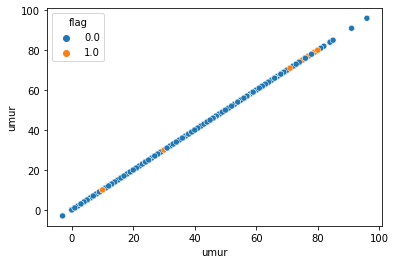

--------------------------------------------------
2
umur education


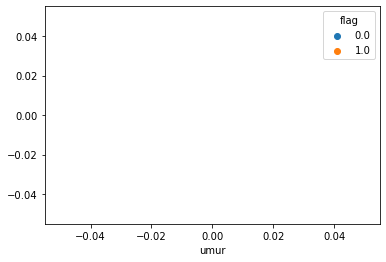

--------------------------------------------------
3
umur punya_produk1


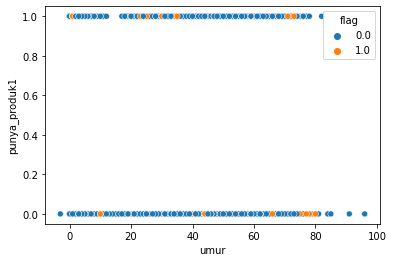

--------------------------------------------------
4
umur punya_produk2


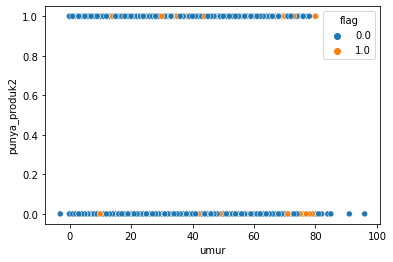

--------------------------------------------------
5
umur punya_produk3


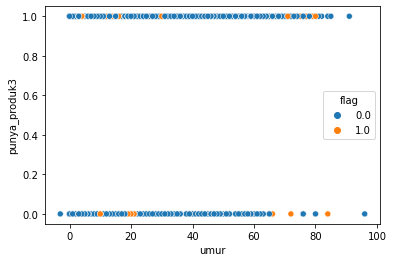

--------------------------------------------------
6
umur punya_produk4


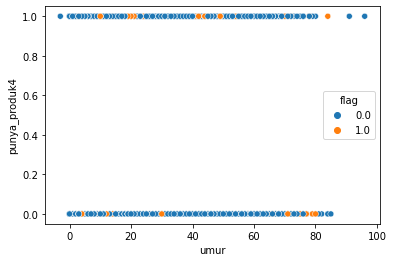

--------------------------------------------------
7
umur punya_produk5


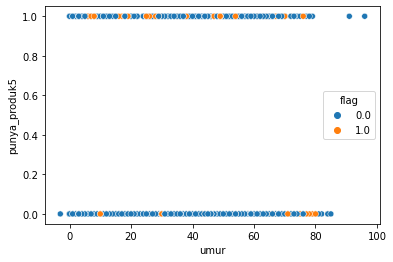

--------------------------------------------------
8
umur punya_produk6


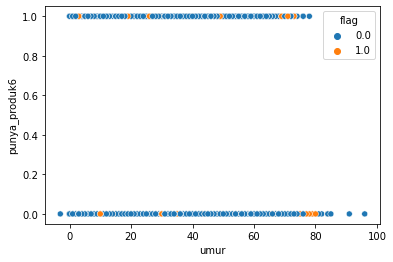

--------------------------------------------------
9
umur omset


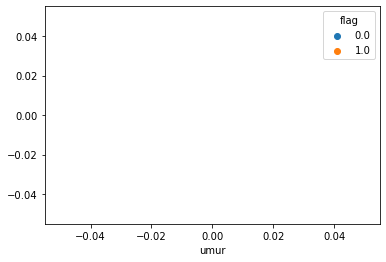

--------------------------------------------------
10
umur penghasilan


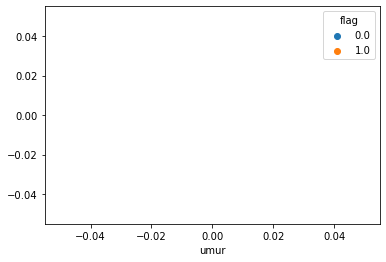

--------------------------------------------------
11
umur average_sisauang_mingguan_1BT


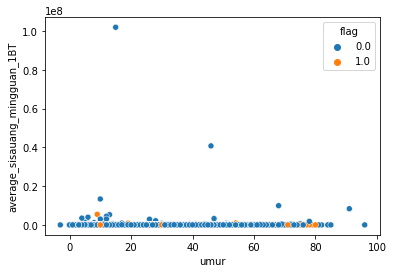

--------------------------------------------------
12
umur average_sisauang_mingguan_2BT


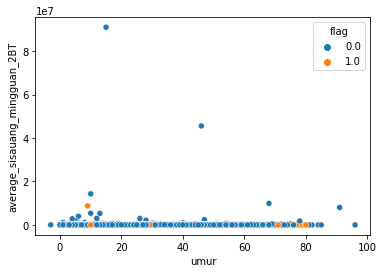

--------------------------------------------------
13
umur average_sisauang_mingguan_3BT


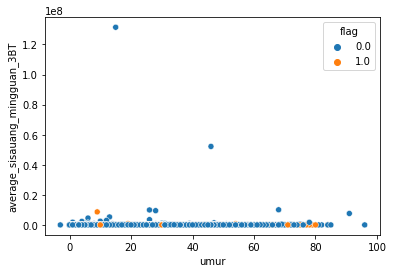

--------------------------------------------------
14
umur average_sisauang_mingguan_4BT


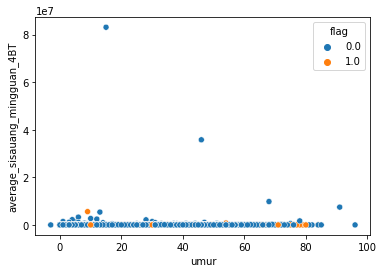

--------------------------------------------------
15
umur average_sisauang_mingguan_5BT


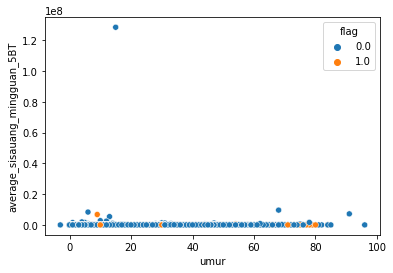

--------------------------------------------------
16
umur average_sisauang_mingguan_6BT


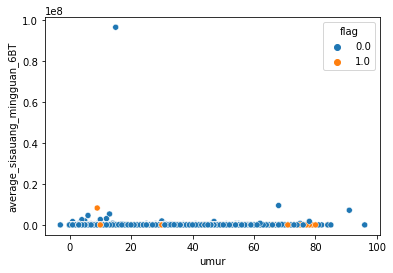

--------------------------------------------------
17
umur sisauang_akhir_1BT


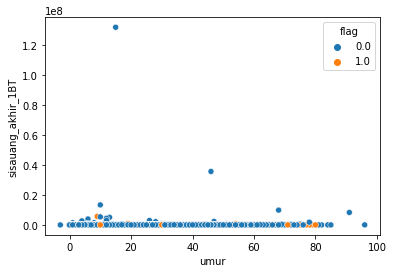

--------------------------------------------------
18
umur sisauang_akhir_2BT


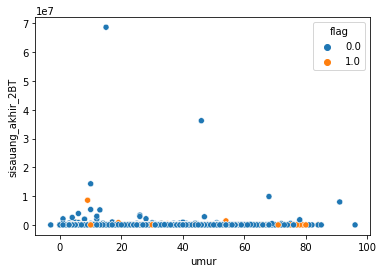

--------------------------------------------------
19
umur sisauang_akhir_3BT


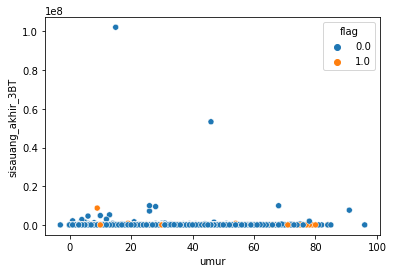

--------------------------------------------------
20
umur sisauang_akhir_4BT


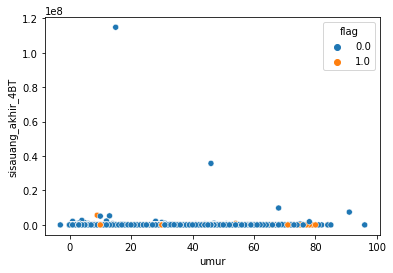

--------------------------------------------------
21
umur sisauang_akhir_5BT


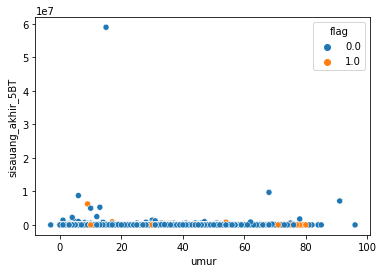

--------------------------------------------------
22
umur sisauang_akhir_6BT


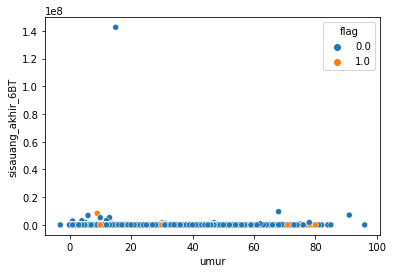

--------------------------------------------------
23
umur sisauang_tertahan_1BT


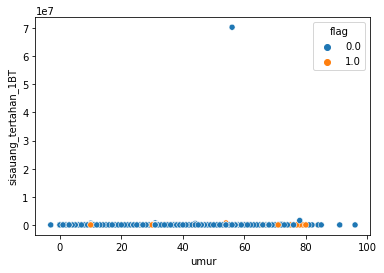

--------------------------------------------------
24
umur sisauang_tertahan_2BT


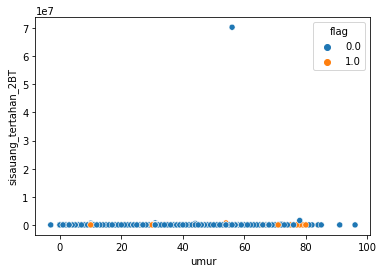

--------------------------------------------------
25
umur sisauang_tertahan_3BT


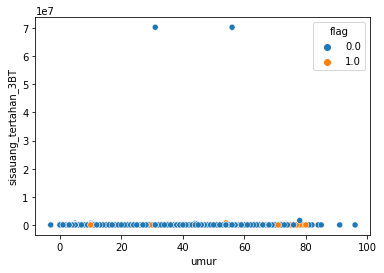

--------------------------------------------------
26
umur sisauang_tertahan_4BT


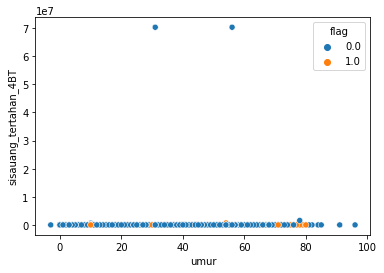

--------------------------------------------------
27
umur sisauang_tertahan_5BT


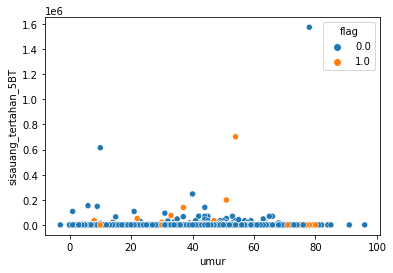

--------------------------------------------------
28
umur sisauang_tertahan_6BT


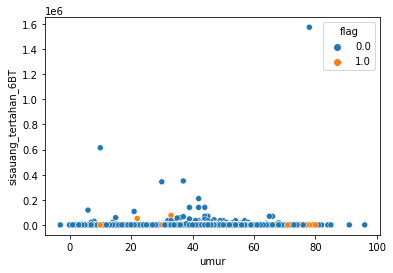

--------------------------------------------------
29
umur sisauang_tersedia_1BT


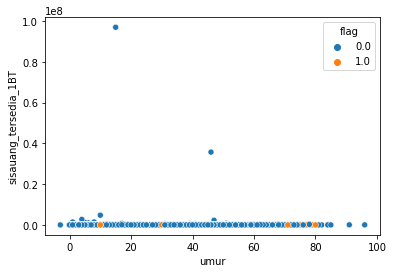

--------------------------------------------------
30
umur sisauang_tersedia_2BT


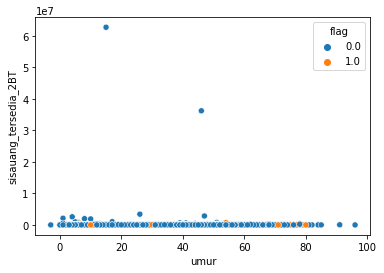

--------------------------------------------------
31
umur sisauang_tersedia_3BT


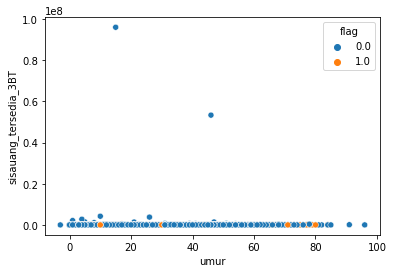

--------------------------------------------------
32
umur sisauang_tersedia_4BT


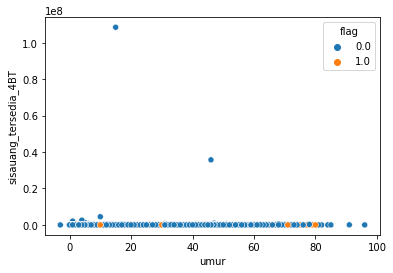

--------------------------------------------------
33
umur sisauang_tersedia_5BT


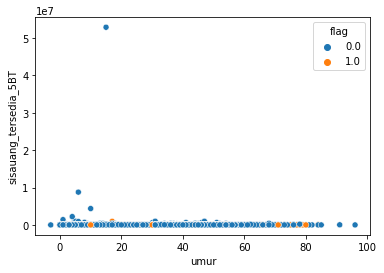

--------------------------------------------------
34
umur sisauang_tersedia_6BT


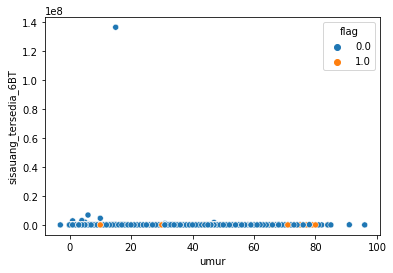

--------------------------------------------------
35
umur sisa_hutang_1BT


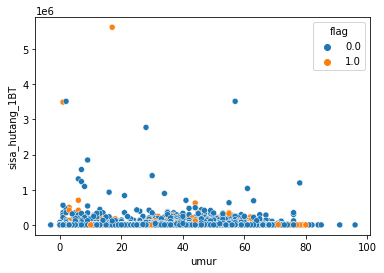

--------------------------------------------------
36
umur sisa_hutang_2BT


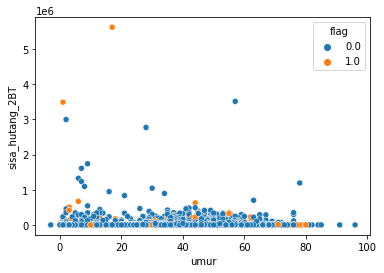

--------------------------------------------------
37
umur sisa_hutang_3BT


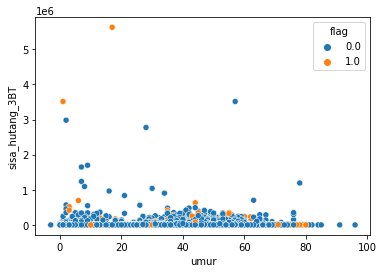

--------------------------------------------------
38
umur sisa_hutang_4BT


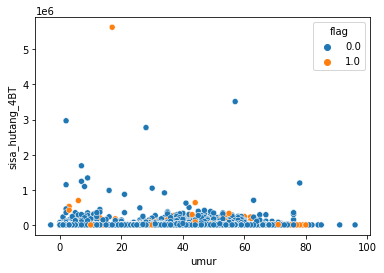

--------------------------------------------------
39
umur sisa_hutang_5BT


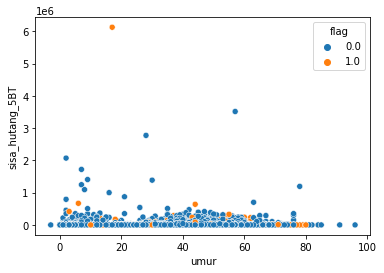

--------------------------------------------------
40
umur sisa_hutang_6BT


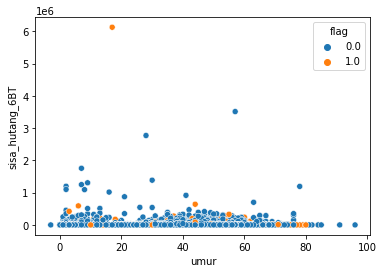

--------------------------------------------------
41
umur jumlah_pembayaran_hutang_1BT


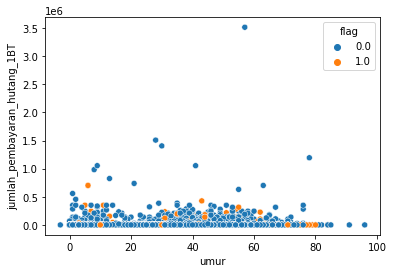

--------------------------------------------------
42
umur jumlah_pembayaran_hutang_2BT


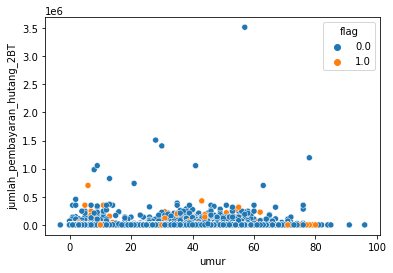

--------------------------------------------------
43
umur jumlah_pembayaran_hutang_3BT


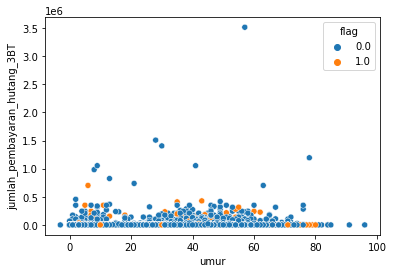

--------------------------------------------------
44
umur jumlah_pembayaran_hutang_4BT


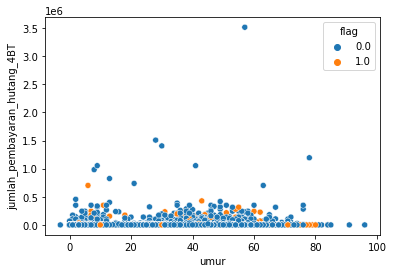

--------------------------------------------------
45
umur jumlah_pembayaran_hutang_5BT


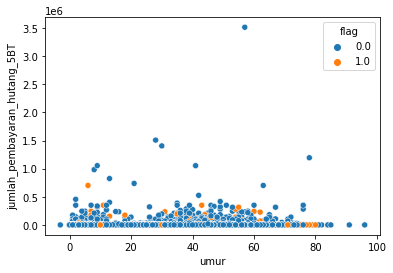

--------------------------------------------------
46
umur jumlah_pembayaran_hutang_6BT


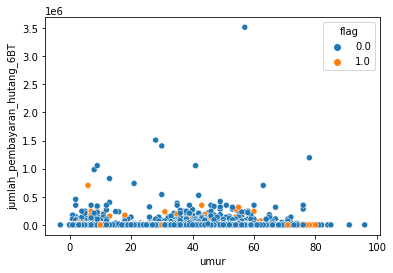

--------------------------------------------------
47
umur jumlah_pengeluaran_1BT


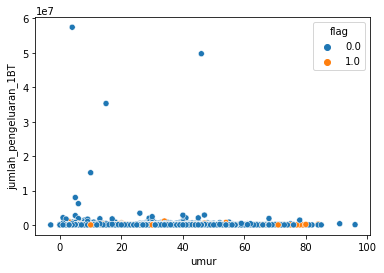

--------------------------------------------------
48
umur jumlah_pengeluaran_2BT


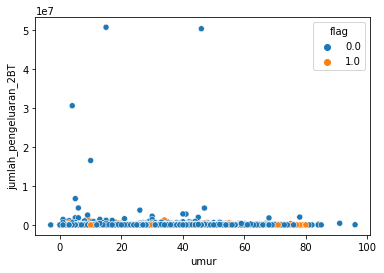

--------------------------------------------------
49
umur jumlah_pengeluaran_3BT


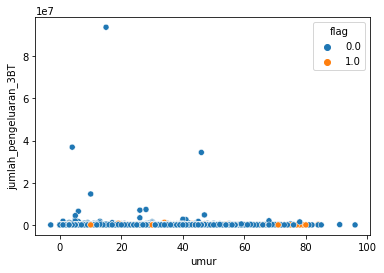

--------------------------------------------------
50
umur jumlah_pengeluaran_4BT


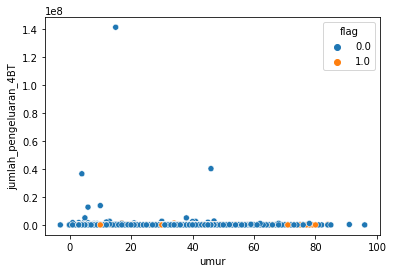

--------------------------------------------------
51
umur jumlah_pengeluaran_5BT


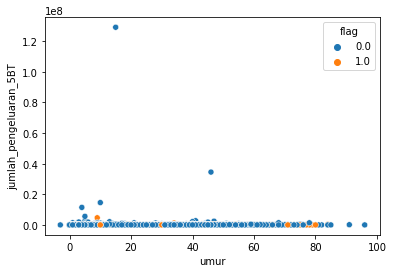

--------------------------------------------------
52
umur jumlah_pengeluaran_6BT


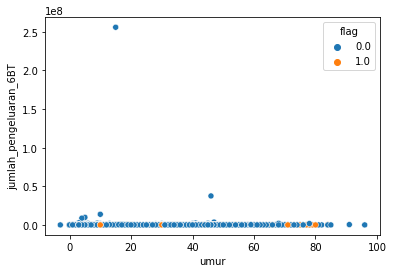

--------------------------------------------------
53
umur jumlah_pemasukan_1BT


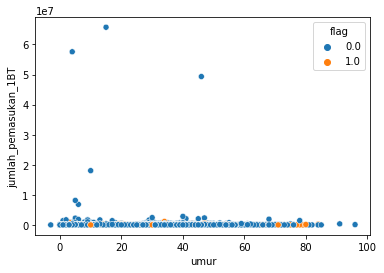

--------------------------------------------------
54
umur jumlah_pemasukan_2BT


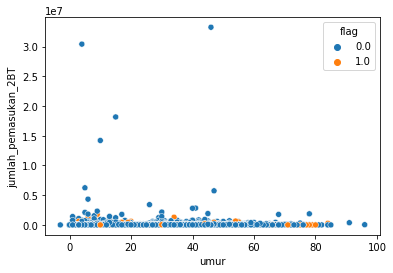

--------------------------------------------------
55
umur jumlah_pemasukan_3BT


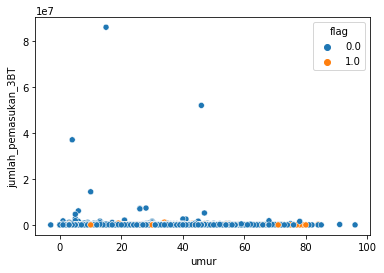

--------------------------------------------------
56
umur jumlah_pemasukan_4BT


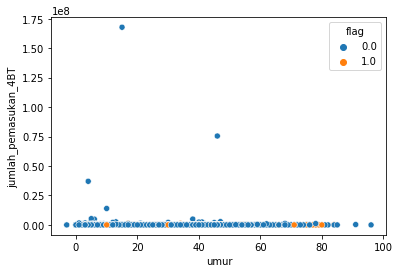

--------------------------------------------------
57
umur jumlah_pemasukan_5BT


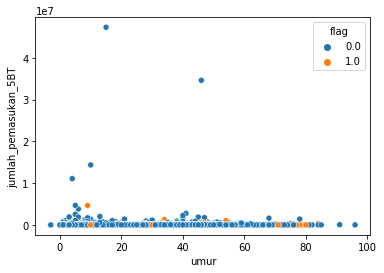

--------------------------------------------------
58
umur jumlah_pemasukan_6BT


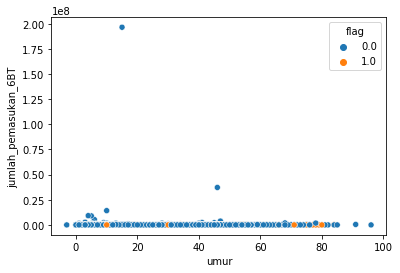

--------------------------------------------------
59
umur frekuensi_pengeluaran_1BT


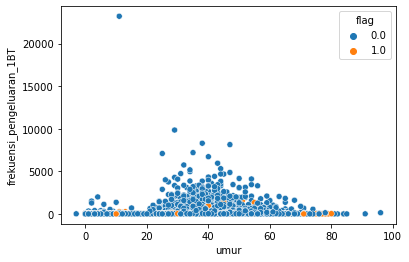

--------------------------------------------------
60
umur frekuensi_pengeluaran_2BT


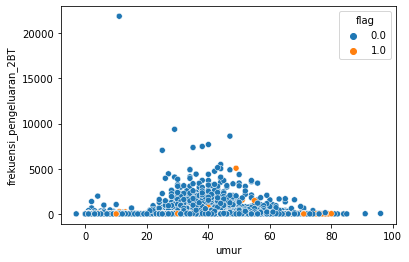

--------------------------------------------------
61
umur frekuensi_pengeluaran_3BT


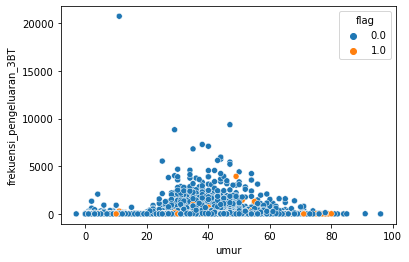

--------------------------------------------------
62
umur frekuensi_pengeluaran_4BT


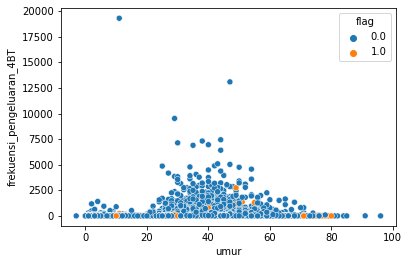

--------------------------------------------------
63
umur frekuensi_pengeluaran_5BT


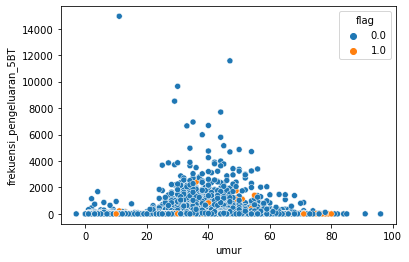

--------------------------------------------------
64
umur frekuensi_pengeluaran_6BT


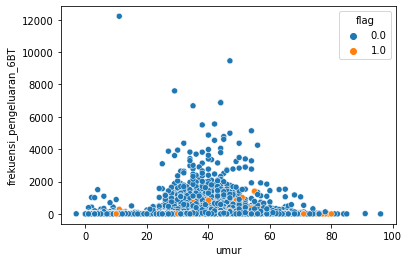

--------------------------------------------------
65
umur frekuensi_pemasukan_1BT


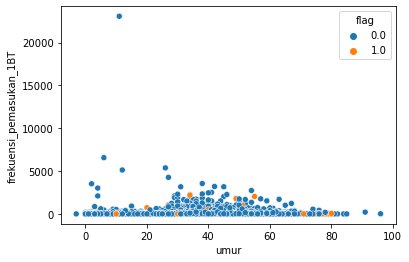

--------------------------------------------------
66
umur frekuensi_pemasukan_2BT


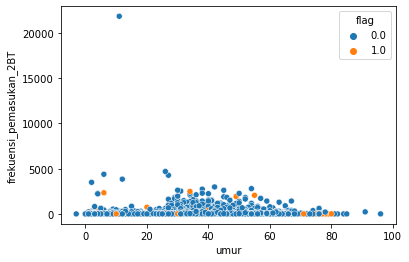

--------------------------------------------------
67
umur frekuensi_pemasukan_3BT


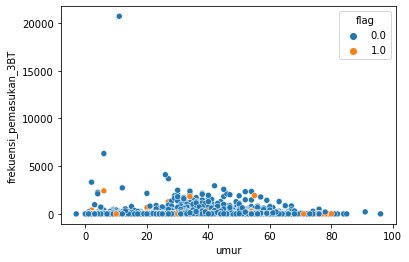

--------------------------------------------------
68
umur frekuensi_pemasukan_4BT


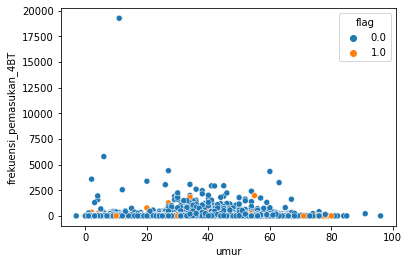

--------------------------------------------------
69
umur frekuensi_pemasukan_5BT


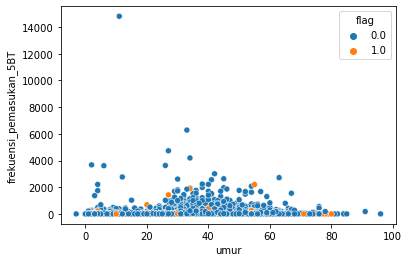

--------------------------------------------------
70
umur frekuensi_pemasukan_6BT


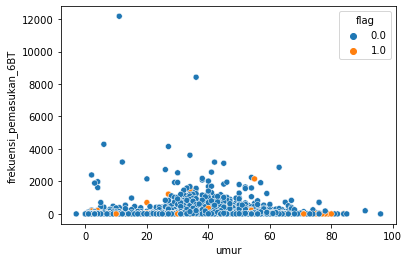

--------------------------------------------------
71
umur flag


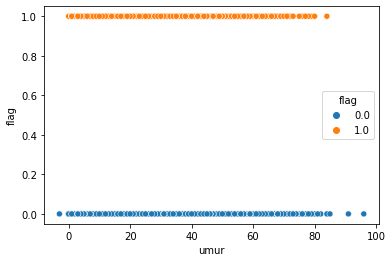

--------------------------------------------------
72
education education


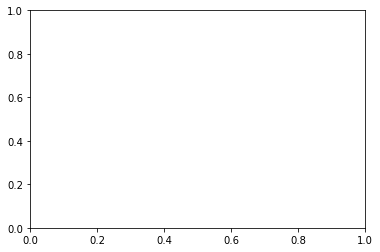

--------------------------------------------------
73
education punya_produk1


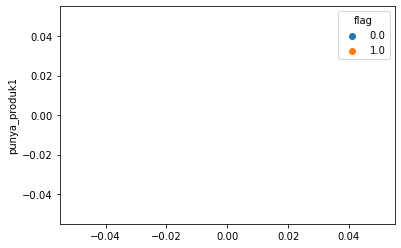

--------------------------------------------------
74
education punya_produk2


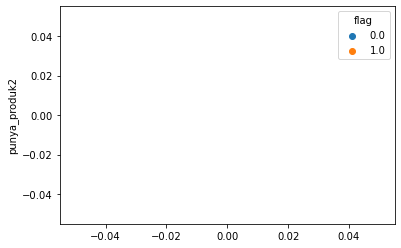

--------------------------------------------------
75
education punya_produk3


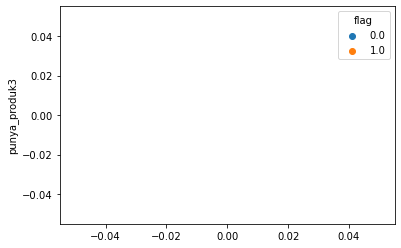

--------------------------------------------------
76
education punya_produk4


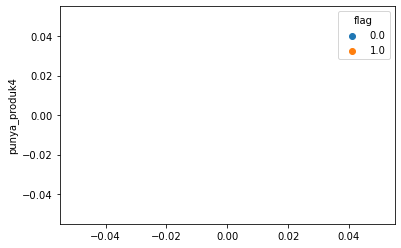

--------------------------------------------------
77
education punya_produk5


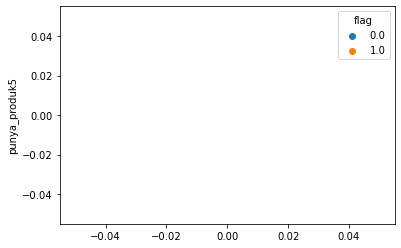

--------------------------------------------------
78
education punya_produk6


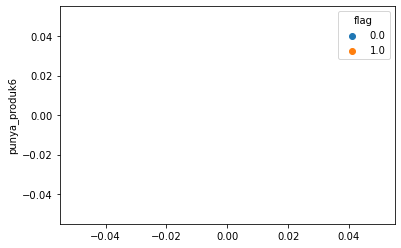

--------------------------------------------------
79
education omset


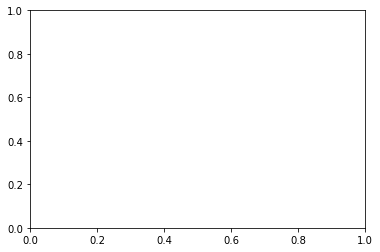

--------------------------------------------------
80
education penghasilan


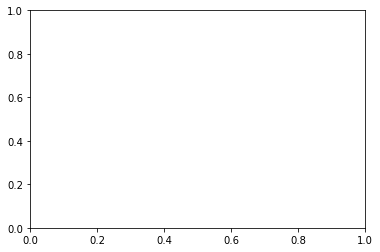

--------------------------------------------------
81
education average_sisauang_mingguan_1BT


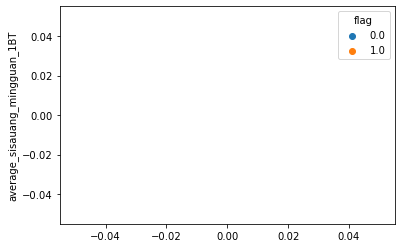

--------------------------------------------------
82
education average_sisauang_mingguan_2BT


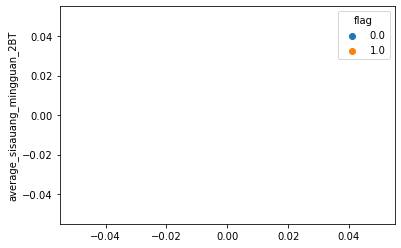

--------------------------------------------------
83
education average_sisauang_mingguan_3BT


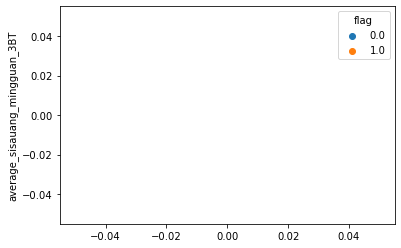

--------------------------------------------------
84
education average_sisauang_mingguan_4BT


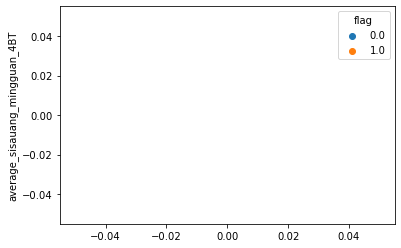

--------------------------------------------------
85
education average_sisauang_mingguan_5BT


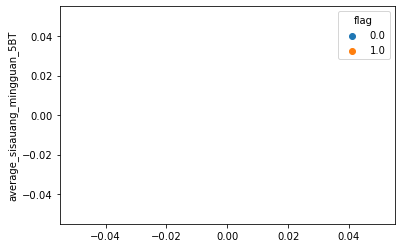

--------------------------------------------------
86
education average_sisauang_mingguan_6BT


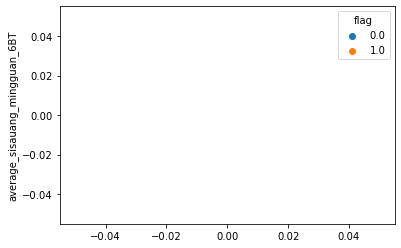

--------------------------------------------------
87
education sisauang_akhir_1BT


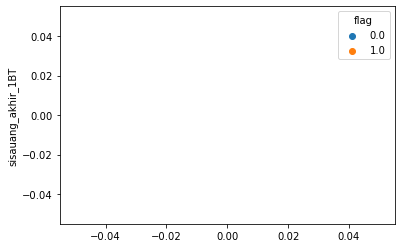

--------------------------------------------------
88
education sisauang_akhir_2BT


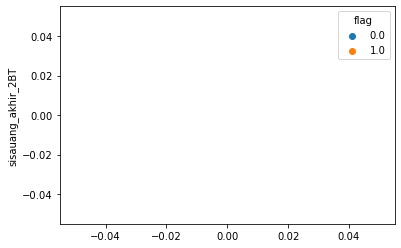

--------------------------------------------------
89
education sisauang_akhir_3BT


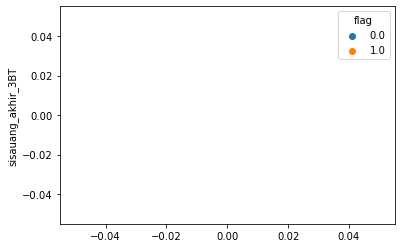

--------------------------------------------------
90
education sisauang_akhir_4BT


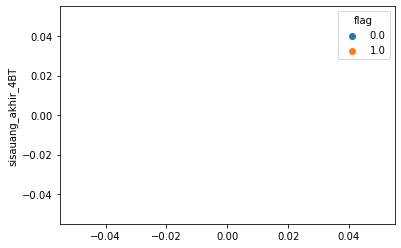

--------------------------------------------------
91
education sisauang_akhir_5BT


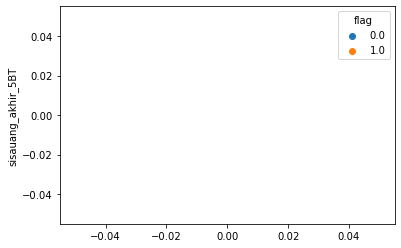

--------------------------------------------------
92
education sisauang_akhir_6BT


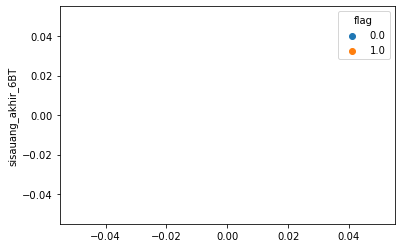

--------------------------------------------------
93
education sisauang_tertahan_1BT


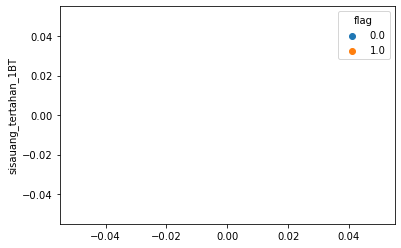

--------------------------------------------------
94
education sisauang_tertahan_2BT


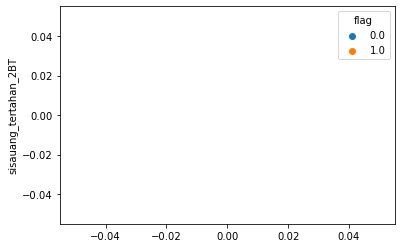

--------------------------------------------------
95
education sisauang_tertahan_3BT


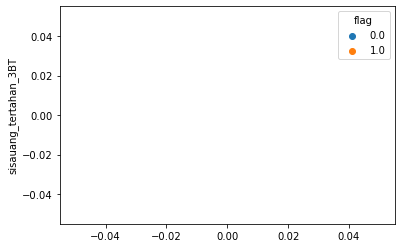

--------------------------------------------------
96
education sisauang_tertahan_4BT


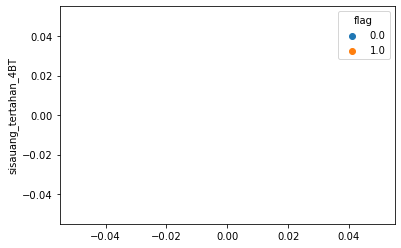

--------------------------------------------------
97
education sisauang_tertahan_5BT


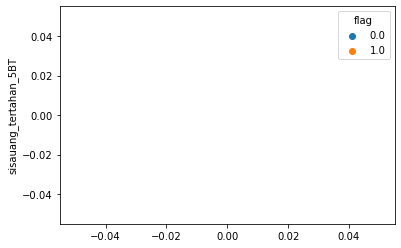

--------------------------------------------------
98
education sisauang_tertahan_6BT


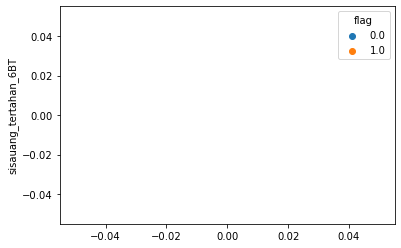

--------------------------------------------------
99
education sisauang_tersedia_1BT


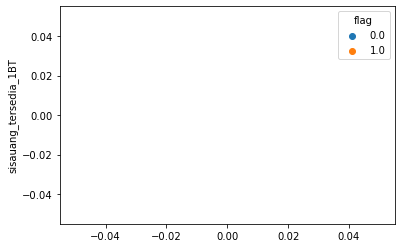

--------------------------------------------------
100
education sisauang_tersedia_2BT


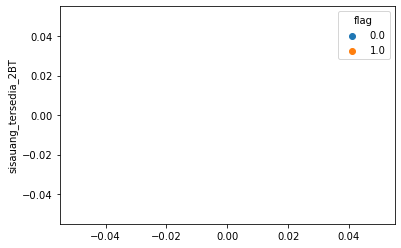

--------------------------------------------------
101
education sisauang_tersedia_3BT


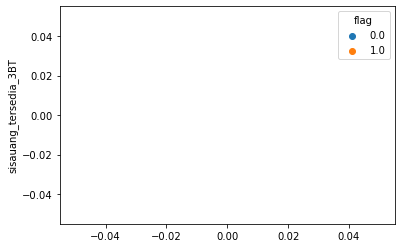

--------------------------------------------------
102
education sisauang_tersedia_4BT


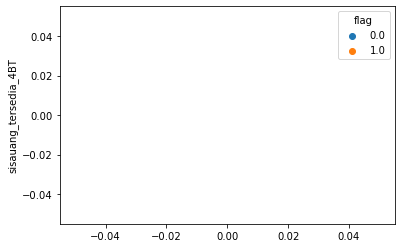

--------------------------------------------------
103
education sisauang_tersedia_5BT


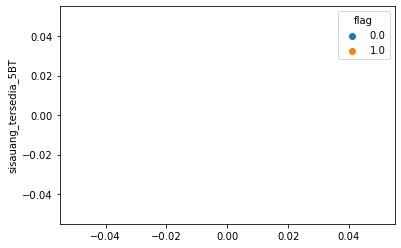

--------------------------------------------------
104
education sisauang_tersedia_6BT


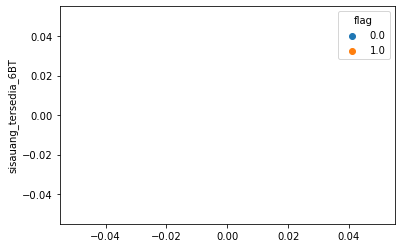

--------------------------------------------------
105
education sisa_hutang_1BT


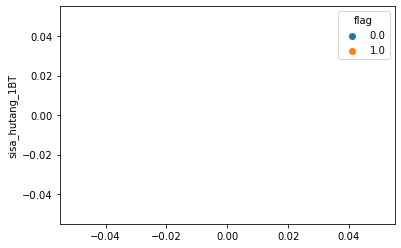

--------------------------------------------------
106
education sisa_hutang_2BT


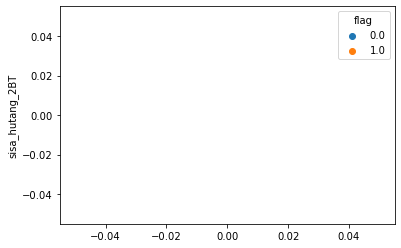

--------------------------------------------------
107
education sisa_hutang_3BT


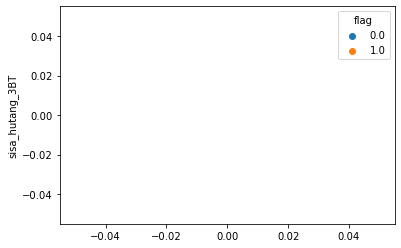

--------------------------------------------------
108
education sisa_hutang_4BT


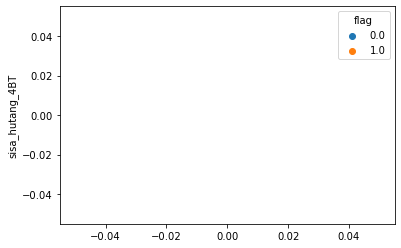

--------------------------------------------------
109
education sisa_hutang_5BT


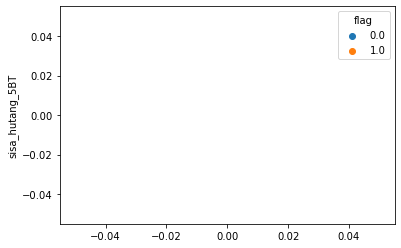

--------------------------------------------------
110
education sisa_hutang_6BT


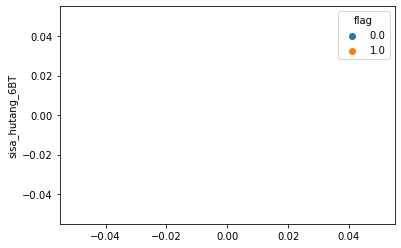

--------------------------------------------------
111
education jumlah_pembayaran_hutang_1BT


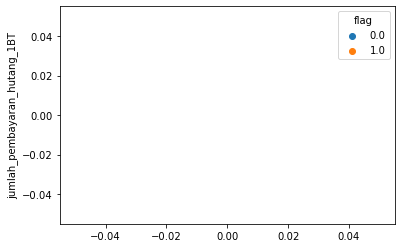

--------------------------------------------------
112
education jumlah_pembayaran_hutang_2BT


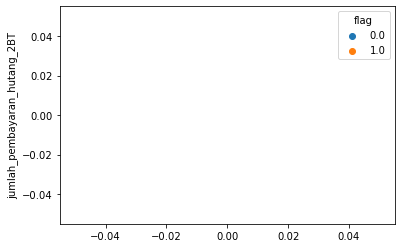

--------------------------------------------------
113
education jumlah_pembayaran_hutang_3BT


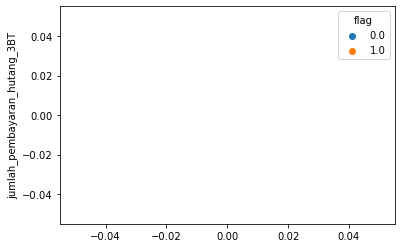

--------------------------------------------------
114
education jumlah_pembayaran_hutang_4BT


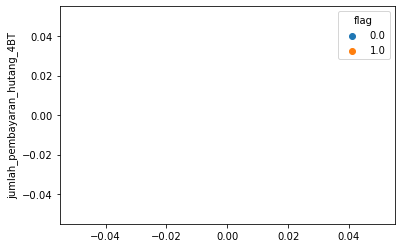

--------------------------------------------------
115
education jumlah_pembayaran_hutang_5BT


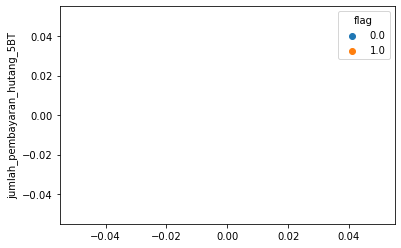

--------------------------------------------------
116
education jumlah_pembayaran_hutang_6BT


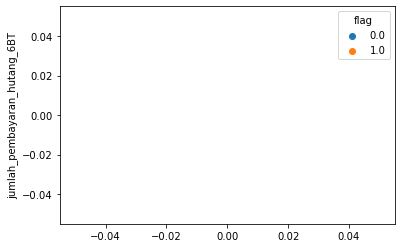

--------------------------------------------------
117
education jumlah_pengeluaran_1BT


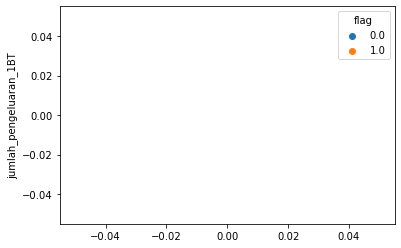

--------------------------------------------------
118
education jumlah_pengeluaran_2BT


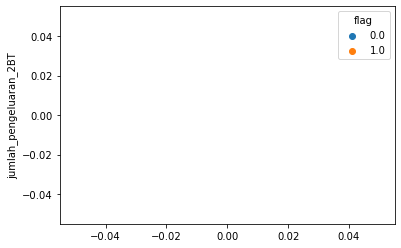

--------------------------------------------------
119
education jumlah_pengeluaran_3BT


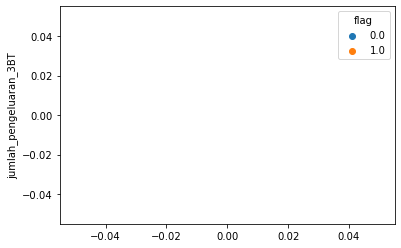

--------------------------------------------------
120
education jumlah_pengeluaran_4BT


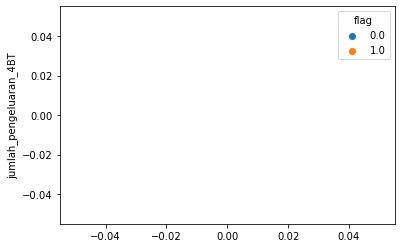

--------------------------------------------------
121
education jumlah_pengeluaran_5BT


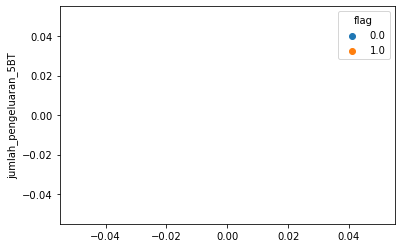

--------------------------------------------------
122
education jumlah_pengeluaran_6BT


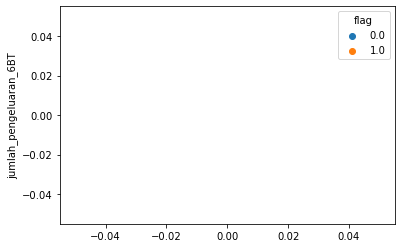

--------------------------------------------------
123
education jumlah_pemasukan_1BT


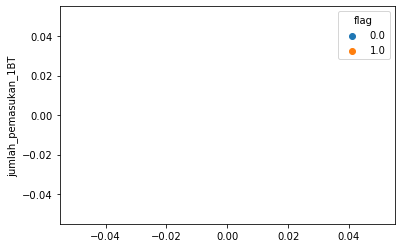

--------------------------------------------------
124
education jumlah_pemasukan_2BT


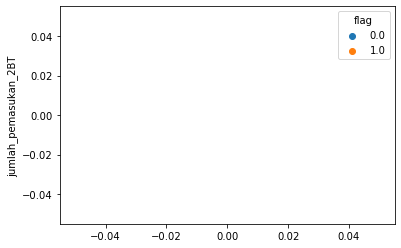

--------------------------------------------------
125
education jumlah_pemasukan_3BT


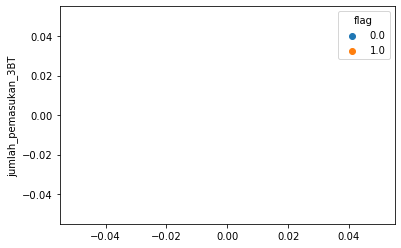

--------------------------------------------------
126
education jumlah_pemasukan_4BT


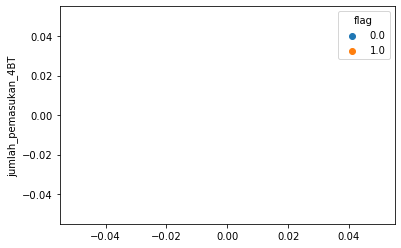

--------------------------------------------------
127
education jumlah_pemasukan_5BT


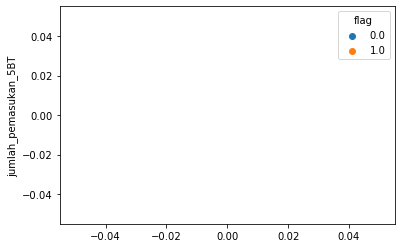

--------------------------------------------------
128
education jumlah_pemasukan_6BT


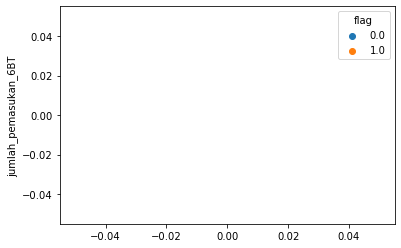

--------------------------------------------------
129
education frekuensi_pengeluaran_1BT


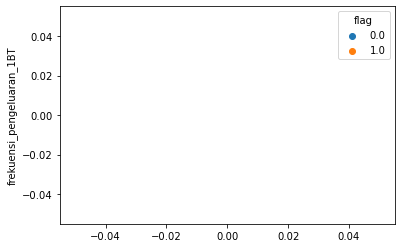

--------------------------------------------------
130
education frekuensi_pengeluaran_2BT


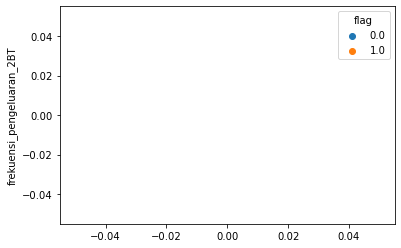

--------------------------------------------------
131
education frekuensi_pengeluaran_3BT


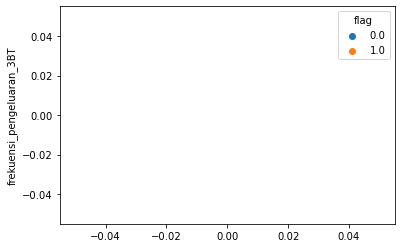

--------------------------------------------------
132
education frekuensi_pengeluaran_4BT


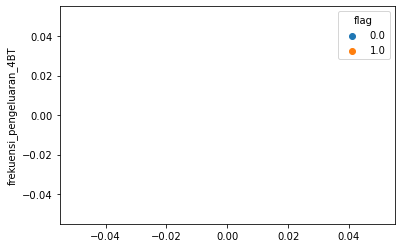

--------------------------------------------------
133
education frekuensi_pengeluaran_5BT


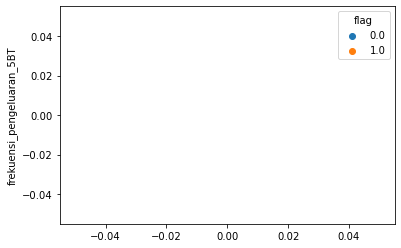

--------------------------------------------------
134
education frekuensi_pengeluaran_6BT


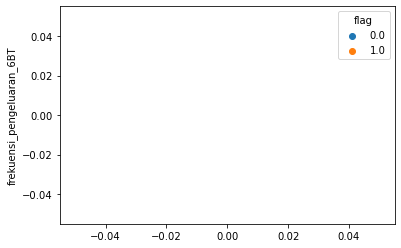

--------------------------------------------------
135
education frekuensi_pemasukan_1BT


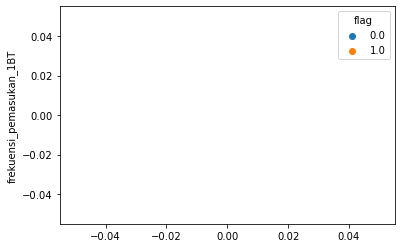

--------------------------------------------------
136
education frekuensi_pemasukan_2BT


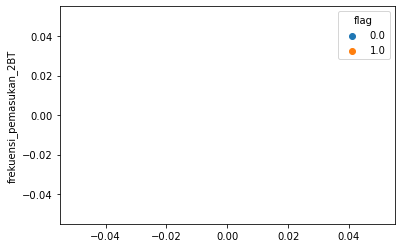

--------------------------------------------------
137
education frekuensi_pemasukan_3BT


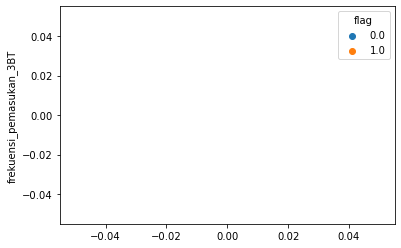

--------------------------------------------------
138
education frekuensi_pemasukan_4BT


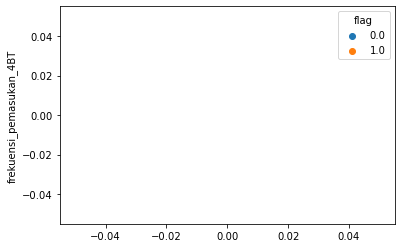

--------------------------------------------------
139
education frekuensi_pemasukan_5BT


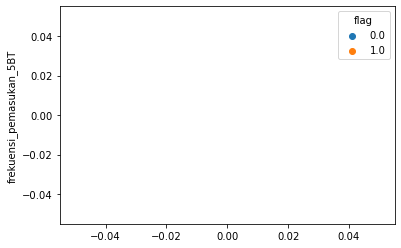

--------------------------------------------------
140
education frekuensi_pemasukan_6BT


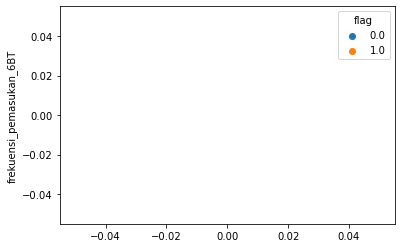

--------------------------------------------------
141
education flag


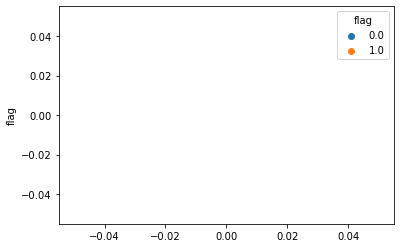

--------------------------------------------------
142
punya_produk1 punya_produk1


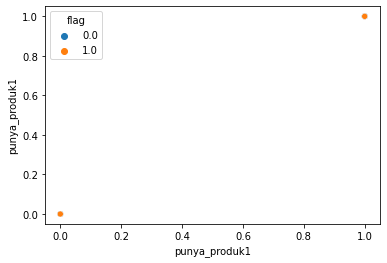

--------------------------------------------------
143
punya_produk1 punya_produk2


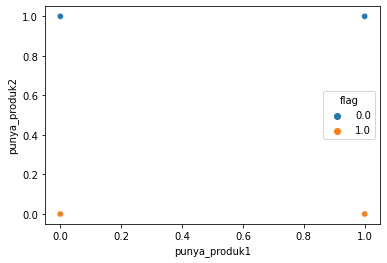

--------------------------------------------------
144
punya_produk1 punya_produk3


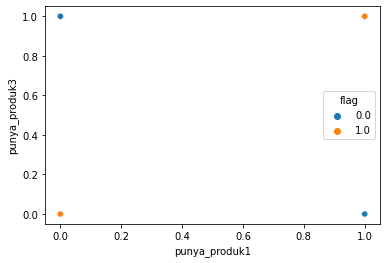

--------------------------------------------------
145
punya_produk1 punya_produk4


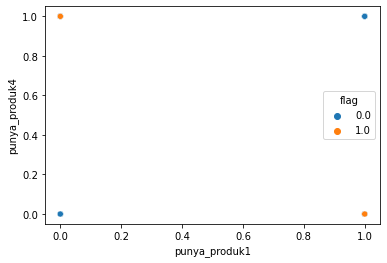

--------------------------------------------------
146
punya_produk1 punya_produk5


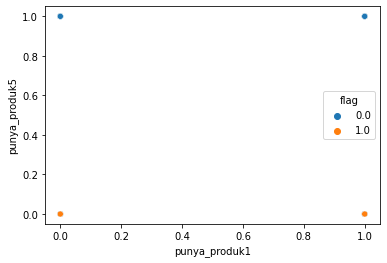

--------------------------------------------------
147
punya_produk1 punya_produk6


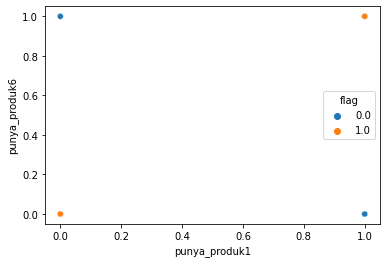

--------------------------------------------------
148
punya_produk1 omset


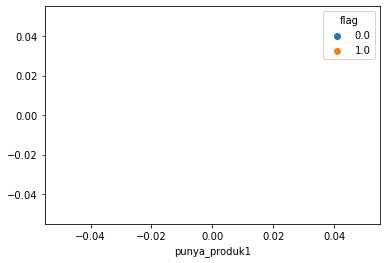

--------------------------------------------------
149
punya_produk1 penghasilan


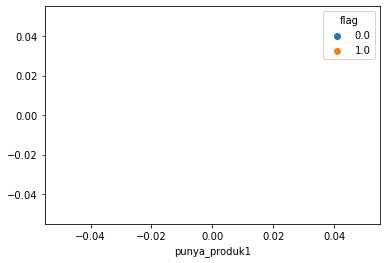

--------------------------------------------------
150
punya_produk1 average_sisauang_mingguan_1BT


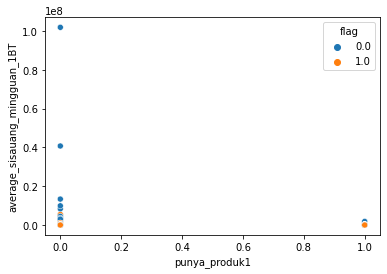

--------------------------------------------------
151
punya_produk1 average_sisauang_mingguan_2BT


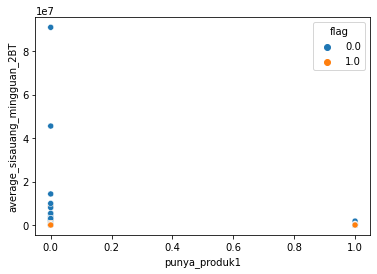

--------------------------------------------------
152
punya_produk1 average_sisauang_mingguan_3BT


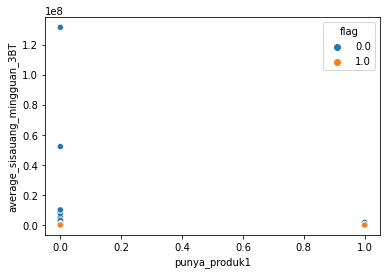

--------------------------------------------------
153
punya_produk1 average_sisauang_mingguan_4BT


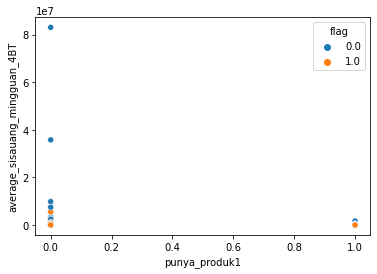

--------------------------------------------------
154
punya_produk1 average_sisauang_mingguan_5BT


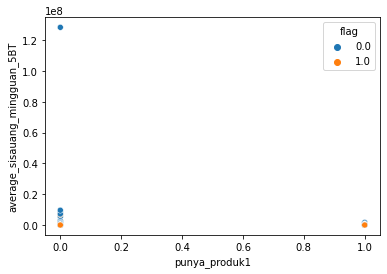

--------------------------------------------------
155
punya_produk1 average_sisauang_mingguan_6BT


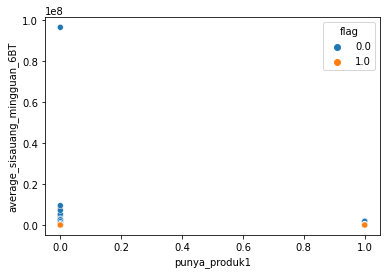

--------------------------------------------------
156
punya_produk1 sisauang_akhir_1BT


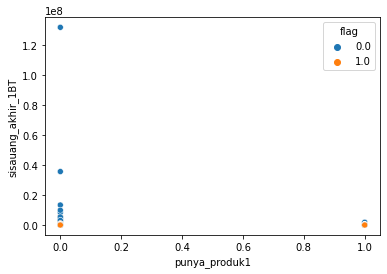

--------------------------------------------------
157
punya_produk1 sisauang_akhir_2BT


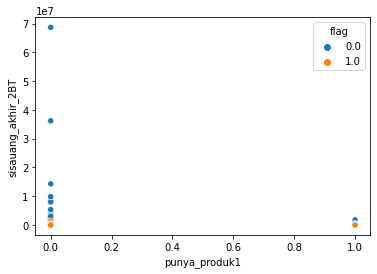

--------------------------------------------------
158
punya_produk1 sisauang_akhir_3BT


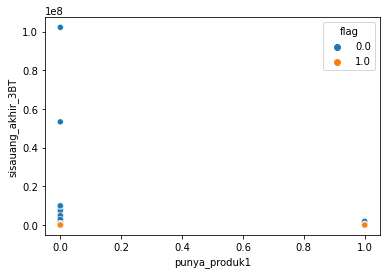

--------------------------------------------------
159
punya_produk1 sisauang_akhir_4BT


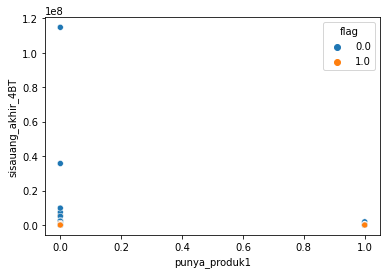

--------------------------------------------------
160
punya_produk1 sisauang_akhir_5BT


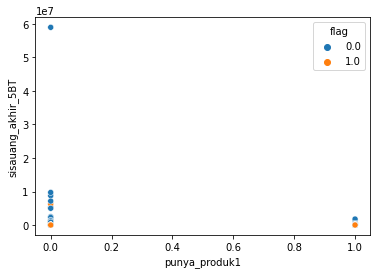

--------------------------------------------------
161
punya_produk1 sisauang_akhir_6BT


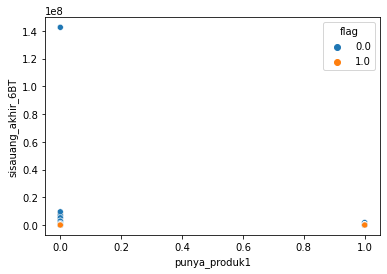

--------------------------------------------------
162
punya_produk1 sisauang_tertahan_1BT


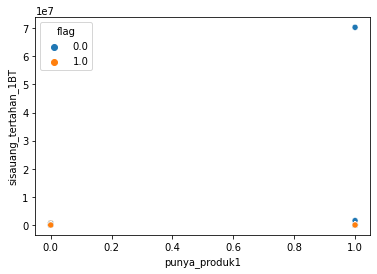

--------------------------------------------------
163
punya_produk1 sisauang_tertahan_2BT


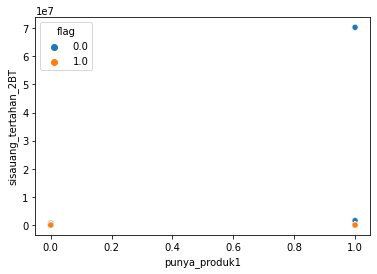

--------------------------------------------------
164
punya_produk1 sisauang_tertahan_3BT


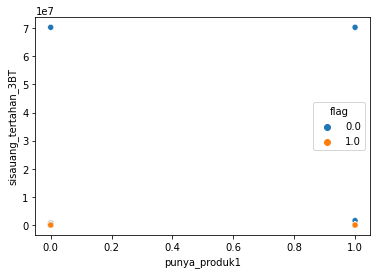

--------------------------------------------------
165
punya_produk1 sisauang_tertahan_4BT


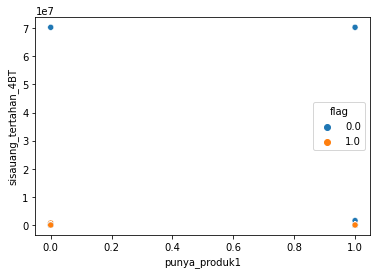

--------------------------------------------------
166
punya_produk1 sisauang_tertahan_5BT


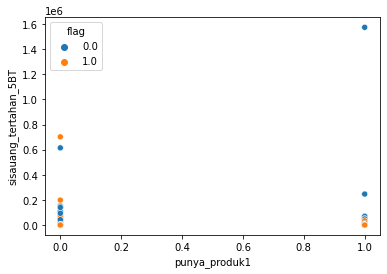

--------------------------------------------------
167
punya_produk1 sisauang_tertahan_6BT


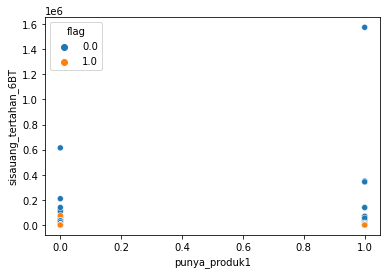

--------------------------------------------------
168
punya_produk1 sisauang_tersedia_1BT


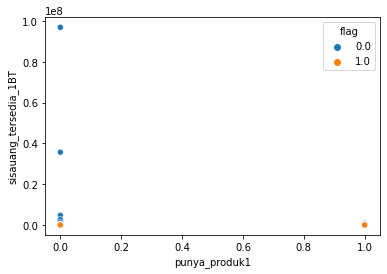

--------------------------------------------------
169
punya_produk1 sisauang_tersedia_2BT


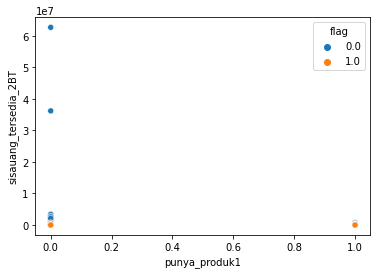

--------------------------------------------------
170
punya_produk1 sisauang_tersedia_3BT


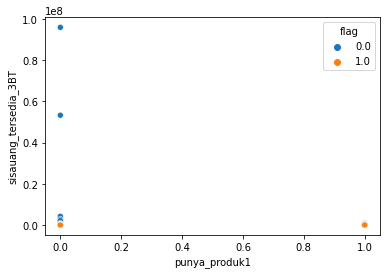

--------------------------------------------------
171
punya_produk1 sisauang_tersedia_4BT


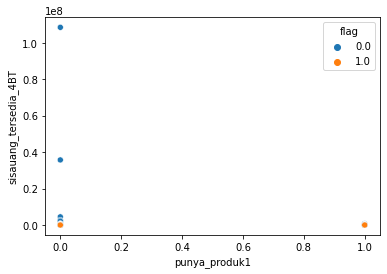

--------------------------------------------------
172
punya_produk1 sisauang_tersedia_5BT


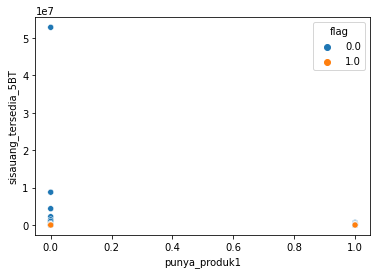

--------------------------------------------------
173
punya_produk1 sisauang_tersedia_6BT


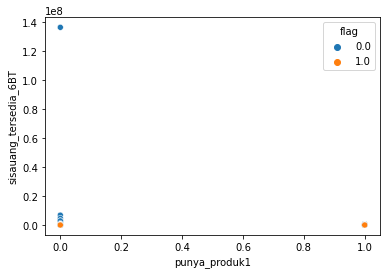

--------------------------------------------------
174
punya_produk1 sisa_hutang_1BT


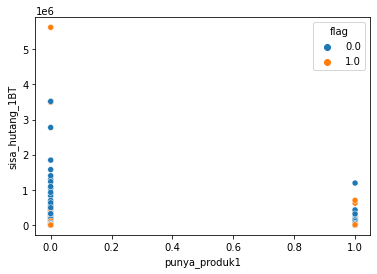

--------------------------------------------------
175
punya_produk1 sisa_hutang_2BT


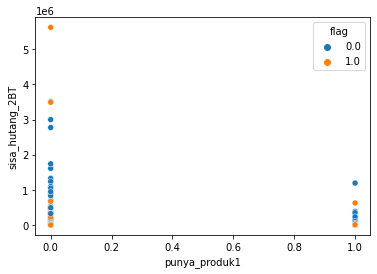

--------------------------------------------------
176
punya_produk1 sisa_hutang_3BT


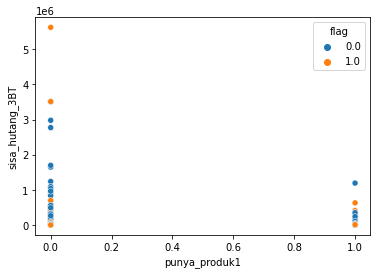

--------------------------------------------------
177
punya_produk1 sisa_hutang_4BT


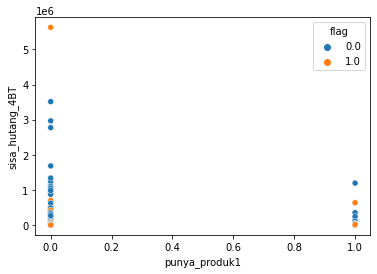

--------------------------------------------------
178
punya_produk1 sisa_hutang_5BT


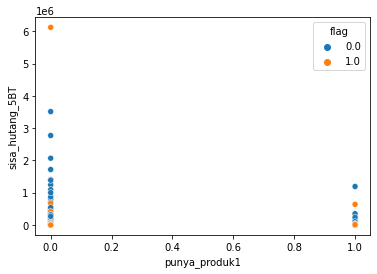

--------------------------------------------------
179
punya_produk1 sisa_hutang_6BT


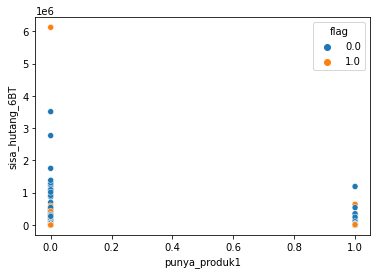

--------------------------------------------------
180
punya_produk1 jumlah_pembayaran_hutang_1BT


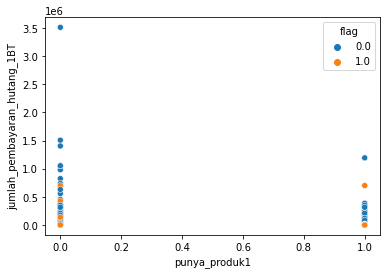

--------------------------------------------------
181
punya_produk1 jumlah_pembayaran_hutang_2BT


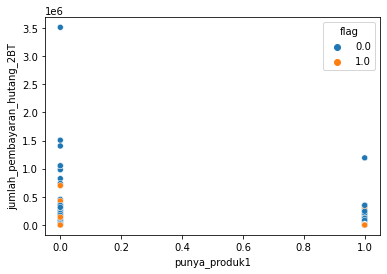

--------------------------------------------------
182
punya_produk1 jumlah_pembayaran_hutang_3BT


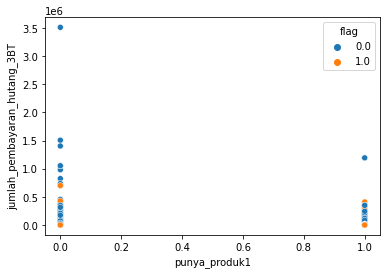

--------------------------------------------------
183
punya_produk1 jumlah_pembayaran_hutang_4BT


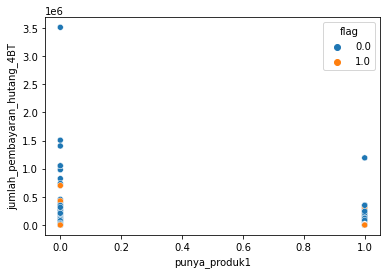

--------------------------------------------------
184
punya_produk1 jumlah_pembayaran_hutang_5BT


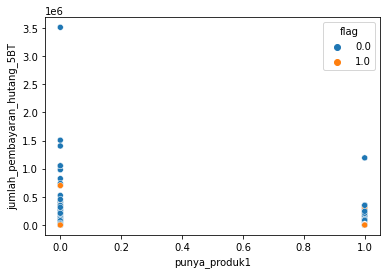

--------------------------------------------------
185
punya_produk1 jumlah_pembayaran_hutang_6BT


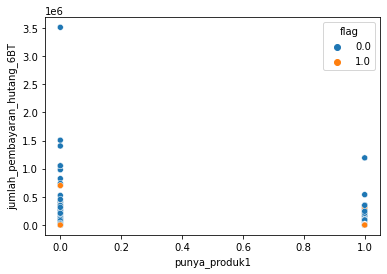

--------------------------------------------------
186
punya_produk1 jumlah_pengeluaran_1BT


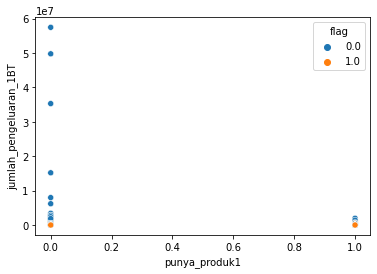

--------------------------------------------------
187
punya_produk1 jumlah_pengeluaran_2BT


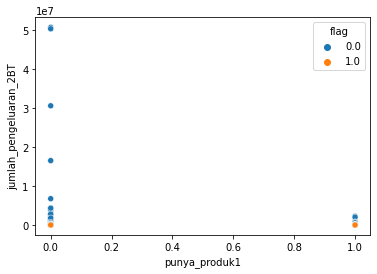

--------------------------------------------------
188
punya_produk1 jumlah_pengeluaran_3BT


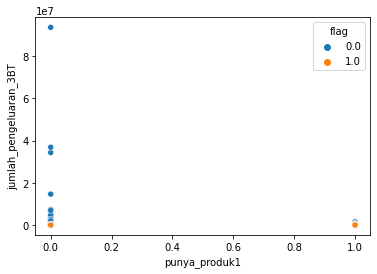

--------------------------------------------------
189
punya_produk1 jumlah_pengeluaran_4BT


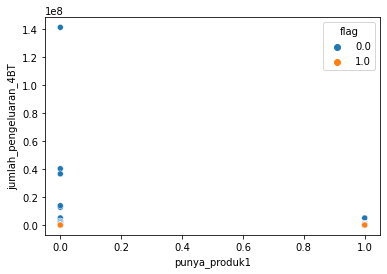

--------------------------------------------------
190
punya_produk1 jumlah_pengeluaran_5BT


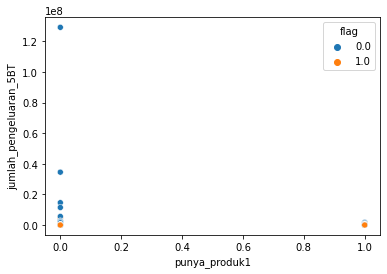

--------------------------------------------------
191
punya_produk1 jumlah_pengeluaran_6BT


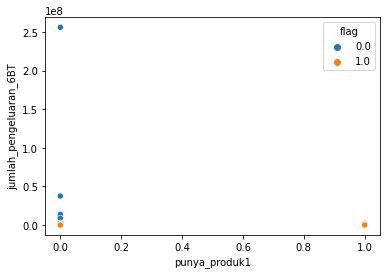

--------------------------------------------------
192
punya_produk1 jumlah_pemasukan_1BT


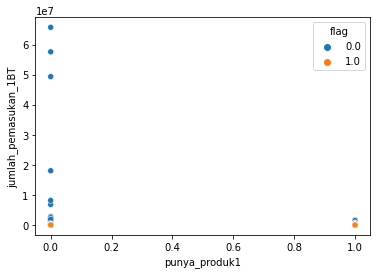

--------------------------------------------------
193
punya_produk1 jumlah_pemasukan_2BT


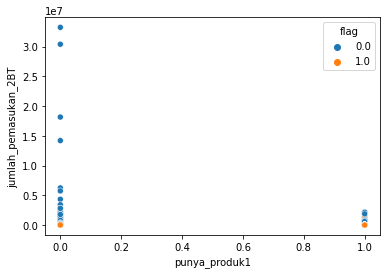

--------------------------------------------------
194
punya_produk1 jumlah_pemasukan_3BT


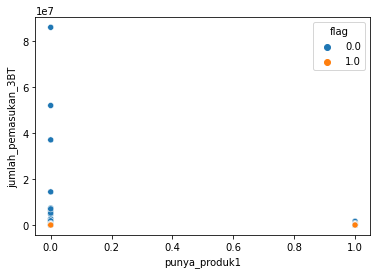

--------------------------------------------------
195
punya_produk1 jumlah_pemasukan_4BT


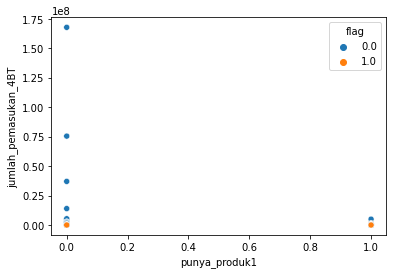

--------------------------------------------------
196
punya_produk1 jumlah_pemasukan_5BT


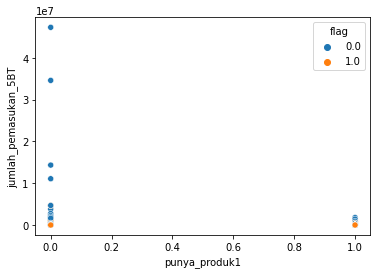

--------------------------------------------------
197
punya_produk1 jumlah_pemasukan_6BT


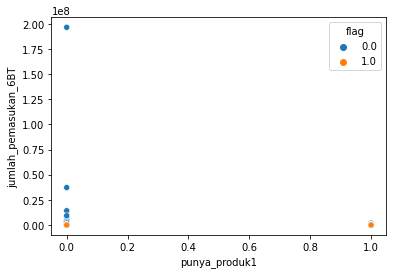

--------------------------------------------------
198
punya_produk1 frekuensi_pengeluaran_1BT


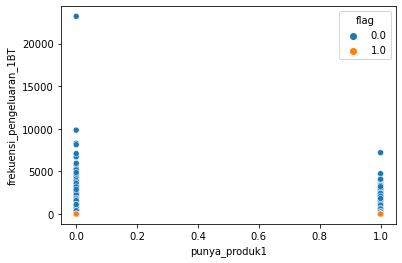

--------------------------------------------------
199
punya_produk1 frekuensi_pengeluaran_2BT


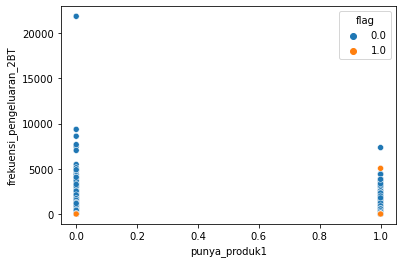

--------------------------------------------------
200
punya_produk1 frekuensi_pengeluaran_3BT


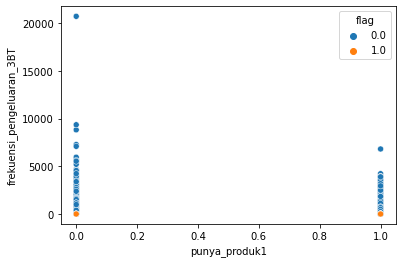

--------------------------------------------------
201
punya_produk1 frekuensi_pengeluaran_4BT


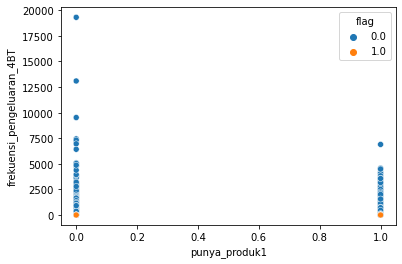

--------------------------------------------------
202
punya_produk1 frekuensi_pengeluaran_5BT


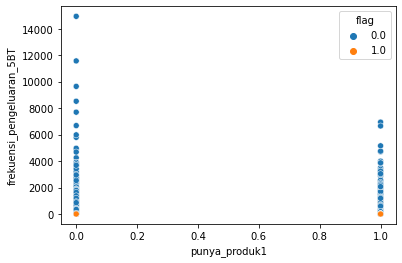

--------------------------------------------------
203
punya_produk1 frekuensi_pengeluaran_6BT


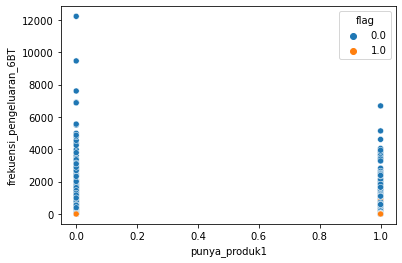

--------------------------------------------------
204
punya_produk1 frekuensi_pemasukan_1BT


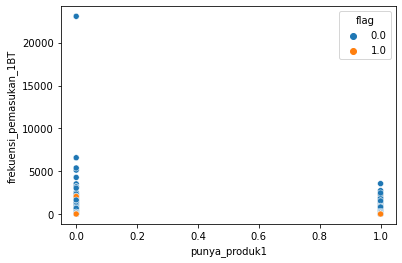

--------------------------------------------------
205
punya_produk1 frekuensi_pemasukan_2BT


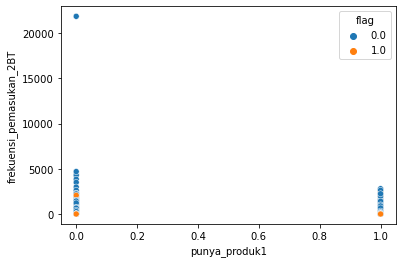

--------------------------------------------------
206
punya_produk1 frekuensi_pemasukan_3BT


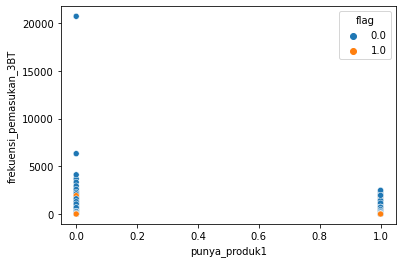

--------------------------------------------------
207
punya_produk1 frekuensi_pemasukan_4BT


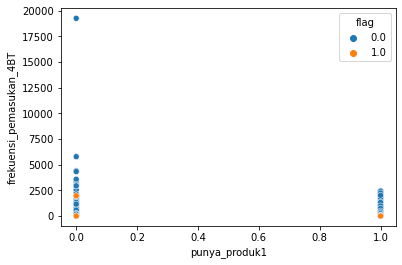

--------------------------------------------------
208
punya_produk1 frekuensi_pemasukan_5BT


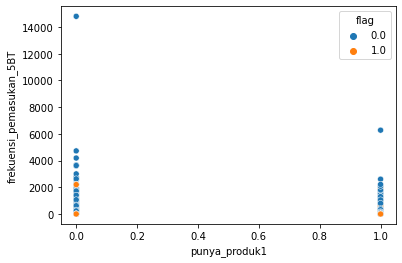

--------------------------------------------------
209
punya_produk1 frekuensi_pemasukan_6BT


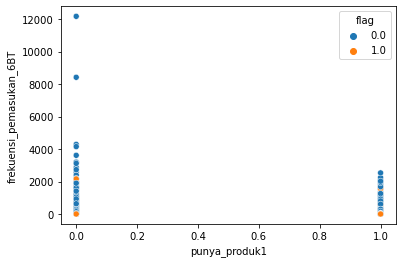

--------------------------------------------------
210
punya_produk1 flag


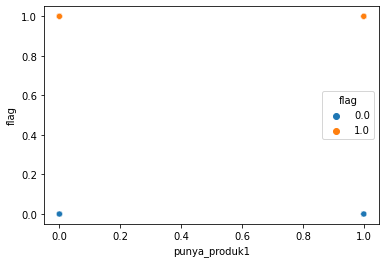

--------------------------------------------------
211
punya_produk2 punya_produk2


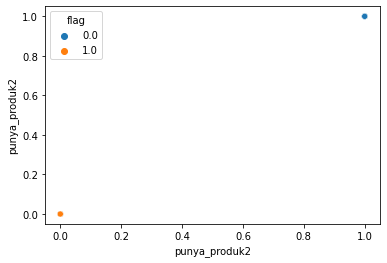

--------------------------------------------------
212
punya_produk2 punya_produk3


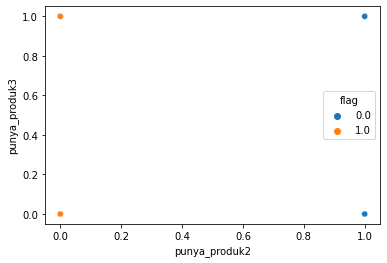

--------------------------------------------------
213
punya_produk2 punya_produk4


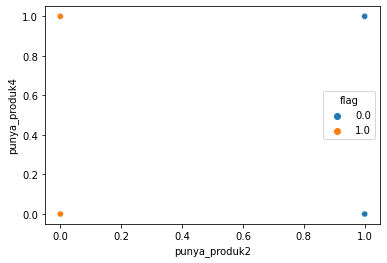

--------------------------------------------------
214
punya_produk2 punya_produk5


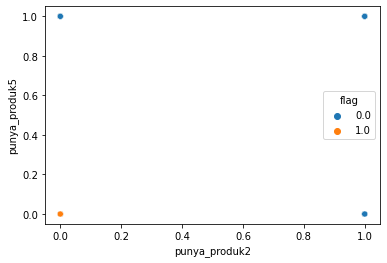

--------------------------------------------------
215
punya_produk2 punya_produk6


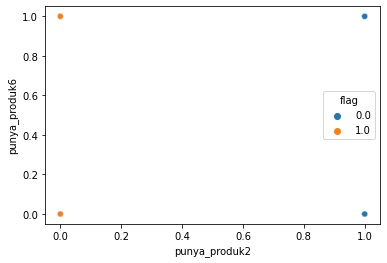

--------------------------------------------------
216
punya_produk2 omset


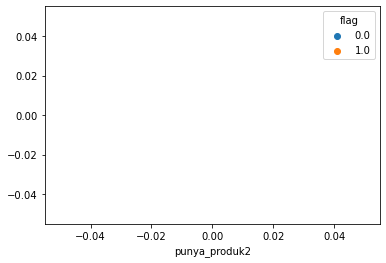

--------------------------------------------------
217
punya_produk2 penghasilan


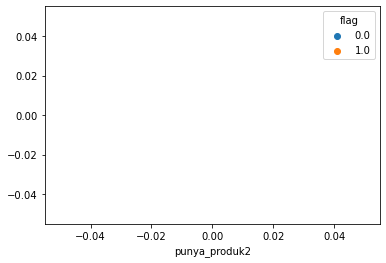

--------------------------------------------------
218
punya_produk2 average_sisauang_mingguan_1BT


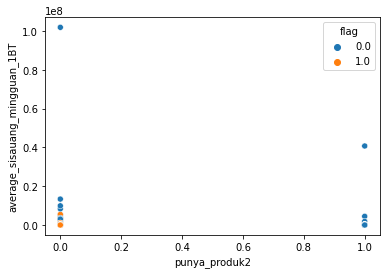

--------------------------------------------------
219
punya_produk2 average_sisauang_mingguan_2BT


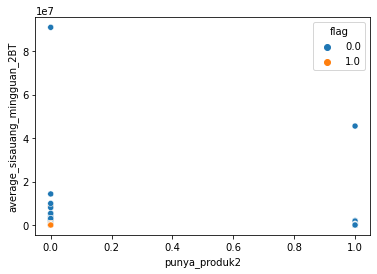

--------------------------------------------------
220
punya_produk2 average_sisauang_mingguan_3BT


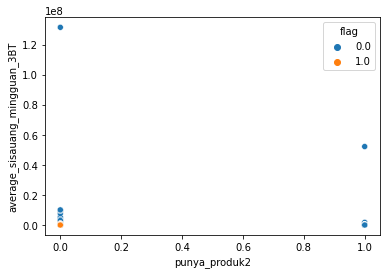

--------------------------------------------------
221
punya_produk2 average_sisauang_mingguan_4BT


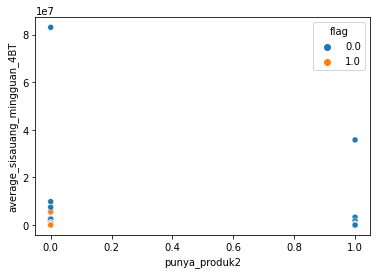

--------------------------------------------------
222
punya_produk2 average_sisauang_mingguan_5BT


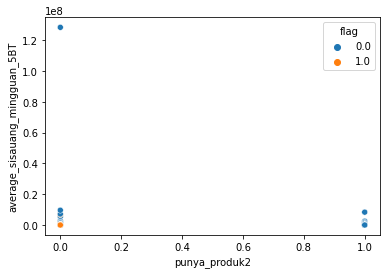

--------------------------------------------------
223
punya_produk2 average_sisauang_mingguan_6BT


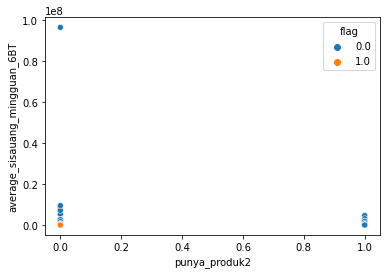

--------------------------------------------------
224
punya_produk2 sisauang_akhir_1BT


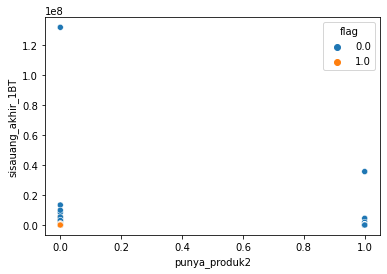

--------------------------------------------------
225
punya_produk2 sisauang_akhir_2BT


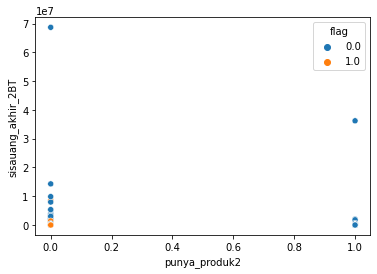

--------------------------------------------------
226
punya_produk2 sisauang_akhir_3BT


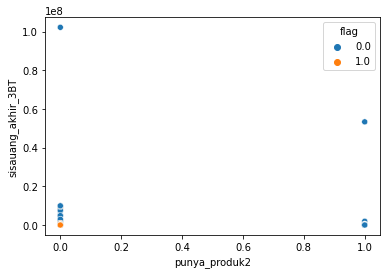

--------------------------------------------------
227
punya_produk2 sisauang_akhir_4BT


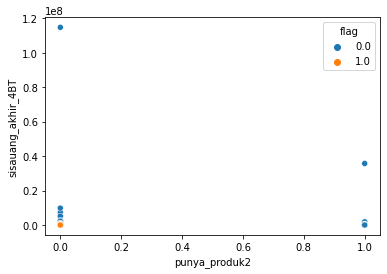

--------------------------------------------------
228
punya_produk2 sisauang_akhir_5BT


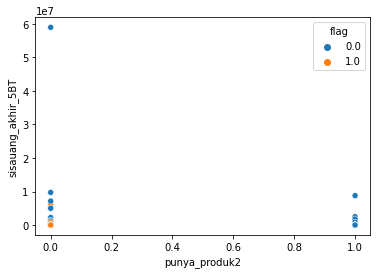

--------------------------------------------------
229
punya_produk2 sisauang_akhir_6BT


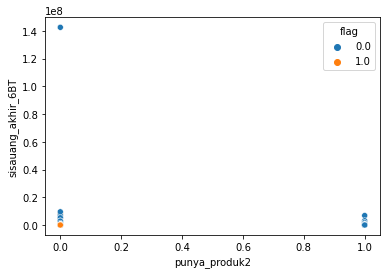

--------------------------------------------------
230
punya_produk2 sisauang_tertahan_1BT


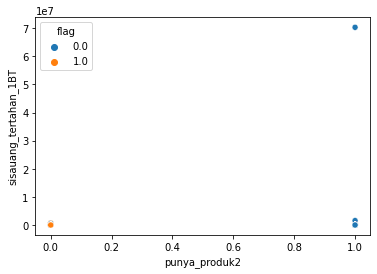

--------------------------------------------------
231
punya_produk2 sisauang_tertahan_2BT


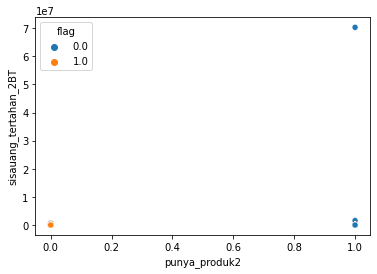

--------------------------------------------------
232
punya_produk2 sisauang_tertahan_3BT


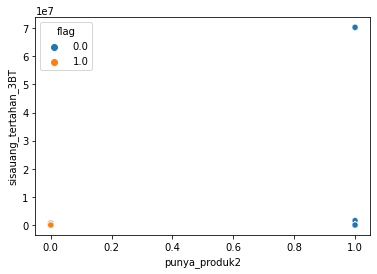

--------------------------------------------------
233
punya_produk2 sisauang_tertahan_4BT


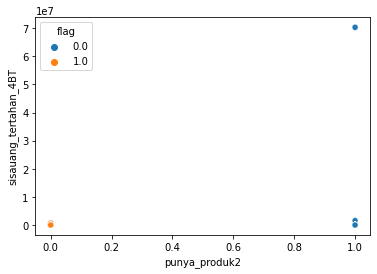

--------------------------------------------------
234
punya_produk2 sisauang_tertahan_5BT


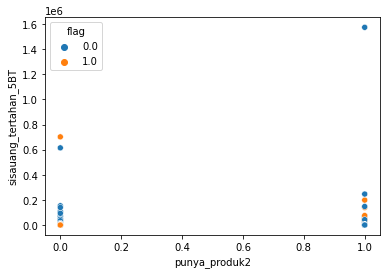

--------------------------------------------------
235
punya_produk2 sisauang_tertahan_6BT


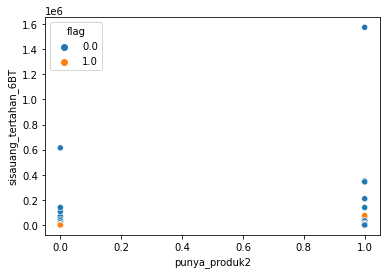

--------------------------------------------------
236
punya_produk2 sisauang_tersedia_1BT


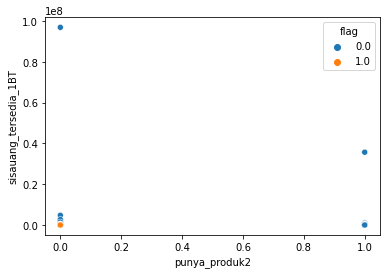

--------------------------------------------------
237
punya_produk2 sisauang_tersedia_2BT


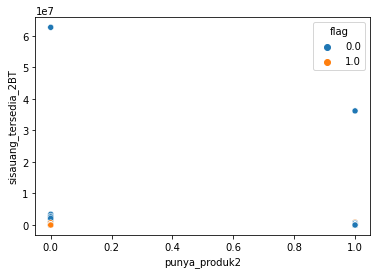

--------------------------------------------------
238
punya_produk2 sisauang_tersedia_3BT


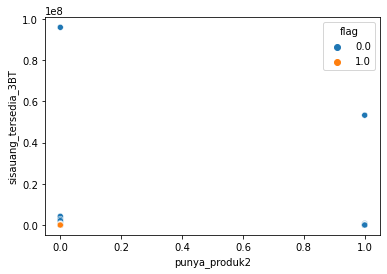

--------------------------------------------------
239
punya_produk2 sisauang_tersedia_4BT


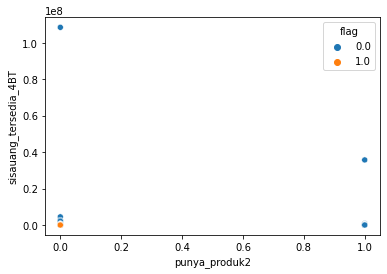

--------------------------------------------------
240
punya_produk2 sisauang_tersedia_5BT


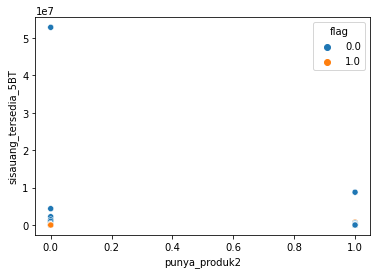

--------------------------------------------------
241
punya_produk2 sisauang_tersedia_6BT


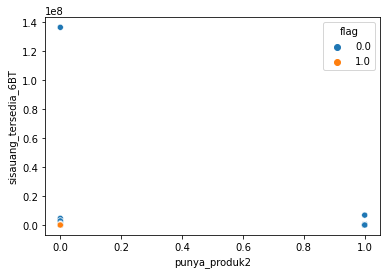

--------------------------------------------------
242
punya_produk2 sisa_hutang_1BT


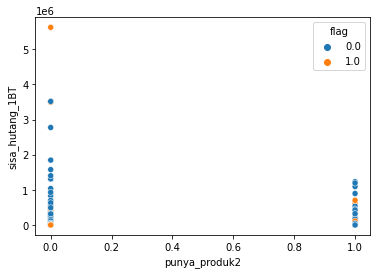

--------------------------------------------------
243
punya_produk2 sisa_hutang_2BT


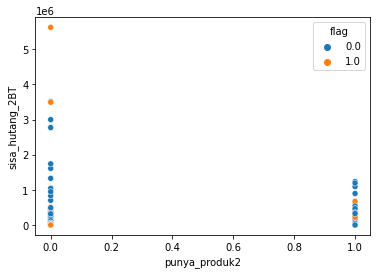

--------------------------------------------------
244
punya_produk2 sisa_hutang_3BT


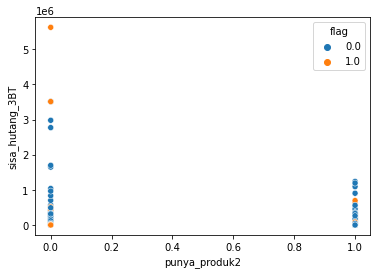

--------------------------------------------------
245
punya_produk2 sisa_hutang_4BT


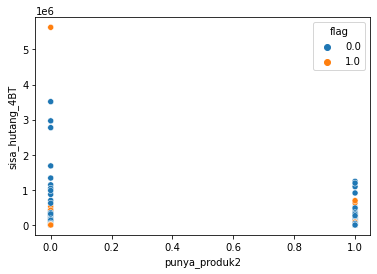

--------------------------------------------------
246
punya_produk2 sisa_hutang_5BT


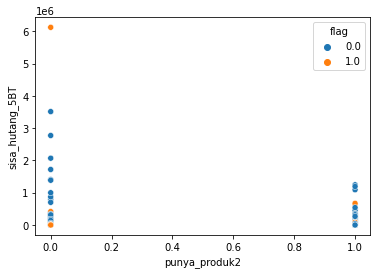

--------------------------------------------------
247
punya_produk2 sisa_hutang_6BT


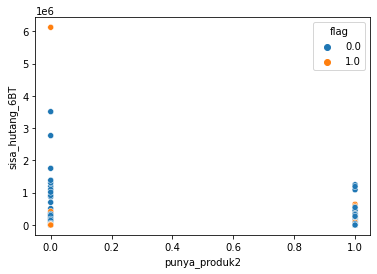

--------------------------------------------------
248
punya_produk2 jumlah_pembayaran_hutang_1BT


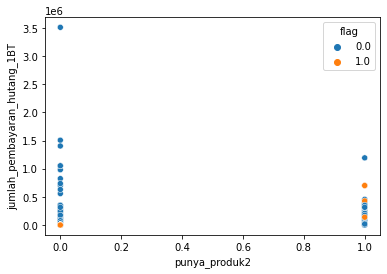

--------------------------------------------------
249
punya_produk2 jumlah_pembayaran_hutang_2BT


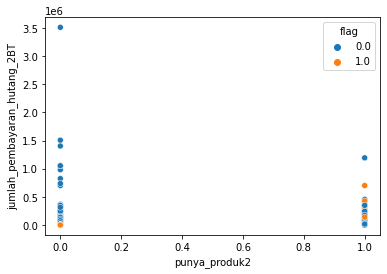

--------------------------------------------------
250
punya_produk2 jumlah_pembayaran_hutang_3BT


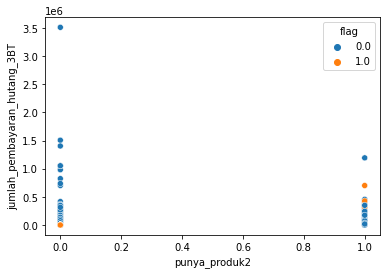

--------------------------------------------------
251
punya_produk2 jumlah_pembayaran_hutang_4BT


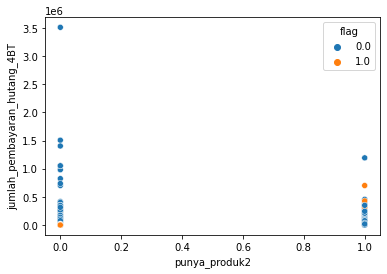

--------------------------------------------------
252
punya_produk2 jumlah_pembayaran_hutang_5BT


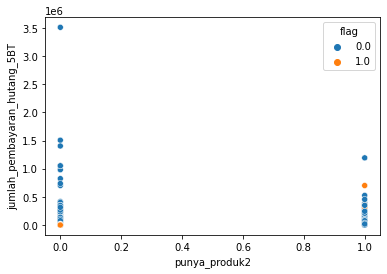

--------------------------------------------------
253
punya_produk2 jumlah_pembayaran_hutang_6BT


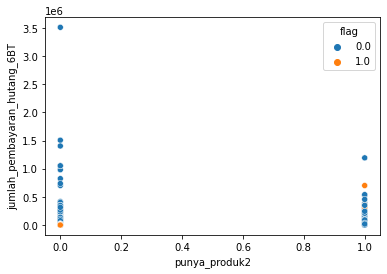

--------------------------------------------------
254
punya_produk2 jumlah_pengeluaran_1BT


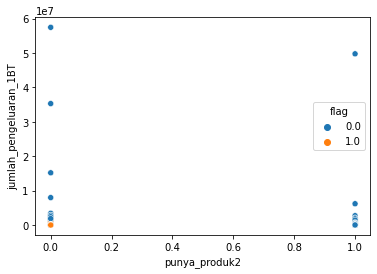

--------------------------------------------------
255
punya_produk2 jumlah_pengeluaran_2BT


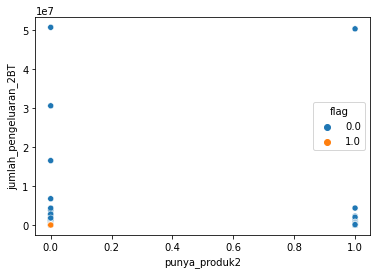

--------------------------------------------------
256
punya_produk2 jumlah_pengeluaran_3BT


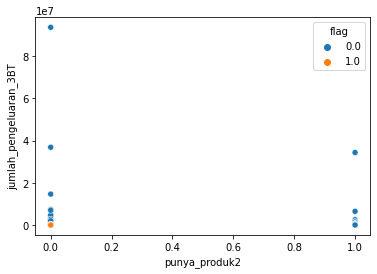

--------------------------------------------------
257
punya_produk2 jumlah_pengeluaran_4BT


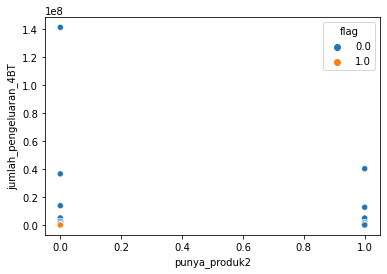

--------------------------------------------------
258
punya_produk2 jumlah_pengeluaran_5BT


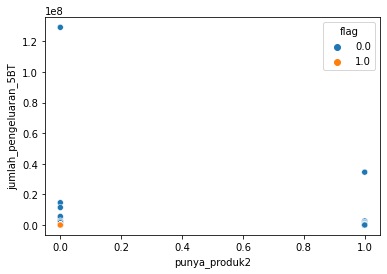

--------------------------------------------------
259
punya_produk2 jumlah_pengeluaran_6BT


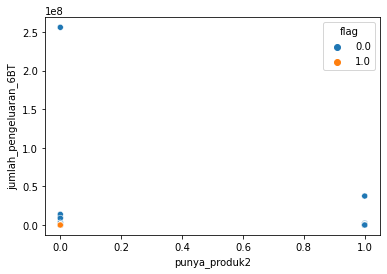

--------------------------------------------------
260
punya_produk2 jumlah_pemasukan_1BT


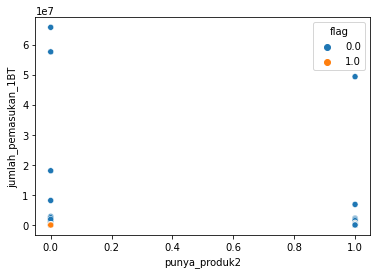

--------------------------------------------------
261
punya_produk2 jumlah_pemasukan_2BT


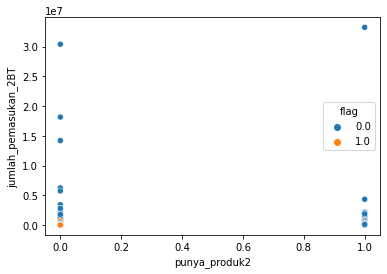

--------------------------------------------------
262
punya_produk2 jumlah_pemasukan_3BT


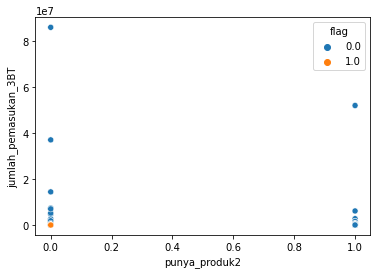

--------------------------------------------------
263
punya_produk2 jumlah_pemasukan_4BT


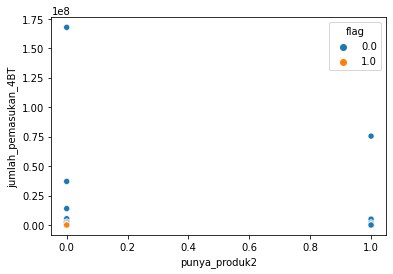

--------------------------------------------------
264
punya_produk2 jumlah_pemasukan_5BT


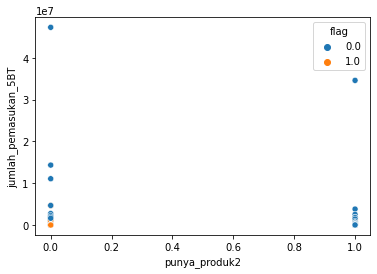

--------------------------------------------------
265
punya_produk2 jumlah_pemasukan_6BT


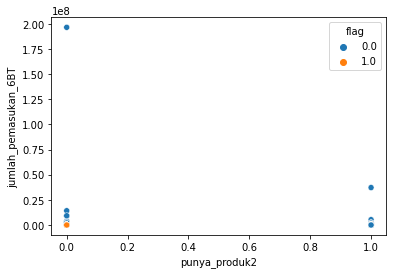

--------------------------------------------------
266
punya_produk2 frekuensi_pengeluaran_1BT


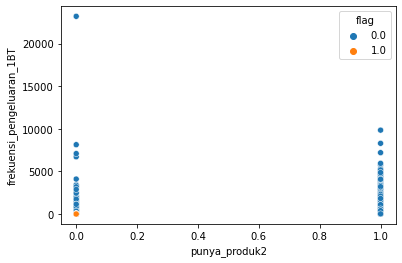

--------------------------------------------------
267
punya_produk2 frekuensi_pengeluaran_2BT


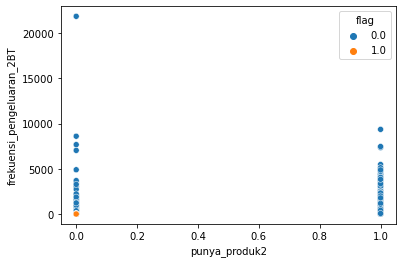

--------------------------------------------------
268
punya_produk2 frekuensi_pengeluaran_3BT


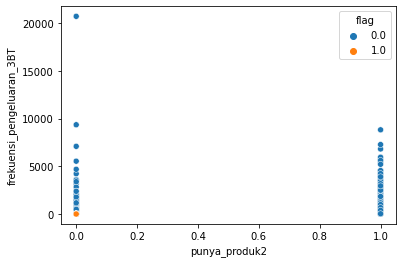

--------------------------------------------------
269
punya_produk2 frekuensi_pengeluaran_4BT


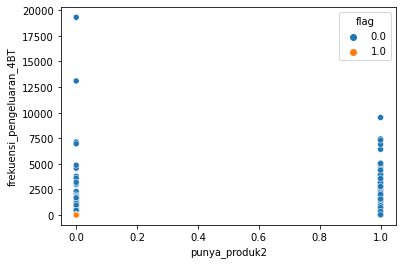

--------------------------------------------------
270
punya_produk2 frekuensi_pengeluaran_5BT


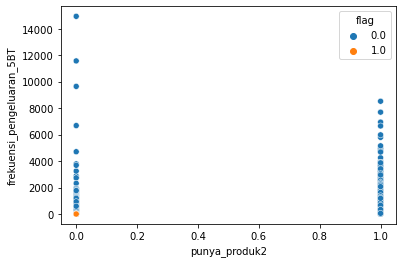

--------------------------------------------------
271
punya_produk2 frekuensi_pengeluaran_6BT


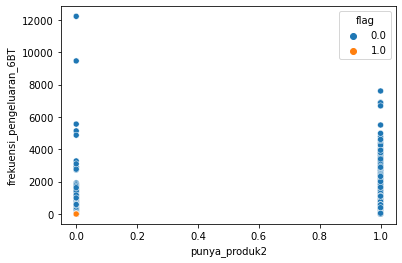

--------------------------------------------------
272
punya_produk2 frekuensi_pemasukan_1BT


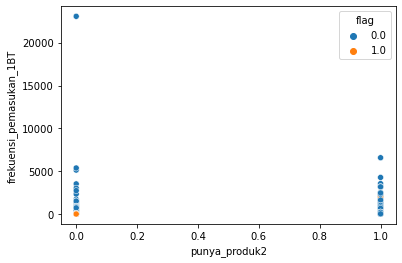

--------------------------------------------------
273
punya_produk2 frekuensi_pemasukan_2BT


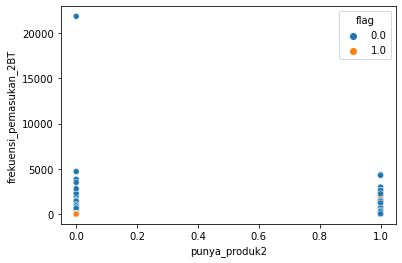

--------------------------------------------------
274
punya_produk2 frekuensi_pemasukan_3BT


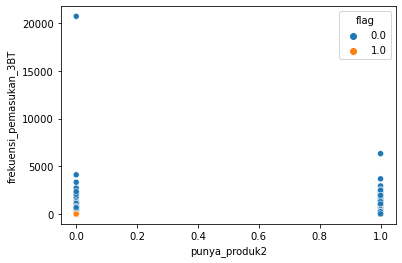

--------------------------------------------------
275
punya_produk2 frekuensi_pemasukan_4BT


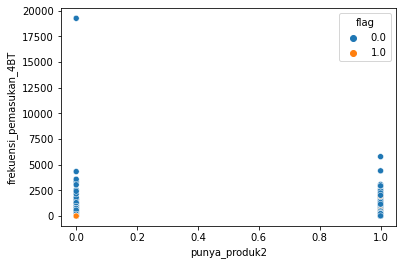

--------------------------------------------------
276
punya_produk2 frekuensi_pemasukan_5BT


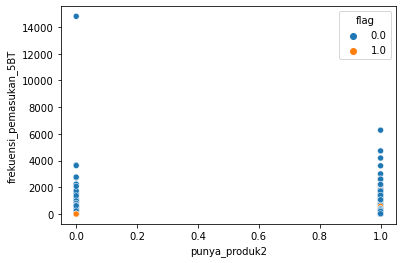

--------------------------------------------------
277
punya_produk2 frekuensi_pemasukan_6BT


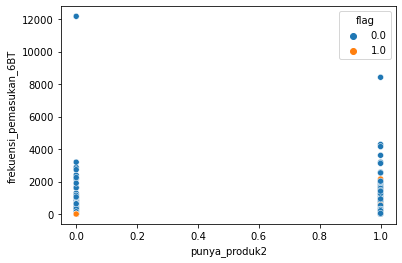

--------------------------------------------------
278
punya_produk2 flag


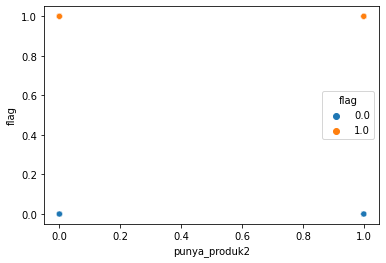

--------------------------------------------------
279
punya_produk3 punya_produk3


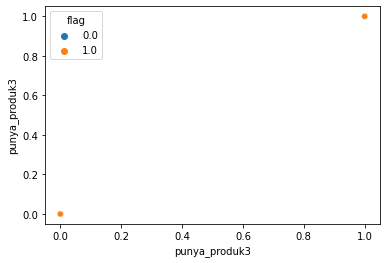

--------------------------------------------------
280
punya_produk3 punya_produk4


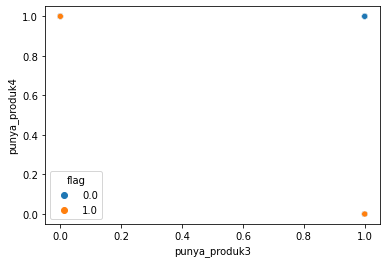

--------------------------------------------------
281
punya_produk3 punya_produk5


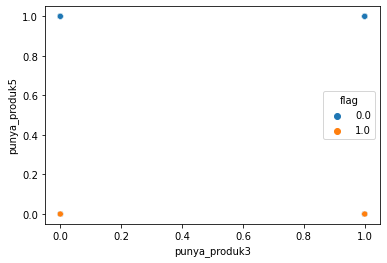

--------------------------------------------------
282
punya_produk3 punya_produk6


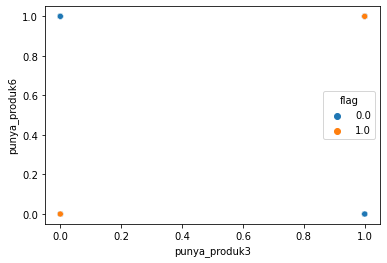

--------------------------------------------------
283
punya_produk3 omset


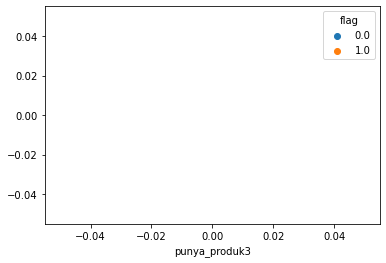

--------------------------------------------------
284
punya_produk3 penghasilan


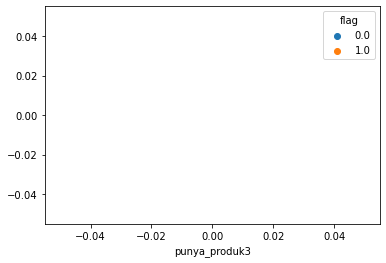

--------------------------------------------------
285
punya_produk3 average_sisauang_mingguan_1BT


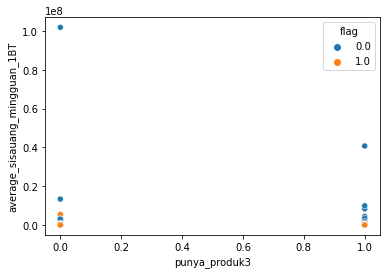

--------------------------------------------------
286
punya_produk3 average_sisauang_mingguan_2BT


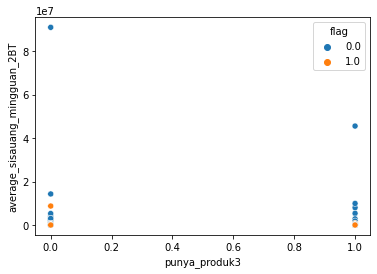

--------------------------------------------------
287
punya_produk3 average_sisauang_mingguan_3BT


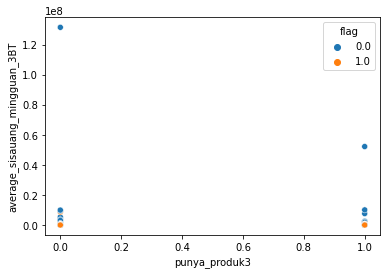

--------------------------------------------------
288
punya_produk3 average_sisauang_mingguan_4BT


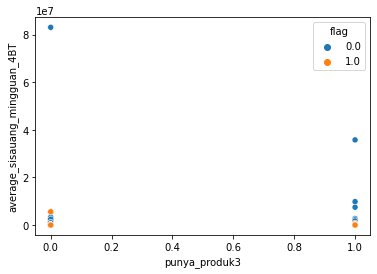

--------------------------------------------------
289
punya_produk3 average_sisauang_mingguan_5BT


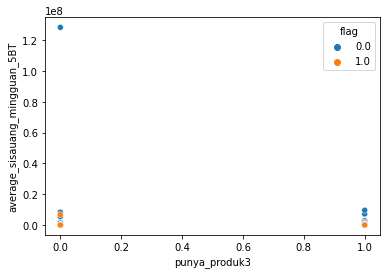

--------------------------------------------------
290
punya_produk3 average_sisauang_mingguan_6BT


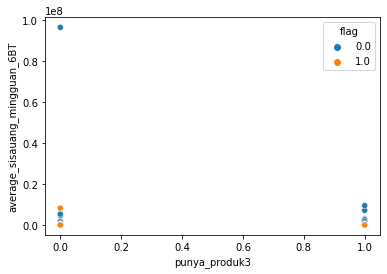

--------------------------------------------------
291
punya_produk3 sisauang_akhir_1BT


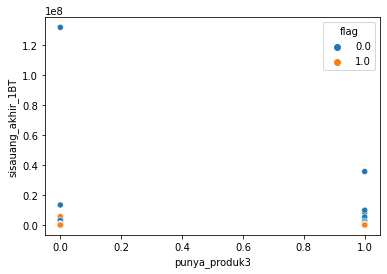

--------------------------------------------------
292
punya_produk3 sisauang_akhir_2BT


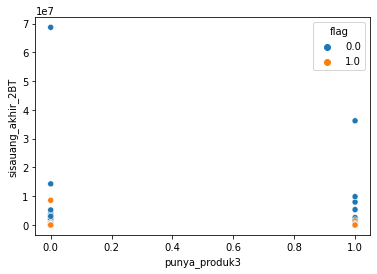

--------------------------------------------------
293
punya_produk3 sisauang_akhir_3BT


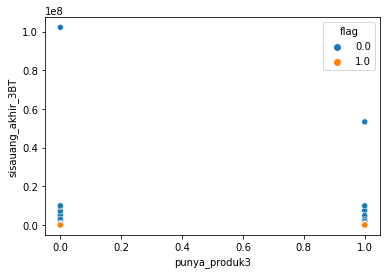

--------------------------------------------------
294
punya_produk3 sisauang_akhir_4BT


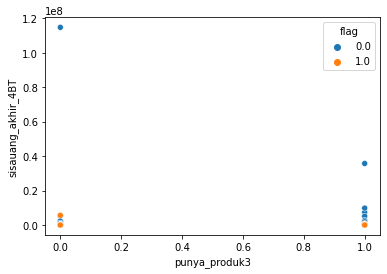

--------------------------------------------------
295
punya_produk3 sisauang_akhir_5BT


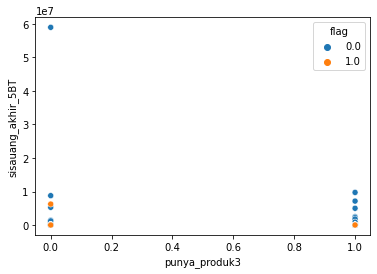

--------------------------------------------------
296
punya_produk3 sisauang_akhir_6BT


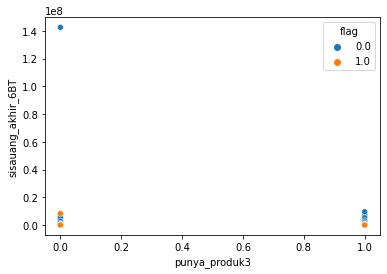

--------------------------------------------------
297
punya_produk3 sisauang_tertahan_1BT


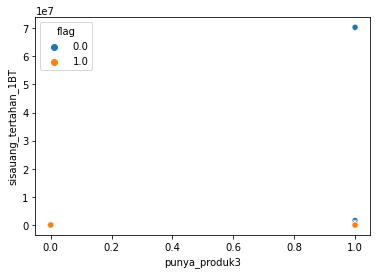

--------------------------------------------------
298
punya_produk3 sisauang_tertahan_2BT


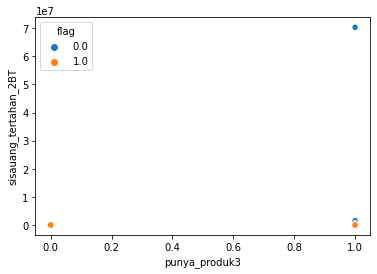

--------------------------------------------------
299
punya_produk3 sisauang_tertahan_3BT


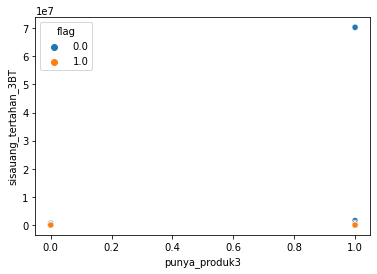

--------------------------------------------------
300
punya_produk3 sisauang_tertahan_4BT


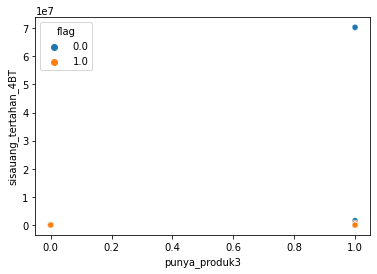

--------------------------------------------------
301
punya_produk3 sisauang_tertahan_5BT


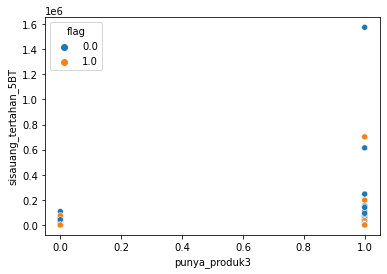

--------------------------------------------------
302
punya_produk3 sisauang_tertahan_6BT


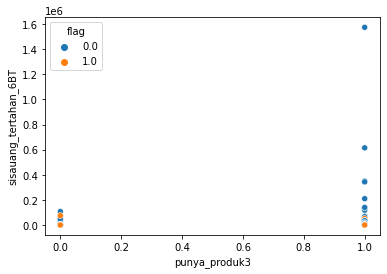

--------------------------------------------------
303
punya_produk3 sisauang_tersedia_1BT


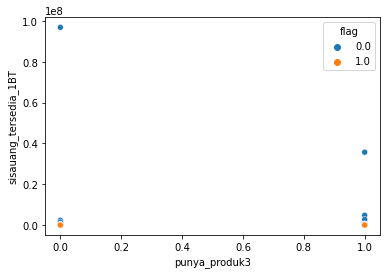

--------------------------------------------------
304
punya_produk3 sisauang_tersedia_2BT


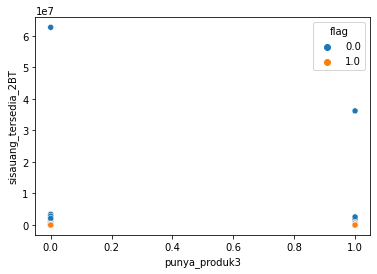

--------------------------------------------------
305
punya_produk3 sisauang_tersedia_3BT


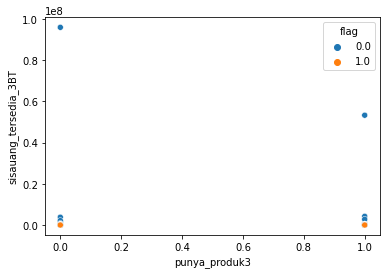

--------------------------------------------------
306
punya_produk3 sisauang_tersedia_4BT


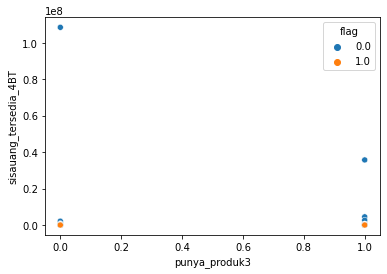

--------------------------------------------------
307
punya_produk3 sisauang_tersedia_5BT


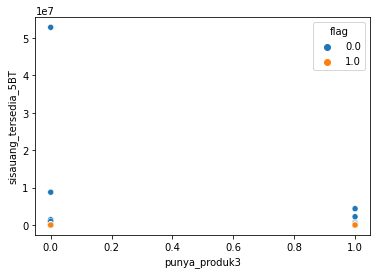

--------------------------------------------------
308
punya_produk3 sisauang_tersedia_6BT


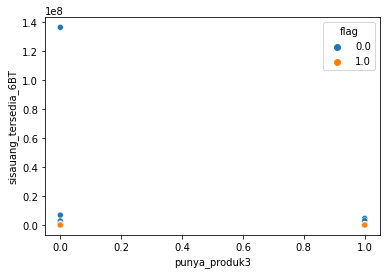

--------------------------------------------------
309
punya_produk3 sisa_hutang_1BT


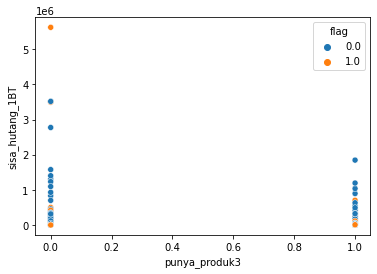

--------------------------------------------------
310
punya_produk3 sisa_hutang_2BT


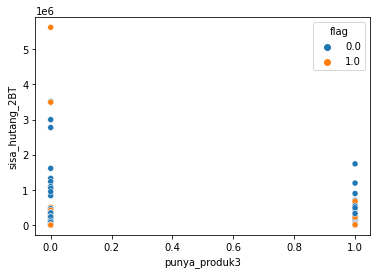

--------------------------------------------------
311
punya_produk3 sisa_hutang_3BT


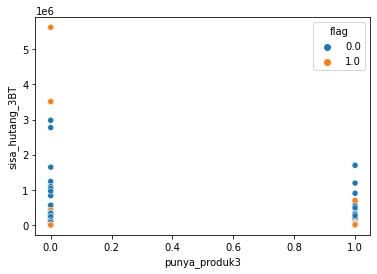

--------------------------------------------------
312
punya_produk3 sisa_hutang_4BT


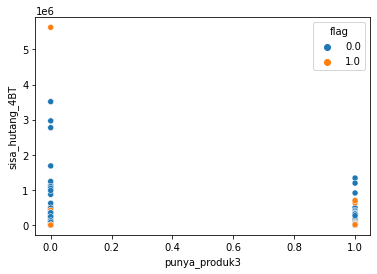

--------------------------------------------------
313
punya_produk3 sisa_hutang_5BT


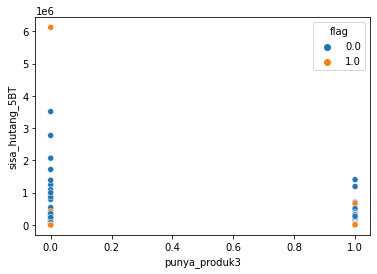

--------------------------------------------------
314
punya_produk3 sisa_hutang_6BT


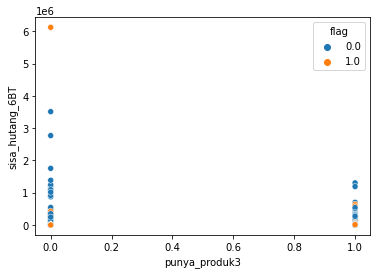

--------------------------------------------------
315
punya_produk3 jumlah_pembayaran_hutang_1BT


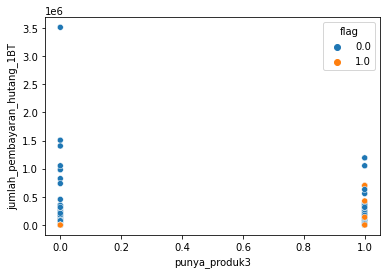

--------------------------------------------------
316
punya_produk3 jumlah_pembayaran_hutang_2BT


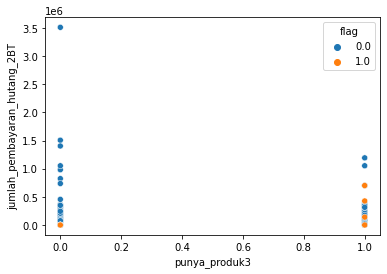

--------------------------------------------------
317
punya_produk3 jumlah_pembayaran_hutang_3BT


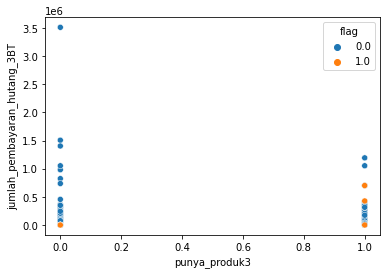

--------------------------------------------------
318
punya_produk3 jumlah_pembayaran_hutang_4BT


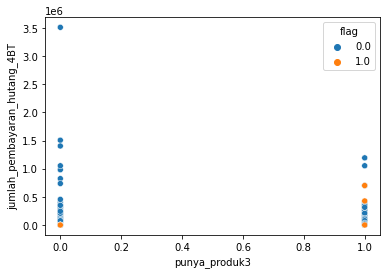

--------------------------------------------------
319
punya_produk3 jumlah_pembayaran_hutang_5BT


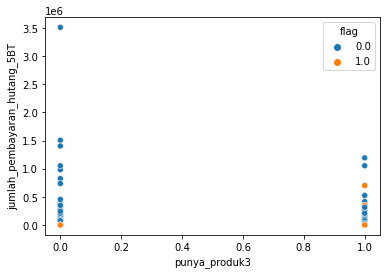

--------------------------------------------------
320
punya_produk3 jumlah_pembayaran_hutang_6BT


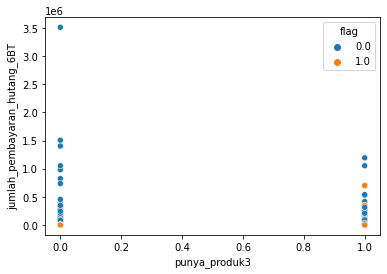

--------------------------------------------------
321
punya_produk3 jumlah_pengeluaran_1BT


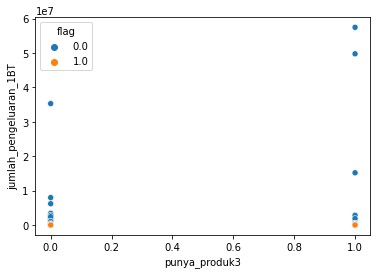

--------------------------------------------------
322
punya_produk3 jumlah_pengeluaran_2BT


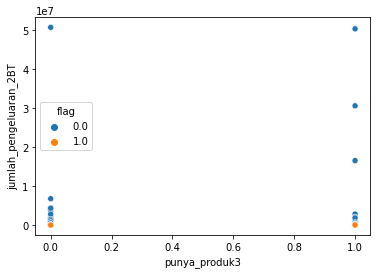

--------------------------------------------------
323
punya_produk3 jumlah_pengeluaran_3BT


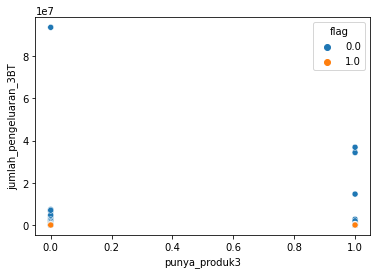

--------------------------------------------------
324
punya_produk3 jumlah_pengeluaran_4BT


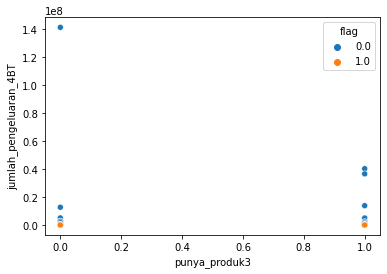

--------------------------------------------------
325
punya_produk3 jumlah_pengeluaran_5BT


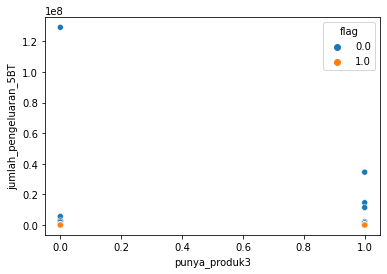

--------------------------------------------------
326
punya_produk3 jumlah_pengeluaran_6BT


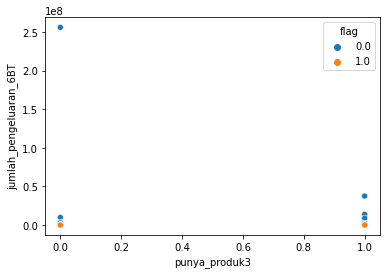

--------------------------------------------------
327
punya_produk3 jumlah_pemasukan_1BT


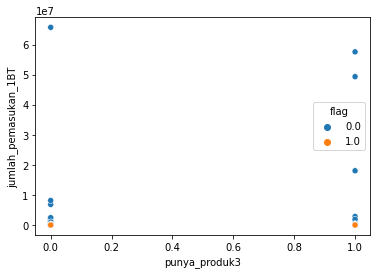

--------------------------------------------------
328
punya_produk3 jumlah_pemasukan_2BT


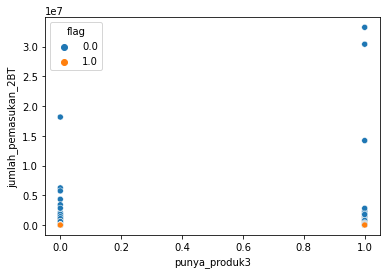

--------------------------------------------------
329
punya_produk3 jumlah_pemasukan_3BT


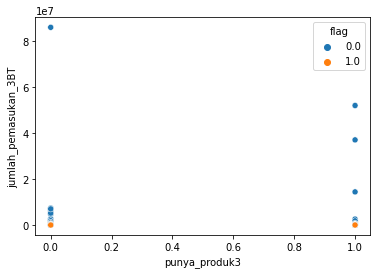

--------------------------------------------------
330
punya_produk3 jumlah_pemasukan_4BT


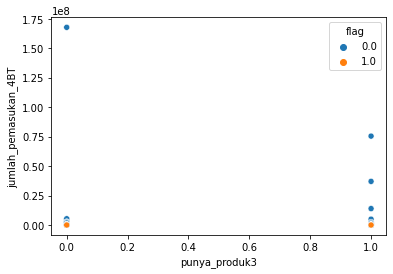

--------------------------------------------------
331
punya_produk3 jumlah_pemasukan_5BT


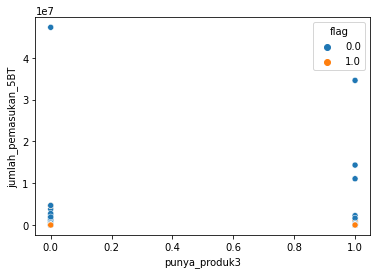

--------------------------------------------------
332
punya_produk3 jumlah_pemasukan_6BT


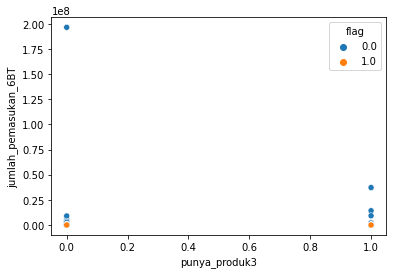

--------------------------------------------------
333
punya_produk3 frekuensi_pengeluaran_1BT


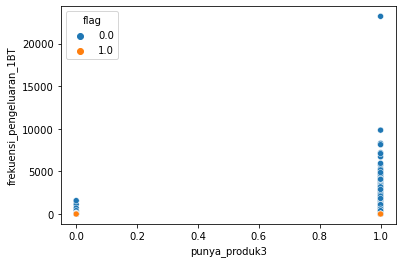

--------------------------------------------------
334
punya_produk3 frekuensi_pengeluaran_2BT


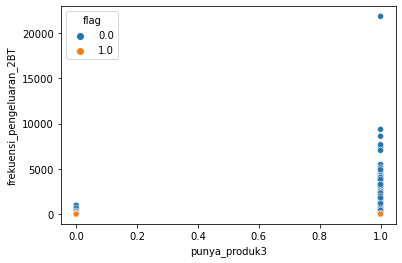

--------------------------------------------------
335
punya_produk3 frekuensi_pengeluaran_3BT


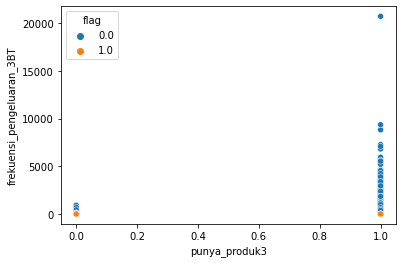

--------------------------------------------------
336
punya_produk3 frekuensi_pengeluaran_4BT


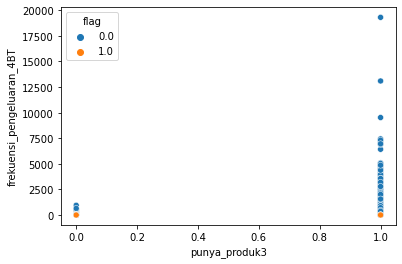

--------------------------------------------------
337
punya_produk3 frekuensi_pengeluaran_5BT


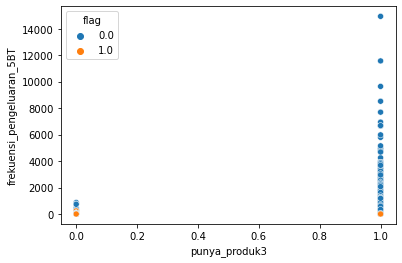

--------------------------------------------------
338
punya_produk3 frekuensi_pengeluaran_6BT


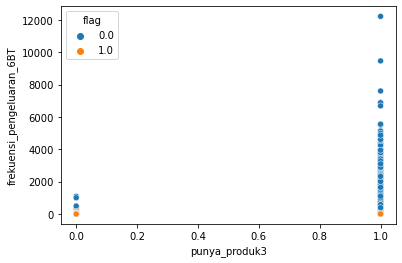

--------------------------------------------------
339
punya_produk3 frekuensi_pemasukan_1BT


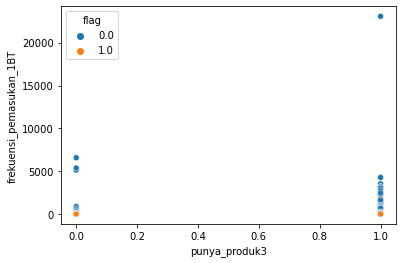

--------------------------------------------------
340
punya_produk3 frekuensi_pemasukan_2BT


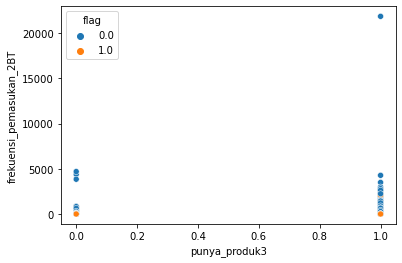

--------------------------------------------------
341
punya_produk3 frekuensi_pemasukan_3BT


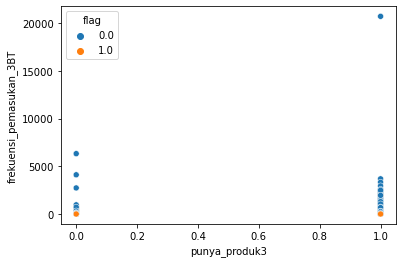

--------------------------------------------------
342
punya_produk3 frekuensi_pemasukan_4BT


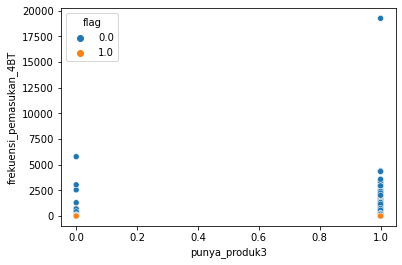

--------------------------------------------------
343
punya_produk3 frekuensi_pemasukan_5BT


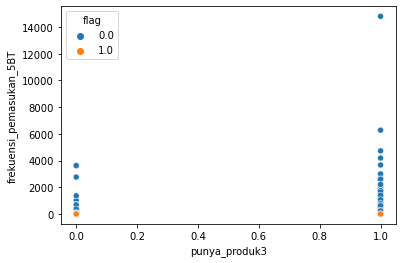

--------------------------------------------------
344
punya_produk3 frekuensi_pemasukan_6BT


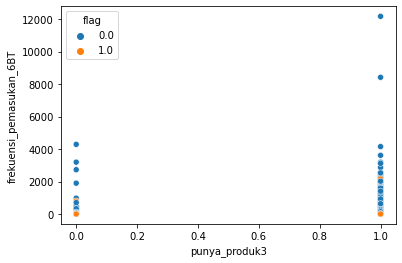

--------------------------------------------------
345
punya_produk3 flag


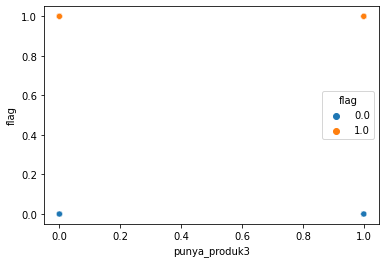

--------------------------------------------------
346
punya_produk4 punya_produk4


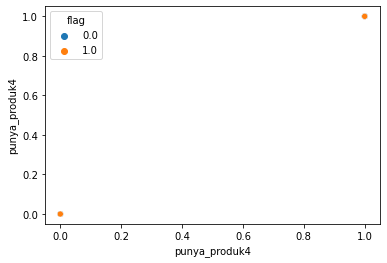

--------------------------------------------------
347
punya_produk4 punya_produk5


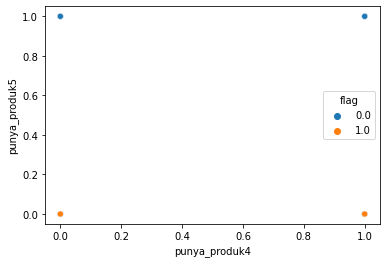

--------------------------------------------------
348
punya_produk4 punya_produk6


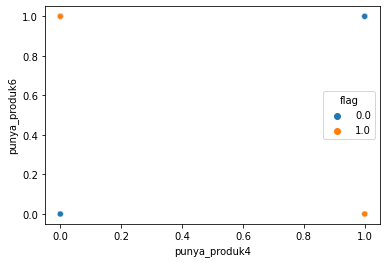

--------------------------------------------------
349
punya_produk4 omset


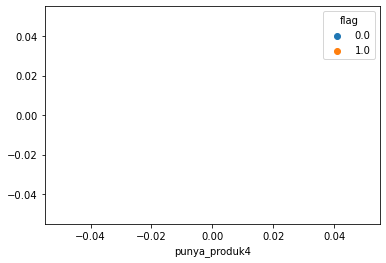

--------------------------------------------------
350
punya_produk4 penghasilan


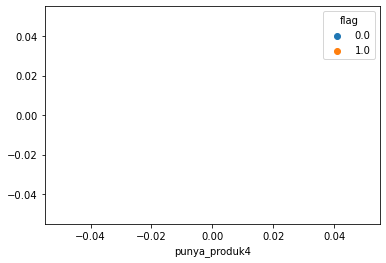

--------------------------------------------------
351
punya_produk4 average_sisauang_mingguan_1BT


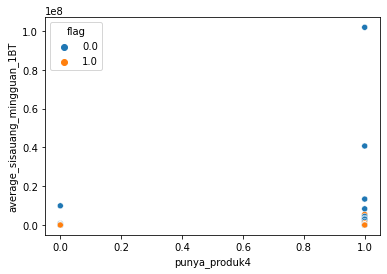

--------------------------------------------------
352
punya_produk4 average_sisauang_mingguan_2BT


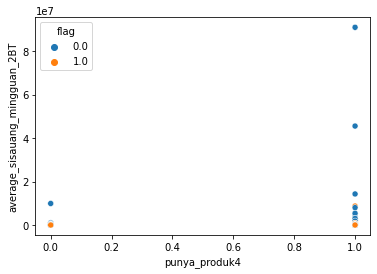

--------------------------------------------------
353
punya_produk4 average_sisauang_mingguan_3BT


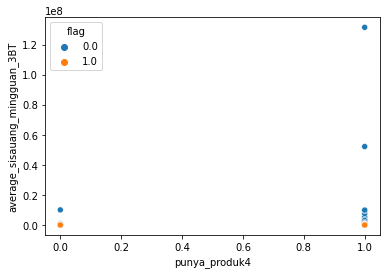

--------------------------------------------------
354
punya_produk4 average_sisauang_mingguan_4BT


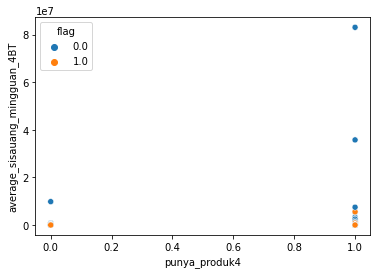

--------------------------------------------------
355
punya_produk4 average_sisauang_mingguan_5BT


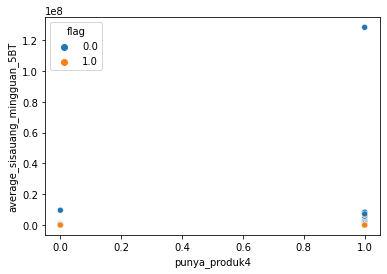

--------------------------------------------------
356
punya_produk4 average_sisauang_mingguan_6BT


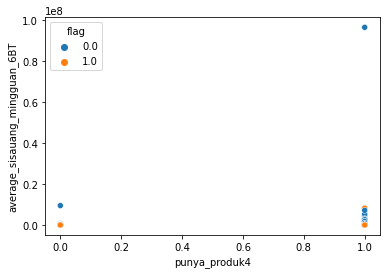

--------------------------------------------------
357
punya_produk4 sisauang_akhir_1BT


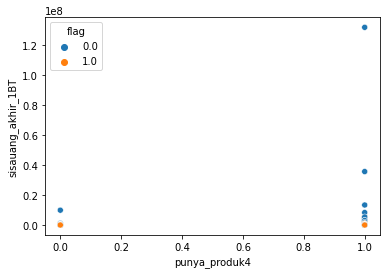

--------------------------------------------------
358
punya_produk4 sisauang_akhir_2BT


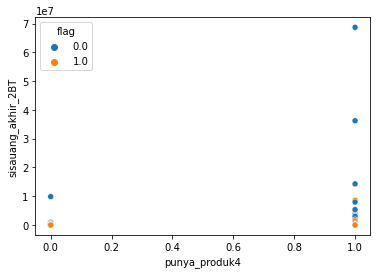

--------------------------------------------------
359
punya_produk4 sisauang_akhir_3BT


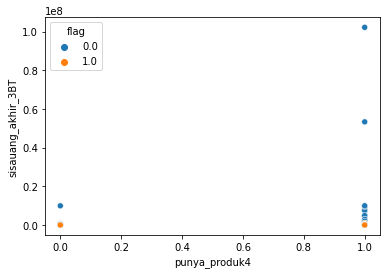

--------------------------------------------------
360
punya_produk4 sisauang_akhir_4BT


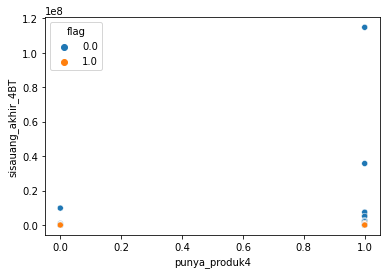

--------------------------------------------------
361
punya_produk4 sisauang_akhir_5BT


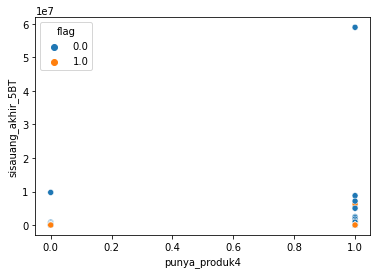

--------------------------------------------------
362
punya_produk4 sisauang_akhir_6BT


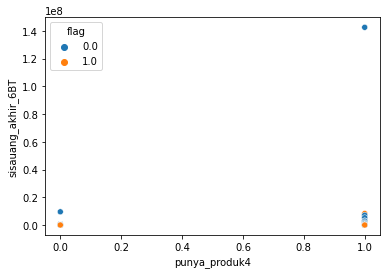

--------------------------------------------------
363
punya_produk4 sisauang_tertahan_1BT


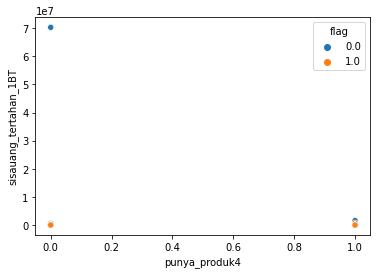

--------------------------------------------------
364
punya_produk4 sisauang_tertahan_2BT


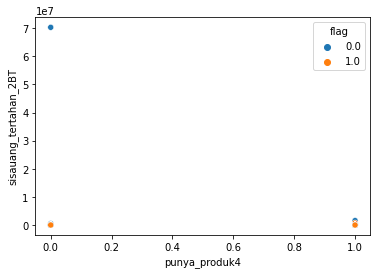

--------------------------------------------------
365
punya_produk4 sisauang_tertahan_3BT


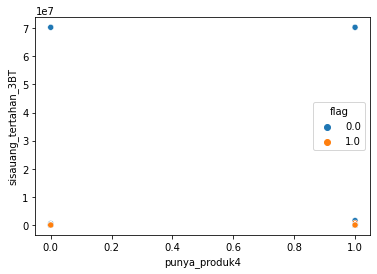

--------------------------------------------------
366
punya_produk4 sisauang_tertahan_4BT


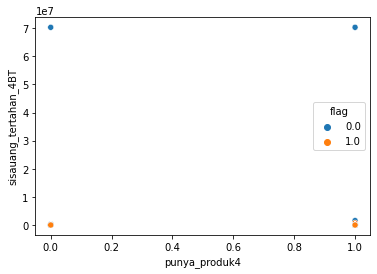

--------------------------------------------------
367
punya_produk4 sisauang_tertahan_5BT


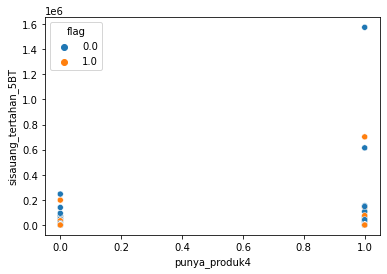

--------------------------------------------------
368
punya_produk4 sisauang_tertahan_6BT


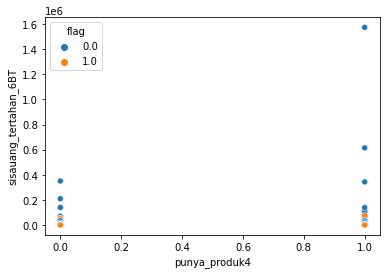

--------------------------------------------------
369
punya_produk4 sisauang_tersedia_1BT


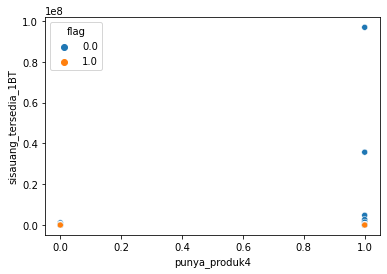

--------------------------------------------------
370
punya_produk4 sisauang_tersedia_2BT


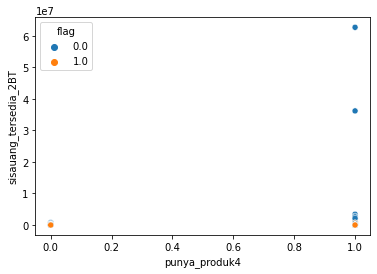

--------------------------------------------------
371
punya_produk4 sisauang_tersedia_3BT


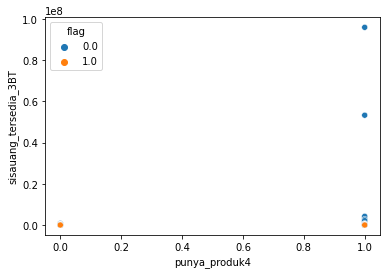

--------------------------------------------------
372
punya_produk4 sisauang_tersedia_4BT


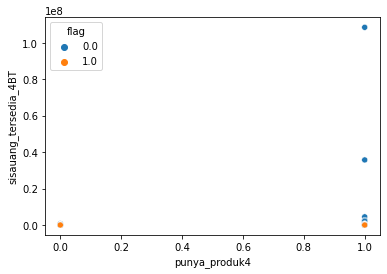

--------------------------------------------------
373
punya_produk4 sisauang_tersedia_5BT


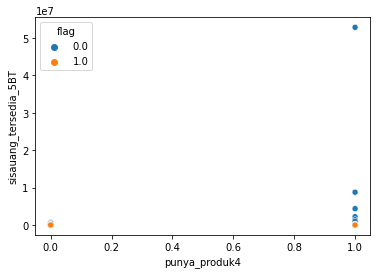

--------------------------------------------------
374
punya_produk4 sisauang_tersedia_6BT


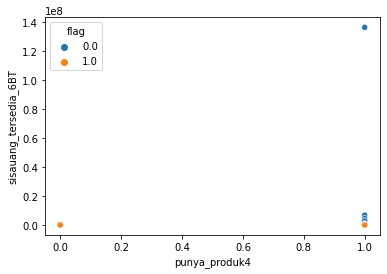

--------------------------------------------------
375
punya_produk4 sisa_hutang_1BT


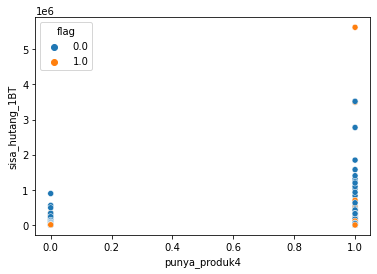

--------------------------------------------------
376
punya_produk4 sisa_hutang_2BT


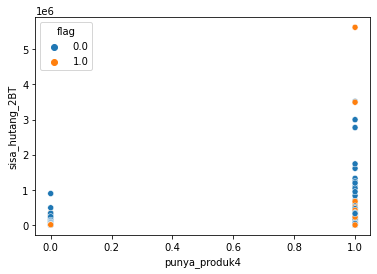

--------------------------------------------------
377
punya_produk4 sisa_hutang_3BT


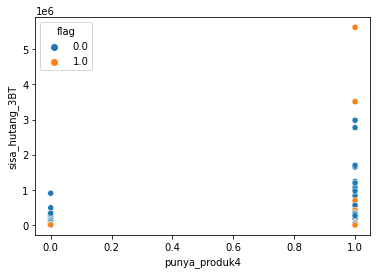

--------------------------------------------------
378
punya_produk4 sisa_hutang_4BT


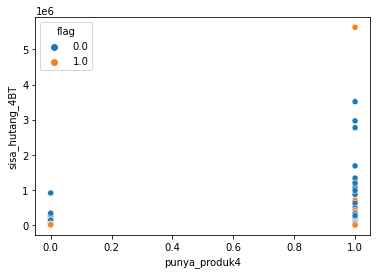

--------------------------------------------------
379
punya_produk4 sisa_hutang_5BT


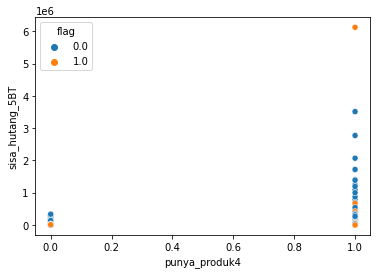

--------------------------------------------------
380
punya_produk4 sisa_hutang_6BT


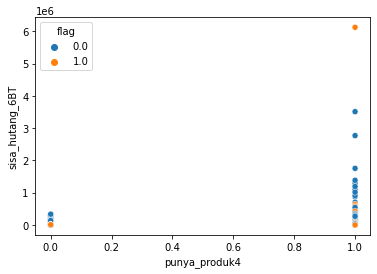

--------------------------------------------------
381
punya_produk4 jumlah_pembayaran_hutang_1BT


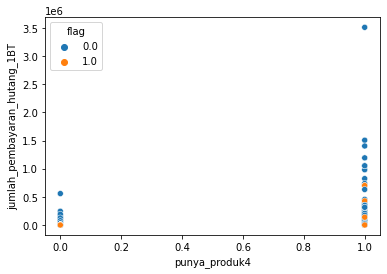

--------------------------------------------------
382
punya_produk4 jumlah_pembayaran_hutang_2BT


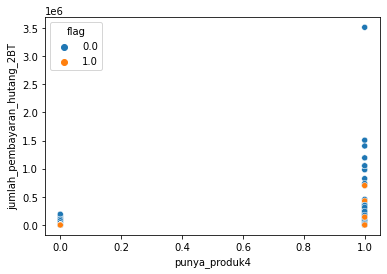

--------------------------------------------------
383
punya_produk4 jumlah_pembayaran_hutang_3BT


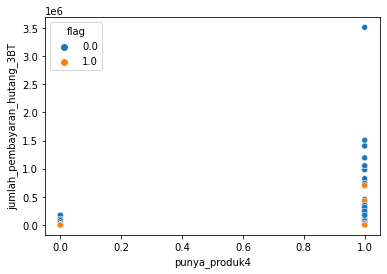

--------------------------------------------------
384
punya_produk4 jumlah_pembayaran_hutang_4BT


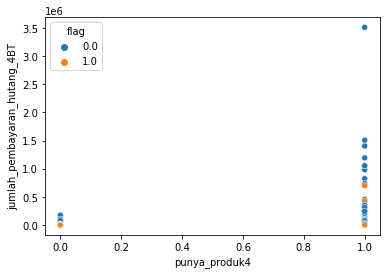

--------------------------------------------------
385
punya_produk4 jumlah_pembayaran_hutang_5BT


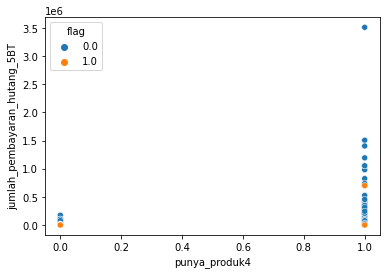

--------------------------------------------------
386
punya_produk4 jumlah_pembayaran_hutang_6BT


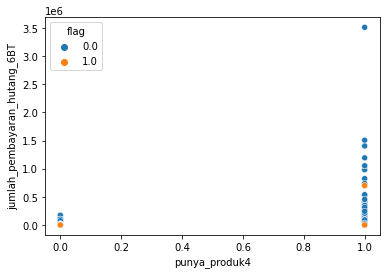

--------------------------------------------------
387
punya_produk4 jumlah_pengeluaran_1BT


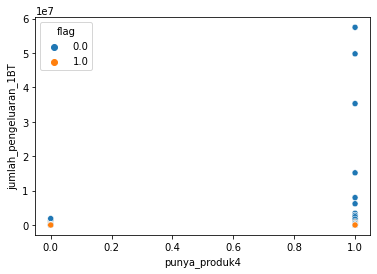

--------------------------------------------------
388
punya_produk4 jumlah_pengeluaran_2BT


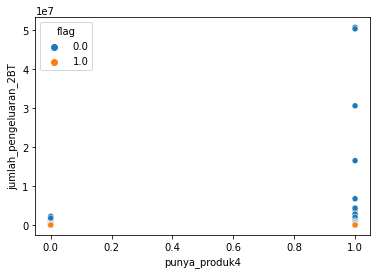

--------------------------------------------------
389
punya_produk4 jumlah_pengeluaran_3BT


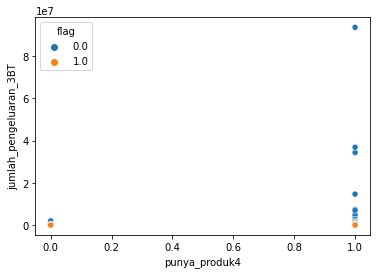

--------------------------------------------------
390
punya_produk4 jumlah_pengeluaran_4BT


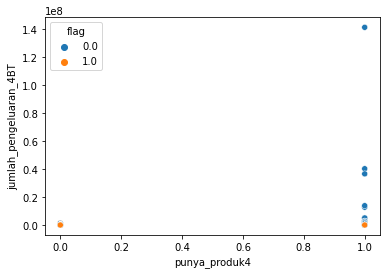

--------------------------------------------------
391
punya_produk4 jumlah_pengeluaran_5BT


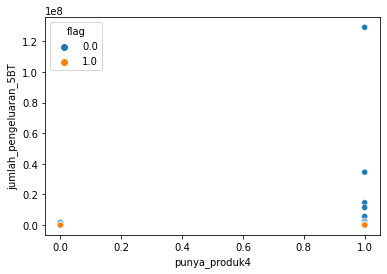

--------------------------------------------------
392
punya_produk4 jumlah_pengeluaran_6BT


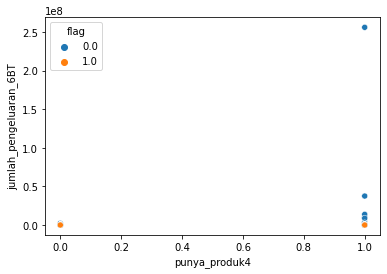

--------------------------------------------------
393
punya_produk4 jumlah_pemasukan_1BT


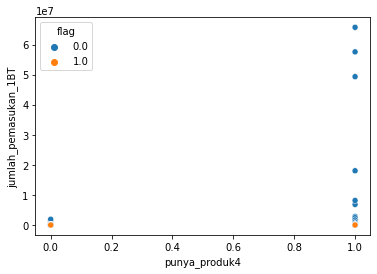

--------------------------------------------------
394
punya_produk4 jumlah_pemasukan_2BT


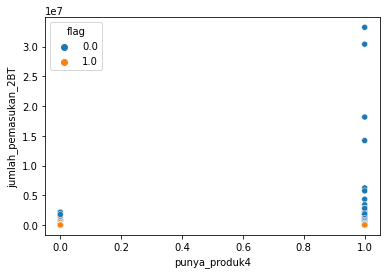

--------------------------------------------------
395
punya_produk4 jumlah_pemasukan_3BT


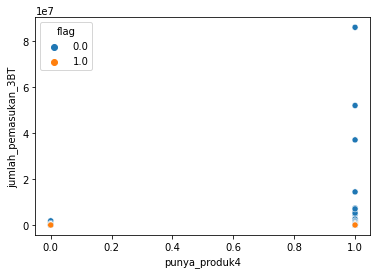

--------------------------------------------------
396
punya_produk4 jumlah_pemasukan_4BT


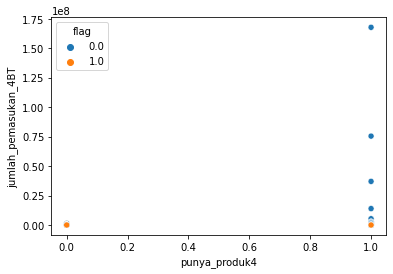

--------------------------------------------------
397
punya_produk4 jumlah_pemasukan_5BT


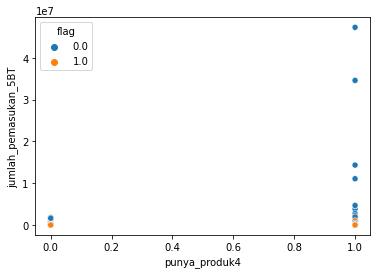

--------------------------------------------------
398
punya_produk4 jumlah_pemasukan_6BT


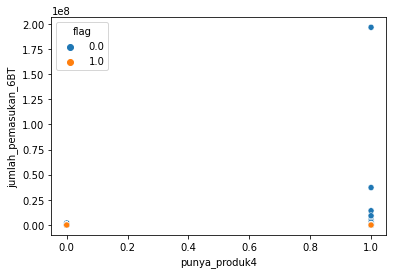

--------------------------------------------------
399
punya_produk4 frekuensi_pengeluaran_1BT


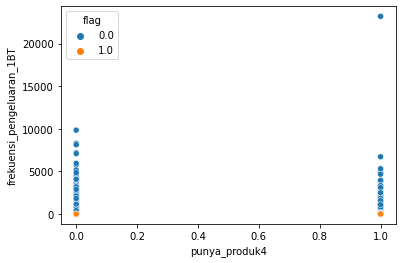

--------------------------------------------------
400
punya_produk4 frekuensi_pengeluaran_2BT


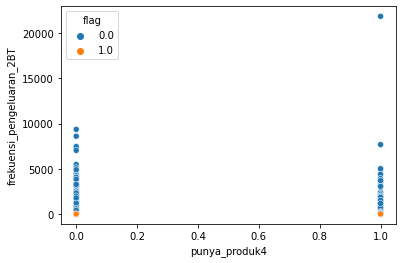

--------------------------------------------------
401
punya_produk4 frekuensi_pengeluaran_3BT


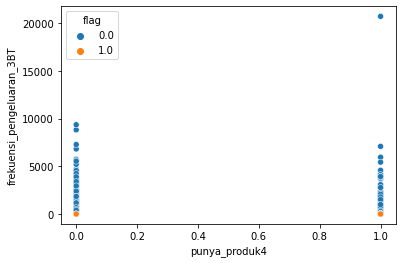

--------------------------------------------------
402
punya_produk4 frekuensi_pengeluaran_4BT


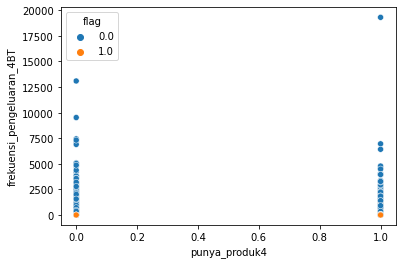

--------------------------------------------------
403
punya_produk4 frekuensi_pengeluaran_5BT


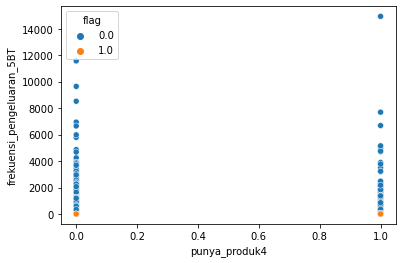

--------------------------------------------------
404
punya_produk4 frekuensi_pengeluaran_6BT


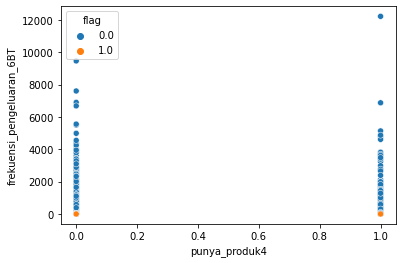

--------------------------------------------------
405
punya_produk4 frekuensi_pemasukan_1BT


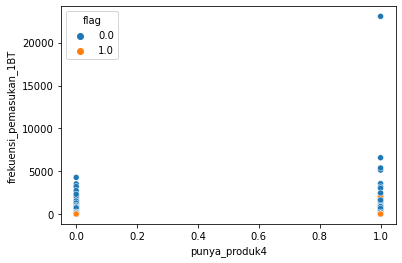

--------------------------------------------------
406
punya_produk4 frekuensi_pemasukan_2BT


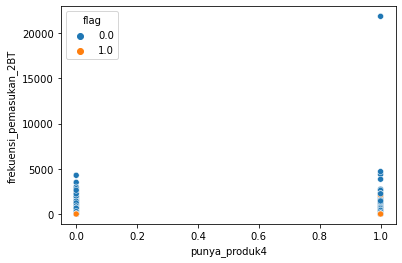

--------------------------------------------------
407
punya_produk4 frekuensi_pemasukan_3BT


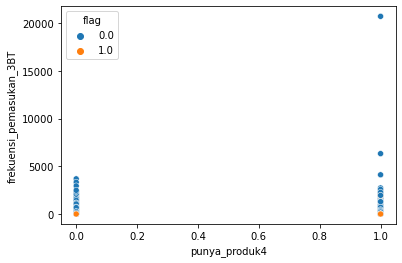

--------------------------------------------------
408
punya_produk4 frekuensi_pemasukan_4BT


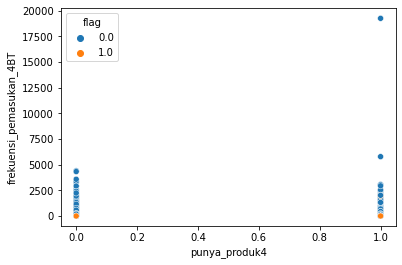

--------------------------------------------------
409
punya_produk4 frekuensi_pemasukan_5BT


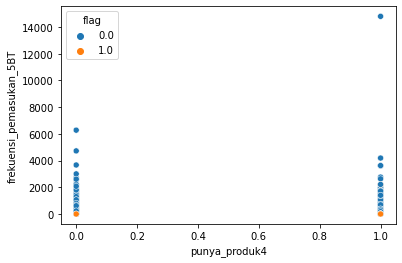

--------------------------------------------------
410
punya_produk4 frekuensi_pemasukan_6BT


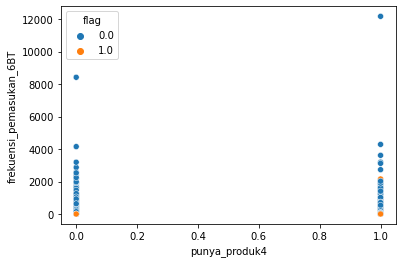

--------------------------------------------------
411
punya_produk4 flag


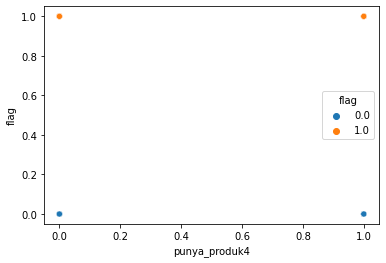

--------------------------------------------------
412
punya_produk5 punya_produk5


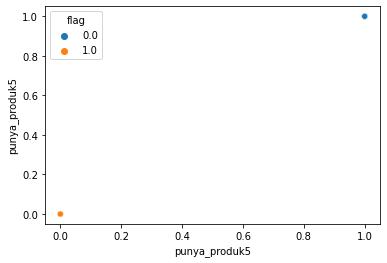

--------------------------------------------------
413
punya_produk5 punya_produk6


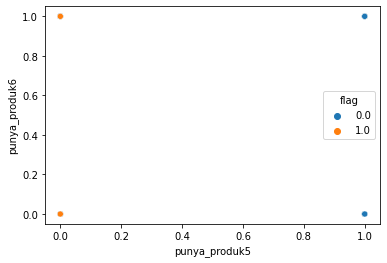

--------------------------------------------------
414
punya_produk5 omset


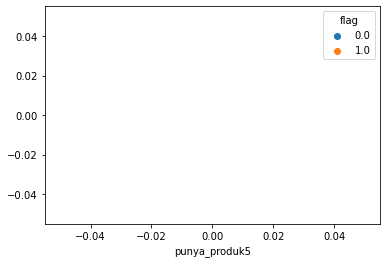

--------------------------------------------------
415
punya_produk5 penghasilan


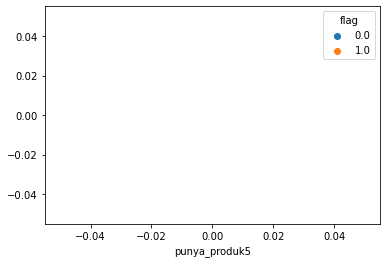

--------------------------------------------------
416
punya_produk5 average_sisauang_mingguan_1BT


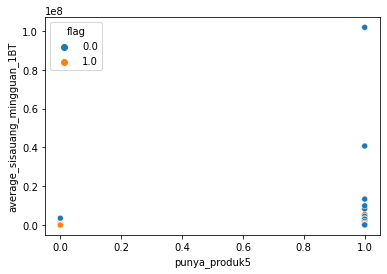

--------------------------------------------------
417
punya_produk5 average_sisauang_mingguan_2BT


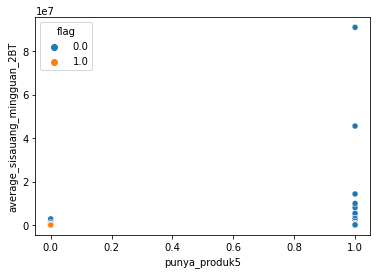

--------------------------------------------------
418
punya_produk5 average_sisauang_mingguan_3BT


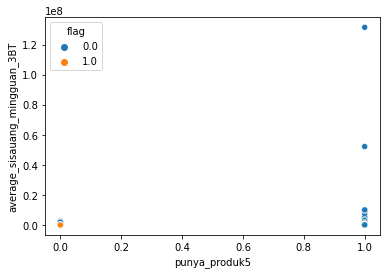

--------------------------------------------------
419
punya_produk5 average_sisauang_mingguan_4BT


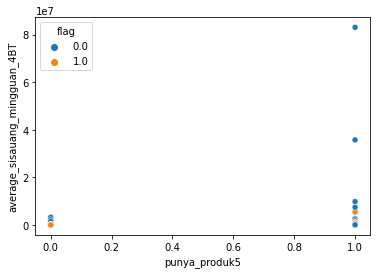

--------------------------------------------------
420
punya_produk5 average_sisauang_mingguan_5BT


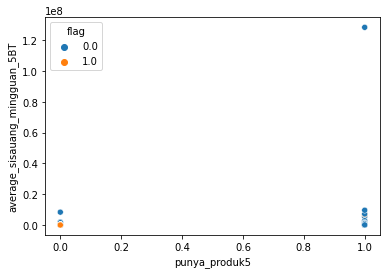

--------------------------------------------------
421
punya_produk5 average_sisauang_mingguan_6BT


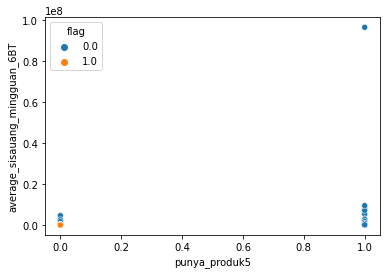

--------------------------------------------------
422
punya_produk5 sisauang_akhir_1BT


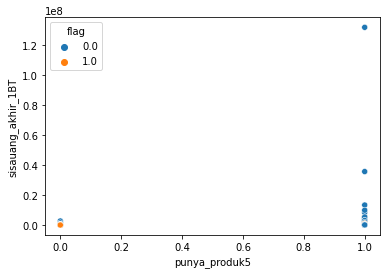

--------------------------------------------------
423
punya_produk5 sisauang_akhir_2BT


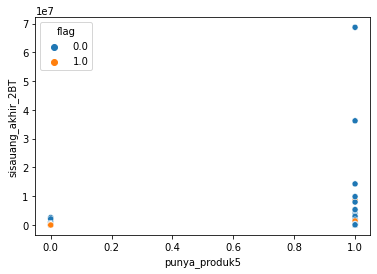

--------------------------------------------------
424
punya_produk5 sisauang_akhir_3BT


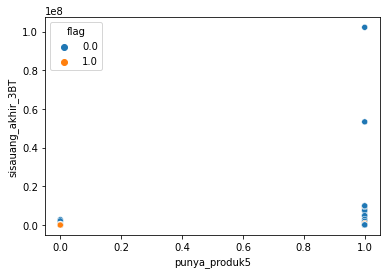

--------------------------------------------------
425
punya_produk5 sisauang_akhir_4BT


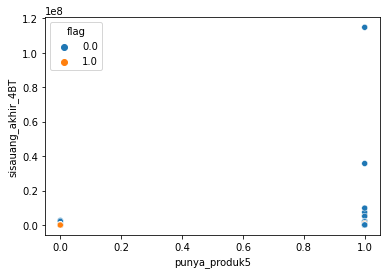

--------------------------------------------------
426
punya_produk5 sisauang_akhir_5BT


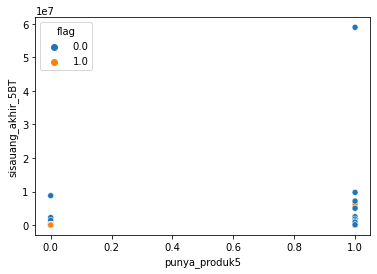

--------------------------------------------------
427
punya_produk5 sisauang_akhir_6BT


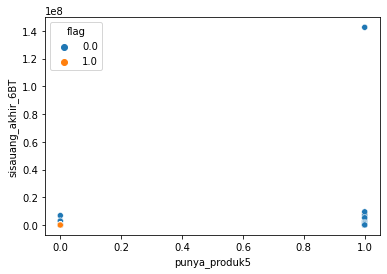

--------------------------------------------------
428
punya_produk5 sisauang_tertahan_1BT


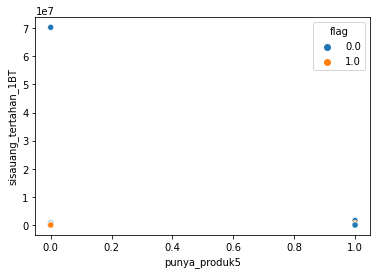

--------------------------------------------------
429
punya_produk5 sisauang_tertahan_2BT


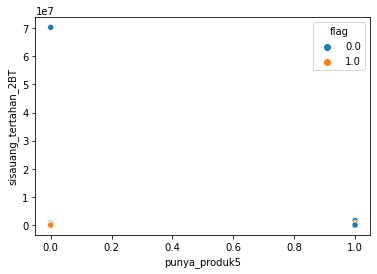

--------------------------------------------------
430
punya_produk5 sisauang_tertahan_3BT


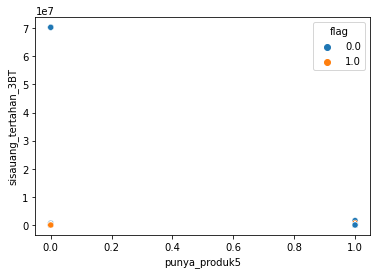

--------------------------------------------------
431
punya_produk5 sisauang_tertahan_4BT


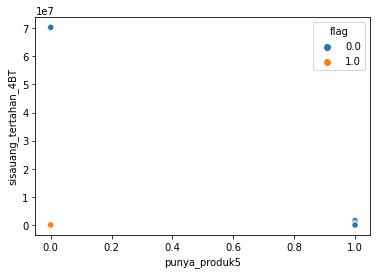

--------------------------------------------------
432
punya_produk5 sisauang_tertahan_5BT


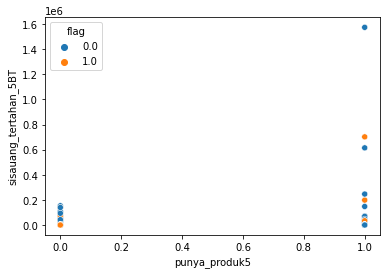

--------------------------------------------------
433
punya_produk5 sisauang_tertahan_6BT


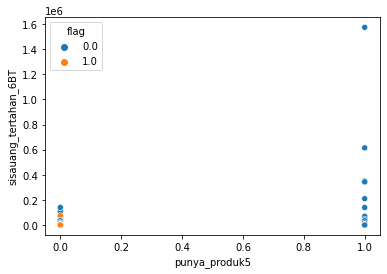

--------------------------------------------------
434
punya_produk5 sisauang_tersedia_1BT


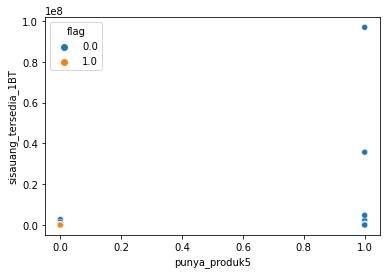

--------------------------------------------------
435
punya_produk5 sisauang_tersedia_2BT


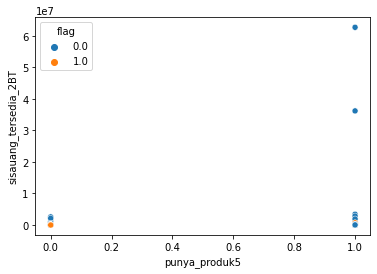

--------------------------------------------------
436
punya_produk5 sisauang_tersedia_3BT


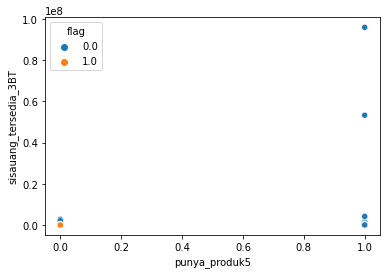

--------------------------------------------------
437
punya_produk5 sisauang_tersedia_4BT


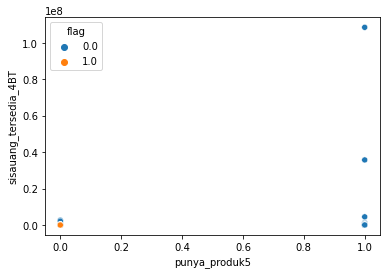

--------------------------------------------------
438
punya_produk5 sisauang_tersedia_5BT


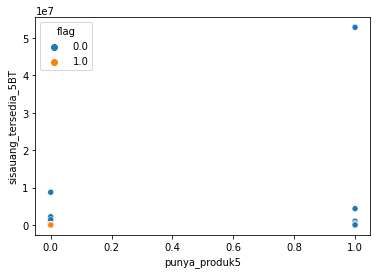

--------------------------------------------------
439
punya_produk5 sisauang_tersedia_6BT


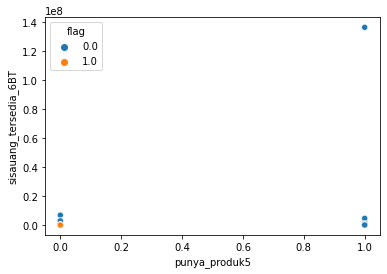

--------------------------------------------------
440
punya_produk5 sisa_hutang_1BT


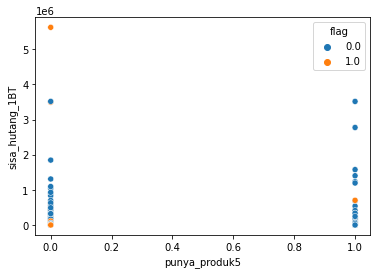

--------------------------------------------------
441
punya_produk5 sisa_hutang_2BT


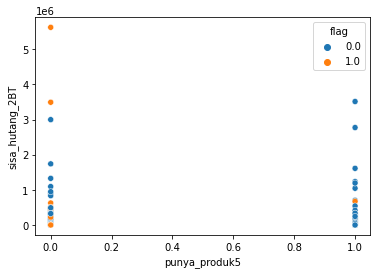

--------------------------------------------------
442
punya_produk5 sisa_hutang_3BT


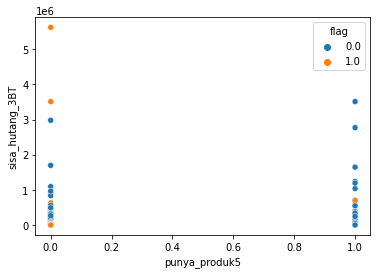

--------------------------------------------------
443
punya_produk5 sisa_hutang_4BT


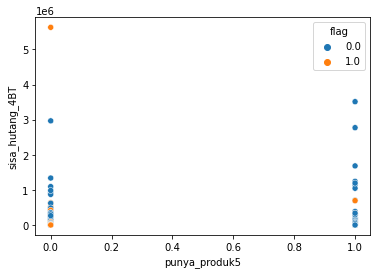

--------------------------------------------------
444
punya_produk5 sisa_hutang_5BT


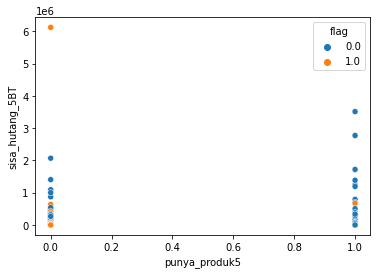

--------------------------------------------------
445
punya_produk5 sisa_hutang_6BT


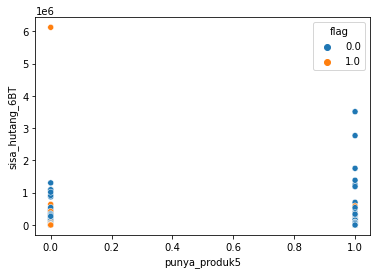

--------------------------------------------------
446
punya_produk5 jumlah_pembayaran_hutang_1BT


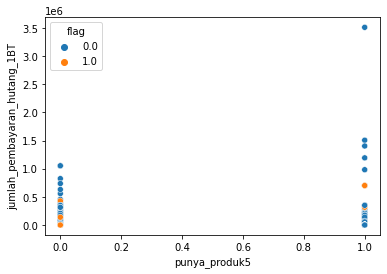

--------------------------------------------------
447
punya_produk5 jumlah_pembayaran_hutang_2BT


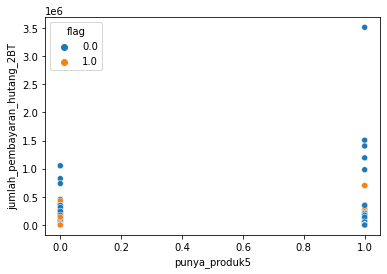

--------------------------------------------------
448
punya_produk5 jumlah_pembayaran_hutang_3BT


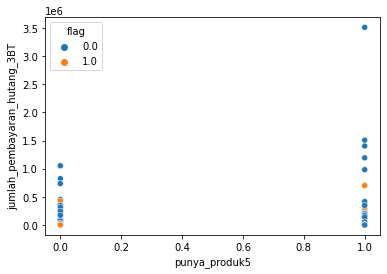

--------------------------------------------------
449
punya_produk5 jumlah_pembayaran_hutang_4BT


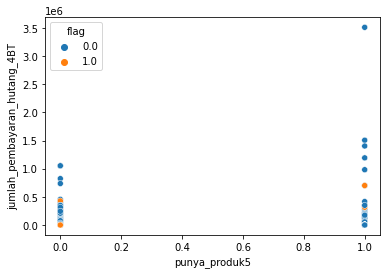

--------------------------------------------------
450
punya_produk5 jumlah_pembayaran_hutang_5BT


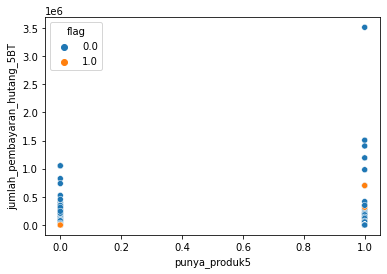

--------------------------------------------------
451
punya_produk5 jumlah_pembayaran_hutang_6BT


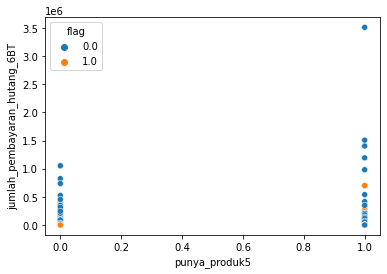

--------------------------------------------------
452
punya_produk5 jumlah_pengeluaran_1BT


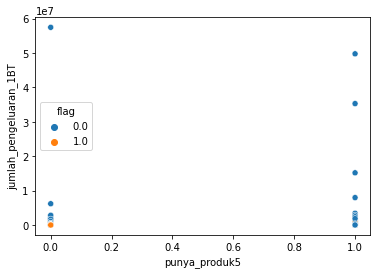

--------------------------------------------------
453
punya_produk5 jumlah_pengeluaran_2BT


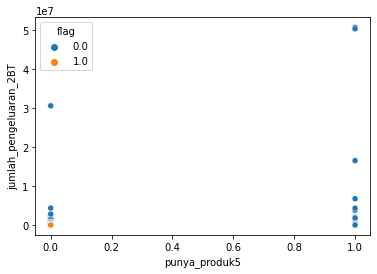

--------------------------------------------------
454
punya_produk5 jumlah_pengeluaran_3BT


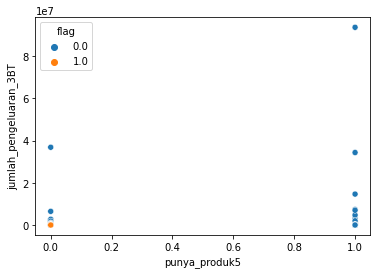

--------------------------------------------------
455
punya_produk5 jumlah_pengeluaran_4BT


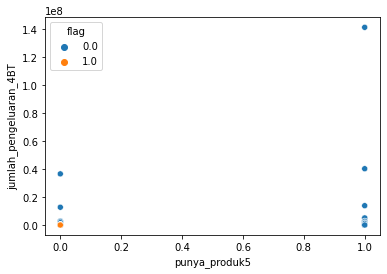

--------------------------------------------------
456
punya_produk5 jumlah_pengeluaran_5BT


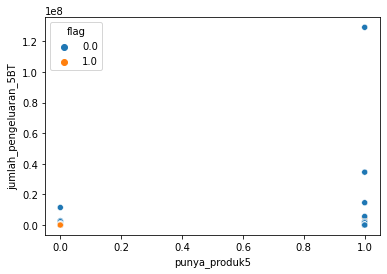

--------------------------------------------------
457
punya_produk5 jumlah_pengeluaran_6BT


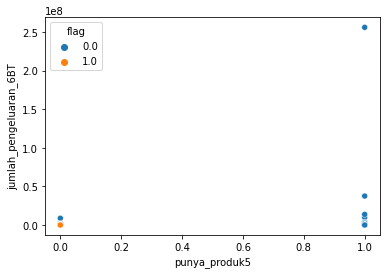

--------------------------------------------------
458
punya_produk5 jumlah_pemasukan_1BT


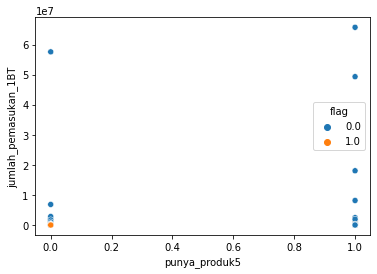

--------------------------------------------------
459
punya_produk5 jumlah_pemasukan_2BT


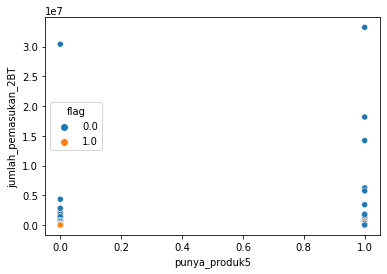

--------------------------------------------------
460
punya_produk5 jumlah_pemasukan_3BT


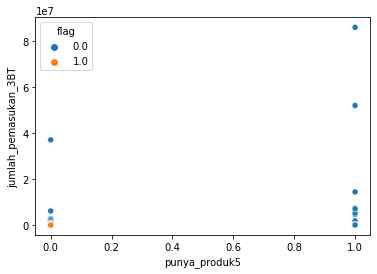

--------------------------------------------------
461
punya_produk5 jumlah_pemasukan_4BT


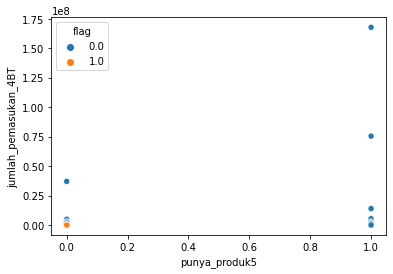

--------------------------------------------------
462
punya_produk5 jumlah_pemasukan_5BT


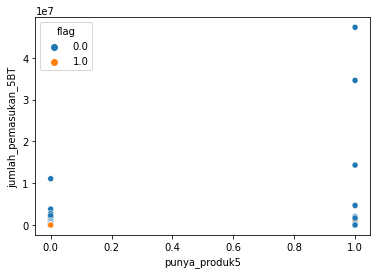

--------------------------------------------------
463
punya_produk5 jumlah_pemasukan_6BT


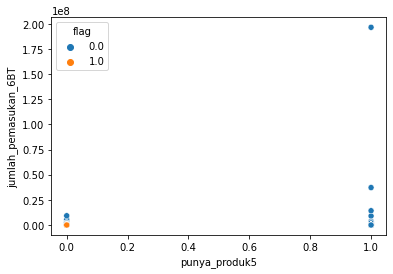

--------------------------------------------------
464
punya_produk5 frekuensi_pengeluaran_1BT


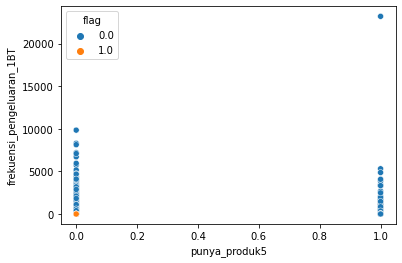

--------------------------------------------------
465
punya_produk5 frekuensi_pengeluaran_2BT


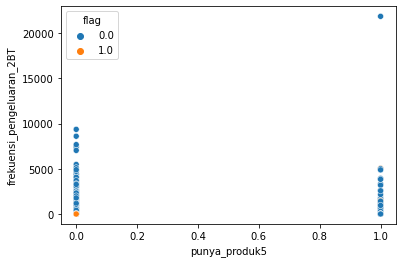

--------------------------------------------------
466
punya_produk5 frekuensi_pengeluaran_3BT


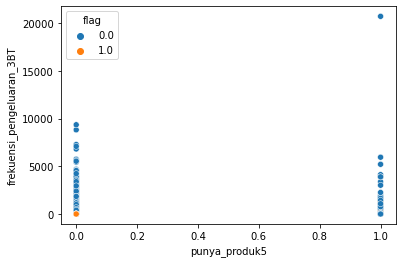

--------------------------------------------------
467
punya_produk5 frekuensi_pengeluaran_4BT


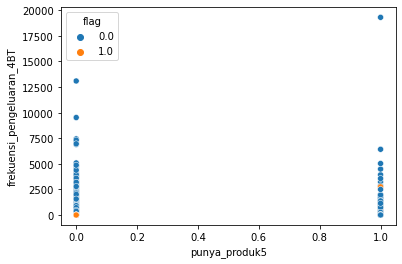

--------------------------------------------------
468
punya_produk5 frekuensi_pengeluaran_5BT


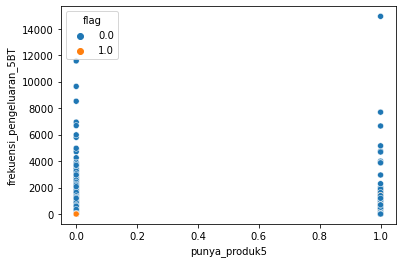

--------------------------------------------------
469
punya_produk5 frekuensi_pengeluaran_6BT


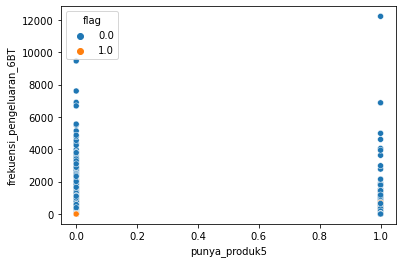

--------------------------------------------------
470
punya_produk5 frekuensi_pemasukan_1BT


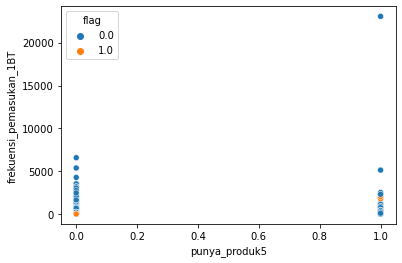

--------------------------------------------------
471
punya_produk5 frekuensi_pemasukan_2BT


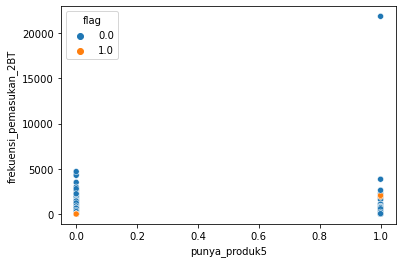

--------------------------------------------------
472
punya_produk5 frekuensi_pemasukan_3BT


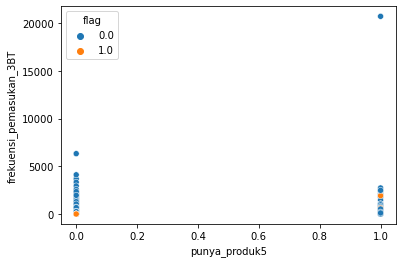

--------------------------------------------------
473
punya_produk5 frekuensi_pemasukan_4BT


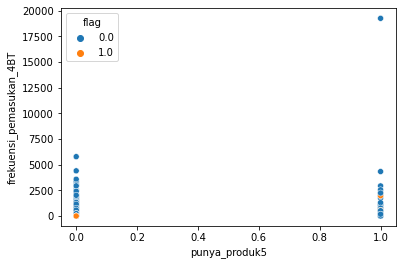

--------------------------------------------------
474
punya_produk5 frekuensi_pemasukan_5BT


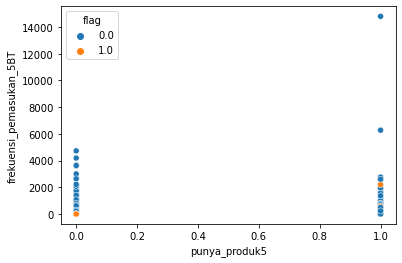

--------------------------------------------------
475
punya_produk5 frekuensi_pemasukan_6BT


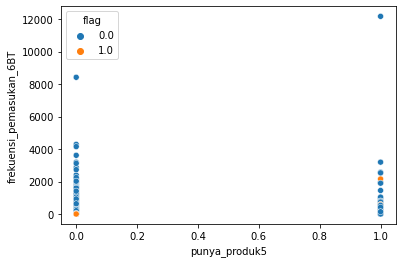

--------------------------------------------------
476
punya_produk5 flag


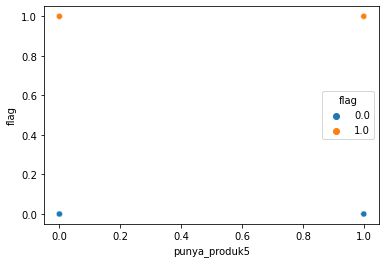

--------------------------------------------------
477
punya_produk6 punya_produk6


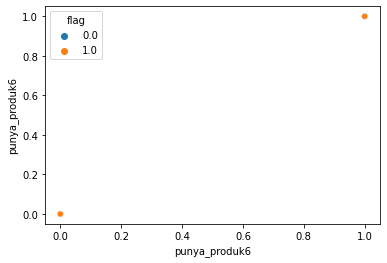

--------------------------------------------------
478
punya_produk6 omset


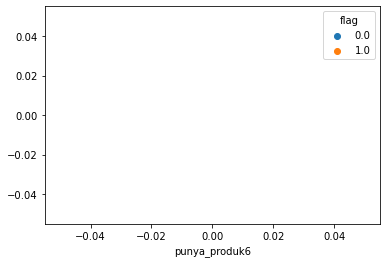

--------------------------------------------------
479
punya_produk6 penghasilan


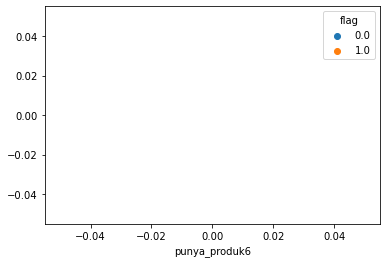

--------------------------------------------------
480
punya_produk6 average_sisauang_mingguan_1BT


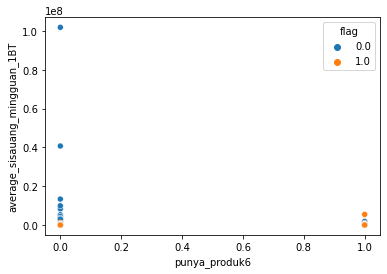

--------------------------------------------------
481
punya_produk6 average_sisauang_mingguan_2BT


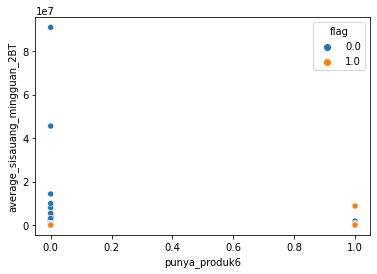

--------------------------------------------------
482
punya_produk6 average_sisauang_mingguan_3BT


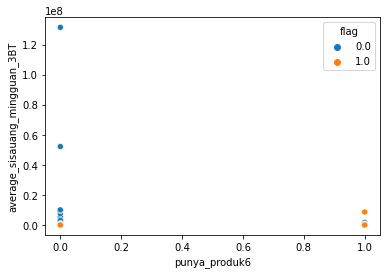

--------------------------------------------------
483
punya_produk6 average_sisauang_mingguan_4BT


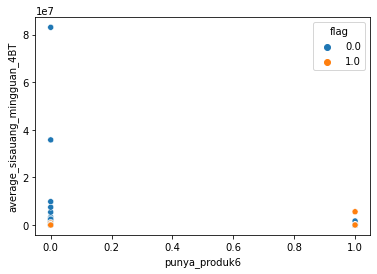

--------------------------------------------------
484
punya_produk6 average_sisauang_mingguan_5BT


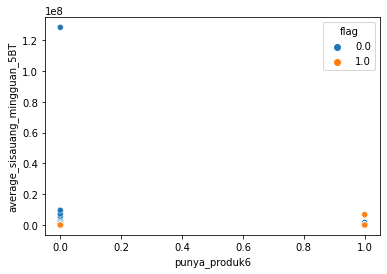

--------------------------------------------------
485
punya_produk6 average_sisauang_mingguan_6BT


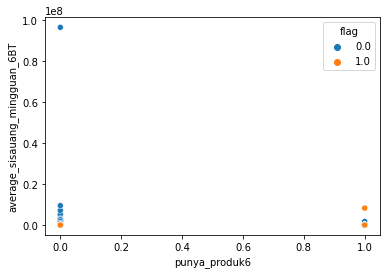

--------------------------------------------------
486
punya_produk6 sisauang_akhir_1BT


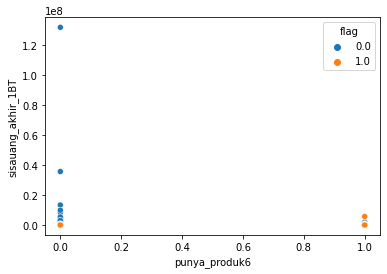

--------------------------------------------------
487
punya_produk6 sisauang_akhir_2BT


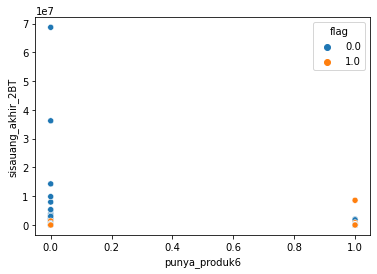

--------------------------------------------------
488
punya_produk6 sisauang_akhir_3BT


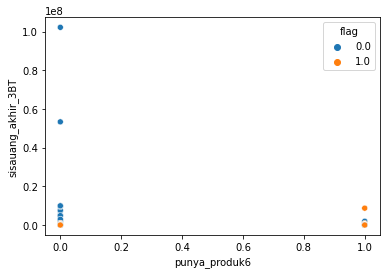

--------------------------------------------------
489
punya_produk6 sisauang_akhir_4BT


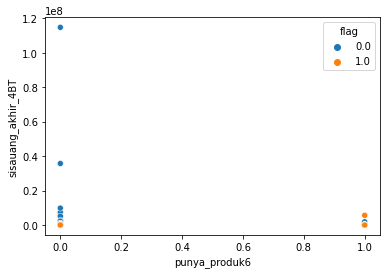

--------------------------------------------------
490
punya_produk6 sisauang_akhir_5BT


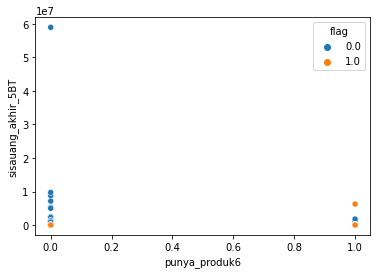

--------------------------------------------------
491
punya_produk6 sisauang_akhir_6BT


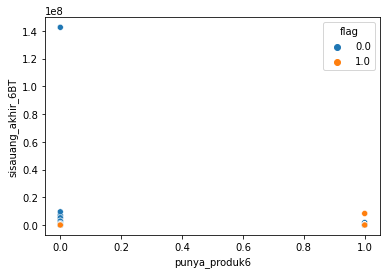

--------------------------------------------------
492
punya_produk6 sisauang_tertahan_1BT


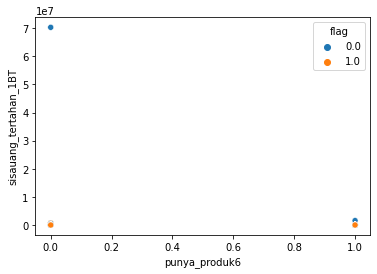

--------------------------------------------------
493
punya_produk6 sisauang_tertahan_2BT


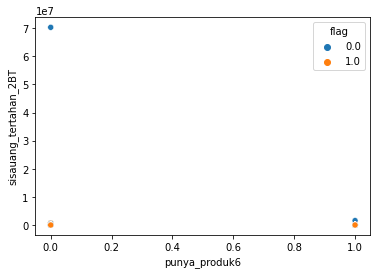

--------------------------------------------------
494
punya_produk6 sisauang_tertahan_3BT


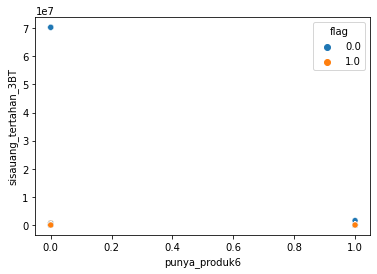

--------------------------------------------------
495
punya_produk6 sisauang_tertahan_4BT


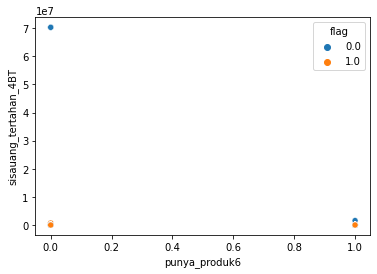

--------------------------------------------------
496
punya_produk6 sisauang_tertahan_5BT


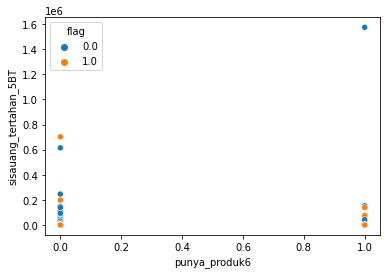

--------------------------------------------------
497
punya_produk6 sisauang_tertahan_6BT


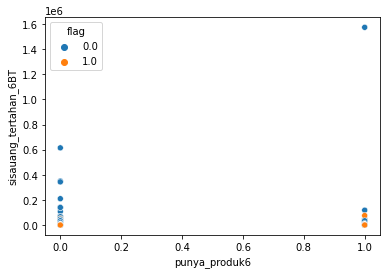

--------------------------------------------------
498
punya_produk6 sisauang_tersedia_1BT


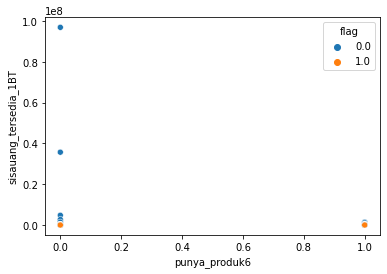

--------------------------------------------------
499
punya_produk6 sisauang_tersedia_2BT


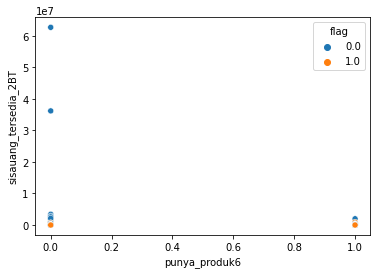

--------------------------------------------------
500
punya_produk6 sisauang_tersedia_3BT


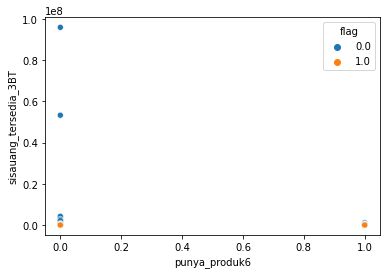

--------------------------------------------------
501
punya_produk6 sisauang_tersedia_4BT


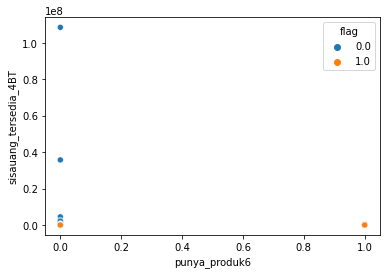

--------------------------------------------------
502
punya_produk6 sisauang_tersedia_5BT


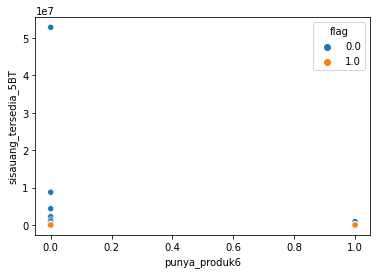

--------------------------------------------------
503
punya_produk6 sisauang_tersedia_6BT


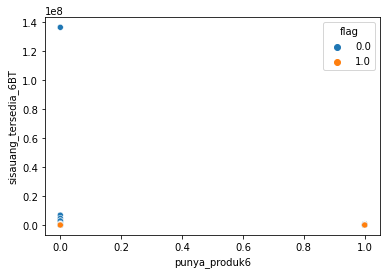

--------------------------------------------------
504
punya_produk6 sisa_hutang_1BT


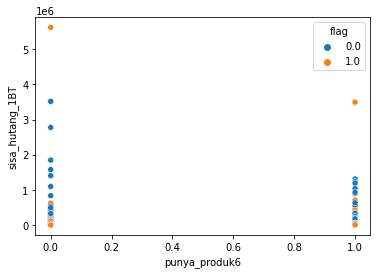

--------------------------------------------------
505
punya_produk6 sisa_hutang_2BT


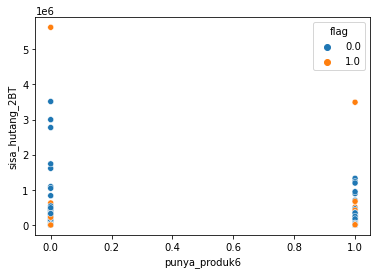

--------------------------------------------------
506
punya_produk6 sisa_hutang_3BT


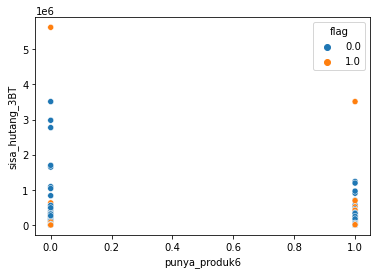

--------------------------------------------------
507
punya_produk6 sisa_hutang_4BT


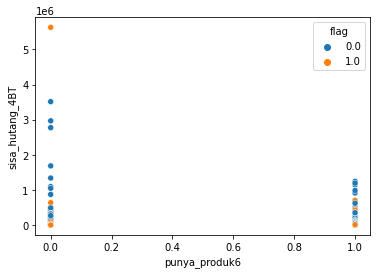

--------------------------------------------------
508
punya_produk6 sisa_hutang_5BT


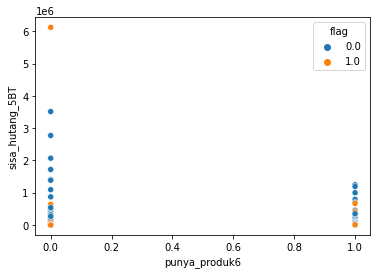

--------------------------------------------------
509
punya_produk6 sisa_hutang_6BT


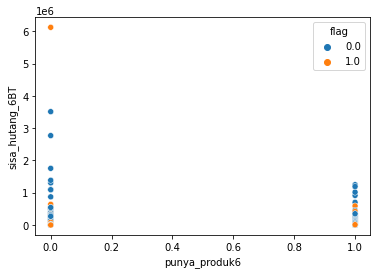

--------------------------------------------------
510
punya_produk6 jumlah_pembayaran_hutang_1BT


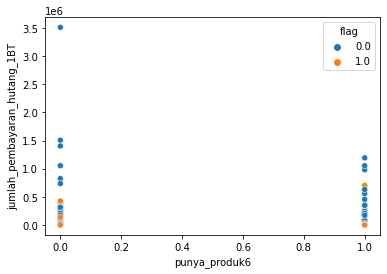

--------------------------------------------------
511
punya_produk6 jumlah_pembayaran_hutang_2BT


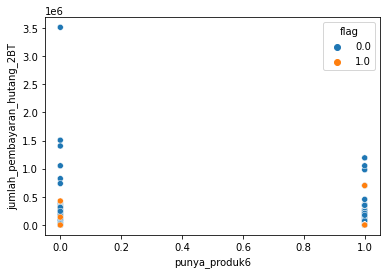

--------------------------------------------------
512
punya_produk6 jumlah_pembayaran_hutang_3BT


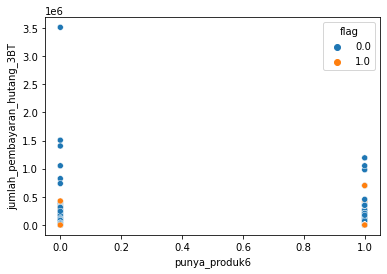

--------------------------------------------------
513
punya_produk6 jumlah_pembayaran_hutang_4BT


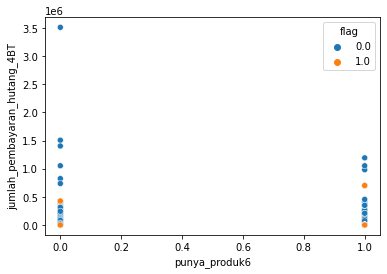

--------------------------------------------------
514
punya_produk6 jumlah_pembayaran_hutang_5BT


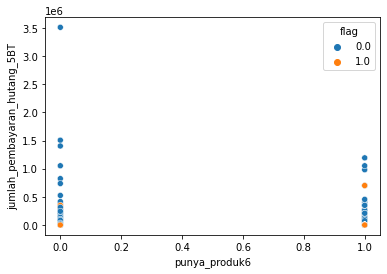

--------------------------------------------------
515
punya_produk6 jumlah_pembayaran_hutang_6BT


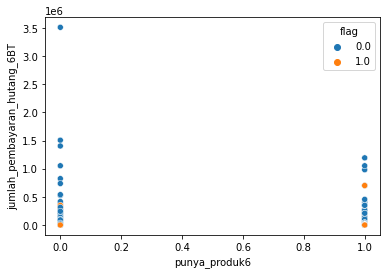

--------------------------------------------------
516
punya_produk6 jumlah_pengeluaran_1BT


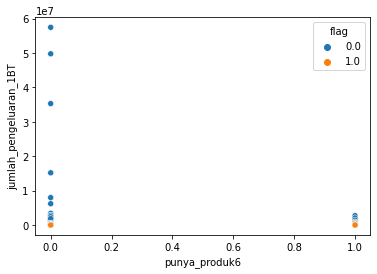

--------------------------------------------------
517
punya_produk6 jumlah_pengeluaran_2BT


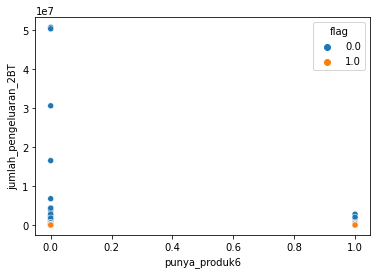

--------------------------------------------------
518
punya_produk6 jumlah_pengeluaran_3BT


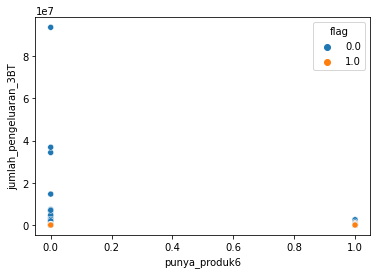

--------------------------------------------------
519
punya_produk6 jumlah_pengeluaran_4BT


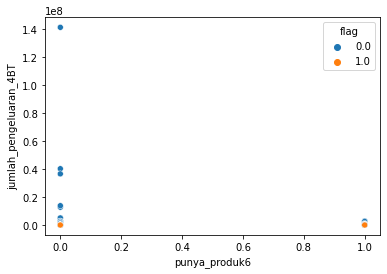

--------------------------------------------------
520
punya_produk6 jumlah_pengeluaran_5BT


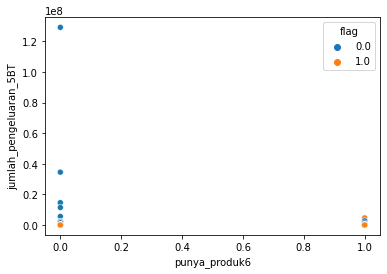

--------------------------------------------------
521
punya_produk6 jumlah_pengeluaran_6BT


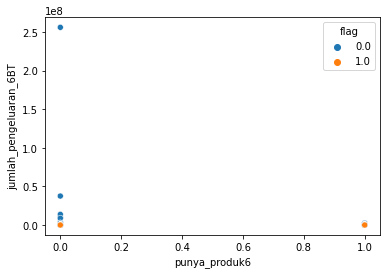

--------------------------------------------------
522
punya_produk6 jumlah_pemasukan_1BT


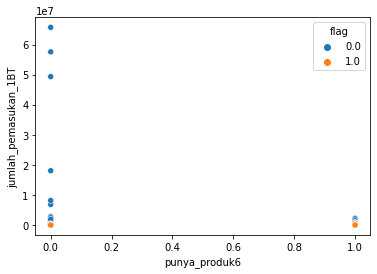

--------------------------------------------------
523
punya_produk6 jumlah_pemasukan_2BT


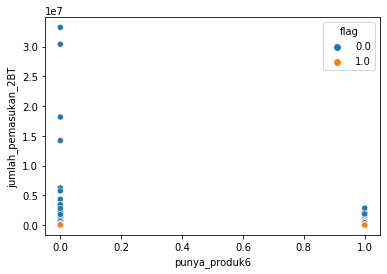

--------------------------------------------------
524
punya_produk6 jumlah_pemasukan_3BT


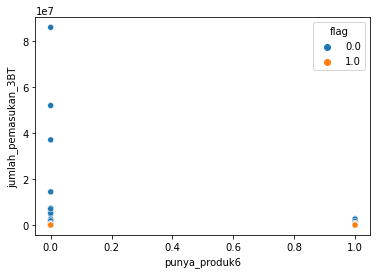

--------------------------------------------------
525
punya_produk6 jumlah_pemasukan_4BT


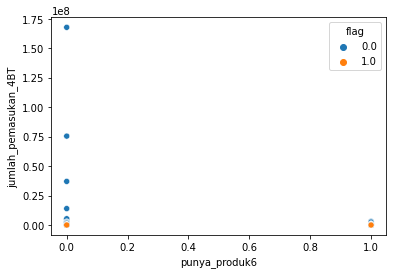

--------------------------------------------------
526
punya_produk6 jumlah_pemasukan_5BT


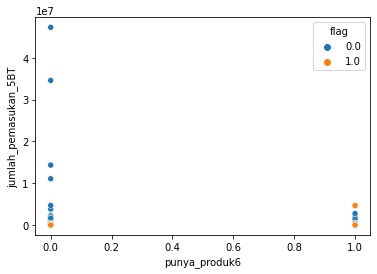

--------------------------------------------------
527
punya_produk6 jumlah_pemasukan_6BT


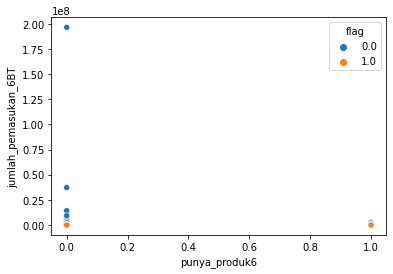

--------------------------------------------------
528
punya_produk6 frekuensi_pengeluaran_1BT


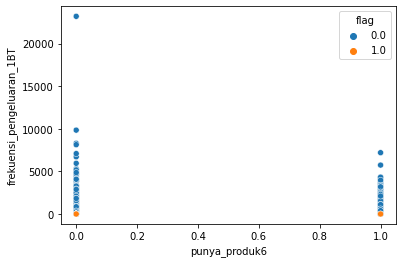

--------------------------------------------------
529
punya_produk6 frekuensi_pengeluaran_2BT


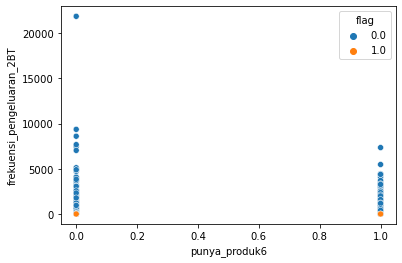

--------------------------------------------------
530
punya_produk6 frekuensi_pengeluaran_3BT


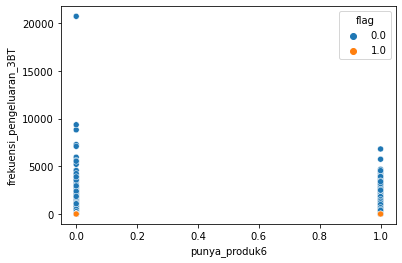

--------------------------------------------------
531
punya_produk6 frekuensi_pengeluaran_4BT


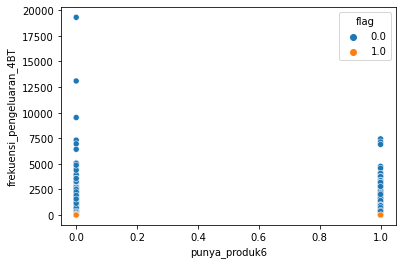

--------------------------------------------------
532
punya_produk6 frekuensi_pengeluaran_5BT


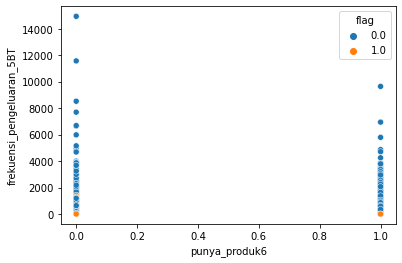

--------------------------------------------------
533
punya_produk6 frekuensi_pengeluaran_6BT


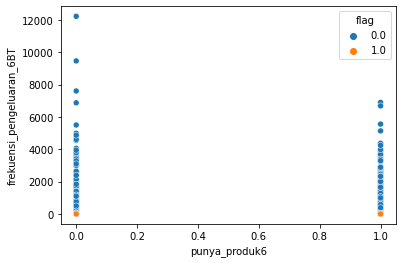

--------------------------------------------------
534
punya_produk6 frekuensi_pemasukan_1BT


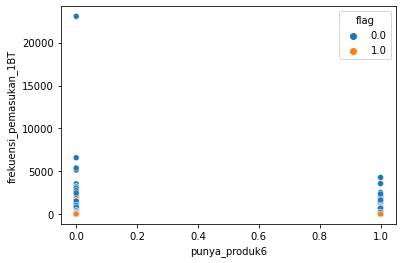

--------------------------------------------------
535
punya_produk6 frekuensi_pemasukan_2BT


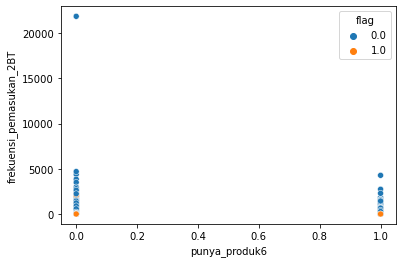

--------------------------------------------------
536
punya_produk6 frekuensi_pemasukan_3BT


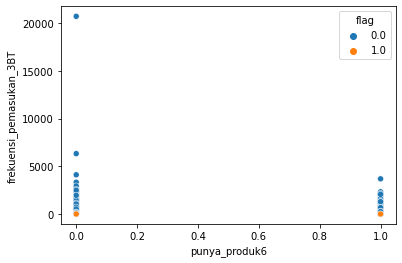

--------------------------------------------------
537
punya_produk6 frekuensi_pemasukan_4BT


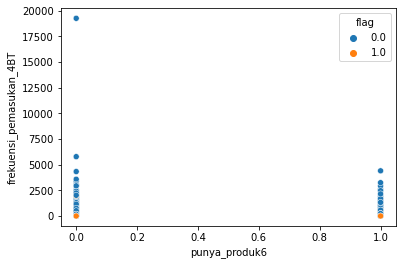

--------------------------------------------------
538
punya_produk6 frekuensi_pemasukan_5BT


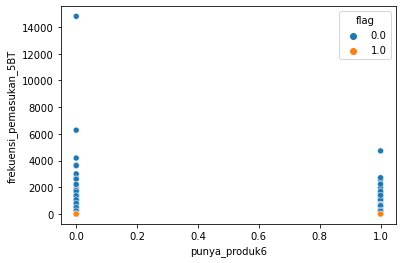

--------------------------------------------------
539
punya_produk6 frekuensi_pemasukan_6BT


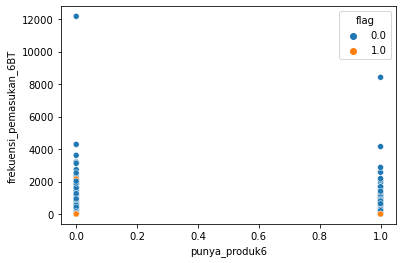

--------------------------------------------------
540
punya_produk6 flag


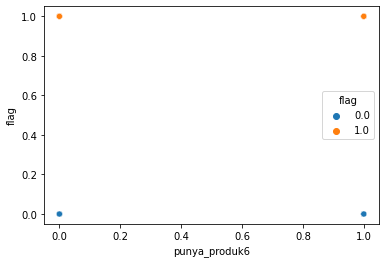

--------------------------------------------------
541
omset omset


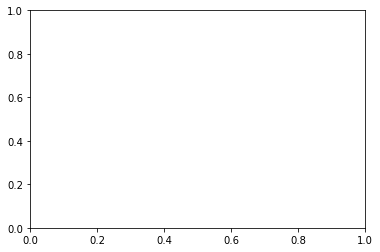

--------------------------------------------------
542
omset penghasilan


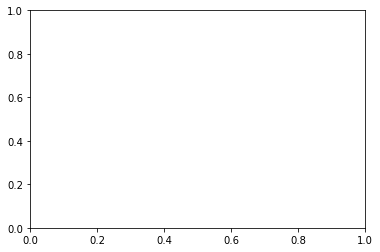

--------------------------------------------------
543
omset average_sisauang_mingguan_1BT


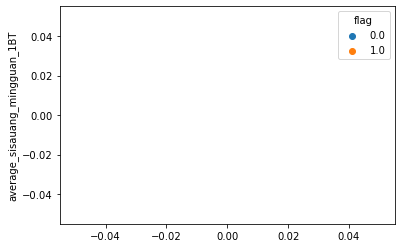

--------------------------------------------------
544
omset average_sisauang_mingguan_2BT


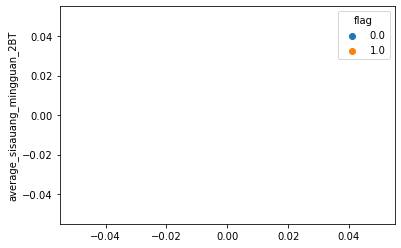

--------------------------------------------------
545
omset average_sisauang_mingguan_3BT


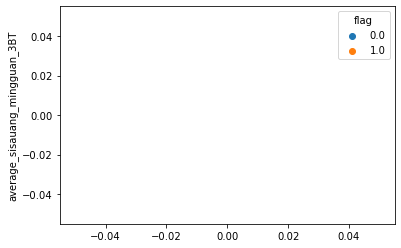

--------------------------------------------------
546
omset average_sisauang_mingguan_4BT


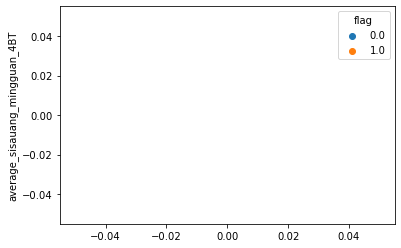

--------------------------------------------------
547
omset average_sisauang_mingguan_5BT


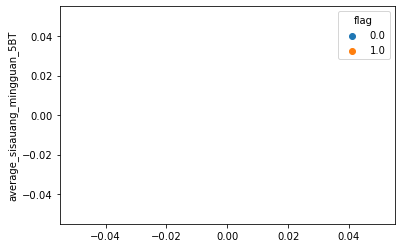

--------------------------------------------------
548
omset average_sisauang_mingguan_6BT


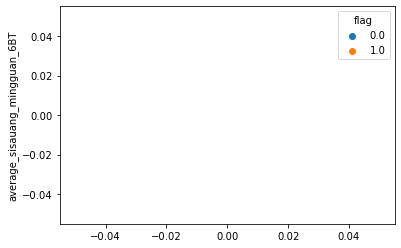

--------------------------------------------------
549
omset sisauang_akhir_1BT


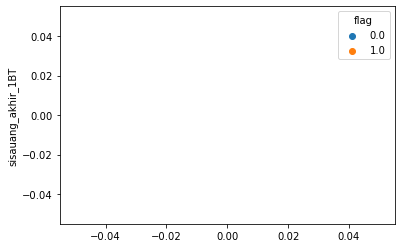

--------------------------------------------------
550
omset sisauang_akhir_2BT


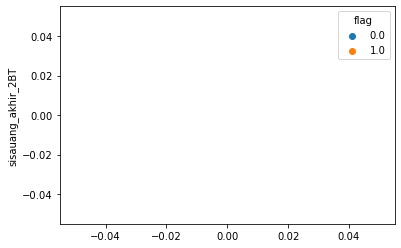

--------------------------------------------------
551
omset sisauang_akhir_3BT


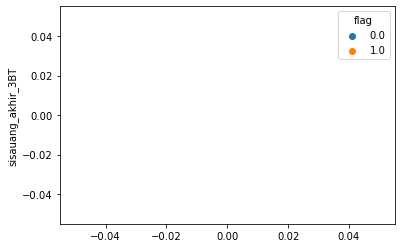

--------------------------------------------------
552
omset sisauang_akhir_4BT


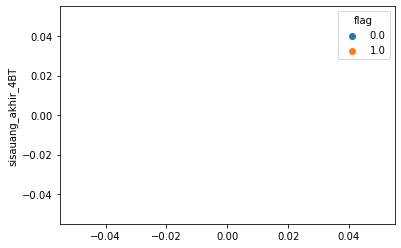

--------------------------------------------------
553
omset sisauang_akhir_5BT


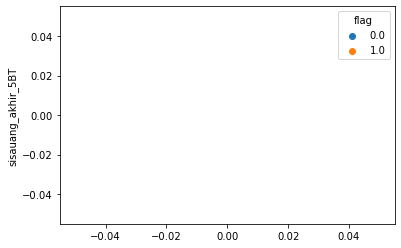

--------------------------------------------------
554
omset sisauang_akhir_6BT


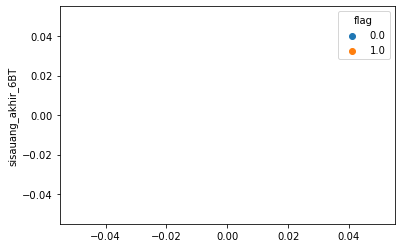

--------------------------------------------------
555
omset sisauang_tertahan_1BT


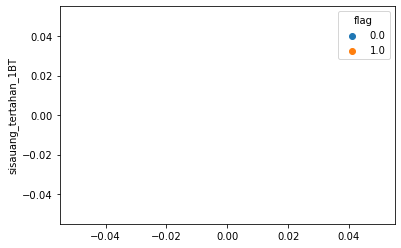

--------------------------------------------------
556
omset sisauang_tertahan_2BT


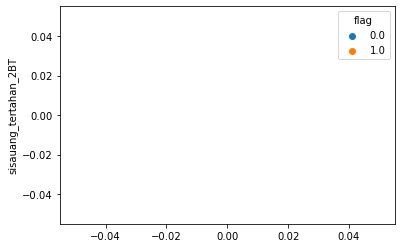

--------------------------------------------------
557
omset sisauang_tertahan_3BT


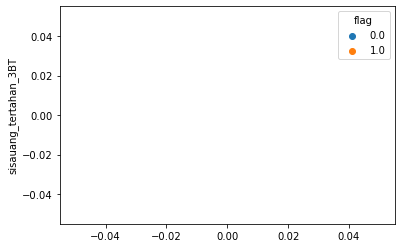

--------------------------------------------------
558
omset sisauang_tertahan_4BT


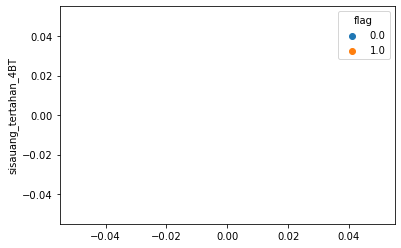

--------------------------------------------------
559
omset sisauang_tertahan_5BT


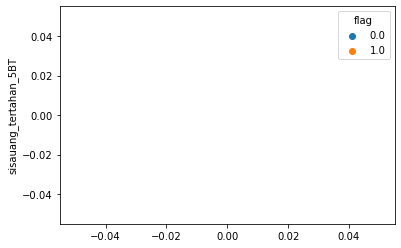

--------------------------------------------------
560
omset sisauang_tertahan_6BT


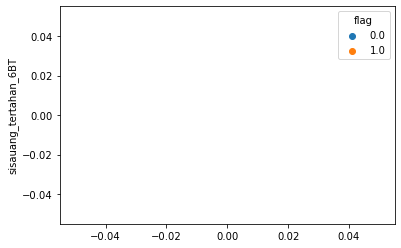

--------------------------------------------------
561
omset sisauang_tersedia_1BT


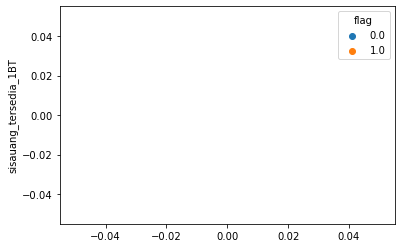

--------------------------------------------------
562
omset sisauang_tersedia_2BT


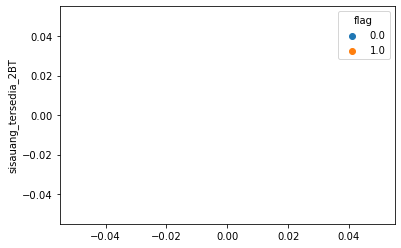

--------------------------------------------------
563
omset sisauang_tersedia_3BT


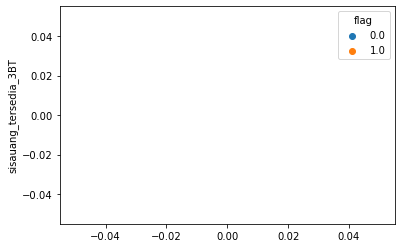

--------------------------------------------------
564
omset sisauang_tersedia_4BT


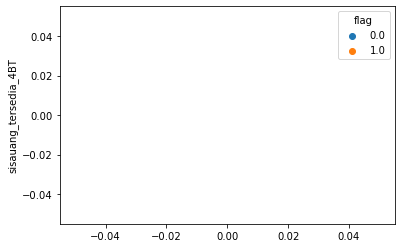

--------------------------------------------------
565
omset sisauang_tersedia_5BT


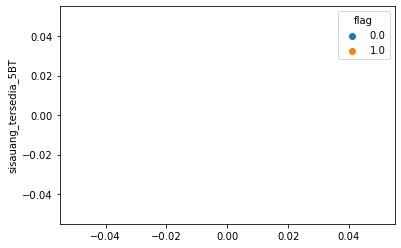

--------------------------------------------------
566
omset sisauang_tersedia_6BT


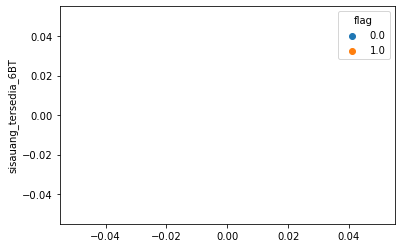

--------------------------------------------------
567
omset sisa_hutang_1BT


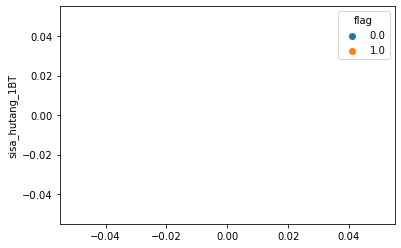

--------------------------------------------------
568
omset sisa_hutang_2BT


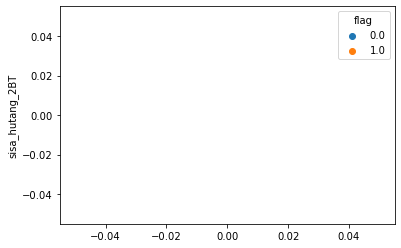

--------------------------------------------------
569
omset sisa_hutang_3BT


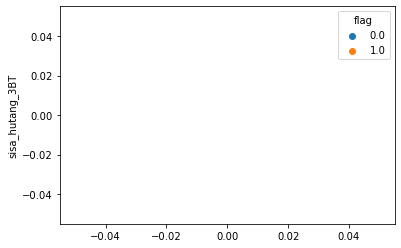

--------------------------------------------------
570
omset sisa_hutang_4BT


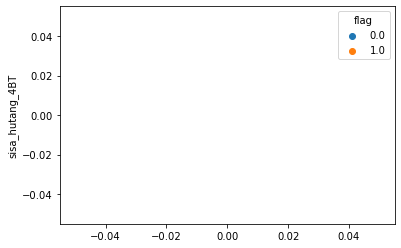

--------------------------------------------------
571
omset sisa_hutang_5BT


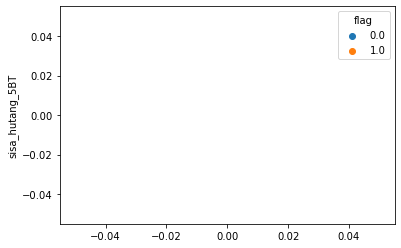

--------------------------------------------------
572
omset sisa_hutang_6BT


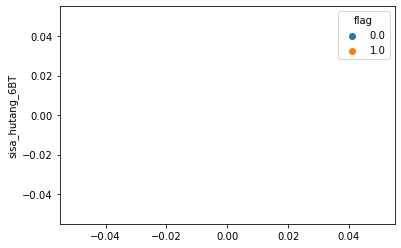

--------------------------------------------------
573
omset jumlah_pembayaran_hutang_1BT


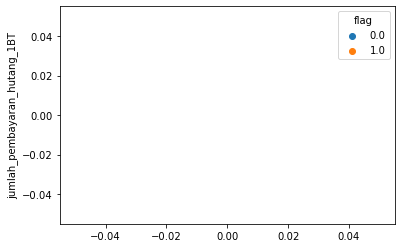

--------------------------------------------------
574
omset jumlah_pembayaran_hutang_2BT


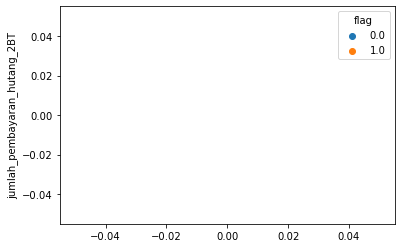

--------------------------------------------------
575
omset jumlah_pembayaran_hutang_3BT


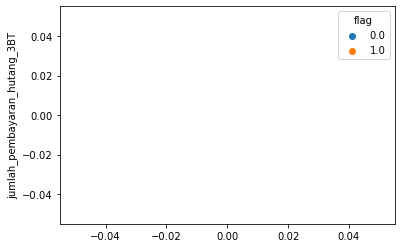

--------------------------------------------------
576
omset jumlah_pembayaran_hutang_4BT


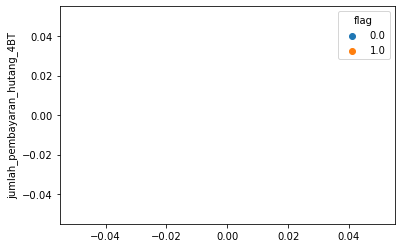

--------------------------------------------------
577
omset jumlah_pembayaran_hutang_5BT


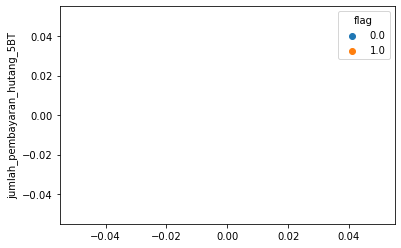

--------------------------------------------------
578
omset jumlah_pembayaran_hutang_6BT


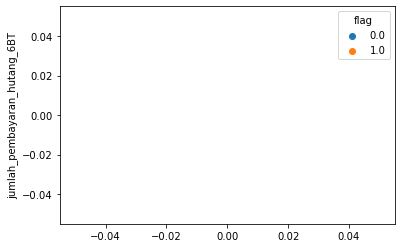

--------------------------------------------------
579
omset jumlah_pengeluaran_1BT


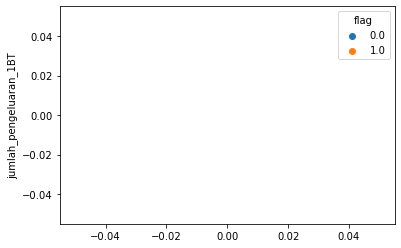

--------------------------------------------------
580
omset jumlah_pengeluaran_2BT


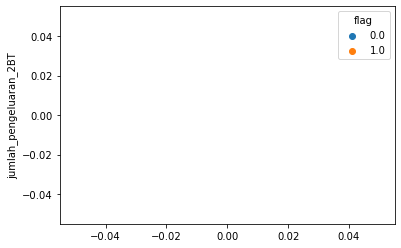

--------------------------------------------------
581
omset jumlah_pengeluaran_3BT


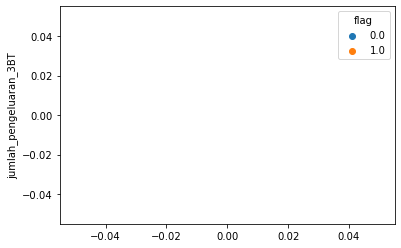

--------------------------------------------------
582
omset jumlah_pengeluaran_4BT


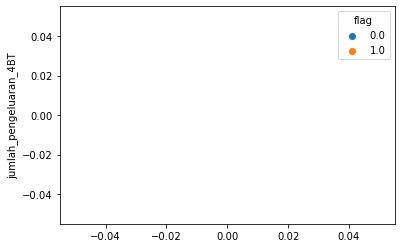

--------------------------------------------------
583
omset jumlah_pengeluaran_5BT


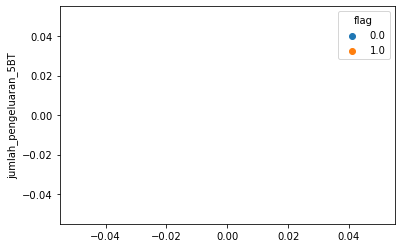

--------------------------------------------------
584
omset jumlah_pengeluaran_6BT


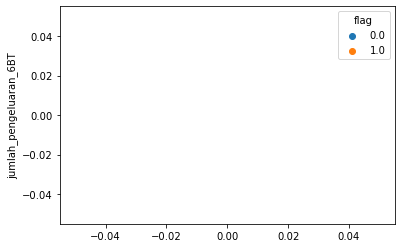

--------------------------------------------------
585
omset jumlah_pemasukan_1BT


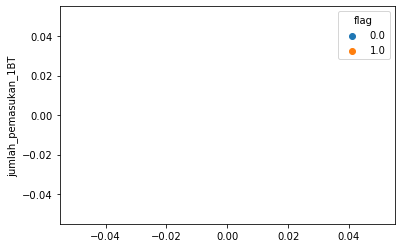

--------------------------------------------------
586
omset jumlah_pemasukan_2BT


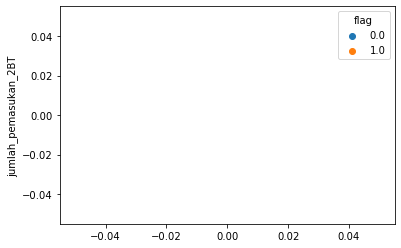

--------------------------------------------------
587
omset jumlah_pemasukan_3BT


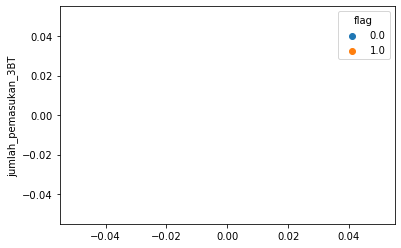

--------------------------------------------------
588
omset jumlah_pemasukan_4BT


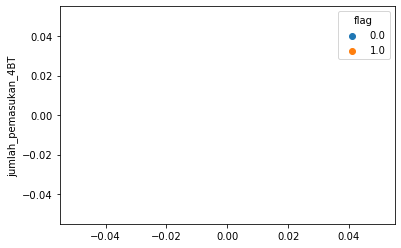

--------------------------------------------------
589
omset jumlah_pemasukan_5BT


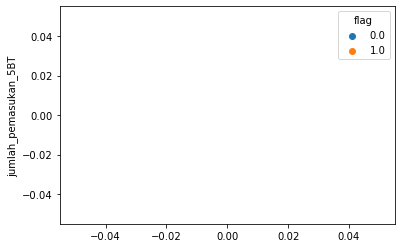

--------------------------------------------------
590
omset jumlah_pemasukan_6BT


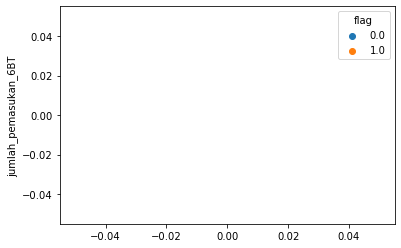

--------------------------------------------------
591
omset frekuensi_pengeluaran_1BT


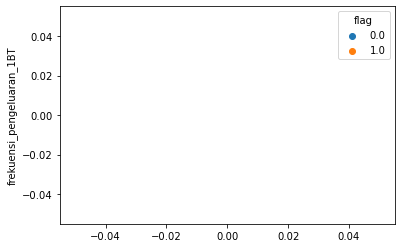

--------------------------------------------------
592
omset frekuensi_pengeluaran_2BT


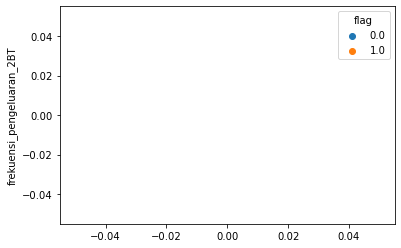

--------------------------------------------------
593
omset frekuensi_pengeluaran_3BT


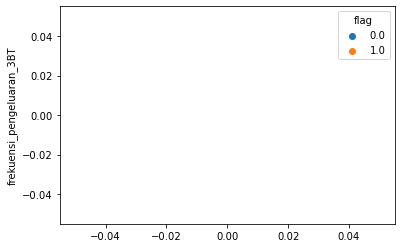

--------------------------------------------------
594
omset frekuensi_pengeluaran_4BT


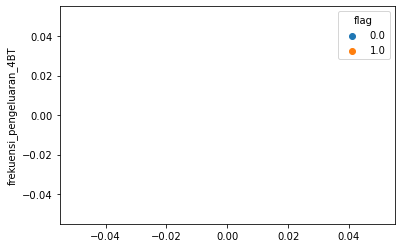

--------------------------------------------------
595
omset frekuensi_pengeluaran_5BT


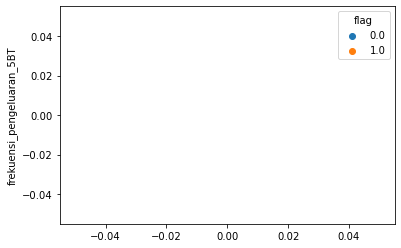

--------------------------------------------------
596
omset frekuensi_pengeluaran_6BT


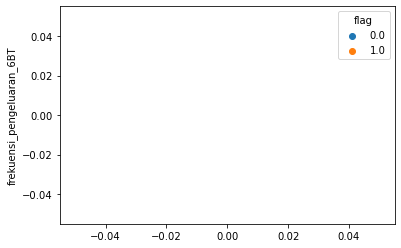

--------------------------------------------------
597
omset frekuensi_pemasukan_1BT


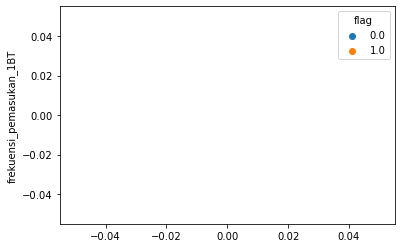

--------------------------------------------------
598
omset frekuensi_pemasukan_2BT


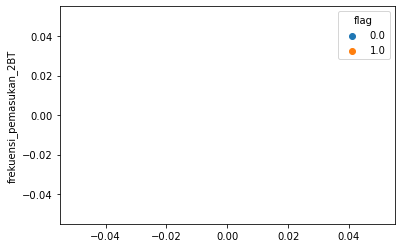

--------------------------------------------------
599
omset frekuensi_pemasukan_3BT


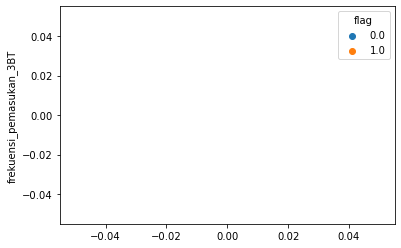

--------------------------------------------------
600
omset frekuensi_pemasukan_4BT


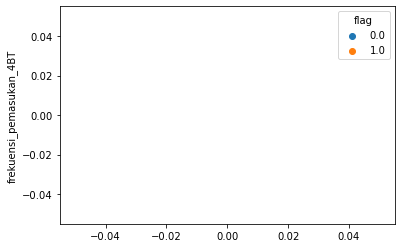

--------------------------------------------------
601
omset frekuensi_pemasukan_5BT


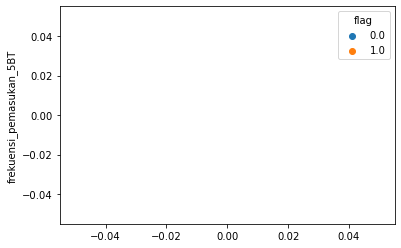

--------------------------------------------------
602
omset frekuensi_pemasukan_6BT


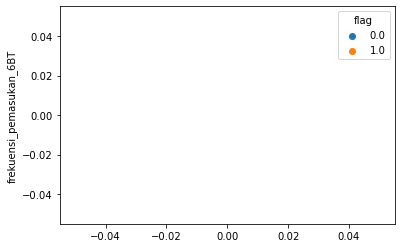

--------------------------------------------------
603
omset flag


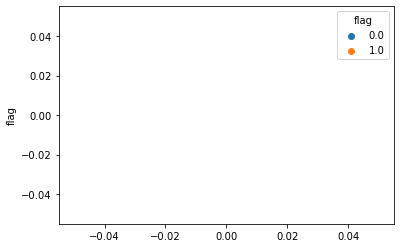

--------------------------------------------------
604
penghasilan penghasilan


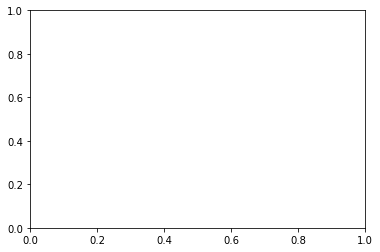

--------------------------------------------------
605
penghasilan average_sisauang_mingguan_1BT


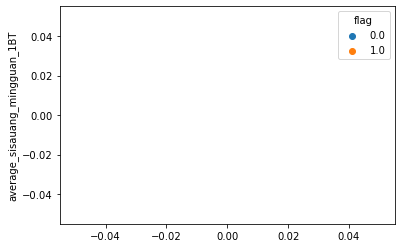

--------------------------------------------------
606
penghasilan average_sisauang_mingguan_2BT


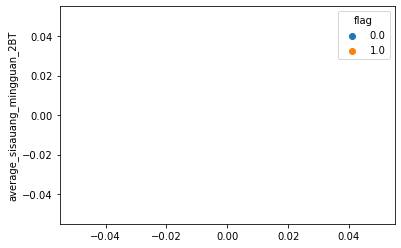

--------------------------------------------------
607
penghasilan average_sisauang_mingguan_3BT


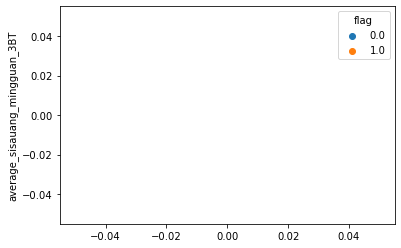

--------------------------------------------------
608
penghasilan average_sisauang_mingguan_4BT


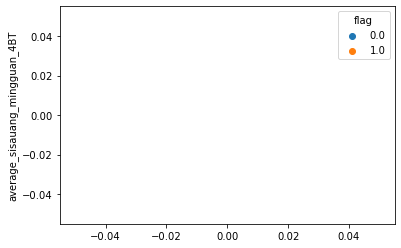

--------------------------------------------------
609
penghasilan average_sisauang_mingguan_5BT


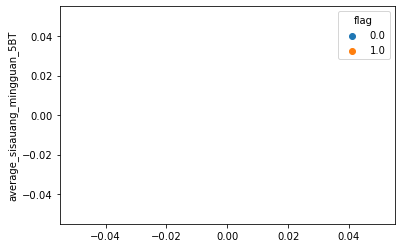

--------------------------------------------------
610
penghasilan average_sisauang_mingguan_6BT


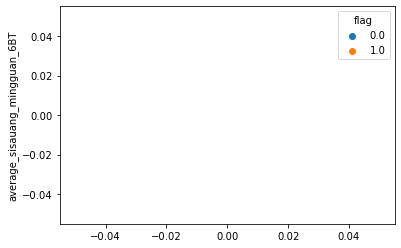

--------------------------------------------------
611
penghasilan sisauang_akhir_1BT


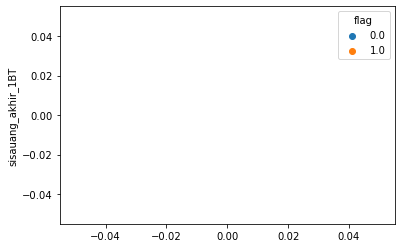

--------------------------------------------------
612
penghasilan sisauang_akhir_2BT


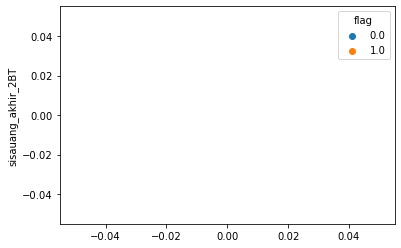

--------------------------------------------------
613
penghasilan sisauang_akhir_3BT


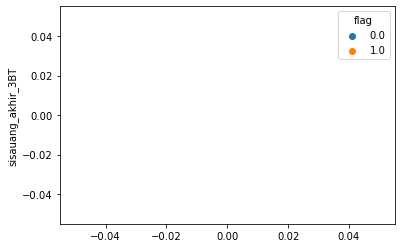

--------------------------------------------------
614
penghasilan sisauang_akhir_4BT


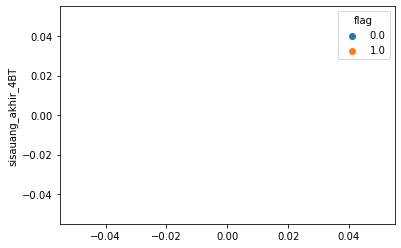

--------------------------------------------------
615
penghasilan sisauang_akhir_5BT


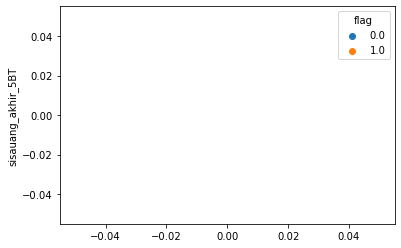

--------------------------------------------------
616
penghasilan sisauang_akhir_6BT


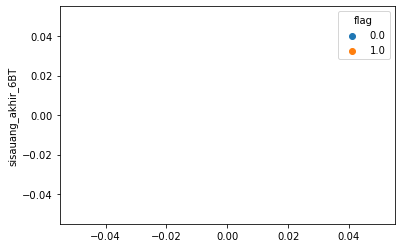

--------------------------------------------------
617
penghasilan sisauang_tertahan_1BT


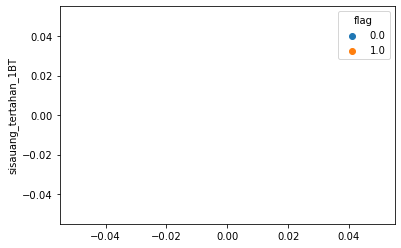

--------------------------------------------------
618
penghasilan sisauang_tertahan_2BT


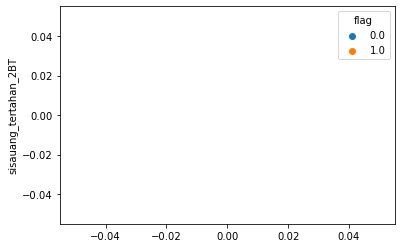

--------------------------------------------------
619
penghasilan sisauang_tertahan_3BT


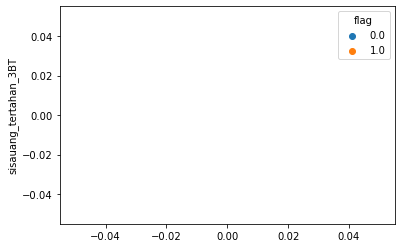

--------------------------------------------------
620
penghasilan sisauang_tertahan_4BT


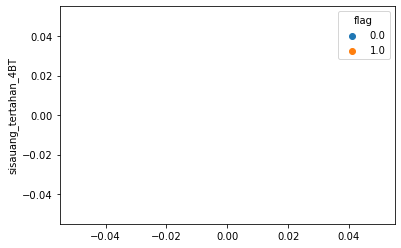

--------------------------------------------------
621
penghasilan sisauang_tertahan_5BT


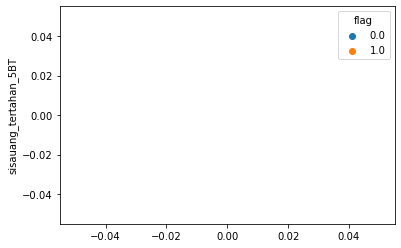

--------------------------------------------------
622
penghasilan sisauang_tertahan_6BT


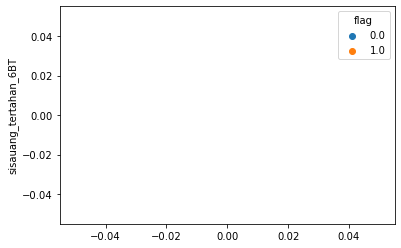

--------------------------------------------------
623
penghasilan sisauang_tersedia_1BT


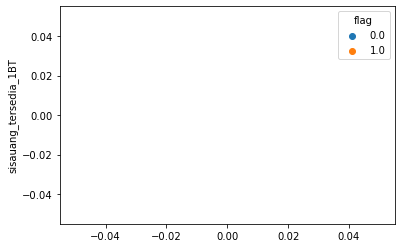

--------------------------------------------------
624
penghasilan sisauang_tersedia_2BT


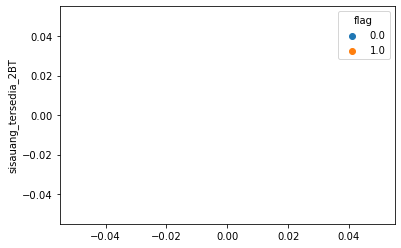

--------------------------------------------------
625
penghasilan sisauang_tersedia_3BT


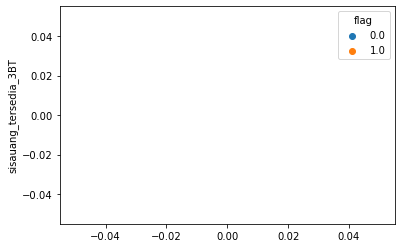

--------------------------------------------------
626
penghasilan sisauang_tersedia_4BT


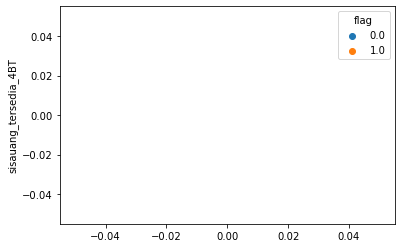

--------------------------------------------------
627
penghasilan sisauang_tersedia_5BT


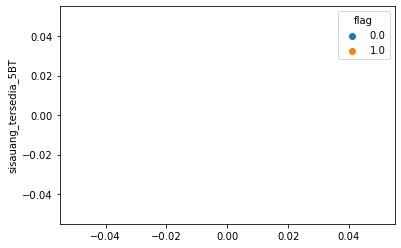

--------------------------------------------------
628
penghasilan sisauang_tersedia_6BT


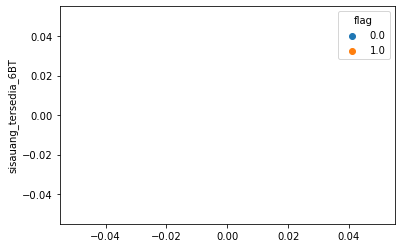

--------------------------------------------------
629
penghasilan sisa_hutang_1BT


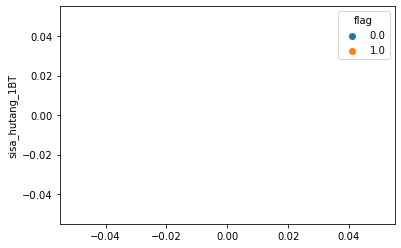

--------------------------------------------------
630
penghasilan sisa_hutang_2BT


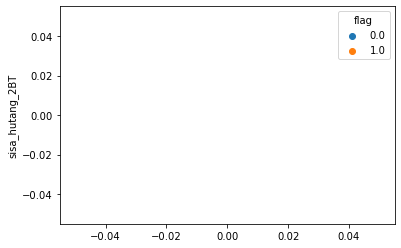

--------------------------------------------------
631
penghasilan sisa_hutang_3BT


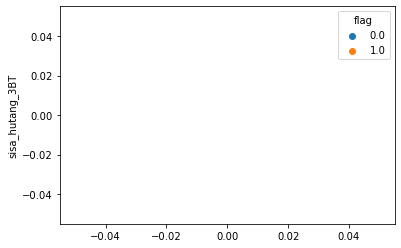

--------------------------------------------------
632
penghasilan sisa_hutang_4BT


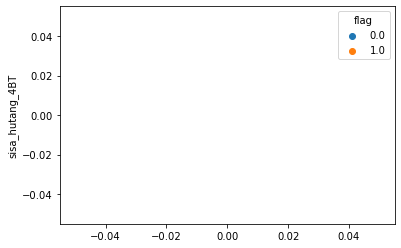

--------------------------------------------------
633
penghasilan sisa_hutang_5BT


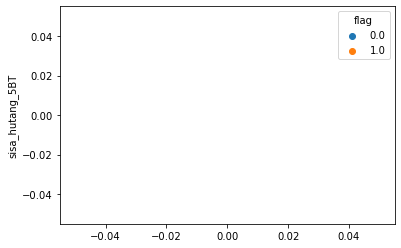

--------------------------------------------------
634
penghasilan sisa_hutang_6BT


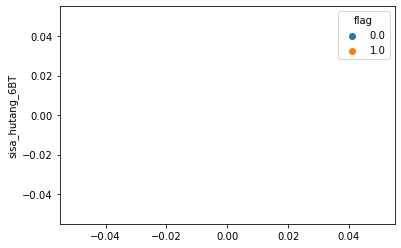

--------------------------------------------------
635
penghasilan jumlah_pembayaran_hutang_1BT


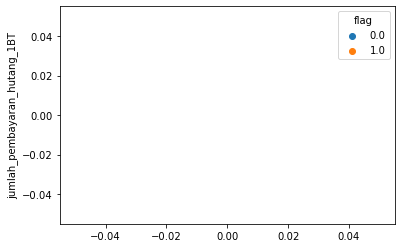

--------------------------------------------------
636
penghasilan jumlah_pembayaran_hutang_2BT


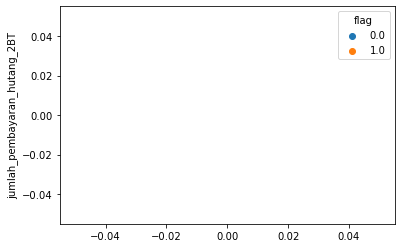

--------------------------------------------------
637
penghasilan jumlah_pembayaran_hutang_3BT


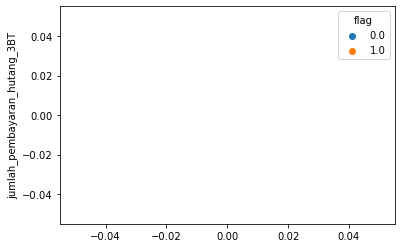

--------------------------------------------------
638
penghasilan jumlah_pembayaran_hutang_4BT


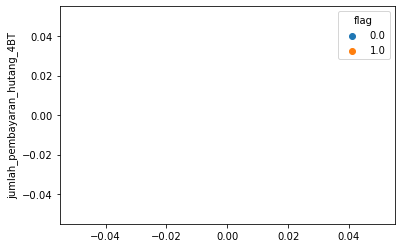

--------------------------------------------------
639
penghasilan jumlah_pembayaran_hutang_5BT


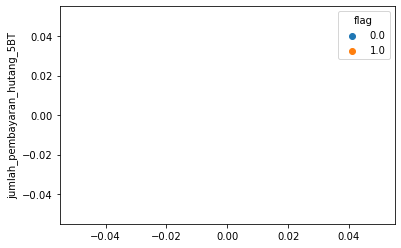

--------------------------------------------------
640
penghasilan jumlah_pembayaran_hutang_6BT


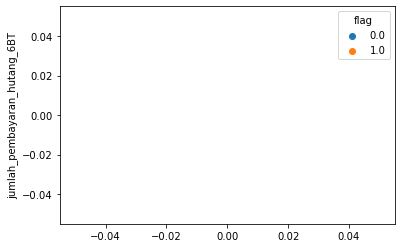

--------------------------------------------------
641
penghasilan jumlah_pengeluaran_1BT


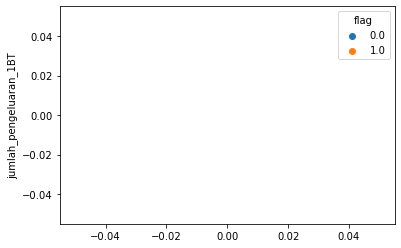

--------------------------------------------------
642
penghasilan jumlah_pengeluaran_2BT


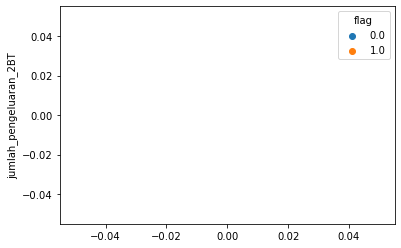

--------------------------------------------------
643
penghasilan jumlah_pengeluaran_3BT


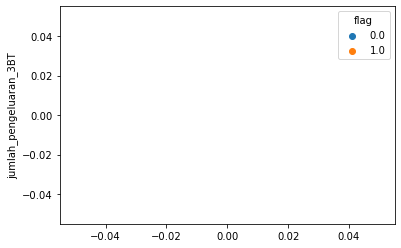

--------------------------------------------------
644
penghasilan jumlah_pengeluaran_4BT


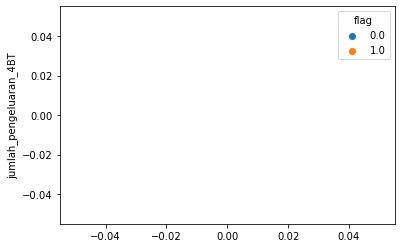

--------------------------------------------------
645
penghasilan jumlah_pengeluaran_5BT


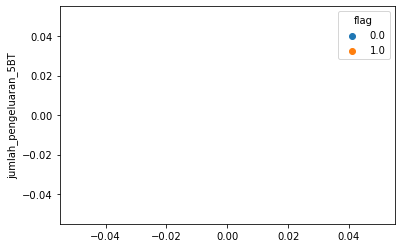

--------------------------------------------------
646
penghasilan jumlah_pengeluaran_6BT


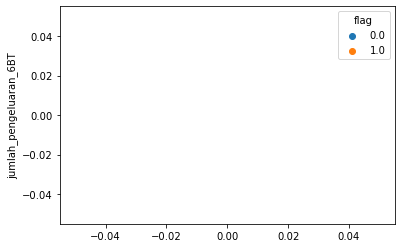

--------------------------------------------------
647
penghasilan jumlah_pemasukan_1BT


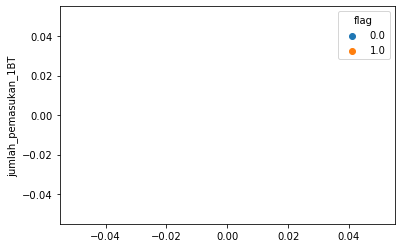

--------------------------------------------------
648
penghasilan jumlah_pemasukan_2BT


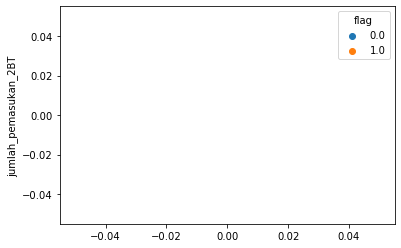

--------------------------------------------------
649
penghasilan jumlah_pemasukan_3BT


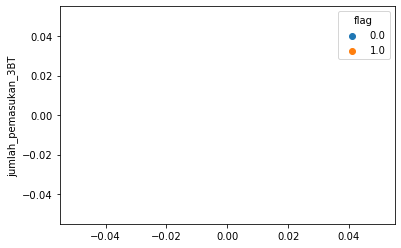

--------------------------------------------------
650
penghasilan jumlah_pemasukan_4BT


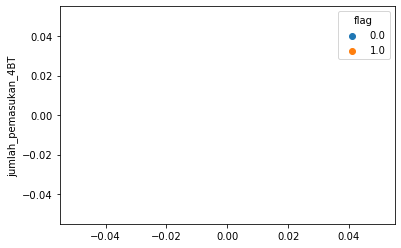

--------------------------------------------------
651
penghasilan jumlah_pemasukan_5BT


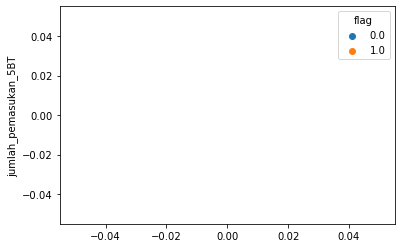

--------------------------------------------------
652
penghasilan jumlah_pemasukan_6BT


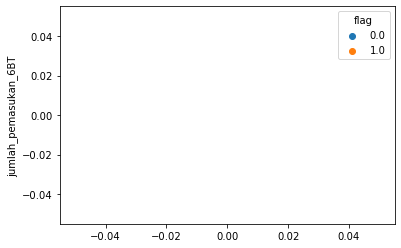

--------------------------------------------------
653
penghasilan frekuensi_pengeluaran_1BT


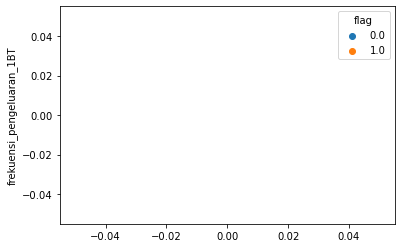

--------------------------------------------------
654
penghasilan frekuensi_pengeluaran_2BT


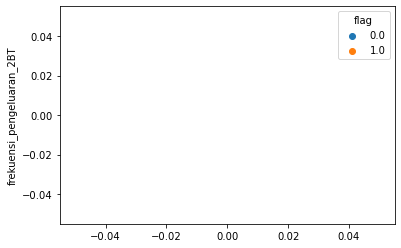

--------------------------------------------------
655
penghasilan frekuensi_pengeluaran_3BT


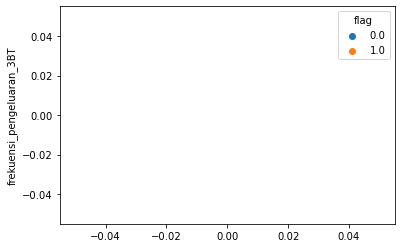

--------------------------------------------------
656
penghasilan frekuensi_pengeluaran_4BT


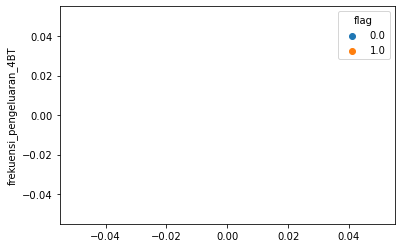

--------------------------------------------------
657
penghasilan frekuensi_pengeluaran_5BT


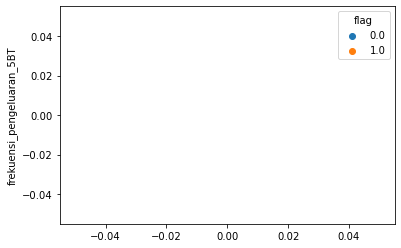

--------------------------------------------------
658
penghasilan frekuensi_pengeluaran_6BT


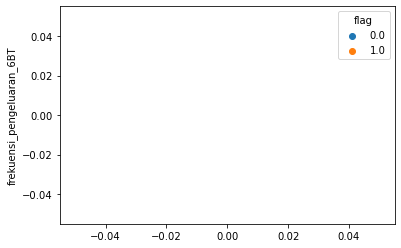

--------------------------------------------------
659
penghasilan frekuensi_pemasukan_1BT


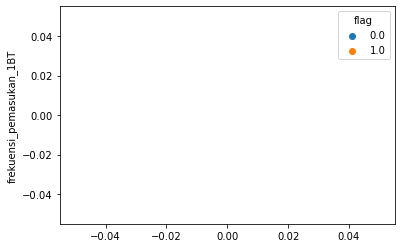

--------------------------------------------------
660
penghasilan frekuensi_pemasukan_2BT


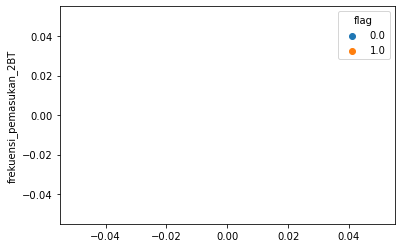

--------------------------------------------------
661
penghasilan frekuensi_pemasukan_3BT


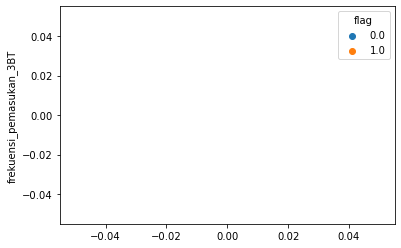

--------------------------------------------------
662
penghasilan frekuensi_pemasukan_4BT


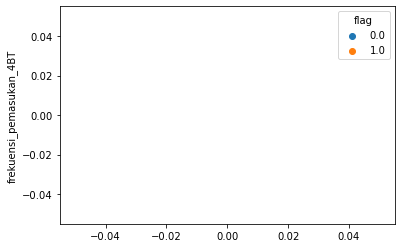

--------------------------------------------------
663
penghasilan frekuensi_pemasukan_5BT


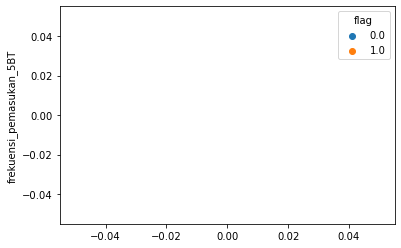

--------------------------------------------------
664
penghasilan frekuensi_pemasukan_6BT


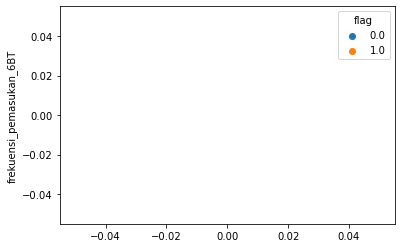

--------------------------------------------------
665
penghasilan flag


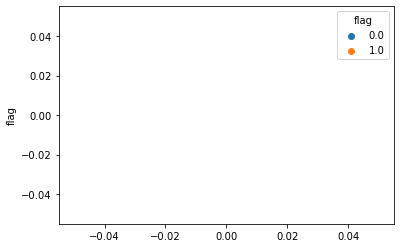

--------------------------------------------------
666
average_sisauang_mingguan_1BT average_sisauang_mingguan_1BT


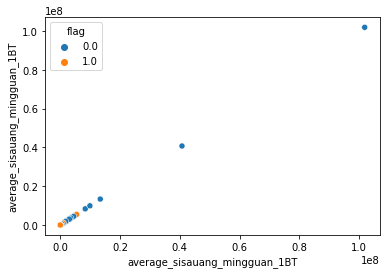

--------------------------------------------------
667
average_sisauang_mingguan_1BT average_sisauang_mingguan_2BT


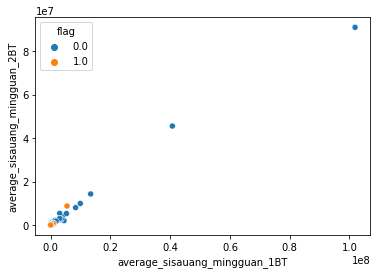

--------------------------------------------------
668
average_sisauang_mingguan_1BT average_sisauang_mingguan_3BT


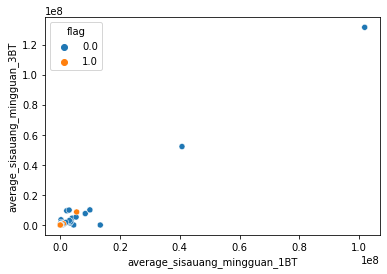

--------------------------------------------------
669
average_sisauang_mingguan_1BT average_sisauang_mingguan_4BT


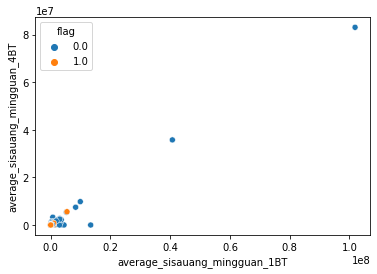

--------------------------------------------------
670
average_sisauang_mingguan_1BT average_sisauang_mingguan_5BT


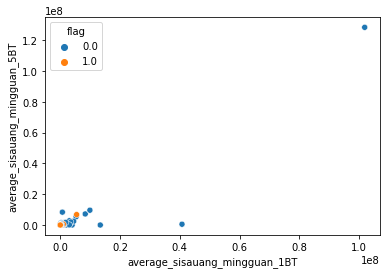

--------------------------------------------------
671
average_sisauang_mingguan_1BT average_sisauang_mingguan_6BT


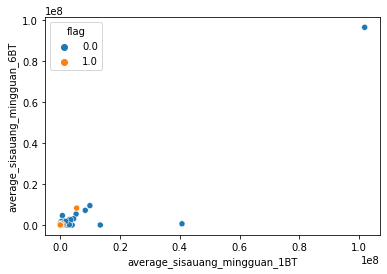

--------------------------------------------------
672
average_sisauang_mingguan_1BT sisauang_akhir_1BT


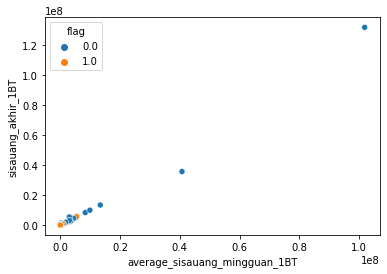

--------------------------------------------------
673
average_sisauang_mingguan_1BT sisauang_akhir_2BT


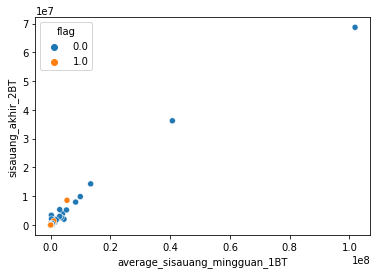

--------------------------------------------------
674
average_sisauang_mingguan_1BT sisauang_akhir_3BT


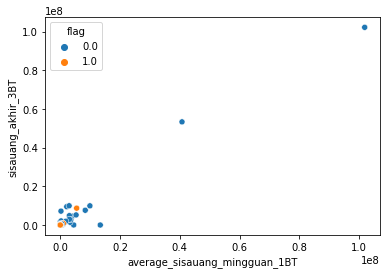

--------------------------------------------------
675
average_sisauang_mingguan_1BT sisauang_akhir_4BT


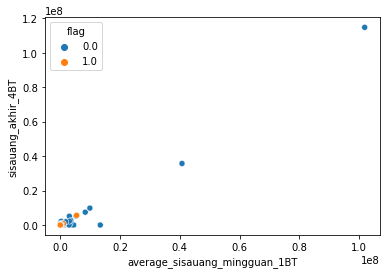

--------------------------------------------------
676
average_sisauang_mingguan_1BT sisauang_akhir_5BT


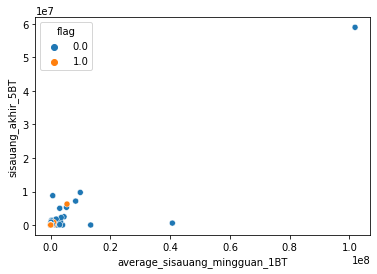

--------------------------------------------------
677
average_sisauang_mingguan_1BT sisauang_akhir_6BT


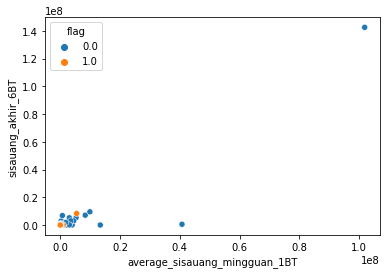

--------------------------------------------------
678
average_sisauang_mingguan_1BT sisauang_tertahan_1BT


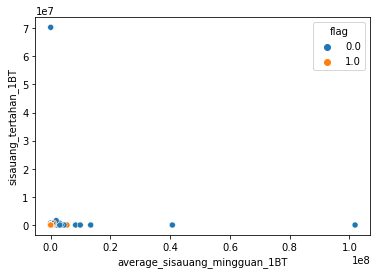

--------------------------------------------------
679
average_sisauang_mingguan_1BT sisauang_tertahan_2BT


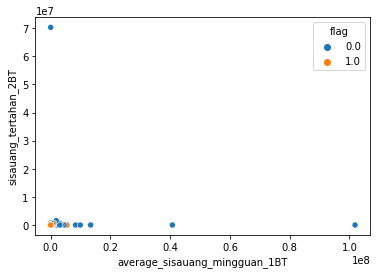

--------------------------------------------------
680
average_sisauang_mingguan_1BT sisauang_tertahan_3BT


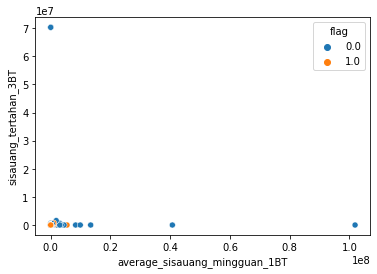

--------------------------------------------------
681
average_sisauang_mingguan_1BT sisauang_tertahan_4BT


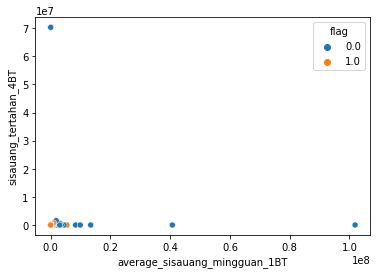

--------------------------------------------------
682
average_sisauang_mingguan_1BT sisauang_tertahan_5BT


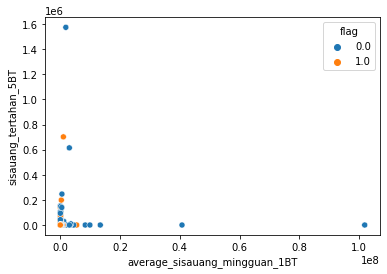

--------------------------------------------------
683
average_sisauang_mingguan_1BT sisauang_tertahan_6BT


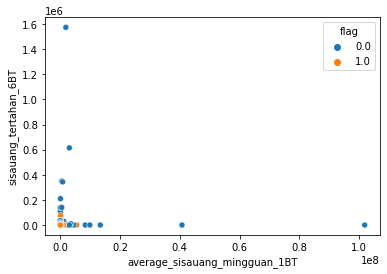

--------------------------------------------------
684
average_sisauang_mingguan_1BT sisauang_tersedia_1BT


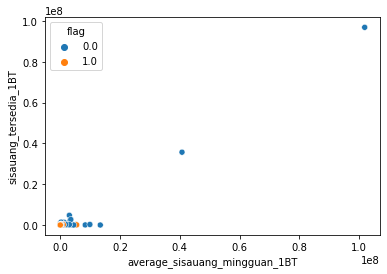

--------------------------------------------------
685
average_sisauang_mingguan_1BT sisauang_tersedia_2BT


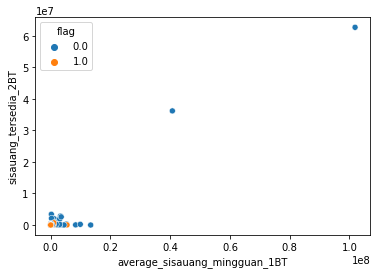

--------------------------------------------------
686
average_sisauang_mingguan_1BT sisauang_tersedia_3BT


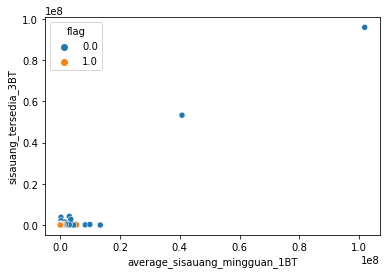

--------------------------------------------------
687
average_sisauang_mingguan_1BT sisauang_tersedia_4BT


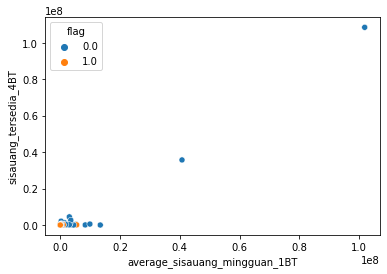

--------------------------------------------------
688
average_sisauang_mingguan_1BT sisauang_tersedia_5BT


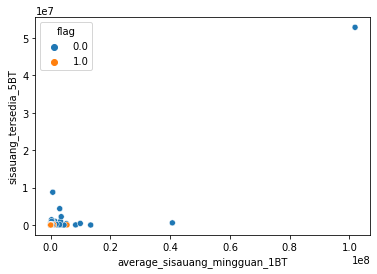

--------------------------------------------------
689
average_sisauang_mingguan_1BT sisauang_tersedia_6BT


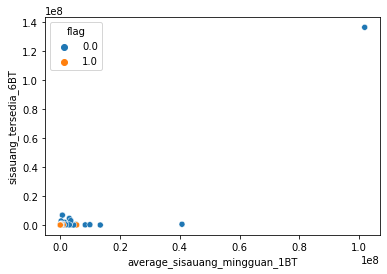

--------------------------------------------------
690
average_sisauang_mingguan_1BT sisa_hutang_1BT


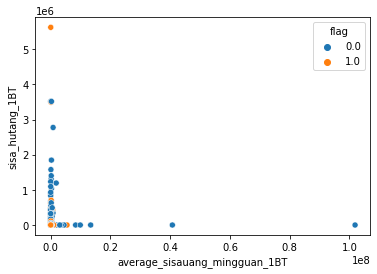

--------------------------------------------------
691
average_sisauang_mingguan_1BT sisa_hutang_2BT


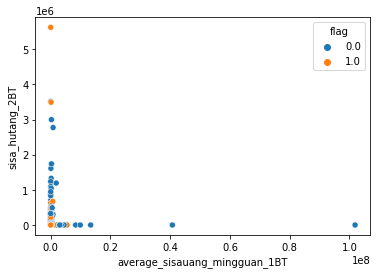

--------------------------------------------------
692
average_sisauang_mingguan_1BT sisa_hutang_3BT


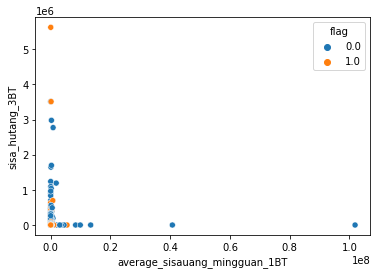

--------------------------------------------------
693
average_sisauang_mingguan_1BT sisa_hutang_4BT


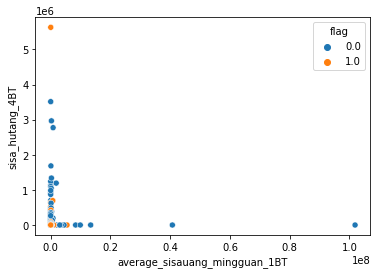

--------------------------------------------------
694
average_sisauang_mingguan_1BT sisa_hutang_5BT


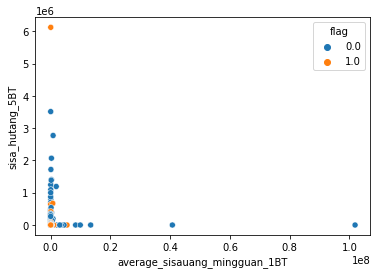

--------------------------------------------------
695
average_sisauang_mingguan_1BT sisa_hutang_6BT


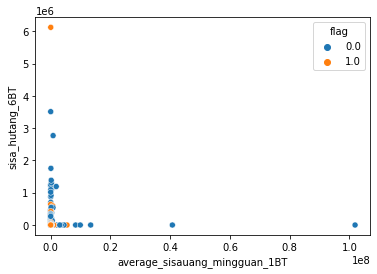

--------------------------------------------------
696
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_1BT


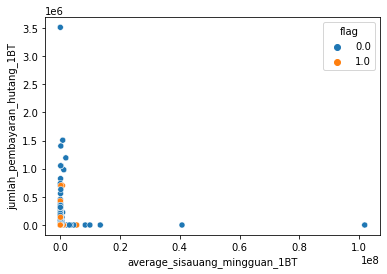

--------------------------------------------------
697
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_2BT


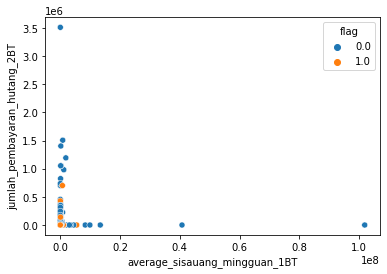

--------------------------------------------------
698
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_3BT


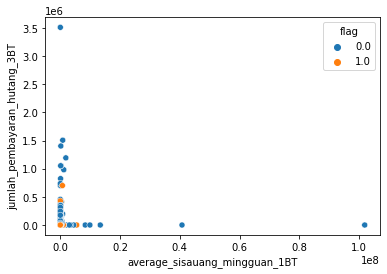

--------------------------------------------------
699
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_4BT


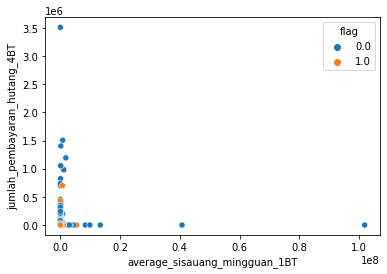

--------------------------------------------------
700
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_5BT


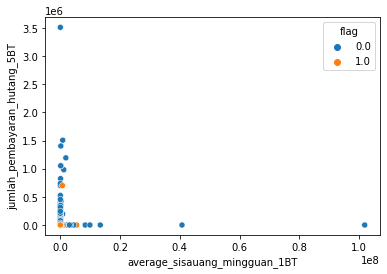

--------------------------------------------------
701
average_sisauang_mingguan_1BT jumlah_pembayaran_hutang_6BT


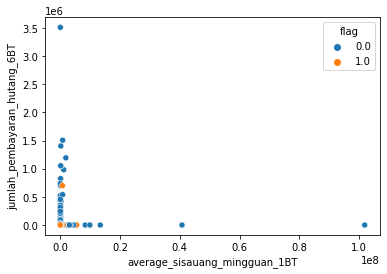

--------------------------------------------------
702
average_sisauang_mingguan_1BT jumlah_pengeluaran_1BT


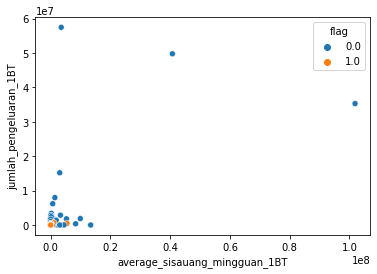

--------------------------------------------------
703
average_sisauang_mingguan_1BT jumlah_pengeluaran_2BT


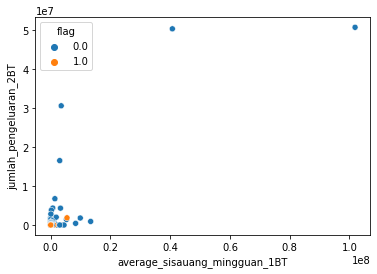

--------------------------------------------------
704
average_sisauang_mingguan_1BT jumlah_pengeluaran_3BT


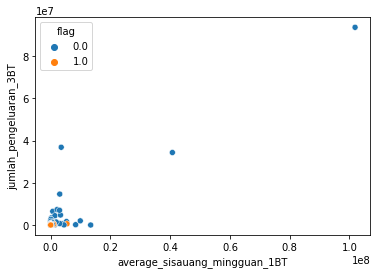

--------------------------------------------------
705
average_sisauang_mingguan_1BT jumlah_pengeluaran_4BT


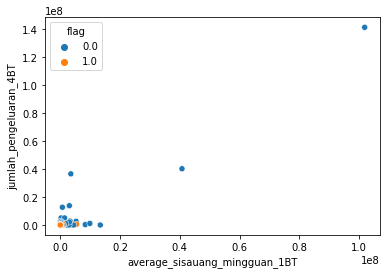

--------------------------------------------------
706
average_sisauang_mingguan_1BT jumlah_pengeluaran_5BT


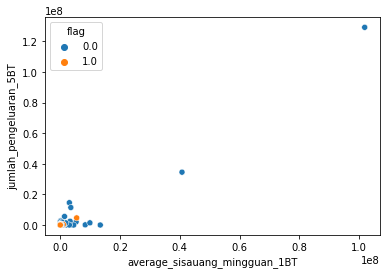

--------------------------------------------------
707
average_sisauang_mingguan_1BT jumlah_pengeluaran_6BT


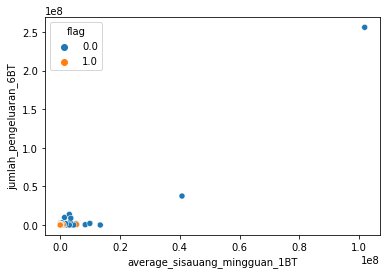

--------------------------------------------------
708
average_sisauang_mingguan_1BT jumlah_pemasukan_1BT


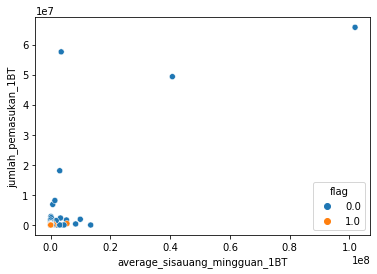

--------------------------------------------------
709
average_sisauang_mingguan_1BT jumlah_pemasukan_2BT


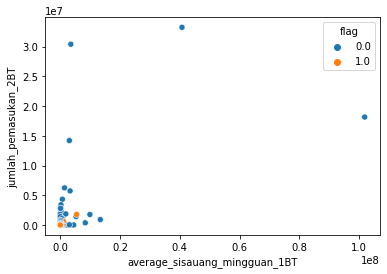

--------------------------------------------------
710
average_sisauang_mingguan_1BT jumlah_pemasukan_3BT


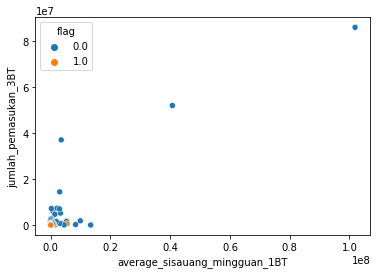

--------------------------------------------------
711
average_sisauang_mingguan_1BT jumlah_pemasukan_4BT


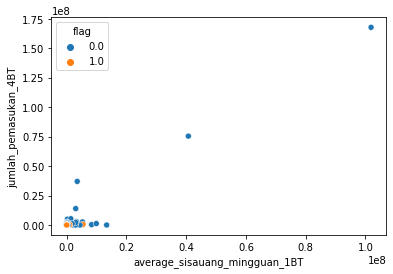

--------------------------------------------------
712
average_sisauang_mingguan_1BT jumlah_pemasukan_5BT


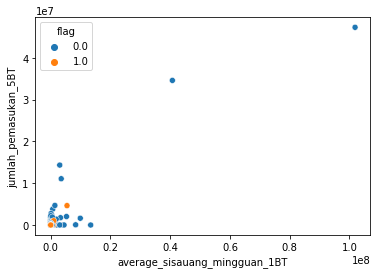

--------------------------------------------------
713
average_sisauang_mingguan_1BT jumlah_pemasukan_6BT


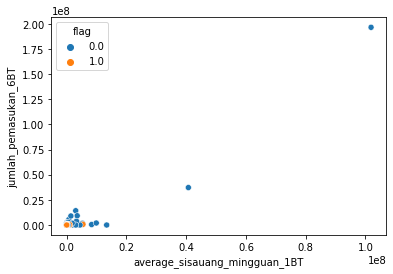

--------------------------------------------------
714
average_sisauang_mingguan_1BT frekuensi_pengeluaran_1BT


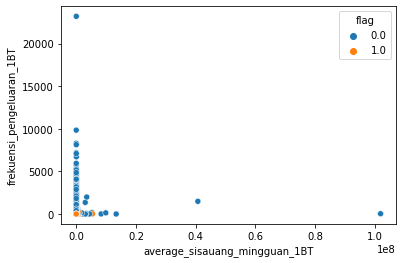

--------------------------------------------------
715
average_sisauang_mingguan_1BT frekuensi_pengeluaran_2BT


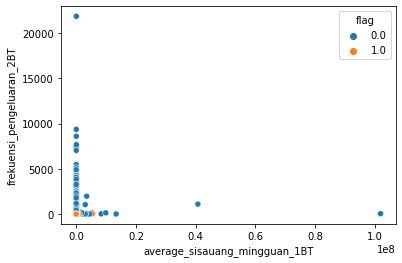

--------------------------------------------------
716
average_sisauang_mingguan_1BT frekuensi_pengeluaran_3BT


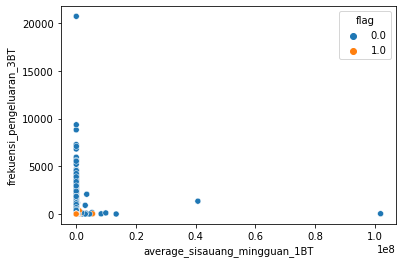

--------------------------------------------------
717
average_sisauang_mingguan_1BT frekuensi_pengeluaran_4BT


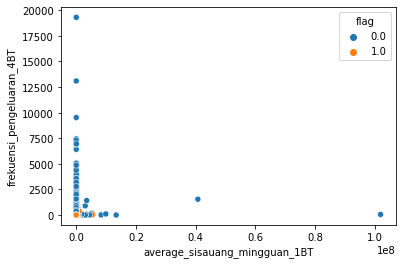

--------------------------------------------------
718
average_sisauang_mingguan_1BT frekuensi_pengeluaran_5BT


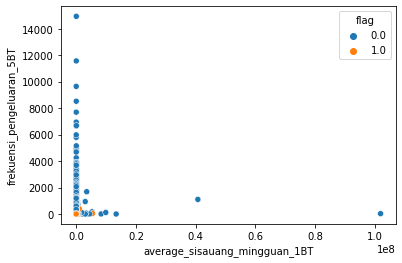

--------------------------------------------------
719
average_sisauang_mingguan_1BT frekuensi_pengeluaran_6BT


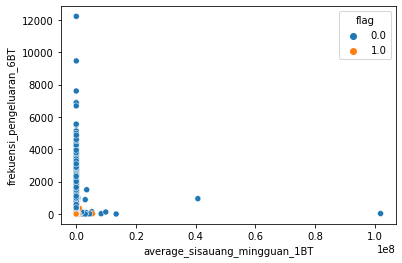

--------------------------------------------------
720
average_sisauang_mingguan_1BT frekuensi_pemasukan_1BT


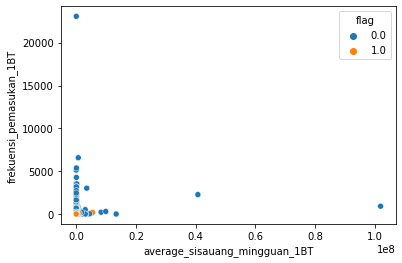

--------------------------------------------------
721
average_sisauang_mingguan_1BT frekuensi_pemasukan_2BT


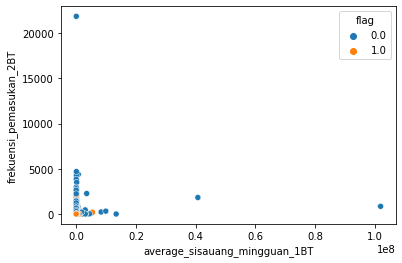

--------------------------------------------------
722
average_sisauang_mingguan_1BT frekuensi_pemasukan_3BT


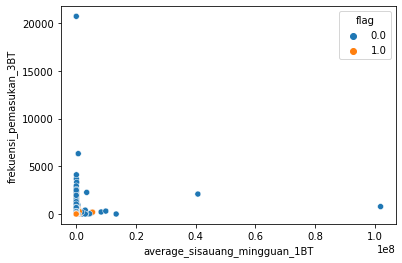

--------------------------------------------------
723
average_sisauang_mingguan_1BT frekuensi_pemasukan_4BT


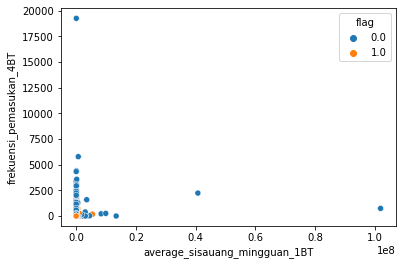

--------------------------------------------------
724
average_sisauang_mingguan_1BT frekuensi_pemasukan_5BT


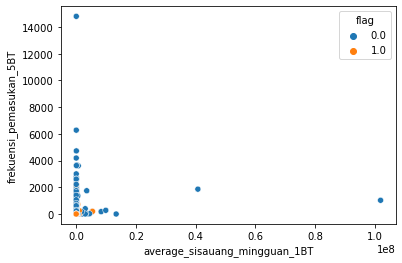

--------------------------------------------------
725
average_sisauang_mingguan_1BT frekuensi_pemasukan_6BT


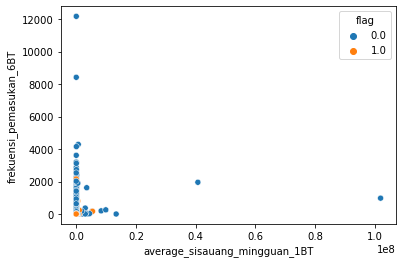

--------------------------------------------------
726
average_sisauang_mingguan_1BT flag


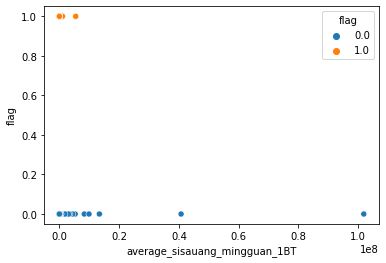

--------------------------------------------------
727
average_sisauang_mingguan_2BT average_sisauang_mingguan_2BT


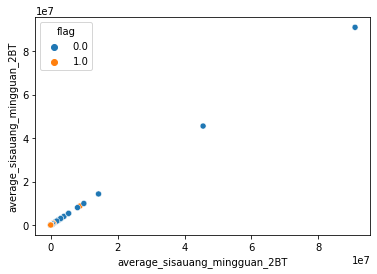

--------------------------------------------------
728
average_sisauang_mingguan_2BT average_sisauang_mingguan_3BT


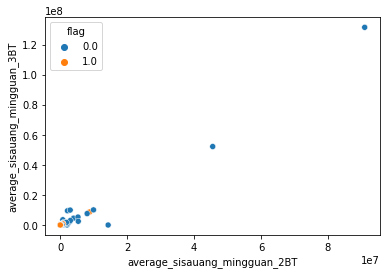

--------------------------------------------------
729
average_sisauang_mingguan_2BT average_sisauang_mingguan_4BT


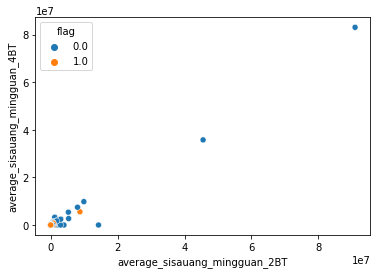

--------------------------------------------------
730
average_sisauang_mingguan_2BT average_sisauang_mingguan_5BT


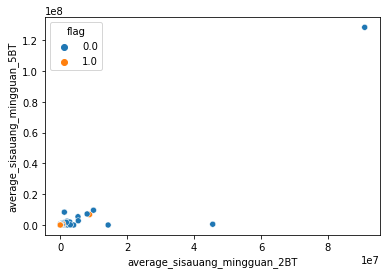

--------------------------------------------------
731
average_sisauang_mingguan_2BT average_sisauang_mingguan_6BT


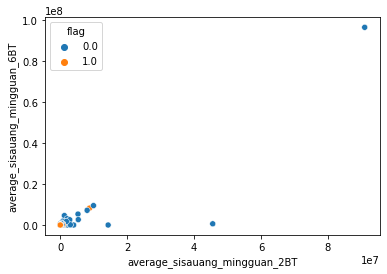

--------------------------------------------------
732
average_sisauang_mingguan_2BT sisauang_akhir_1BT


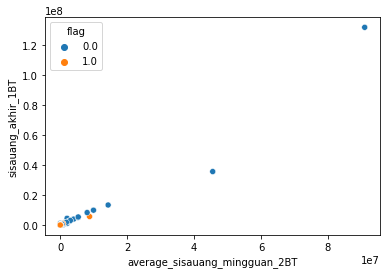

--------------------------------------------------
733
average_sisauang_mingguan_2BT sisauang_akhir_2BT


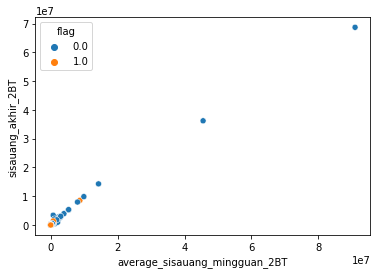

--------------------------------------------------
734
average_sisauang_mingguan_2BT sisauang_akhir_3BT


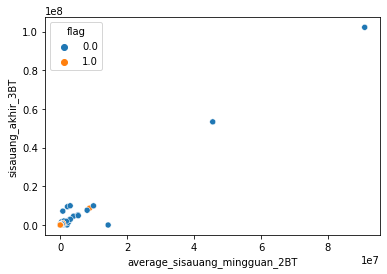

--------------------------------------------------
735
average_sisauang_mingguan_2BT sisauang_akhir_4BT


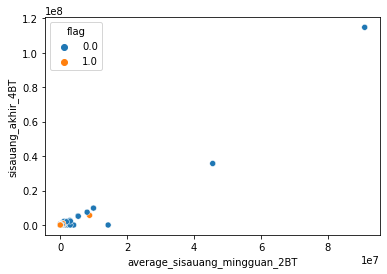

--------------------------------------------------
736
average_sisauang_mingguan_2BT sisauang_akhir_5BT


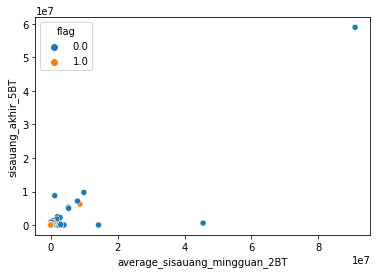

--------------------------------------------------
737
average_sisauang_mingguan_2BT sisauang_akhir_6BT


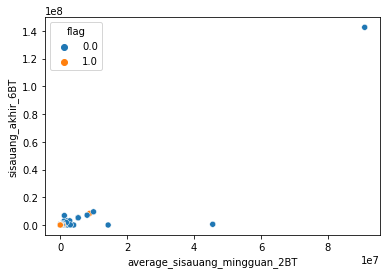

--------------------------------------------------
738
average_sisauang_mingguan_2BT sisauang_tertahan_1BT


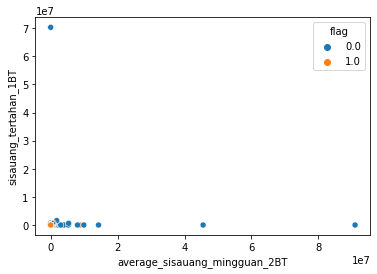

--------------------------------------------------
739
average_sisauang_mingguan_2BT sisauang_tertahan_2BT


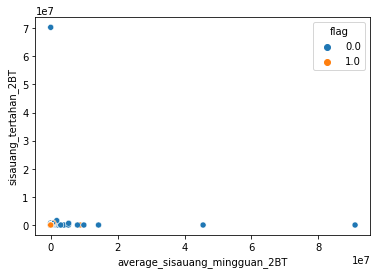

--------------------------------------------------
740
average_sisauang_mingguan_2BT sisauang_tertahan_3BT


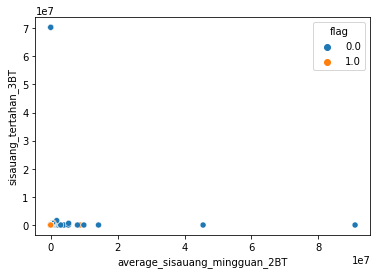

--------------------------------------------------
741
average_sisauang_mingguan_2BT sisauang_tertahan_4BT


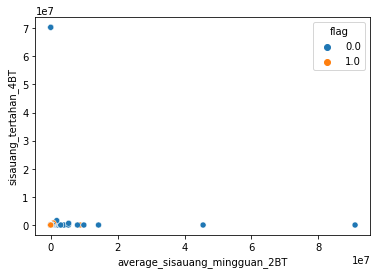

--------------------------------------------------
742
average_sisauang_mingguan_2BT sisauang_tertahan_5BT


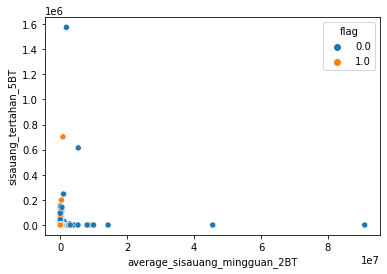

--------------------------------------------------
743
average_sisauang_mingguan_2BT sisauang_tertahan_6BT


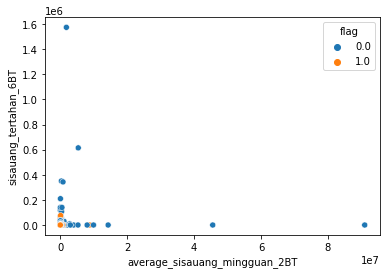

--------------------------------------------------
744
average_sisauang_mingguan_2BT sisauang_tersedia_1BT


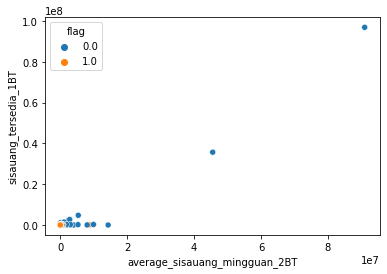

--------------------------------------------------
745
average_sisauang_mingguan_2BT sisauang_tersedia_2BT


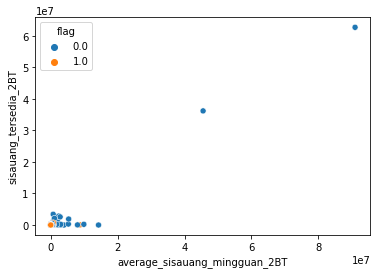

--------------------------------------------------
746
average_sisauang_mingguan_2BT sisauang_tersedia_3BT


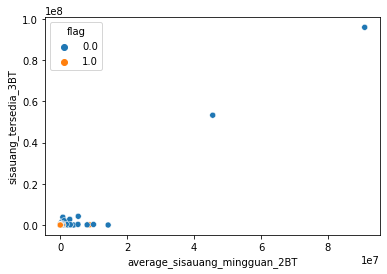

--------------------------------------------------
747
average_sisauang_mingguan_2BT sisauang_tersedia_4BT


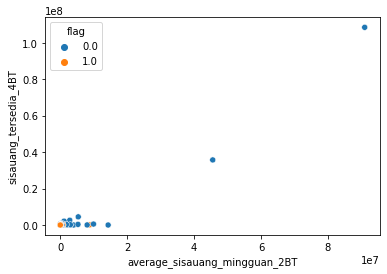

--------------------------------------------------
748
average_sisauang_mingguan_2BT sisauang_tersedia_5BT


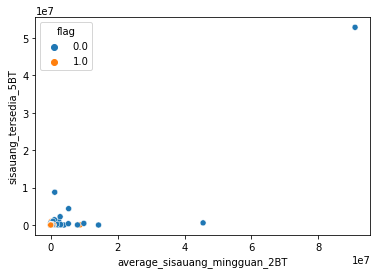

--------------------------------------------------
749
average_sisauang_mingguan_2BT sisauang_tersedia_6BT


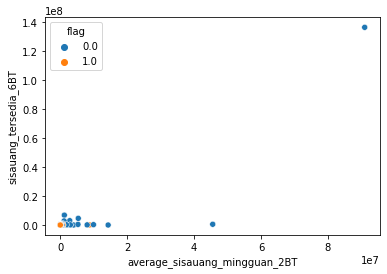

--------------------------------------------------
750
average_sisauang_mingguan_2BT sisa_hutang_1BT


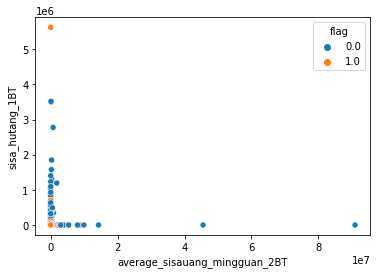

--------------------------------------------------
751
average_sisauang_mingguan_2BT sisa_hutang_2BT


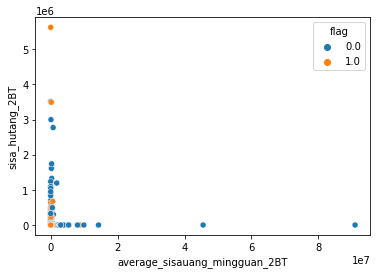

--------------------------------------------------
752
average_sisauang_mingguan_2BT sisa_hutang_3BT


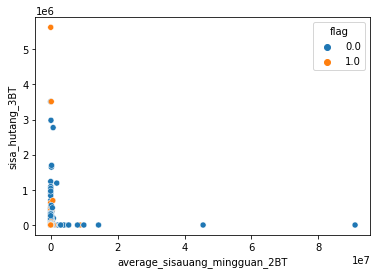

--------------------------------------------------
753
average_sisauang_mingguan_2BT sisa_hutang_4BT


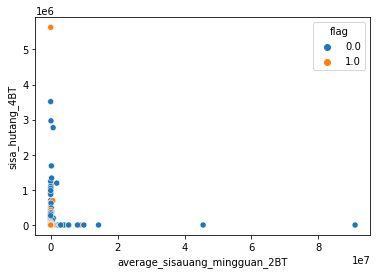

--------------------------------------------------
754
average_sisauang_mingguan_2BT sisa_hutang_5BT


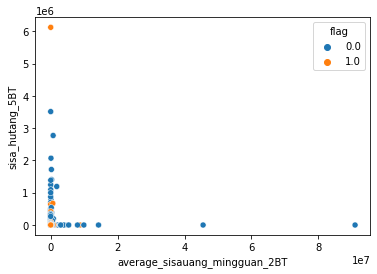

--------------------------------------------------
755
average_sisauang_mingguan_2BT sisa_hutang_6BT


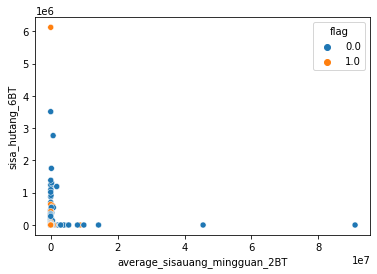

--------------------------------------------------
756
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_1BT


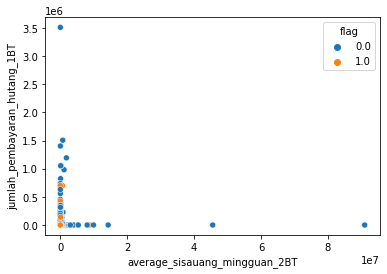

--------------------------------------------------
757
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_2BT


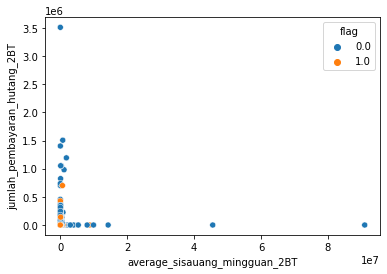

--------------------------------------------------
758
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_3BT


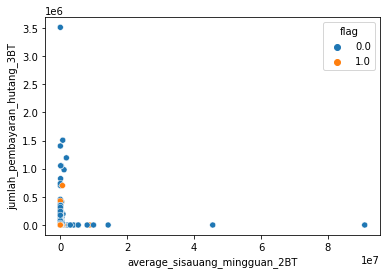

--------------------------------------------------
759
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_4BT


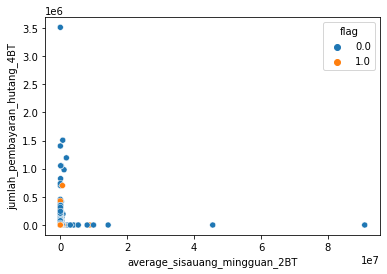

--------------------------------------------------
760
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_5BT


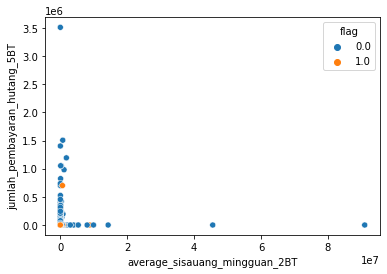

--------------------------------------------------
761
average_sisauang_mingguan_2BT jumlah_pembayaran_hutang_6BT


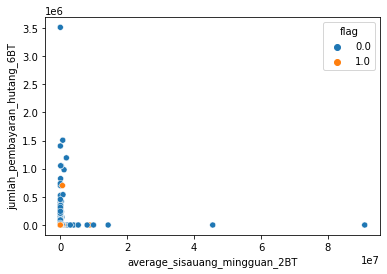

--------------------------------------------------
762
average_sisauang_mingguan_2BT jumlah_pengeluaran_1BT


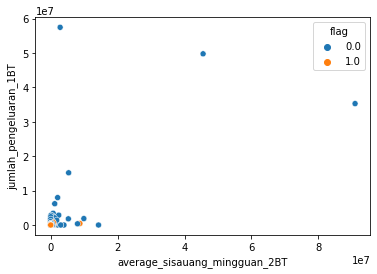

--------------------------------------------------
763
average_sisauang_mingguan_2BT jumlah_pengeluaran_2BT


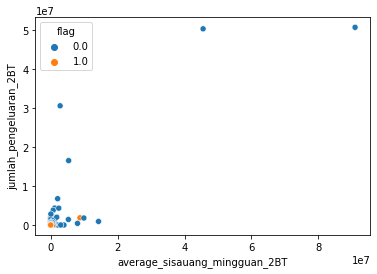

--------------------------------------------------
764
average_sisauang_mingguan_2BT jumlah_pengeluaran_3BT


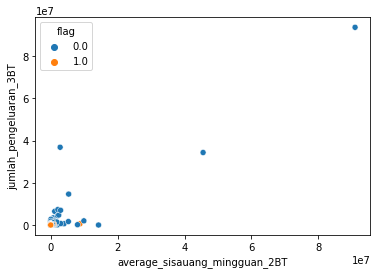

--------------------------------------------------
765
average_sisauang_mingguan_2BT jumlah_pengeluaran_4BT


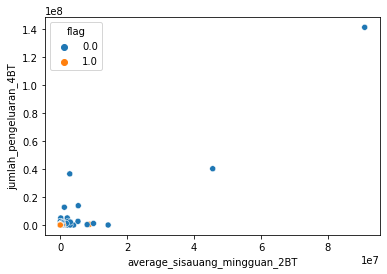

--------------------------------------------------
766
average_sisauang_mingguan_2BT jumlah_pengeluaran_5BT


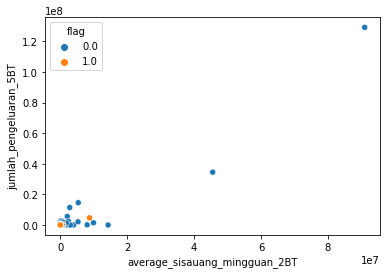

--------------------------------------------------
767
average_sisauang_mingguan_2BT jumlah_pengeluaran_6BT


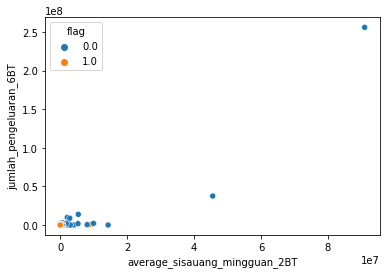

--------------------------------------------------
768
average_sisauang_mingguan_2BT jumlah_pemasukan_1BT


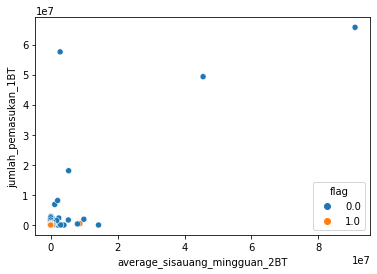

--------------------------------------------------
769
average_sisauang_mingguan_2BT jumlah_pemasukan_2BT


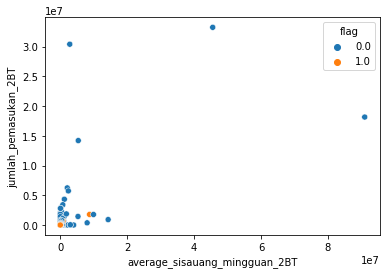

--------------------------------------------------
770
average_sisauang_mingguan_2BT jumlah_pemasukan_3BT


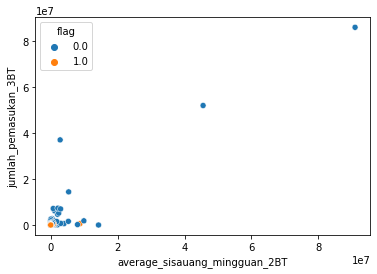

--------------------------------------------------
771
average_sisauang_mingguan_2BT jumlah_pemasukan_4BT


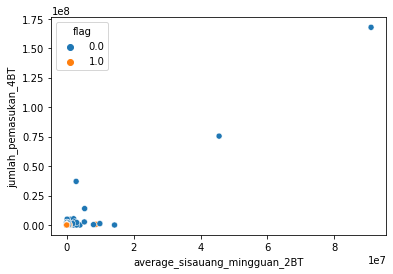

--------------------------------------------------
772
average_sisauang_mingguan_2BT jumlah_pemasukan_5BT


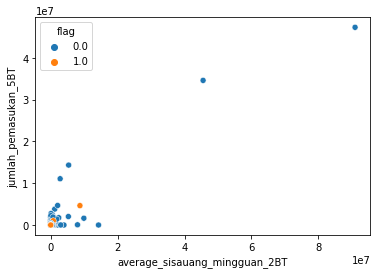

--------------------------------------------------
773
average_sisauang_mingguan_2BT jumlah_pemasukan_6BT


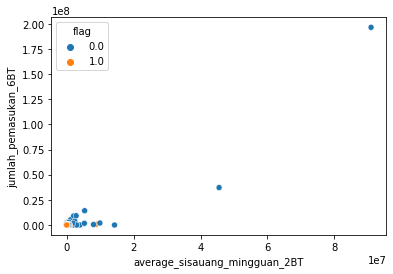

--------------------------------------------------
774
average_sisauang_mingguan_2BT frekuensi_pengeluaran_1BT


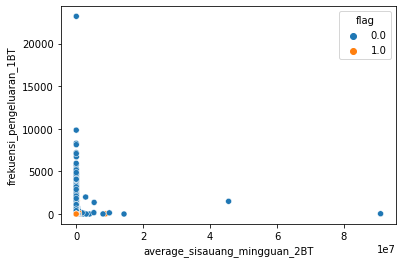

--------------------------------------------------
775
average_sisauang_mingguan_2BT frekuensi_pengeluaran_2BT


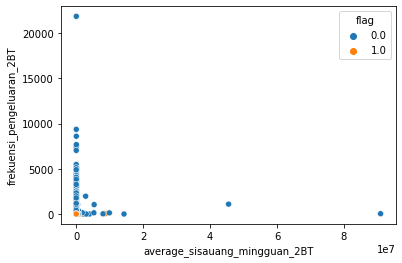

--------------------------------------------------
776
average_sisauang_mingguan_2BT frekuensi_pengeluaran_3BT


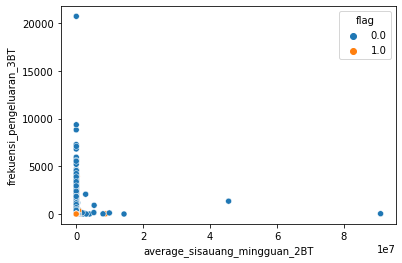

--------------------------------------------------
777
average_sisauang_mingguan_2BT frekuensi_pengeluaran_4BT


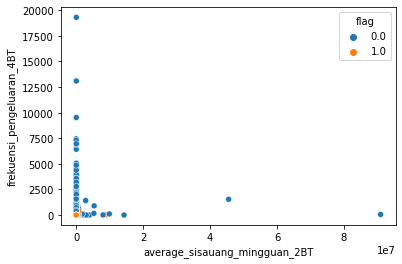

--------------------------------------------------
778
average_sisauang_mingguan_2BT frekuensi_pengeluaran_5BT


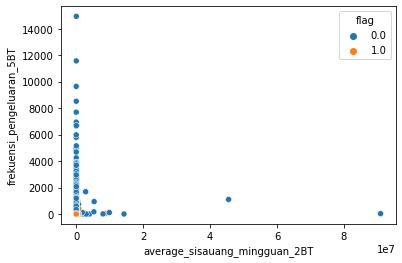

--------------------------------------------------
779
average_sisauang_mingguan_2BT frekuensi_pengeluaran_6BT


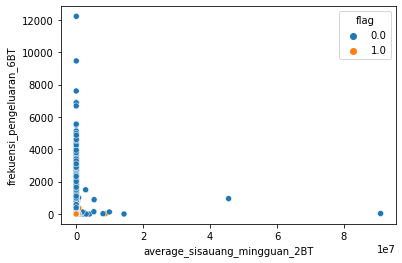

--------------------------------------------------
780
average_sisauang_mingguan_2BT frekuensi_pemasukan_1BT


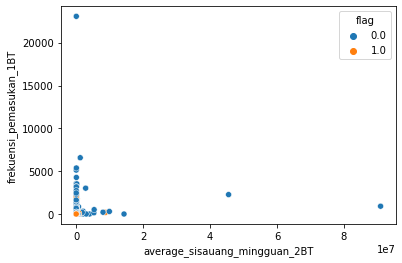

--------------------------------------------------
781
average_sisauang_mingguan_2BT frekuensi_pemasukan_2BT


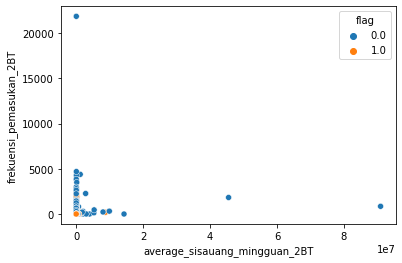

--------------------------------------------------
782
average_sisauang_mingguan_2BT frekuensi_pemasukan_3BT


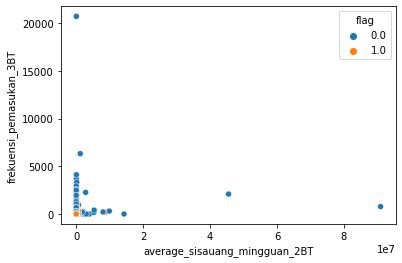

--------------------------------------------------
783
average_sisauang_mingguan_2BT frekuensi_pemasukan_4BT


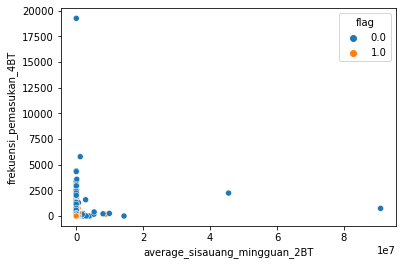

--------------------------------------------------
784
average_sisauang_mingguan_2BT frekuensi_pemasukan_5BT


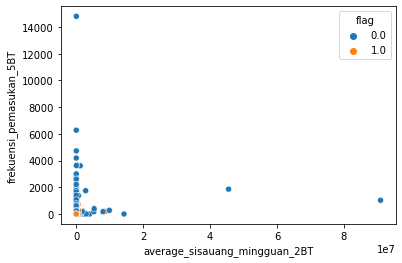

--------------------------------------------------
785
average_sisauang_mingguan_2BT frekuensi_pemasukan_6BT


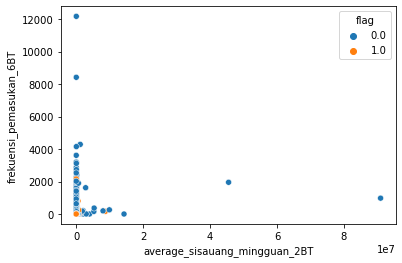

--------------------------------------------------
786
average_sisauang_mingguan_2BT flag


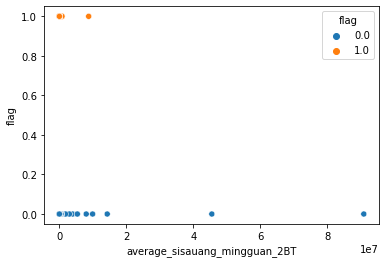

--------------------------------------------------
787
average_sisauang_mingguan_3BT average_sisauang_mingguan_3BT


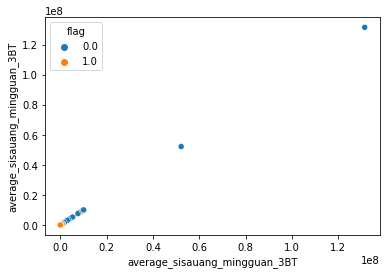

--------------------------------------------------
788
average_sisauang_mingguan_3BT average_sisauang_mingguan_4BT


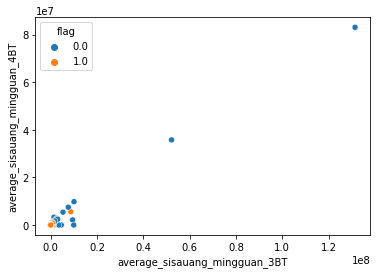

--------------------------------------------------
789
average_sisauang_mingguan_3BT average_sisauang_mingguan_5BT


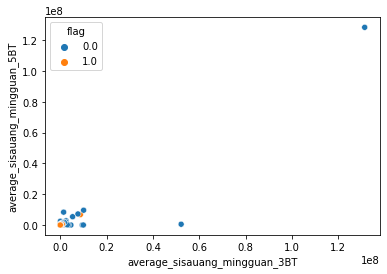

--------------------------------------------------
790
average_sisauang_mingguan_3BT average_sisauang_mingguan_6BT


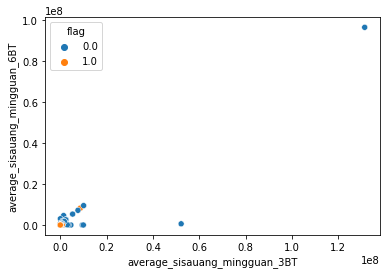

--------------------------------------------------
791
average_sisauang_mingguan_3BT sisauang_akhir_1BT


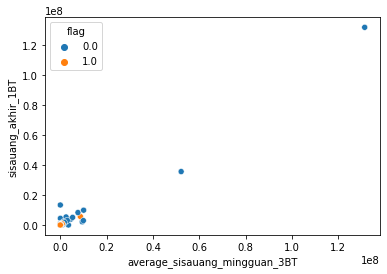

--------------------------------------------------
792
average_sisauang_mingguan_3BT sisauang_akhir_2BT


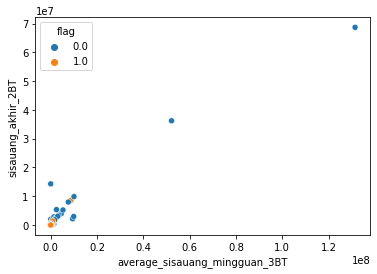

--------------------------------------------------
793
average_sisauang_mingguan_3BT sisauang_akhir_3BT


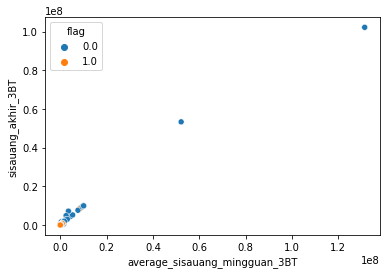

--------------------------------------------------
794
average_sisauang_mingguan_3BT sisauang_akhir_4BT


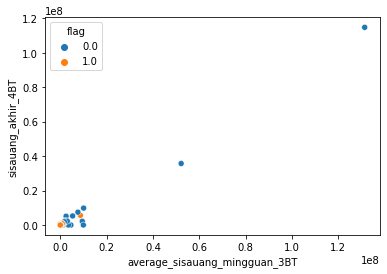

--------------------------------------------------
795
average_sisauang_mingguan_3BT sisauang_akhir_5BT


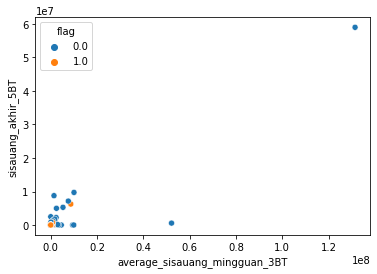

--------------------------------------------------
796
average_sisauang_mingguan_3BT sisauang_akhir_6BT


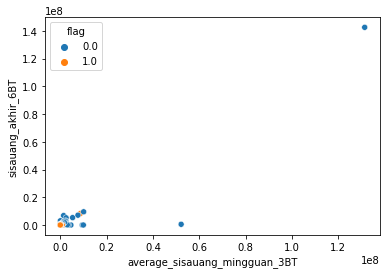

--------------------------------------------------
797
average_sisauang_mingguan_3BT sisauang_tertahan_1BT


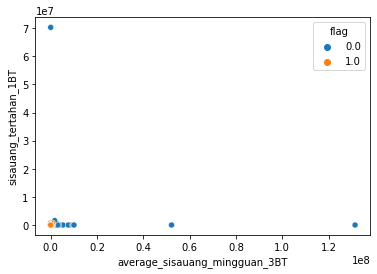

--------------------------------------------------
798
average_sisauang_mingguan_3BT sisauang_tertahan_2BT


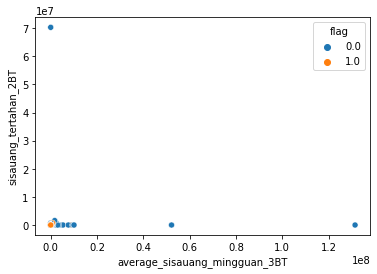

--------------------------------------------------
799
average_sisauang_mingguan_3BT sisauang_tertahan_3BT


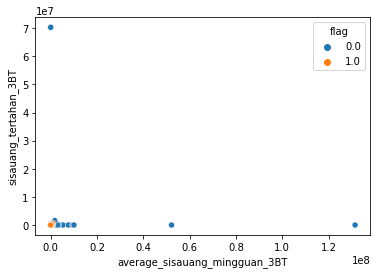

--------------------------------------------------
800
average_sisauang_mingguan_3BT sisauang_tertahan_4BT


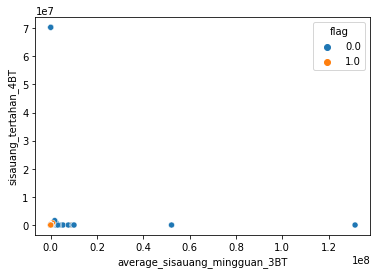

--------------------------------------------------
801
average_sisauang_mingguan_3BT sisauang_tertahan_5BT


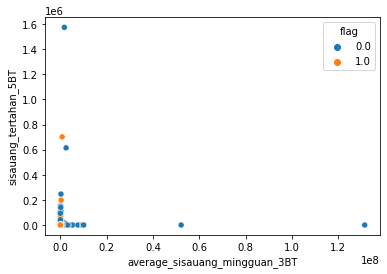

--------------------------------------------------
802
average_sisauang_mingguan_3BT sisauang_tertahan_6BT


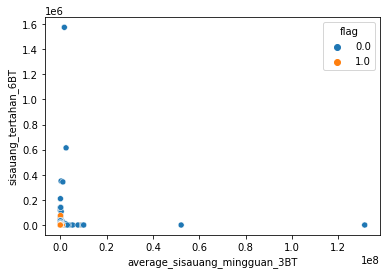

--------------------------------------------------
803
average_sisauang_mingguan_3BT sisauang_tersedia_1BT


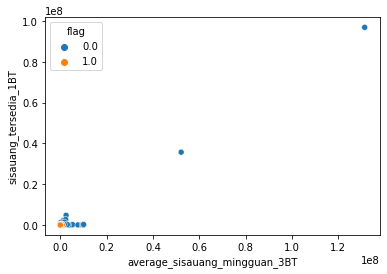

--------------------------------------------------
804
average_sisauang_mingguan_3BT sisauang_tersedia_2BT


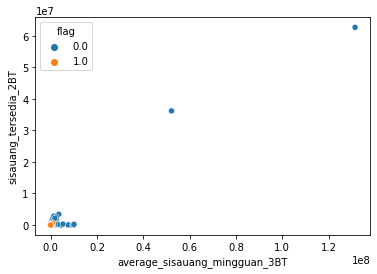

--------------------------------------------------
805
average_sisauang_mingguan_3BT sisauang_tersedia_3BT


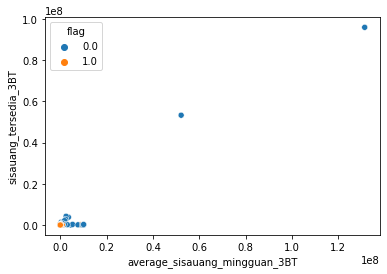

--------------------------------------------------
806
average_sisauang_mingguan_3BT sisauang_tersedia_4BT


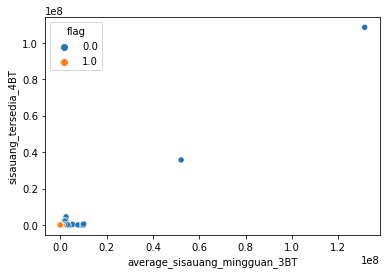

--------------------------------------------------
807
average_sisauang_mingguan_3BT sisauang_tersedia_5BT


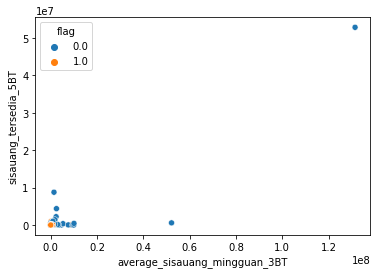

--------------------------------------------------
808
average_sisauang_mingguan_3BT sisauang_tersedia_6BT


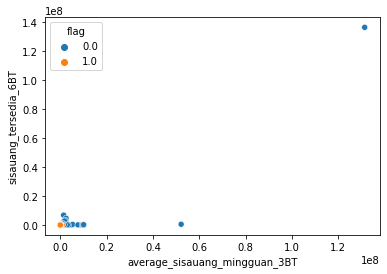

--------------------------------------------------
809
average_sisauang_mingguan_3BT sisa_hutang_1BT


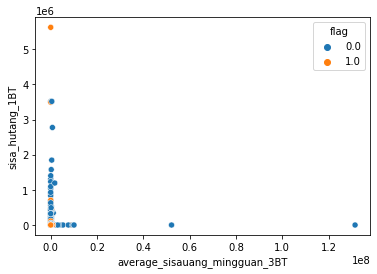

--------------------------------------------------
810
average_sisauang_mingguan_3BT sisa_hutang_2BT


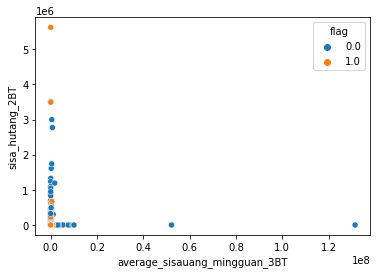

--------------------------------------------------
811
average_sisauang_mingguan_3BT sisa_hutang_3BT


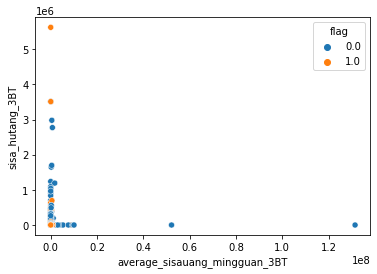

--------------------------------------------------
812
average_sisauang_mingguan_3BT sisa_hutang_4BT


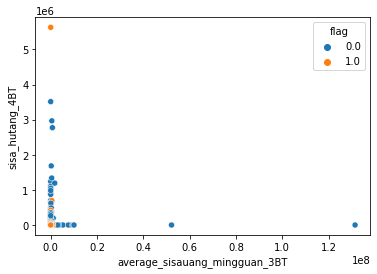

--------------------------------------------------
813
average_sisauang_mingguan_3BT sisa_hutang_5BT


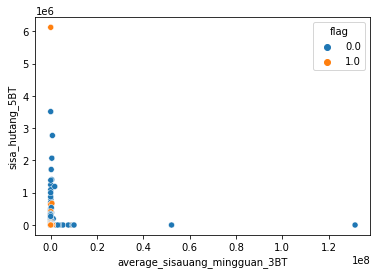

--------------------------------------------------
814
average_sisauang_mingguan_3BT sisa_hutang_6BT


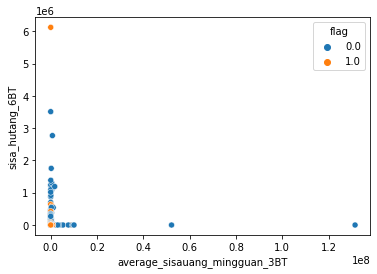

--------------------------------------------------
815
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_1BT


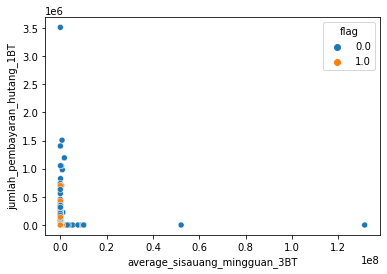

--------------------------------------------------
816
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_2BT


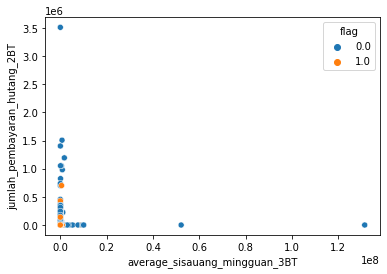

--------------------------------------------------
817
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_3BT


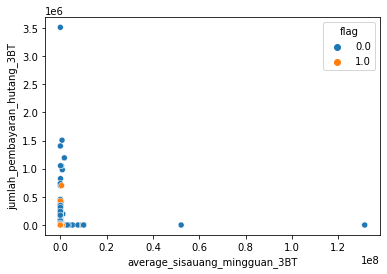

--------------------------------------------------
818
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_4BT


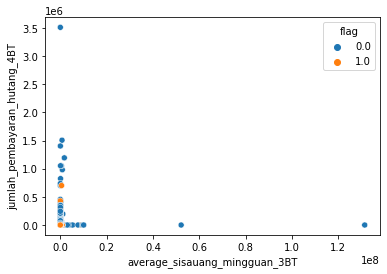

--------------------------------------------------
819
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_5BT


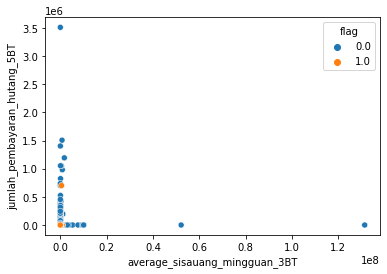

--------------------------------------------------
820
average_sisauang_mingguan_3BT jumlah_pembayaran_hutang_6BT


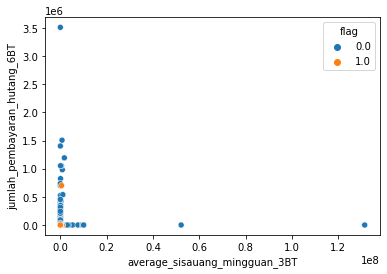

--------------------------------------------------
821
average_sisauang_mingguan_3BT jumlah_pengeluaran_1BT


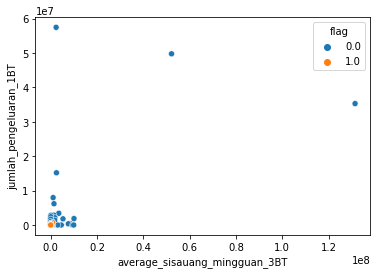

--------------------------------------------------
822
average_sisauang_mingguan_3BT jumlah_pengeluaran_2BT


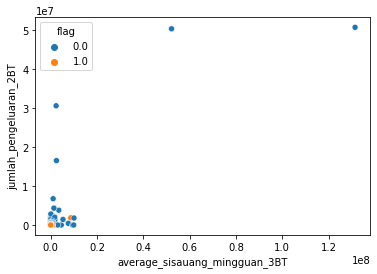

--------------------------------------------------
823
average_sisauang_mingguan_3BT jumlah_pengeluaran_3BT


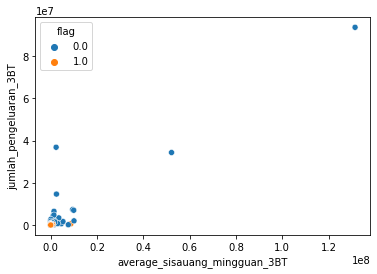

--------------------------------------------------
824
average_sisauang_mingguan_3BT jumlah_pengeluaran_4BT


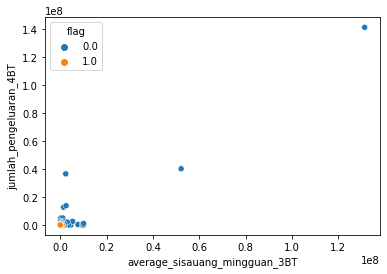

--------------------------------------------------
825
average_sisauang_mingguan_3BT jumlah_pengeluaran_5BT


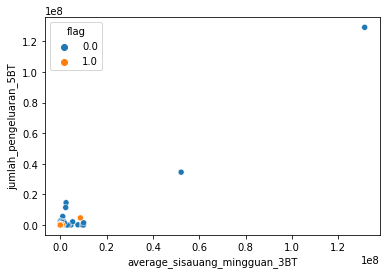

--------------------------------------------------
826
average_sisauang_mingguan_3BT jumlah_pengeluaran_6BT


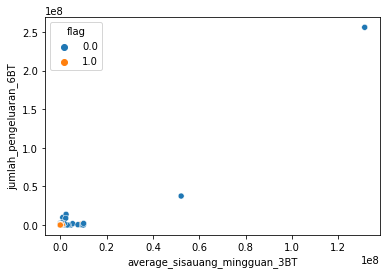

--------------------------------------------------
827
average_sisauang_mingguan_3BT jumlah_pemasukan_1BT


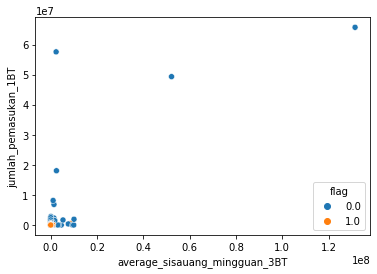

--------------------------------------------------
828
average_sisauang_mingguan_3BT jumlah_pemasukan_2BT


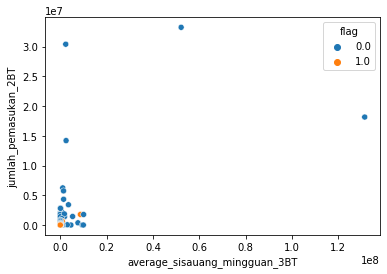

--------------------------------------------------
829
average_sisauang_mingguan_3BT jumlah_pemasukan_3BT


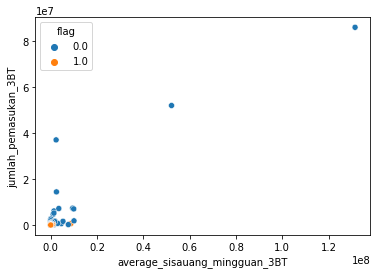

--------------------------------------------------
830
average_sisauang_mingguan_3BT jumlah_pemasukan_4BT


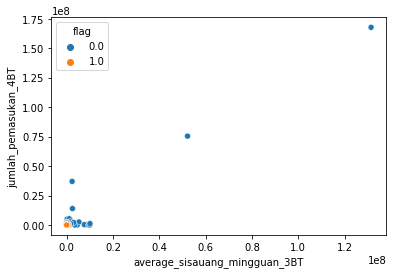

--------------------------------------------------
831
average_sisauang_mingguan_3BT jumlah_pemasukan_5BT


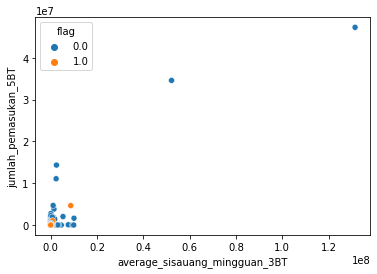

--------------------------------------------------
832
average_sisauang_mingguan_3BT jumlah_pemasukan_6BT


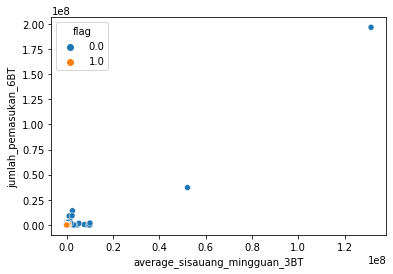

--------------------------------------------------
833
average_sisauang_mingguan_3BT frekuensi_pengeluaran_1BT


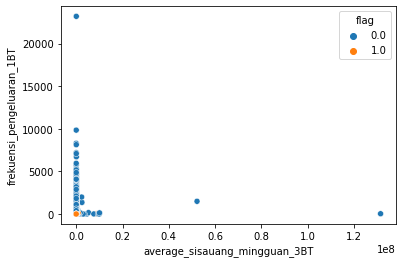

--------------------------------------------------
834
average_sisauang_mingguan_3BT frekuensi_pengeluaran_2BT


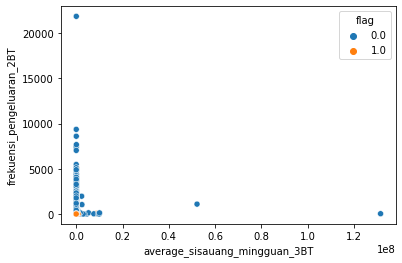

--------------------------------------------------
835
average_sisauang_mingguan_3BT frekuensi_pengeluaran_3BT


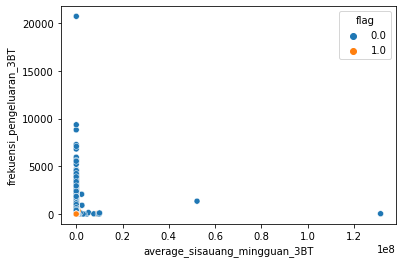

--------------------------------------------------
836
average_sisauang_mingguan_3BT frekuensi_pengeluaran_4BT


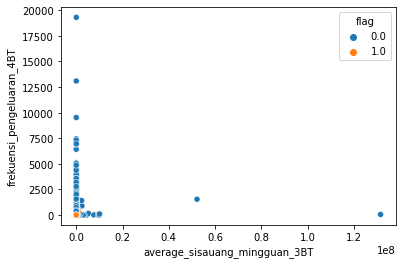

--------------------------------------------------
837
average_sisauang_mingguan_3BT frekuensi_pengeluaran_5BT


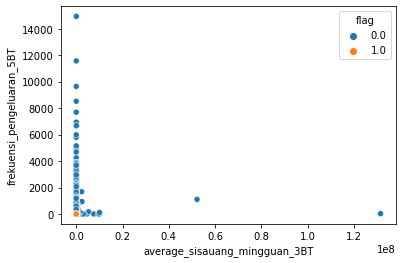

--------------------------------------------------
838
average_sisauang_mingguan_3BT frekuensi_pengeluaran_6BT


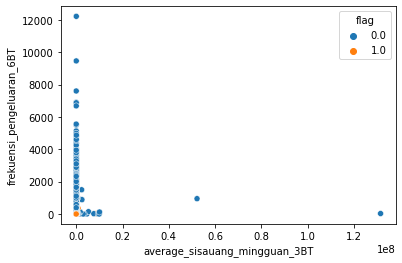

--------------------------------------------------
839
average_sisauang_mingguan_3BT frekuensi_pemasukan_1BT


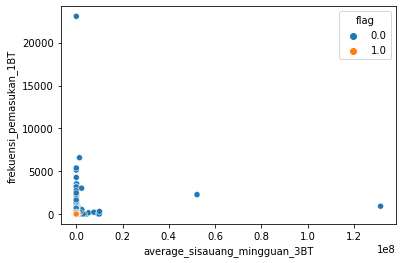

--------------------------------------------------
840
average_sisauang_mingguan_3BT frekuensi_pemasukan_2BT


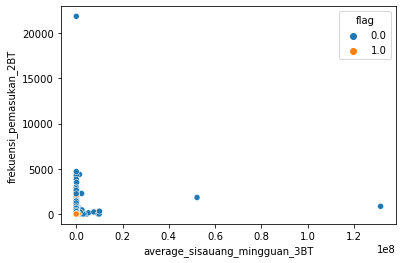

--------------------------------------------------
841
average_sisauang_mingguan_3BT frekuensi_pemasukan_3BT


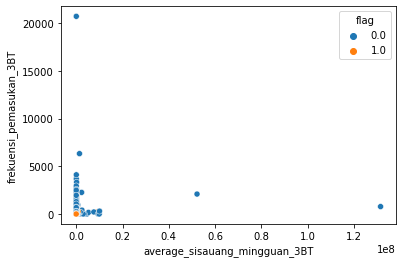

--------------------------------------------------
842
average_sisauang_mingguan_3BT frekuensi_pemasukan_4BT


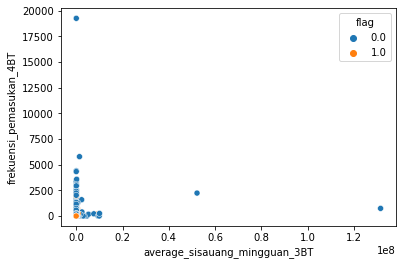

--------------------------------------------------
843
average_sisauang_mingguan_3BT frekuensi_pemasukan_5BT


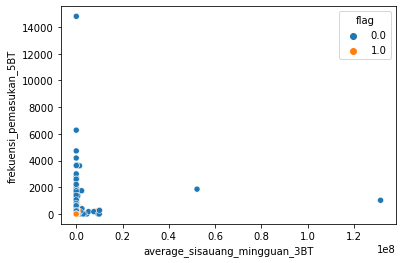

--------------------------------------------------
844
average_sisauang_mingguan_3BT frekuensi_pemasukan_6BT


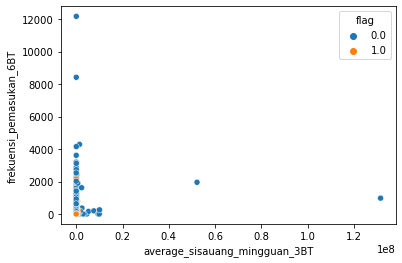

--------------------------------------------------
845
average_sisauang_mingguan_3BT flag


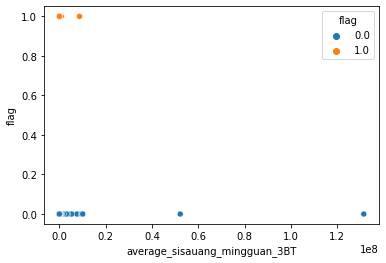

--------------------------------------------------
846
average_sisauang_mingguan_4BT average_sisauang_mingguan_4BT


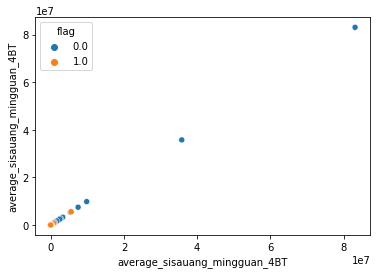

--------------------------------------------------
847
average_sisauang_mingguan_4BT average_sisauang_mingguan_5BT


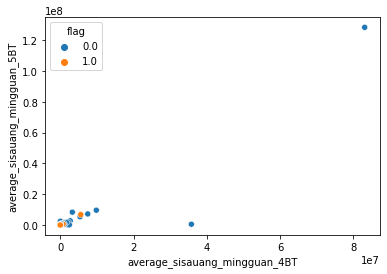

--------------------------------------------------
848
average_sisauang_mingguan_4BT average_sisauang_mingguan_6BT


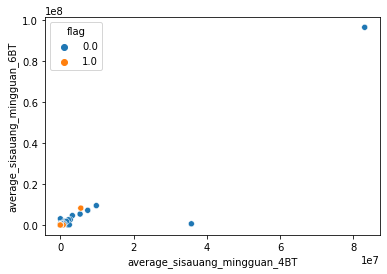

--------------------------------------------------
849
average_sisauang_mingguan_4BT sisauang_akhir_1BT


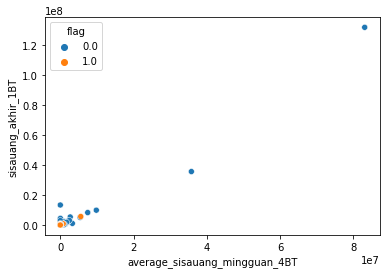

--------------------------------------------------
850
average_sisauang_mingguan_4BT sisauang_akhir_2BT


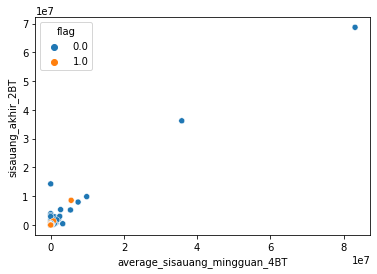

--------------------------------------------------
851
average_sisauang_mingguan_4BT sisauang_akhir_3BT


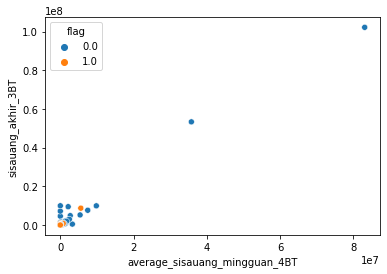

--------------------------------------------------
852
average_sisauang_mingguan_4BT sisauang_akhir_4BT


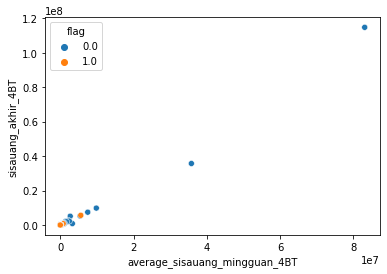

--------------------------------------------------
853
average_sisauang_mingguan_4BT sisauang_akhir_5BT


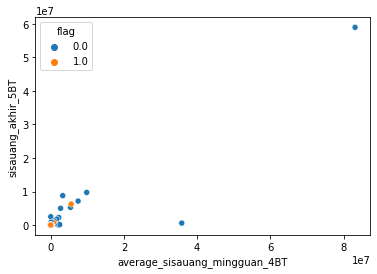

--------------------------------------------------
854
average_sisauang_mingguan_4BT sisauang_akhir_6BT


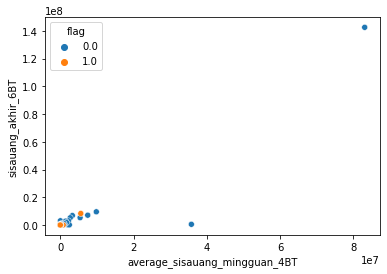

--------------------------------------------------
855
average_sisauang_mingguan_4BT sisauang_tertahan_1BT


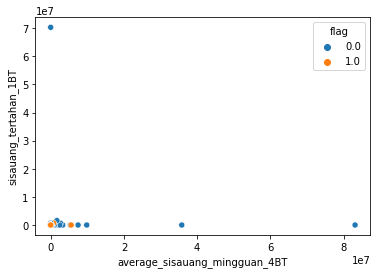

--------------------------------------------------
856
average_sisauang_mingguan_4BT sisauang_tertahan_2BT


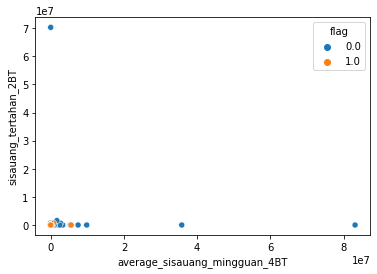

--------------------------------------------------
857
average_sisauang_mingguan_4BT sisauang_tertahan_3BT


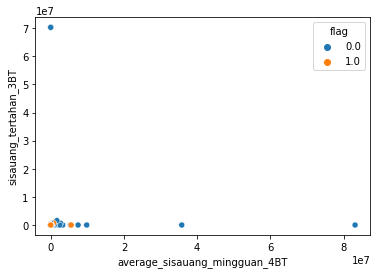

--------------------------------------------------
858
average_sisauang_mingguan_4BT sisauang_tertahan_4BT


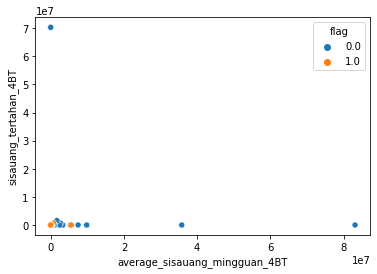

--------------------------------------------------
859
average_sisauang_mingguan_4BT sisauang_tertahan_5BT


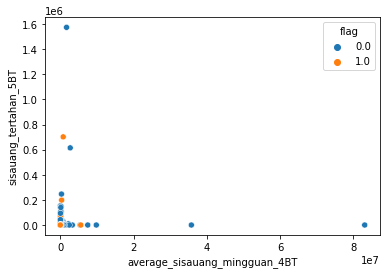

--------------------------------------------------
860
average_sisauang_mingguan_4BT sisauang_tertahan_6BT


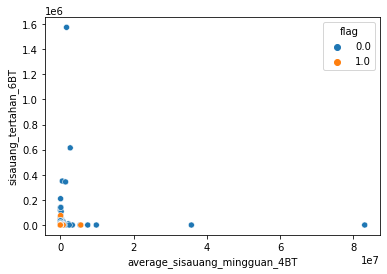

--------------------------------------------------
861
average_sisauang_mingguan_4BT sisauang_tersedia_1BT


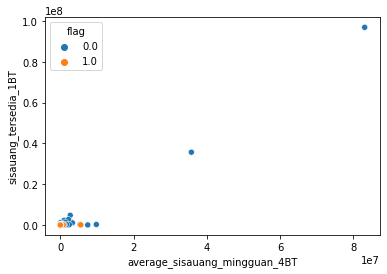

--------------------------------------------------
862
average_sisauang_mingguan_4BT sisauang_tersedia_2BT


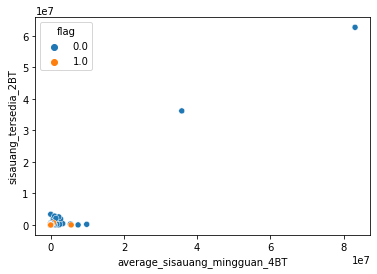

--------------------------------------------------
863
average_sisauang_mingguan_4BT sisauang_tersedia_3BT


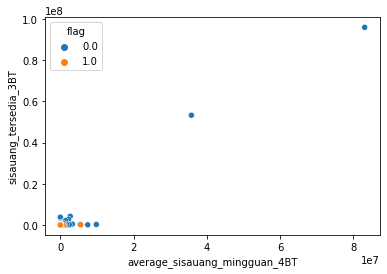

--------------------------------------------------
864
average_sisauang_mingguan_4BT sisauang_tersedia_4BT


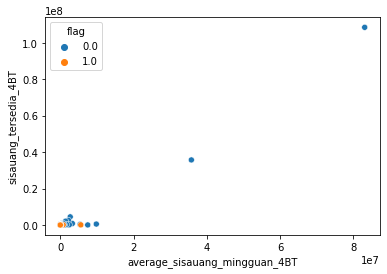

--------------------------------------------------
865
average_sisauang_mingguan_4BT sisauang_tersedia_5BT


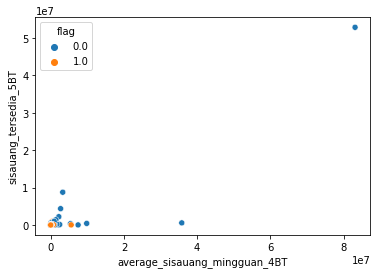

--------------------------------------------------
866
average_sisauang_mingguan_4BT sisauang_tersedia_6BT


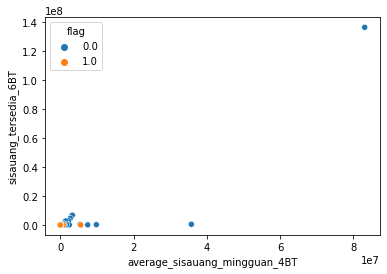

--------------------------------------------------
867
average_sisauang_mingguan_4BT sisa_hutang_1BT


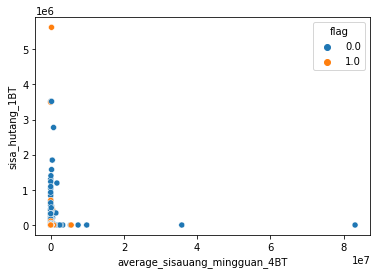

--------------------------------------------------
868
average_sisauang_mingguan_4BT sisa_hutang_2BT


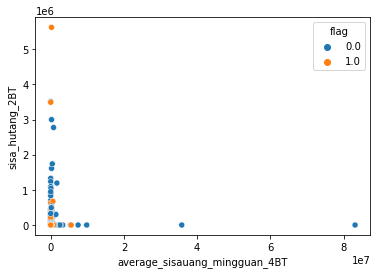

--------------------------------------------------
869
average_sisauang_mingguan_4BT sisa_hutang_3BT


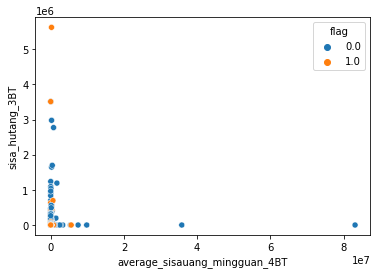

--------------------------------------------------
870
average_sisauang_mingguan_4BT sisa_hutang_4BT


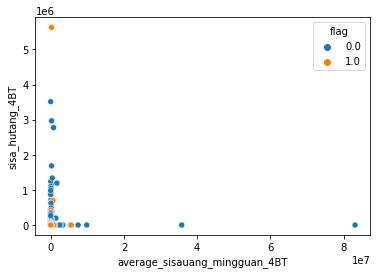

--------------------------------------------------
871
average_sisauang_mingguan_4BT sisa_hutang_5BT


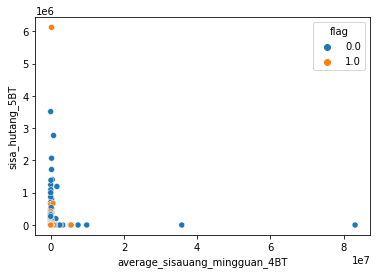

--------------------------------------------------
872
average_sisauang_mingguan_4BT sisa_hutang_6BT


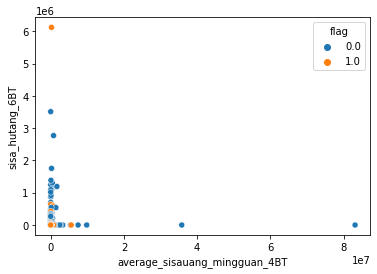

--------------------------------------------------
873
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_1BT


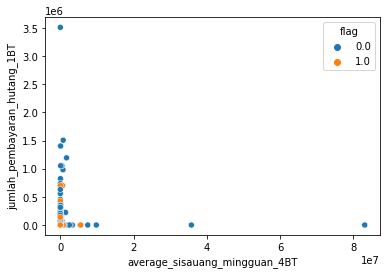

--------------------------------------------------
874
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_2BT


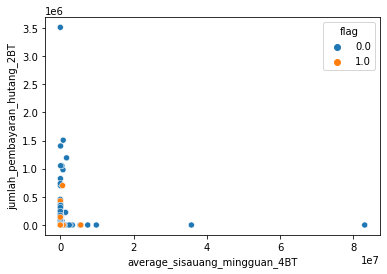

--------------------------------------------------
875
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_3BT


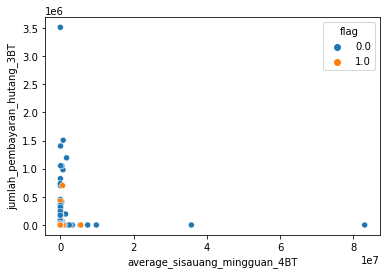

--------------------------------------------------
876
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_4BT


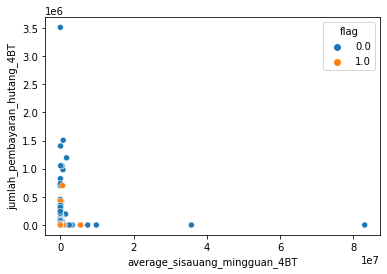

--------------------------------------------------
877
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_5BT


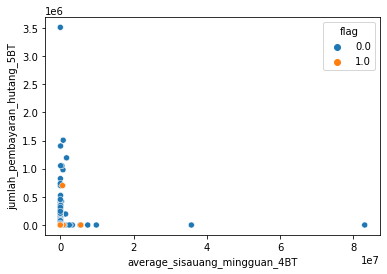

--------------------------------------------------
878
average_sisauang_mingguan_4BT jumlah_pembayaran_hutang_6BT


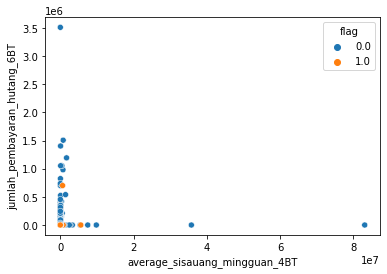

--------------------------------------------------
879
average_sisauang_mingguan_4BT jumlah_pengeluaran_1BT


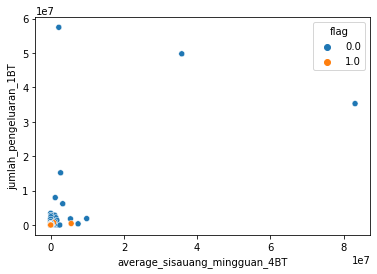

--------------------------------------------------
880
average_sisauang_mingguan_4BT jumlah_pengeluaran_2BT


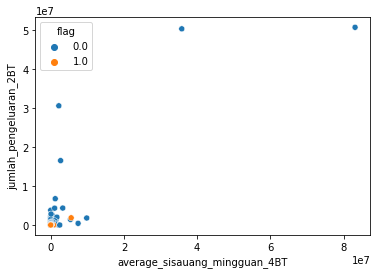

--------------------------------------------------
881
average_sisauang_mingguan_4BT jumlah_pengeluaran_3BT


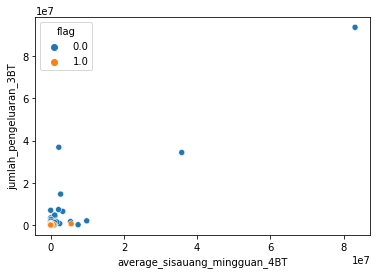

--------------------------------------------------
882
average_sisauang_mingguan_4BT jumlah_pengeluaran_4BT


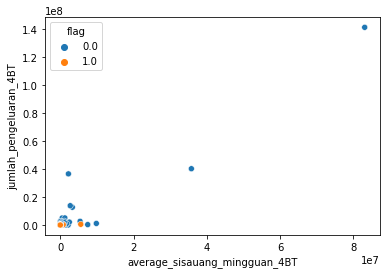

--------------------------------------------------
883
average_sisauang_mingguan_4BT jumlah_pengeluaran_5BT


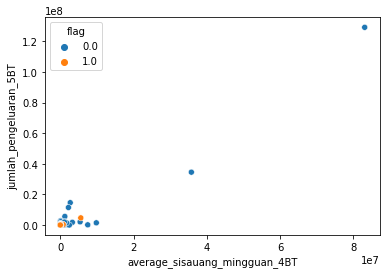

--------------------------------------------------
884
average_sisauang_mingguan_4BT jumlah_pengeluaran_6BT


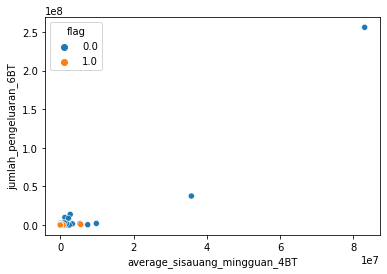

--------------------------------------------------
885
average_sisauang_mingguan_4BT jumlah_pemasukan_1BT


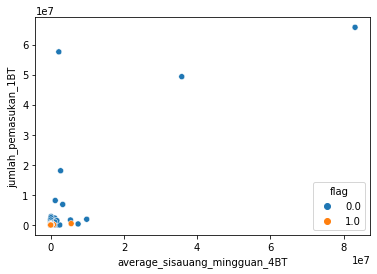

--------------------------------------------------
886
average_sisauang_mingguan_4BT jumlah_pemasukan_2BT


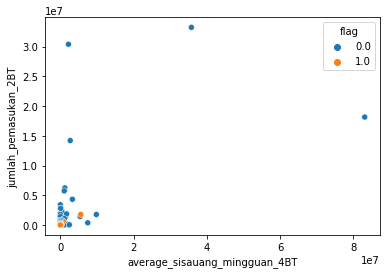

--------------------------------------------------
887
average_sisauang_mingguan_4BT jumlah_pemasukan_3BT


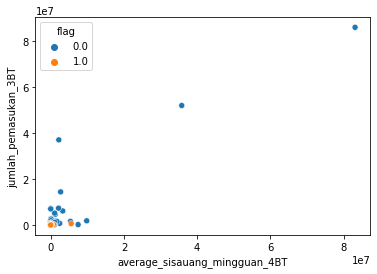

--------------------------------------------------
888
average_sisauang_mingguan_4BT jumlah_pemasukan_4BT


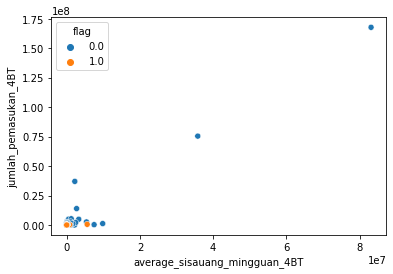

--------------------------------------------------
889
average_sisauang_mingguan_4BT jumlah_pemasukan_5BT


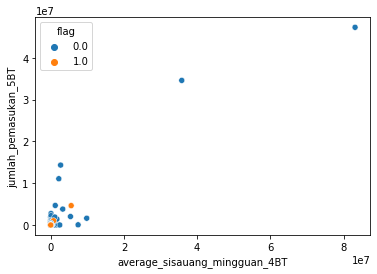

--------------------------------------------------
890
average_sisauang_mingguan_4BT jumlah_pemasukan_6BT


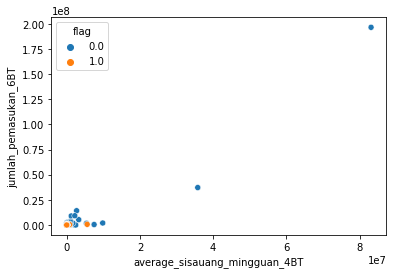

--------------------------------------------------
891
average_sisauang_mingguan_4BT frekuensi_pengeluaran_1BT


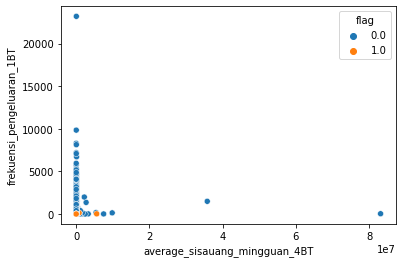

--------------------------------------------------
892
average_sisauang_mingguan_4BT frekuensi_pengeluaran_2BT


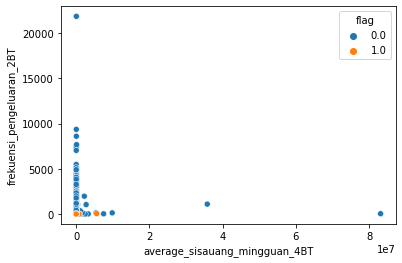

--------------------------------------------------
893
average_sisauang_mingguan_4BT frekuensi_pengeluaran_3BT


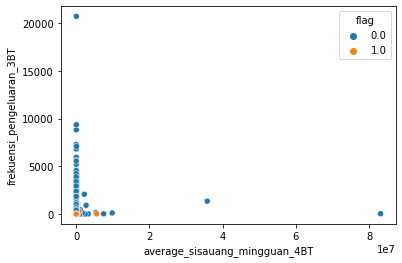

--------------------------------------------------
894
average_sisauang_mingguan_4BT frekuensi_pengeluaran_4BT


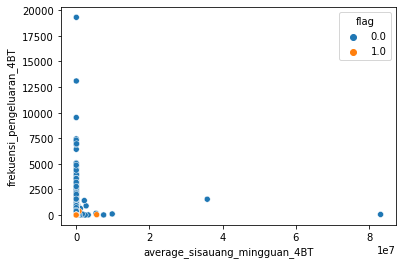

--------------------------------------------------
895
average_sisauang_mingguan_4BT frekuensi_pengeluaran_5BT


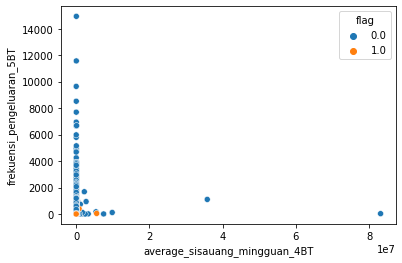

--------------------------------------------------
896
average_sisauang_mingguan_4BT frekuensi_pengeluaran_6BT


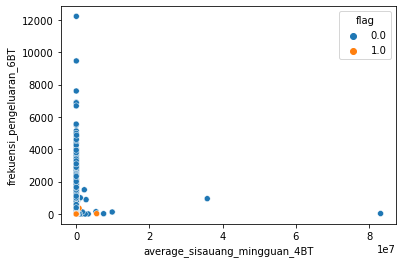

--------------------------------------------------
897
average_sisauang_mingguan_4BT frekuensi_pemasukan_1BT


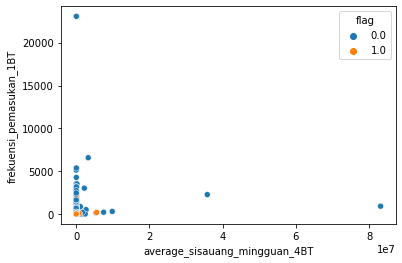

--------------------------------------------------
898
average_sisauang_mingguan_4BT frekuensi_pemasukan_2BT


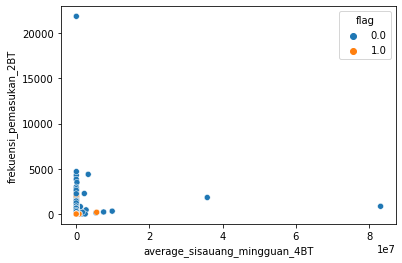

--------------------------------------------------
899
average_sisauang_mingguan_4BT frekuensi_pemasukan_3BT


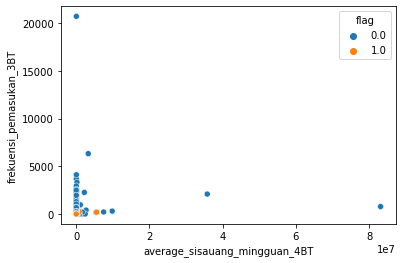

--------------------------------------------------
900
average_sisauang_mingguan_4BT frekuensi_pemasukan_4BT


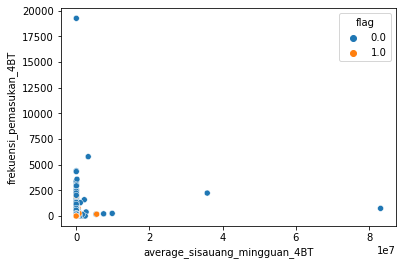

--------------------------------------------------
901
average_sisauang_mingguan_4BT frekuensi_pemasukan_5BT


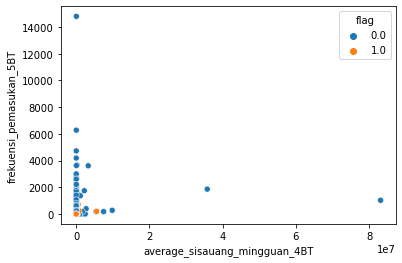

--------------------------------------------------
902
average_sisauang_mingguan_4BT frekuensi_pemasukan_6BT


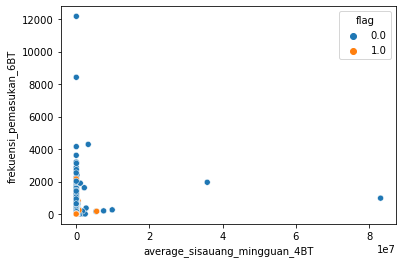

--------------------------------------------------
903
average_sisauang_mingguan_4BT flag


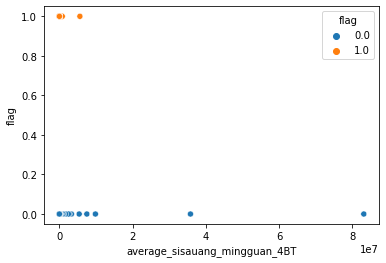

--------------------------------------------------
904
average_sisauang_mingguan_5BT average_sisauang_mingguan_5BT


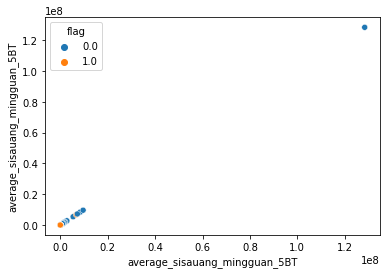

--------------------------------------------------
905
average_sisauang_mingguan_5BT average_sisauang_mingguan_6BT


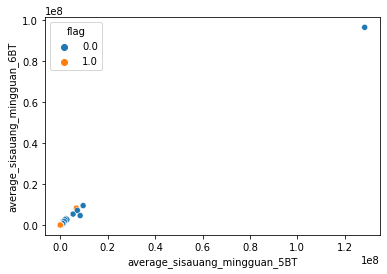

--------------------------------------------------
906
average_sisauang_mingguan_5BT sisauang_akhir_1BT


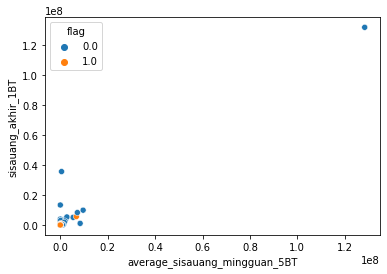

--------------------------------------------------
907
average_sisauang_mingguan_5BT sisauang_akhir_2BT


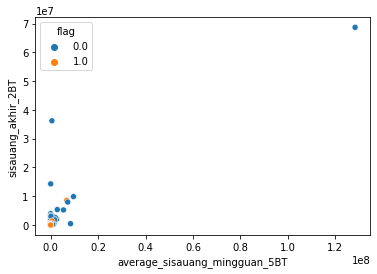

--------------------------------------------------
908
average_sisauang_mingguan_5BT sisauang_akhir_3BT


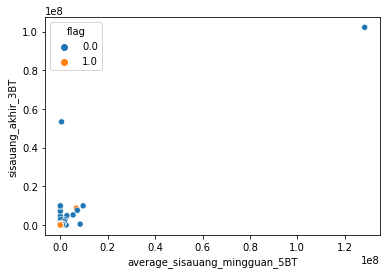

--------------------------------------------------
909
average_sisauang_mingguan_5BT sisauang_akhir_4BT


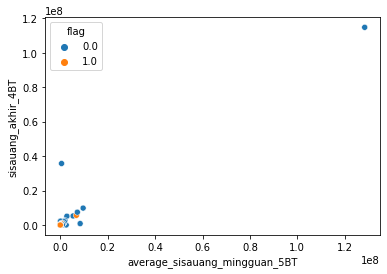

--------------------------------------------------
910
average_sisauang_mingguan_5BT sisauang_akhir_5BT


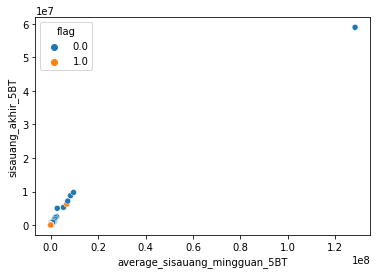

--------------------------------------------------
911
average_sisauang_mingguan_5BT sisauang_akhir_6BT


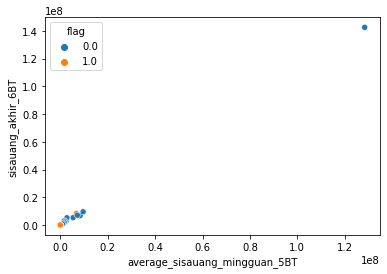

--------------------------------------------------
912
average_sisauang_mingguan_5BT sisauang_tertahan_1BT


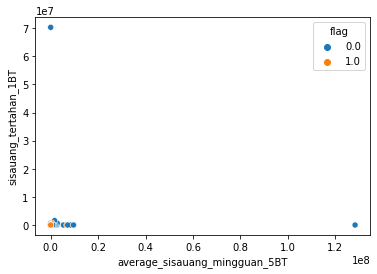

--------------------------------------------------
913
average_sisauang_mingguan_5BT sisauang_tertahan_2BT


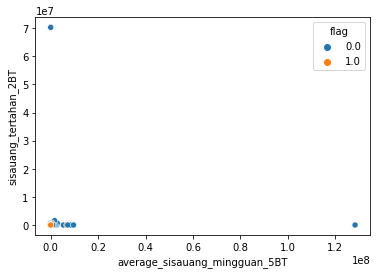

--------------------------------------------------
914
average_sisauang_mingguan_5BT sisauang_tertahan_3BT


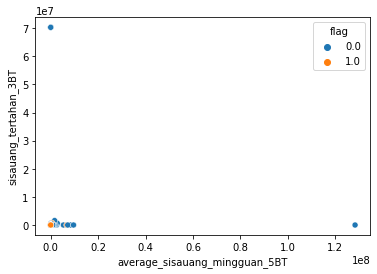

--------------------------------------------------
915
average_sisauang_mingguan_5BT sisauang_tertahan_4BT


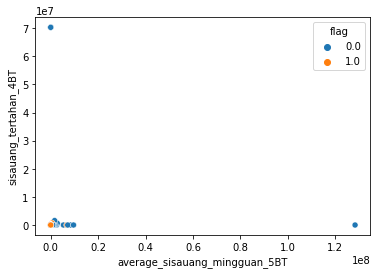

--------------------------------------------------
916
average_sisauang_mingguan_5BT sisauang_tertahan_5BT


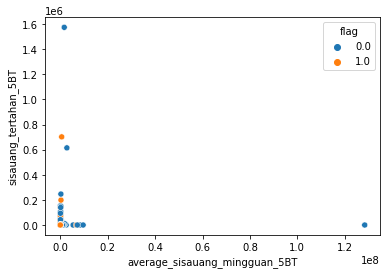

--------------------------------------------------
917
average_sisauang_mingguan_5BT sisauang_tertahan_6BT


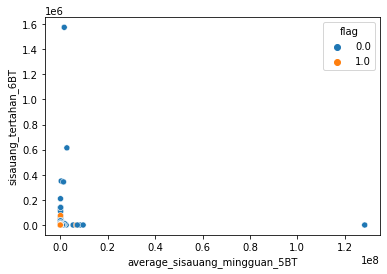

--------------------------------------------------
918
average_sisauang_mingguan_5BT sisauang_tersedia_1BT


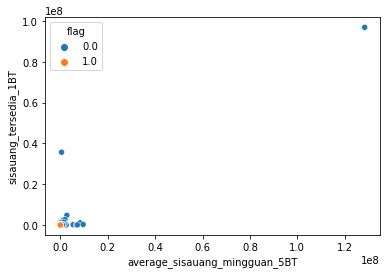

--------------------------------------------------
919
average_sisauang_mingguan_5BT sisauang_tersedia_2BT


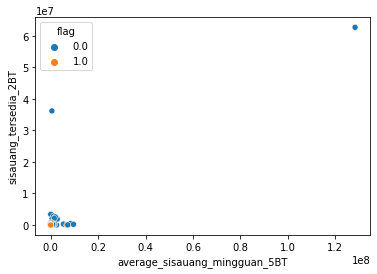

--------------------------------------------------
920
average_sisauang_mingguan_5BT sisauang_tersedia_3BT


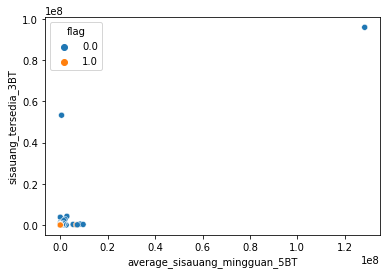

--------------------------------------------------
921
average_sisauang_mingguan_5BT sisauang_tersedia_4BT


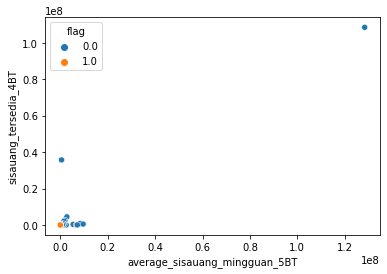

--------------------------------------------------
922
average_sisauang_mingguan_5BT sisauang_tersedia_5BT


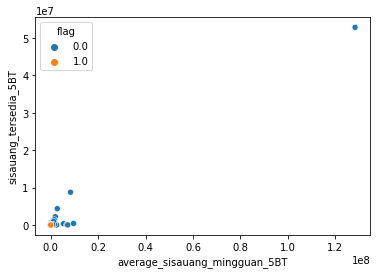

--------------------------------------------------
923
average_sisauang_mingguan_5BT sisauang_tersedia_6BT


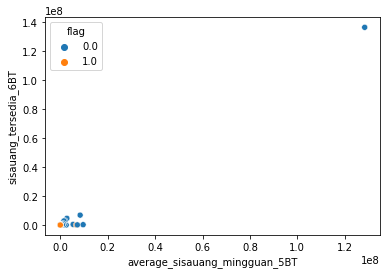

--------------------------------------------------
924
average_sisauang_mingguan_5BT sisa_hutang_1BT


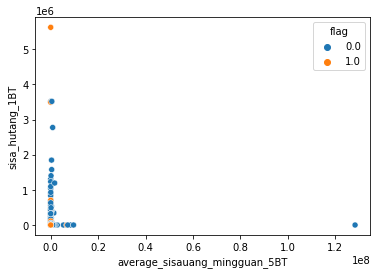

--------------------------------------------------
925
average_sisauang_mingguan_5BT sisa_hutang_2BT


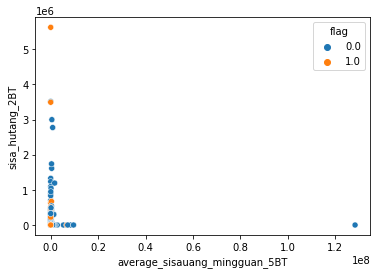

--------------------------------------------------
926
average_sisauang_mingguan_5BT sisa_hutang_3BT


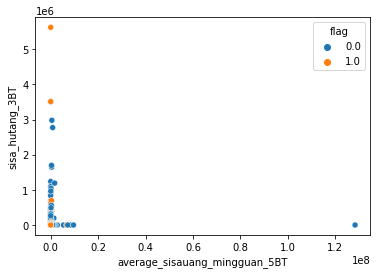

--------------------------------------------------
927
average_sisauang_mingguan_5BT sisa_hutang_4BT


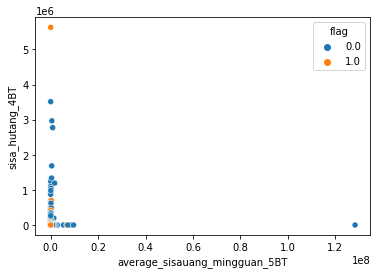

--------------------------------------------------
928
average_sisauang_mingguan_5BT sisa_hutang_5BT


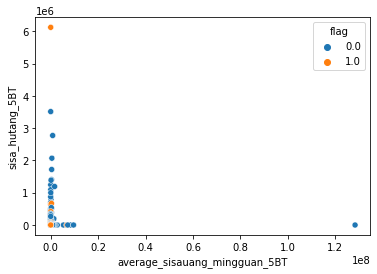

--------------------------------------------------
929
average_sisauang_mingguan_5BT sisa_hutang_6BT


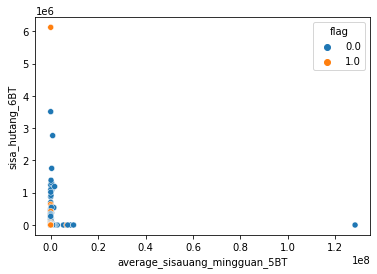

--------------------------------------------------
930
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_1BT


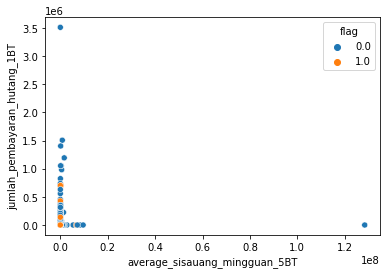

--------------------------------------------------
931
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_2BT


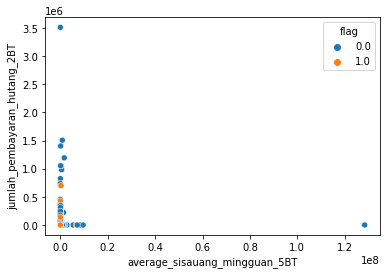

--------------------------------------------------
932
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_3BT


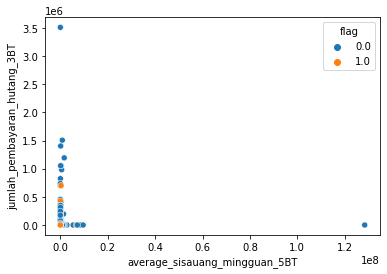

--------------------------------------------------
933
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_4BT


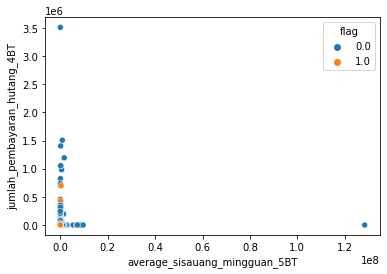

--------------------------------------------------
934
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_5BT


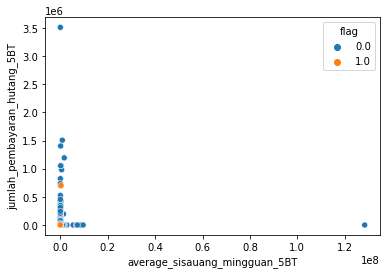

--------------------------------------------------
935
average_sisauang_mingguan_5BT jumlah_pembayaran_hutang_6BT


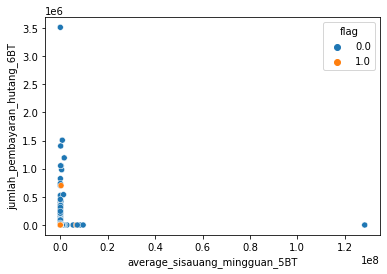

--------------------------------------------------
936
average_sisauang_mingguan_5BT jumlah_pengeluaran_1BT


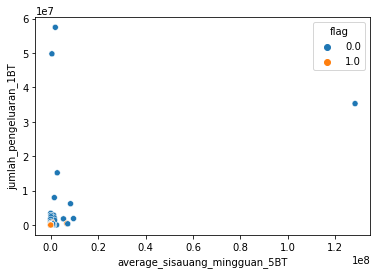

--------------------------------------------------
937
average_sisauang_mingguan_5BT jumlah_pengeluaran_2BT


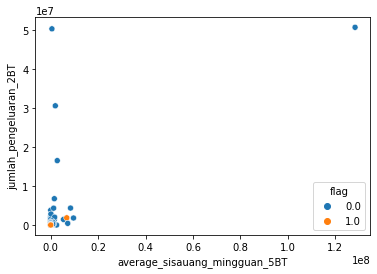

--------------------------------------------------
938
average_sisauang_mingguan_5BT jumlah_pengeluaran_3BT


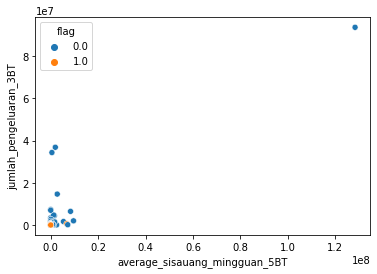

--------------------------------------------------
939
average_sisauang_mingguan_5BT jumlah_pengeluaran_4BT


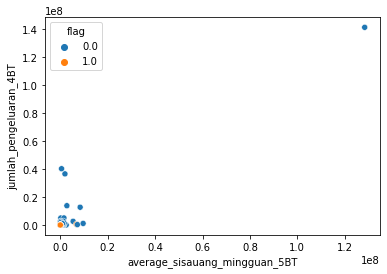

--------------------------------------------------
940
average_sisauang_mingguan_5BT jumlah_pengeluaran_5BT


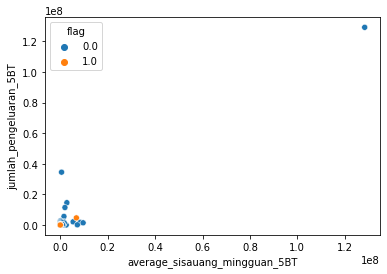

--------------------------------------------------
941
average_sisauang_mingguan_5BT jumlah_pengeluaran_6BT


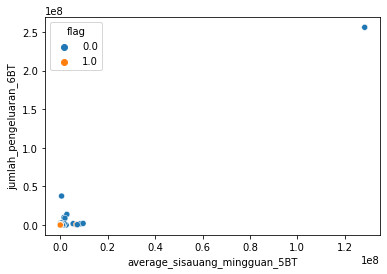

--------------------------------------------------
942
average_sisauang_mingguan_5BT jumlah_pemasukan_1BT


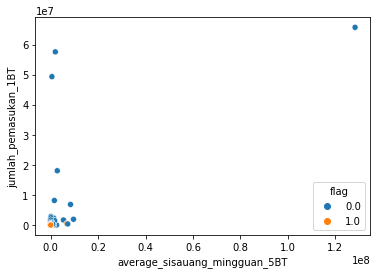

--------------------------------------------------
943
average_sisauang_mingguan_5BT jumlah_pemasukan_2BT


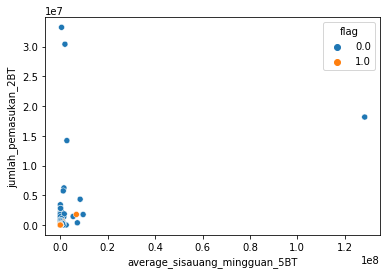

--------------------------------------------------
944
average_sisauang_mingguan_5BT jumlah_pemasukan_3BT


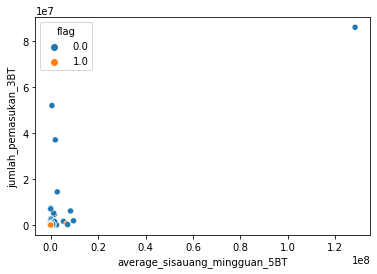

--------------------------------------------------
945
average_sisauang_mingguan_5BT jumlah_pemasukan_4BT


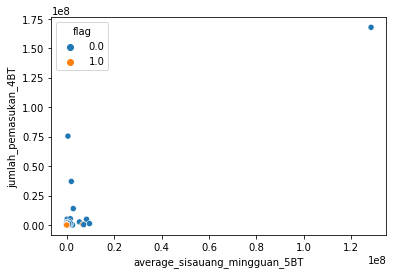

--------------------------------------------------
946
average_sisauang_mingguan_5BT jumlah_pemasukan_5BT


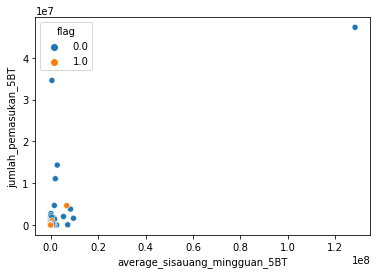

--------------------------------------------------
947
average_sisauang_mingguan_5BT jumlah_pemasukan_6BT


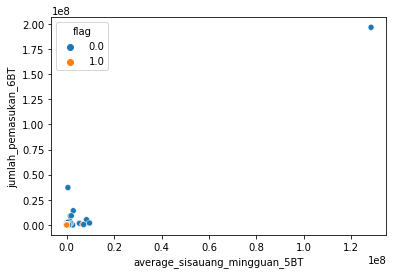

--------------------------------------------------
948
average_sisauang_mingguan_5BT frekuensi_pengeluaran_1BT


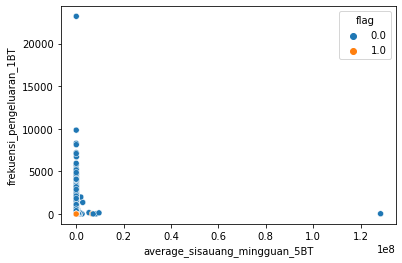

--------------------------------------------------
949
average_sisauang_mingguan_5BT frekuensi_pengeluaran_2BT


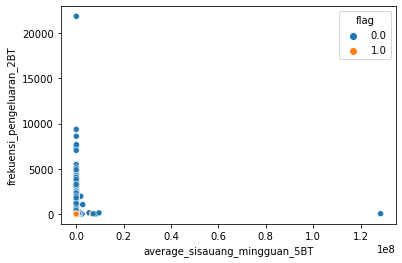

--------------------------------------------------
950
average_sisauang_mingguan_5BT frekuensi_pengeluaran_3BT


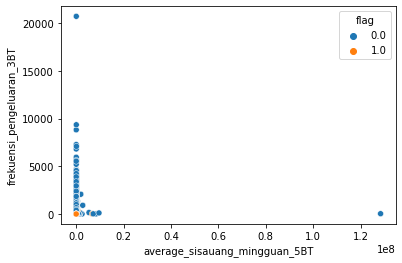

--------------------------------------------------
951
average_sisauang_mingguan_5BT frekuensi_pengeluaran_4BT


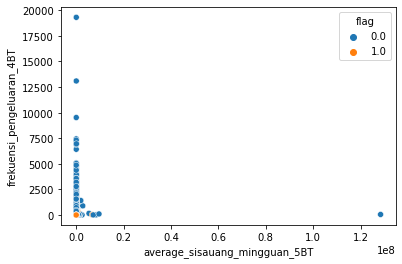

--------------------------------------------------
952
average_sisauang_mingguan_5BT frekuensi_pengeluaran_5BT


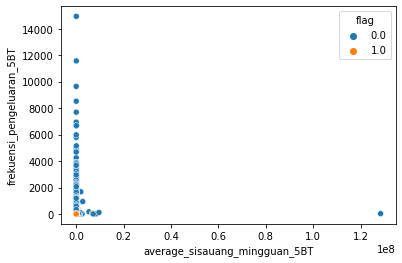

--------------------------------------------------
953
average_sisauang_mingguan_5BT frekuensi_pengeluaran_6BT


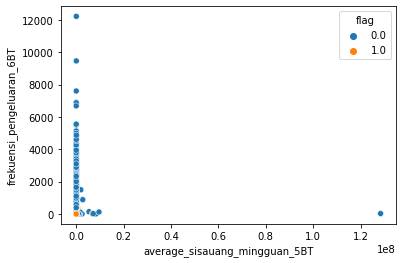

--------------------------------------------------
954
average_sisauang_mingguan_5BT frekuensi_pemasukan_1BT


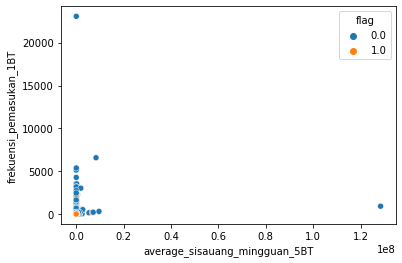

--------------------------------------------------
955
average_sisauang_mingguan_5BT frekuensi_pemasukan_2BT


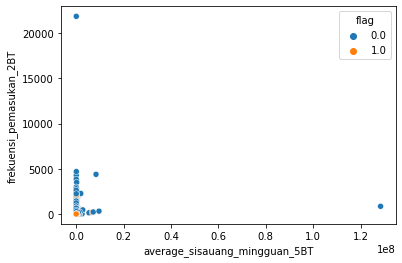

--------------------------------------------------
956
average_sisauang_mingguan_5BT frekuensi_pemasukan_3BT


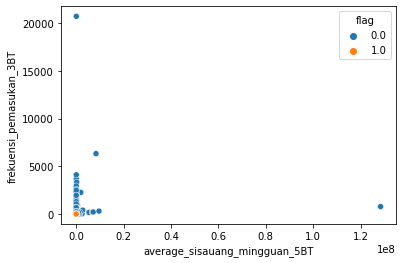

--------------------------------------------------
957
average_sisauang_mingguan_5BT frekuensi_pemasukan_4BT


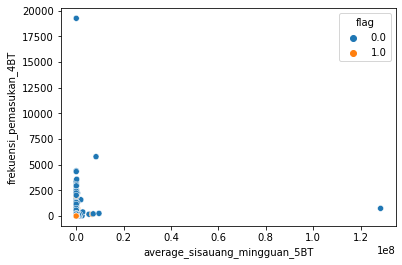

--------------------------------------------------
958
average_sisauang_mingguan_5BT frekuensi_pemasukan_5BT


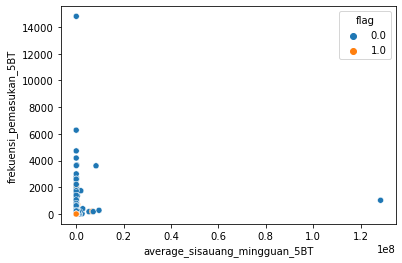

--------------------------------------------------
959
average_sisauang_mingguan_5BT frekuensi_pemasukan_6BT


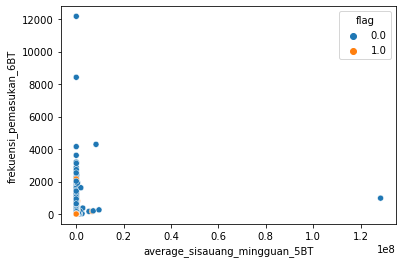

--------------------------------------------------
960
average_sisauang_mingguan_5BT flag


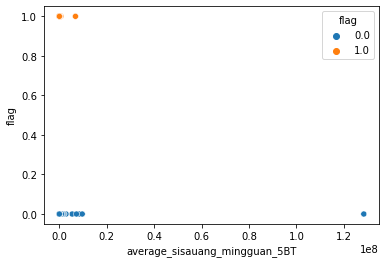

--------------------------------------------------
961
average_sisauang_mingguan_6BT average_sisauang_mingguan_6BT


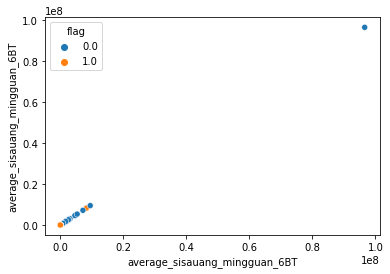

--------------------------------------------------
962
average_sisauang_mingguan_6BT sisauang_akhir_1BT


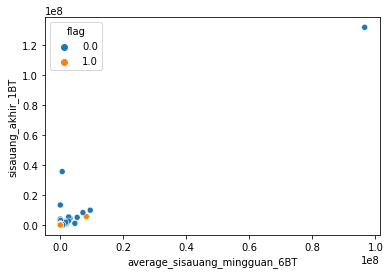

--------------------------------------------------
963
average_sisauang_mingguan_6BT sisauang_akhir_2BT


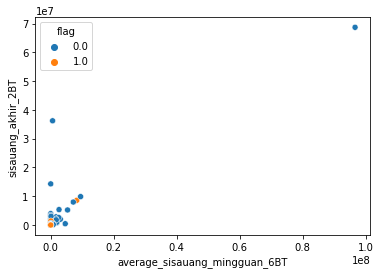

--------------------------------------------------
964
average_sisauang_mingguan_6BT sisauang_akhir_3BT


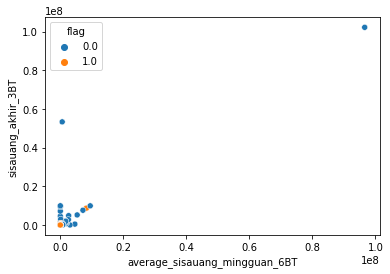

--------------------------------------------------
965
average_sisauang_mingguan_6BT sisauang_akhir_4BT


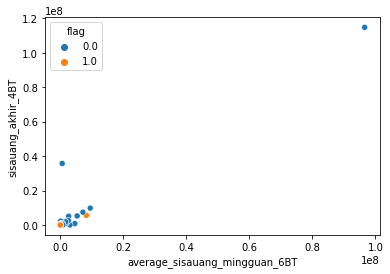

--------------------------------------------------
966
average_sisauang_mingguan_6BT sisauang_akhir_5BT


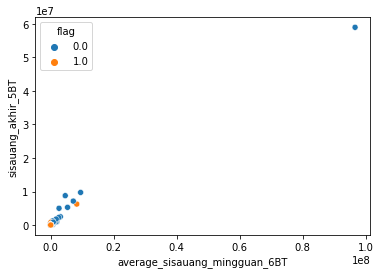

--------------------------------------------------
967
average_sisauang_mingguan_6BT sisauang_akhir_6BT


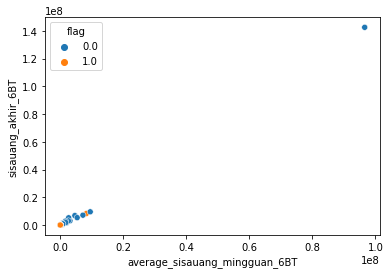

--------------------------------------------------
968
average_sisauang_mingguan_6BT sisauang_tertahan_1BT


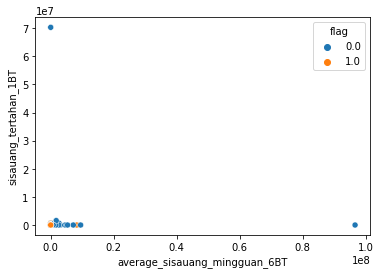

--------------------------------------------------
969
average_sisauang_mingguan_6BT sisauang_tertahan_2BT


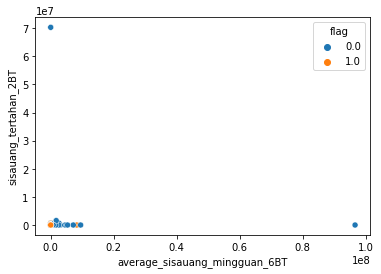

--------------------------------------------------
970
average_sisauang_mingguan_6BT sisauang_tertahan_3BT


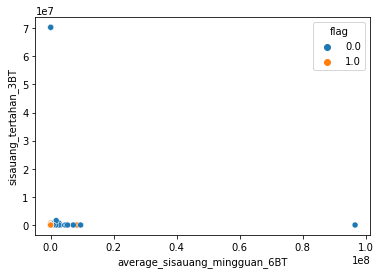

--------------------------------------------------
971
average_sisauang_mingguan_6BT sisauang_tertahan_4BT


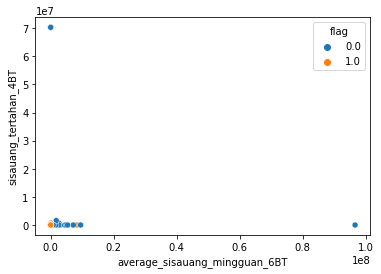

--------------------------------------------------
972
average_sisauang_mingguan_6BT sisauang_tertahan_5BT


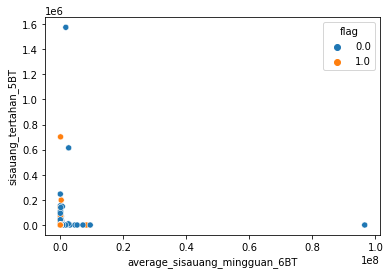

--------------------------------------------------
973
average_sisauang_mingguan_6BT sisauang_tertahan_6BT


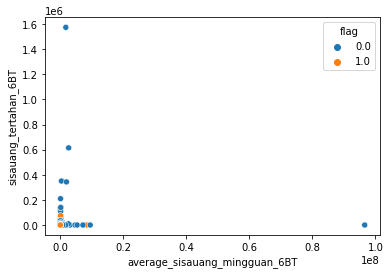

--------------------------------------------------
974
average_sisauang_mingguan_6BT sisauang_tersedia_1BT


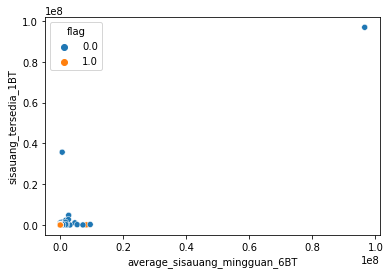

--------------------------------------------------
975
average_sisauang_mingguan_6BT sisauang_tersedia_2BT


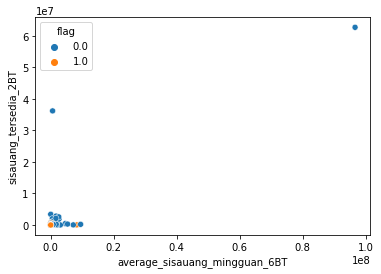

--------------------------------------------------
976
average_sisauang_mingguan_6BT sisauang_tersedia_3BT


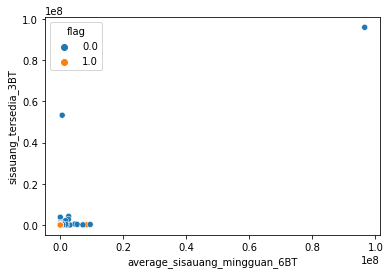

--------------------------------------------------
977
average_sisauang_mingguan_6BT sisauang_tersedia_4BT


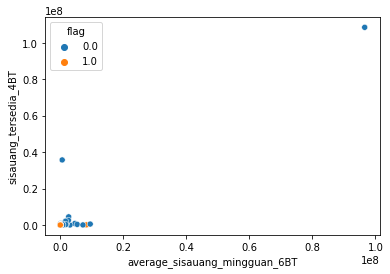

--------------------------------------------------
978
average_sisauang_mingguan_6BT sisauang_tersedia_5BT


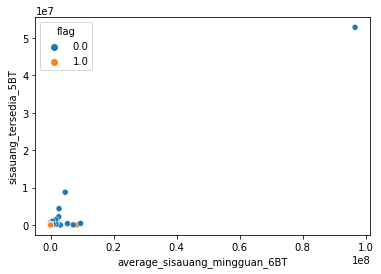

--------------------------------------------------
979
average_sisauang_mingguan_6BT sisauang_tersedia_6BT


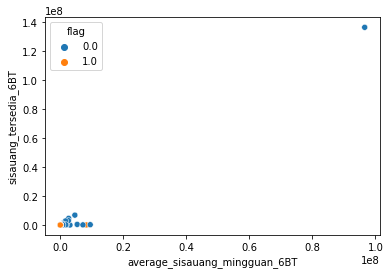

--------------------------------------------------
980
average_sisauang_mingguan_6BT sisa_hutang_1BT


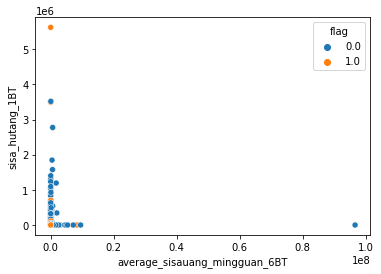

--------------------------------------------------
981
average_sisauang_mingguan_6BT sisa_hutang_2BT


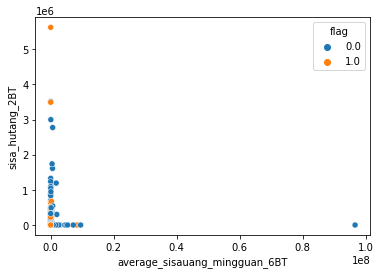

--------------------------------------------------
982
average_sisauang_mingguan_6BT sisa_hutang_3BT


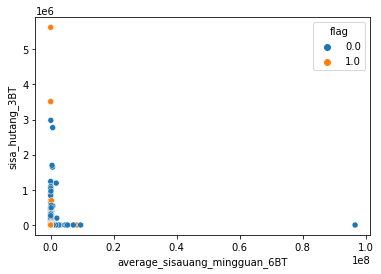

--------------------------------------------------
983
average_sisauang_mingguan_6BT sisa_hutang_4BT


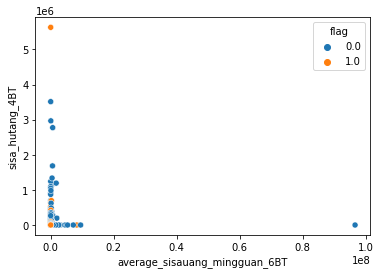

--------------------------------------------------
984
average_sisauang_mingguan_6BT sisa_hutang_5BT


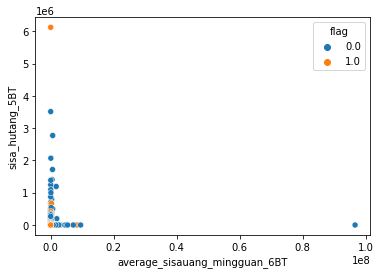

--------------------------------------------------
985
average_sisauang_mingguan_6BT sisa_hutang_6BT


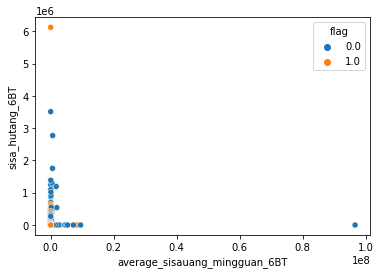

--------------------------------------------------
986
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_1BT


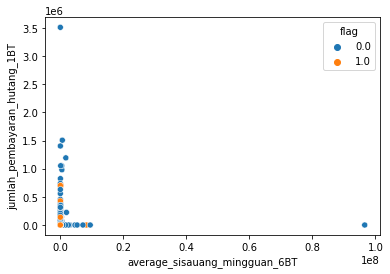

--------------------------------------------------
987
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_2BT


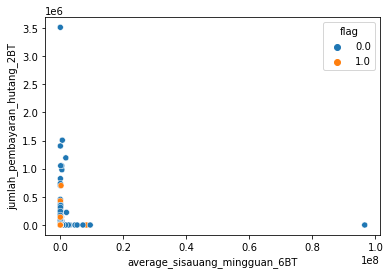

--------------------------------------------------
988
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_3BT


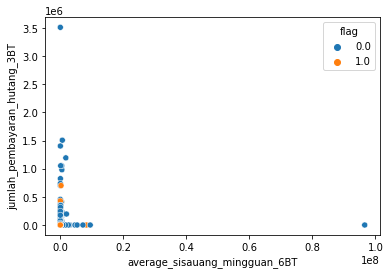

--------------------------------------------------
989
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_4BT


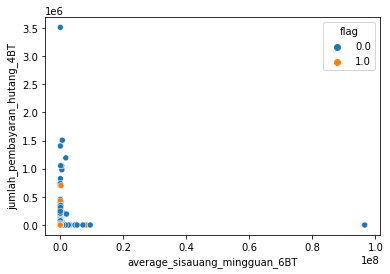

--------------------------------------------------
990
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_5BT


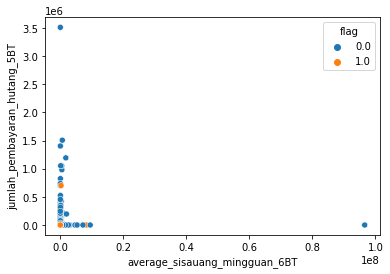

--------------------------------------------------
991
average_sisauang_mingguan_6BT jumlah_pembayaran_hutang_6BT


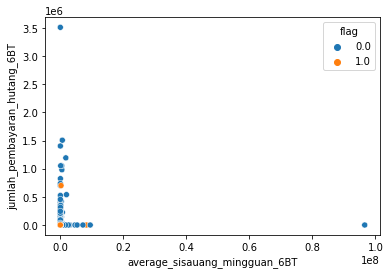

--------------------------------------------------
992
average_sisauang_mingguan_6BT jumlah_pengeluaran_1BT


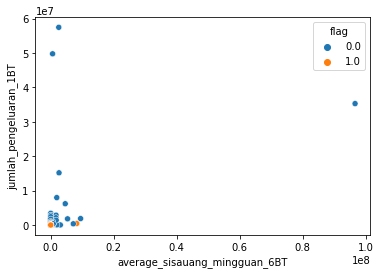

--------------------------------------------------
993
average_sisauang_mingguan_6BT jumlah_pengeluaran_2BT


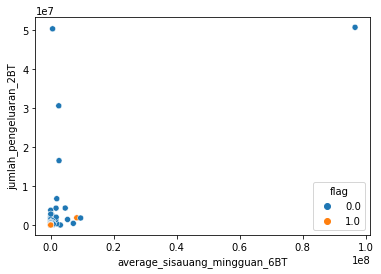

--------------------------------------------------
994
average_sisauang_mingguan_6BT jumlah_pengeluaran_3BT


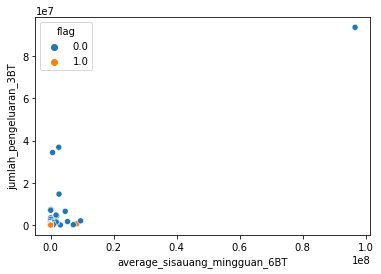

--------------------------------------------------
995
average_sisauang_mingguan_6BT jumlah_pengeluaran_4BT


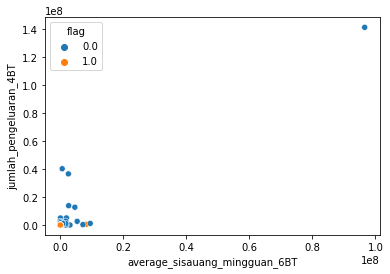

--------------------------------------------------
996
average_sisauang_mingguan_6BT jumlah_pengeluaran_5BT


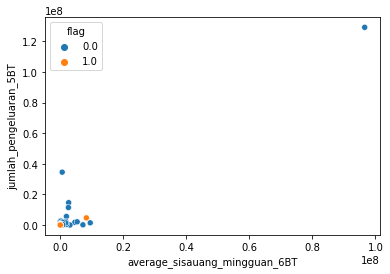

--------------------------------------------------
997
average_sisauang_mingguan_6BT jumlah_pengeluaran_6BT


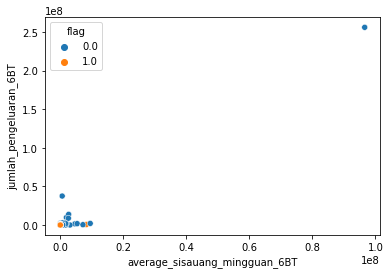

--------------------------------------------------
998
average_sisauang_mingguan_6BT jumlah_pemasukan_1BT


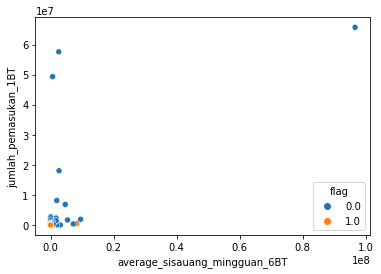

--------------------------------------------------
999
average_sisauang_mingguan_6BT jumlah_pemasukan_2BT


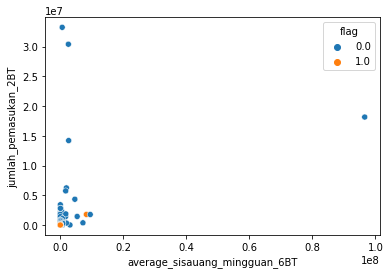

--------------------------------------------------
1000
average_sisauang_mingguan_6BT jumlah_pemasukan_3BT


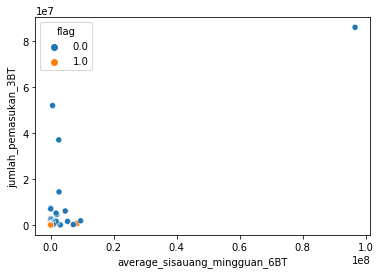

--------------------------------------------------
1001
average_sisauang_mingguan_6BT jumlah_pemasukan_4BT


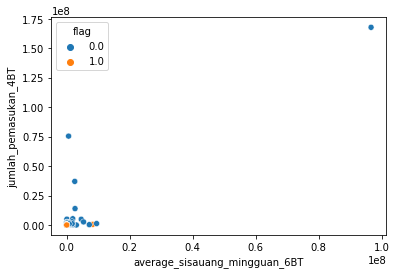

--------------------------------------------------
1002
average_sisauang_mingguan_6BT jumlah_pemasukan_5BT


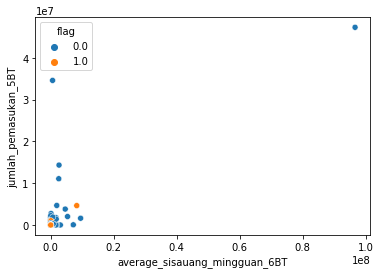

--------------------------------------------------
1003
average_sisauang_mingguan_6BT jumlah_pemasukan_6BT


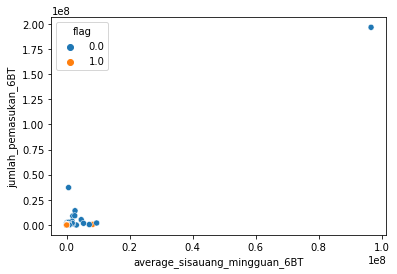

--------------------------------------------------
1004
average_sisauang_mingguan_6BT frekuensi_pengeluaran_1BT


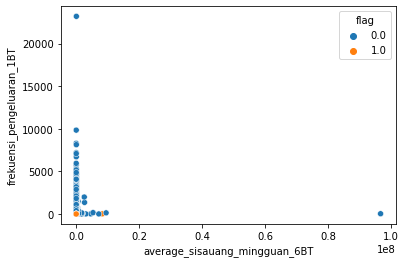

--------------------------------------------------
1005
average_sisauang_mingguan_6BT frekuensi_pengeluaran_2BT


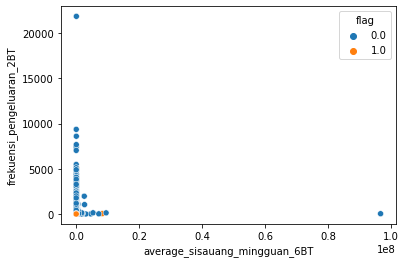

--------------------------------------------------
1006
average_sisauang_mingguan_6BT frekuensi_pengeluaran_3BT


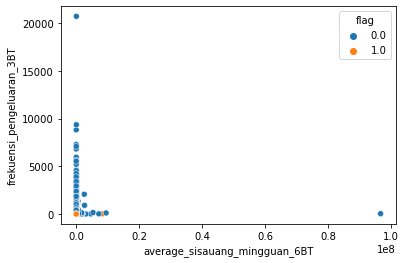

--------------------------------------------------
1007
average_sisauang_mingguan_6BT frekuensi_pengeluaran_4BT


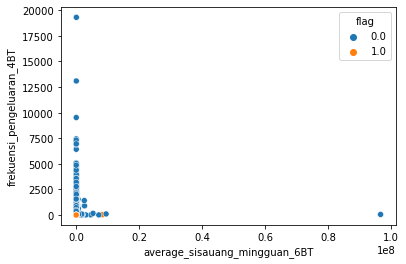

--------------------------------------------------
1008
average_sisauang_mingguan_6BT frekuensi_pengeluaran_5BT


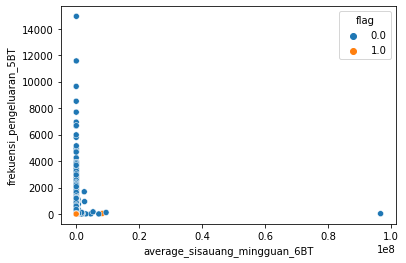

--------------------------------------------------
1009
average_sisauang_mingguan_6BT frekuensi_pengeluaran_6BT


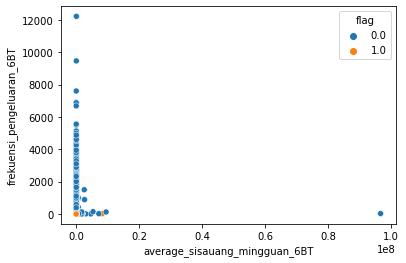

--------------------------------------------------
1010
average_sisauang_mingguan_6BT frekuensi_pemasukan_1BT


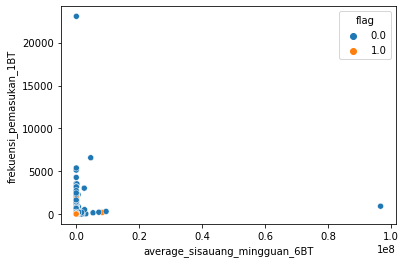

--------------------------------------------------
1011
average_sisauang_mingguan_6BT frekuensi_pemasukan_2BT


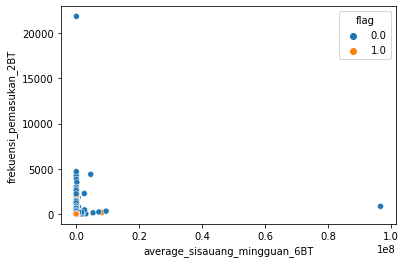

--------------------------------------------------
1012
average_sisauang_mingguan_6BT frekuensi_pemasukan_3BT


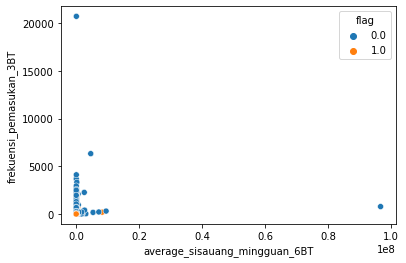

--------------------------------------------------
1013
average_sisauang_mingguan_6BT frekuensi_pemasukan_4BT


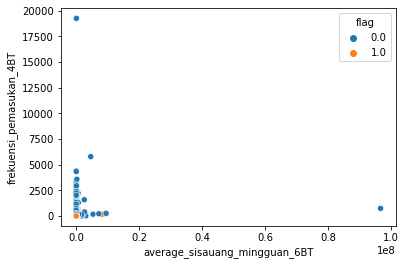

--------------------------------------------------
1014
average_sisauang_mingguan_6BT frekuensi_pemasukan_5BT


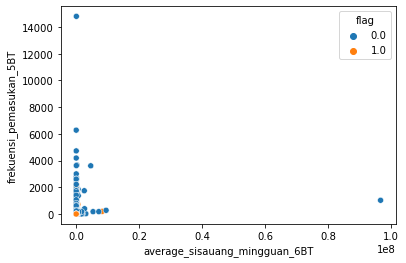

--------------------------------------------------
1015
average_sisauang_mingguan_6BT frekuensi_pemasukan_6BT


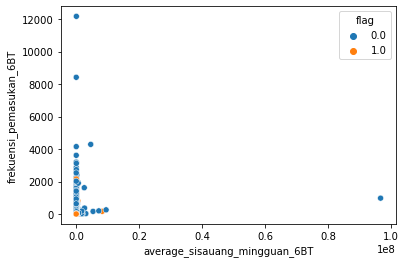

--------------------------------------------------
1016
average_sisauang_mingguan_6BT flag


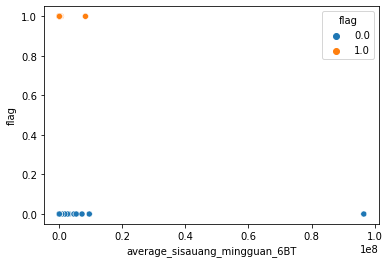

--------------------------------------------------
1017
sisauang_akhir_1BT sisauang_akhir_1BT


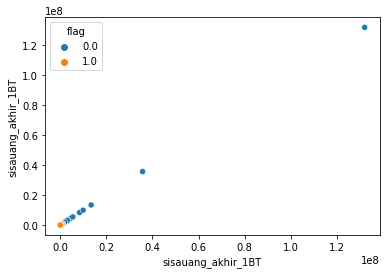

--------------------------------------------------
1018
sisauang_akhir_1BT sisauang_akhir_2BT


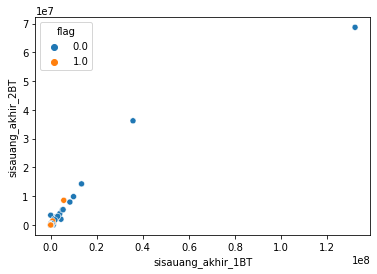

--------------------------------------------------
1019
sisauang_akhir_1BT sisauang_akhir_3BT


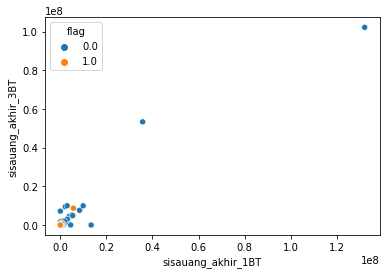

--------------------------------------------------
1020
sisauang_akhir_1BT sisauang_akhir_4BT


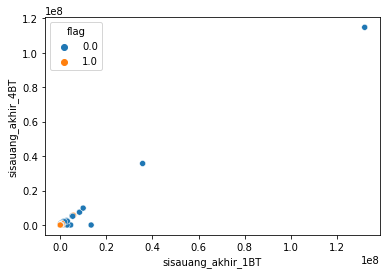

--------------------------------------------------
1021
sisauang_akhir_1BT sisauang_akhir_5BT


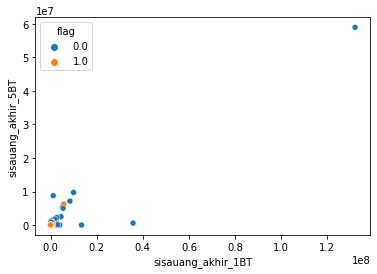

--------------------------------------------------
1022
sisauang_akhir_1BT sisauang_akhir_6BT


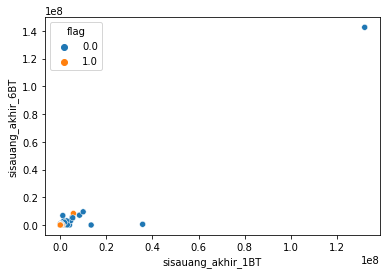

--------------------------------------------------
1023
sisauang_akhir_1BT sisauang_tertahan_1BT


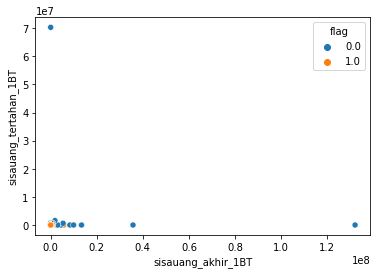

--------------------------------------------------
1024
sisauang_akhir_1BT sisauang_tertahan_2BT


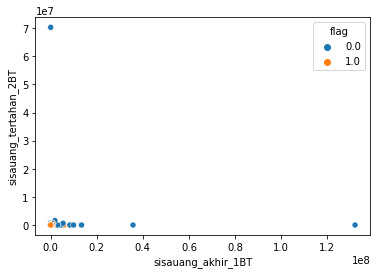

--------------------------------------------------
1025
sisauang_akhir_1BT sisauang_tertahan_3BT


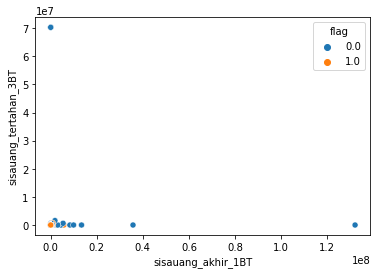

--------------------------------------------------
1026
sisauang_akhir_1BT sisauang_tertahan_4BT


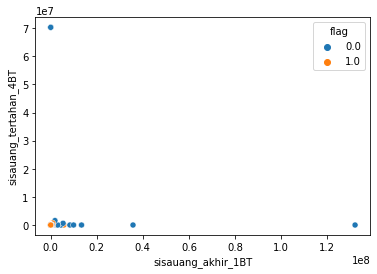

--------------------------------------------------
1027
sisauang_akhir_1BT sisauang_tertahan_5BT


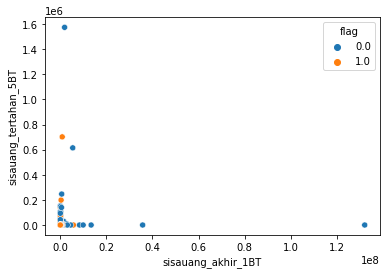

--------------------------------------------------
1028
sisauang_akhir_1BT sisauang_tertahan_6BT


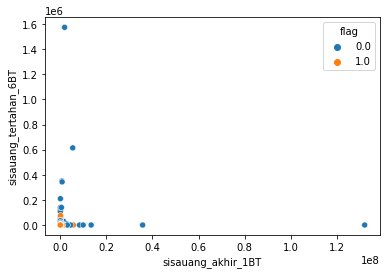

--------------------------------------------------
1029
sisauang_akhir_1BT sisauang_tersedia_1BT


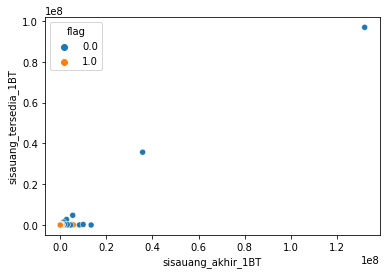

--------------------------------------------------
1030
sisauang_akhir_1BT sisauang_tersedia_2BT


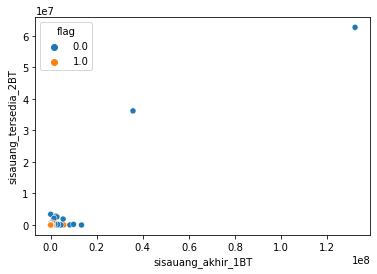

--------------------------------------------------
1031
sisauang_akhir_1BT sisauang_tersedia_3BT


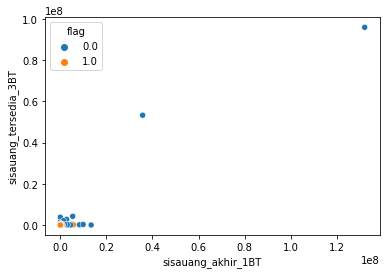

--------------------------------------------------
1032
sisauang_akhir_1BT sisauang_tersedia_4BT


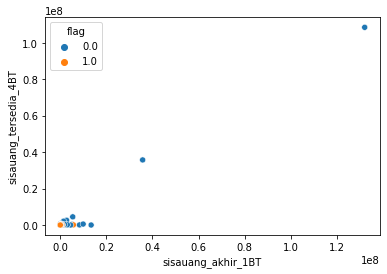

--------------------------------------------------
1033
sisauang_akhir_1BT sisauang_tersedia_5BT


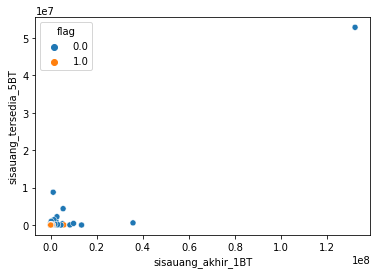

--------------------------------------------------
1034
sisauang_akhir_1BT sisauang_tersedia_6BT


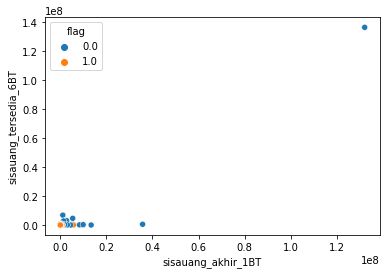

--------------------------------------------------
1035
sisauang_akhir_1BT sisa_hutang_1BT


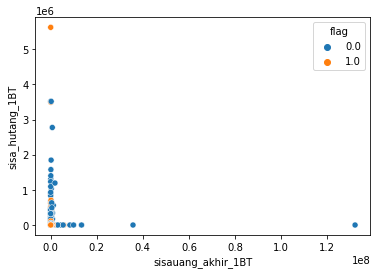

--------------------------------------------------
1036
sisauang_akhir_1BT sisa_hutang_2BT


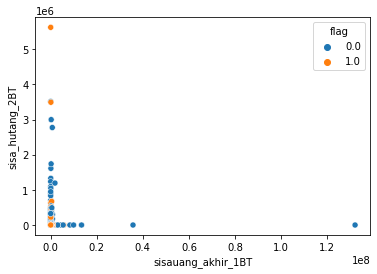

--------------------------------------------------
1037
sisauang_akhir_1BT sisa_hutang_3BT


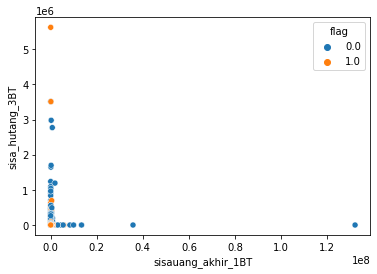

--------------------------------------------------
1038
sisauang_akhir_1BT sisa_hutang_4BT


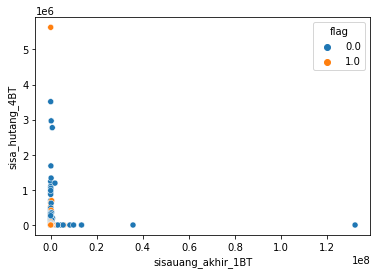

--------------------------------------------------
1039
sisauang_akhir_1BT sisa_hutang_5BT


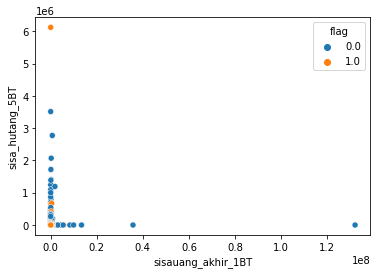

--------------------------------------------------
1040
sisauang_akhir_1BT sisa_hutang_6BT


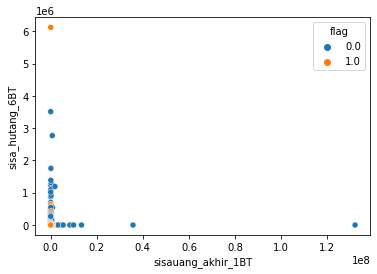

--------------------------------------------------
1041
sisauang_akhir_1BT jumlah_pembayaran_hutang_1BT


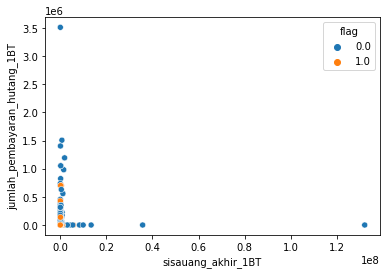

--------------------------------------------------
1042
sisauang_akhir_1BT jumlah_pembayaran_hutang_2BT


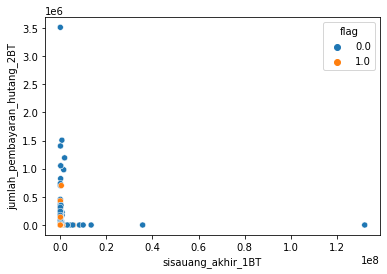

--------------------------------------------------
1043
sisauang_akhir_1BT jumlah_pembayaran_hutang_3BT


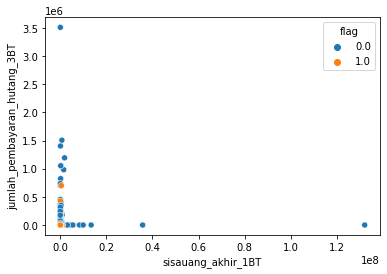

--------------------------------------------------
1044
sisauang_akhir_1BT jumlah_pembayaran_hutang_4BT


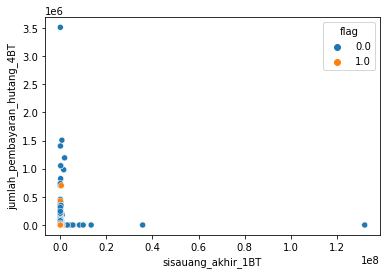

--------------------------------------------------
1045
sisauang_akhir_1BT jumlah_pembayaran_hutang_5BT


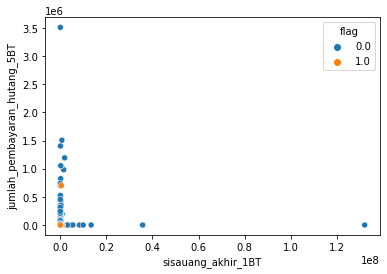

--------------------------------------------------
1046
sisauang_akhir_1BT jumlah_pembayaran_hutang_6BT


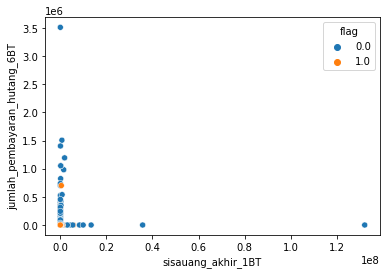

--------------------------------------------------
1047
sisauang_akhir_1BT jumlah_pengeluaran_1BT


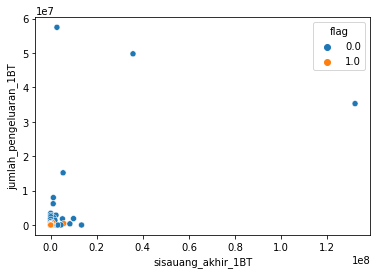

--------------------------------------------------
1048
sisauang_akhir_1BT jumlah_pengeluaran_2BT


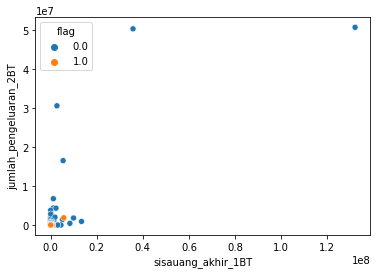

--------------------------------------------------
1049
sisauang_akhir_1BT jumlah_pengeluaran_3BT


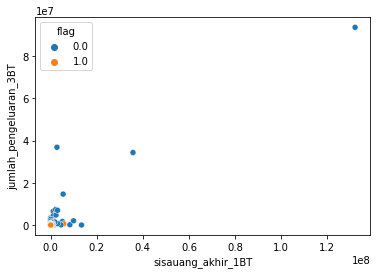

--------------------------------------------------
1050
sisauang_akhir_1BT jumlah_pengeluaran_4BT


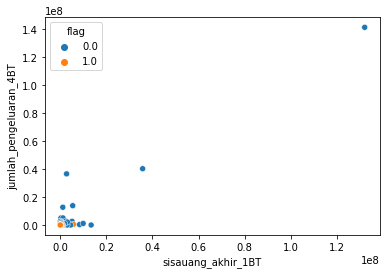

--------------------------------------------------
1051
sisauang_akhir_1BT jumlah_pengeluaran_5BT


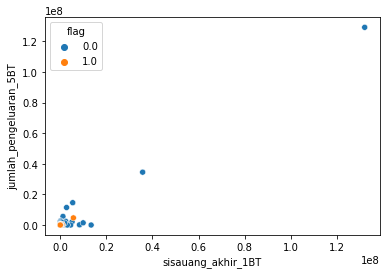

--------------------------------------------------
1052
sisauang_akhir_1BT jumlah_pengeluaran_6BT


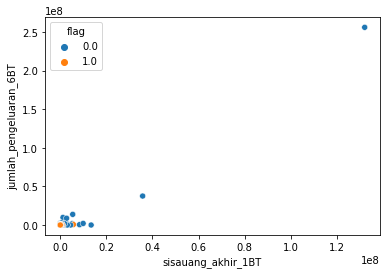

--------------------------------------------------
1053
sisauang_akhir_1BT jumlah_pemasukan_1BT


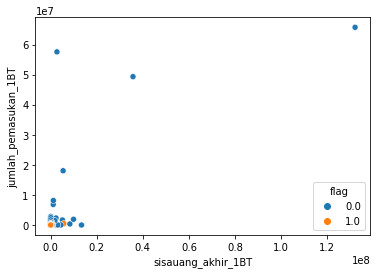

--------------------------------------------------
1054
sisauang_akhir_1BT jumlah_pemasukan_2BT


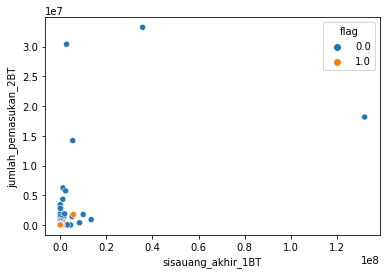

--------------------------------------------------
1055
sisauang_akhir_1BT jumlah_pemasukan_3BT


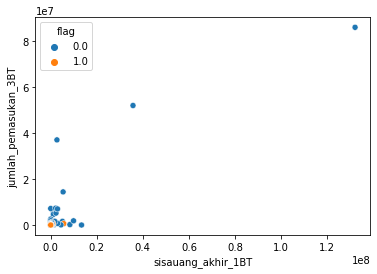

--------------------------------------------------
1056
sisauang_akhir_1BT jumlah_pemasukan_4BT


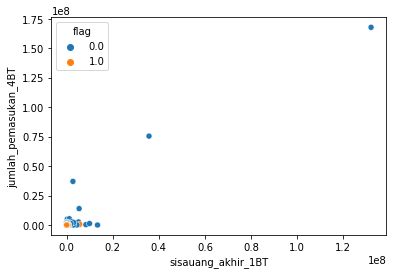

--------------------------------------------------
1057
sisauang_akhir_1BT jumlah_pemasukan_5BT


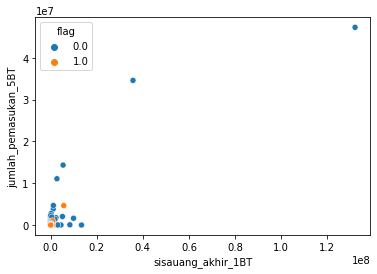

--------------------------------------------------
1058
sisauang_akhir_1BT jumlah_pemasukan_6BT


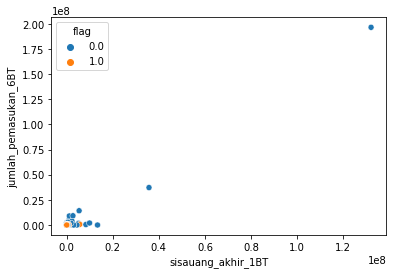

--------------------------------------------------
1059
sisauang_akhir_1BT frekuensi_pengeluaran_1BT


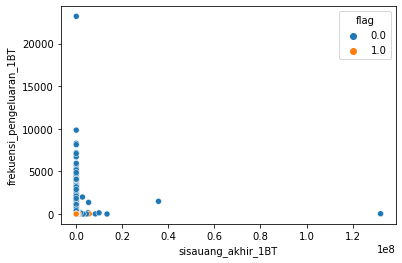

--------------------------------------------------
1060
sisauang_akhir_1BT frekuensi_pengeluaran_2BT


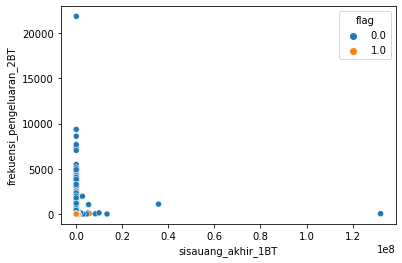

--------------------------------------------------
1061
sisauang_akhir_1BT frekuensi_pengeluaran_3BT


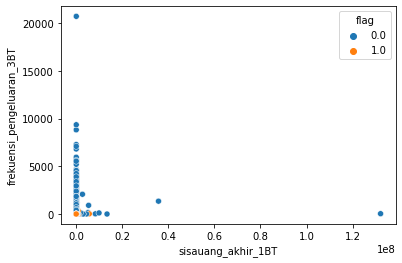

--------------------------------------------------
1062
sisauang_akhir_1BT frekuensi_pengeluaran_4BT


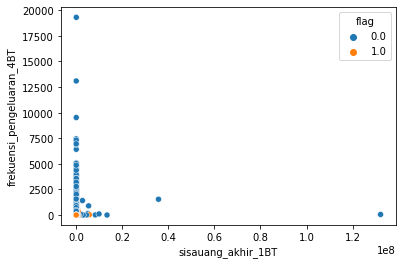

--------------------------------------------------
1063
sisauang_akhir_1BT frekuensi_pengeluaran_5BT


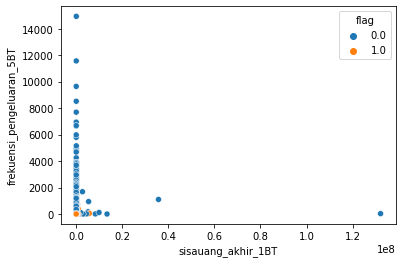

--------------------------------------------------
1064
sisauang_akhir_1BT frekuensi_pengeluaran_6BT


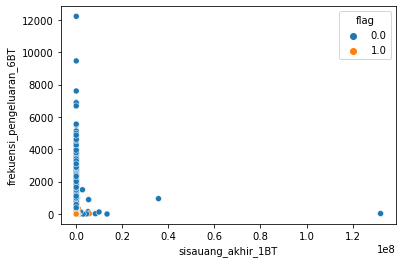

--------------------------------------------------
1065
sisauang_akhir_1BT frekuensi_pemasukan_1BT


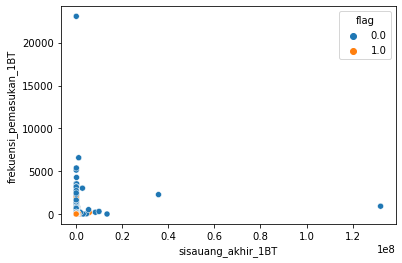

--------------------------------------------------
1066
sisauang_akhir_1BT frekuensi_pemasukan_2BT


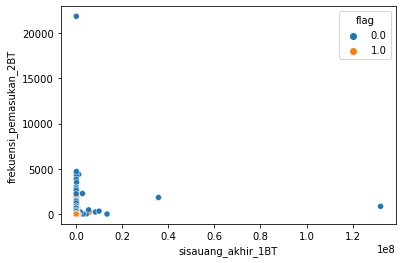

--------------------------------------------------
1067
sisauang_akhir_1BT frekuensi_pemasukan_3BT


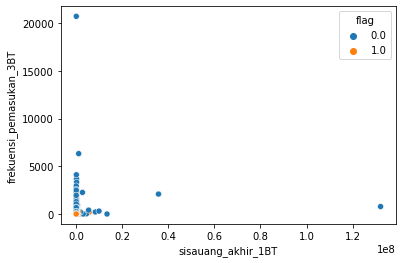

--------------------------------------------------
1068
sisauang_akhir_1BT frekuensi_pemasukan_4BT


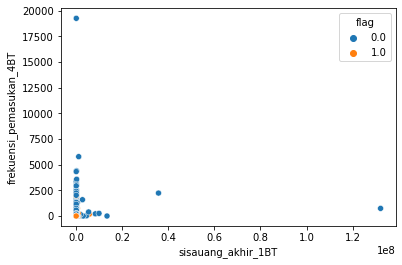

--------------------------------------------------
1069
sisauang_akhir_1BT frekuensi_pemasukan_5BT


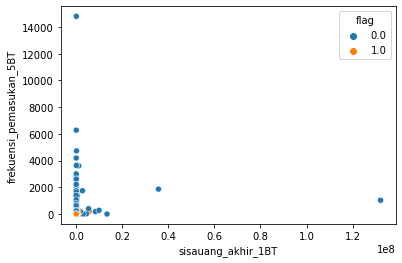

--------------------------------------------------
1070
sisauang_akhir_1BT frekuensi_pemasukan_6BT


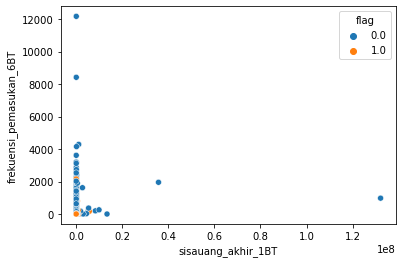

--------------------------------------------------
1071
sisauang_akhir_1BT flag


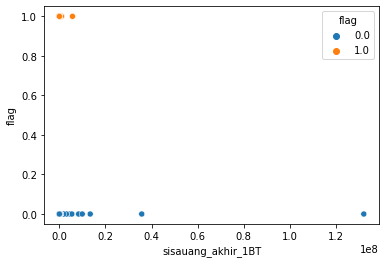

--------------------------------------------------
1072
sisauang_akhir_2BT sisauang_akhir_2BT


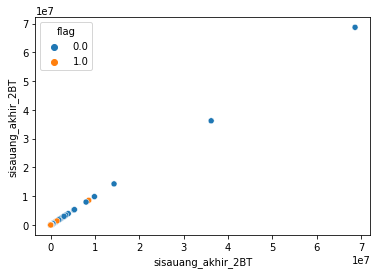

--------------------------------------------------
1073
sisauang_akhir_2BT sisauang_akhir_3BT


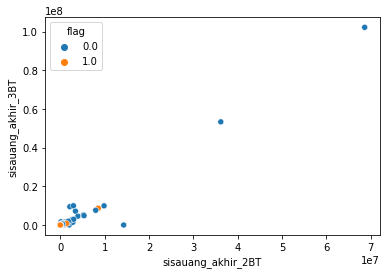

--------------------------------------------------
1074
sisauang_akhir_2BT sisauang_akhir_4BT


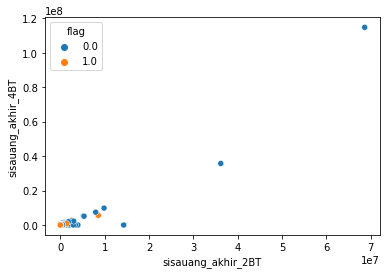

--------------------------------------------------
1075
sisauang_akhir_2BT sisauang_akhir_5BT


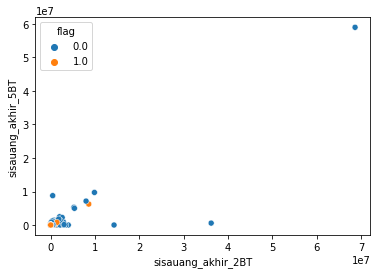

--------------------------------------------------
1076
sisauang_akhir_2BT sisauang_akhir_6BT


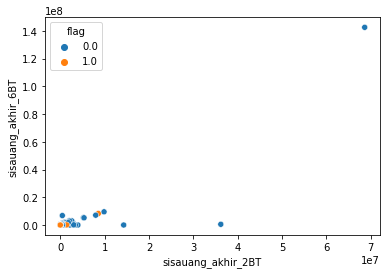

--------------------------------------------------
1077
sisauang_akhir_2BT sisauang_tertahan_1BT


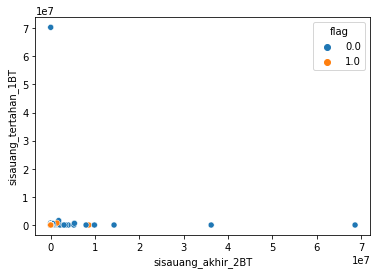

--------------------------------------------------
1078
sisauang_akhir_2BT sisauang_tertahan_2BT


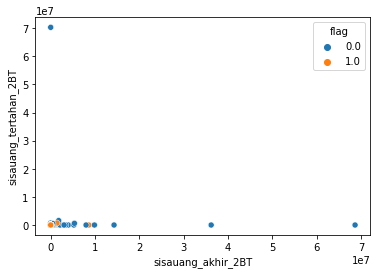

--------------------------------------------------
1079
sisauang_akhir_2BT sisauang_tertahan_3BT


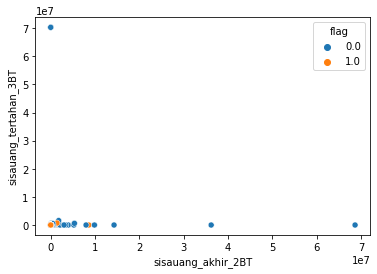

--------------------------------------------------
1080
sisauang_akhir_2BT sisauang_tertahan_4BT


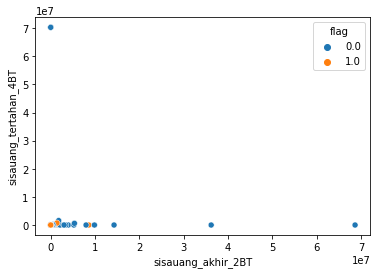

--------------------------------------------------
1081
sisauang_akhir_2BT sisauang_tertahan_5BT


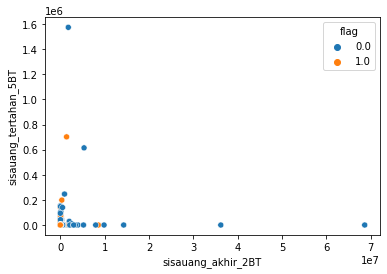

--------------------------------------------------
1082
sisauang_akhir_2BT sisauang_tertahan_6BT


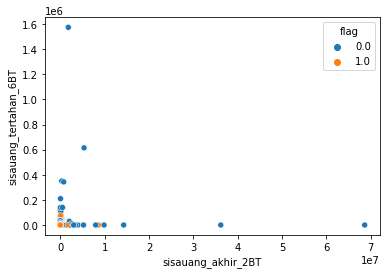

--------------------------------------------------
1083
sisauang_akhir_2BT sisauang_tersedia_1BT


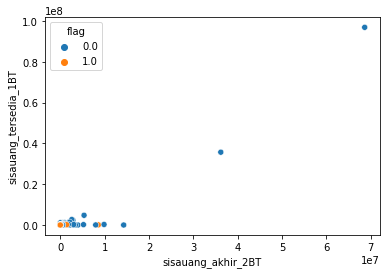

--------------------------------------------------
1084
sisauang_akhir_2BT sisauang_tersedia_2BT


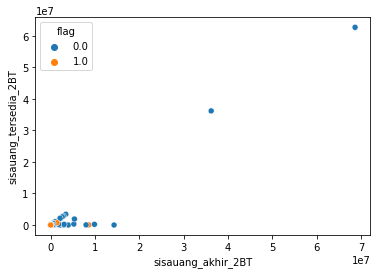

--------------------------------------------------
1085
sisauang_akhir_2BT sisauang_tersedia_3BT


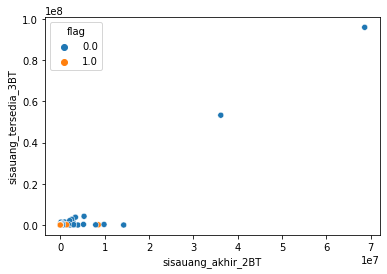

--------------------------------------------------
1086
sisauang_akhir_2BT sisauang_tersedia_4BT


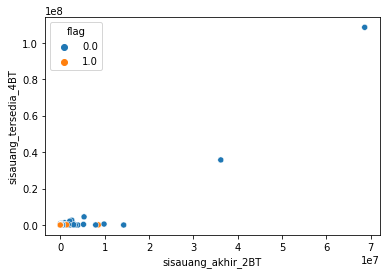

--------------------------------------------------
1087
sisauang_akhir_2BT sisauang_tersedia_5BT


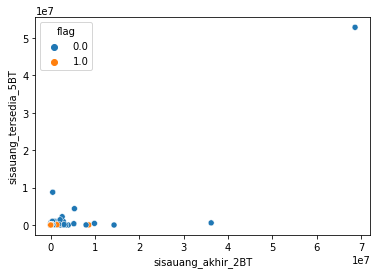

--------------------------------------------------
1088
sisauang_akhir_2BT sisauang_tersedia_6BT


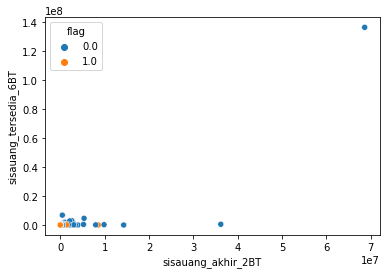

--------------------------------------------------
1089
sisauang_akhir_2BT sisa_hutang_1BT


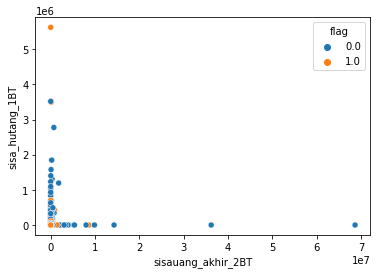

--------------------------------------------------
1090
sisauang_akhir_2BT sisa_hutang_2BT


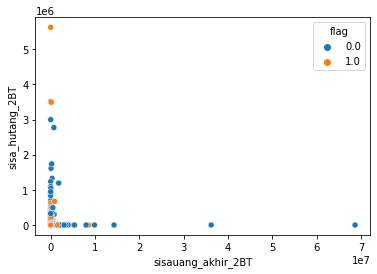

--------------------------------------------------
1091
sisauang_akhir_2BT sisa_hutang_3BT


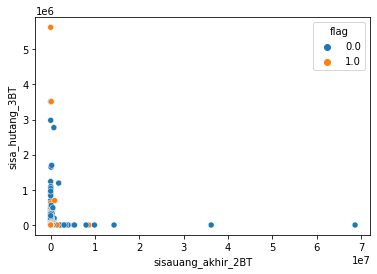

--------------------------------------------------
1092
sisauang_akhir_2BT sisa_hutang_4BT


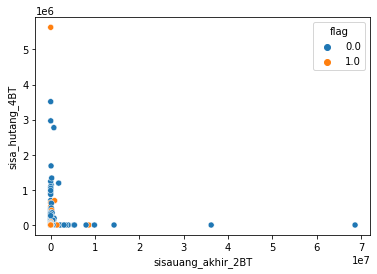

--------------------------------------------------
1093
sisauang_akhir_2BT sisa_hutang_5BT


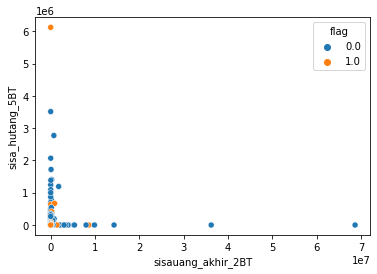

--------------------------------------------------
1094
sisauang_akhir_2BT sisa_hutang_6BT


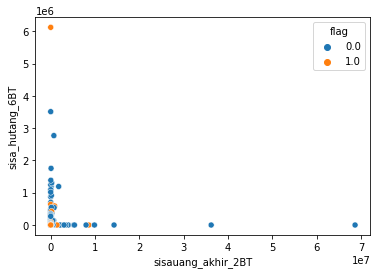

--------------------------------------------------
1095
sisauang_akhir_2BT jumlah_pembayaran_hutang_1BT


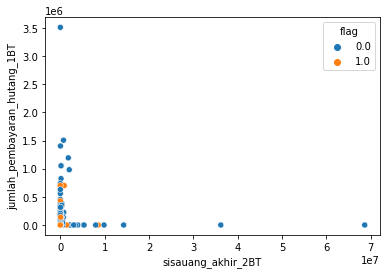

--------------------------------------------------
1096
sisauang_akhir_2BT jumlah_pembayaran_hutang_2BT


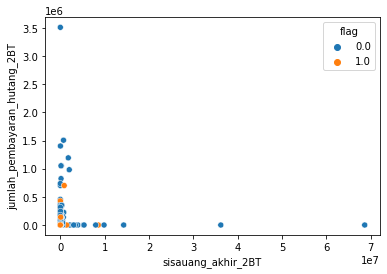

--------------------------------------------------
1097
sisauang_akhir_2BT jumlah_pembayaran_hutang_3BT


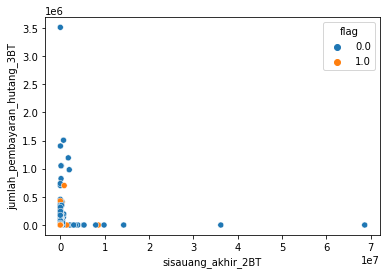

--------------------------------------------------
1098
sisauang_akhir_2BT jumlah_pembayaran_hutang_4BT


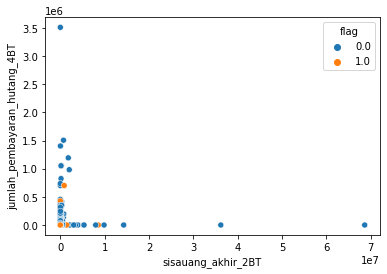

--------------------------------------------------
1099
sisauang_akhir_2BT jumlah_pembayaran_hutang_5BT


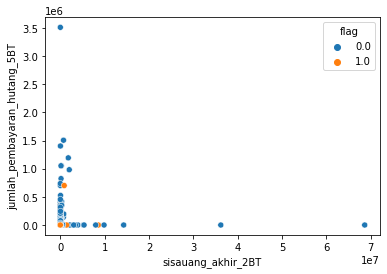

--------------------------------------------------
1100
sisauang_akhir_2BT jumlah_pembayaran_hutang_6BT


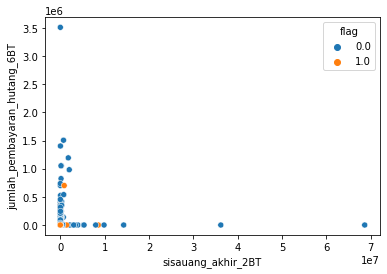

--------------------------------------------------
1101
sisauang_akhir_2BT jumlah_pengeluaran_1BT


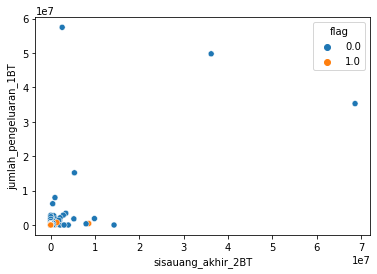

--------------------------------------------------
1102
sisauang_akhir_2BT jumlah_pengeluaran_2BT


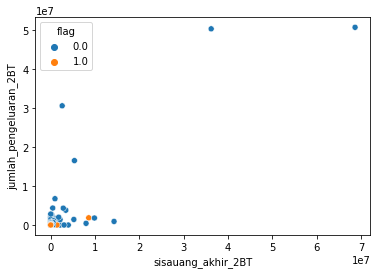

--------------------------------------------------
1103
sisauang_akhir_2BT jumlah_pengeluaran_3BT


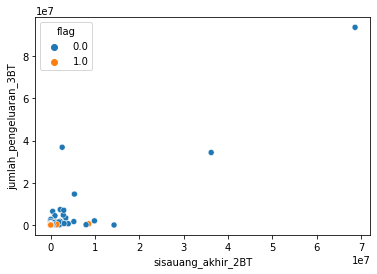

--------------------------------------------------
1104
sisauang_akhir_2BT jumlah_pengeluaran_4BT


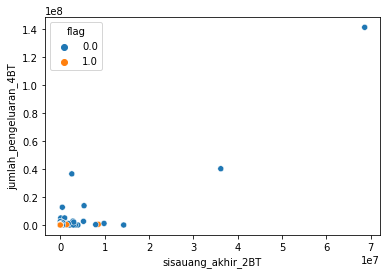

--------------------------------------------------
1105
sisauang_akhir_2BT jumlah_pengeluaran_5BT


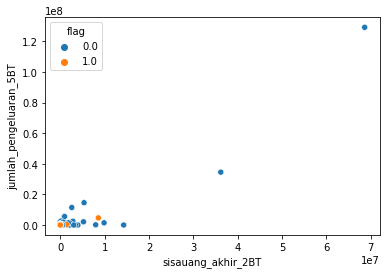

--------------------------------------------------
1106
sisauang_akhir_2BT jumlah_pengeluaran_6BT


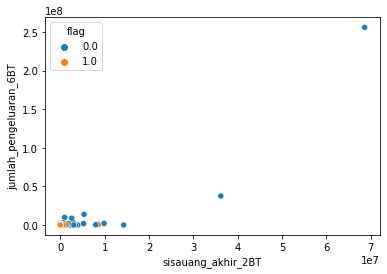

--------------------------------------------------
1107
sisauang_akhir_2BT jumlah_pemasukan_1BT


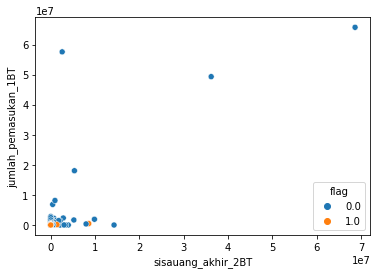

--------------------------------------------------
1108
sisauang_akhir_2BT jumlah_pemasukan_2BT


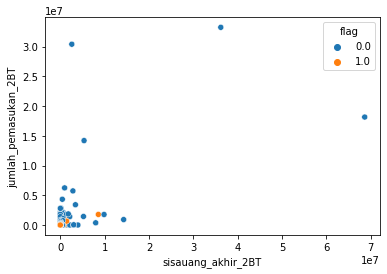

--------------------------------------------------
1109
sisauang_akhir_2BT jumlah_pemasukan_3BT


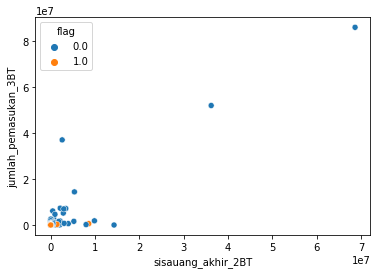

--------------------------------------------------
1110
sisauang_akhir_2BT jumlah_pemasukan_4BT


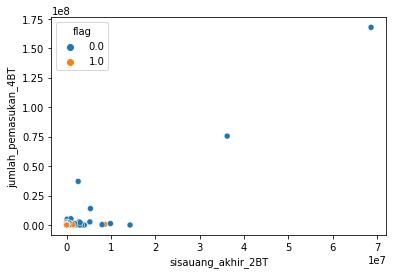

--------------------------------------------------
1111
sisauang_akhir_2BT jumlah_pemasukan_5BT


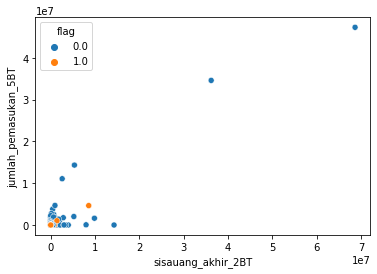

--------------------------------------------------
1112
sisauang_akhir_2BT jumlah_pemasukan_6BT


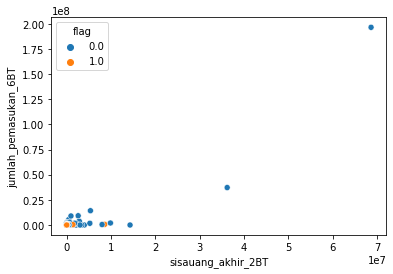

--------------------------------------------------
1113
sisauang_akhir_2BT frekuensi_pengeluaran_1BT


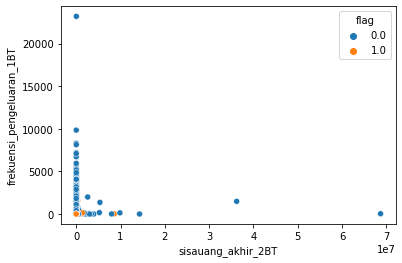

--------------------------------------------------
1114
sisauang_akhir_2BT frekuensi_pengeluaran_2BT


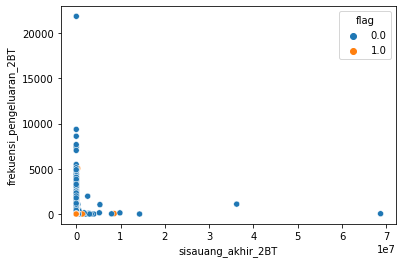

--------------------------------------------------
1115
sisauang_akhir_2BT frekuensi_pengeluaran_3BT


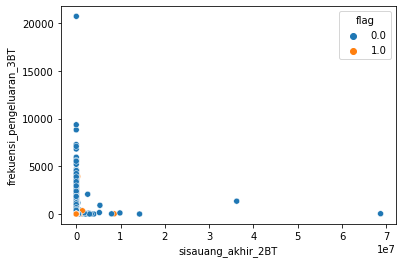

--------------------------------------------------
1116
sisauang_akhir_2BT frekuensi_pengeluaran_4BT


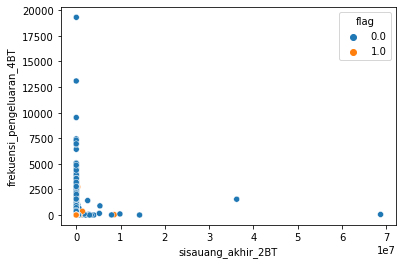

--------------------------------------------------
1117
sisauang_akhir_2BT frekuensi_pengeluaran_5BT


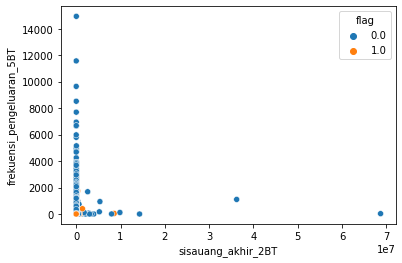

--------------------------------------------------
1118
sisauang_akhir_2BT frekuensi_pengeluaran_6BT


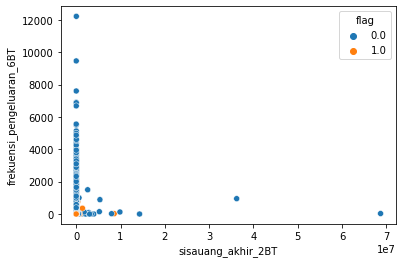

--------------------------------------------------
1119
sisauang_akhir_2BT frekuensi_pemasukan_1BT


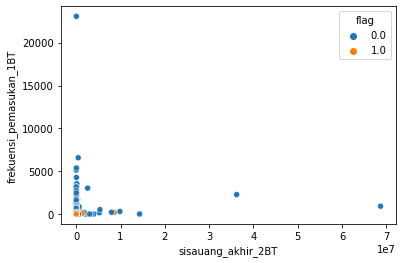

--------------------------------------------------
1120
sisauang_akhir_2BT frekuensi_pemasukan_2BT


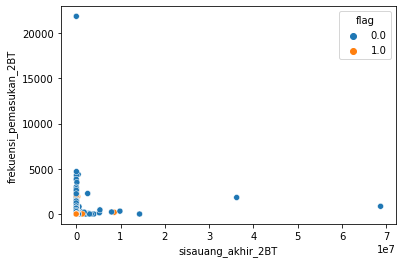

--------------------------------------------------
1121
sisauang_akhir_2BT frekuensi_pemasukan_3BT


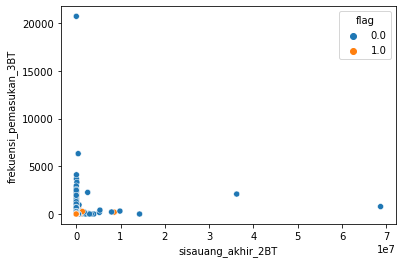

--------------------------------------------------
1122
sisauang_akhir_2BT frekuensi_pemasukan_4BT


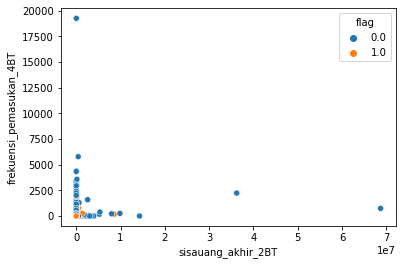

--------------------------------------------------
1123
sisauang_akhir_2BT frekuensi_pemasukan_5BT


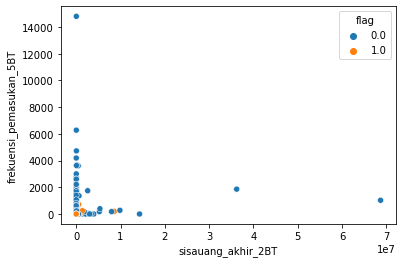

--------------------------------------------------
1124
sisauang_akhir_2BT frekuensi_pemasukan_6BT


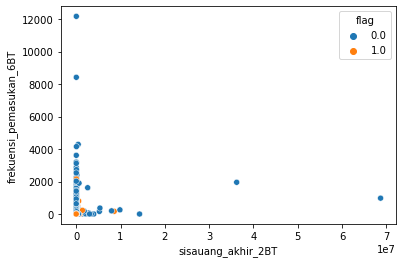

--------------------------------------------------
1125
sisauang_akhir_2BT flag


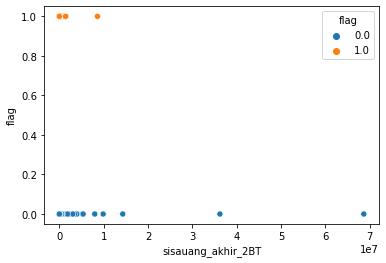

--------------------------------------------------
1126
sisauang_akhir_3BT sisauang_akhir_3BT


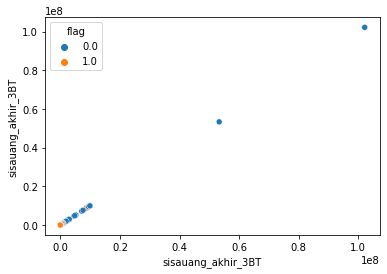

--------------------------------------------------
1127
sisauang_akhir_3BT sisauang_akhir_4BT


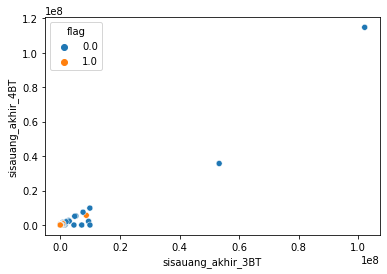

--------------------------------------------------
1128
sisauang_akhir_3BT sisauang_akhir_5BT


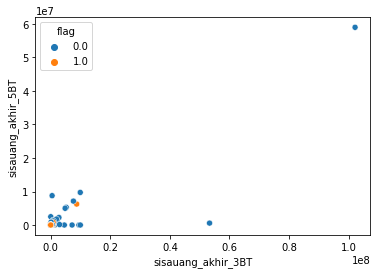

--------------------------------------------------
1129
sisauang_akhir_3BT sisauang_akhir_6BT


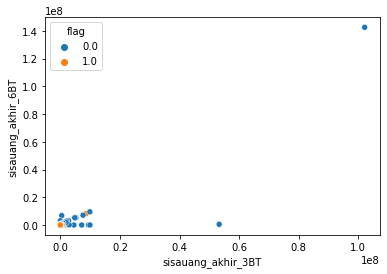

--------------------------------------------------
1130
sisauang_akhir_3BT sisauang_tertahan_1BT


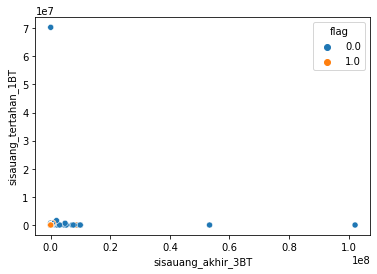

--------------------------------------------------
1131
sisauang_akhir_3BT sisauang_tertahan_2BT


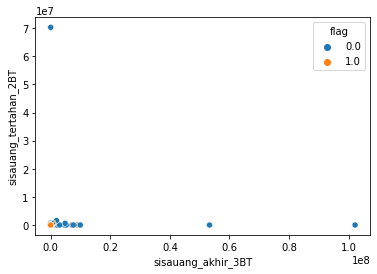

--------------------------------------------------
1132
sisauang_akhir_3BT sisauang_tertahan_3BT


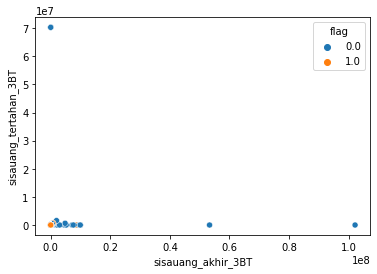

--------------------------------------------------
1133
sisauang_akhir_3BT sisauang_tertahan_4BT


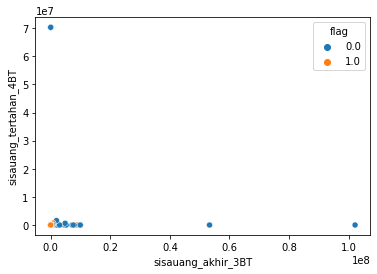

--------------------------------------------------
1134
sisauang_akhir_3BT sisauang_tertahan_5BT


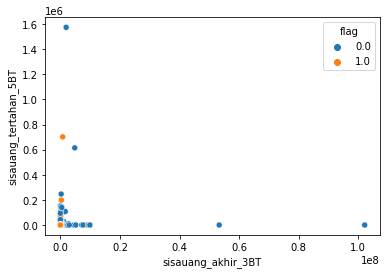

--------------------------------------------------
1135
sisauang_akhir_3BT sisauang_tertahan_6BT


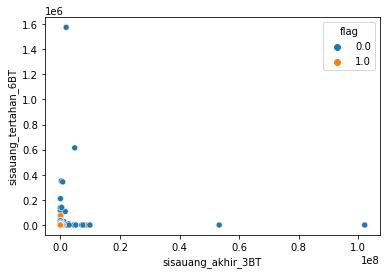

--------------------------------------------------
1136
sisauang_akhir_3BT sisauang_tersedia_1BT


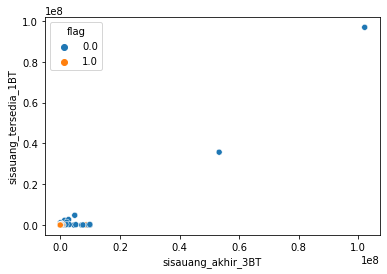

--------------------------------------------------
1137
sisauang_akhir_3BT sisauang_tersedia_2BT


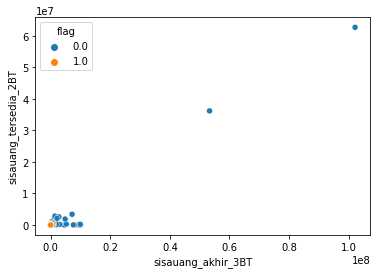

--------------------------------------------------
1138
sisauang_akhir_3BT sisauang_tersedia_3BT


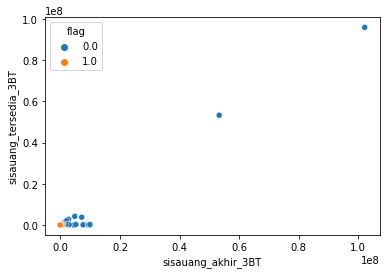

--------------------------------------------------
1139
sisauang_akhir_3BT sisauang_tersedia_4BT


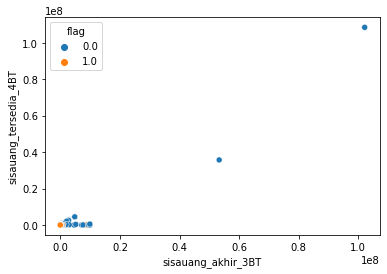

--------------------------------------------------
1140
sisauang_akhir_3BT sisauang_tersedia_5BT


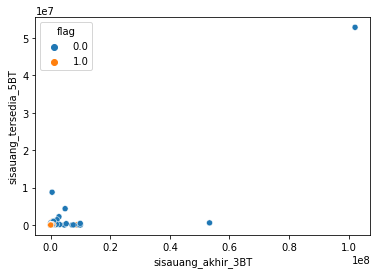

--------------------------------------------------
1141
sisauang_akhir_3BT sisauang_tersedia_6BT


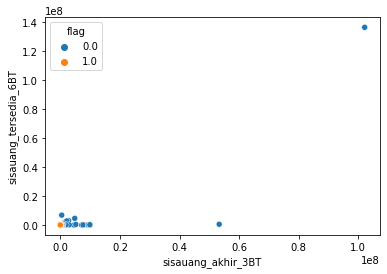

--------------------------------------------------
1142
sisauang_akhir_3BT sisa_hutang_1BT


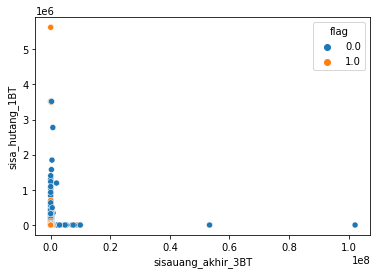

--------------------------------------------------
1143
sisauang_akhir_3BT sisa_hutang_2BT


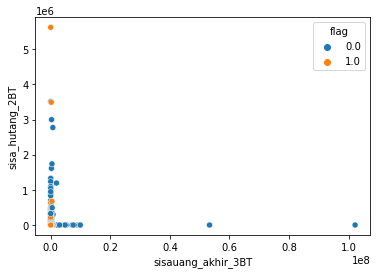

--------------------------------------------------
1144
sisauang_akhir_3BT sisa_hutang_3BT


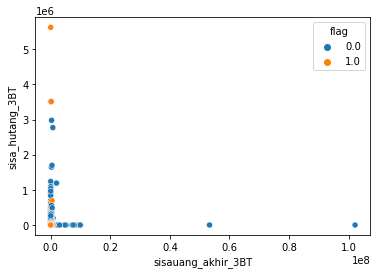

--------------------------------------------------
1145
sisauang_akhir_3BT sisa_hutang_4BT


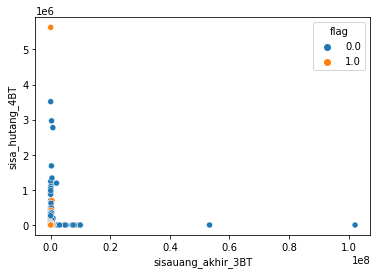

--------------------------------------------------
1146
sisauang_akhir_3BT sisa_hutang_5BT


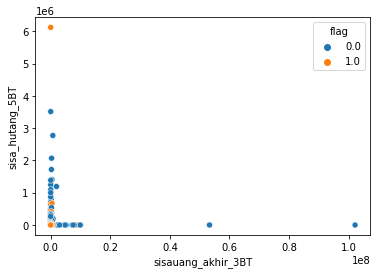

--------------------------------------------------
1147
sisauang_akhir_3BT sisa_hutang_6BT


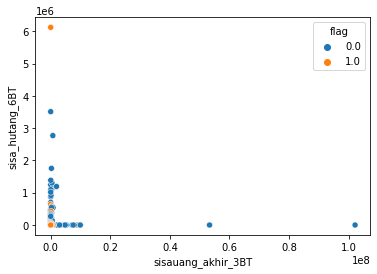

--------------------------------------------------
1148
sisauang_akhir_3BT jumlah_pembayaran_hutang_1BT


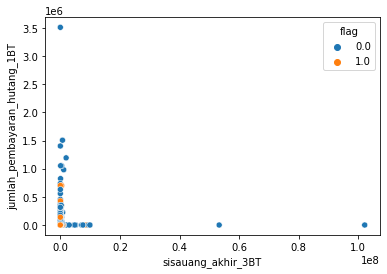

--------------------------------------------------
1149
sisauang_akhir_3BT jumlah_pembayaran_hutang_2BT


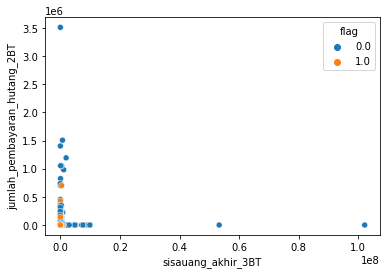

--------------------------------------------------
1150
sisauang_akhir_3BT jumlah_pembayaran_hutang_3BT


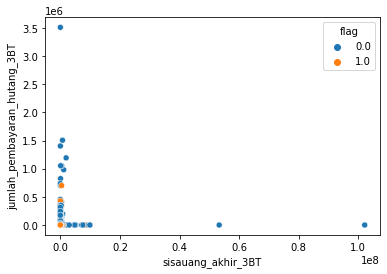

--------------------------------------------------
1151
sisauang_akhir_3BT jumlah_pembayaran_hutang_4BT


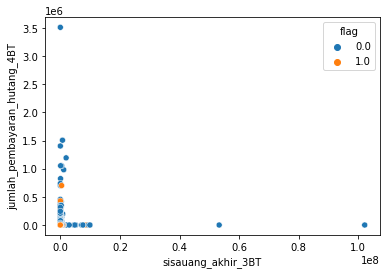

--------------------------------------------------
1152
sisauang_akhir_3BT jumlah_pembayaran_hutang_5BT


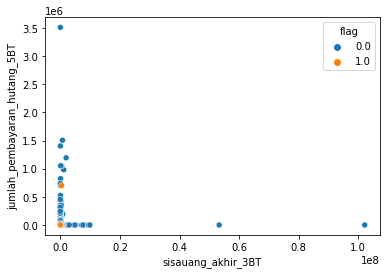

--------------------------------------------------
1153
sisauang_akhir_3BT jumlah_pembayaran_hutang_6BT


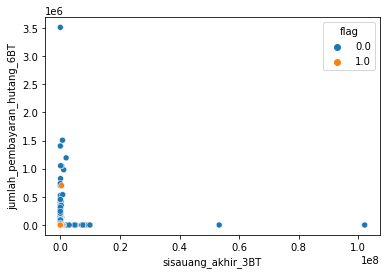

--------------------------------------------------
1154
sisauang_akhir_3BT jumlah_pengeluaran_1BT


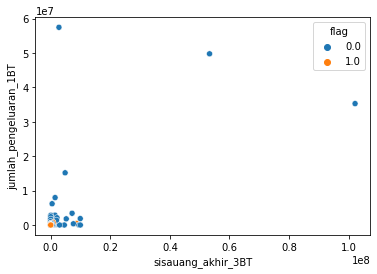

--------------------------------------------------
1155
sisauang_akhir_3BT jumlah_pengeluaran_2BT


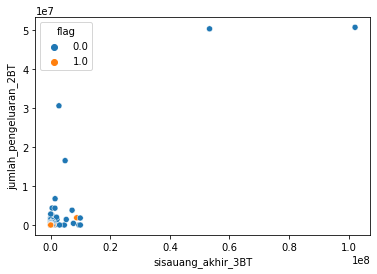

--------------------------------------------------
1156
sisauang_akhir_3BT jumlah_pengeluaran_3BT


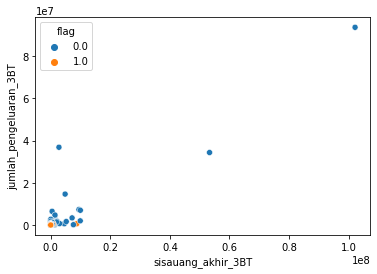

--------------------------------------------------
1157
sisauang_akhir_3BT jumlah_pengeluaran_4BT


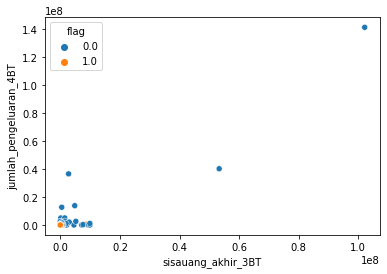

--------------------------------------------------
1158
sisauang_akhir_3BT jumlah_pengeluaran_5BT


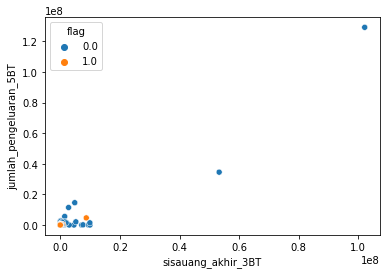

--------------------------------------------------
1159
sisauang_akhir_3BT jumlah_pengeluaran_6BT


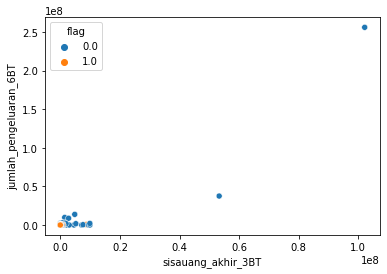

--------------------------------------------------
1160
sisauang_akhir_3BT jumlah_pemasukan_1BT


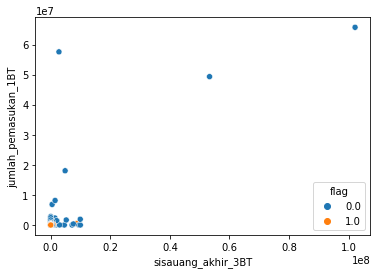

--------------------------------------------------
1161
sisauang_akhir_3BT jumlah_pemasukan_2BT


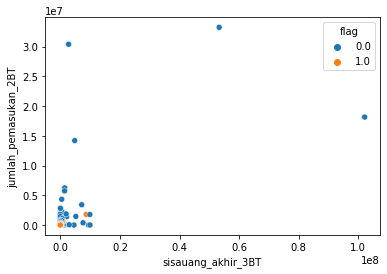

--------------------------------------------------
1162
sisauang_akhir_3BT jumlah_pemasukan_3BT


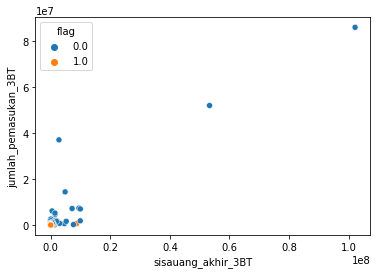

--------------------------------------------------
1163
sisauang_akhir_3BT jumlah_pemasukan_4BT


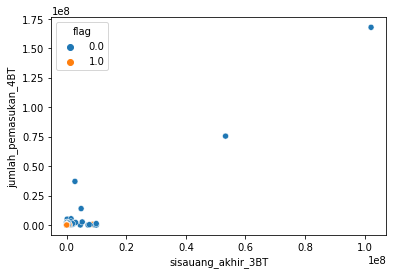

--------------------------------------------------
1164
sisauang_akhir_3BT jumlah_pemasukan_5BT


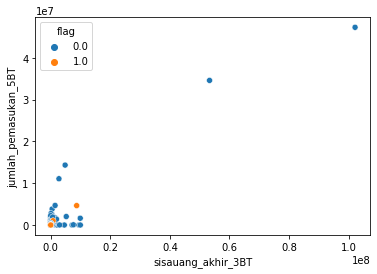

--------------------------------------------------
1165
sisauang_akhir_3BT jumlah_pemasukan_6BT


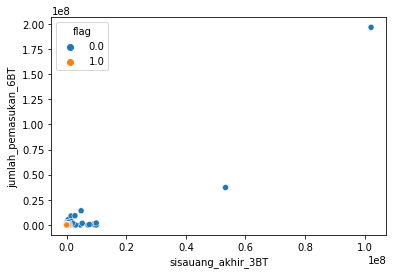

--------------------------------------------------
1166
sisauang_akhir_3BT frekuensi_pengeluaran_1BT


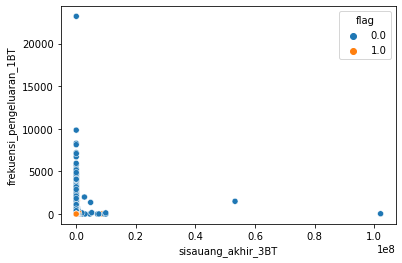

--------------------------------------------------
1167
sisauang_akhir_3BT frekuensi_pengeluaran_2BT


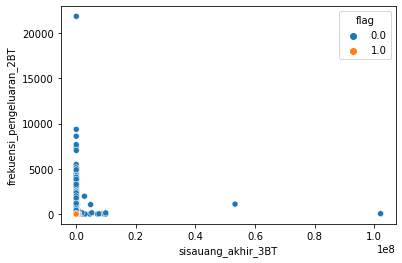

--------------------------------------------------
1168
sisauang_akhir_3BT frekuensi_pengeluaran_3BT


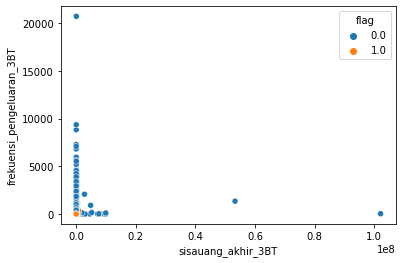

--------------------------------------------------
1169
sisauang_akhir_3BT frekuensi_pengeluaran_4BT


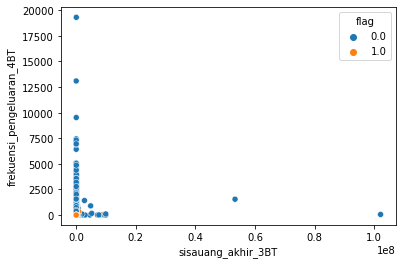

--------------------------------------------------
1170
sisauang_akhir_3BT frekuensi_pengeluaran_5BT


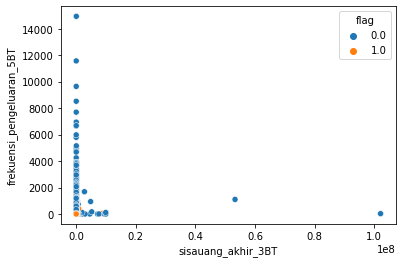

--------------------------------------------------
1171
sisauang_akhir_3BT frekuensi_pengeluaran_6BT


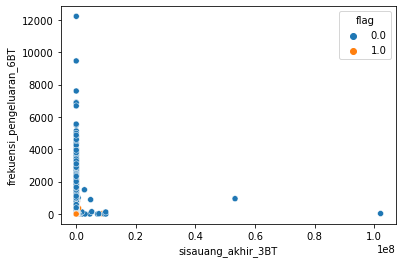

--------------------------------------------------
1172
sisauang_akhir_3BT frekuensi_pemasukan_1BT


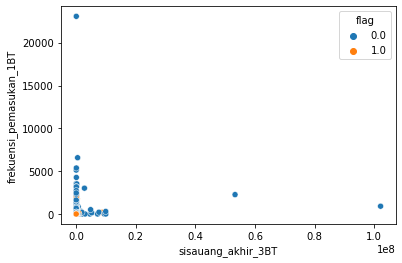

--------------------------------------------------
1173
sisauang_akhir_3BT frekuensi_pemasukan_2BT


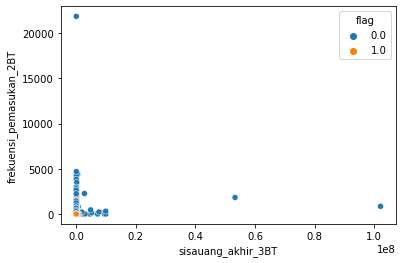

--------------------------------------------------
1174
sisauang_akhir_3BT frekuensi_pemasukan_3BT


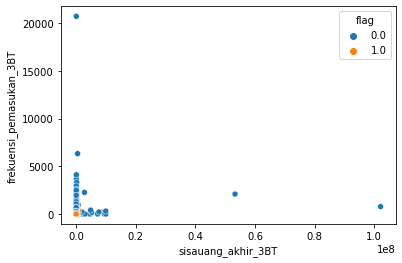

--------------------------------------------------
1175
sisauang_akhir_3BT frekuensi_pemasukan_4BT


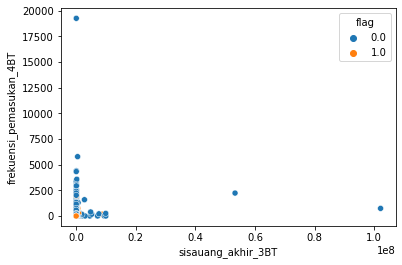

--------------------------------------------------
1176
sisauang_akhir_3BT frekuensi_pemasukan_5BT


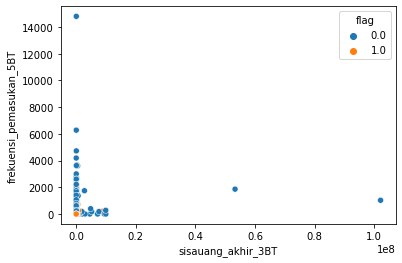

--------------------------------------------------
1177
sisauang_akhir_3BT frekuensi_pemasukan_6BT


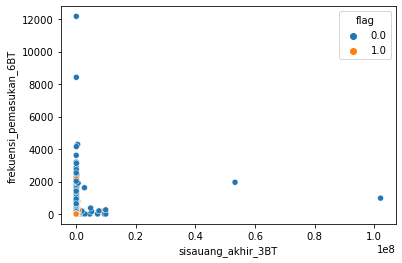

--------------------------------------------------
1178
sisauang_akhir_3BT flag


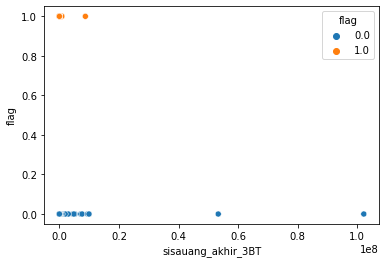

--------------------------------------------------
1179
sisauang_akhir_4BT sisauang_akhir_4BT


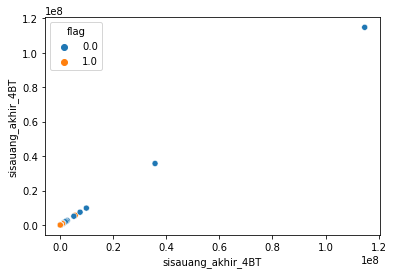

--------------------------------------------------
1180
sisauang_akhir_4BT sisauang_akhir_5BT


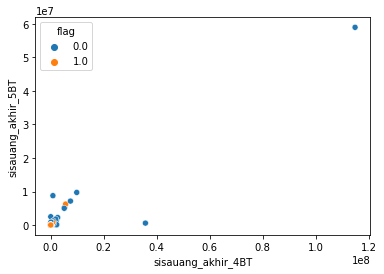

--------------------------------------------------
1181
sisauang_akhir_4BT sisauang_akhir_6BT


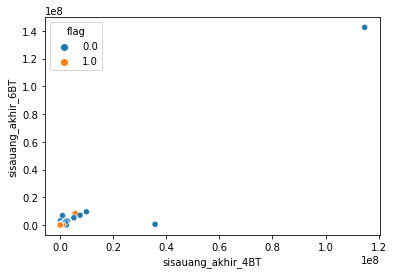

--------------------------------------------------
1182
sisauang_akhir_4BT sisauang_tertahan_1BT


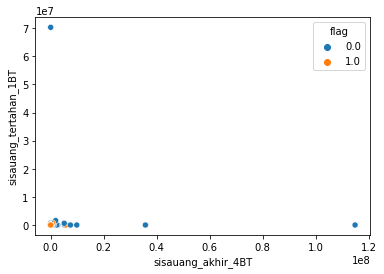

--------------------------------------------------
1183
sisauang_akhir_4BT sisauang_tertahan_2BT


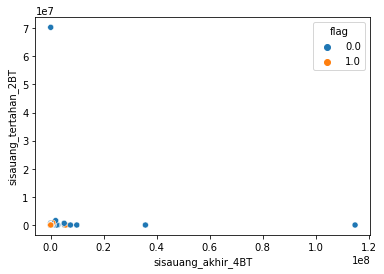

--------------------------------------------------
1184
sisauang_akhir_4BT sisauang_tertahan_3BT


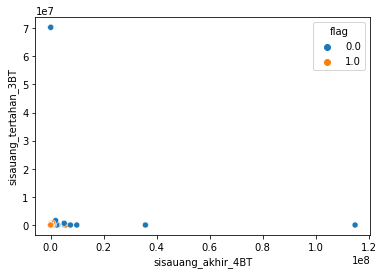

--------------------------------------------------
1185
sisauang_akhir_4BT sisauang_tertahan_4BT


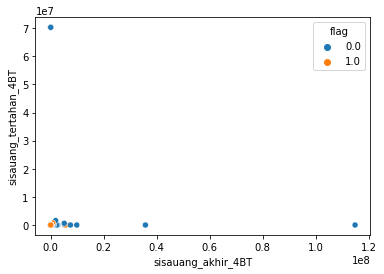

--------------------------------------------------
1186
sisauang_akhir_4BT sisauang_tertahan_5BT


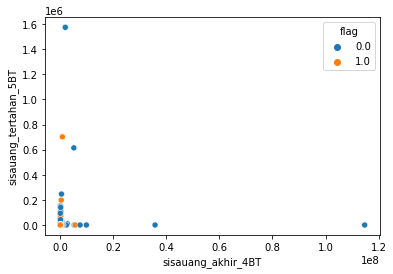

--------------------------------------------------
1187
sisauang_akhir_4BT sisauang_tertahan_6BT


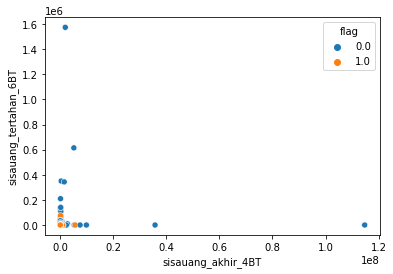

--------------------------------------------------
1188
sisauang_akhir_4BT sisauang_tersedia_1BT


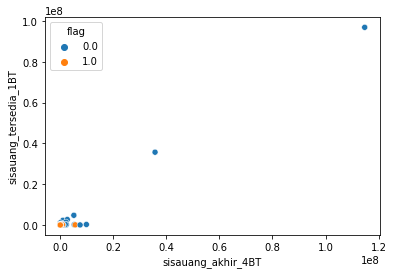

--------------------------------------------------
1189
sisauang_akhir_4BT sisauang_tersedia_2BT


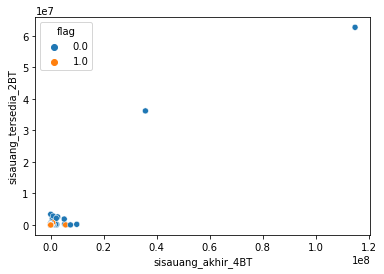

--------------------------------------------------
1190
sisauang_akhir_4BT sisauang_tersedia_3BT


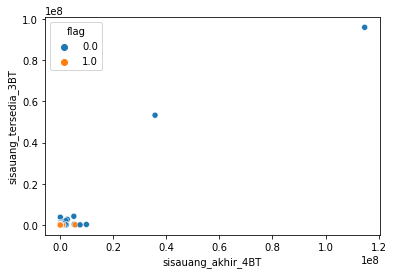

--------------------------------------------------
1191
sisauang_akhir_4BT sisauang_tersedia_4BT


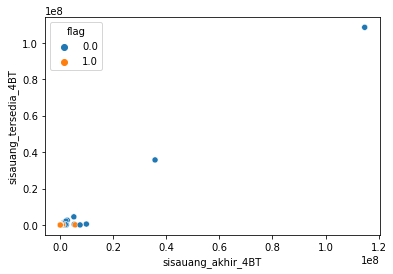

--------------------------------------------------
1192
sisauang_akhir_4BT sisauang_tersedia_5BT


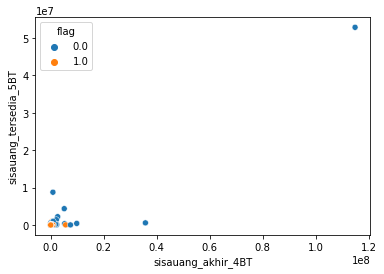

--------------------------------------------------
1193
sisauang_akhir_4BT sisauang_tersedia_6BT


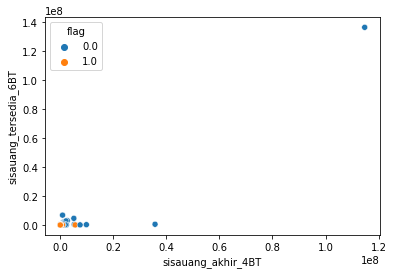

--------------------------------------------------
1194
sisauang_akhir_4BT sisa_hutang_1BT


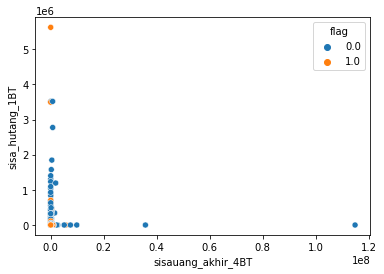

--------------------------------------------------
1195
sisauang_akhir_4BT sisa_hutang_2BT


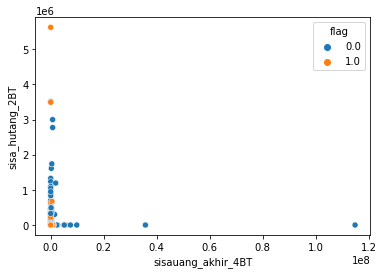

--------------------------------------------------
1196
sisauang_akhir_4BT sisa_hutang_3BT


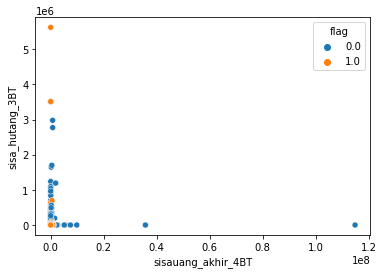

--------------------------------------------------
1197
sisauang_akhir_4BT sisa_hutang_4BT


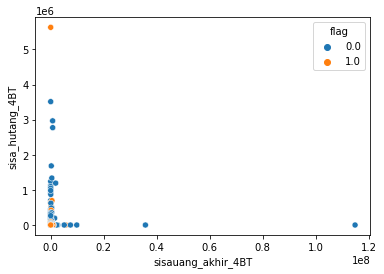

--------------------------------------------------
1198
sisauang_akhir_4BT sisa_hutang_5BT


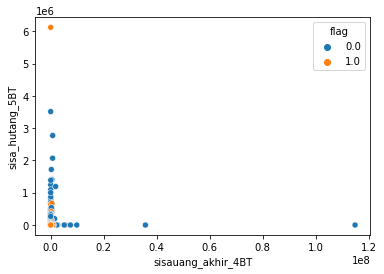

--------------------------------------------------
1199
sisauang_akhir_4BT sisa_hutang_6BT


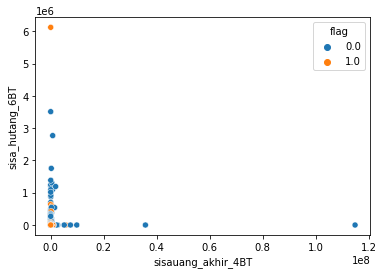

--------------------------------------------------
1200
sisauang_akhir_4BT jumlah_pembayaran_hutang_1BT


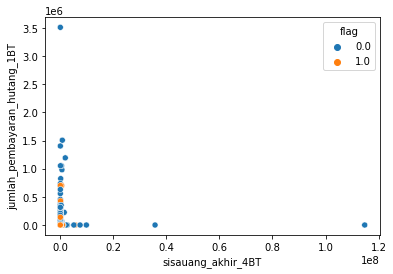

--------------------------------------------------
1201
sisauang_akhir_4BT jumlah_pembayaran_hutang_2BT


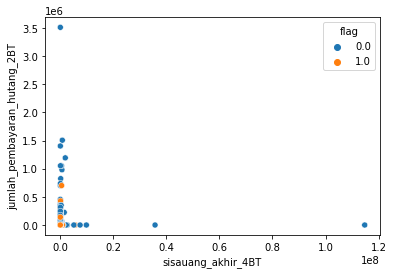

--------------------------------------------------
1202
sisauang_akhir_4BT jumlah_pembayaran_hutang_3BT


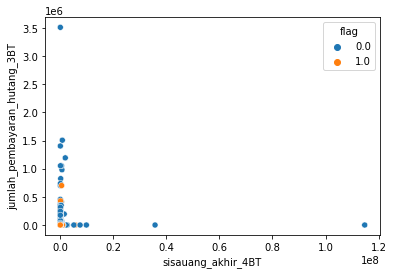

--------------------------------------------------
1203
sisauang_akhir_4BT jumlah_pembayaran_hutang_4BT


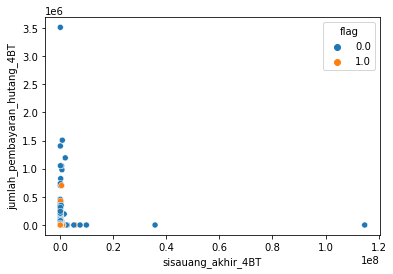

--------------------------------------------------
1204
sisauang_akhir_4BT jumlah_pembayaran_hutang_5BT


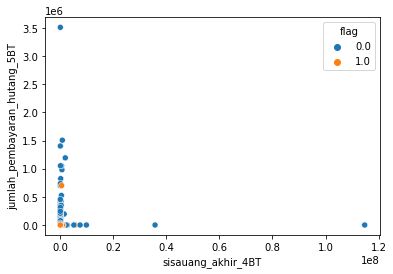

--------------------------------------------------
1205
sisauang_akhir_4BT jumlah_pembayaran_hutang_6BT


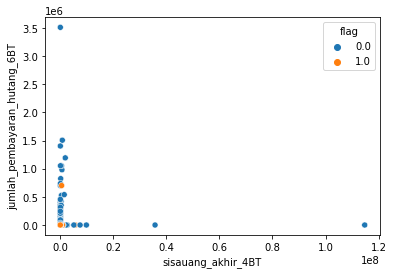

--------------------------------------------------
1206
sisauang_akhir_4BT jumlah_pengeluaran_1BT


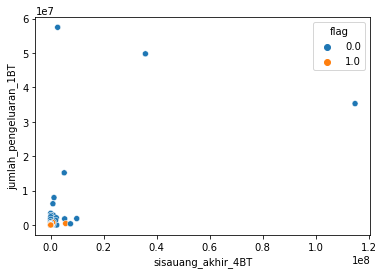

--------------------------------------------------
1207
sisauang_akhir_4BT jumlah_pengeluaran_2BT


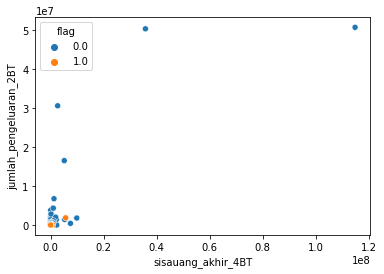

--------------------------------------------------
1208
sisauang_akhir_4BT jumlah_pengeluaran_3BT


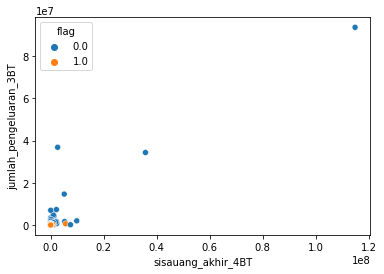

--------------------------------------------------
1209
sisauang_akhir_4BT jumlah_pengeluaran_4BT


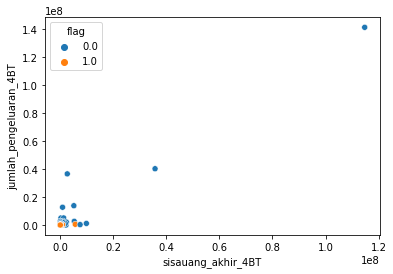

--------------------------------------------------
1210
sisauang_akhir_4BT jumlah_pengeluaran_5BT


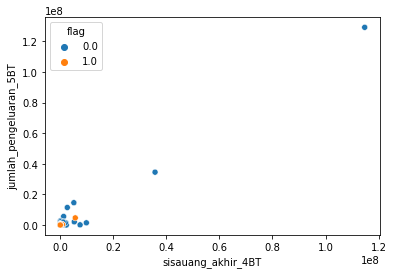

--------------------------------------------------
1211
sisauang_akhir_4BT jumlah_pengeluaran_6BT


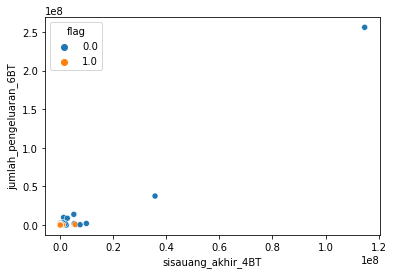

--------------------------------------------------
1212
sisauang_akhir_4BT jumlah_pemasukan_1BT


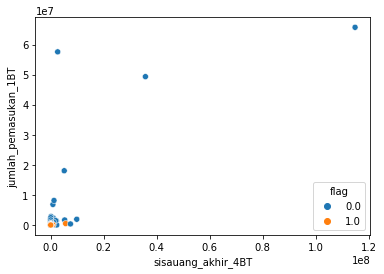

--------------------------------------------------
1213
sisauang_akhir_4BT jumlah_pemasukan_2BT


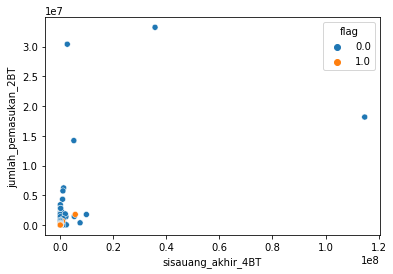

--------------------------------------------------
1214
sisauang_akhir_4BT jumlah_pemasukan_3BT


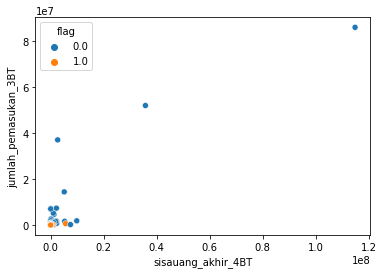

--------------------------------------------------
1215
sisauang_akhir_4BT jumlah_pemasukan_4BT


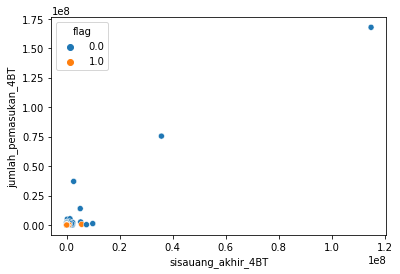

--------------------------------------------------
1216
sisauang_akhir_4BT jumlah_pemasukan_5BT


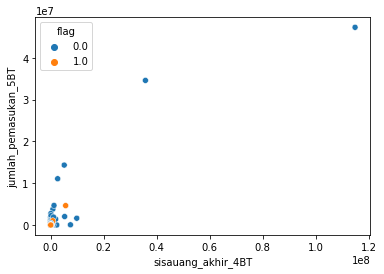

--------------------------------------------------
1217
sisauang_akhir_4BT jumlah_pemasukan_6BT


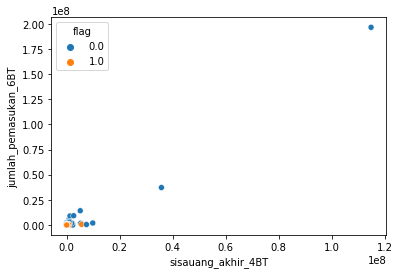

--------------------------------------------------
1218
sisauang_akhir_4BT frekuensi_pengeluaran_1BT


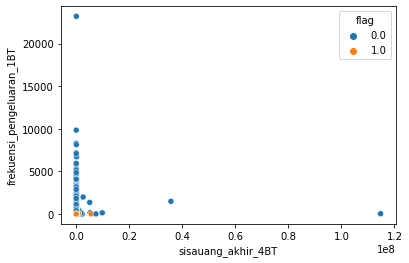

--------------------------------------------------
1219
sisauang_akhir_4BT frekuensi_pengeluaran_2BT


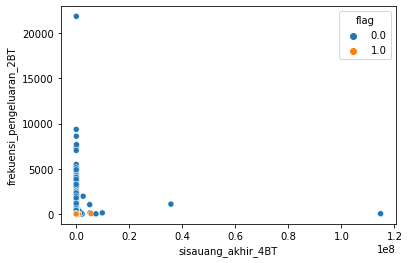

--------------------------------------------------
1220
sisauang_akhir_4BT frekuensi_pengeluaran_3BT


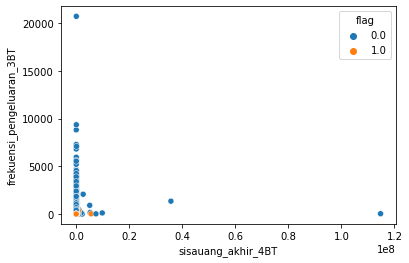

--------------------------------------------------
1221
sisauang_akhir_4BT frekuensi_pengeluaran_4BT


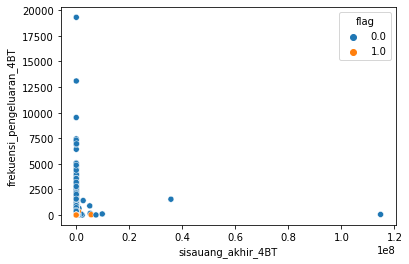

--------------------------------------------------
1222
sisauang_akhir_4BT frekuensi_pengeluaran_5BT


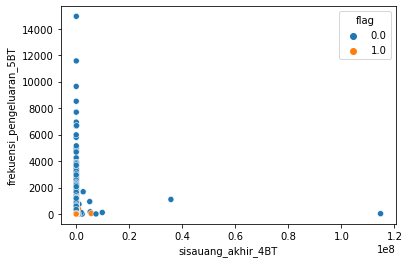

--------------------------------------------------
1223
sisauang_akhir_4BT frekuensi_pengeluaran_6BT


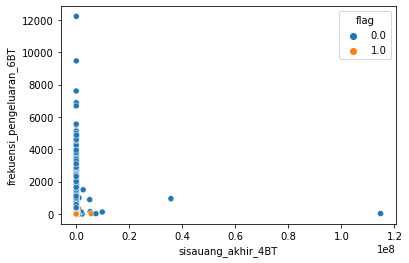

--------------------------------------------------
1224
sisauang_akhir_4BT frekuensi_pemasukan_1BT


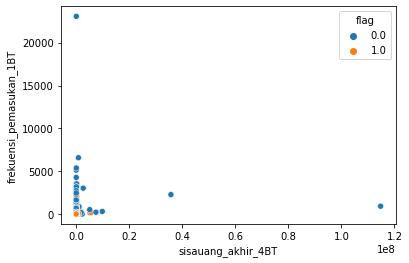

--------------------------------------------------
1225
sisauang_akhir_4BT frekuensi_pemasukan_2BT


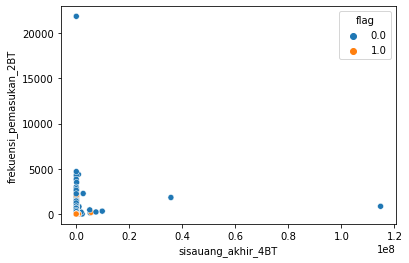

--------------------------------------------------
1226
sisauang_akhir_4BT frekuensi_pemasukan_3BT


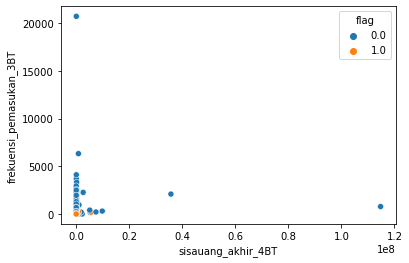

--------------------------------------------------
1227
sisauang_akhir_4BT frekuensi_pemasukan_4BT


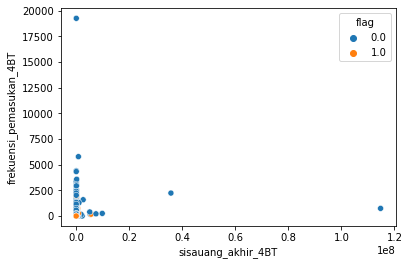

--------------------------------------------------
1228
sisauang_akhir_4BT frekuensi_pemasukan_5BT


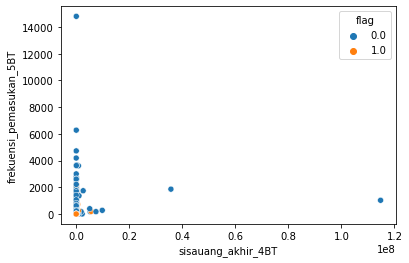

--------------------------------------------------
1229
sisauang_akhir_4BT frekuensi_pemasukan_6BT


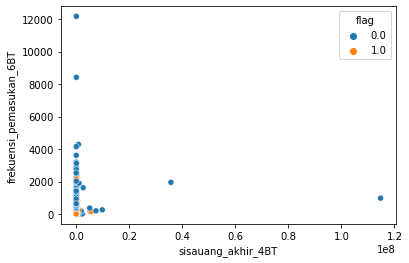

--------------------------------------------------
1230
sisauang_akhir_4BT flag


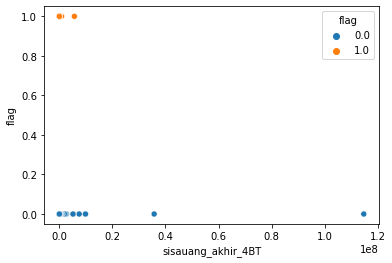

--------------------------------------------------
1231
sisauang_akhir_5BT sisauang_akhir_5BT


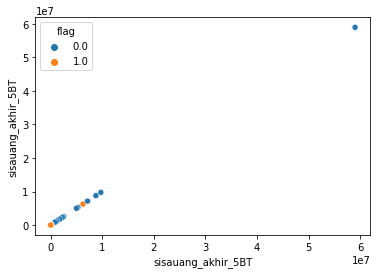

--------------------------------------------------
1232
sisauang_akhir_5BT sisauang_akhir_6BT


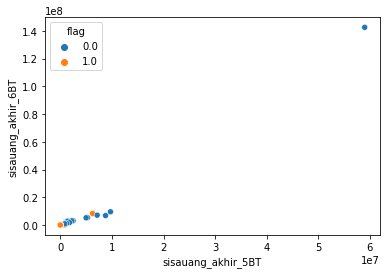

--------------------------------------------------
1233
sisauang_akhir_5BT sisauang_tertahan_1BT


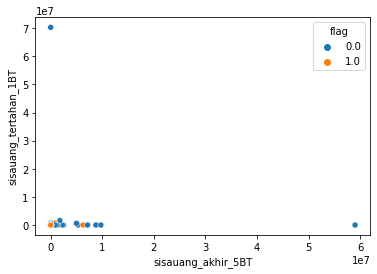

--------------------------------------------------
1234
sisauang_akhir_5BT sisauang_tertahan_2BT


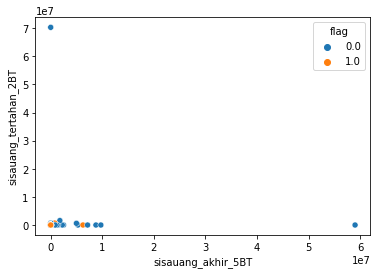

--------------------------------------------------
1235
sisauang_akhir_5BT sisauang_tertahan_3BT


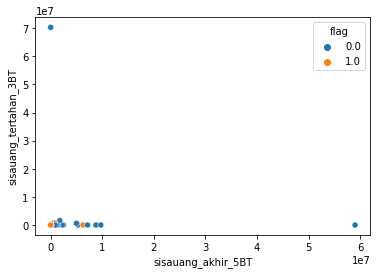

--------------------------------------------------
1236
sisauang_akhir_5BT sisauang_tertahan_4BT


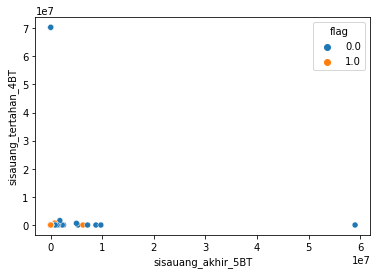

--------------------------------------------------
1237
sisauang_akhir_5BT sisauang_tertahan_5BT


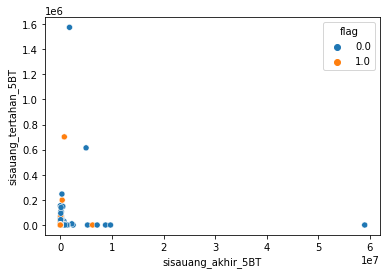

--------------------------------------------------
1238
sisauang_akhir_5BT sisauang_tertahan_6BT


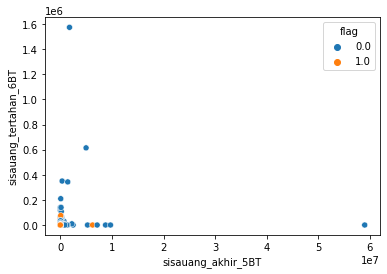

--------------------------------------------------
1239
sisauang_akhir_5BT sisauang_tersedia_1BT


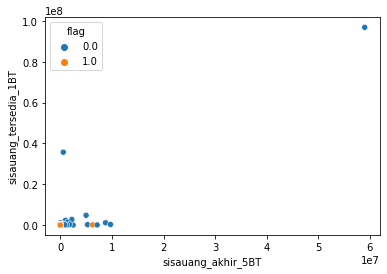

--------------------------------------------------
1240
sisauang_akhir_5BT sisauang_tersedia_2BT


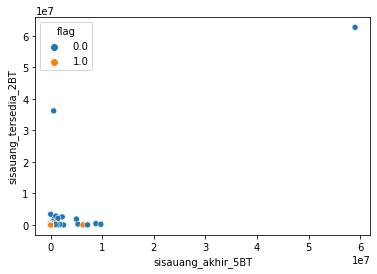

--------------------------------------------------
1241
sisauang_akhir_5BT sisauang_tersedia_3BT


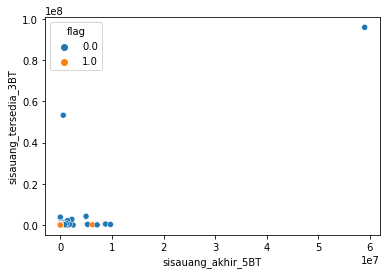

--------------------------------------------------
1242
sisauang_akhir_5BT sisauang_tersedia_4BT


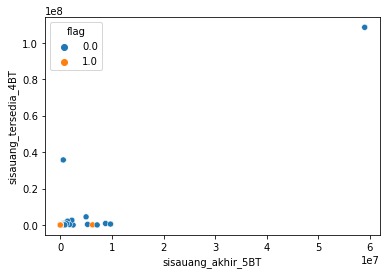

--------------------------------------------------
1243
sisauang_akhir_5BT sisauang_tersedia_5BT


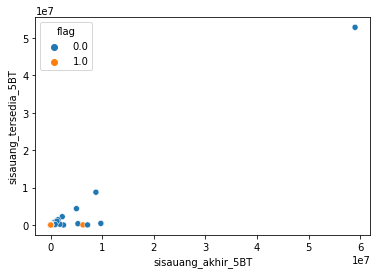

--------------------------------------------------
1244
sisauang_akhir_5BT sisauang_tersedia_6BT


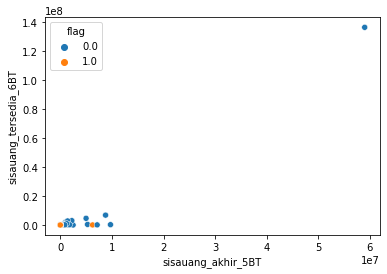

--------------------------------------------------
1245
sisauang_akhir_5BT sisa_hutang_1BT


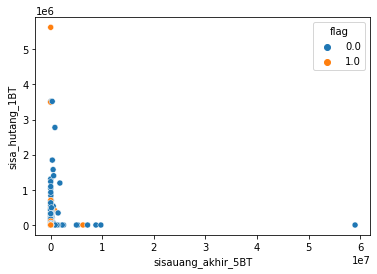

--------------------------------------------------
1246
sisauang_akhir_5BT sisa_hutang_2BT


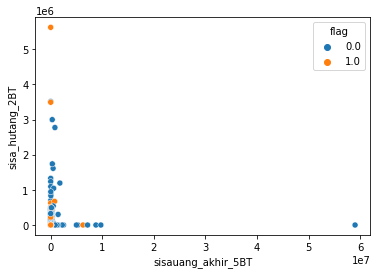

--------------------------------------------------
1247
sisauang_akhir_5BT sisa_hutang_3BT


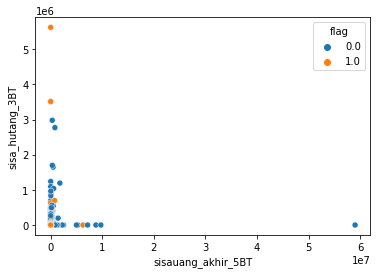

--------------------------------------------------
1248
sisauang_akhir_5BT sisa_hutang_4BT


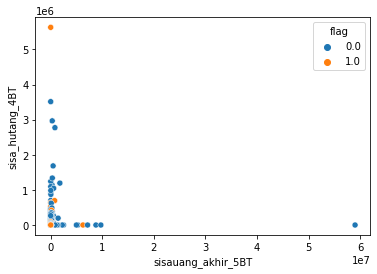

--------------------------------------------------
1249
sisauang_akhir_5BT sisa_hutang_5BT


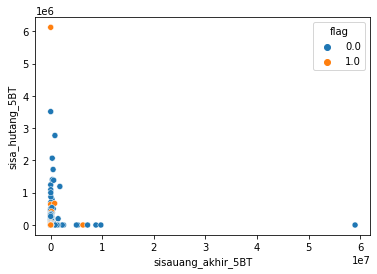

--------------------------------------------------
1250
sisauang_akhir_5BT sisa_hutang_6BT


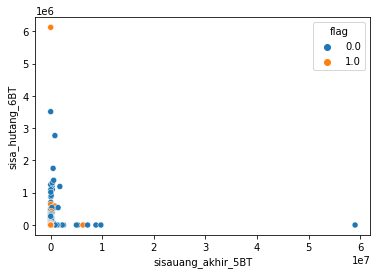

--------------------------------------------------
1251
sisauang_akhir_5BT jumlah_pembayaran_hutang_1BT


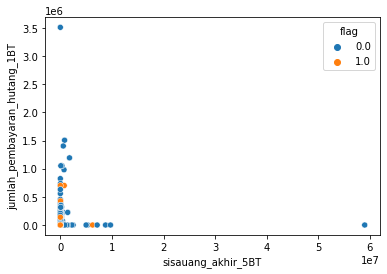

--------------------------------------------------
1252
sisauang_akhir_5BT jumlah_pembayaran_hutang_2BT


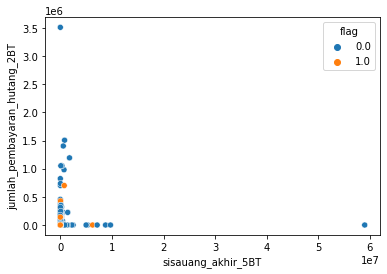

--------------------------------------------------
1253
sisauang_akhir_5BT jumlah_pembayaran_hutang_3BT


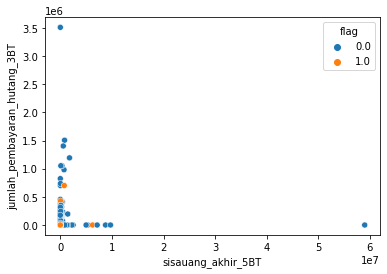

--------------------------------------------------
1254
sisauang_akhir_5BT jumlah_pembayaran_hutang_4BT


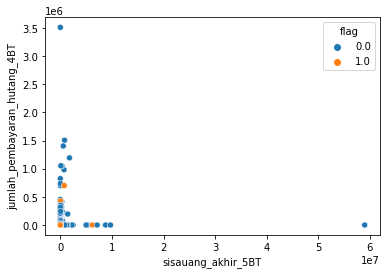

--------------------------------------------------
1255
sisauang_akhir_5BT jumlah_pembayaran_hutang_5BT


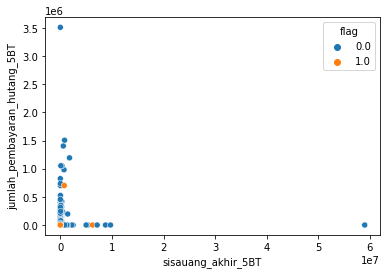

--------------------------------------------------
1256
sisauang_akhir_5BT jumlah_pembayaran_hutang_6BT


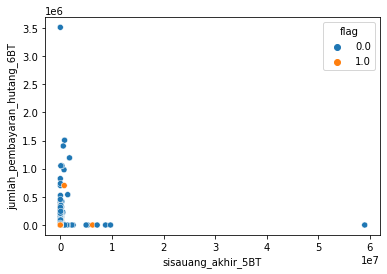

--------------------------------------------------
1257
sisauang_akhir_5BT jumlah_pengeluaran_1BT


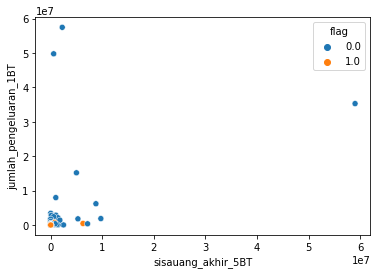

--------------------------------------------------
1258
sisauang_akhir_5BT jumlah_pengeluaran_2BT


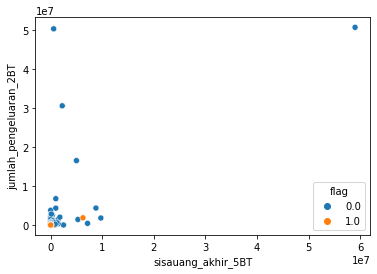

--------------------------------------------------
1259
sisauang_akhir_5BT jumlah_pengeluaran_3BT


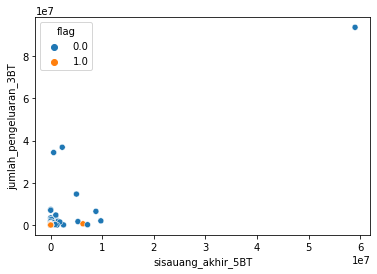

--------------------------------------------------
1260
sisauang_akhir_5BT jumlah_pengeluaran_4BT


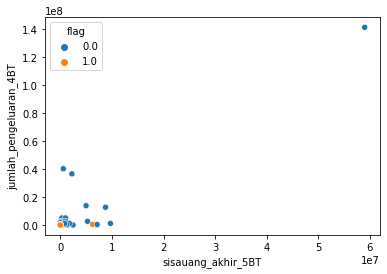

--------------------------------------------------
1261
sisauang_akhir_5BT jumlah_pengeluaran_5BT


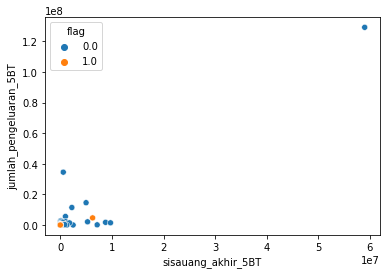

--------------------------------------------------
1262
sisauang_akhir_5BT jumlah_pengeluaran_6BT


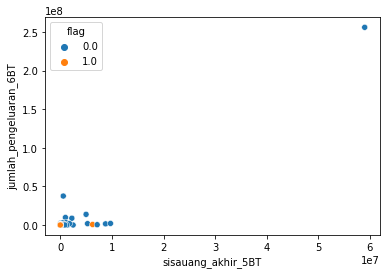

--------------------------------------------------
1263
sisauang_akhir_5BT jumlah_pemasukan_1BT


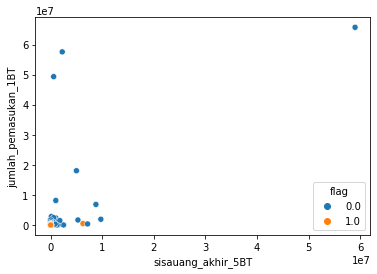

--------------------------------------------------
1264
sisauang_akhir_5BT jumlah_pemasukan_2BT


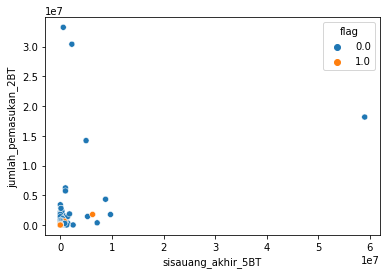

--------------------------------------------------
1265
sisauang_akhir_5BT jumlah_pemasukan_3BT


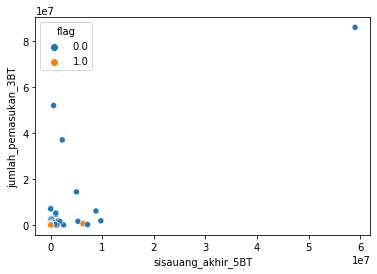

--------------------------------------------------
1266
sisauang_akhir_5BT jumlah_pemasukan_4BT


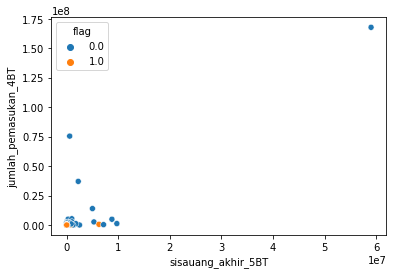

--------------------------------------------------
1267
sisauang_akhir_5BT jumlah_pemasukan_5BT


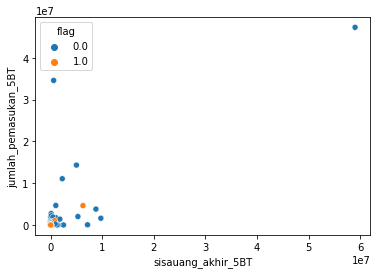

--------------------------------------------------
1268
sisauang_akhir_5BT jumlah_pemasukan_6BT


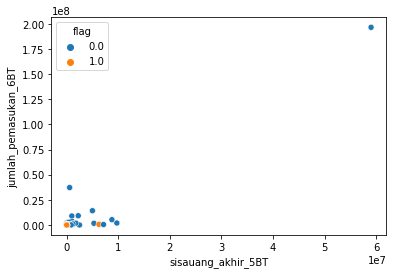

--------------------------------------------------
1269
sisauang_akhir_5BT frekuensi_pengeluaran_1BT


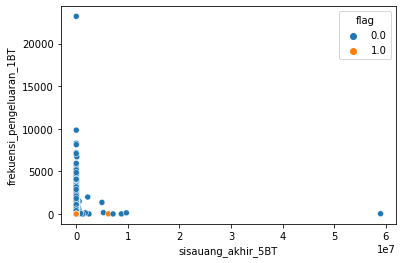

--------------------------------------------------
1270
sisauang_akhir_5BT frekuensi_pengeluaran_2BT


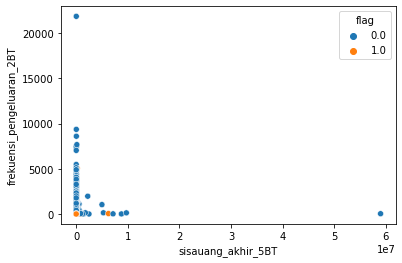

--------------------------------------------------
1271
sisauang_akhir_5BT frekuensi_pengeluaran_3BT


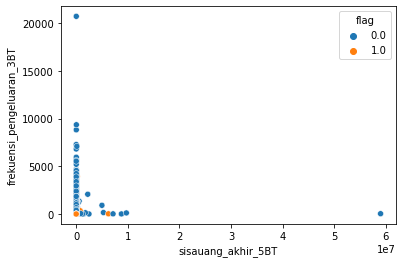

--------------------------------------------------
1272
sisauang_akhir_5BT frekuensi_pengeluaran_4BT


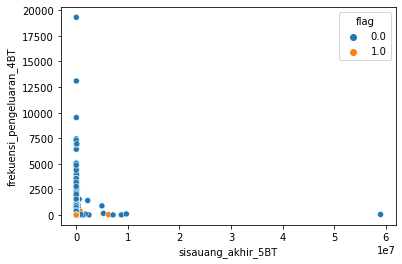

--------------------------------------------------
1273
sisauang_akhir_5BT frekuensi_pengeluaran_5BT


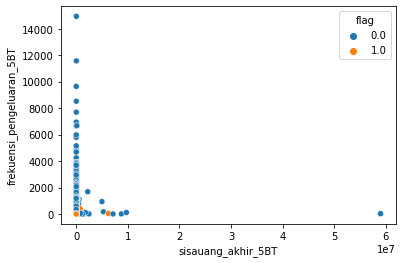

--------------------------------------------------
1274
sisauang_akhir_5BT frekuensi_pengeluaran_6BT


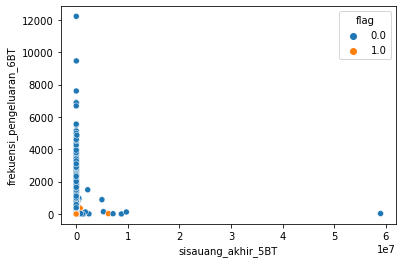

--------------------------------------------------
1275
sisauang_akhir_5BT frekuensi_pemasukan_1BT


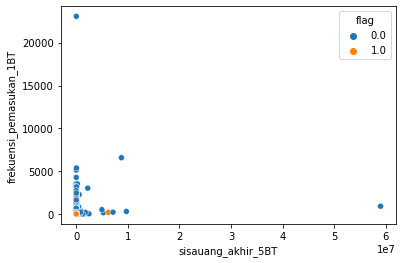

--------------------------------------------------
1276
sisauang_akhir_5BT frekuensi_pemasukan_2BT


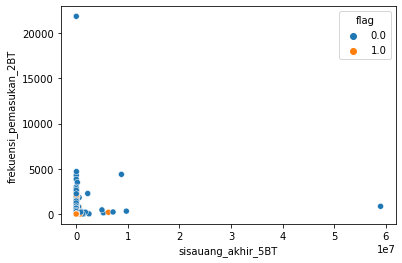

--------------------------------------------------
1277
sisauang_akhir_5BT frekuensi_pemasukan_3BT


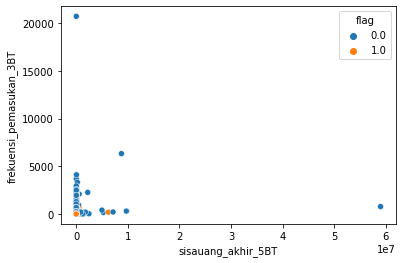

--------------------------------------------------
1278
sisauang_akhir_5BT frekuensi_pemasukan_4BT


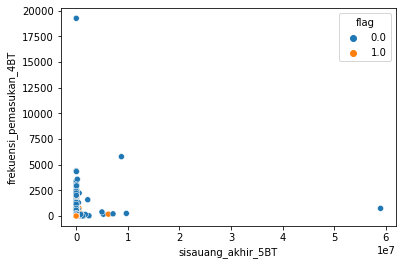

--------------------------------------------------
1279
sisauang_akhir_5BT frekuensi_pemasukan_5BT


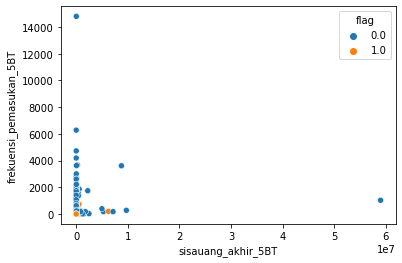

--------------------------------------------------
1280
sisauang_akhir_5BT frekuensi_pemasukan_6BT


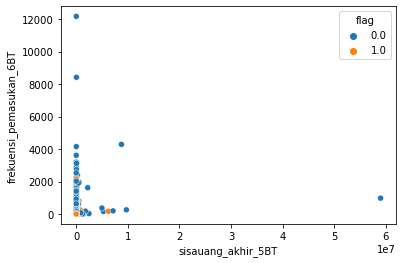

--------------------------------------------------
1281
sisauang_akhir_5BT flag


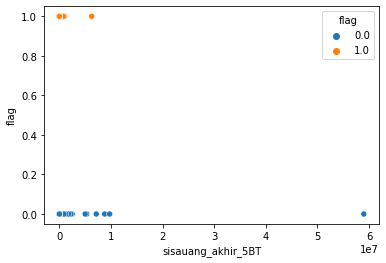

--------------------------------------------------
1282
sisauang_akhir_6BT sisauang_akhir_6BT


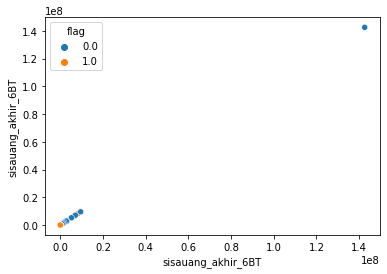

--------------------------------------------------
1283
sisauang_akhir_6BT sisauang_tertahan_1BT


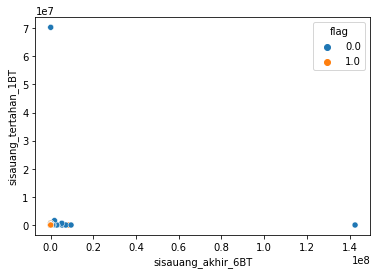

--------------------------------------------------
1284
sisauang_akhir_6BT sisauang_tertahan_2BT


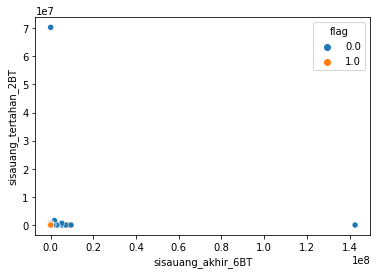

--------------------------------------------------
1285
sisauang_akhir_6BT sisauang_tertahan_3BT


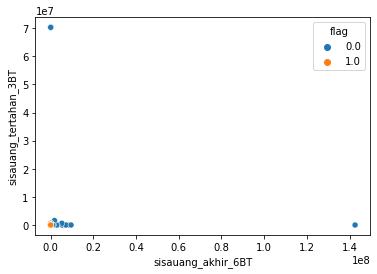

--------------------------------------------------
1286
sisauang_akhir_6BT sisauang_tertahan_4BT


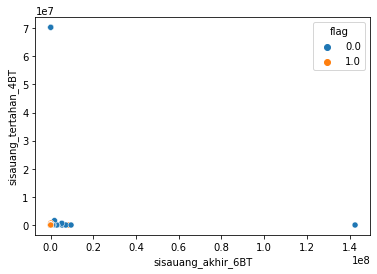

--------------------------------------------------
1287
sisauang_akhir_6BT sisauang_tertahan_5BT


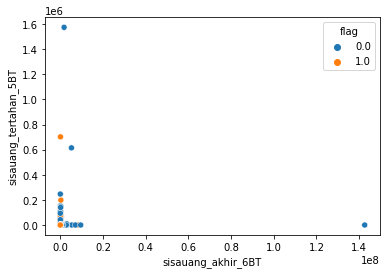

--------------------------------------------------
1288
sisauang_akhir_6BT sisauang_tertahan_6BT


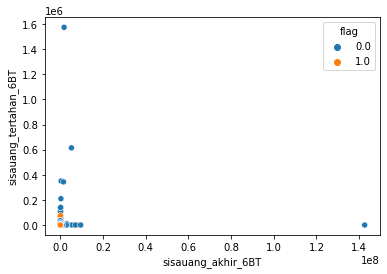

--------------------------------------------------
1289
sisauang_akhir_6BT sisauang_tersedia_1BT


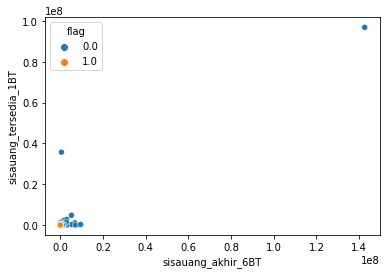

--------------------------------------------------
1290
sisauang_akhir_6BT sisauang_tersedia_2BT


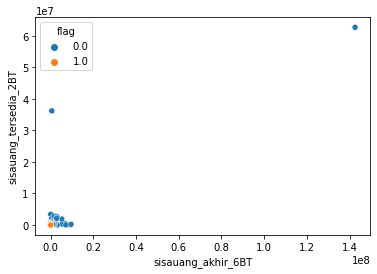

--------------------------------------------------
1291
sisauang_akhir_6BT sisauang_tersedia_3BT


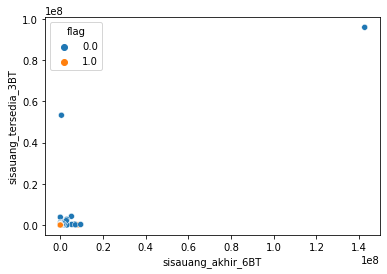

--------------------------------------------------
1292
sisauang_akhir_6BT sisauang_tersedia_4BT


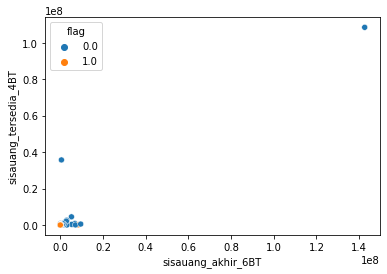

--------------------------------------------------
1293
sisauang_akhir_6BT sisauang_tersedia_5BT


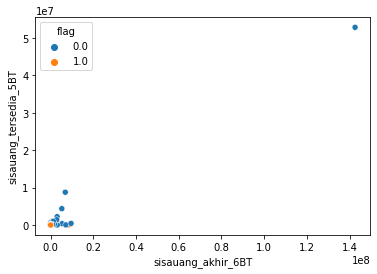

--------------------------------------------------
1294
sisauang_akhir_6BT sisauang_tersedia_6BT


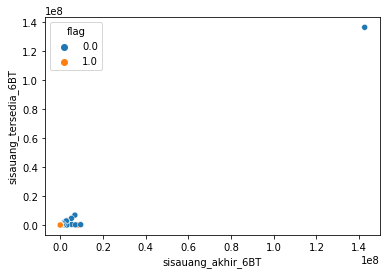

--------------------------------------------------
1295
sisauang_akhir_6BT sisa_hutang_1BT


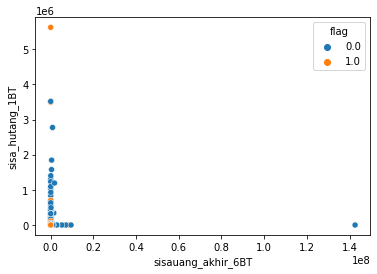

--------------------------------------------------
1296
sisauang_akhir_6BT sisa_hutang_2BT


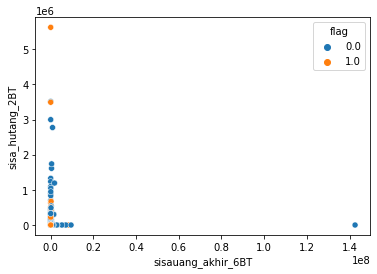

--------------------------------------------------
1297
sisauang_akhir_6BT sisa_hutang_3BT


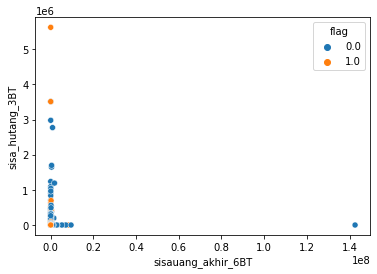

--------------------------------------------------
1298
sisauang_akhir_6BT sisa_hutang_4BT


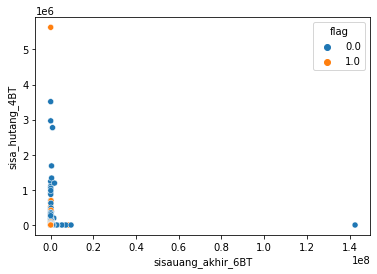

--------------------------------------------------
1299
sisauang_akhir_6BT sisa_hutang_5BT


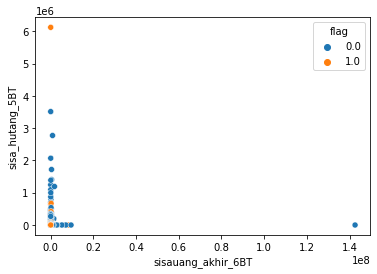

--------------------------------------------------
1300
sisauang_akhir_6BT sisa_hutang_6BT


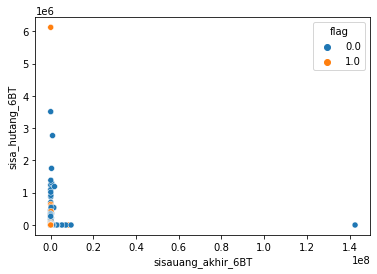

--------------------------------------------------
1301
sisauang_akhir_6BT jumlah_pembayaran_hutang_1BT


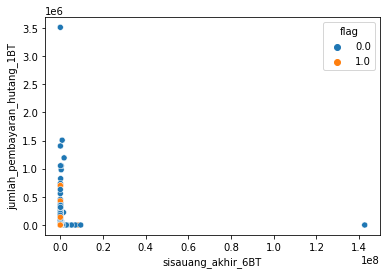

--------------------------------------------------
1302
sisauang_akhir_6BT jumlah_pembayaran_hutang_2BT


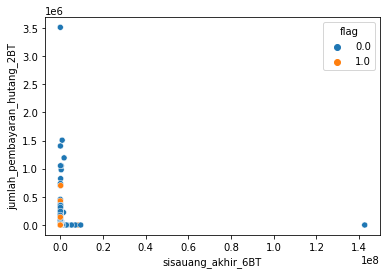

--------------------------------------------------
1303
sisauang_akhir_6BT jumlah_pembayaran_hutang_3BT


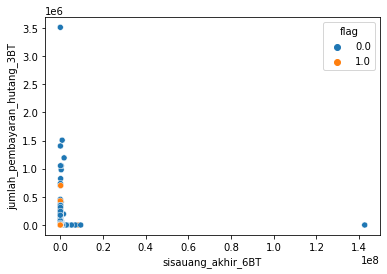

--------------------------------------------------
1304
sisauang_akhir_6BT jumlah_pembayaran_hutang_4BT


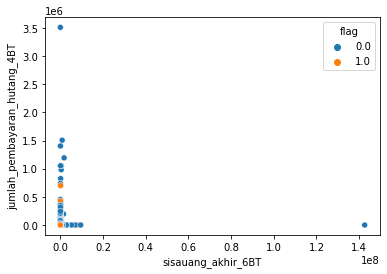

--------------------------------------------------
1305
sisauang_akhir_6BT jumlah_pembayaran_hutang_5BT


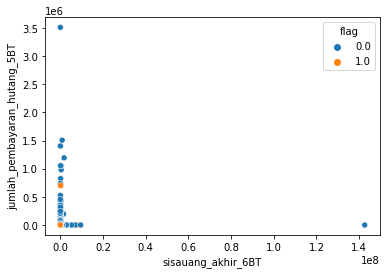

--------------------------------------------------
1306
sisauang_akhir_6BT jumlah_pembayaran_hutang_6BT


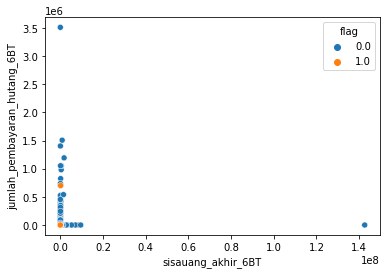

--------------------------------------------------
1307
sisauang_akhir_6BT jumlah_pengeluaran_1BT


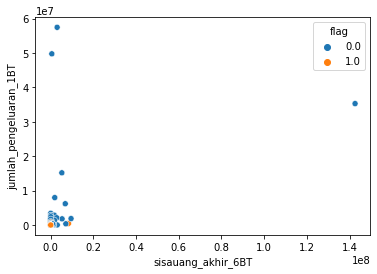

--------------------------------------------------
1308
sisauang_akhir_6BT jumlah_pengeluaran_2BT


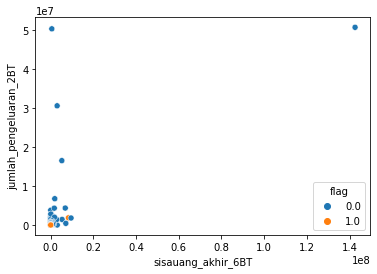

--------------------------------------------------
1309
sisauang_akhir_6BT jumlah_pengeluaran_3BT


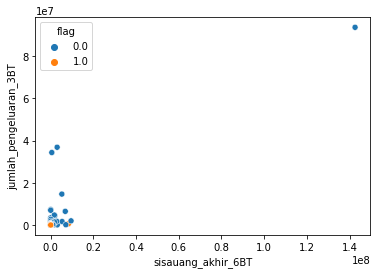

--------------------------------------------------
1310
sisauang_akhir_6BT jumlah_pengeluaran_4BT


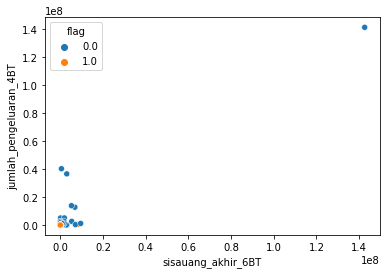

--------------------------------------------------
1311
sisauang_akhir_6BT jumlah_pengeluaran_5BT


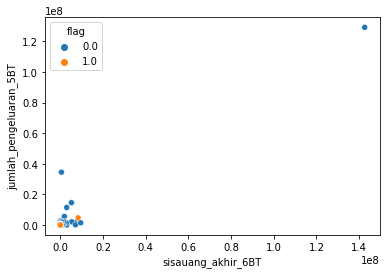

--------------------------------------------------
1312
sisauang_akhir_6BT jumlah_pengeluaran_6BT


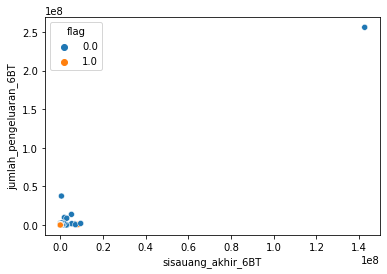

--------------------------------------------------
1313
sisauang_akhir_6BT jumlah_pemasukan_1BT


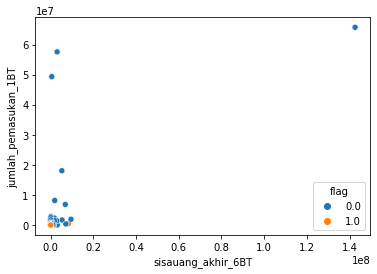

--------------------------------------------------
1314
sisauang_akhir_6BT jumlah_pemasukan_2BT


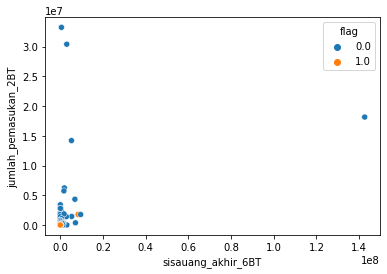

--------------------------------------------------
1315
sisauang_akhir_6BT jumlah_pemasukan_3BT


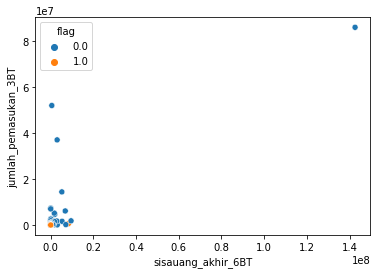

--------------------------------------------------
1316
sisauang_akhir_6BT jumlah_pemasukan_4BT


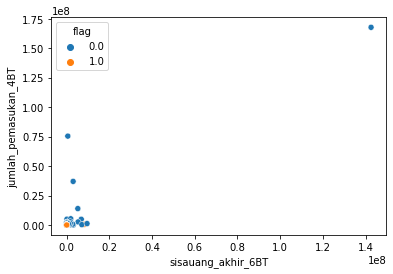

--------------------------------------------------
1317
sisauang_akhir_6BT jumlah_pemasukan_5BT


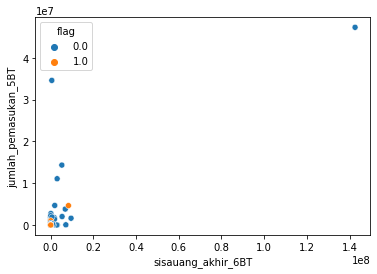

--------------------------------------------------
1318
sisauang_akhir_6BT jumlah_pemasukan_6BT


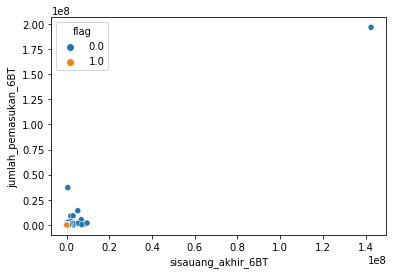

--------------------------------------------------
1319
sisauang_akhir_6BT frekuensi_pengeluaran_1BT


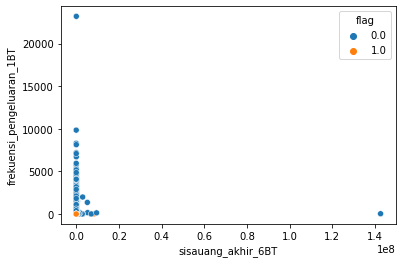

--------------------------------------------------
1320
sisauang_akhir_6BT frekuensi_pengeluaran_2BT


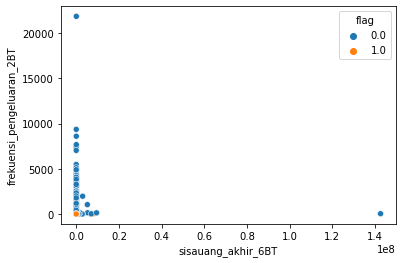

--------------------------------------------------
1321
sisauang_akhir_6BT frekuensi_pengeluaran_3BT


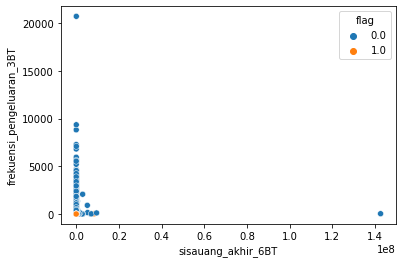

--------------------------------------------------
1322
sisauang_akhir_6BT frekuensi_pengeluaran_4BT


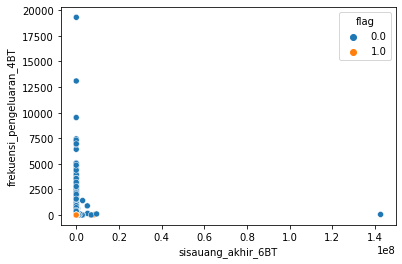

--------------------------------------------------
1323
sisauang_akhir_6BT frekuensi_pengeluaran_5BT


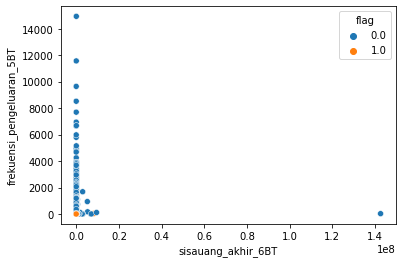

--------------------------------------------------
1324
sisauang_akhir_6BT frekuensi_pengeluaran_6BT


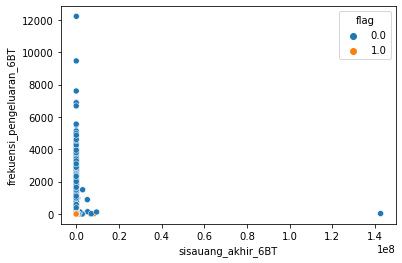

--------------------------------------------------
1325
sisauang_akhir_6BT frekuensi_pemasukan_1BT


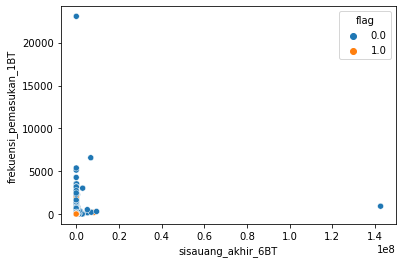

--------------------------------------------------
1326
sisauang_akhir_6BT frekuensi_pemasukan_2BT


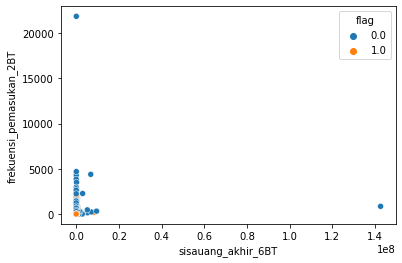

--------------------------------------------------
1327
sisauang_akhir_6BT frekuensi_pemasukan_3BT


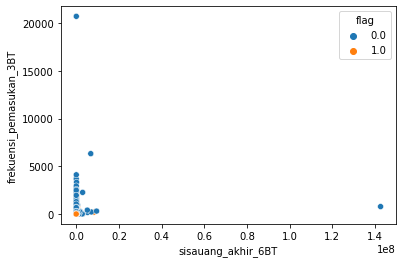

--------------------------------------------------
1328
sisauang_akhir_6BT frekuensi_pemasukan_4BT


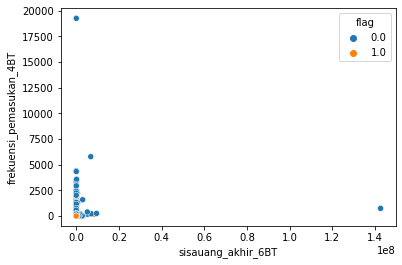

--------------------------------------------------
1329
sisauang_akhir_6BT frekuensi_pemasukan_5BT


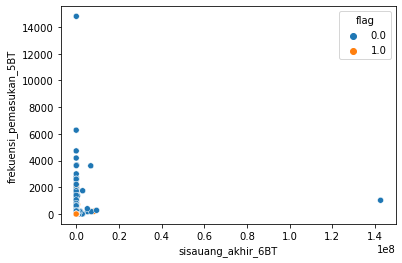

--------------------------------------------------
1330
sisauang_akhir_6BT frekuensi_pemasukan_6BT


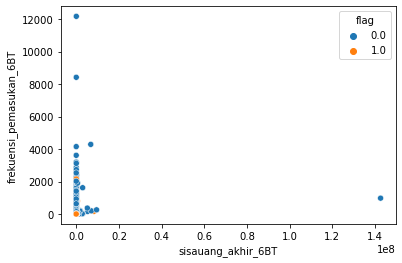

--------------------------------------------------
1331
sisauang_akhir_6BT flag


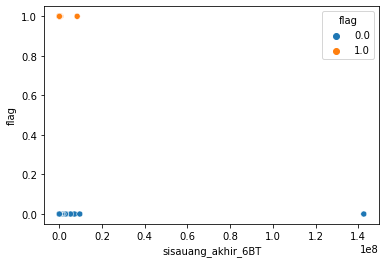

--------------------------------------------------
1332
sisauang_tertahan_1BT sisauang_tertahan_1BT


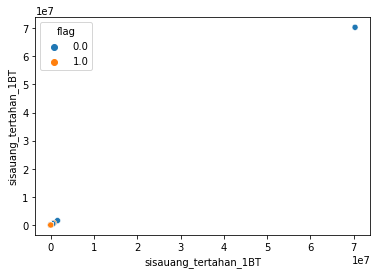

--------------------------------------------------
1333
sisauang_tertahan_1BT sisauang_tertahan_2BT


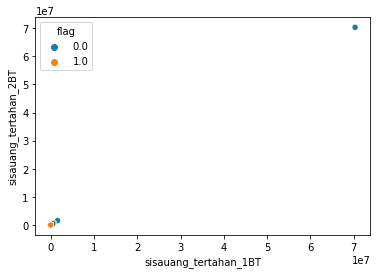

--------------------------------------------------
1334
sisauang_tertahan_1BT sisauang_tertahan_3BT


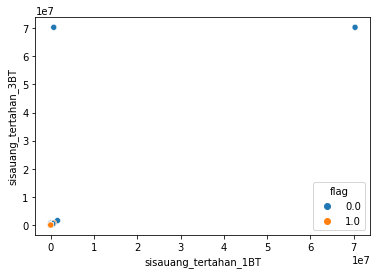

--------------------------------------------------
1335
sisauang_tertahan_1BT sisauang_tertahan_4BT


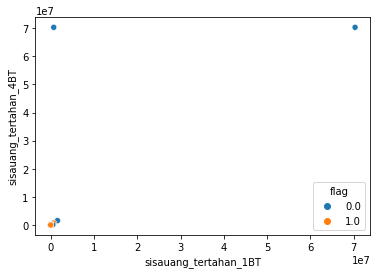

--------------------------------------------------
1336
sisauang_tertahan_1BT sisauang_tertahan_5BT


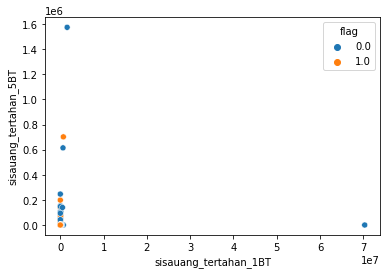

--------------------------------------------------
1337
sisauang_tertahan_1BT sisauang_tertahan_6BT


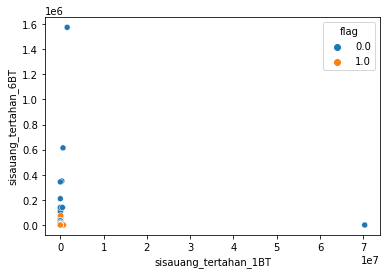

--------------------------------------------------
1338
sisauang_tertahan_1BT sisauang_tersedia_1BT


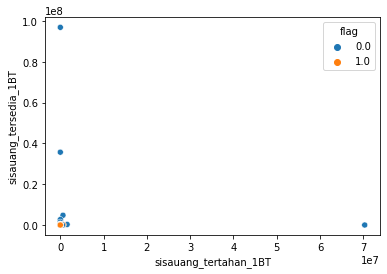

--------------------------------------------------
1339
sisauang_tertahan_1BT sisauang_tersedia_2BT


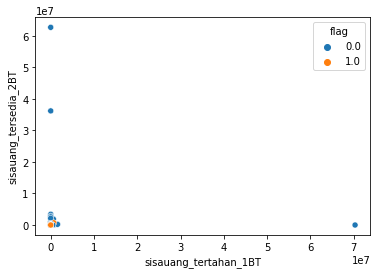

--------------------------------------------------
1340
sisauang_tertahan_1BT sisauang_tersedia_3BT


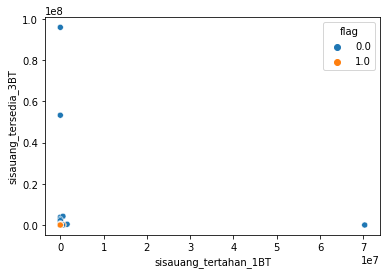

--------------------------------------------------
1341
sisauang_tertahan_1BT sisauang_tersedia_4BT


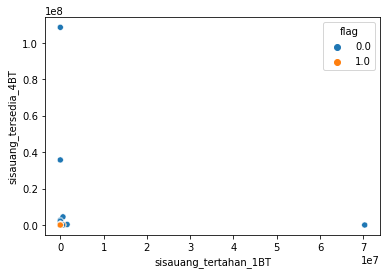

--------------------------------------------------
1342
sisauang_tertahan_1BT sisauang_tersedia_5BT


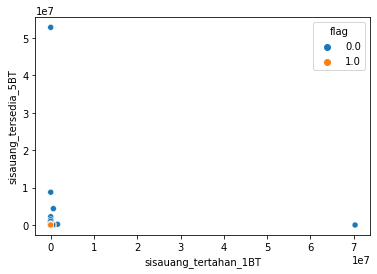

--------------------------------------------------
1343
sisauang_tertahan_1BT sisauang_tersedia_6BT


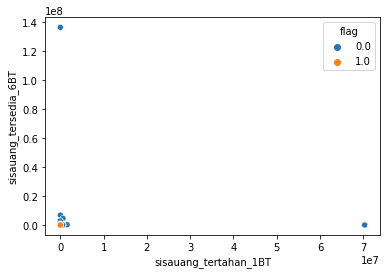

--------------------------------------------------
1344
sisauang_tertahan_1BT sisa_hutang_1BT


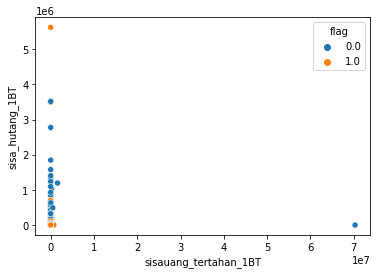

--------------------------------------------------
1345
sisauang_tertahan_1BT sisa_hutang_2BT


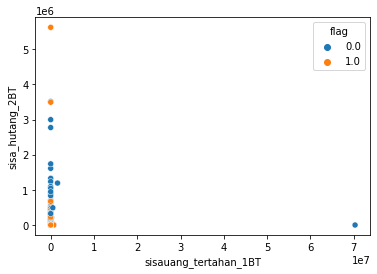

--------------------------------------------------
1346
sisauang_tertahan_1BT sisa_hutang_3BT


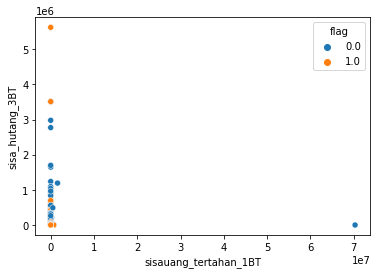

--------------------------------------------------
1347
sisauang_tertahan_1BT sisa_hutang_4BT


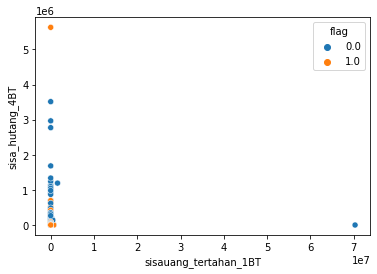

--------------------------------------------------
1348
sisauang_tertahan_1BT sisa_hutang_5BT


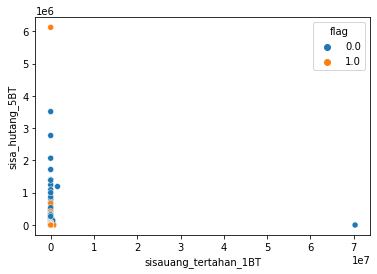

--------------------------------------------------
1349
sisauang_tertahan_1BT sisa_hutang_6BT


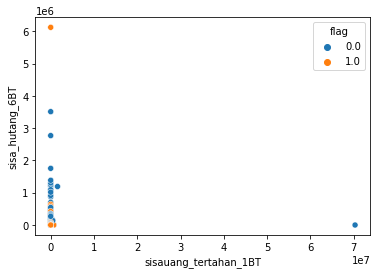

--------------------------------------------------
1350
sisauang_tertahan_1BT jumlah_pembayaran_hutang_1BT


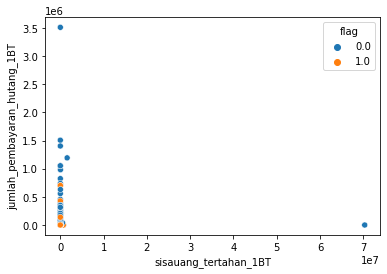

--------------------------------------------------
1351
sisauang_tertahan_1BT jumlah_pembayaran_hutang_2BT


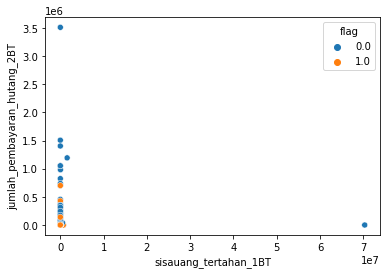

--------------------------------------------------
1352
sisauang_tertahan_1BT jumlah_pembayaran_hutang_3BT


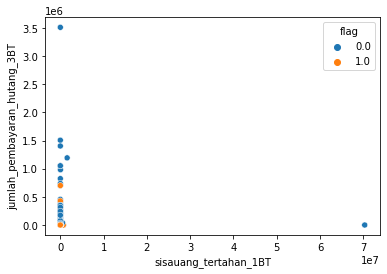

--------------------------------------------------
1353
sisauang_tertahan_1BT jumlah_pembayaran_hutang_4BT


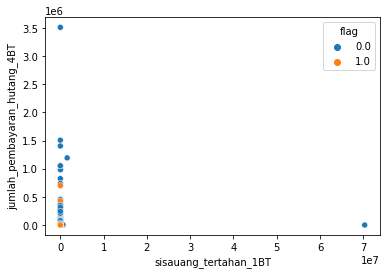

--------------------------------------------------
1354
sisauang_tertahan_1BT jumlah_pembayaran_hutang_5BT


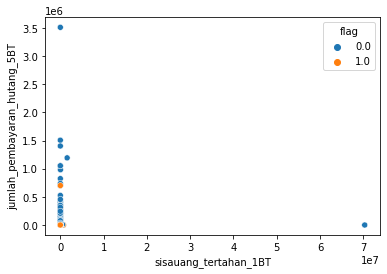

--------------------------------------------------
1355
sisauang_tertahan_1BT jumlah_pembayaran_hutang_6BT


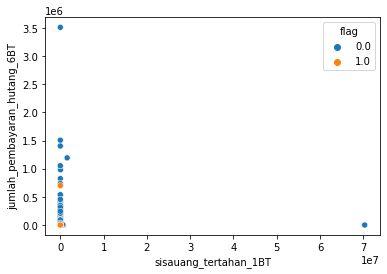

--------------------------------------------------
1356
sisauang_tertahan_1BT jumlah_pengeluaran_1BT


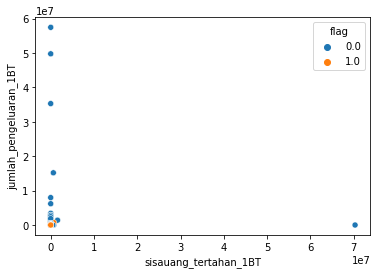

--------------------------------------------------
1357
sisauang_tertahan_1BT jumlah_pengeluaran_2BT


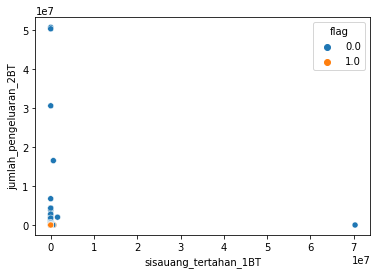

--------------------------------------------------
1358
sisauang_tertahan_1BT jumlah_pengeluaran_3BT


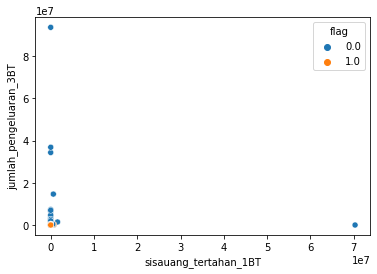

--------------------------------------------------
1359
sisauang_tertahan_1BT jumlah_pengeluaran_4BT


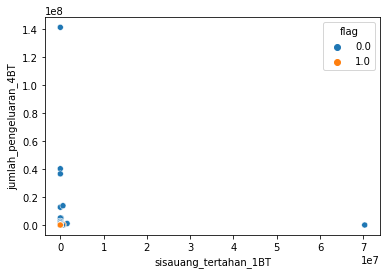

--------------------------------------------------
1360
sisauang_tertahan_1BT jumlah_pengeluaran_5BT


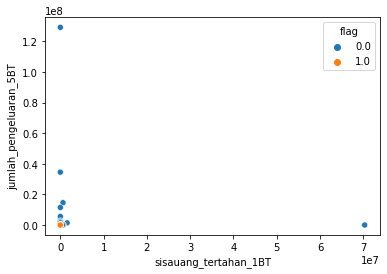

--------------------------------------------------
1361
sisauang_tertahan_1BT jumlah_pengeluaran_6BT


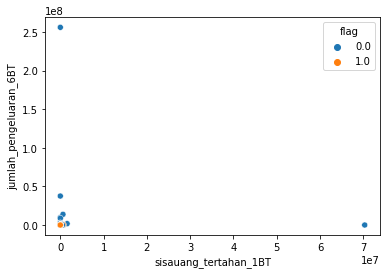

--------------------------------------------------
1362
sisauang_tertahan_1BT jumlah_pemasukan_1BT


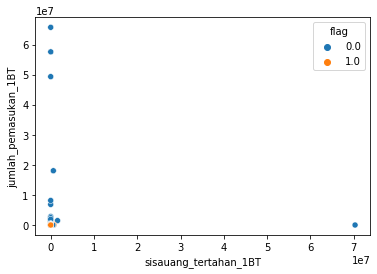

--------------------------------------------------
1363
sisauang_tertahan_1BT jumlah_pemasukan_2BT


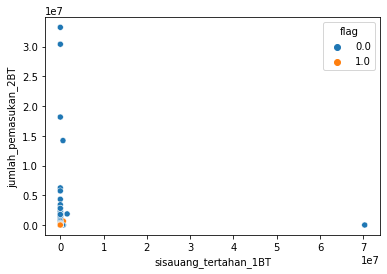

--------------------------------------------------
1364
sisauang_tertahan_1BT jumlah_pemasukan_3BT


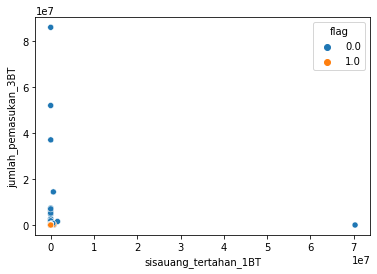

--------------------------------------------------
1365
sisauang_tertahan_1BT jumlah_pemasukan_4BT


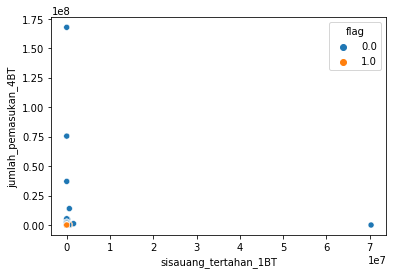

--------------------------------------------------
1366
sisauang_tertahan_1BT jumlah_pemasukan_5BT


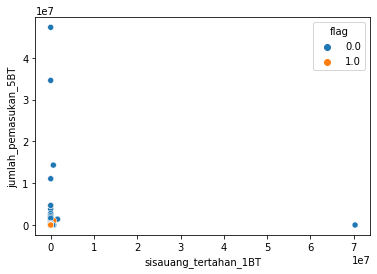

--------------------------------------------------
1367
sisauang_tertahan_1BT jumlah_pemasukan_6BT


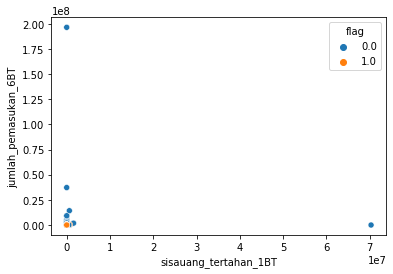

--------------------------------------------------
1368
sisauang_tertahan_1BT frekuensi_pengeluaran_1BT


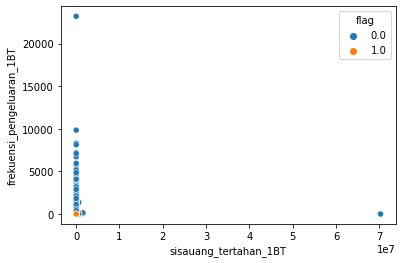

--------------------------------------------------
1369
sisauang_tertahan_1BT frekuensi_pengeluaran_2BT


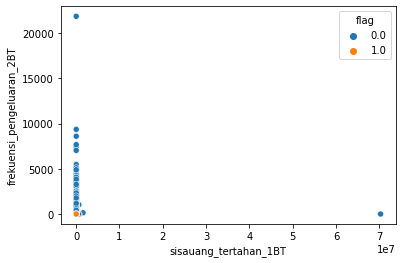

--------------------------------------------------
1370
sisauang_tertahan_1BT frekuensi_pengeluaran_3BT


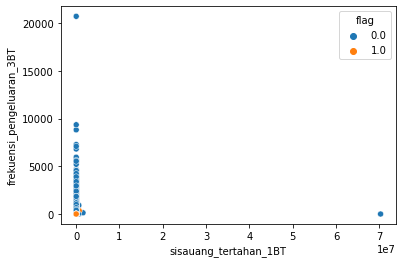

--------------------------------------------------
1371
sisauang_tertahan_1BT frekuensi_pengeluaran_4BT


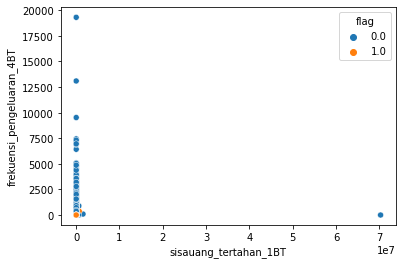

--------------------------------------------------
1372
sisauang_tertahan_1BT frekuensi_pengeluaran_5BT


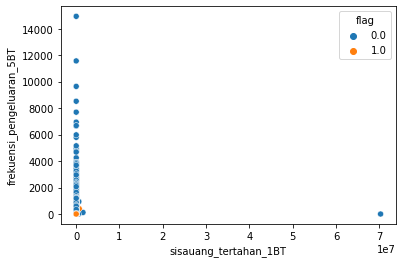

--------------------------------------------------
1373
sisauang_tertahan_1BT frekuensi_pengeluaran_6BT


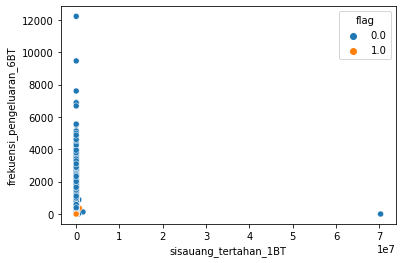

--------------------------------------------------
1374
sisauang_tertahan_1BT frekuensi_pemasukan_1BT


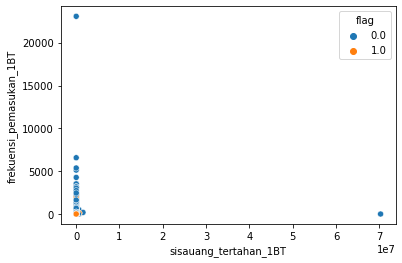

--------------------------------------------------
1375
sisauang_tertahan_1BT frekuensi_pemasukan_2BT


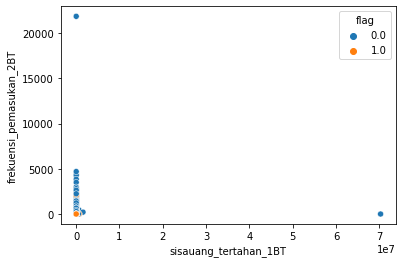

--------------------------------------------------
1376
sisauang_tertahan_1BT frekuensi_pemasukan_3BT


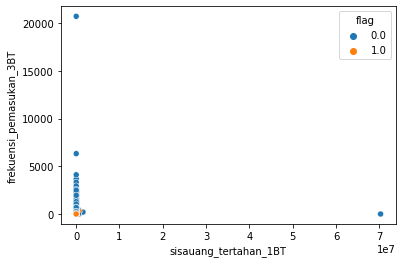

--------------------------------------------------
1377
sisauang_tertahan_1BT frekuensi_pemasukan_4BT


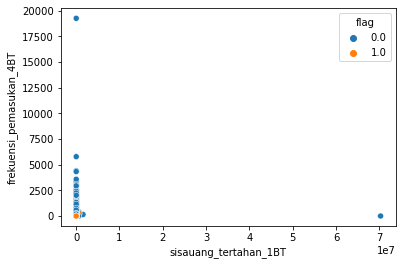

--------------------------------------------------
1378
sisauang_tertahan_1BT frekuensi_pemasukan_5BT


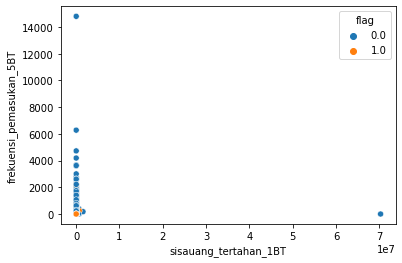

--------------------------------------------------
1379
sisauang_tertahan_1BT frekuensi_pemasukan_6BT


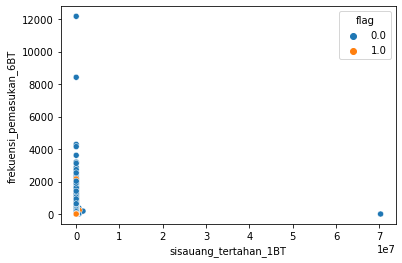

--------------------------------------------------
1380
sisauang_tertahan_1BT flag


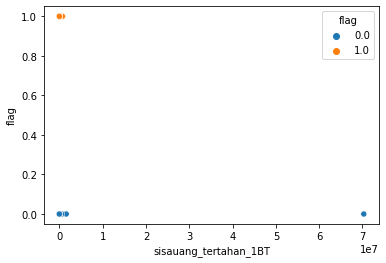

--------------------------------------------------
1381
sisauang_tertahan_2BT sisauang_tertahan_2BT


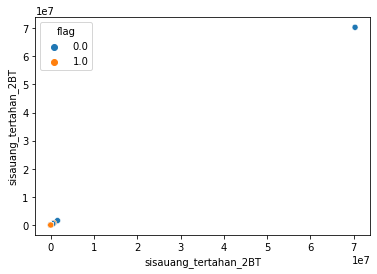

--------------------------------------------------
1382
sisauang_tertahan_2BT sisauang_tertahan_3BT


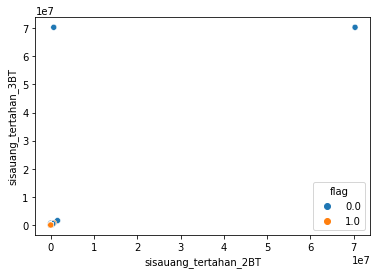

--------------------------------------------------
1383
sisauang_tertahan_2BT sisauang_tertahan_4BT


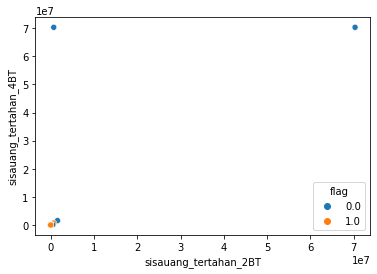

--------------------------------------------------
1384
sisauang_tertahan_2BT sisauang_tertahan_5BT


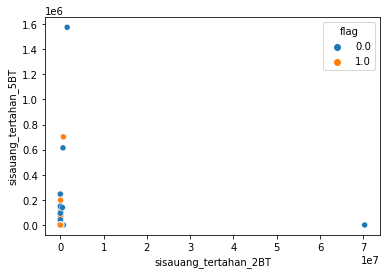

--------------------------------------------------
1385
sisauang_tertahan_2BT sisauang_tertahan_6BT


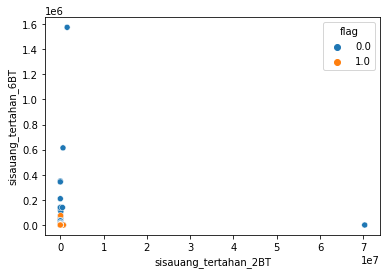

--------------------------------------------------
1386
sisauang_tertahan_2BT sisauang_tersedia_1BT


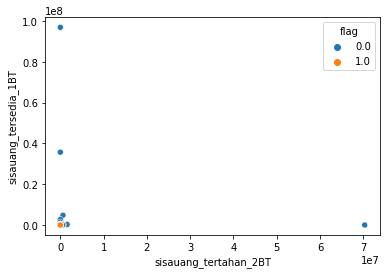

--------------------------------------------------
1387
sisauang_tertahan_2BT sisauang_tersedia_2BT


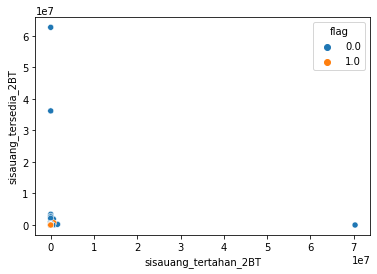

--------------------------------------------------
1388
sisauang_tertahan_2BT sisauang_tersedia_3BT


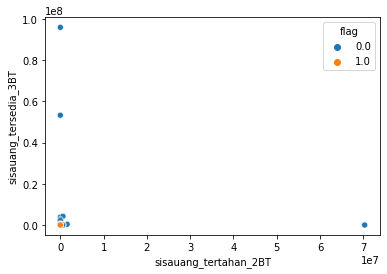

--------------------------------------------------
1389
sisauang_tertahan_2BT sisauang_tersedia_4BT


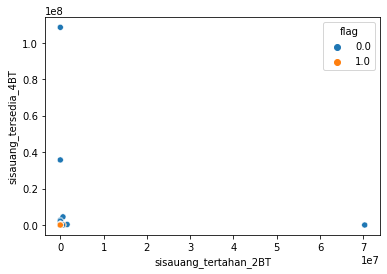

--------------------------------------------------
1390
sisauang_tertahan_2BT sisauang_tersedia_5BT


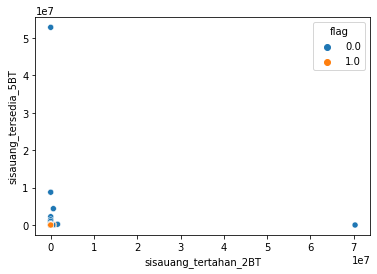

--------------------------------------------------
1391
sisauang_tertahan_2BT sisauang_tersedia_6BT


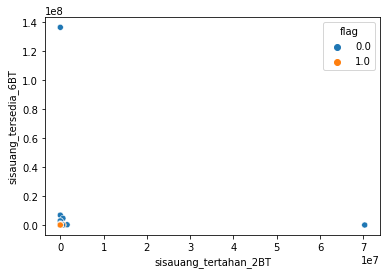

--------------------------------------------------
1392
sisauang_tertahan_2BT sisa_hutang_1BT


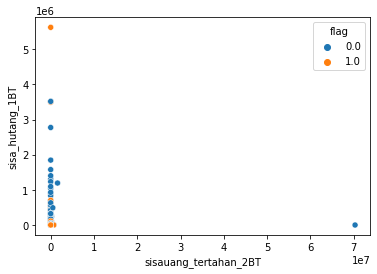

--------------------------------------------------
1393
sisauang_tertahan_2BT sisa_hutang_2BT


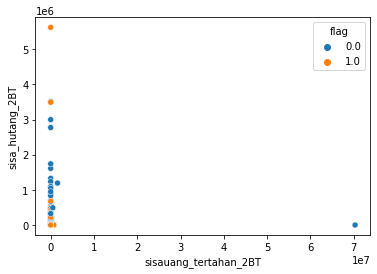

--------------------------------------------------
1394
sisauang_tertahan_2BT sisa_hutang_3BT


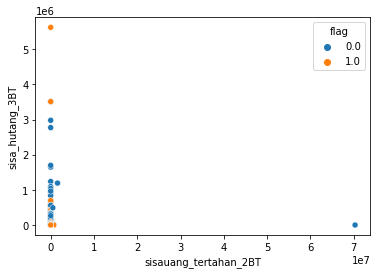

--------------------------------------------------
1395
sisauang_tertahan_2BT sisa_hutang_4BT


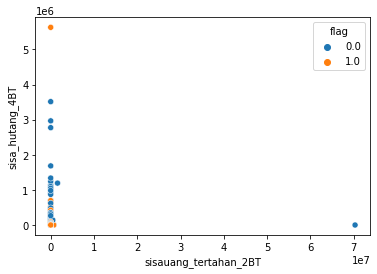

--------------------------------------------------
1396
sisauang_tertahan_2BT sisa_hutang_5BT


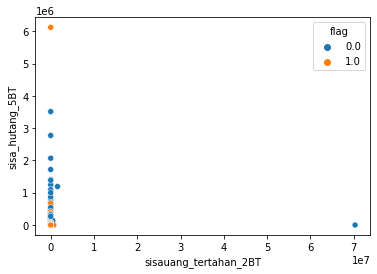

--------------------------------------------------
1397
sisauang_tertahan_2BT sisa_hutang_6BT


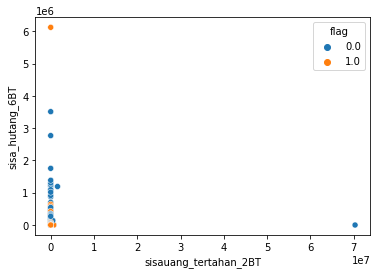

--------------------------------------------------
1398
sisauang_tertahan_2BT jumlah_pembayaran_hutang_1BT


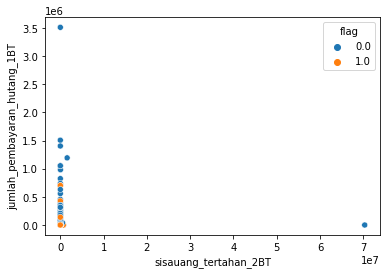

--------------------------------------------------
1399
sisauang_tertahan_2BT jumlah_pembayaran_hutang_2BT


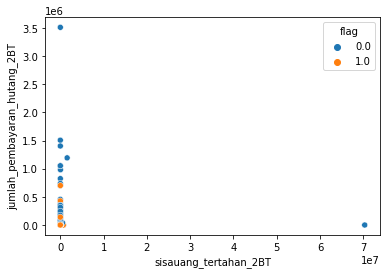

--------------------------------------------------
1400
sisauang_tertahan_2BT jumlah_pembayaran_hutang_3BT


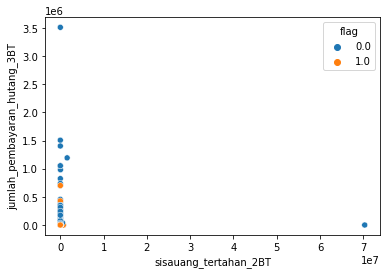

--------------------------------------------------
1401
sisauang_tertahan_2BT jumlah_pembayaran_hutang_4BT


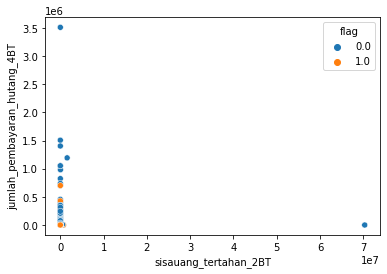

--------------------------------------------------
1402
sisauang_tertahan_2BT jumlah_pembayaran_hutang_5BT


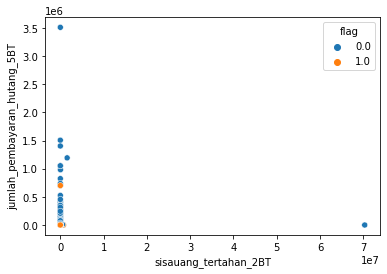

--------------------------------------------------
1403
sisauang_tertahan_2BT jumlah_pembayaran_hutang_6BT


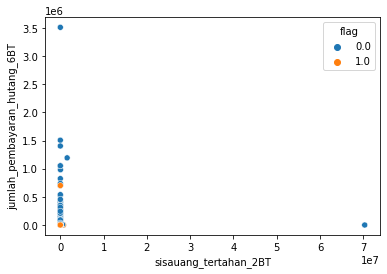

--------------------------------------------------
1404
sisauang_tertahan_2BT jumlah_pengeluaran_1BT


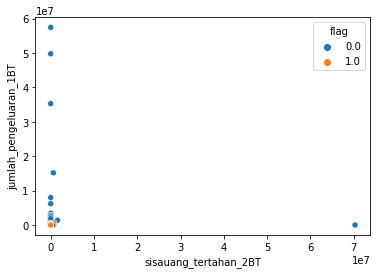

--------------------------------------------------
1405
sisauang_tertahan_2BT jumlah_pengeluaran_2BT


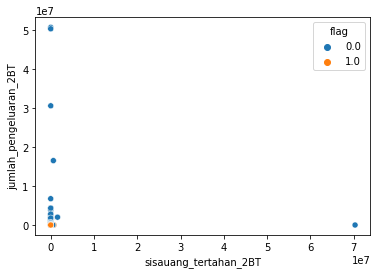

--------------------------------------------------
1406
sisauang_tertahan_2BT jumlah_pengeluaran_3BT


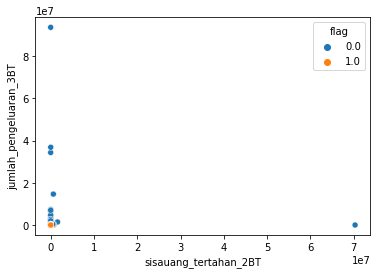

--------------------------------------------------
1407
sisauang_tertahan_2BT jumlah_pengeluaran_4BT


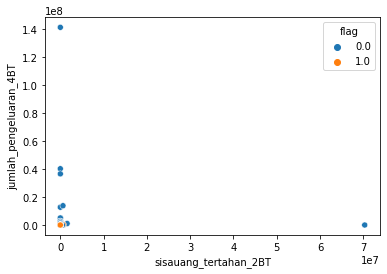

--------------------------------------------------
1408
sisauang_tertahan_2BT jumlah_pengeluaran_5BT


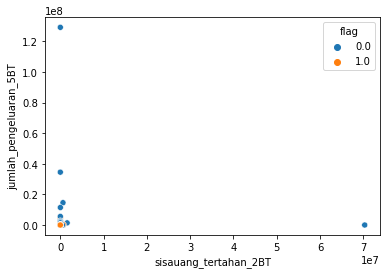

--------------------------------------------------
1409
sisauang_tertahan_2BT jumlah_pengeluaran_6BT


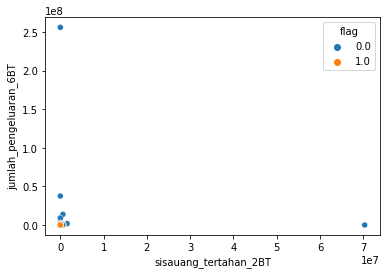

--------------------------------------------------
1410
sisauang_tertahan_2BT jumlah_pemasukan_1BT


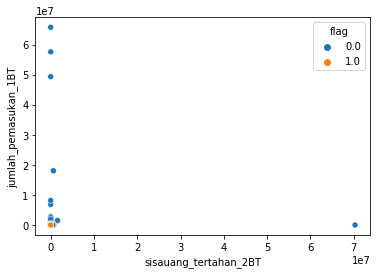

--------------------------------------------------
1411
sisauang_tertahan_2BT jumlah_pemasukan_2BT


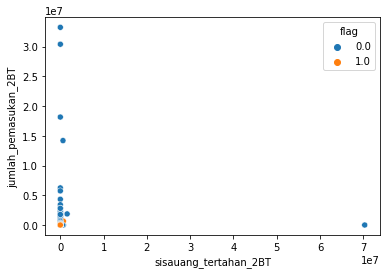

--------------------------------------------------
1412
sisauang_tertahan_2BT jumlah_pemasukan_3BT


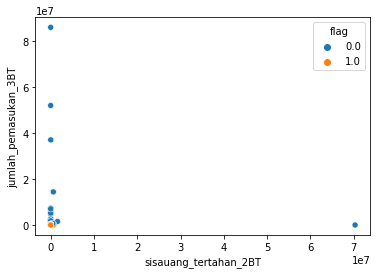

--------------------------------------------------
1413
sisauang_tertahan_2BT jumlah_pemasukan_4BT


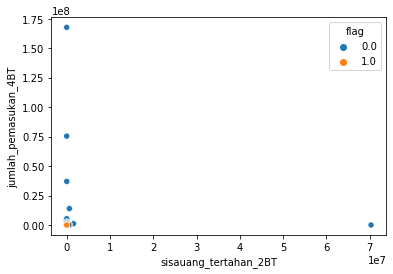

--------------------------------------------------
1414
sisauang_tertahan_2BT jumlah_pemasukan_5BT


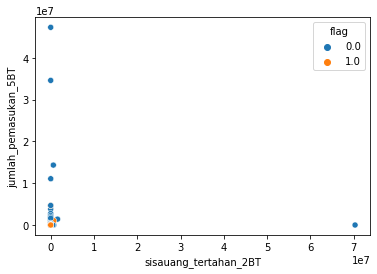

--------------------------------------------------
1415
sisauang_tertahan_2BT jumlah_pemasukan_6BT


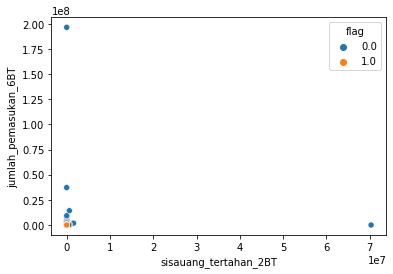

--------------------------------------------------
1416
sisauang_tertahan_2BT frekuensi_pengeluaran_1BT


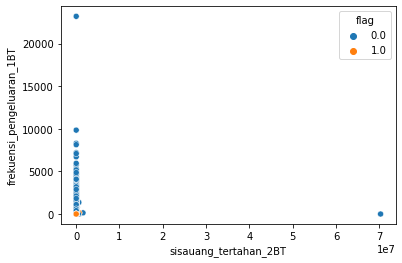

--------------------------------------------------
1417
sisauang_tertahan_2BT frekuensi_pengeluaran_2BT


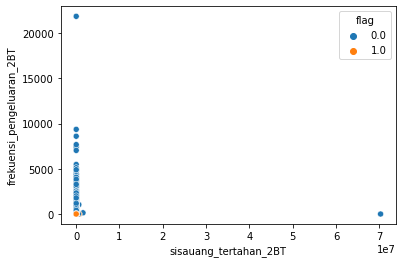

--------------------------------------------------
1418
sisauang_tertahan_2BT frekuensi_pengeluaran_3BT


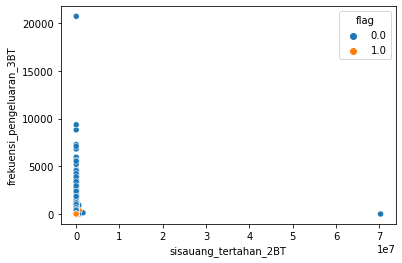

--------------------------------------------------
1419
sisauang_tertahan_2BT frekuensi_pengeluaran_4BT


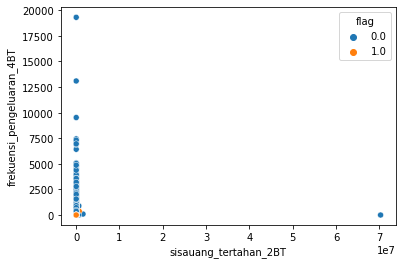

--------------------------------------------------
1420
sisauang_tertahan_2BT frekuensi_pengeluaran_5BT


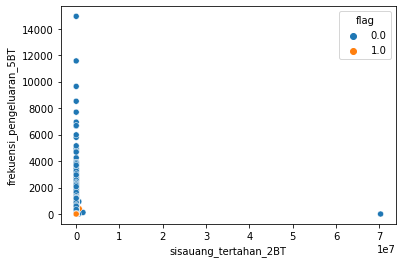

--------------------------------------------------
1421
sisauang_tertahan_2BT frekuensi_pengeluaran_6BT


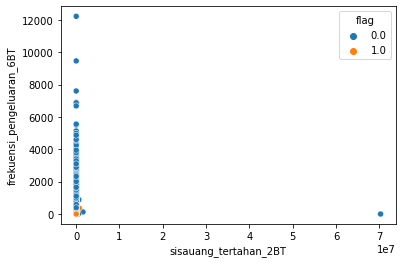

--------------------------------------------------
1422
sisauang_tertahan_2BT frekuensi_pemasukan_1BT


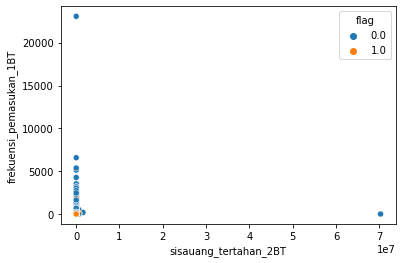

--------------------------------------------------
1423
sisauang_tertahan_2BT frekuensi_pemasukan_2BT


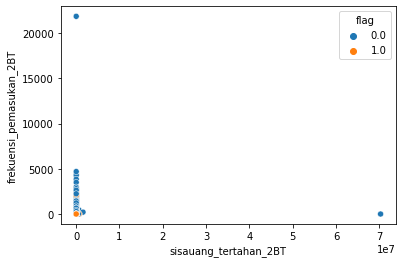

--------------------------------------------------
1424
sisauang_tertahan_2BT frekuensi_pemasukan_3BT


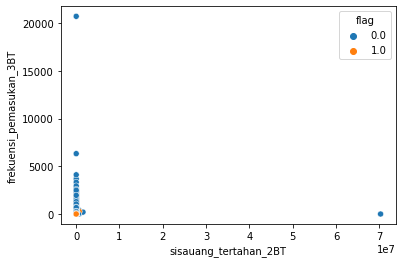

--------------------------------------------------
1425
sisauang_tertahan_2BT frekuensi_pemasukan_4BT


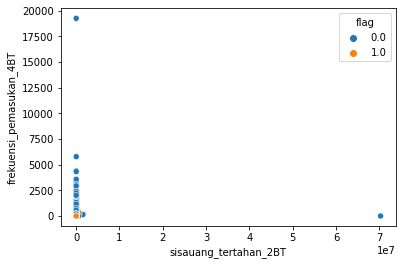

--------------------------------------------------
1426
sisauang_tertahan_2BT frekuensi_pemasukan_5BT


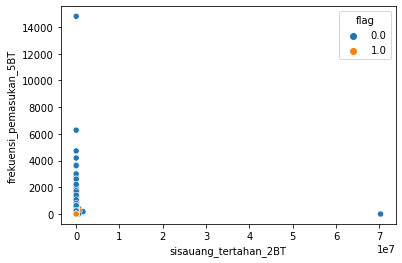

--------------------------------------------------
1427
sisauang_tertahan_2BT frekuensi_pemasukan_6BT


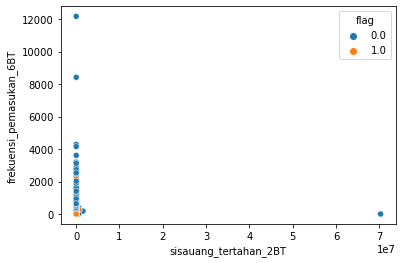

--------------------------------------------------
1428
sisauang_tertahan_2BT flag


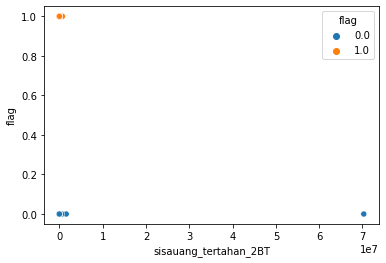

--------------------------------------------------
1429
sisauang_tertahan_3BT sisauang_tertahan_3BT


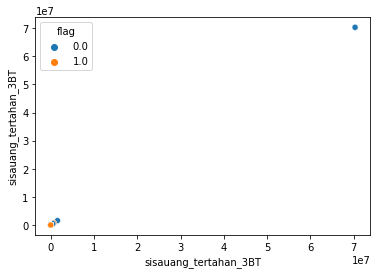

--------------------------------------------------
1430
sisauang_tertahan_3BT sisauang_tertahan_4BT


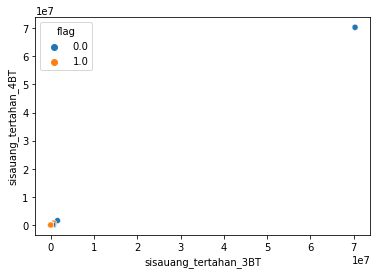

--------------------------------------------------
1431
sisauang_tertahan_3BT sisauang_tertahan_5BT


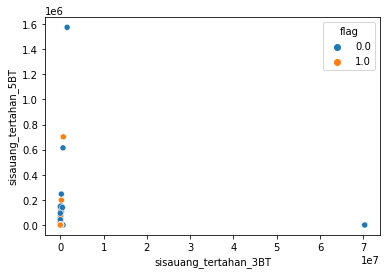

--------------------------------------------------
1432
sisauang_tertahan_3BT sisauang_tertahan_6BT


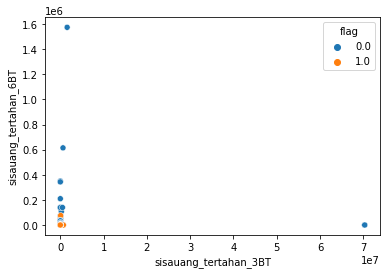

--------------------------------------------------
1433
sisauang_tertahan_3BT sisauang_tersedia_1BT


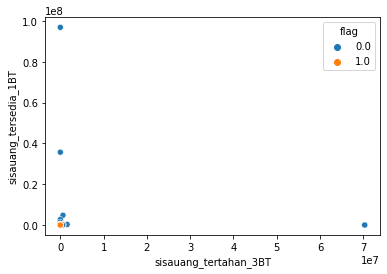

--------------------------------------------------
1434
sisauang_tertahan_3BT sisauang_tersedia_2BT


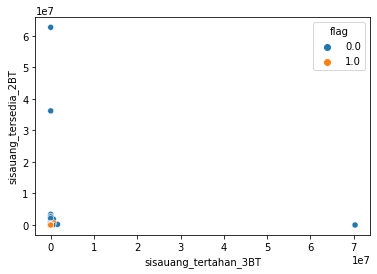

--------------------------------------------------
1435
sisauang_tertahan_3BT sisauang_tersedia_3BT


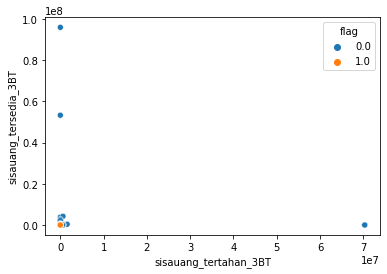

--------------------------------------------------
1436
sisauang_tertahan_3BT sisauang_tersedia_4BT


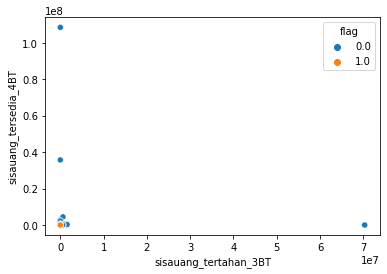

--------------------------------------------------
1437
sisauang_tertahan_3BT sisauang_tersedia_5BT


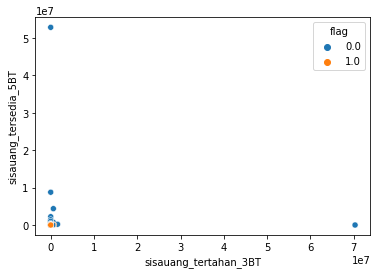

--------------------------------------------------
1438
sisauang_tertahan_3BT sisauang_tersedia_6BT


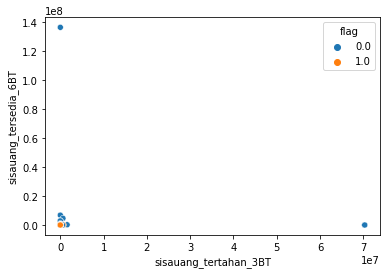

--------------------------------------------------
1439
sisauang_tertahan_3BT sisa_hutang_1BT


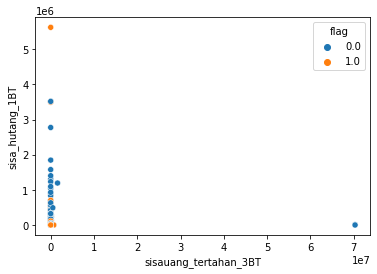

--------------------------------------------------
1440
sisauang_tertahan_3BT sisa_hutang_2BT


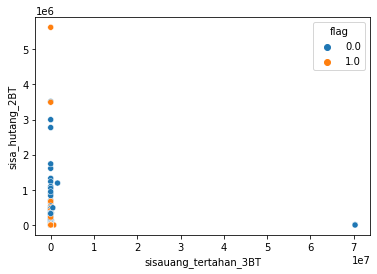

--------------------------------------------------
1441
sisauang_tertahan_3BT sisa_hutang_3BT


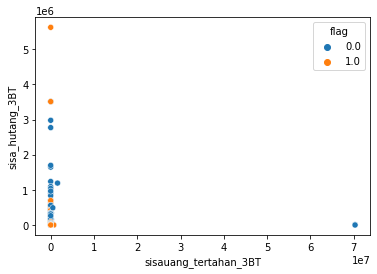

--------------------------------------------------
1442
sisauang_tertahan_3BT sisa_hutang_4BT


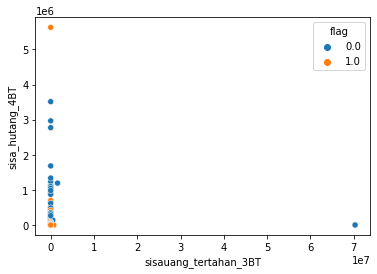

--------------------------------------------------
1443
sisauang_tertahan_3BT sisa_hutang_5BT


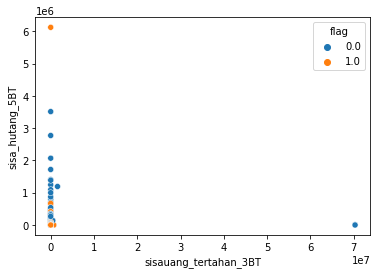

--------------------------------------------------
1444
sisauang_tertahan_3BT sisa_hutang_6BT


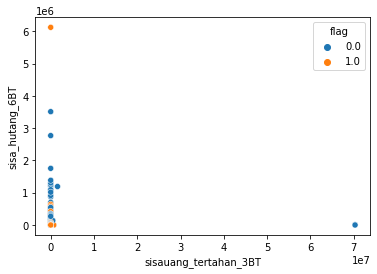

--------------------------------------------------
1445
sisauang_tertahan_3BT jumlah_pembayaran_hutang_1BT


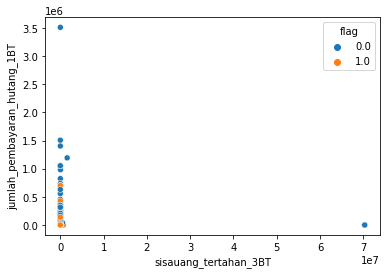

--------------------------------------------------
1446
sisauang_tertahan_3BT jumlah_pembayaran_hutang_2BT


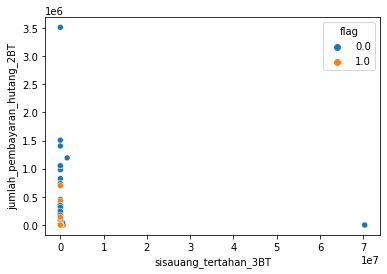

--------------------------------------------------
1447
sisauang_tertahan_3BT jumlah_pembayaran_hutang_3BT


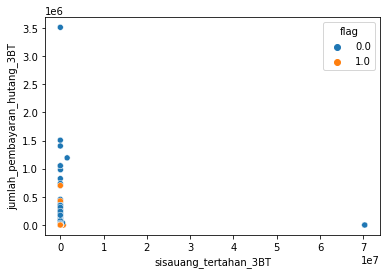

--------------------------------------------------
1448
sisauang_tertahan_3BT jumlah_pembayaran_hutang_4BT


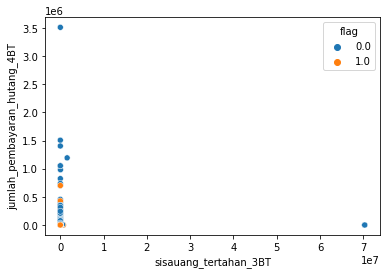

--------------------------------------------------
1449
sisauang_tertahan_3BT jumlah_pembayaran_hutang_5BT


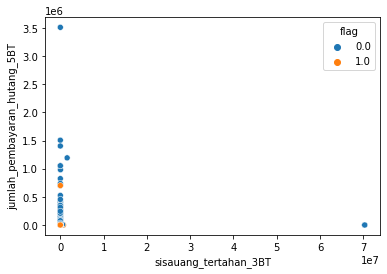

--------------------------------------------------
1450
sisauang_tertahan_3BT jumlah_pembayaran_hutang_6BT


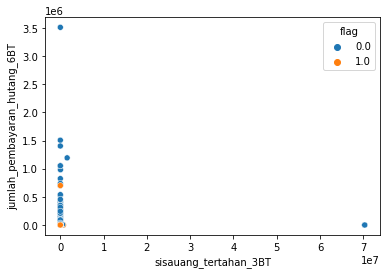

--------------------------------------------------
1451
sisauang_tertahan_3BT jumlah_pengeluaran_1BT


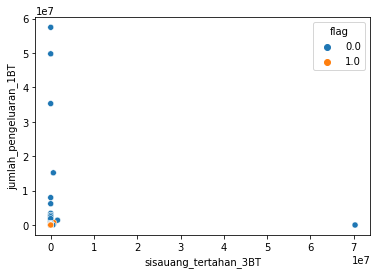

--------------------------------------------------
1452
sisauang_tertahan_3BT jumlah_pengeluaran_2BT


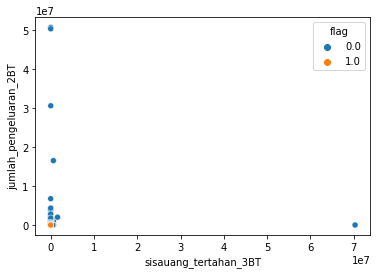

--------------------------------------------------
1453
sisauang_tertahan_3BT jumlah_pengeluaran_3BT


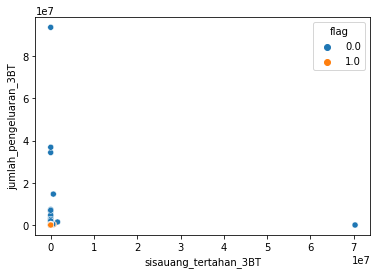

--------------------------------------------------
1454
sisauang_tertahan_3BT jumlah_pengeluaran_4BT


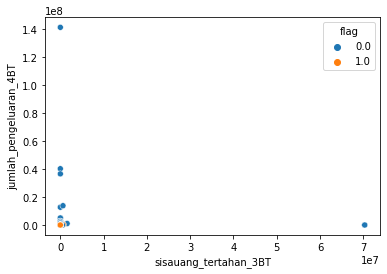

--------------------------------------------------
1455
sisauang_tertahan_3BT jumlah_pengeluaran_5BT


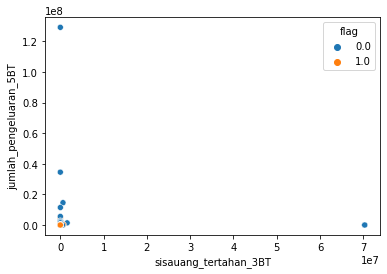

--------------------------------------------------
1456
sisauang_tertahan_3BT jumlah_pengeluaran_6BT


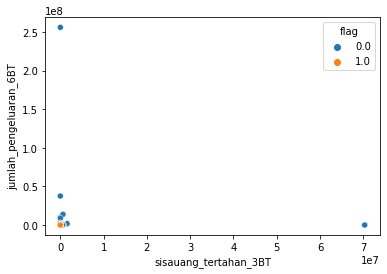

--------------------------------------------------
1457
sisauang_tertahan_3BT jumlah_pemasukan_1BT


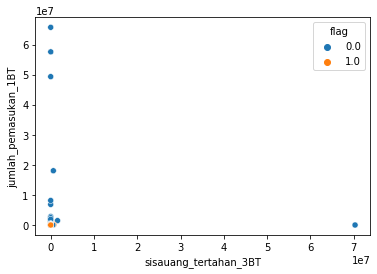

--------------------------------------------------
1458
sisauang_tertahan_3BT jumlah_pemasukan_2BT


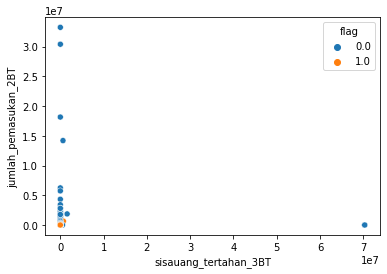

--------------------------------------------------
1459
sisauang_tertahan_3BT jumlah_pemasukan_3BT


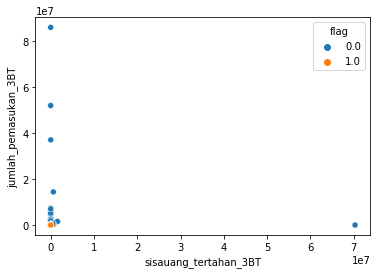

--------------------------------------------------
1460
sisauang_tertahan_3BT jumlah_pemasukan_4BT


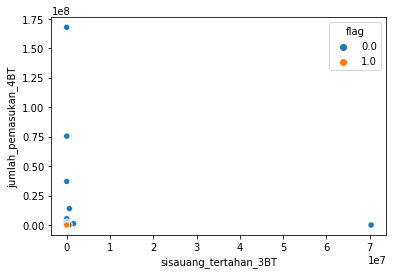

--------------------------------------------------
1461
sisauang_tertahan_3BT jumlah_pemasukan_5BT


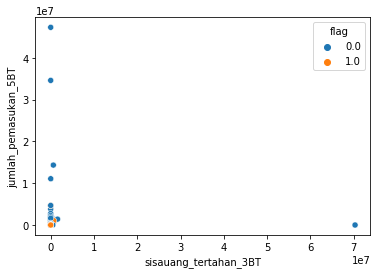

--------------------------------------------------
1462
sisauang_tertahan_3BT jumlah_pemasukan_6BT


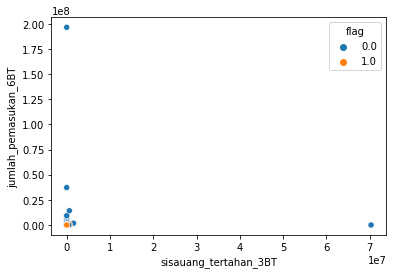

--------------------------------------------------
1463
sisauang_tertahan_3BT frekuensi_pengeluaran_1BT


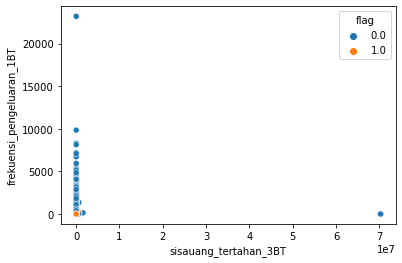

--------------------------------------------------
1464
sisauang_tertahan_3BT frekuensi_pengeluaran_2BT


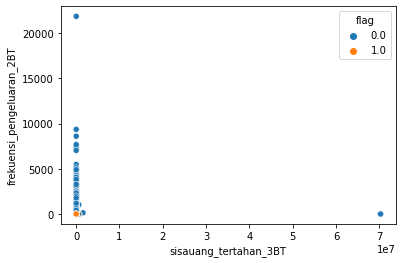

--------------------------------------------------
1465
sisauang_tertahan_3BT frekuensi_pengeluaran_3BT


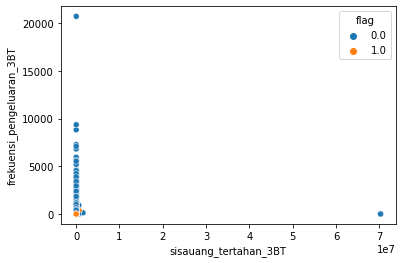

--------------------------------------------------
1466
sisauang_tertahan_3BT frekuensi_pengeluaran_4BT


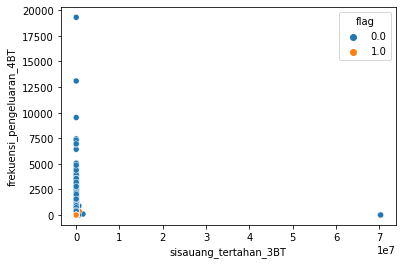

--------------------------------------------------
1467
sisauang_tertahan_3BT frekuensi_pengeluaran_5BT


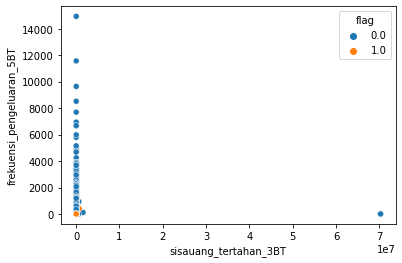

--------------------------------------------------
1468
sisauang_tertahan_3BT frekuensi_pengeluaran_6BT


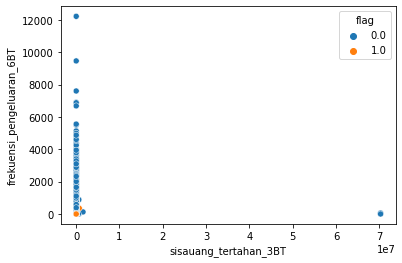

--------------------------------------------------
1469
sisauang_tertahan_3BT frekuensi_pemasukan_1BT


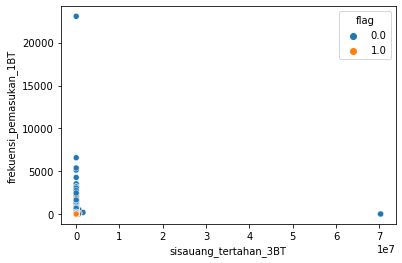

--------------------------------------------------
1470
sisauang_tertahan_3BT frekuensi_pemasukan_2BT


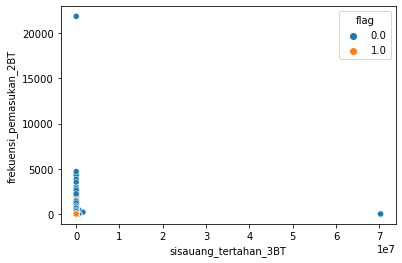

--------------------------------------------------
1471
sisauang_tertahan_3BT frekuensi_pemasukan_3BT


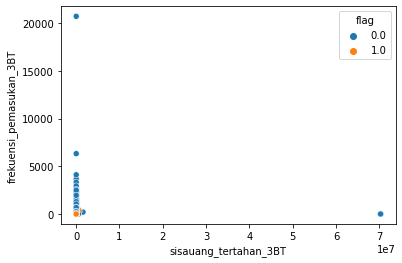

--------------------------------------------------
1472
sisauang_tertahan_3BT frekuensi_pemasukan_4BT


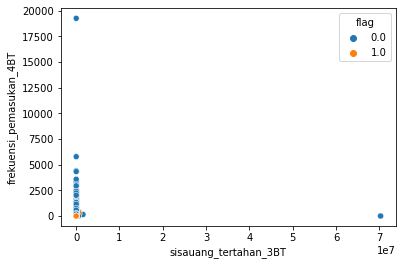

--------------------------------------------------
1473
sisauang_tertahan_3BT frekuensi_pemasukan_5BT


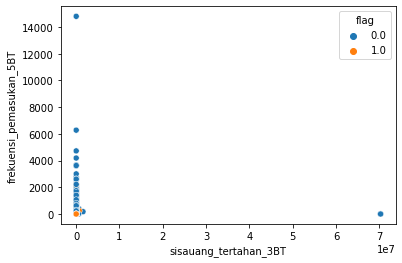

--------------------------------------------------
1474
sisauang_tertahan_3BT frekuensi_pemasukan_6BT


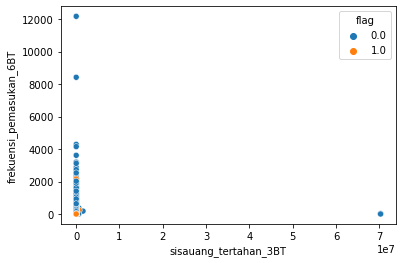

--------------------------------------------------
1475
sisauang_tertahan_3BT flag


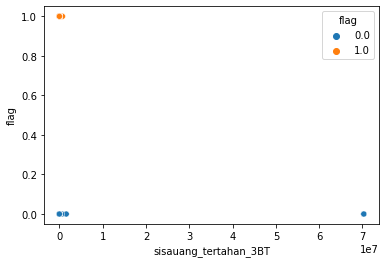

--------------------------------------------------
1476
sisauang_tertahan_4BT sisauang_tertahan_4BT


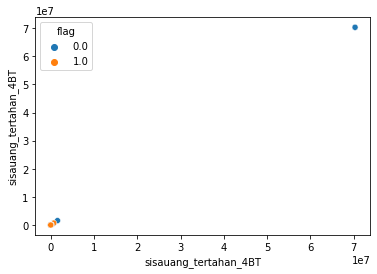

--------------------------------------------------
1477
sisauang_tertahan_4BT sisauang_tertahan_5BT


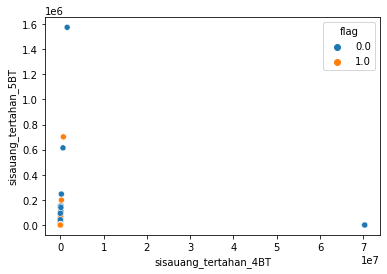

--------------------------------------------------
1478
sisauang_tertahan_4BT sisauang_tertahan_6BT


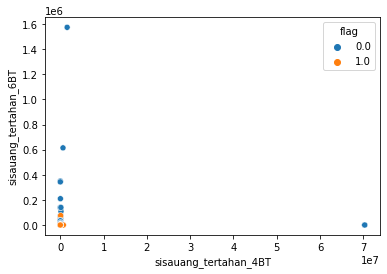

--------------------------------------------------
1479
sisauang_tertahan_4BT sisauang_tersedia_1BT


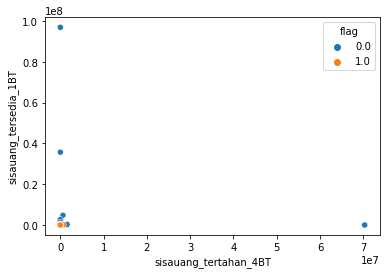

--------------------------------------------------
1480
sisauang_tertahan_4BT sisauang_tersedia_2BT


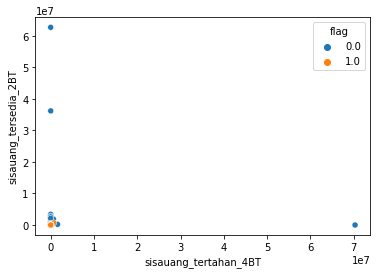

--------------------------------------------------
1481
sisauang_tertahan_4BT sisauang_tersedia_3BT


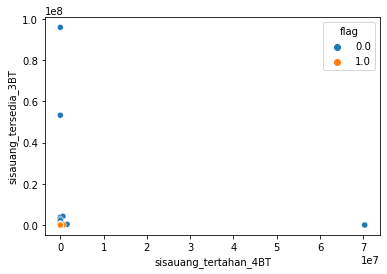

--------------------------------------------------
1482
sisauang_tertahan_4BT sisauang_tersedia_4BT


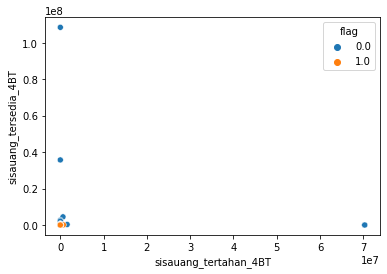

--------------------------------------------------
1483
sisauang_tertahan_4BT sisauang_tersedia_5BT


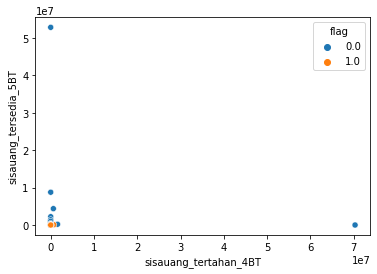

--------------------------------------------------
1484
sisauang_tertahan_4BT sisauang_tersedia_6BT


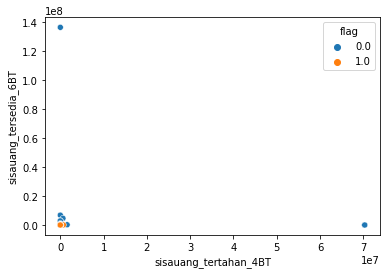

--------------------------------------------------
1485
sisauang_tertahan_4BT sisa_hutang_1BT


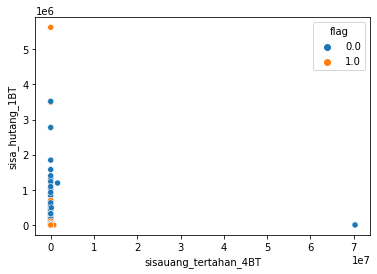

--------------------------------------------------
1486
sisauang_tertahan_4BT sisa_hutang_2BT


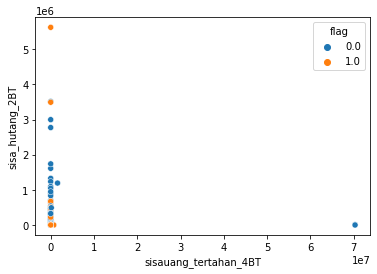

--------------------------------------------------
1487
sisauang_tertahan_4BT sisa_hutang_3BT


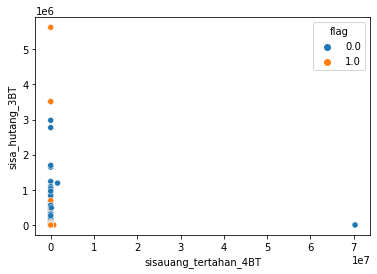

--------------------------------------------------
1488
sisauang_tertahan_4BT sisa_hutang_4BT


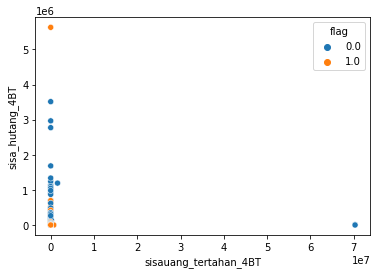

--------------------------------------------------
1489
sisauang_tertahan_4BT sisa_hutang_5BT


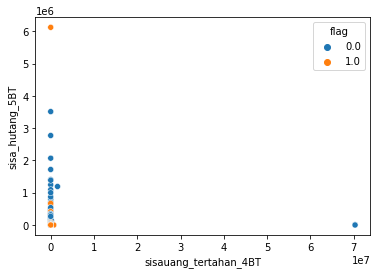

--------------------------------------------------
1490
sisauang_tertahan_4BT sisa_hutang_6BT


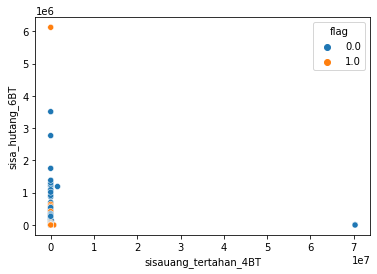

--------------------------------------------------
1491
sisauang_tertahan_4BT jumlah_pembayaran_hutang_1BT


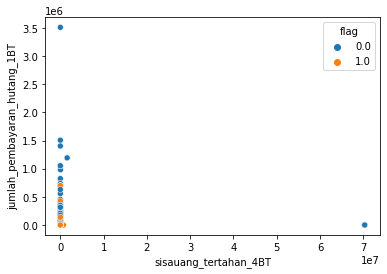

--------------------------------------------------
1492
sisauang_tertahan_4BT jumlah_pembayaran_hutang_2BT


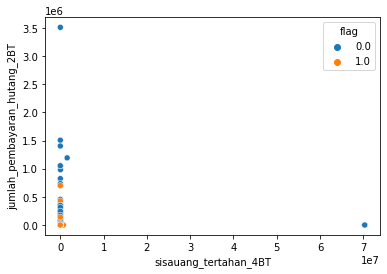

--------------------------------------------------
1493
sisauang_tertahan_4BT jumlah_pembayaran_hutang_3BT


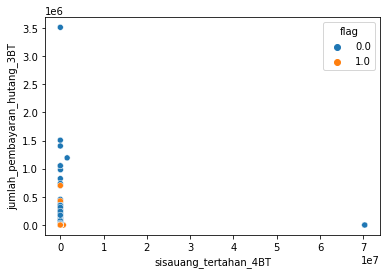

--------------------------------------------------
1494
sisauang_tertahan_4BT jumlah_pembayaran_hutang_4BT


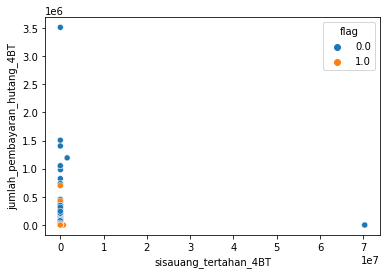

--------------------------------------------------
1495
sisauang_tertahan_4BT jumlah_pembayaran_hutang_5BT


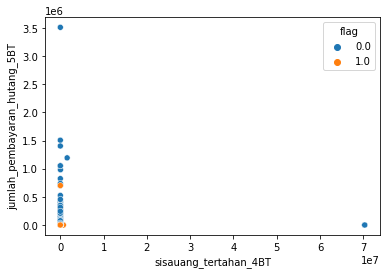

--------------------------------------------------
1496
sisauang_tertahan_4BT jumlah_pembayaran_hutang_6BT


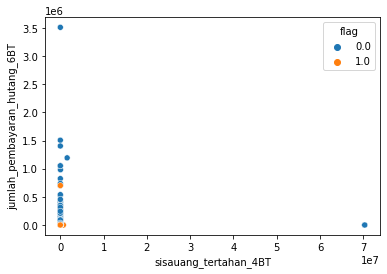

--------------------------------------------------
1497
sisauang_tertahan_4BT jumlah_pengeluaran_1BT


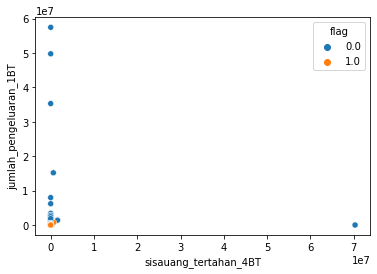

--------------------------------------------------
1498
sisauang_tertahan_4BT jumlah_pengeluaran_2BT


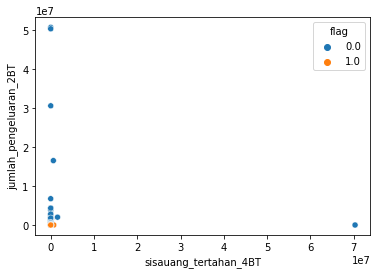

--------------------------------------------------
1499
sisauang_tertahan_4BT jumlah_pengeluaran_3BT


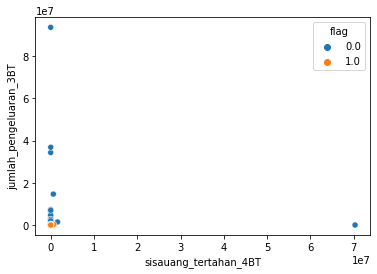

--------------------------------------------------
1500
sisauang_tertahan_4BT jumlah_pengeluaran_4BT


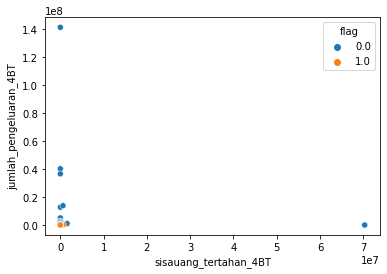

--------------------------------------------------
1501
sisauang_tertahan_4BT jumlah_pengeluaran_5BT


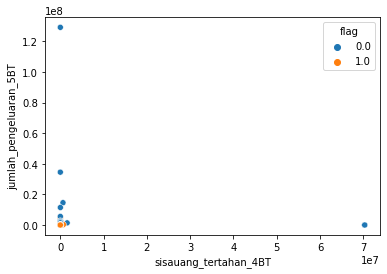

--------------------------------------------------
1502
sisauang_tertahan_4BT jumlah_pengeluaran_6BT


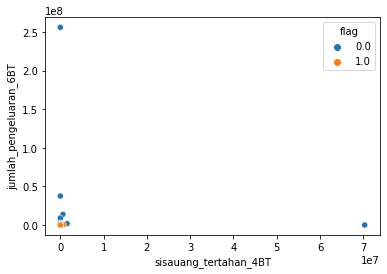

--------------------------------------------------
1503
sisauang_tertahan_4BT jumlah_pemasukan_1BT


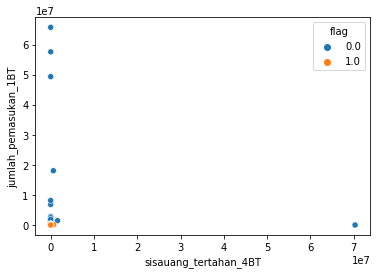

--------------------------------------------------
1504
sisauang_tertahan_4BT jumlah_pemasukan_2BT


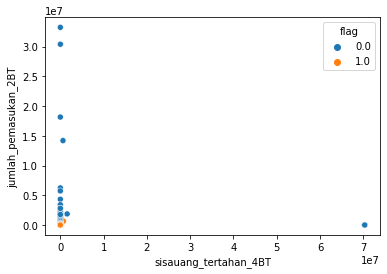

--------------------------------------------------
1505
sisauang_tertahan_4BT jumlah_pemasukan_3BT


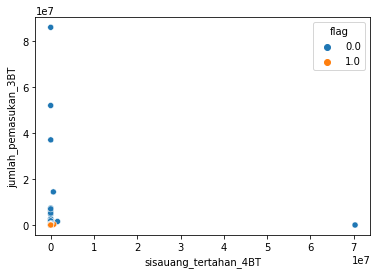

--------------------------------------------------
1506
sisauang_tertahan_4BT jumlah_pemasukan_4BT


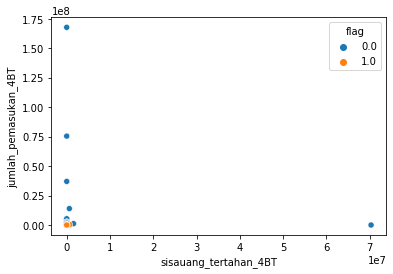

--------------------------------------------------
1507
sisauang_tertahan_4BT jumlah_pemasukan_5BT


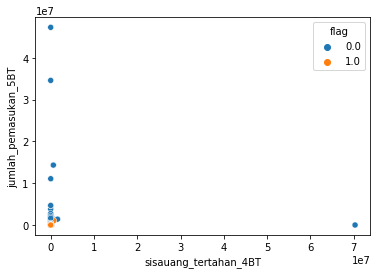

--------------------------------------------------
1508
sisauang_tertahan_4BT jumlah_pemasukan_6BT


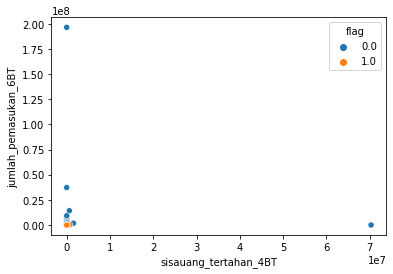

--------------------------------------------------
1509
sisauang_tertahan_4BT frekuensi_pengeluaran_1BT


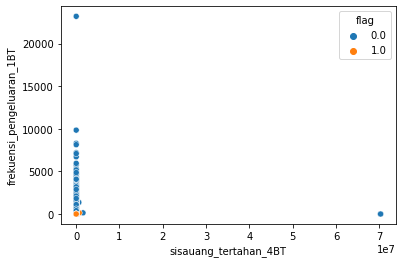

--------------------------------------------------
1510
sisauang_tertahan_4BT frekuensi_pengeluaran_2BT


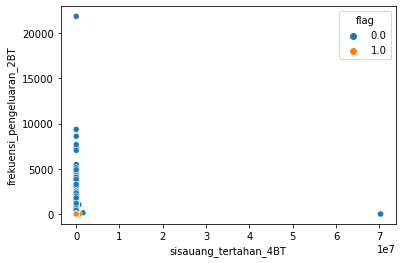

--------------------------------------------------
1511
sisauang_tertahan_4BT frekuensi_pengeluaran_3BT


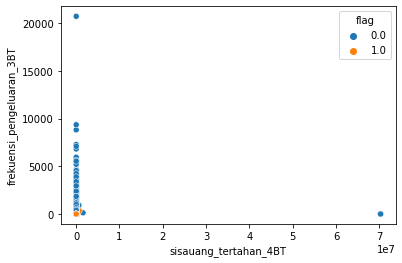

--------------------------------------------------
1512
sisauang_tertahan_4BT frekuensi_pengeluaran_4BT


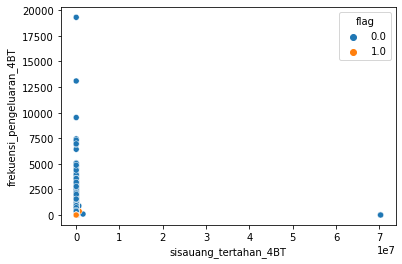

--------------------------------------------------
1513
sisauang_tertahan_4BT frekuensi_pengeluaran_5BT


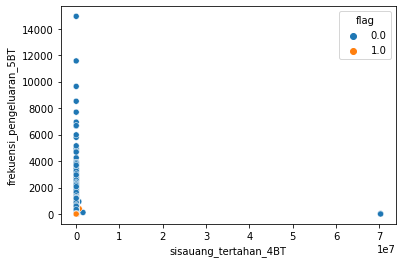

--------------------------------------------------
1514
sisauang_tertahan_4BT frekuensi_pengeluaran_6BT


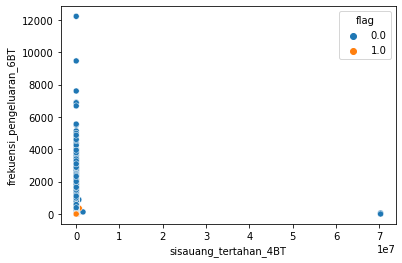

--------------------------------------------------
1515
sisauang_tertahan_4BT frekuensi_pemasukan_1BT


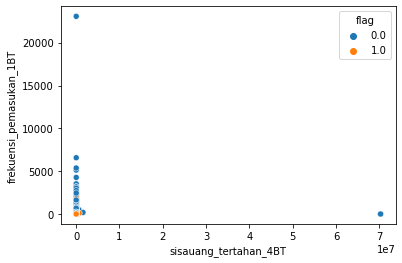

--------------------------------------------------
1516
sisauang_tertahan_4BT frekuensi_pemasukan_2BT


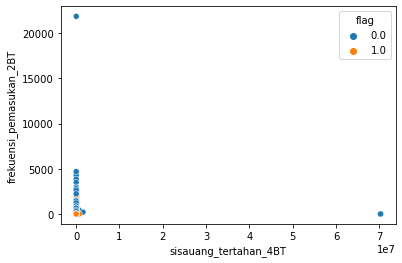

--------------------------------------------------
1517
sisauang_tertahan_4BT frekuensi_pemasukan_3BT


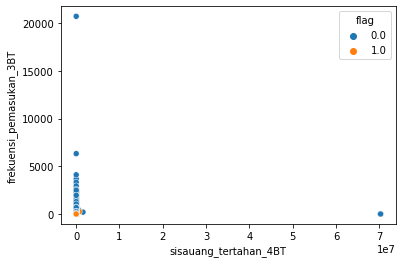

--------------------------------------------------
1518
sisauang_tertahan_4BT frekuensi_pemasukan_4BT


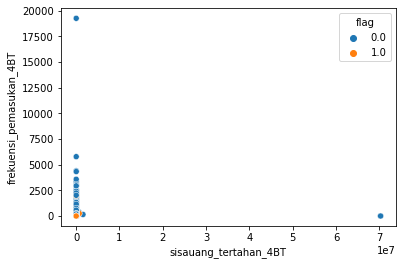

--------------------------------------------------
1519
sisauang_tertahan_4BT frekuensi_pemasukan_5BT


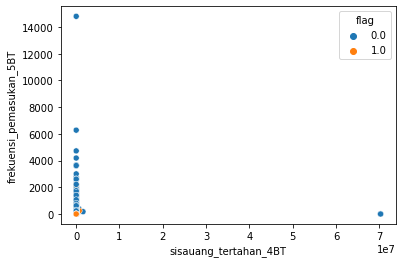

--------------------------------------------------
1520
sisauang_tertahan_4BT frekuensi_pemasukan_6BT


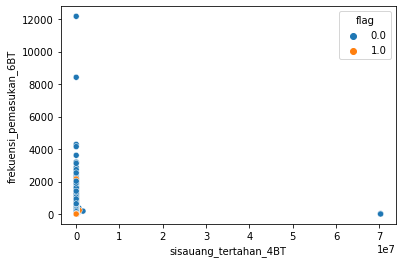

--------------------------------------------------
1521
sisauang_tertahan_4BT flag


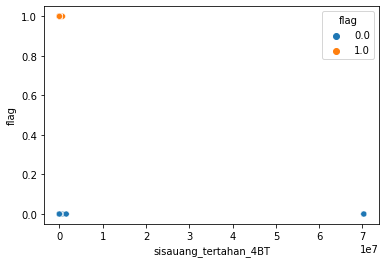

--------------------------------------------------
1522
sisauang_tertahan_5BT sisauang_tertahan_5BT


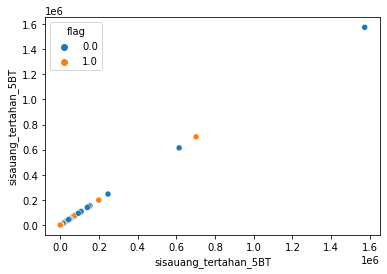

--------------------------------------------------
1523
sisauang_tertahan_5BT sisauang_tertahan_6BT


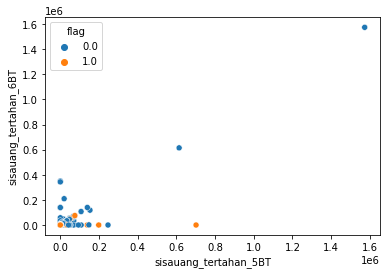

--------------------------------------------------
1524
sisauang_tertahan_5BT sisauang_tersedia_1BT


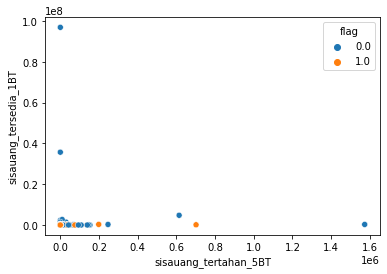

--------------------------------------------------
1525
sisauang_tertahan_5BT sisauang_tersedia_2BT


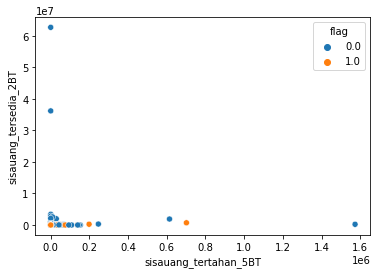

--------------------------------------------------
1526
sisauang_tertahan_5BT sisauang_tersedia_3BT


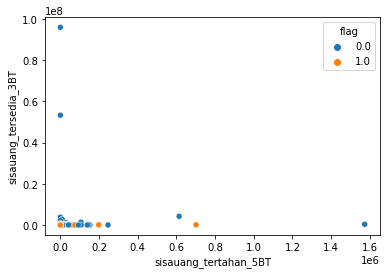

--------------------------------------------------
1527
sisauang_tertahan_5BT sisauang_tersedia_4BT


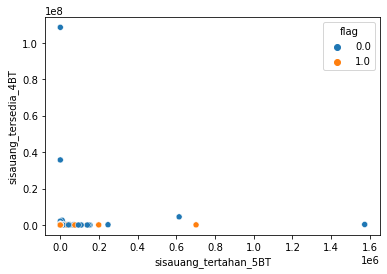

--------------------------------------------------
1528
sisauang_tertahan_5BT sisauang_tersedia_5BT


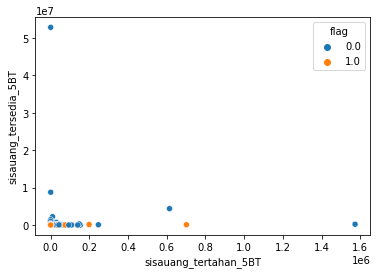

--------------------------------------------------
1529
sisauang_tertahan_5BT sisauang_tersedia_6BT


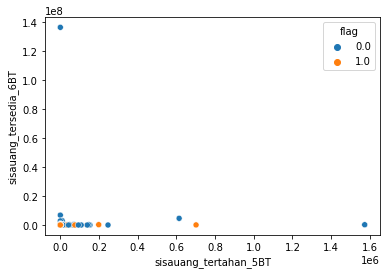

--------------------------------------------------
1530
sisauang_tertahan_5BT sisa_hutang_1BT


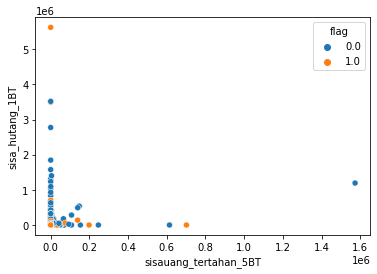

--------------------------------------------------
1531
sisauang_tertahan_5BT sisa_hutang_2BT


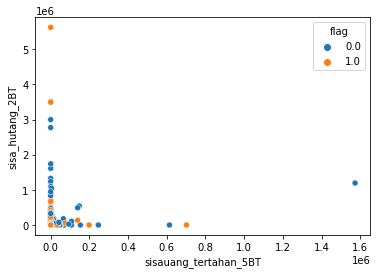

--------------------------------------------------
1532
sisauang_tertahan_5BT sisa_hutang_3BT


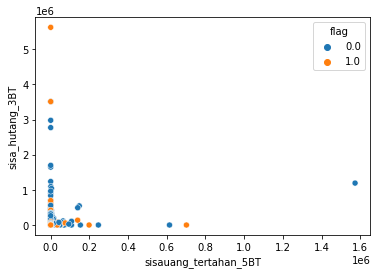

--------------------------------------------------
1533
sisauang_tertahan_5BT sisa_hutang_4BT


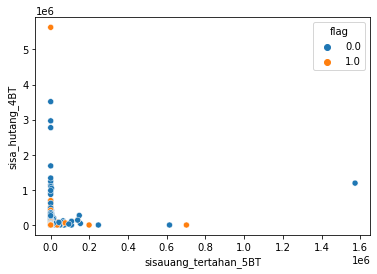

--------------------------------------------------
1534
sisauang_tertahan_5BT sisa_hutang_5BT


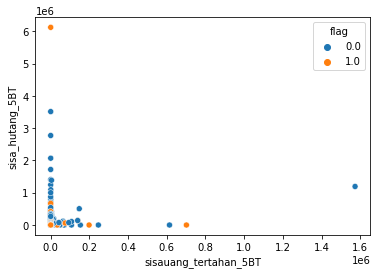

--------------------------------------------------
1535
sisauang_tertahan_5BT sisa_hutang_6BT


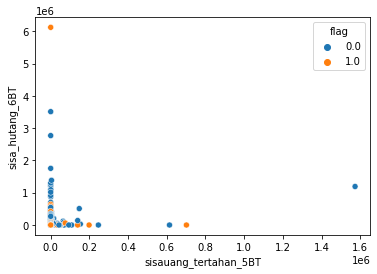

--------------------------------------------------
1536
sisauang_tertahan_5BT jumlah_pembayaran_hutang_1BT


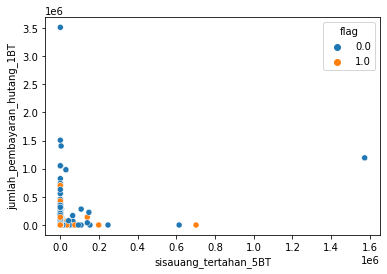

--------------------------------------------------
1537
sisauang_tertahan_5BT jumlah_pembayaran_hutang_2BT


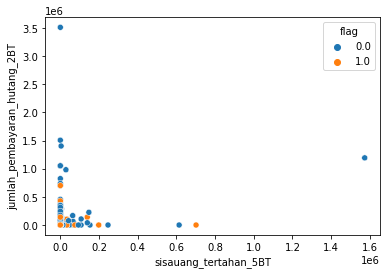

--------------------------------------------------
1538
sisauang_tertahan_5BT jumlah_pembayaran_hutang_3BT


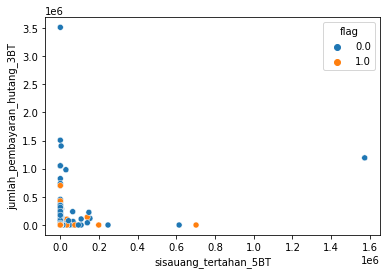

--------------------------------------------------
1539
sisauang_tertahan_5BT jumlah_pembayaran_hutang_4BT


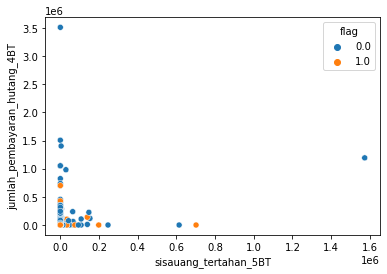

--------------------------------------------------
1540
sisauang_tertahan_5BT jumlah_pembayaran_hutang_5BT


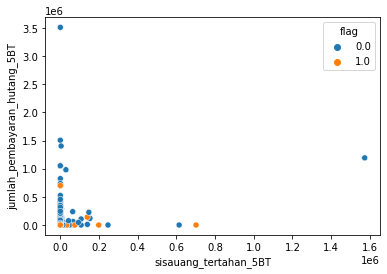

--------------------------------------------------
1541
sisauang_tertahan_5BT jumlah_pembayaran_hutang_6BT


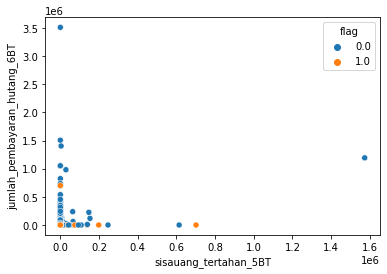

--------------------------------------------------
1542
sisauang_tertahan_5BT jumlah_pengeluaran_1BT


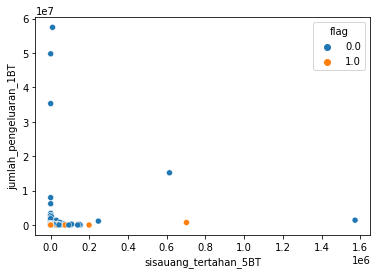

--------------------------------------------------
1543
sisauang_tertahan_5BT jumlah_pengeluaran_2BT


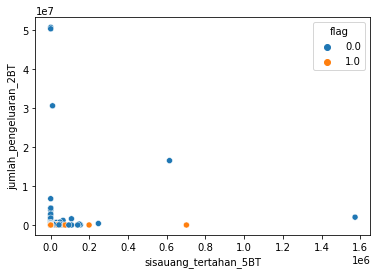

--------------------------------------------------
1544
sisauang_tertahan_5BT jumlah_pengeluaran_3BT


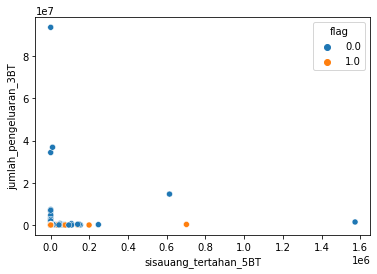

--------------------------------------------------
1545
sisauang_tertahan_5BT jumlah_pengeluaran_4BT


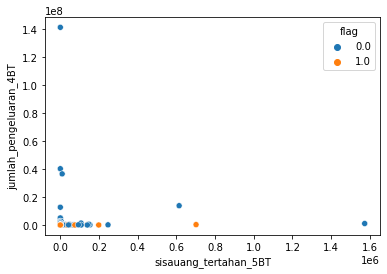

--------------------------------------------------
1546
sisauang_tertahan_5BT jumlah_pengeluaran_5BT


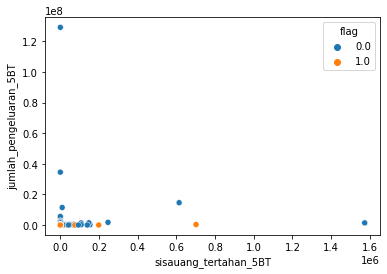

--------------------------------------------------
1547
sisauang_tertahan_5BT jumlah_pengeluaran_6BT


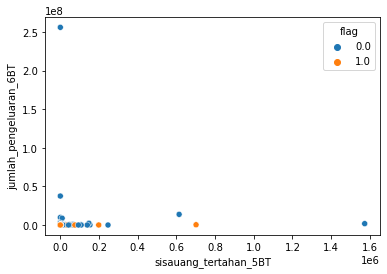

--------------------------------------------------
1548
sisauang_tertahan_5BT jumlah_pemasukan_1BT


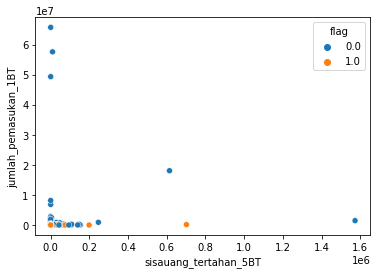

--------------------------------------------------
1549
sisauang_tertahan_5BT jumlah_pemasukan_2BT


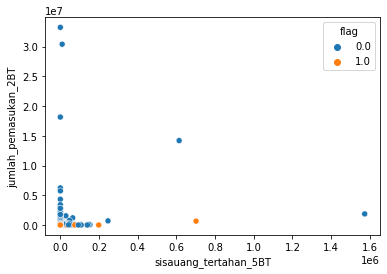

--------------------------------------------------
1550
sisauang_tertahan_5BT jumlah_pemasukan_3BT


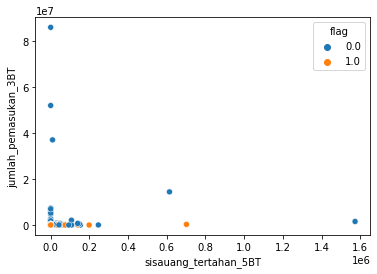

--------------------------------------------------
1551
sisauang_tertahan_5BT jumlah_pemasukan_4BT


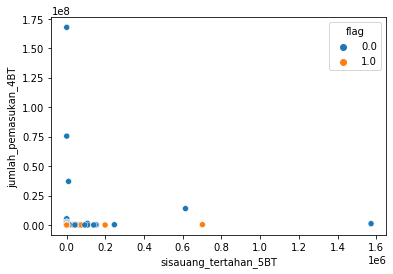

--------------------------------------------------
1552
sisauang_tertahan_5BT jumlah_pemasukan_5BT


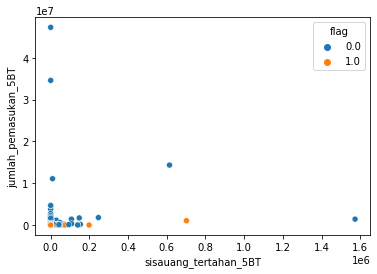

--------------------------------------------------
1553
sisauang_tertahan_5BT jumlah_pemasukan_6BT


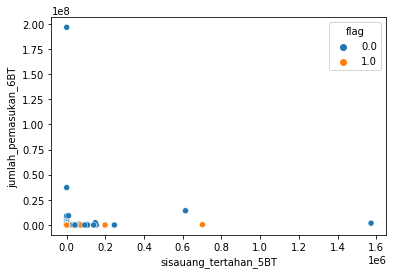

--------------------------------------------------
1554
sisauang_tertahan_5BT frekuensi_pengeluaran_1BT


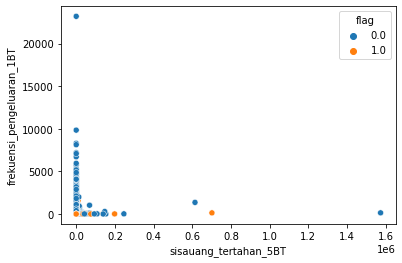

--------------------------------------------------
1555
sisauang_tertahan_5BT frekuensi_pengeluaran_2BT


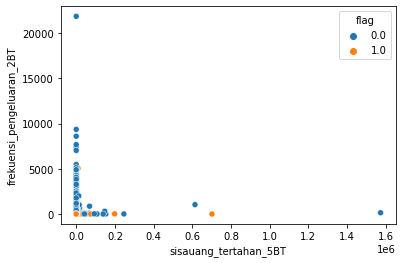

--------------------------------------------------
1556
sisauang_tertahan_5BT frekuensi_pengeluaran_3BT


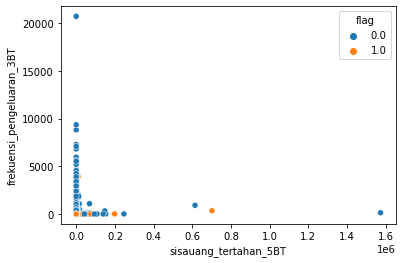

--------------------------------------------------
1557
sisauang_tertahan_5BT frekuensi_pengeluaran_4BT


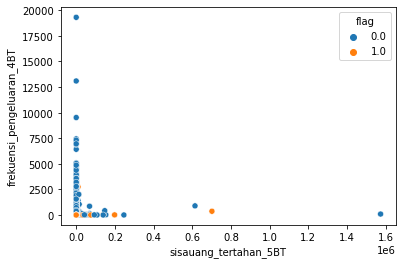

--------------------------------------------------
1558
sisauang_tertahan_5BT frekuensi_pengeluaran_5BT


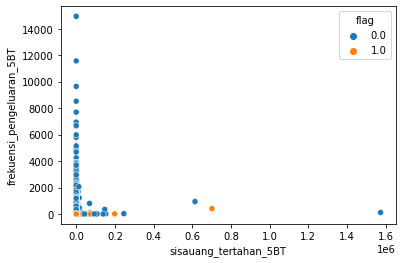

--------------------------------------------------
1559
sisauang_tertahan_5BT frekuensi_pengeluaran_6BT


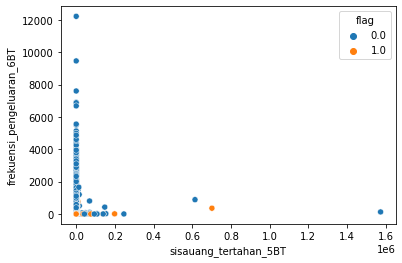

--------------------------------------------------
1560
sisauang_tertahan_5BT frekuensi_pemasukan_1BT


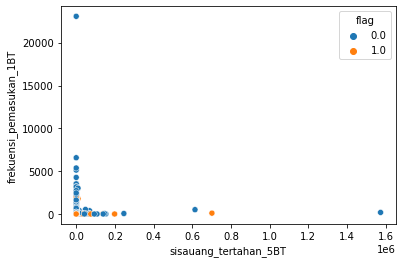

--------------------------------------------------
1561
sisauang_tertahan_5BT frekuensi_pemasukan_2BT


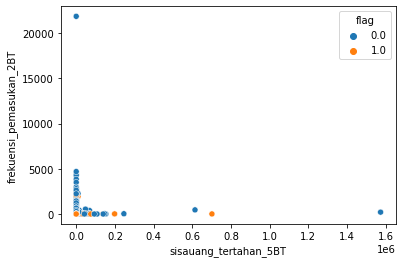

--------------------------------------------------
1562
sisauang_tertahan_5BT frekuensi_pemasukan_3BT


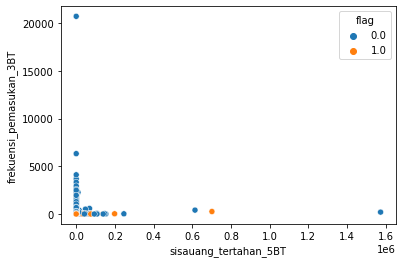

--------------------------------------------------
1563
sisauang_tertahan_5BT frekuensi_pemasukan_4BT


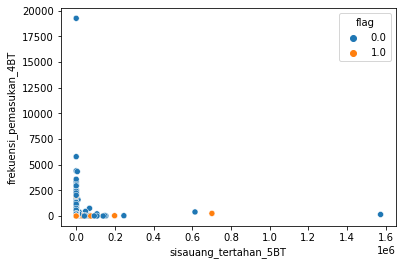

--------------------------------------------------
1564
sisauang_tertahan_5BT frekuensi_pemasukan_5BT


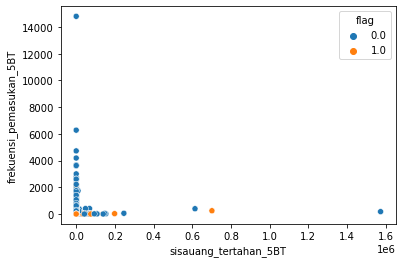

--------------------------------------------------
1565
sisauang_tertahan_5BT frekuensi_pemasukan_6BT


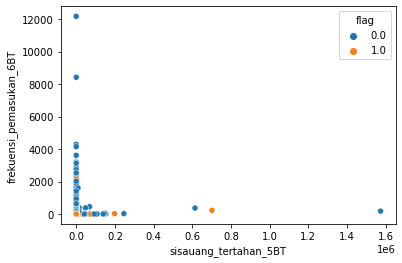

--------------------------------------------------
1566
sisauang_tertahan_5BT flag


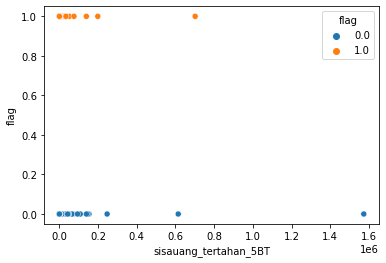

--------------------------------------------------
1567
sisauang_tertahan_6BT sisauang_tertahan_6BT


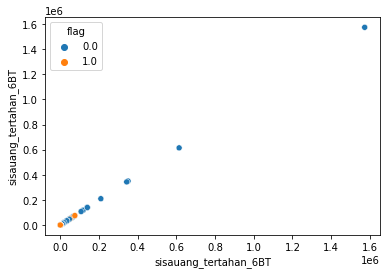

--------------------------------------------------
1568
sisauang_tertahan_6BT sisauang_tersedia_1BT


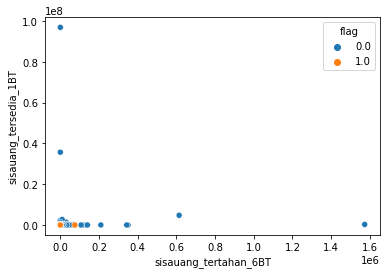

--------------------------------------------------
1569
sisauang_tertahan_6BT sisauang_tersedia_2BT


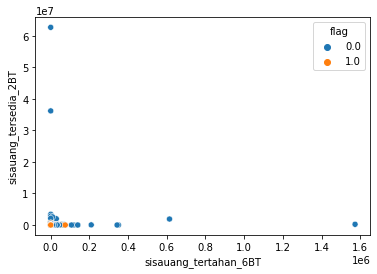

--------------------------------------------------
1570
sisauang_tertahan_6BT sisauang_tersedia_3BT


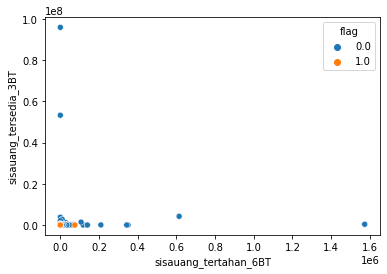

--------------------------------------------------
1571
sisauang_tertahan_6BT sisauang_tersedia_4BT


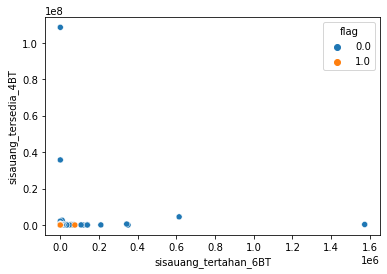

--------------------------------------------------
1572
sisauang_tertahan_6BT sisauang_tersedia_5BT


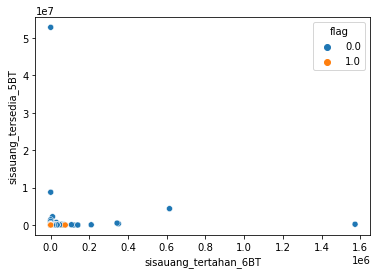

--------------------------------------------------
1573
sisauang_tertahan_6BT sisauang_tersedia_6BT


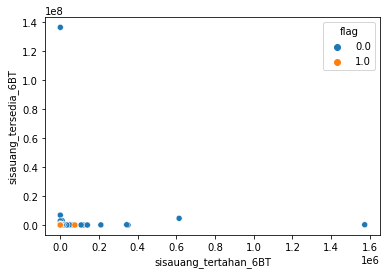

--------------------------------------------------
1574
sisauang_tertahan_6BT sisa_hutang_1BT


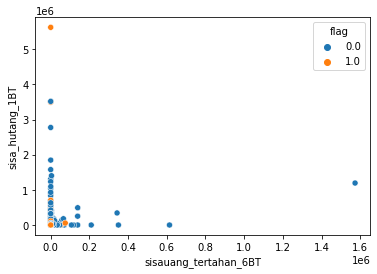

--------------------------------------------------
1575
sisauang_tertahan_6BT sisa_hutang_2BT


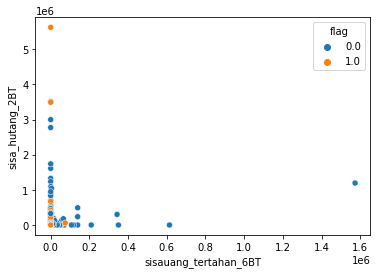

--------------------------------------------------
1576
sisauang_tertahan_6BT sisa_hutang_3BT


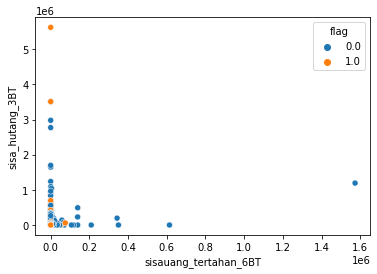

--------------------------------------------------
1577
sisauang_tertahan_6BT sisa_hutang_4BT


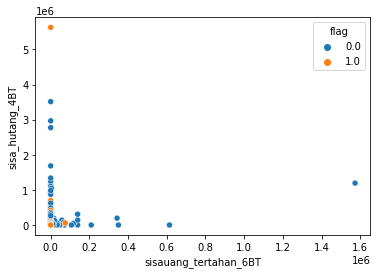

--------------------------------------------------
1578
sisauang_tertahan_6BT sisa_hutang_5BT


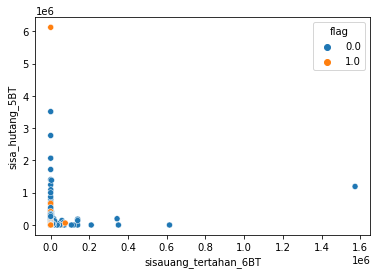

--------------------------------------------------
1579
sisauang_tertahan_6BT sisa_hutang_6BT


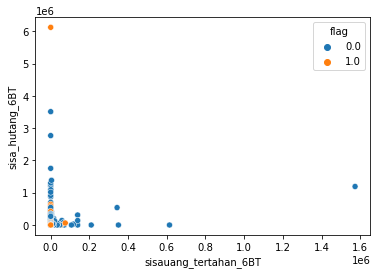

--------------------------------------------------
1580
sisauang_tertahan_6BT jumlah_pembayaran_hutang_1BT


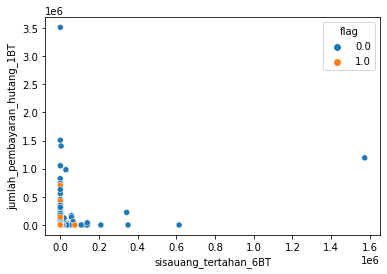

--------------------------------------------------
1581
sisauang_tertahan_6BT jumlah_pembayaran_hutang_2BT


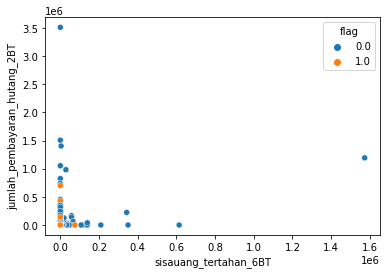

--------------------------------------------------
1582
sisauang_tertahan_6BT jumlah_pembayaran_hutang_3BT


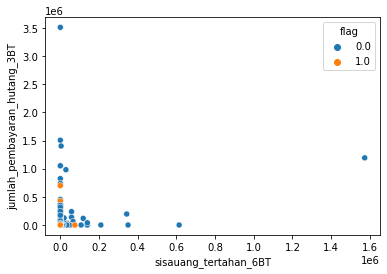

--------------------------------------------------
1583
sisauang_tertahan_6BT jumlah_pembayaran_hutang_4BT


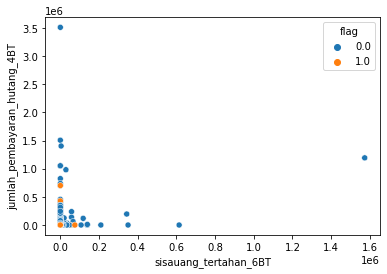

--------------------------------------------------
1584
sisauang_tertahan_6BT jumlah_pembayaran_hutang_5BT


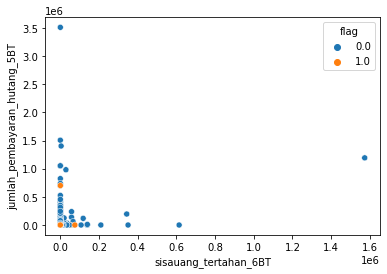

--------------------------------------------------
1585
sisauang_tertahan_6BT jumlah_pembayaran_hutang_6BT


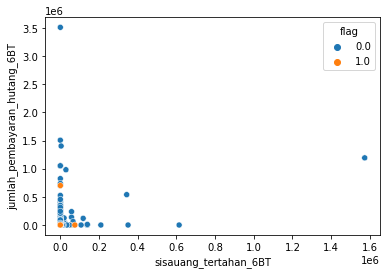

--------------------------------------------------
1586
sisauang_tertahan_6BT jumlah_pengeluaran_1BT


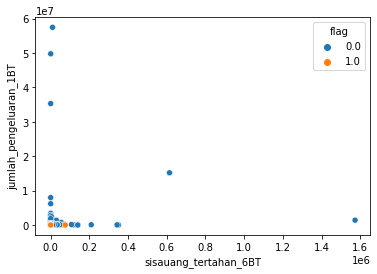

--------------------------------------------------
1587
sisauang_tertahan_6BT jumlah_pengeluaran_2BT


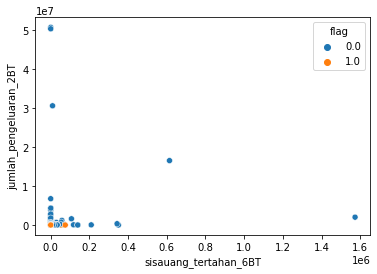

--------------------------------------------------
1588
sisauang_tertahan_6BT jumlah_pengeluaran_3BT


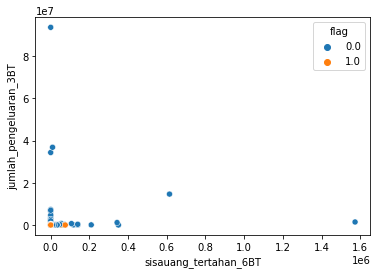

--------------------------------------------------
1589
sisauang_tertahan_6BT jumlah_pengeluaran_4BT


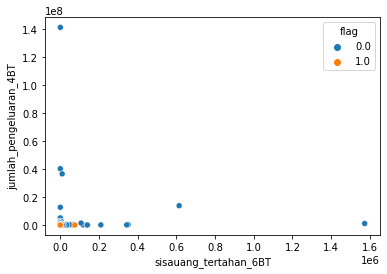

--------------------------------------------------
1590
sisauang_tertahan_6BT jumlah_pengeluaran_5BT


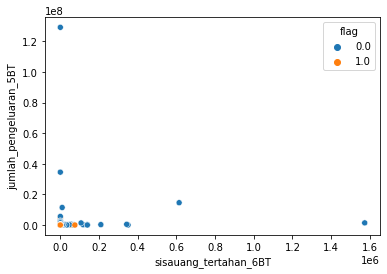

--------------------------------------------------
1591
sisauang_tertahan_6BT jumlah_pengeluaran_6BT


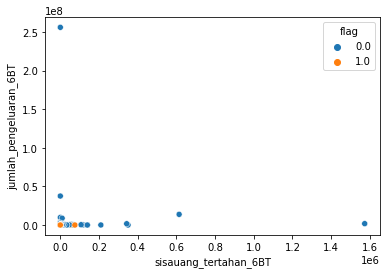

--------------------------------------------------
1592
sisauang_tertahan_6BT jumlah_pemasukan_1BT


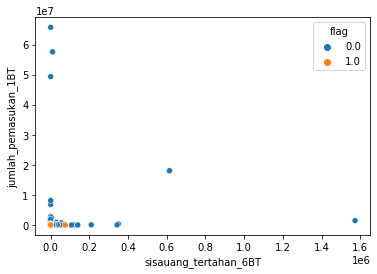

--------------------------------------------------
1593
sisauang_tertahan_6BT jumlah_pemasukan_2BT


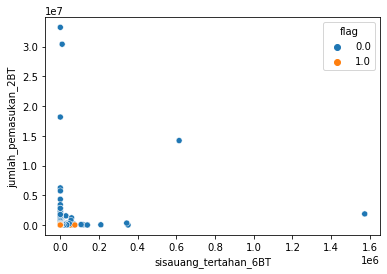

--------------------------------------------------
1594
sisauang_tertahan_6BT jumlah_pemasukan_3BT


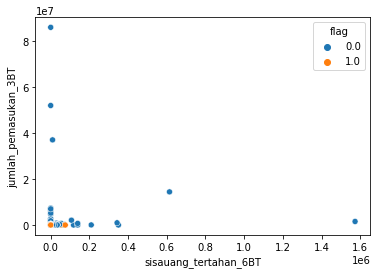

--------------------------------------------------
1595
sisauang_tertahan_6BT jumlah_pemasukan_4BT


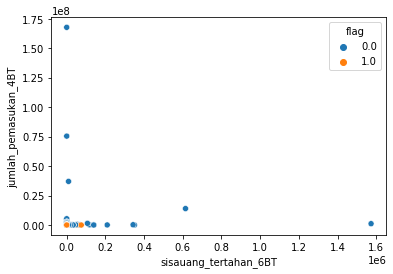

--------------------------------------------------
1596
sisauang_tertahan_6BT jumlah_pemasukan_5BT


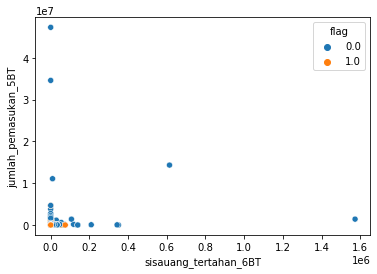

--------------------------------------------------
1597
sisauang_tertahan_6BT jumlah_pemasukan_6BT


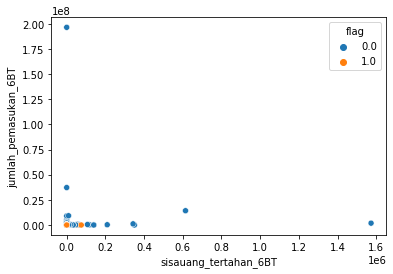

--------------------------------------------------
1598
sisauang_tertahan_6BT frekuensi_pengeluaran_1BT


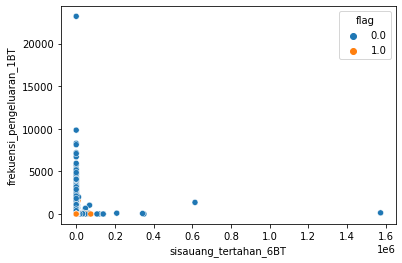

--------------------------------------------------
1599
sisauang_tertahan_6BT frekuensi_pengeluaran_2BT


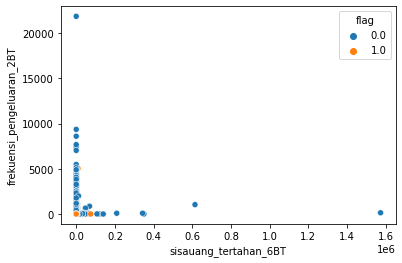

--------------------------------------------------
1600
sisauang_tertahan_6BT frekuensi_pengeluaran_3BT


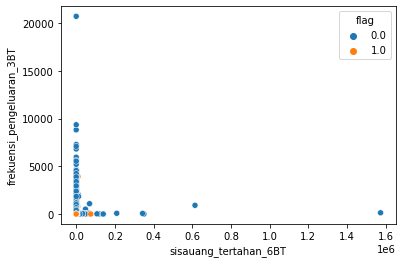

--------------------------------------------------
1601
sisauang_tertahan_6BT frekuensi_pengeluaran_4BT


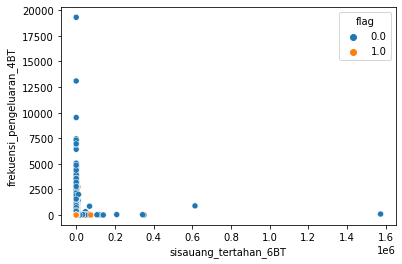

--------------------------------------------------
1602
sisauang_tertahan_6BT frekuensi_pengeluaran_5BT


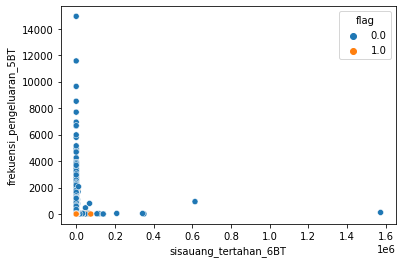

--------------------------------------------------
1603
sisauang_tertahan_6BT frekuensi_pengeluaran_6BT


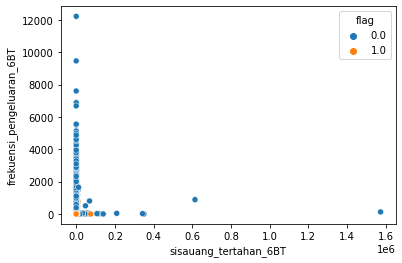

--------------------------------------------------
1604
sisauang_tertahan_6BT frekuensi_pemasukan_1BT


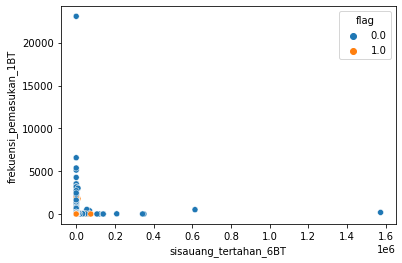

--------------------------------------------------
1605
sisauang_tertahan_6BT frekuensi_pemasukan_2BT


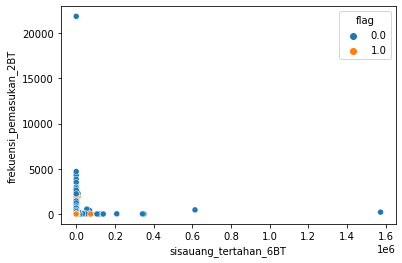

--------------------------------------------------
1606
sisauang_tertahan_6BT frekuensi_pemasukan_3BT


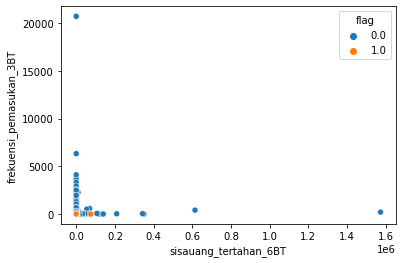

--------------------------------------------------
1607
sisauang_tertahan_6BT frekuensi_pemasukan_4BT


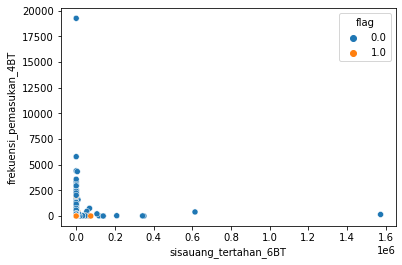

--------------------------------------------------
1608
sisauang_tertahan_6BT frekuensi_pemasukan_5BT


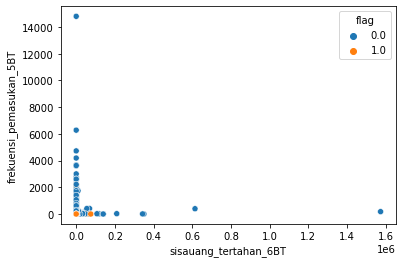

--------------------------------------------------
1609
sisauang_tertahan_6BT frekuensi_pemasukan_6BT


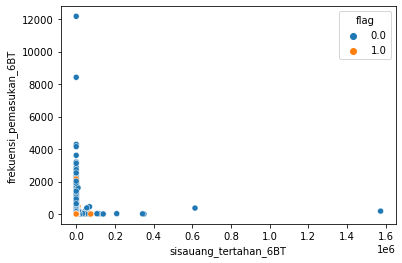

--------------------------------------------------
1610
sisauang_tertahan_6BT flag


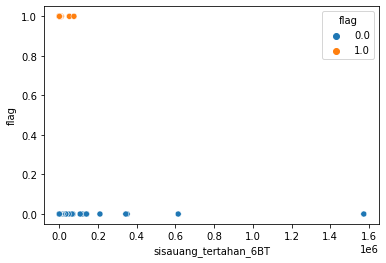

--------------------------------------------------
1611
sisauang_tersedia_1BT sisauang_tersedia_1BT


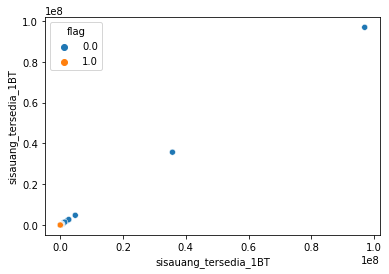

--------------------------------------------------
1612
sisauang_tersedia_1BT sisauang_tersedia_2BT


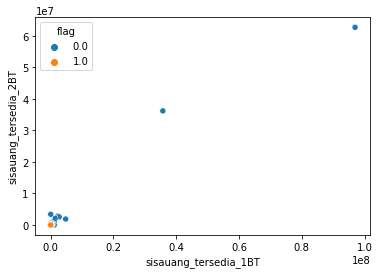

--------------------------------------------------
1613
sisauang_tersedia_1BT sisauang_tersedia_3BT


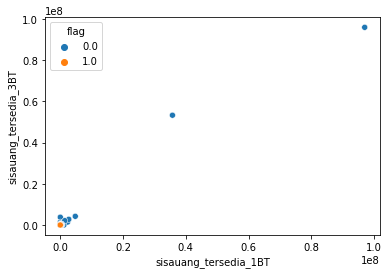

--------------------------------------------------
1614
sisauang_tersedia_1BT sisauang_tersedia_4BT


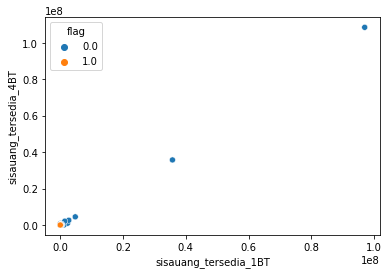

--------------------------------------------------
1615
sisauang_tersedia_1BT sisauang_tersedia_5BT


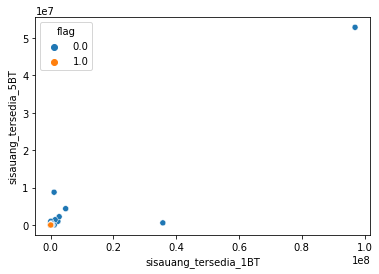

--------------------------------------------------
1616
sisauang_tersedia_1BT sisauang_tersedia_6BT


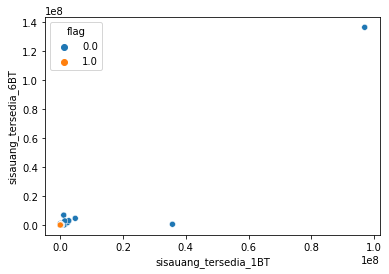

--------------------------------------------------
1617
sisauang_tersedia_1BT sisa_hutang_1BT


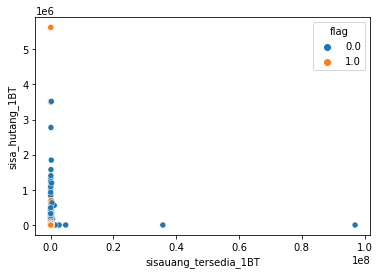

--------------------------------------------------
1618
sisauang_tersedia_1BT sisa_hutang_2BT


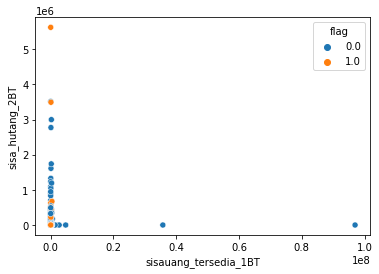

--------------------------------------------------
1619
sisauang_tersedia_1BT sisa_hutang_3BT


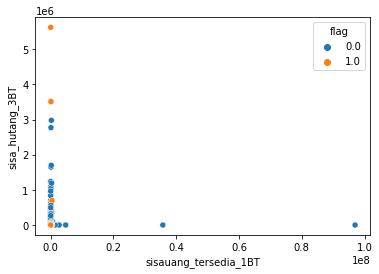

--------------------------------------------------
1620
sisauang_tersedia_1BT sisa_hutang_4BT


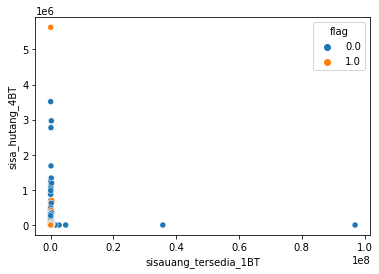

--------------------------------------------------
1621
sisauang_tersedia_1BT sisa_hutang_5BT


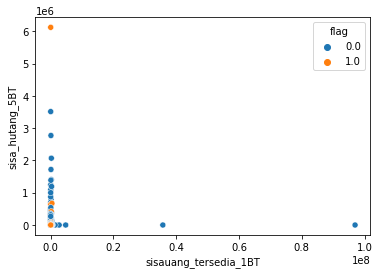

--------------------------------------------------
1622
sisauang_tersedia_1BT sisa_hutang_6BT


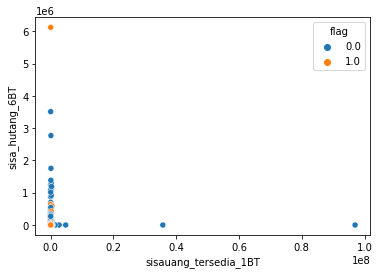

--------------------------------------------------
1623
sisauang_tersedia_1BT jumlah_pembayaran_hutang_1BT


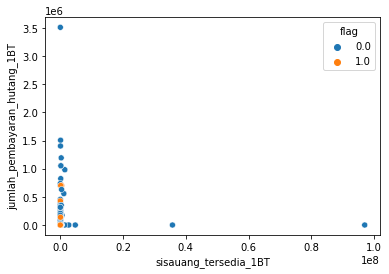

--------------------------------------------------
1624
sisauang_tersedia_1BT jumlah_pembayaran_hutang_2BT


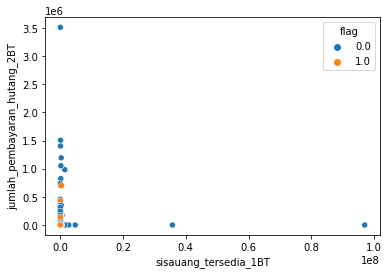

--------------------------------------------------
1625
sisauang_tersedia_1BT jumlah_pembayaran_hutang_3BT


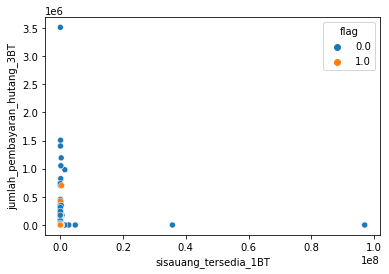

--------------------------------------------------
1626
sisauang_tersedia_1BT jumlah_pembayaran_hutang_4BT


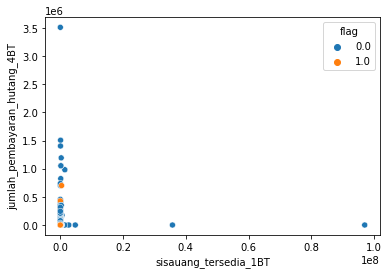

--------------------------------------------------
1627
sisauang_tersedia_1BT jumlah_pembayaran_hutang_5BT


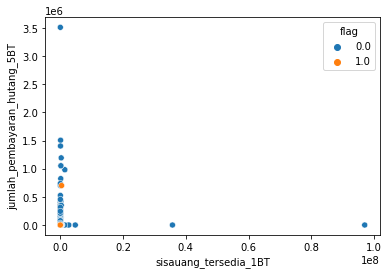

--------------------------------------------------
1628
sisauang_tersedia_1BT jumlah_pembayaran_hutang_6BT


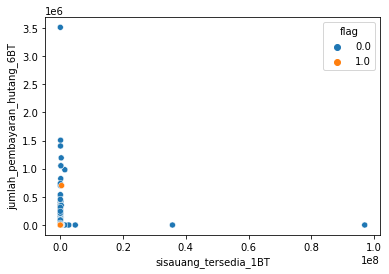

--------------------------------------------------
1629
sisauang_tersedia_1BT jumlah_pengeluaran_1BT


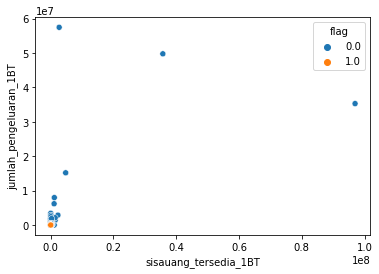

--------------------------------------------------
1630
sisauang_tersedia_1BT jumlah_pengeluaran_2BT


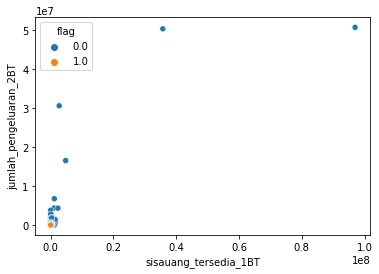

--------------------------------------------------
1631
sisauang_tersedia_1BT jumlah_pengeluaran_3BT


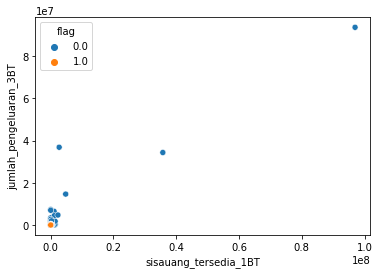

--------------------------------------------------
1632
sisauang_tersedia_1BT jumlah_pengeluaran_4BT


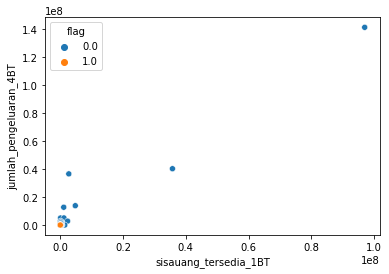

--------------------------------------------------
1633
sisauang_tersedia_1BT jumlah_pengeluaran_5BT


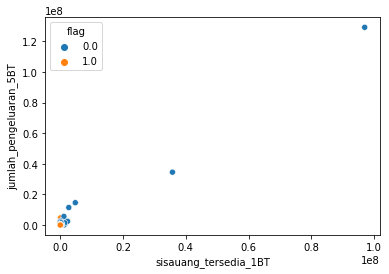

--------------------------------------------------
1634
sisauang_tersedia_1BT jumlah_pengeluaran_6BT


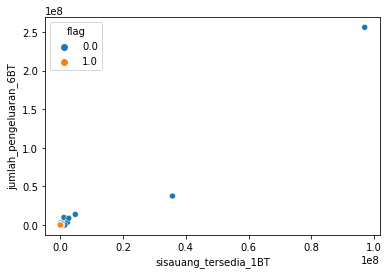

--------------------------------------------------
1635
sisauang_tersedia_1BT jumlah_pemasukan_1BT


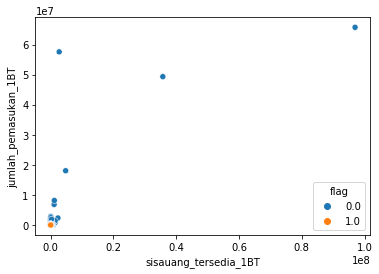

--------------------------------------------------
1636
sisauang_tersedia_1BT jumlah_pemasukan_2BT


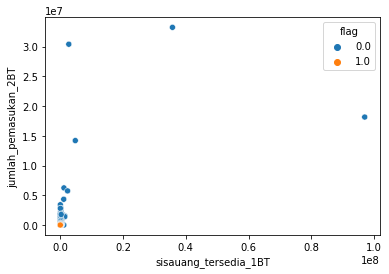

--------------------------------------------------
1637
sisauang_tersedia_1BT jumlah_pemasukan_3BT


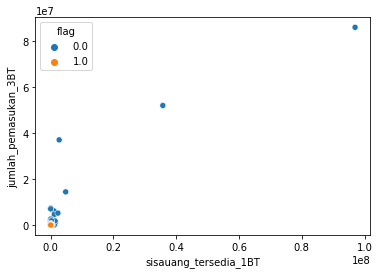

--------------------------------------------------
1638
sisauang_tersedia_1BT jumlah_pemasukan_4BT


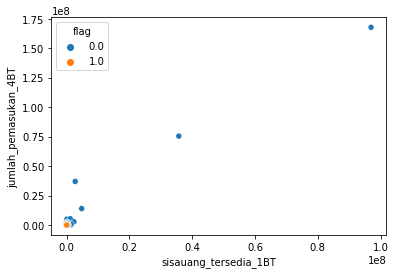

--------------------------------------------------
1639
sisauang_tersedia_1BT jumlah_pemasukan_5BT


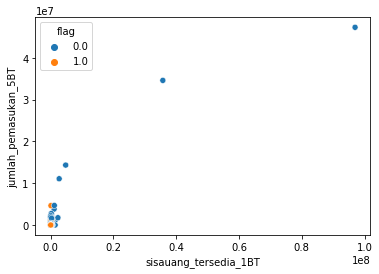

--------------------------------------------------
1640
sisauang_tersedia_1BT jumlah_pemasukan_6BT


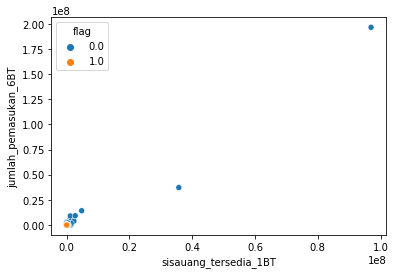

--------------------------------------------------
1641
sisauang_tersedia_1BT frekuensi_pengeluaran_1BT


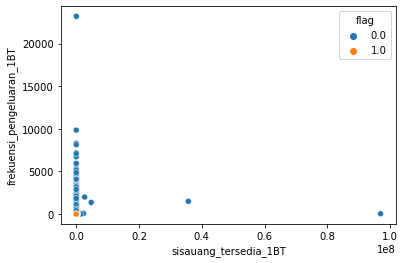

--------------------------------------------------
1642
sisauang_tersedia_1BT frekuensi_pengeluaran_2BT


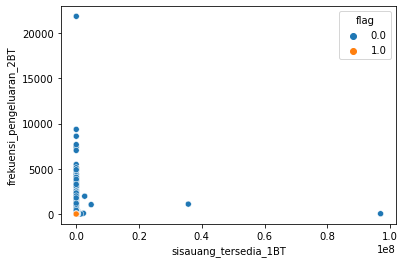

--------------------------------------------------
1643
sisauang_tersedia_1BT frekuensi_pengeluaran_3BT


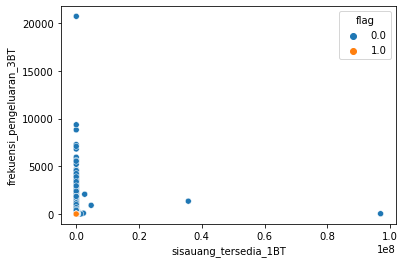

--------------------------------------------------
1644
sisauang_tersedia_1BT frekuensi_pengeluaran_4BT


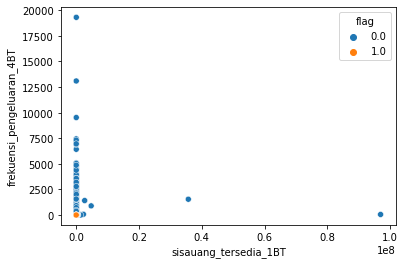

--------------------------------------------------
1645
sisauang_tersedia_1BT frekuensi_pengeluaran_5BT


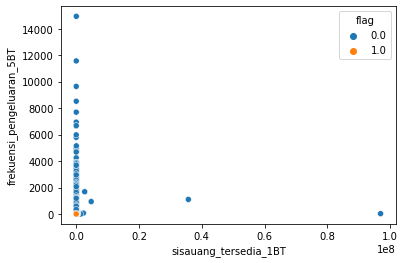

--------------------------------------------------
1646
sisauang_tersedia_1BT frekuensi_pengeluaran_6BT


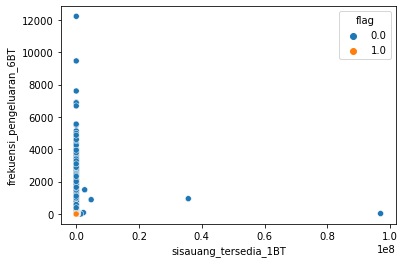

--------------------------------------------------
1647
sisauang_tersedia_1BT frekuensi_pemasukan_1BT


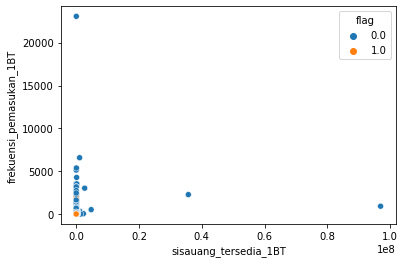

--------------------------------------------------
1648
sisauang_tersedia_1BT frekuensi_pemasukan_2BT


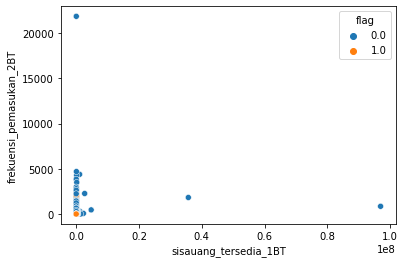

--------------------------------------------------
1649
sisauang_tersedia_1BT frekuensi_pemasukan_3BT


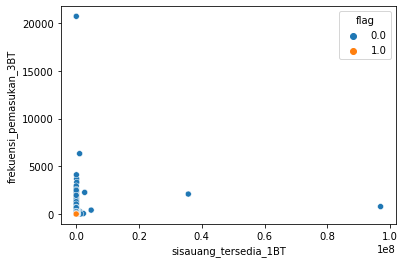

--------------------------------------------------
1650
sisauang_tersedia_1BT frekuensi_pemasukan_4BT


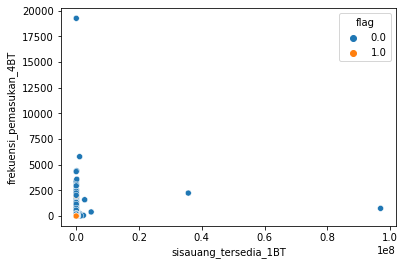

--------------------------------------------------
1651
sisauang_tersedia_1BT frekuensi_pemasukan_5BT


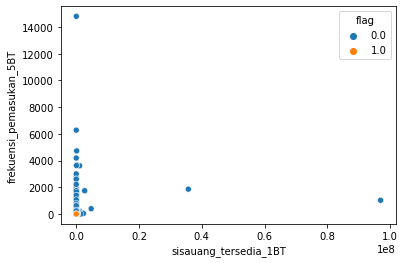

--------------------------------------------------
1652
sisauang_tersedia_1BT frekuensi_pemasukan_6BT


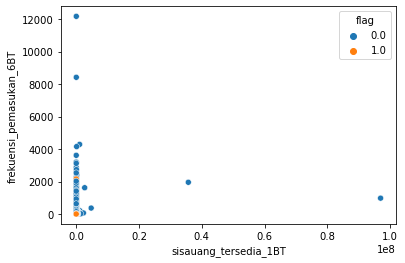

--------------------------------------------------
1653
sisauang_tersedia_1BT flag


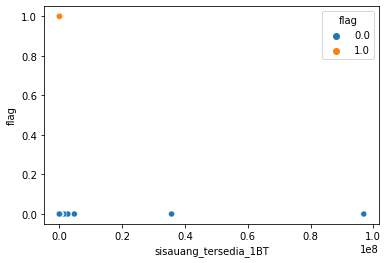

--------------------------------------------------
1654
sisauang_tersedia_2BT sisauang_tersedia_2BT


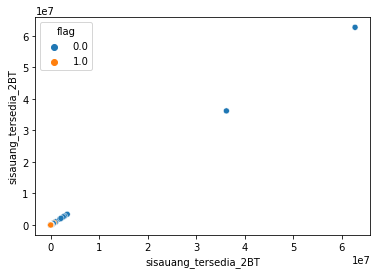

--------------------------------------------------
1655
sisauang_tersedia_2BT sisauang_tersedia_3BT


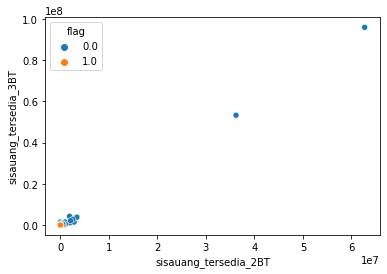

--------------------------------------------------
1656
sisauang_tersedia_2BT sisauang_tersedia_4BT


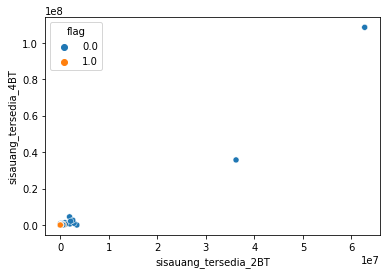

--------------------------------------------------
1657
sisauang_tersedia_2BT sisauang_tersedia_5BT


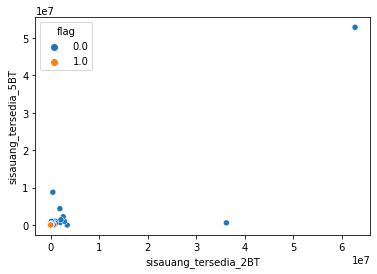

--------------------------------------------------
1658
sisauang_tersedia_2BT sisauang_tersedia_6BT


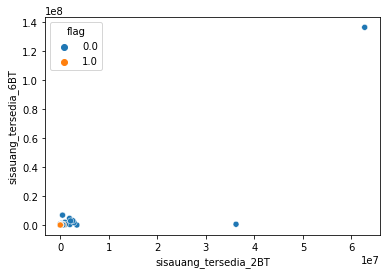

--------------------------------------------------
1659
sisauang_tersedia_2BT sisa_hutang_1BT


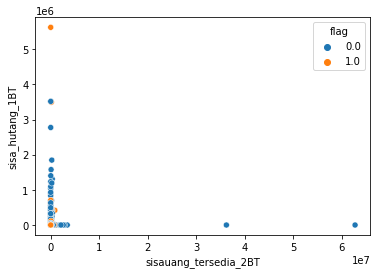

--------------------------------------------------
1660
sisauang_tersedia_2BT sisa_hutang_2BT


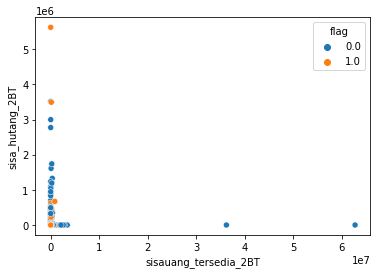

--------------------------------------------------
1661
sisauang_tersedia_2BT sisa_hutang_3BT


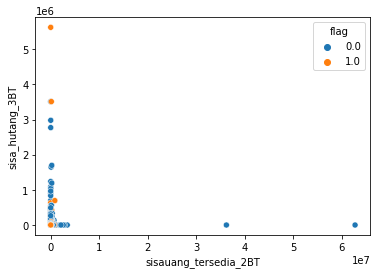

--------------------------------------------------
1662
sisauang_tersedia_2BT sisa_hutang_4BT


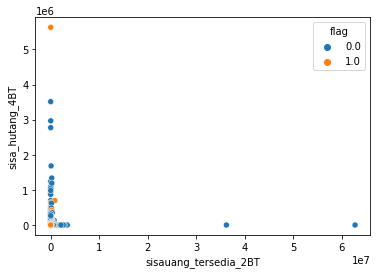

--------------------------------------------------
1663
sisauang_tersedia_2BT sisa_hutang_5BT


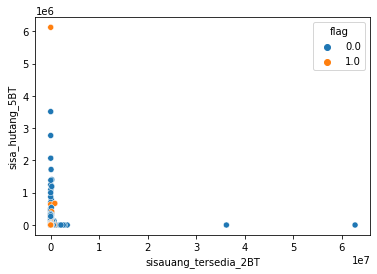

--------------------------------------------------
1664
sisauang_tersedia_2BT sisa_hutang_6BT


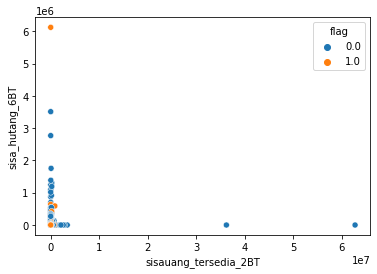

--------------------------------------------------
1665
sisauang_tersedia_2BT jumlah_pembayaran_hutang_1BT


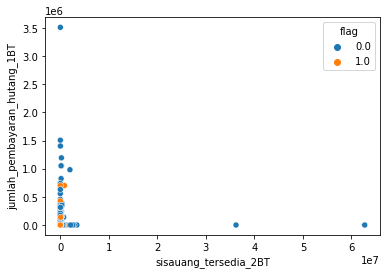

--------------------------------------------------
1666
sisauang_tersedia_2BT jumlah_pembayaran_hutang_2BT


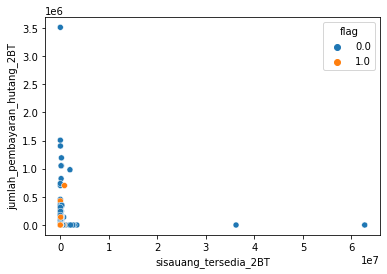

--------------------------------------------------
1667
sisauang_tersedia_2BT jumlah_pembayaran_hutang_3BT


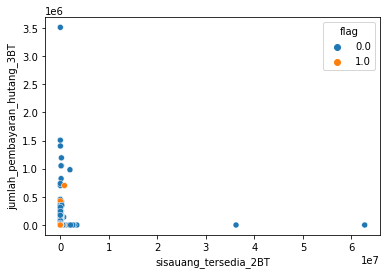

--------------------------------------------------
1668
sisauang_tersedia_2BT jumlah_pembayaran_hutang_4BT


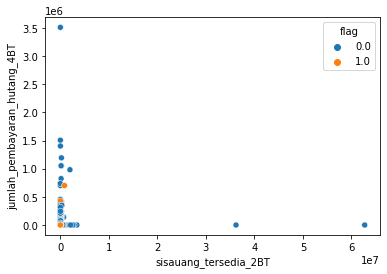

--------------------------------------------------
1669
sisauang_tersedia_2BT jumlah_pembayaran_hutang_5BT


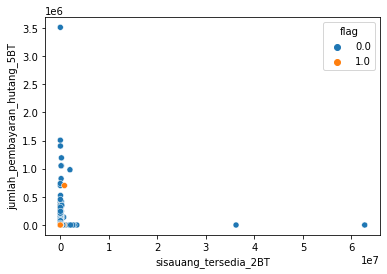

--------------------------------------------------
1670
sisauang_tersedia_2BT jumlah_pembayaran_hutang_6BT


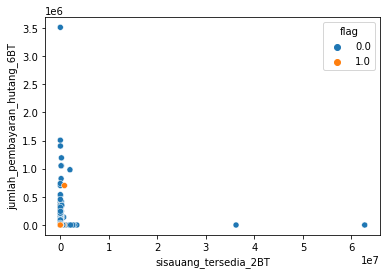

--------------------------------------------------
1671
sisauang_tersedia_2BT jumlah_pengeluaran_1BT


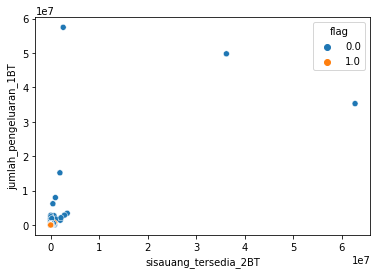

--------------------------------------------------
1672
sisauang_tersedia_2BT jumlah_pengeluaran_2BT


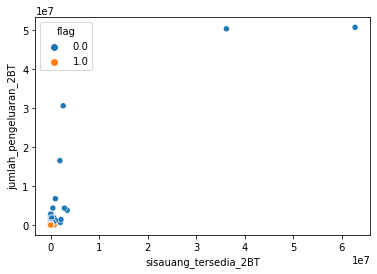

--------------------------------------------------
1673
sisauang_tersedia_2BT jumlah_pengeluaran_3BT


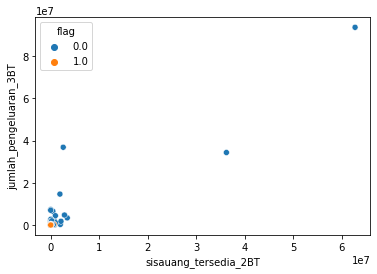

--------------------------------------------------
1674
sisauang_tersedia_2BT jumlah_pengeluaran_4BT


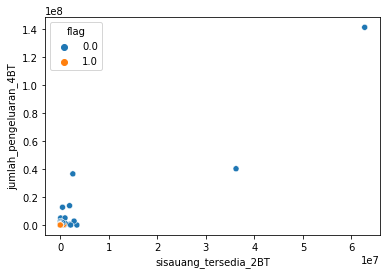

--------------------------------------------------
1675
sisauang_tersedia_2BT jumlah_pengeluaran_5BT


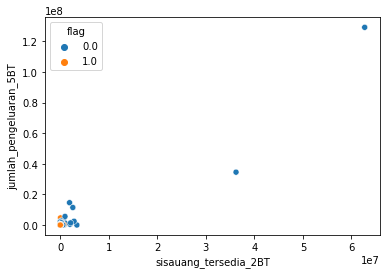

--------------------------------------------------
1676
sisauang_tersedia_2BT jumlah_pengeluaran_6BT


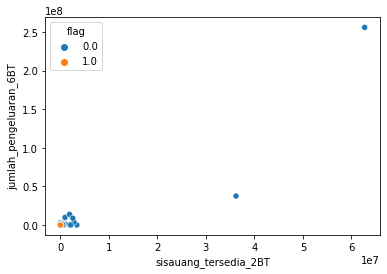

--------------------------------------------------
1677
sisauang_tersedia_2BT jumlah_pemasukan_1BT


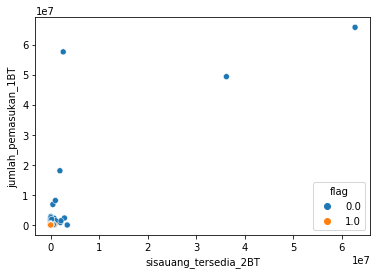

--------------------------------------------------
1678
sisauang_tersedia_2BT jumlah_pemasukan_2BT


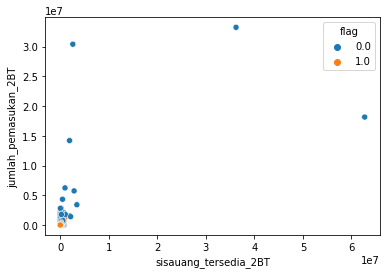

--------------------------------------------------
1679
sisauang_tersedia_2BT jumlah_pemasukan_3BT


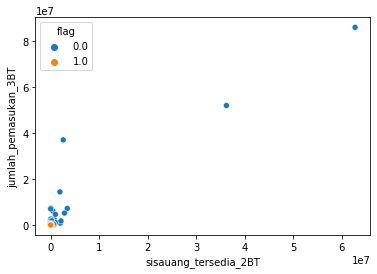

--------------------------------------------------
1680
sisauang_tersedia_2BT jumlah_pemasukan_4BT


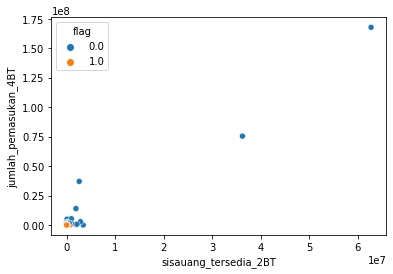

--------------------------------------------------
1681
sisauang_tersedia_2BT jumlah_pemasukan_5BT


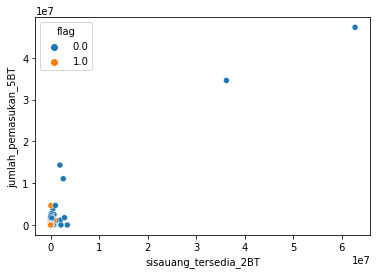

--------------------------------------------------
1682
sisauang_tersedia_2BT jumlah_pemasukan_6BT


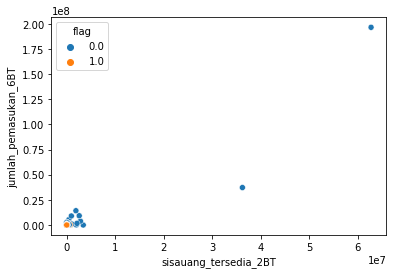

--------------------------------------------------
1683
sisauang_tersedia_2BT frekuensi_pengeluaran_1BT


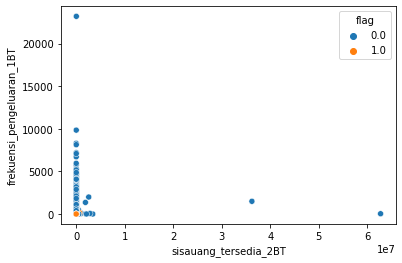

--------------------------------------------------
1684
sisauang_tersedia_2BT frekuensi_pengeluaran_2BT


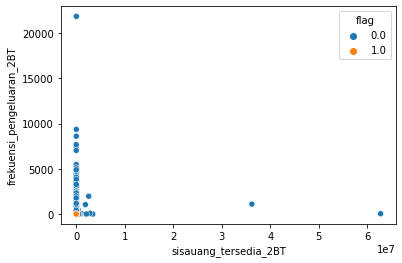

--------------------------------------------------
1685
sisauang_tersedia_2BT frekuensi_pengeluaran_3BT


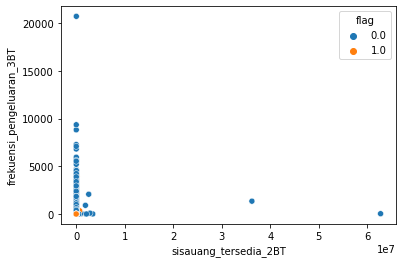

--------------------------------------------------
1686
sisauang_tersedia_2BT frekuensi_pengeluaran_4BT


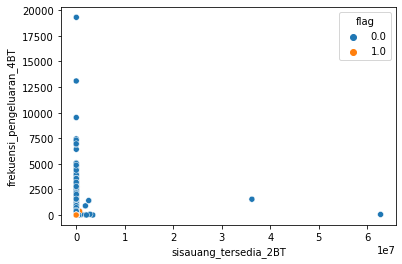

--------------------------------------------------
1687
sisauang_tersedia_2BT frekuensi_pengeluaran_5BT


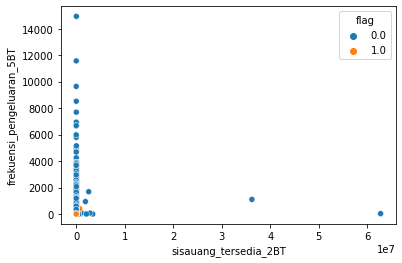

--------------------------------------------------
1688
sisauang_tersedia_2BT frekuensi_pengeluaran_6BT


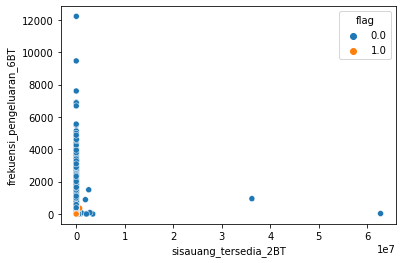

--------------------------------------------------
1689
sisauang_tersedia_2BT frekuensi_pemasukan_1BT


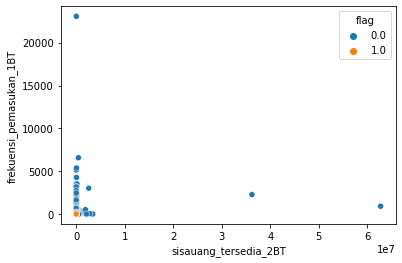

--------------------------------------------------
1690
sisauang_tersedia_2BT frekuensi_pemasukan_2BT


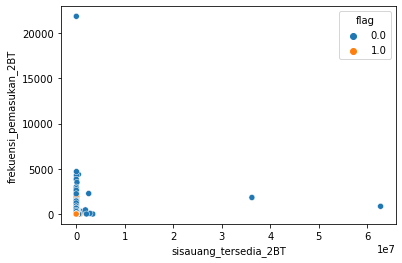

--------------------------------------------------
1691
sisauang_tersedia_2BT frekuensi_pemasukan_3BT


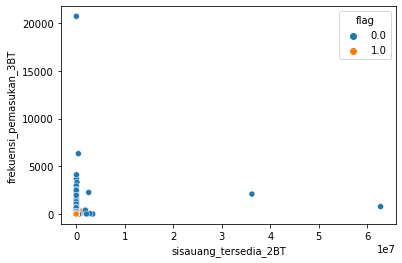

--------------------------------------------------
1692
sisauang_tersedia_2BT frekuensi_pemasukan_4BT


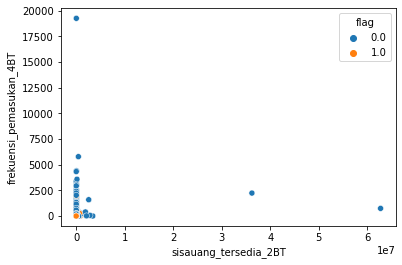

--------------------------------------------------
1693
sisauang_tersedia_2BT frekuensi_pemasukan_5BT


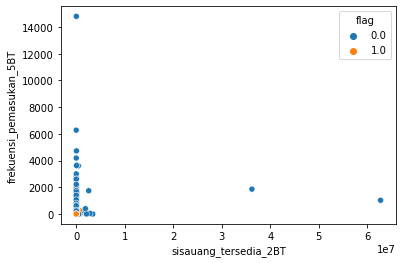

--------------------------------------------------
1694
sisauang_tersedia_2BT frekuensi_pemasukan_6BT


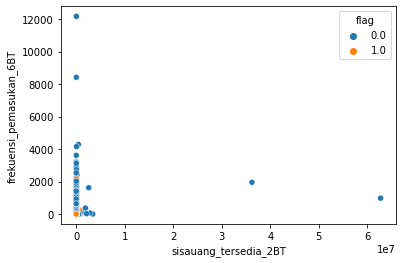

--------------------------------------------------
1695
sisauang_tersedia_2BT flag


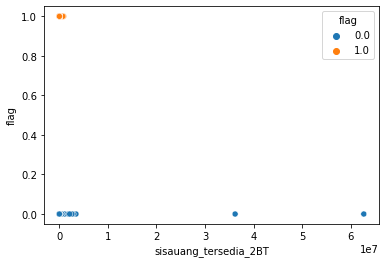

--------------------------------------------------
1696
sisauang_tersedia_3BT sisauang_tersedia_3BT


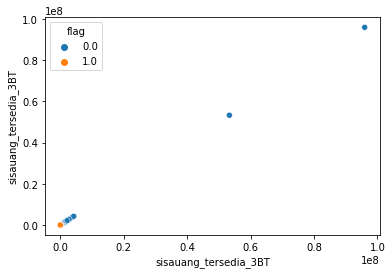

--------------------------------------------------
1697
sisauang_tersedia_3BT sisauang_tersedia_4BT


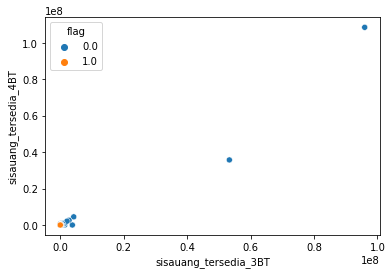

--------------------------------------------------
1698
sisauang_tersedia_3BT sisauang_tersedia_5BT


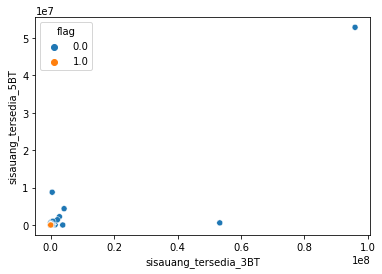

--------------------------------------------------
1699
sisauang_tersedia_3BT sisauang_tersedia_6BT


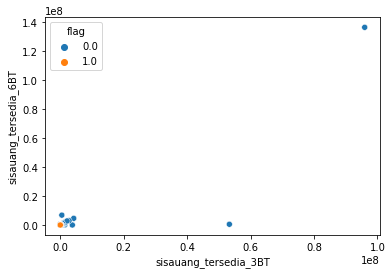

--------------------------------------------------
1700
sisauang_tersedia_3BT sisa_hutang_1BT


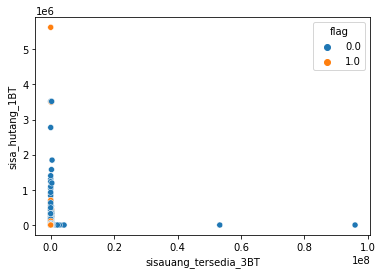

--------------------------------------------------
1701
sisauang_tersedia_3BT sisa_hutang_2BT


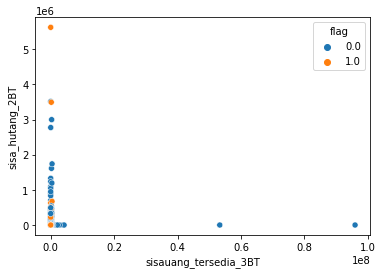

--------------------------------------------------
1702
sisauang_tersedia_3BT sisa_hutang_3BT


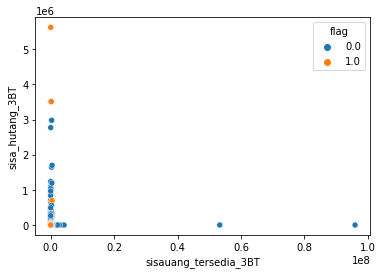

--------------------------------------------------
1703
sisauang_tersedia_3BT sisa_hutang_4BT


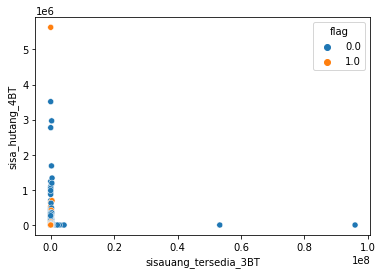

--------------------------------------------------
1704
sisauang_tersedia_3BT sisa_hutang_5BT


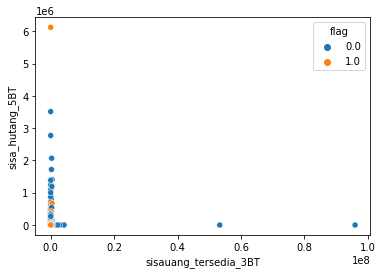

--------------------------------------------------
1705
sisauang_tersedia_3BT sisa_hutang_6BT


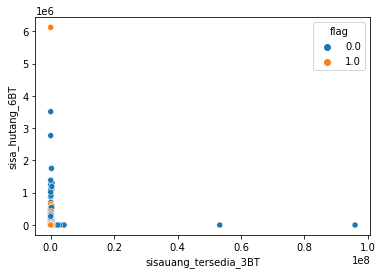

--------------------------------------------------
1706
sisauang_tersedia_3BT jumlah_pembayaran_hutang_1BT


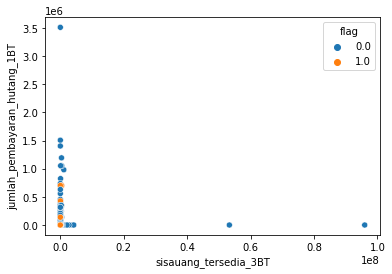

--------------------------------------------------
1707
sisauang_tersedia_3BT jumlah_pembayaran_hutang_2BT


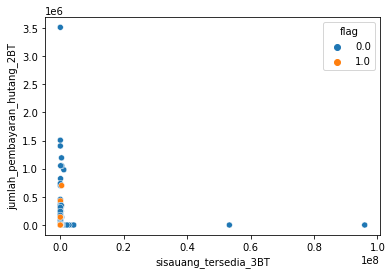

--------------------------------------------------
1708
sisauang_tersedia_3BT jumlah_pembayaran_hutang_3BT


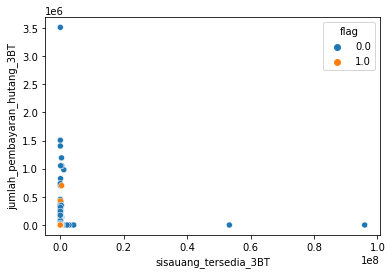

--------------------------------------------------
1709
sisauang_tersedia_3BT jumlah_pembayaran_hutang_4BT


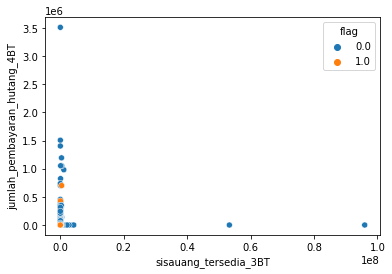

--------------------------------------------------
1710
sisauang_tersedia_3BT jumlah_pembayaran_hutang_5BT


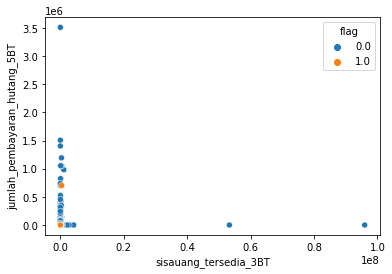

--------------------------------------------------
1711
sisauang_tersedia_3BT jumlah_pembayaran_hutang_6BT


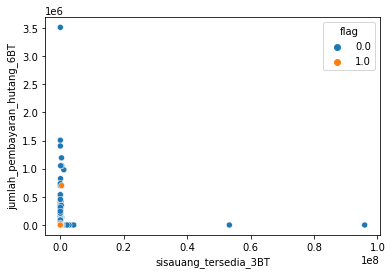

--------------------------------------------------
1712
sisauang_tersedia_3BT jumlah_pengeluaran_1BT


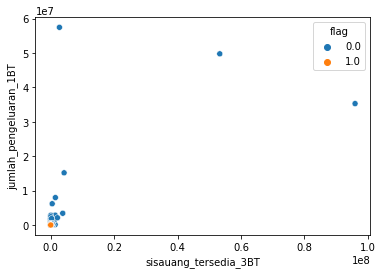

--------------------------------------------------
1713
sisauang_tersedia_3BT jumlah_pengeluaran_2BT


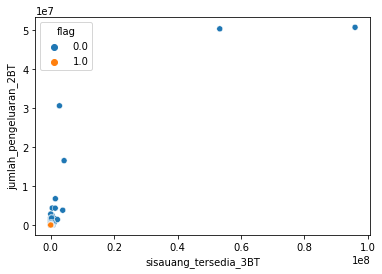

--------------------------------------------------
1714
sisauang_tersedia_3BT jumlah_pengeluaran_3BT


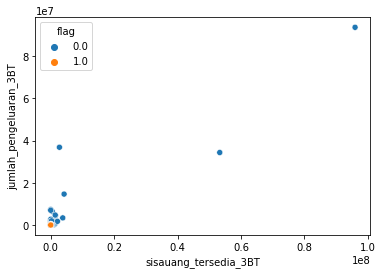

--------------------------------------------------
1715
sisauang_tersedia_3BT jumlah_pengeluaran_4BT


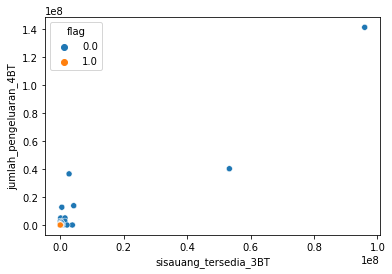

--------------------------------------------------
1716
sisauang_tersedia_3BT jumlah_pengeluaran_5BT


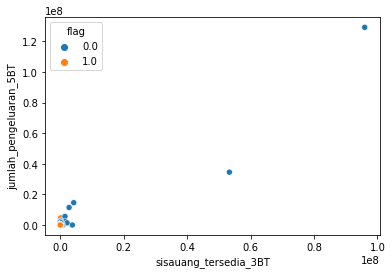

--------------------------------------------------
1717
sisauang_tersedia_3BT jumlah_pengeluaran_6BT


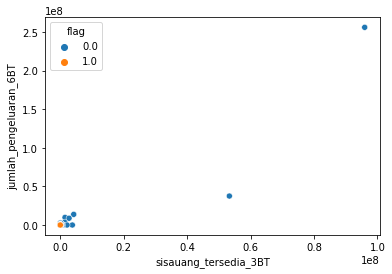

--------------------------------------------------
1718
sisauang_tersedia_3BT jumlah_pemasukan_1BT


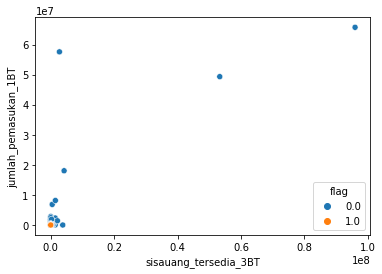

--------------------------------------------------
1719
sisauang_tersedia_3BT jumlah_pemasukan_2BT


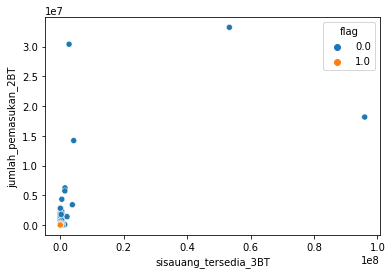

--------------------------------------------------
1720
sisauang_tersedia_3BT jumlah_pemasukan_3BT


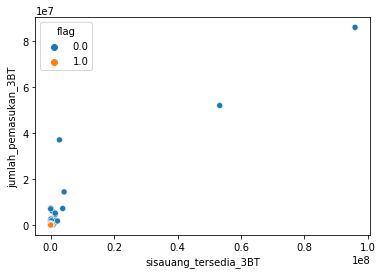

--------------------------------------------------
1721
sisauang_tersedia_3BT jumlah_pemasukan_4BT


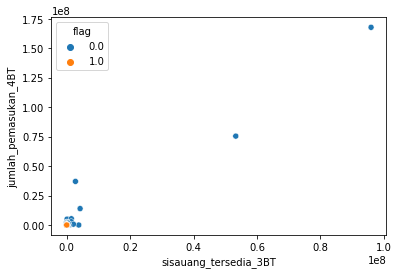

--------------------------------------------------
1722
sisauang_tersedia_3BT jumlah_pemasukan_5BT


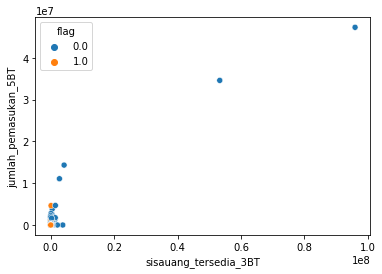

--------------------------------------------------
1723
sisauang_tersedia_3BT jumlah_pemasukan_6BT


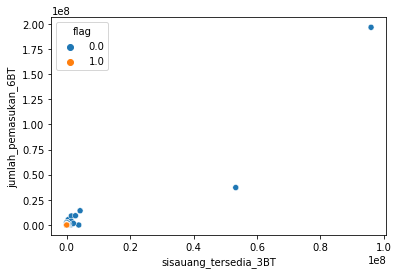

--------------------------------------------------
1724
sisauang_tersedia_3BT frekuensi_pengeluaran_1BT


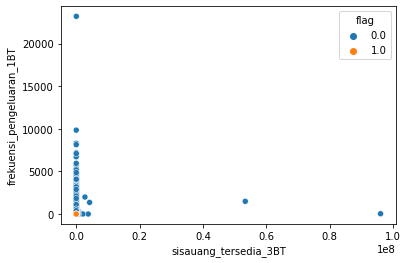

--------------------------------------------------
1725
sisauang_tersedia_3BT frekuensi_pengeluaran_2BT


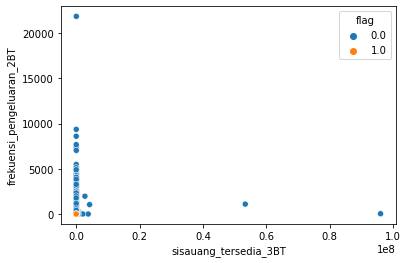

--------------------------------------------------
1726
sisauang_tersedia_3BT frekuensi_pengeluaran_3BT


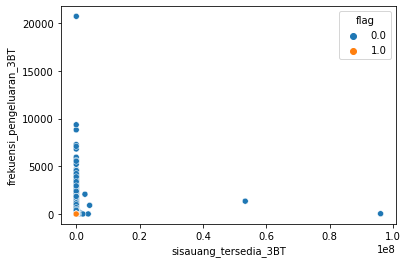

--------------------------------------------------
1727
sisauang_tersedia_3BT frekuensi_pengeluaran_4BT


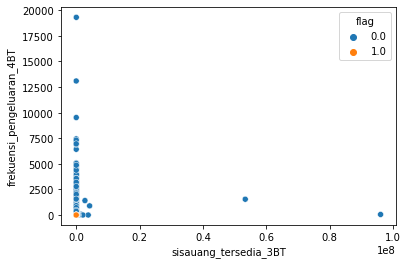

--------------------------------------------------
1728
sisauang_tersedia_3BT frekuensi_pengeluaran_5BT


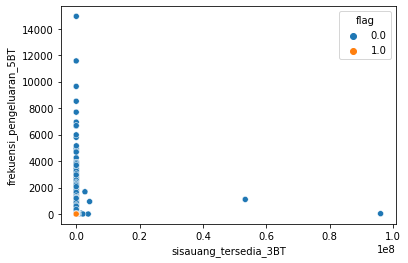

--------------------------------------------------
1729
sisauang_tersedia_3BT frekuensi_pengeluaran_6BT


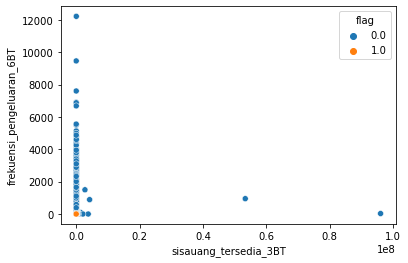

--------------------------------------------------
1730
sisauang_tersedia_3BT frekuensi_pemasukan_1BT


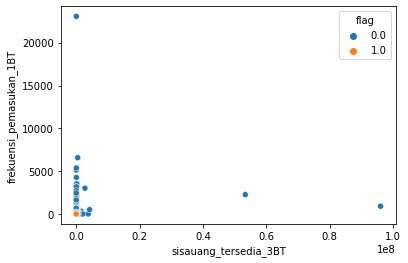

--------------------------------------------------
1731
sisauang_tersedia_3BT frekuensi_pemasukan_2BT


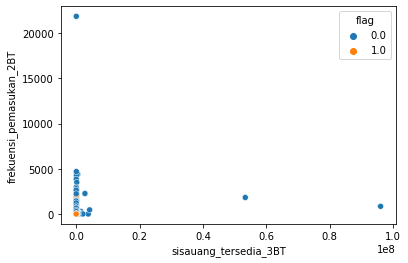

--------------------------------------------------
1732
sisauang_tersedia_3BT frekuensi_pemasukan_3BT


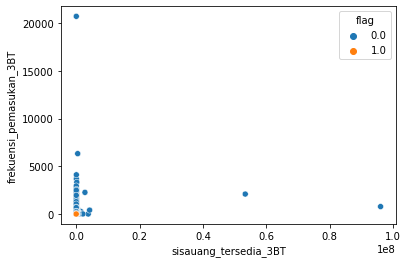

--------------------------------------------------
1733
sisauang_tersedia_3BT frekuensi_pemasukan_4BT


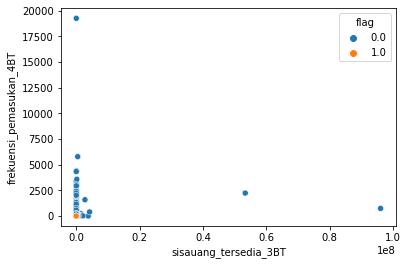

--------------------------------------------------
1734
sisauang_tersedia_3BT frekuensi_pemasukan_5BT


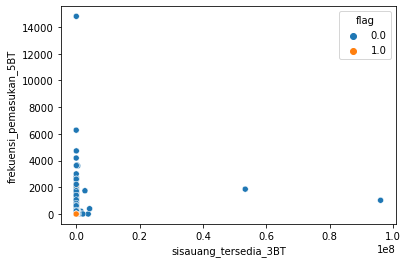

--------------------------------------------------
1735
sisauang_tersedia_3BT frekuensi_pemasukan_6BT


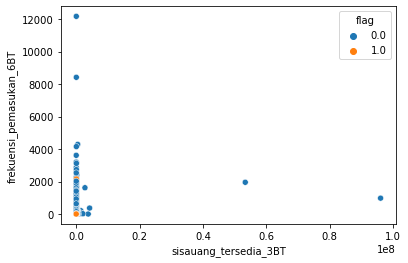

--------------------------------------------------
1736
sisauang_tersedia_3BT flag


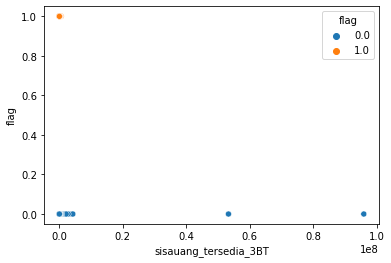

--------------------------------------------------
1737
sisauang_tersedia_4BT sisauang_tersedia_4BT


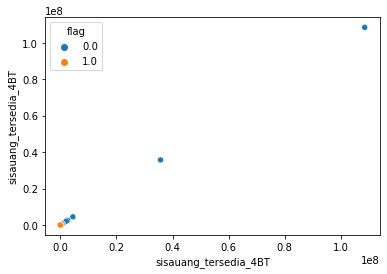

--------------------------------------------------
1738
sisauang_tersedia_4BT sisauang_tersedia_5BT


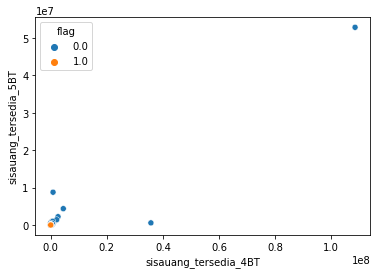

--------------------------------------------------
1739
sisauang_tersedia_4BT sisauang_tersedia_6BT


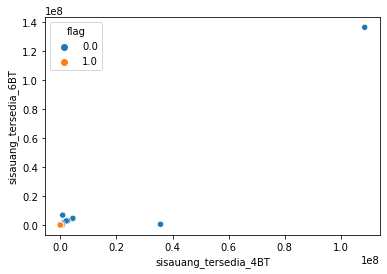

--------------------------------------------------
1740
sisauang_tersedia_4BT sisa_hutang_1BT


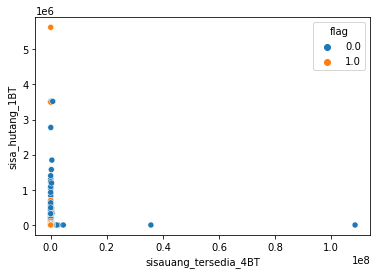

--------------------------------------------------
1741
sisauang_tersedia_4BT sisa_hutang_2BT


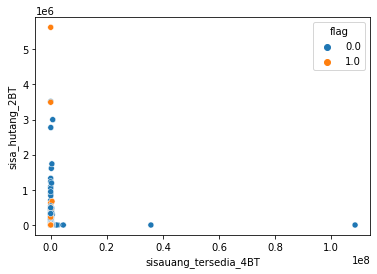

--------------------------------------------------
1742
sisauang_tersedia_4BT sisa_hutang_3BT


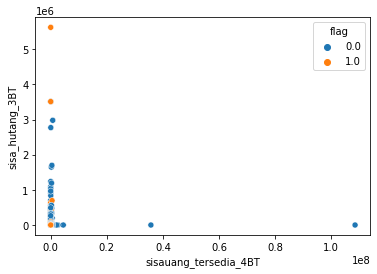

--------------------------------------------------
1743
sisauang_tersedia_4BT sisa_hutang_4BT


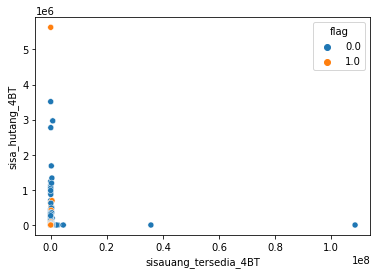

--------------------------------------------------
1744
sisauang_tersedia_4BT sisa_hutang_5BT


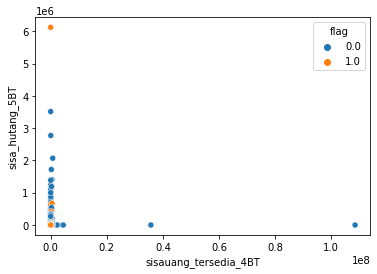

--------------------------------------------------
1745
sisauang_tersedia_4BT sisa_hutang_6BT


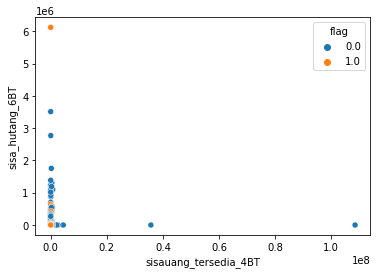

--------------------------------------------------
1746
sisauang_tersedia_4BT jumlah_pembayaran_hutang_1BT


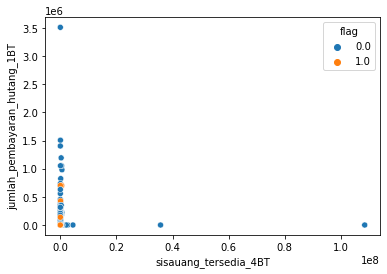

--------------------------------------------------
1747
sisauang_tersedia_4BT jumlah_pembayaran_hutang_2BT


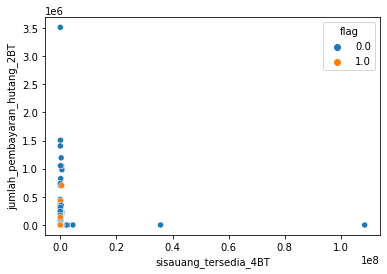

--------------------------------------------------
1748
sisauang_tersedia_4BT jumlah_pembayaran_hutang_3BT


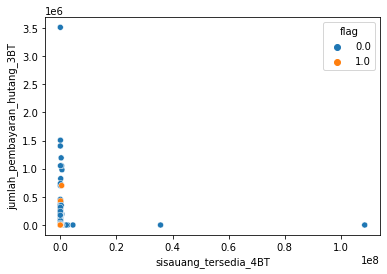

--------------------------------------------------
1749
sisauang_tersedia_4BT jumlah_pembayaran_hutang_4BT


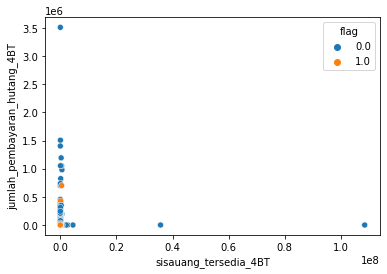

--------------------------------------------------
1750
sisauang_tersedia_4BT jumlah_pembayaran_hutang_5BT


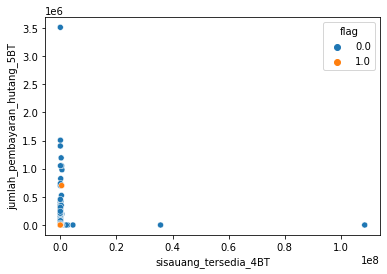

--------------------------------------------------
1751
sisauang_tersedia_4BT jumlah_pembayaran_hutang_6BT


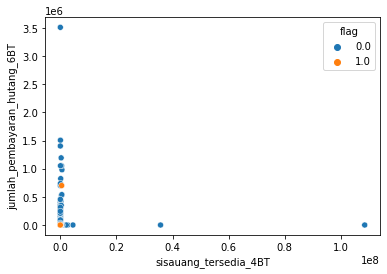

--------------------------------------------------
1752
sisauang_tersedia_4BT jumlah_pengeluaran_1BT


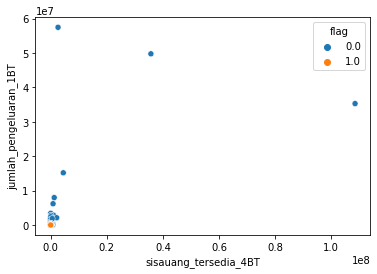

--------------------------------------------------
1753
sisauang_tersedia_4BT jumlah_pengeluaran_2BT


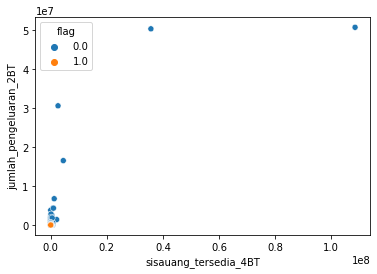

--------------------------------------------------
1754
sisauang_tersedia_4BT jumlah_pengeluaran_3BT


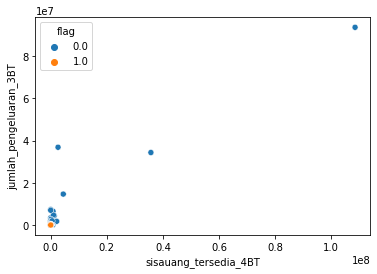

--------------------------------------------------
1755
sisauang_tersedia_4BT jumlah_pengeluaran_4BT


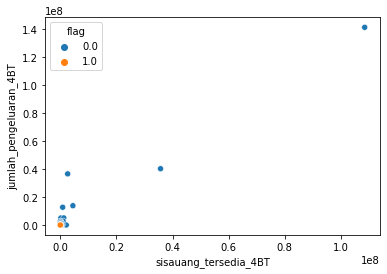

--------------------------------------------------
1756
sisauang_tersedia_4BT jumlah_pengeluaran_5BT


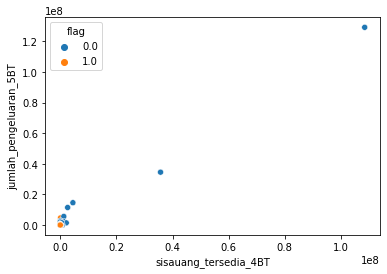

--------------------------------------------------
1757
sisauang_tersedia_4BT jumlah_pengeluaran_6BT


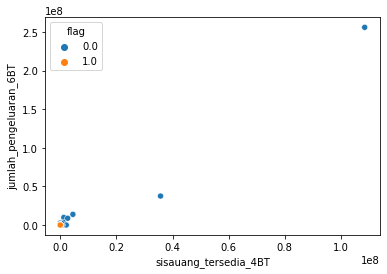

--------------------------------------------------
1758
sisauang_tersedia_4BT jumlah_pemasukan_1BT


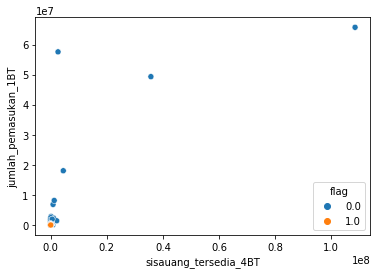

--------------------------------------------------
1759
sisauang_tersedia_4BT jumlah_pemasukan_2BT


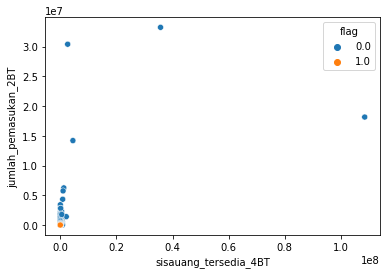

--------------------------------------------------
1760
sisauang_tersedia_4BT jumlah_pemasukan_3BT


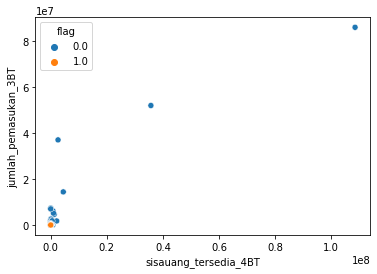

--------------------------------------------------
1761
sisauang_tersedia_4BT jumlah_pemasukan_4BT


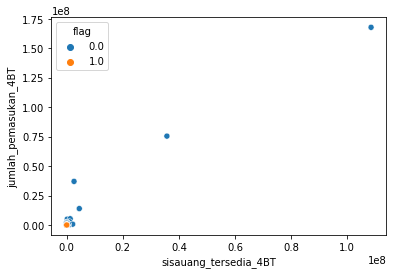

--------------------------------------------------
1762
sisauang_tersedia_4BT jumlah_pemasukan_5BT


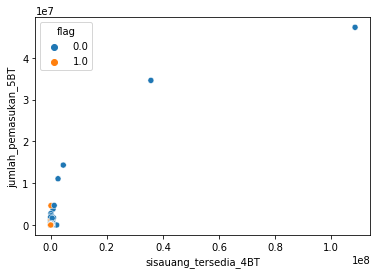

--------------------------------------------------
1763
sisauang_tersedia_4BT jumlah_pemasukan_6BT


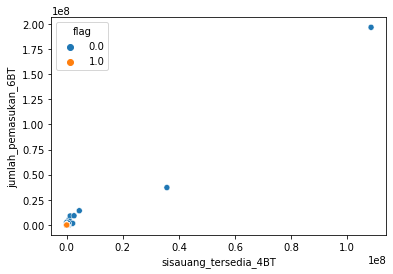

--------------------------------------------------
1764
sisauang_tersedia_4BT frekuensi_pengeluaran_1BT


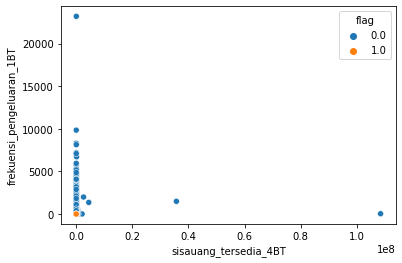

--------------------------------------------------
1765
sisauang_tersedia_4BT frekuensi_pengeluaran_2BT


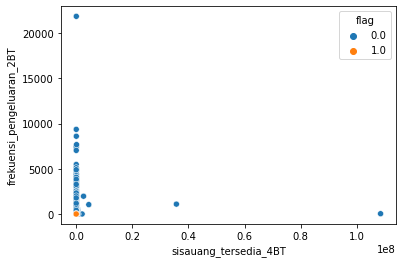

--------------------------------------------------
1766
sisauang_tersedia_4BT frekuensi_pengeluaran_3BT


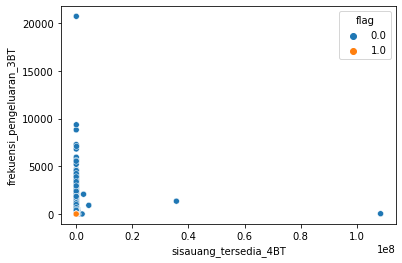

--------------------------------------------------
1767
sisauang_tersedia_4BT frekuensi_pengeluaran_4BT


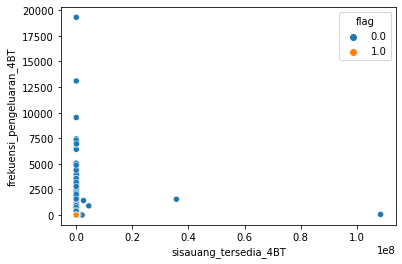

--------------------------------------------------
1768
sisauang_tersedia_4BT frekuensi_pengeluaran_5BT


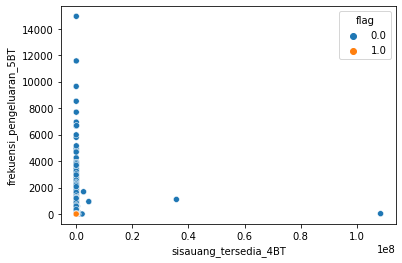

--------------------------------------------------
1769
sisauang_tersedia_4BT frekuensi_pengeluaran_6BT


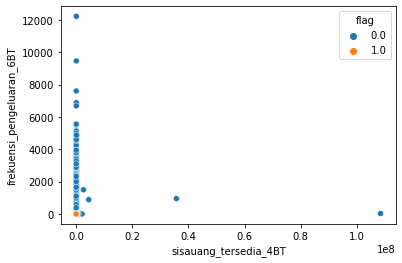

--------------------------------------------------
1770
sisauang_tersedia_4BT frekuensi_pemasukan_1BT


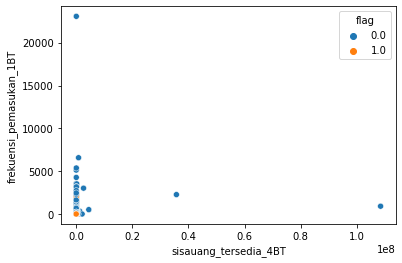

--------------------------------------------------
1771
sisauang_tersedia_4BT frekuensi_pemasukan_2BT


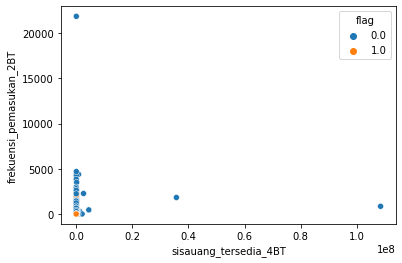

--------------------------------------------------
1772
sisauang_tersedia_4BT frekuensi_pemasukan_3BT


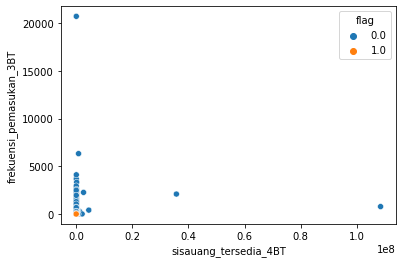

--------------------------------------------------
1773
sisauang_tersedia_4BT frekuensi_pemasukan_4BT


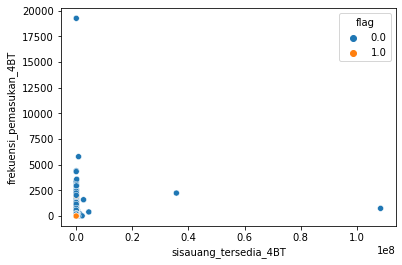

--------------------------------------------------
1774
sisauang_tersedia_4BT frekuensi_pemasukan_5BT


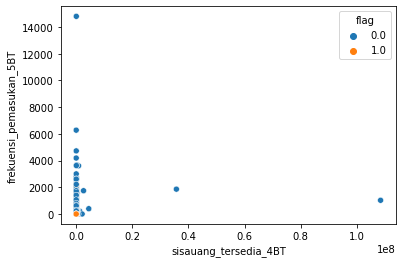

--------------------------------------------------
1775
sisauang_tersedia_4BT frekuensi_pemasukan_6BT


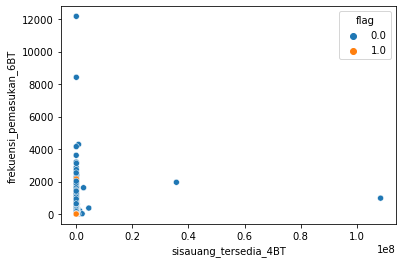

--------------------------------------------------
1776
sisauang_tersedia_4BT flag


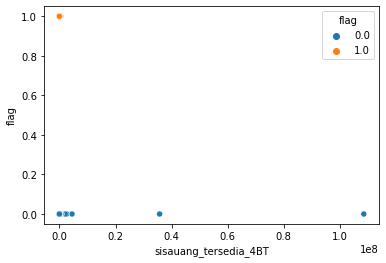

--------------------------------------------------
1777
sisauang_tersedia_5BT sisauang_tersedia_5BT


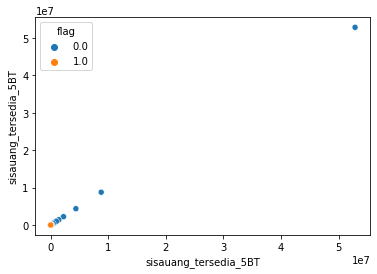

--------------------------------------------------
1778
sisauang_tersedia_5BT sisauang_tersedia_6BT


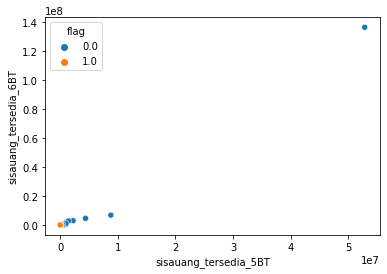

--------------------------------------------------
1779
sisauang_tersedia_5BT sisa_hutang_1BT


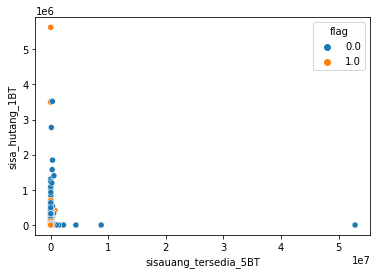

--------------------------------------------------
1780
sisauang_tersedia_5BT sisa_hutang_2BT


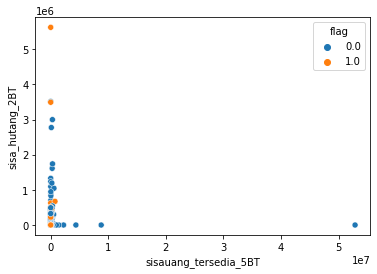

--------------------------------------------------
1781
sisauang_tersedia_5BT sisa_hutang_3BT


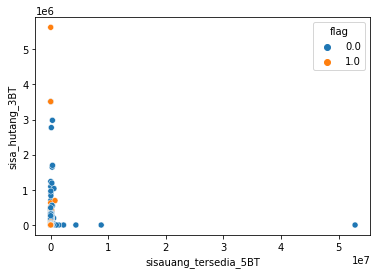

--------------------------------------------------
1782
sisauang_tersedia_5BT sisa_hutang_4BT


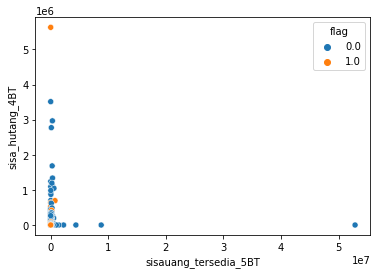

--------------------------------------------------
1783
sisauang_tersedia_5BT sisa_hutang_5BT


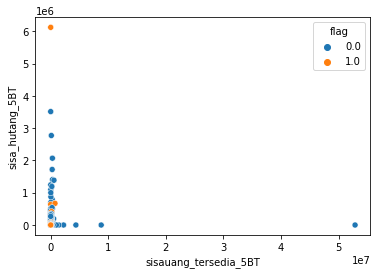

--------------------------------------------------
1784
sisauang_tersedia_5BT sisa_hutang_6BT


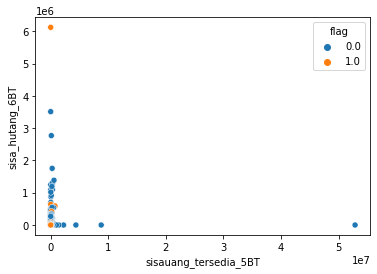

--------------------------------------------------
1785
sisauang_tersedia_5BT jumlah_pembayaran_hutang_1BT


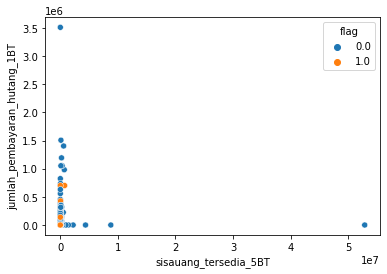

--------------------------------------------------
1786
sisauang_tersedia_5BT jumlah_pembayaran_hutang_2BT


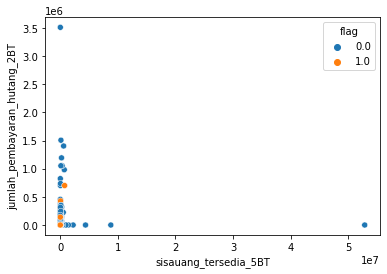

--------------------------------------------------
1787
sisauang_tersedia_5BT jumlah_pembayaran_hutang_3BT


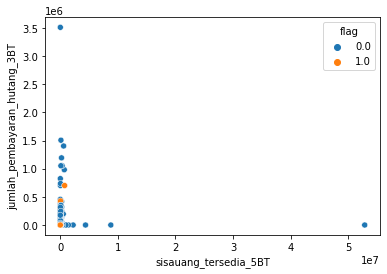

--------------------------------------------------
1788
sisauang_tersedia_5BT jumlah_pembayaran_hutang_4BT


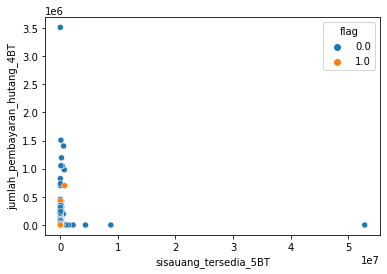

--------------------------------------------------
1789
sisauang_tersedia_5BT jumlah_pembayaran_hutang_5BT


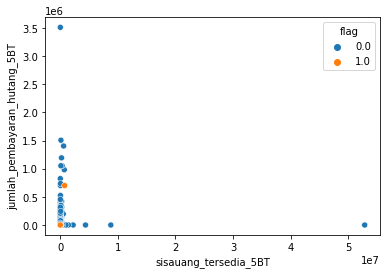

--------------------------------------------------
1790
sisauang_tersedia_5BT jumlah_pembayaran_hutang_6BT


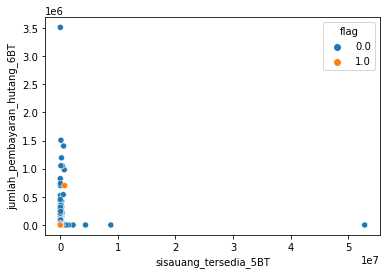

--------------------------------------------------
1791
sisauang_tersedia_5BT jumlah_pengeluaran_1BT


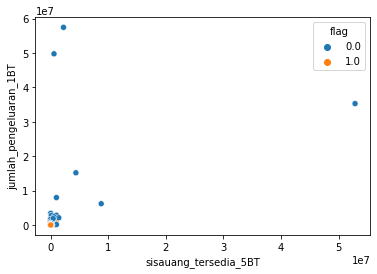

--------------------------------------------------
1792
sisauang_tersedia_5BT jumlah_pengeluaran_2BT


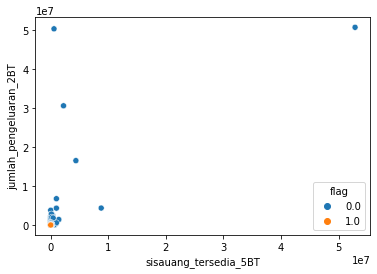

--------------------------------------------------
1793
sisauang_tersedia_5BT jumlah_pengeluaran_3BT


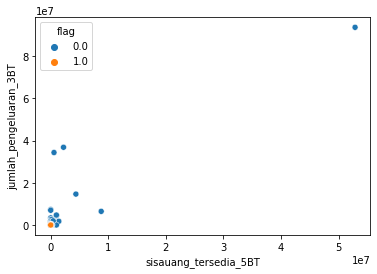

--------------------------------------------------
1794
sisauang_tersedia_5BT jumlah_pengeluaran_4BT


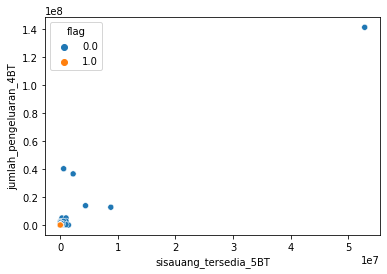

--------------------------------------------------
1795
sisauang_tersedia_5BT jumlah_pengeluaran_5BT


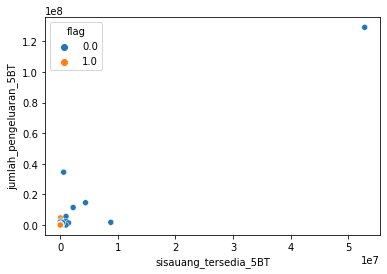

--------------------------------------------------
1796
sisauang_tersedia_5BT jumlah_pengeluaran_6BT


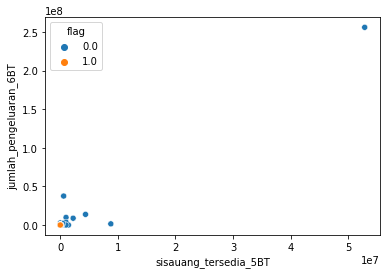

--------------------------------------------------
1797
sisauang_tersedia_5BT jumlah_pemasukan_1BT


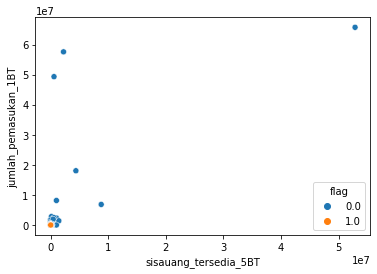

--------------------------------------------------
1798
sisauang_tersedia_5BT jumlah_pemasukan_2BT


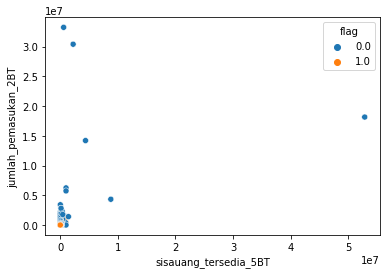

--------------------------------------------------
1799
sisauang_tersedia_5BT jumlah_pemasukan_3BT


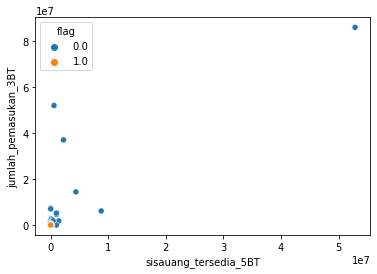

--------------------------------------------------
1800
sisauang_tersedia_5BT jumlah_pemasukan_4BT


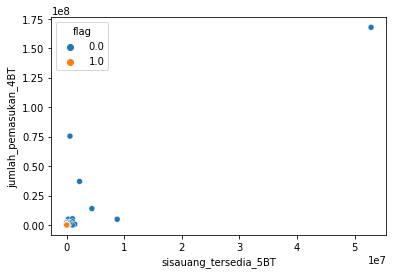

--------------------------------------------------
1801
sisauang_tersedia_5BT jumlah_pemasukan_5BT


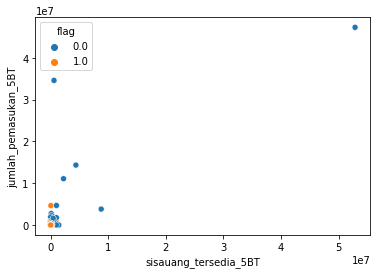

--------------------------------------------------
1802
sisauang_tersedia_5BT jumlah_pemasukan_6BT


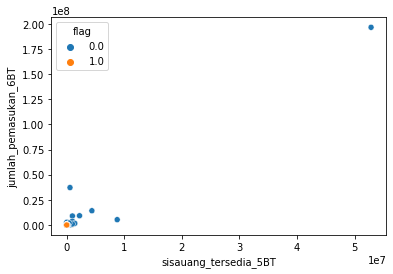

--------------------------------------------------
1803
sisauang_tersedia_5BT frekuensi_pengeluaran_1BT


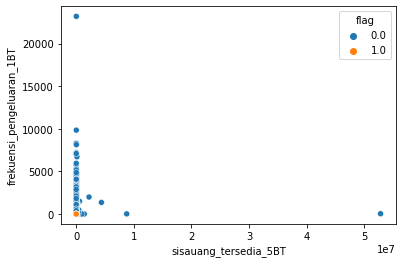

--------------------------------------------------
1804
sisauang_tersedia_5BT frekuensi_pengeluaran_2BT


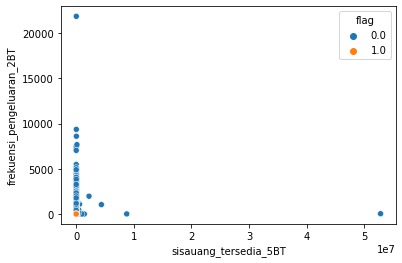

--------------------------------------------------
1805
sisauang_tersedia_5BT frekuensi_pengeluaran_3BT


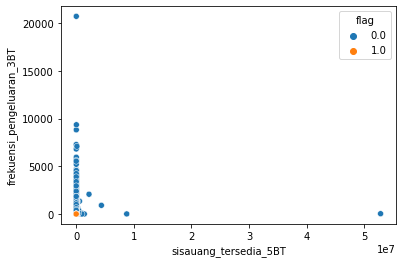

--------------------------------------------------
1806
sisauang_tersedia_5BT frekuensi_pengeluaran_4BT


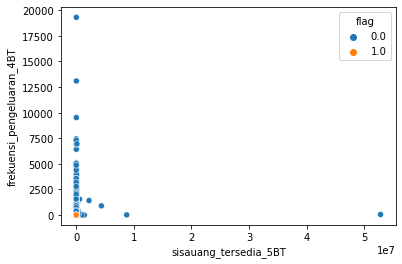

--------------------------------------------------
1807
sisauang_tersedia_5BT frekuensi_pengeluaran_5BT


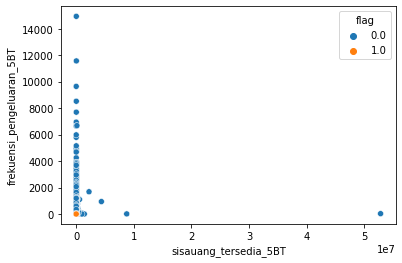

--------------------------------------------------
1808
sisauang_tersedia_5BT frekuensi_pengeluaran_6BT


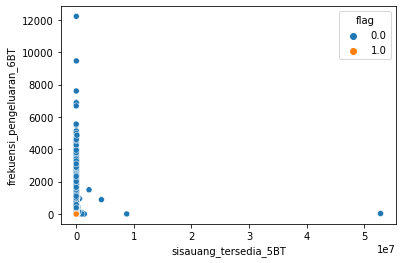

--------------------------------------------------
1809
sisauang_tersedia_5BT frekuensi_pemasukan_1BT


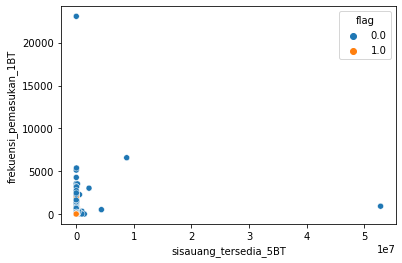

--------------------------------------------------
1810
sisauang_tersedia_5BT frekuensi_pemasukan_2BT


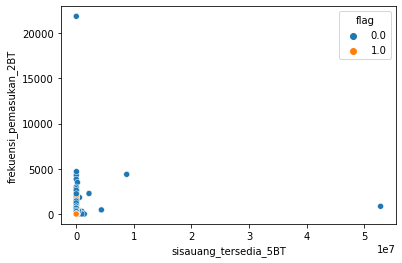

--------------------------------------------------
1811
sisauang_tersedia_5BT frekuensi_pemasukan_3BT


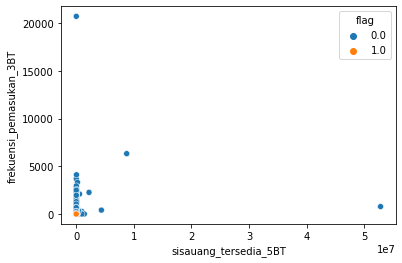

--------------------------------------------------
1812
sisauang_tersedia_5BT frekuensi_pemasukan_4BT


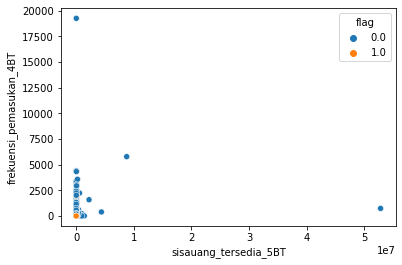

--------------------------------------------------
1813
sisauang_tersedia_5BT frekuensi_pemasukan_5BT


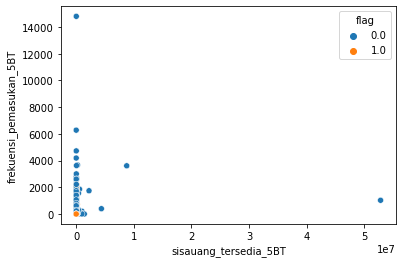

--------------------------------------------------
1814
sisauang_tersedia_5BT frekuensi_pemasukan_6BT


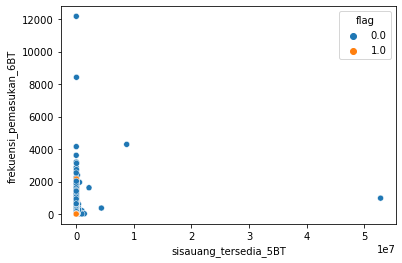

--------------------------------------------------
1815
sisauang_tersedia_5BT flag


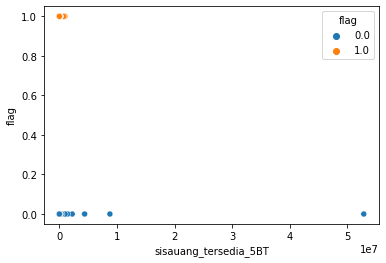

--------------------------------------------------
1816
sisauang_tersedia_6BT sisauang_tersedia_6BT


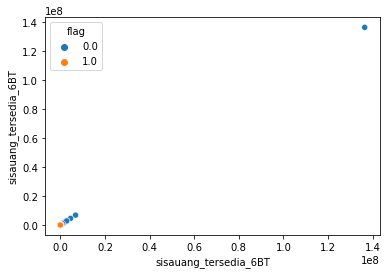

--------------------------------------------------
1817
sisauang_tersedia_6BT sisa_hutang_1BT


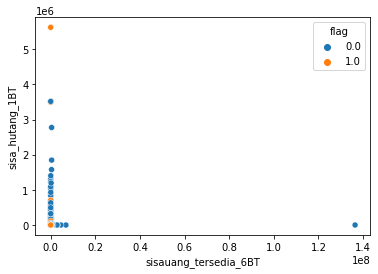

--------------------------------------------------
1818
sisauang_tersedia_6BT sisa_hutang_2BT


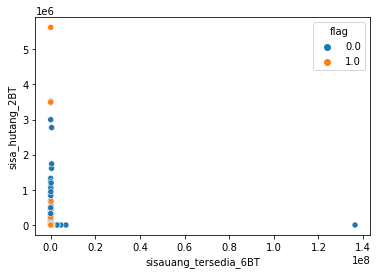

--------------------------------------------------
1819
sisauang_tersedia_6BT sisa_hutang_3BT


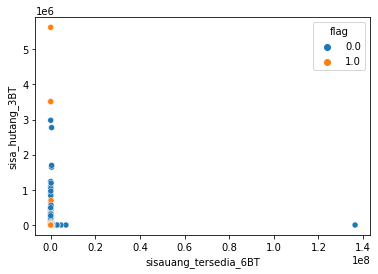

--------------------------------------------------
1820
sisauang_tersedia_6BT sisa_hutang_4BT


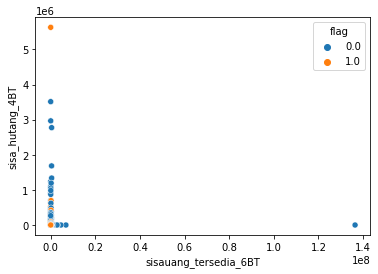

--------------------------------------------------
1821
sisauang_tersedia_6BT sisa_hutang_5BT


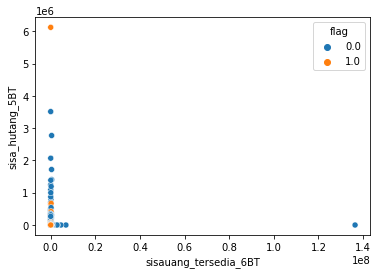

--------------------------------------------------
1822
sisauang_tersedia_6BT sisa_hutang_6BT


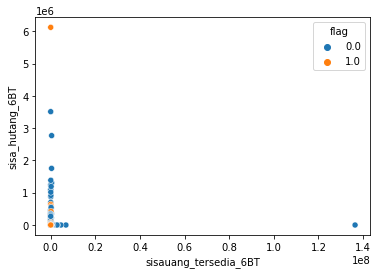

--------------------------------------------------
1823
sisauang_tersedia_6BT jumlah_pembayaran_hutang_1BT


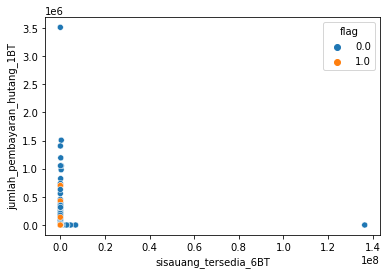

--------------------------------------------------
1824
sisauang_tersedia_6BT jumlah_pembayaran_hutang_2BT


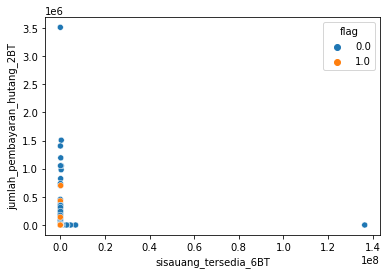

--------------------------------------------------
1825
sisauang_tersedia_6BT jumlah_pembayaran_hutang_3BT


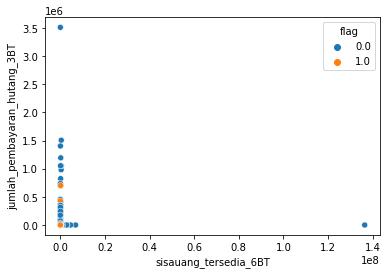

--------------------------------------------------
1826
sisauang_tersedia_6BT jumlah_pembayaran_hutang_4BT


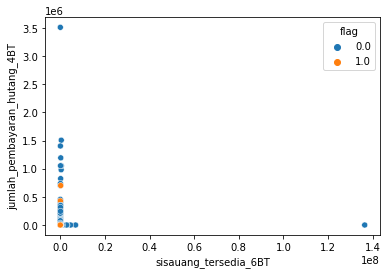

--------------------------------------------------
1827
sisauang_tersedia_6BT jumlah_pembayaran_hutang_5BT


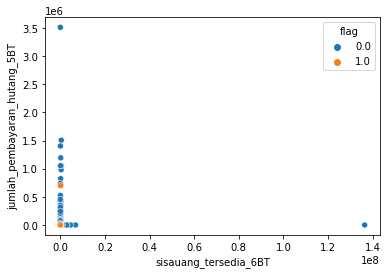

--------------------------------------------------
1828
sisauang_tersedia_6BT jumlah_pembayaran_hutang_6BT


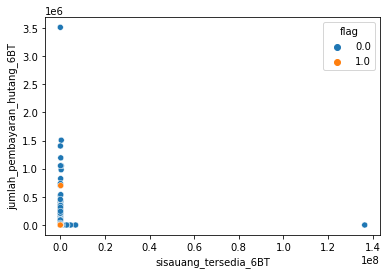

--------------------------------------------------
1829
sisauang_tersedia_6BT jumlah_pengeluaran_1BT


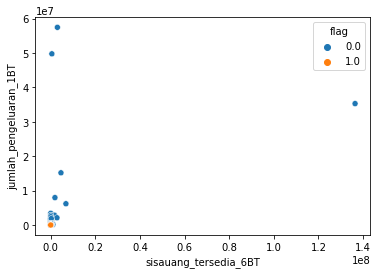

--------------------------------------------------
1830
sisauang_tersedia_6BT jumlah_pengeluaran_2BT


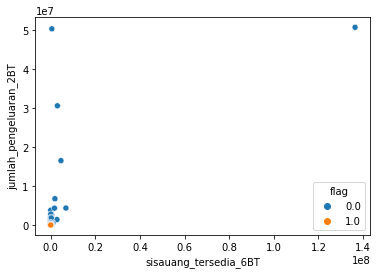

--------------------------------------------------
1831
sisauang_tersedia_6BT jumlah_pengeluaran_3BT


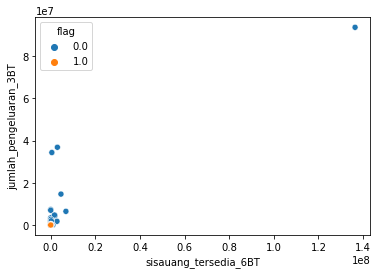

--------------------------------------------------
1832
sisauang_tersedia_6BT jumlah_pengeluaran_4BT


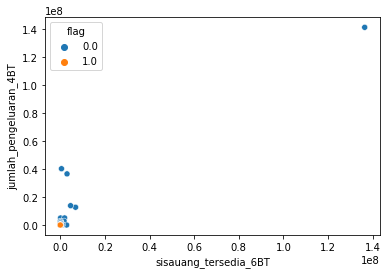

--------------------------------------------------
1833
sisauang_tersedia_6BT jumlah_pengeluaran_5BT


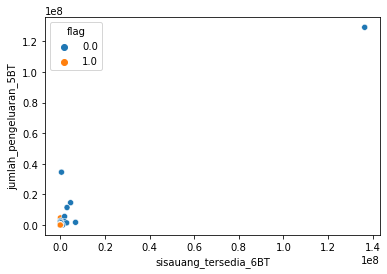

--------------------------------------------------
1834
sisauang_tersedia_6BT jumlah_pengeluaran_6BT


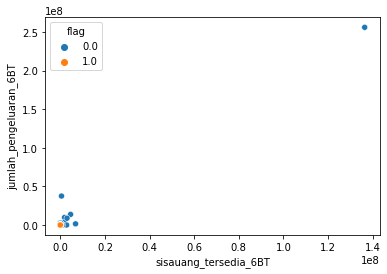

--------------------------------------------------
1835
sisauang_tersedia_6BT jumlah_pemasukan_1BT


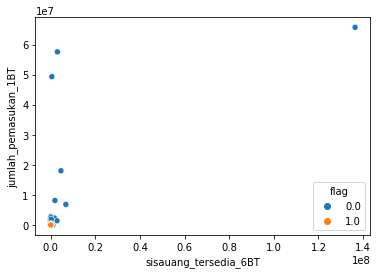

--------------------------------------------------
1836
sisauang_tersedia_6BT jumlah_pemasukan_2BT


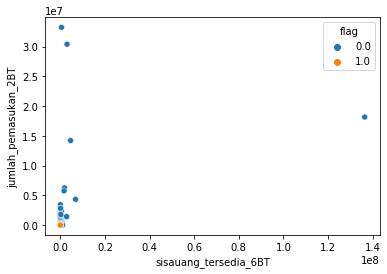

--------------------------------------------------
1837
sisauang_tersedia_6BT jumlah_pemasukan_3BT


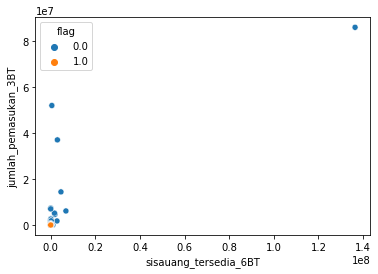

--------------------------------------------------
1838
sisauang_tersedia_6BT jumlah_pemasukan_4BT


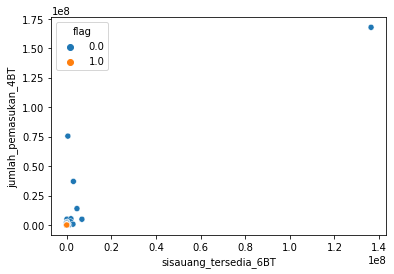

--------------------------------------------------
1839
sisauang_tersedia_6BT jumlah_pemasukan_5BT


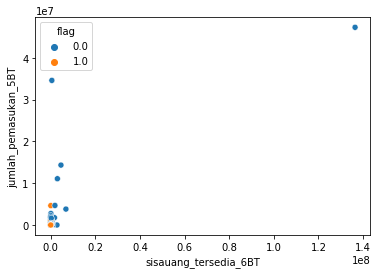

--------------------------------------------------
1840
sisauang_tersedia_6BT jumlah_pemasukan_6BT


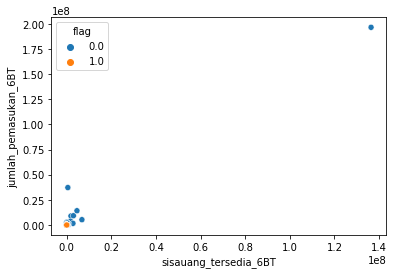

--------------------------------------------------
1841
sisauang_tersedia_6BT frekuensi_pengeluaran_1BT


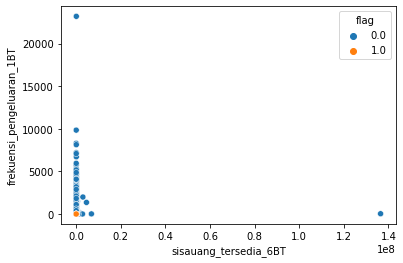

--------------------------------------------------
1842
sisauang_tersedia_6BT frekuensi_pengeluaran_2BT


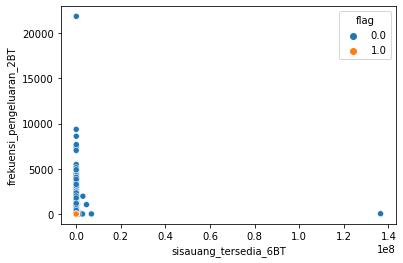

--------------------------------------------------
1843
sisauang_tersedia_6BT frekuensi_pengeluaran_3BT


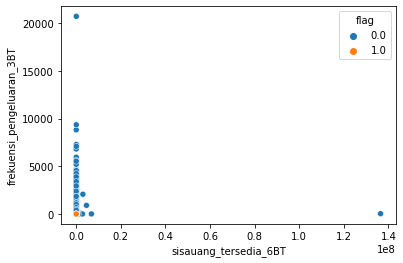

--------------------------------------------------
1844
sisauang_tersedia_6BT frekuensi_pengeluaran_4BT


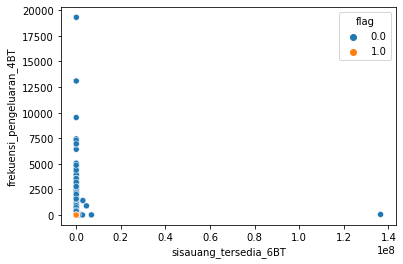

--------------------------------------------------
1845
sisauang_tersedia_6BT frekuensi_pengeluaran_5BT


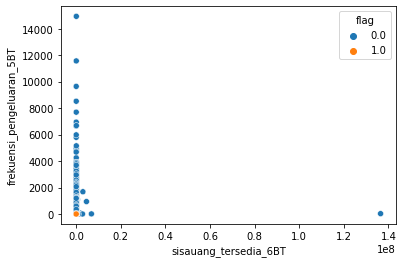

--------------------------------------------------
1846
sisauang_tersedia_6BT frekuensi_pengeluaran_6BT


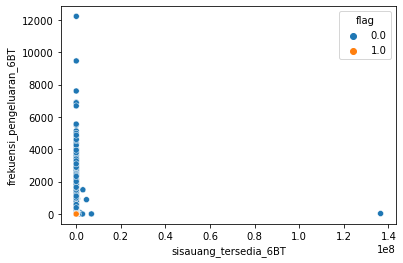

--------------------------------------------------
1847
sisauang_tersedia_6BT frekuensi_pemasukan_1BT


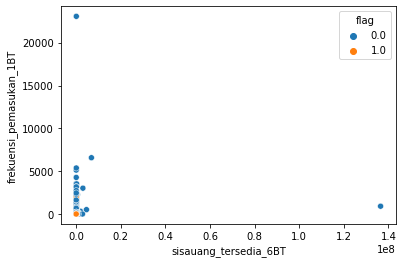

--------------------------------------------------
1848
sisauang_tersedia_6BT frekuensi_pemasukan_2BT


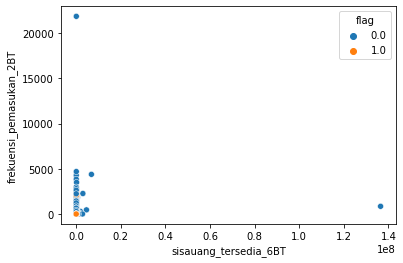

--------------------------------------------------
1849
sisauang_tersedia_6BT frekuensi_pemasukan_3BT


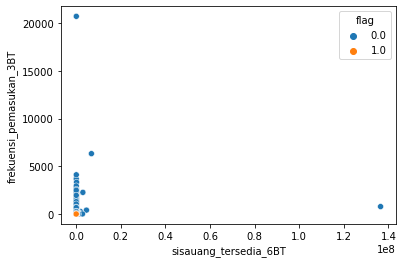

--------------------------------------------------
1850
sisauang_tersedia_6BT frekuensi_pemasukan_4BT


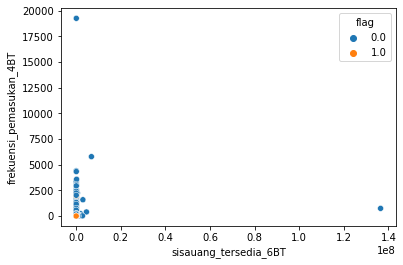

--------------------------------------------------
1851
sisauang_tersedia_6BT frekuensi_pemasukan_5BT


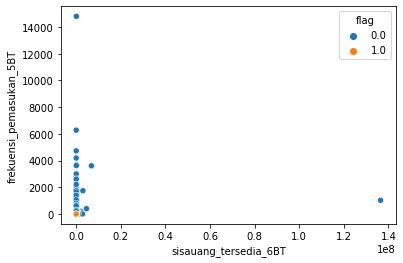

--------------------------------------------------
1852
sisauang_tersedia_6BT frekuensi_pemasukan_6BT


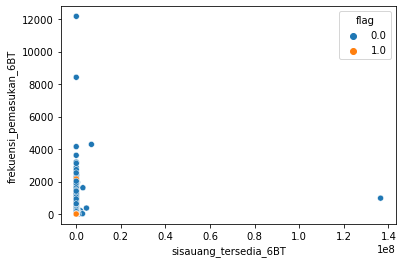

--------------------------------------------------
1853
sisauang_tersedia_6BT flag


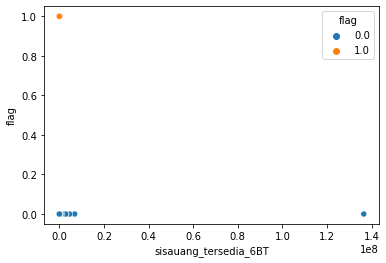

--------------------------------------------------
1854
sisa_hutang_1BT sisa_hutang_1BT


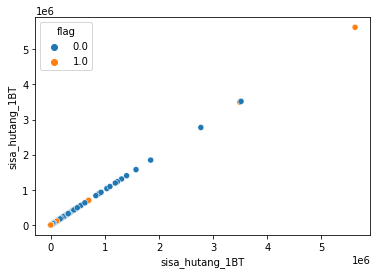

--------------------------------------------------
1855
sisa_hutang_1BT sisa_hutang_2BT


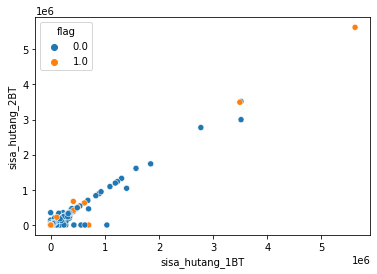

--------------------------------------------------
1856
sisa_hutang_1BT sisa_hutang_3BT


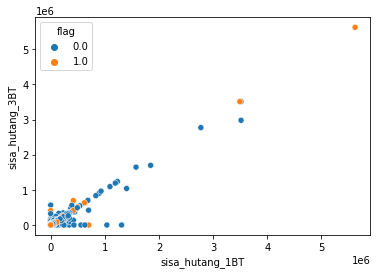

--------------------------------------------------
1857
sisa_hutang_1BT sisa_hutang_4BT


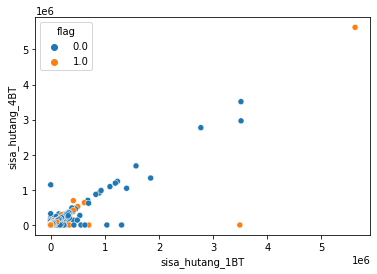

--------------------------------------------------
1858
sisa_hutang_1BT sisa_hutang_5BT


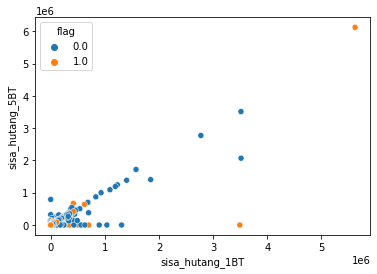

--------------------------------------------------
1859
sisa_hutang_1BT sisa_hutang_6BT


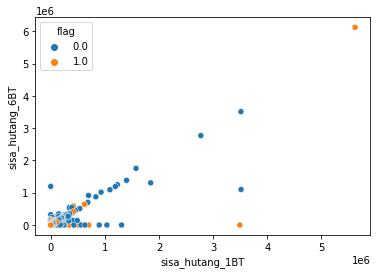

--------------------------------------------------
1860
sisa_hutang_1BT jumlah_pembayaran_hutang_1BT


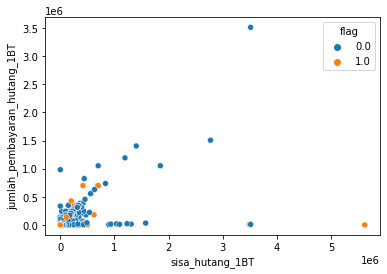

--------------------------------------------------
1861
sisa_hutang_1BT jumlah_pembayaran_hutang_2BT


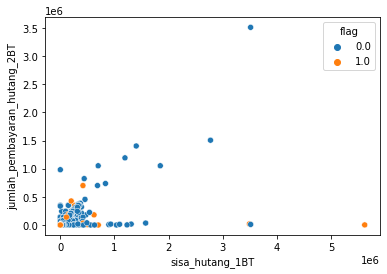

--------------------------------------------------
1862
sisa_hutang_1BT jumlah_pembayaran_hutang_3BT


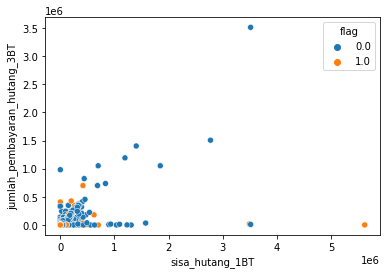

--------------------------------------------------
1863
sisa_hutang_1BT jumlah_pembayaran_hutang_4BT


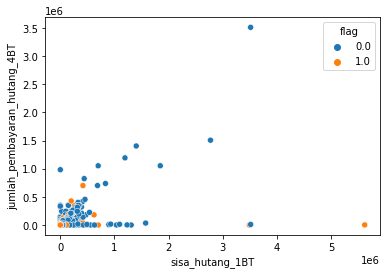

--------------------------------------------------
1864
sisa_hutang_1BT jumlah_pembayaran_hutang_5BT


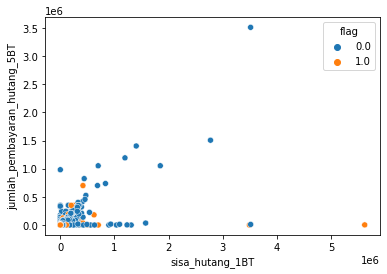

--------------------------------------------------
1865
sisa_hutang_1BT jumlah_pembayaran_hutang_6BT


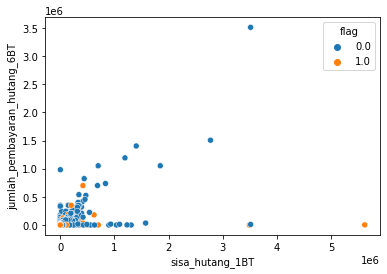

--------------------------------------------------
1866
sisa_hutang_1BT jumlah_pengeluaran_1BT


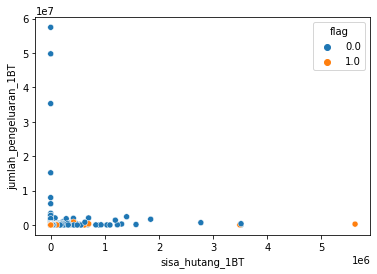

--------------------------------------------------
1867
sisa_hutang_1BT jumlah_pengeluaran_2BT


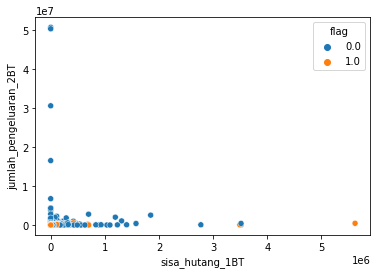

--------------------------------------------------
1868
sisa_hutang_1BT jumlah_pengeluaran_3BT


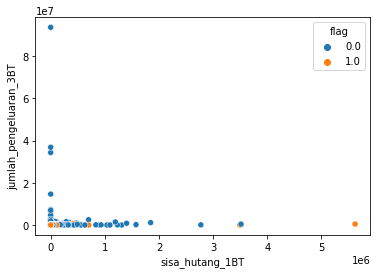

--------------------------------------------------
1869
sisa_hutang_1BT jumlah_pengeluaran_4BT


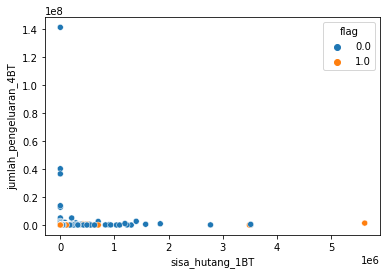

--------------------------------------------------
1870
sisa_hutang_1BT jumlah_pengeluaran_5BT


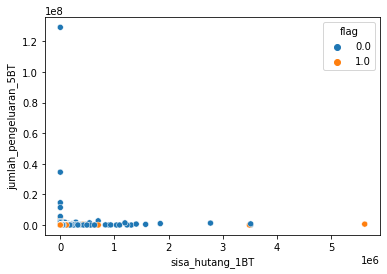

--------------------------------------------------
1871
sisa_hutang_1BT jumlah_pengeluaran_6BT


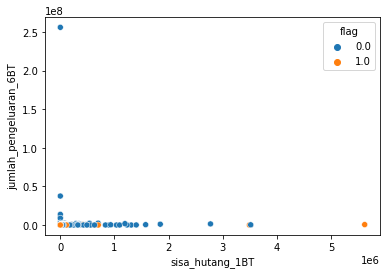

--------------------------------------------------
1872
sisa_hutang_1BT jumlah_pemasukan_1BT


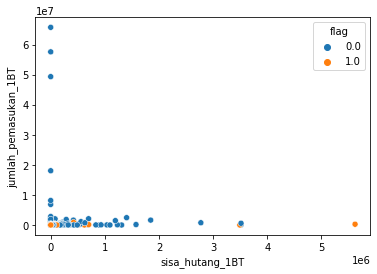

--------------------------------------------------
1873
sisa_hutang_1BT jumlah_pemasukan_2BT


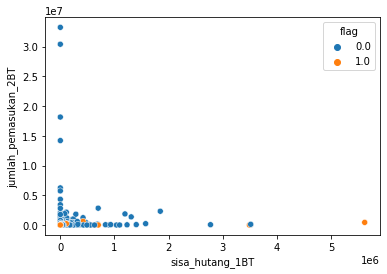

--------------------------------------------------
1874
sisa_hutang_1BT jumlah_pemasukan_3BT


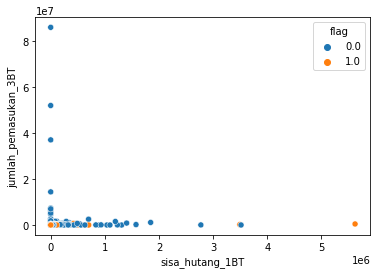

--------------------------------------------------
1875
sisa_hutang_1BT jumlah_pemasukan_4BT


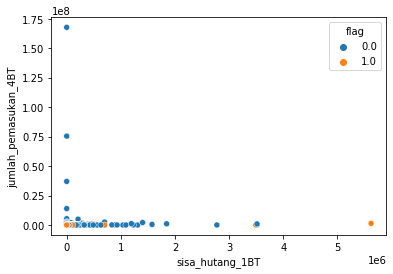

--------------------------------------------------
1876
sisa_hutang_1BT jumlah_pemasukan_5BT


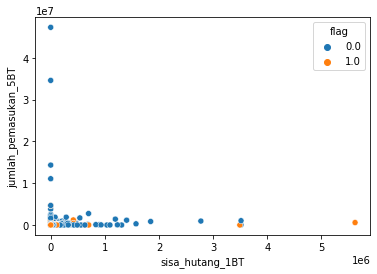

--------------------------------------------------
1877
sisa_hutang_1BT jumlah_pemasukan_6BT


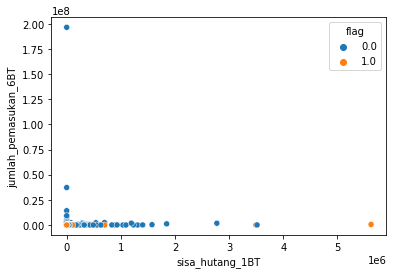

--------------------------------------------------
1878
sisa_hutang_1BT frekuensi_pengeluaran_1BT


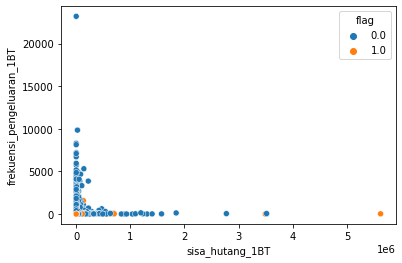

--------------------------------------------------
1879
sisa_hutang_1BT frekuensi_pengeluaran_2BT


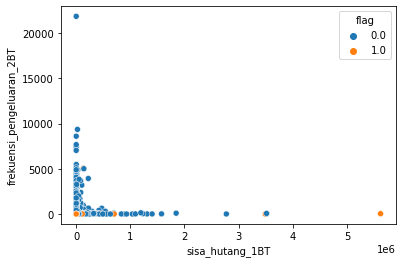

--------------------------------------------------
1880
sisa_hutang_1BT frekuensi_pengeluaran_3BT


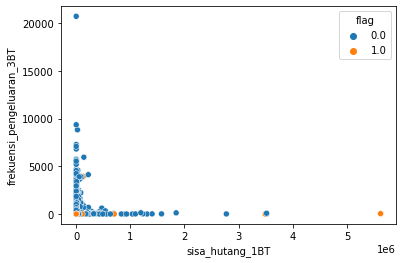

--------------------------------------------------
1881
sisa_hutang_1BT frekuensi_pengeluaran_4BT


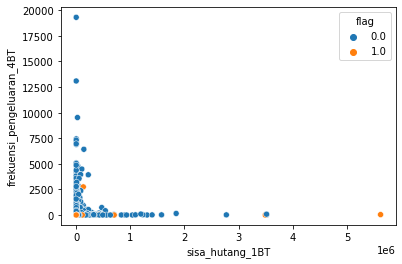

--------------------------------------------------
1882
sisa_hutang_1BT frekuensi_pengeluaran_5BT


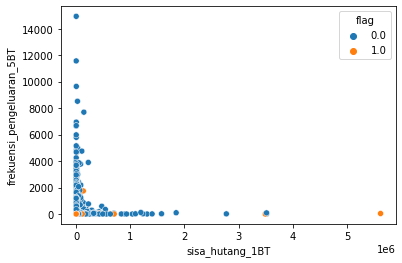

--------------------------------------------------
1883
sisa_hutang_1BT frekuensi_pengeluaran_6BT


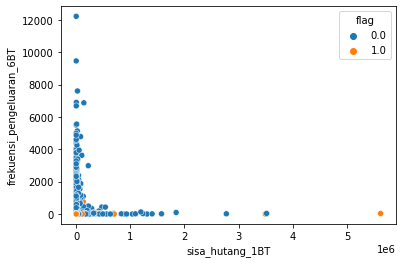

--------------------------------------------------
1884
sisa_hutang_1BT frekuensi_pemasukan_1BT


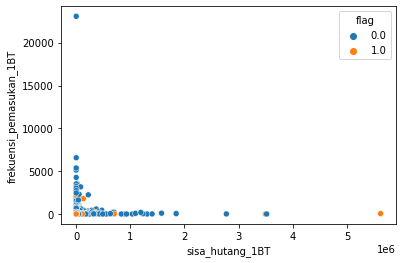

--------------------------------------------------
1885
sisa_hutang_1BT frekuensi_pemasukan_2BT


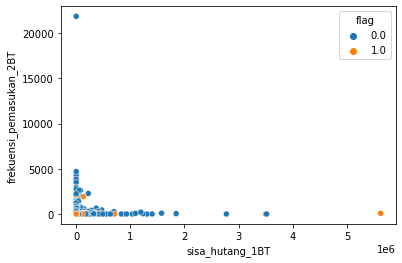

--------------------------------------------------
1886
sisa_hutang_1BT frekuensi_pemasukan_3BT


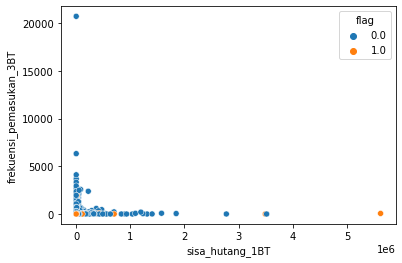

--------------------------------------------------
1887
sisa_hutang_1BT frekuensi_pemasukan_4BT


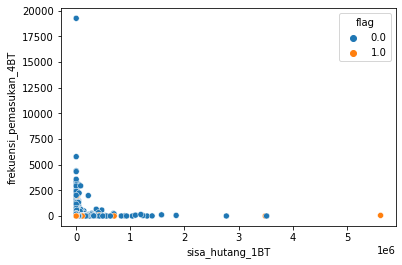

--------------------------------------------------
1888
sisa_hutang_1BT frekuensi_pemasukan_5BT


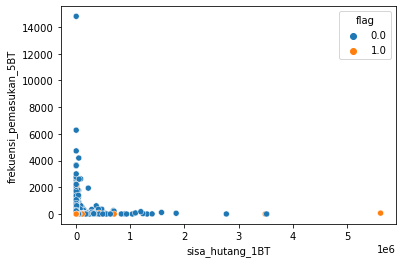

--------------------------------------------------
1889
sisa_hutang_1BT frekuensi_pemasukan_6BT


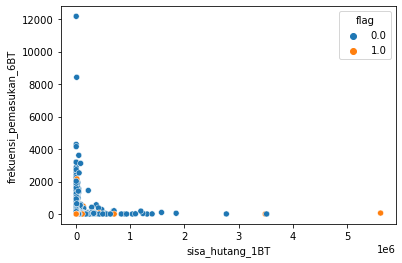

--------------------------------------------------
1890
sisa_hutang_1BT flag


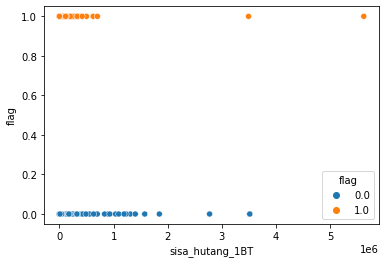

--------------------------------------------------
1891
sisa_hutang_2BT sisa_hutang_2BT


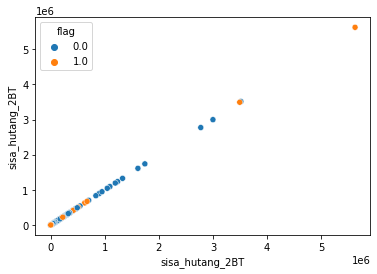

--------------------------------------------------
1892
sisa_hutang_2BT sisa_hutang_3BT


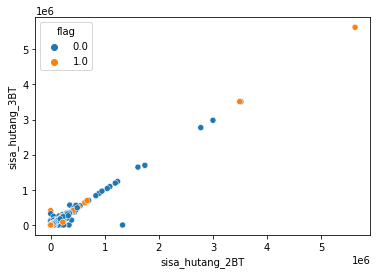

--------------------------------------------------
1893
sisa_hutang_2BT sisa_hutang_4BT


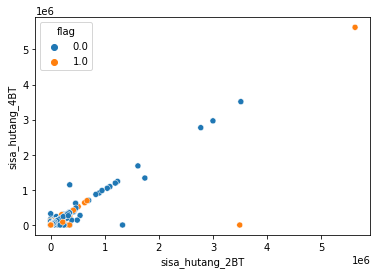

--------------------------------------------------
1894
sisa_hutang_2BT sisa_hutang_5BT


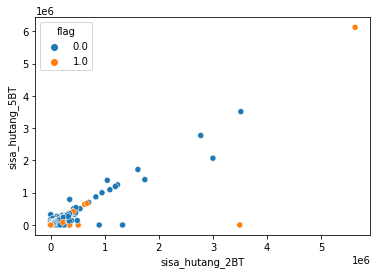

--------------------------------------------------
1895
sisa_hutang_2BT sisa_hutang_6BT


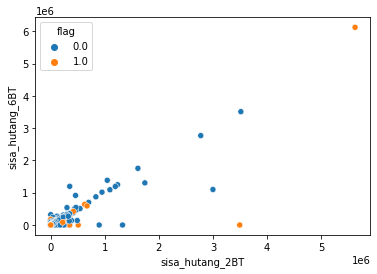

--------------------------------------------------
1896
sisa_hutang_2BT jumlah_pembayaran_hutang_1BT


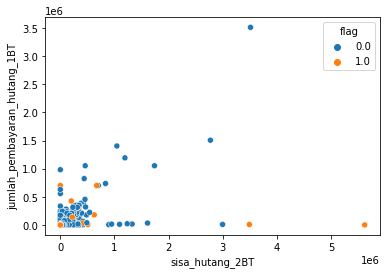

--------------------------------------------------
1897
sisa_hutang_2BT jumlah_pembayaran_hutang_2BT


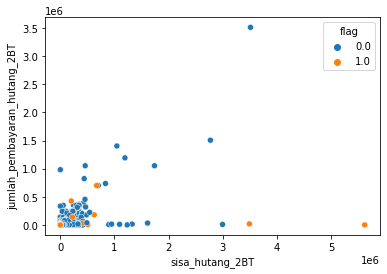

--------------------------------------------------
1898
sisa_hutang_2BT jumlah_pembayaran_hutang_3BT


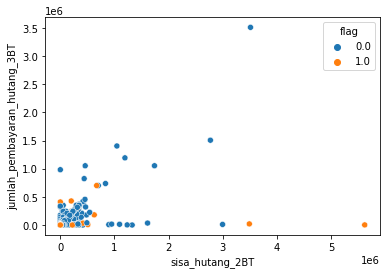

--------------------------------------------------
1899
sisa_hutang_2BT jumlah_pembayaran_hutang_4BT


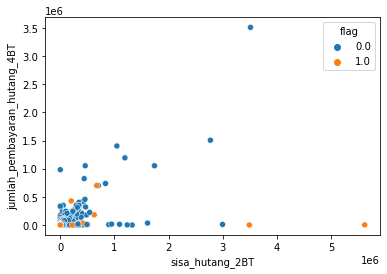

--------------------------------------------------
1900
sisa_hutang_2BT jumlah_pembayaran_hutang_5BT


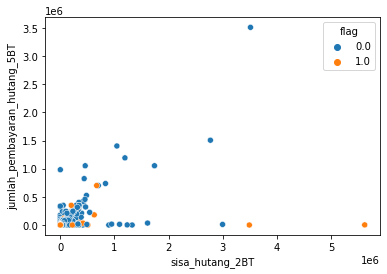

--------------------------------------------------
1901
sisa_hutang_2BT jumlah_pembayaran_hutang_6BT


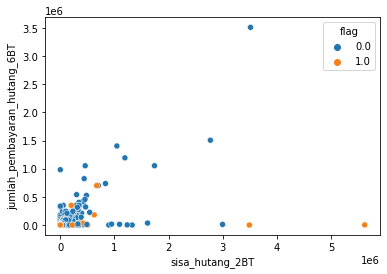

--------------------------------------------------
1902
sisa_hutang_2BT jumlah_pengeluaran_1BT


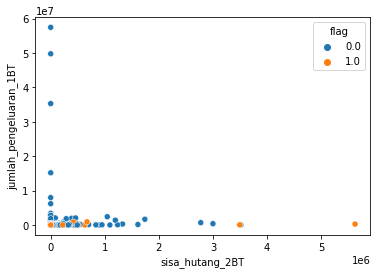

--------------------------------------------------
1903
sisa_hutang_2BT jumlah_pengeluaran_2BT


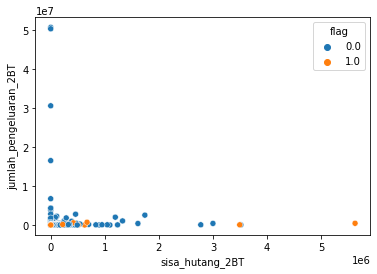

--------------------------------------------------
1904
sisa_hutang_2BT jumlah_pengeluaran_3BT


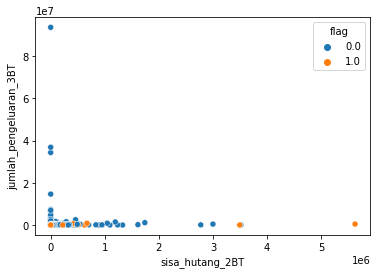

--------------------------------------------------
1905
sisa_hutang_2BT jumlah_pengeluaran_4BT


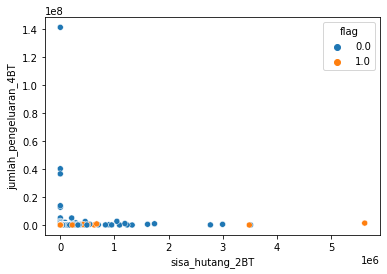

--------------------------------------------------
1906
sisa_hutang_2BT jumlah_pengeluaran_5BT


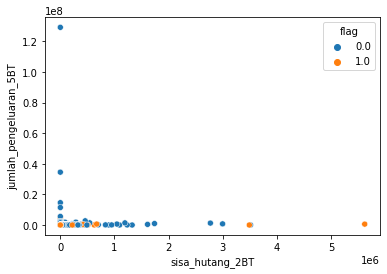

--------------------------------------------------
1907
sisa_hutang_2BT jumlah_pengeluaran_6BT


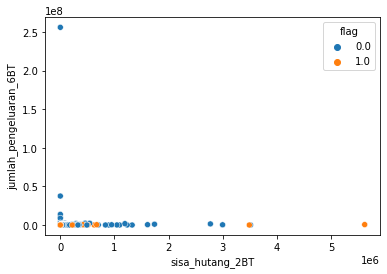

--------------------------------------------------
1908
sisa_hutang_2BT jumlah_pemasukan_1BT


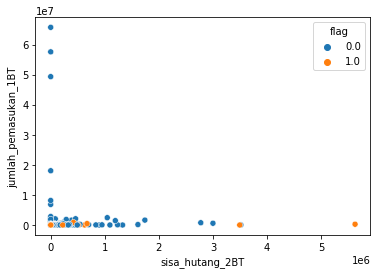

--------------------------------------------------
1909
sisa_hutang_2BT jumlah_pemasukan_2BT


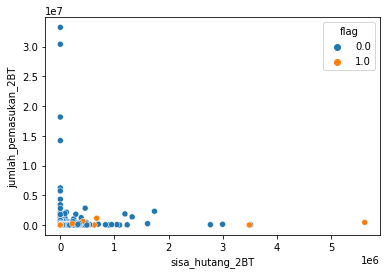

--------------------------------------------------
1910
sisa_hutang_2BT jumlah_pemasukan_3BT


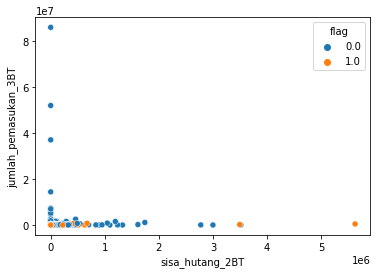

--------------------------------------------------
1911
sisa_hutang_2BT jumlah_pemasukan_4BT


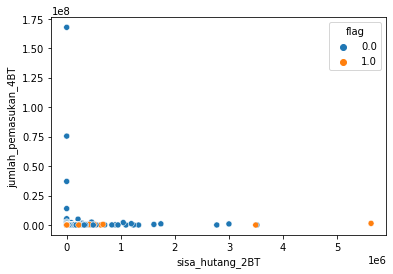

--------------------------------------------------
1912
sisa_hutang_2BT jumlah_pemasukan_5BT


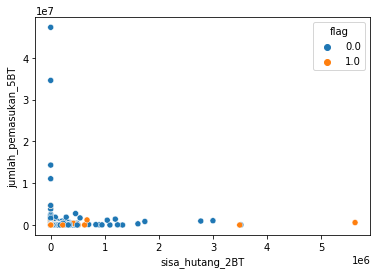

--------------------------------------------------
1913
sisa_hutang_2BT jumlah_pemasukan_6BT


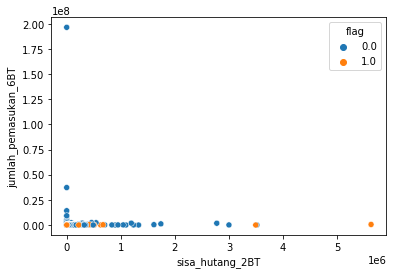

--------------------------------------------------
1914
sisa_hutang_2BT frekuensi_pengeluaran_1BT


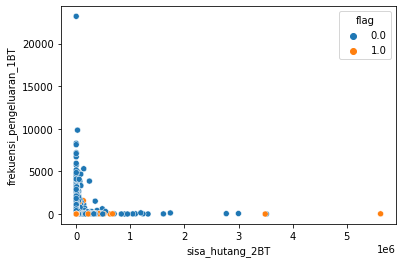

--------------------------------------------------
1915
sisa_hutang_2BT frekuensi_pengeluaran_2BT


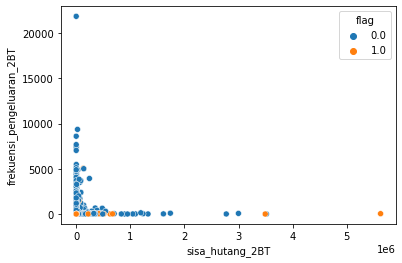

--------------------------------------------------
1916
sisa_hutang_2BT frekuensi_pengeluaran_3BT


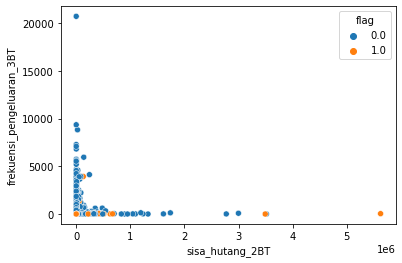

--------------------------------------------------
1917
sisa_hutang_2BT frekuensi_pengeluaran_4BT


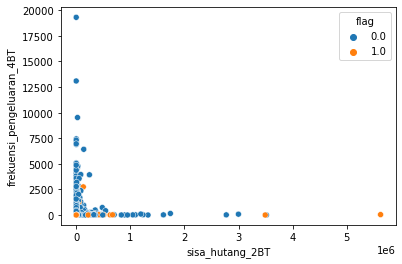

--------------------------------------------------
1918
sisa_hutang_2BT frekuensi_pengeluaran_5BT


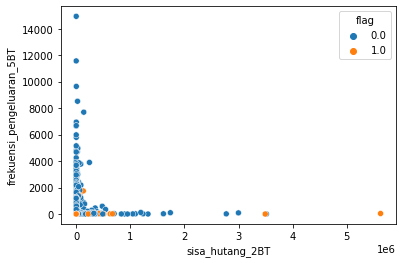

--------------------------------------------------
1919
sisa_hutang_2BT frekuensi_pengeluaran_6BT


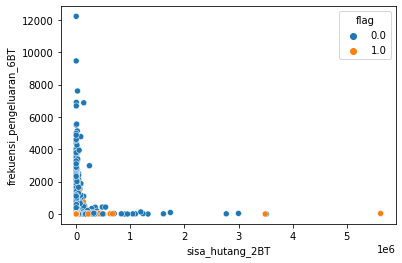

--------------------------------------------------
1920
sisa_hutang_2BT frekuensi_pemasukan_1BT


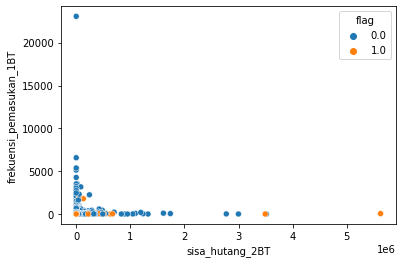

--------------------------------------------------
1921
sisa_hutang_2BT frekuensi_pemasukan_2BT


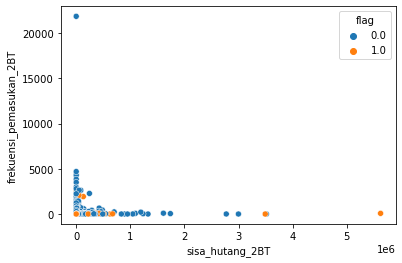

--------------------------------------------------
1922
sisa_hutang_2BT frekuensi_pemasukan_3BT


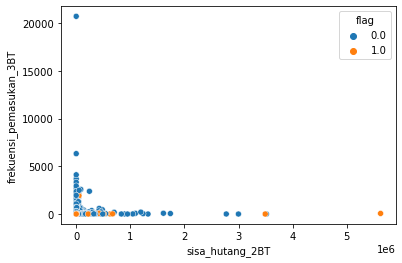

--------------------------------------------------
1923
sisa_hutang_2BT frekuensi_pemasukan_4BT


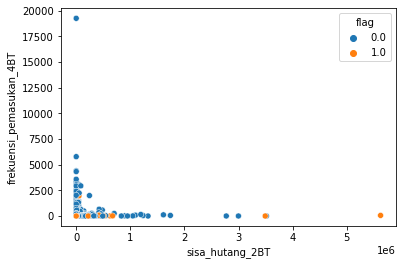

--------------------------------------------------
1924
sisa_hutang_2BT frekuensi_pemasukan_5BT


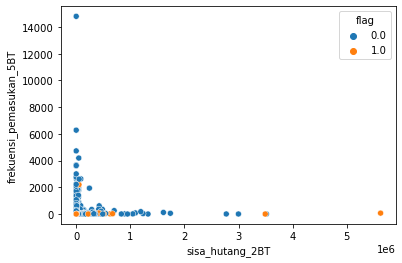

--------------------------------------------------
1925
sisa_hutang_2BT frekuensi_pemasukan_6BT


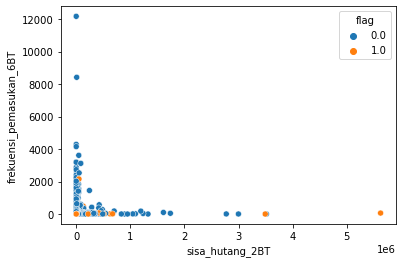

--------------------------------------------------
1926
sisa_hutang_2BT flag


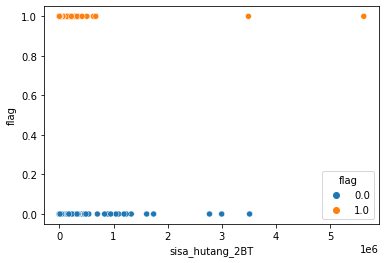

--------------------------------------------------
1927
sisa_hutang_3BT sisa_hutang_3BT


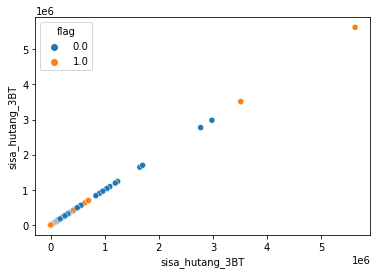

--------------------------------------------------
1928
sisa_hutang_3BT sisa_hutang_4BT


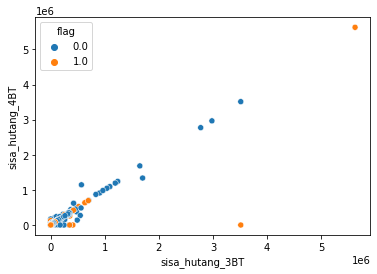

--------------------------------------------------
1929
sisa_hutang_3BT sisa_hutang_5BT


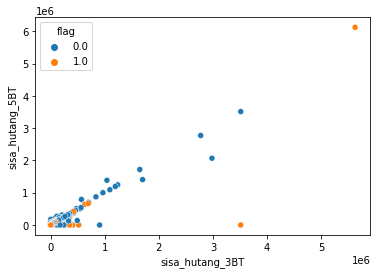

--------------------------------------------------
1930
sisa_hutang_3BT sisa_hutang_6BT


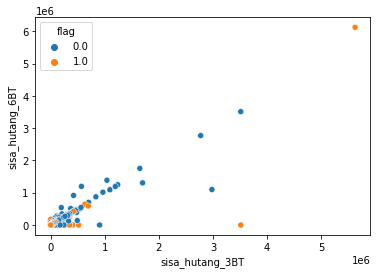

--------------------------------------------------
1931
sisa_hutang_3BT jumlah_pembayaran_hutang_1BT


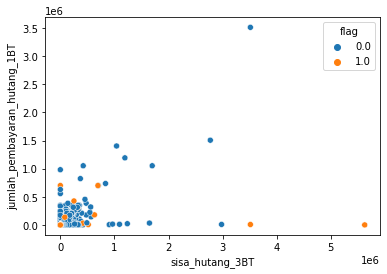

--------------------------------------------------
1932
sisa_hutang_3BT jumlah_pembayaran_hutang_2BT


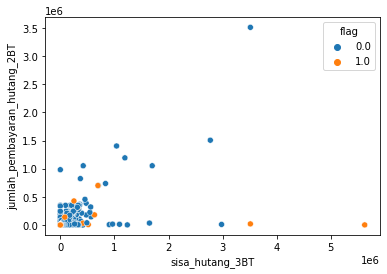

--------------------------------------------------
1933
sisa_hutang_3BT jumlah_pembayaran_hutang_3BT


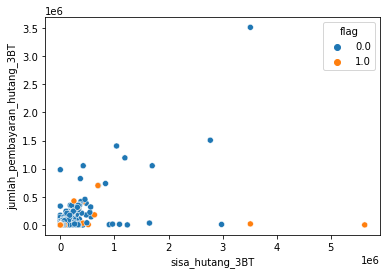

--------------------------------------------------
1934
sisa_hutang_3BT jumlah_pembayaran_hutang_4BT


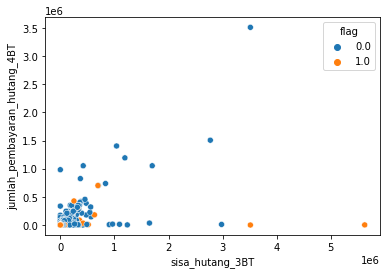

--------------------------------------------------
1935
sisa_hutang_3BT jumlah_pembayaran_hutang_5BT


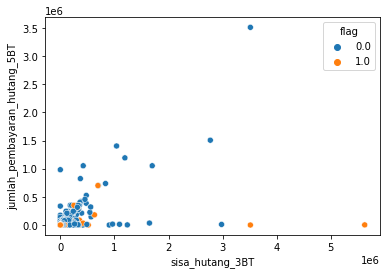

--------------------------------------------------
1936
sisa_hutang_3BT jumlah_pembayaran_hutang_6BT


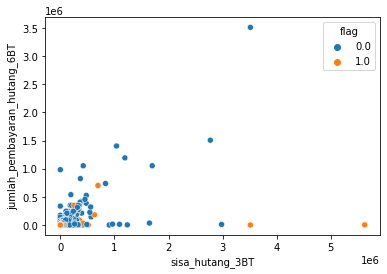

--------------------------------------------------
1937
sisa_hutang_3BT jumlah_pengeluaran_1BT


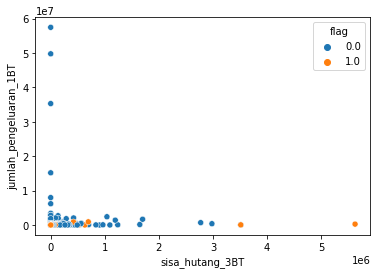

--------------------------------------------------
1938
sisa_hutang_3BT jumlah_pengeluaran_2BT


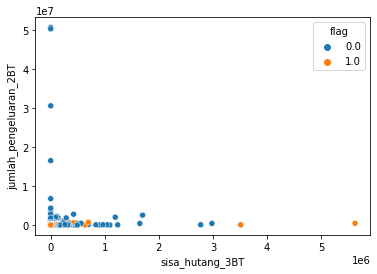

--------------------------------------------------
1939
sisa_hutang_3BT jumlah_pengeluaran_3BT


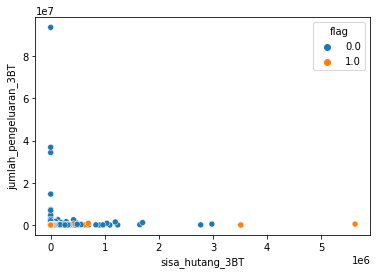

--------------------------------------------------
1940
sisa_hutang_3BT jumlah_pengeluaran_4BT


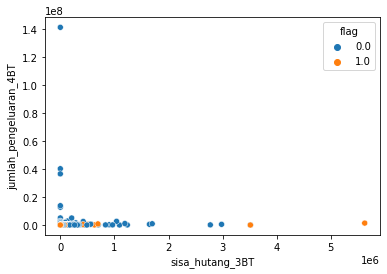

--------------------------------------------------
1941
sisa_hutang_3BT jumlah_pengeluaran_5BT


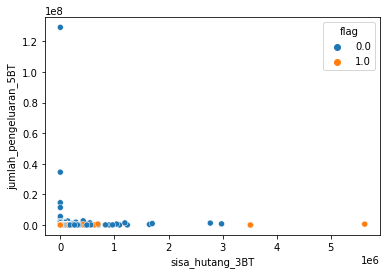

--------------------------------------------------
1942
sisa_hutang_3BT jumlah_pengeluaran_6BT


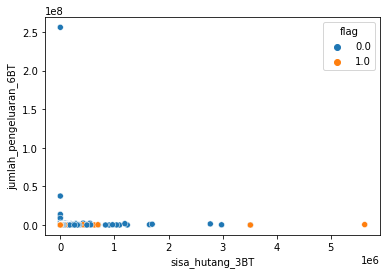

--------------------------------------------------
1943
sisa_hutang_3BT jumlah_pemasukan_1BT


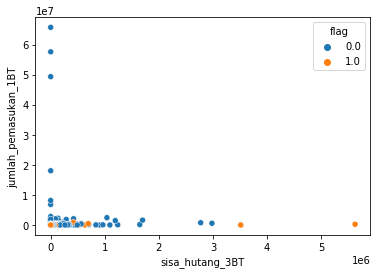

--------------------------------------------------
1944
sisa_hutang_3BT jumlah_pemasukan_2BT


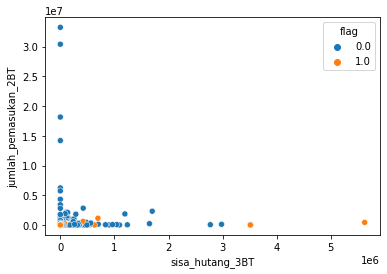

--------------------------------------------------
1945
sisa_hutang_3BT jumlah_pemasukan_3BT


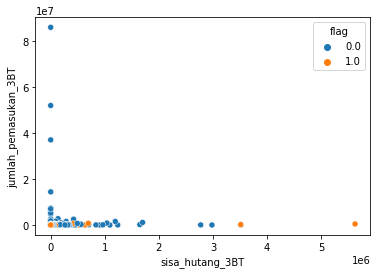

--------------------------------------------------
1946
sisa_hutang_3BT jumlah_pemasukan_4BT


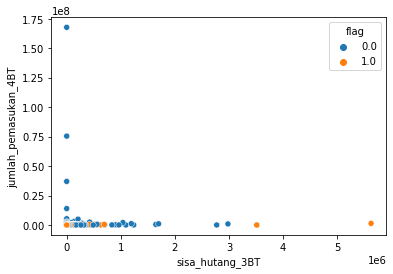

--------------------------------------------------
1947
sisa_hutang_3BT jumlah_pemasukan_5BT


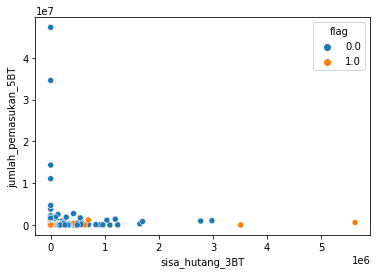

--------------------------------------------------
1948
sisa_hutang_3BT jumlah_pemasukan_6BT


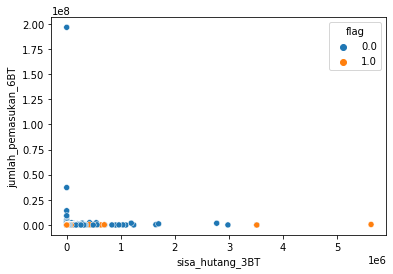

--------------------------------------------------
1949
sisa_hutang_3BT frekuensi_pengeluaran_1BT


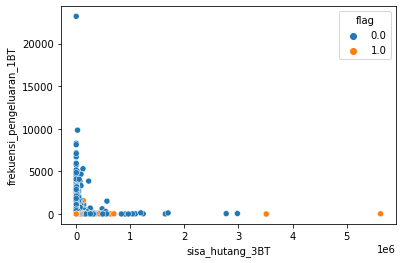

--------------------------------------------------
1950
sisa_hutang_3BT frekuensi_pengeluaran_2BT


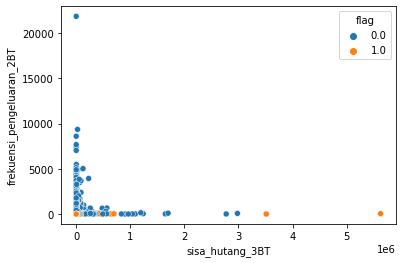

--------------------------------------------------
1951
sisa_hutang_3BT frekuensi_pengeluaran_3BT


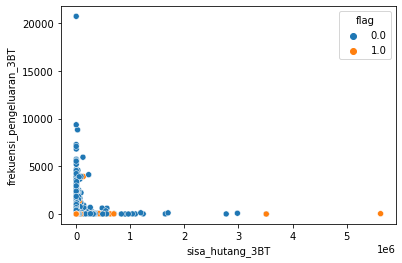

--------------------------------------------------
1952
sisa_hutang_3BT frekuensi_pengeluaran_4BT


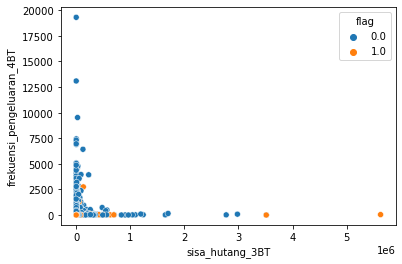

--------------------------------------------------
1953
sisa_hutang_3BT frekuensi_pengeluaran_5BT


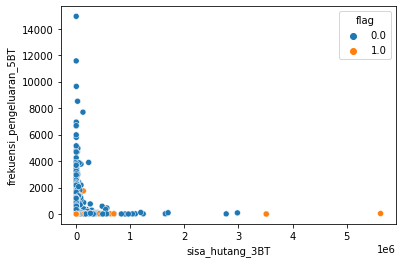

--------------------------------------------------
1954
sisa_hutang_3BT frekuensi_pengeluaran_6BT


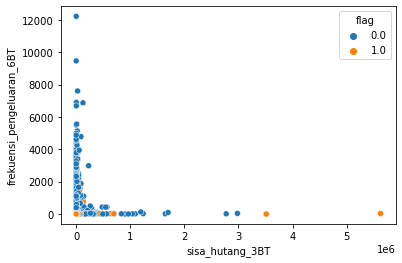

--------------------------------------------------
1955
sisa_hutang_3BT frekuensi_pemasukan_1BT


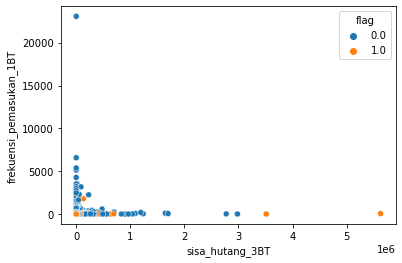

--------------------------------------------------
1956
sisa_hutang_3BT frekuensi_pemasukan_2BT


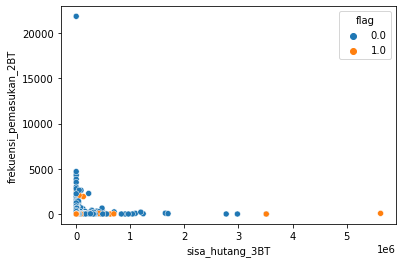

--------------------------------------------------
1957
sisa_hutang_3BT frekuensi_pemasukan_3BT


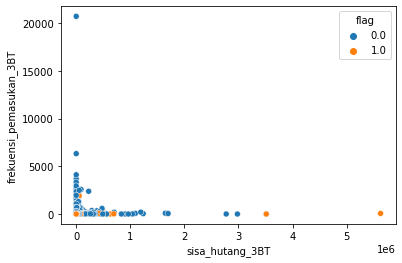

--------------------------------------------------
1958
sisa_hutang_3BT frekuensi_pemasukan_4BT


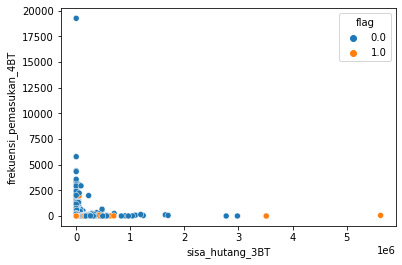

--------------------------------------------------
1959
sisa_hutang_3BT frekuensi_pemasukan_5BT


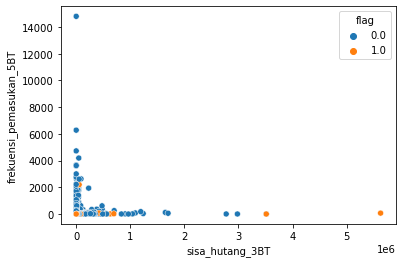

--------------------------------------------------
1960
sisa_hutang_3BT frekuensi_pemasukan_6BT


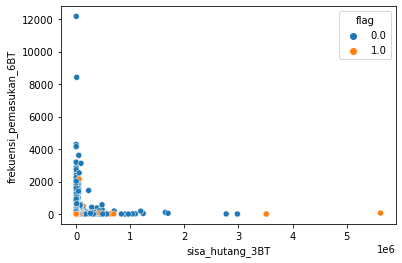

--------------------------------------------------
1961
sisa_hutang_3BT flag


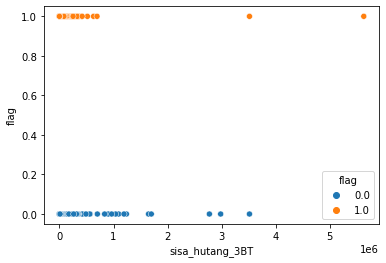

--------------------------------------------------
1962
sisa_hutang_4BT sisa_hutang_4BT


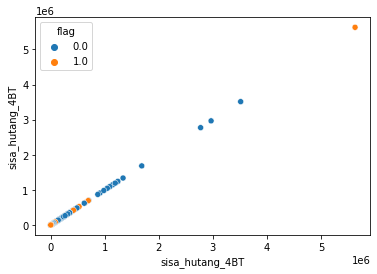

--------------------------------------------------
1963
sisa_hutang_4BT sisa_hutang_5BT


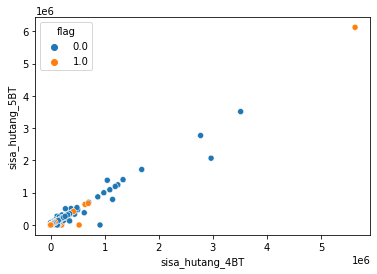

--------------------------------------------------
1964
sisa_hutang_4BT sisa_hutang_6BT


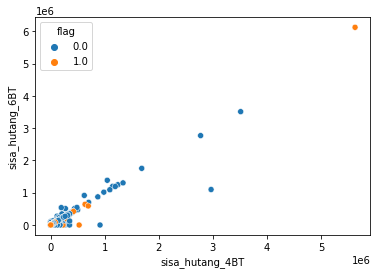

--------------------------------------------------
1965
sisa_hutang_4BT jumlah_pembayaran_hutang_1BT


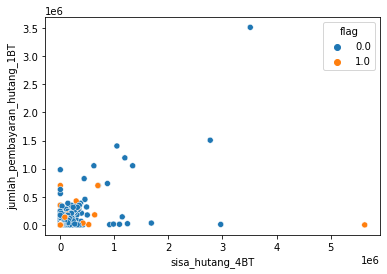

--------------------------------------------------
1966
sisa_hutang_4BT jumlah_pembayaran_hutang_2BT


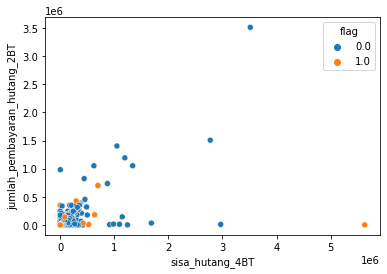

--------------------------------------------------
1967
sisa_hutang_4BT jumlah_pembayaran_hutang_3BT


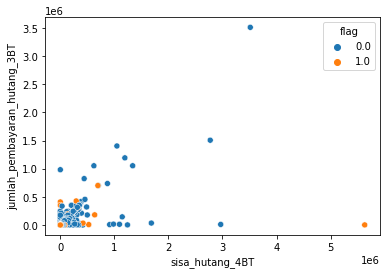

--------------------------------------------------
1968
sisa_hutang_4BT jumlah_pembayaran_hutang_4BT


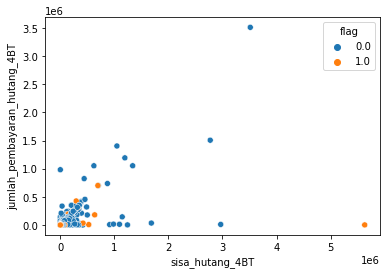

--------------------------------------------------
1969
sisa_hutang_4BT jumlah_pembayaran_hutang_5BT


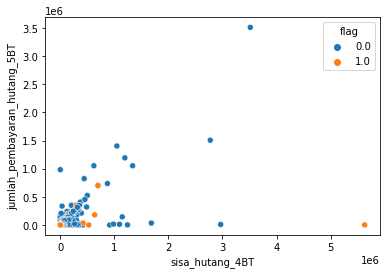

--------------------------------------------------
1970
sisa_hutang_4BT jumlah_pembayaran_hutang_6BT


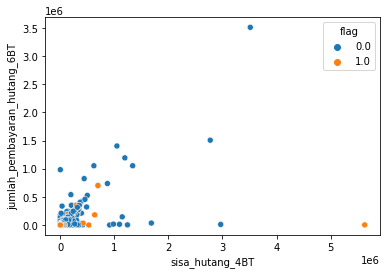

--------------------------------------------------
1971
sisa_hutang_4BT jumlah_pengeluaran_1BT


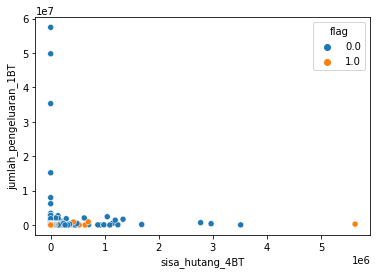

--------------------------------------------------
1972
sisa_hutang_4BT jumlah_pengeluaran_2BT


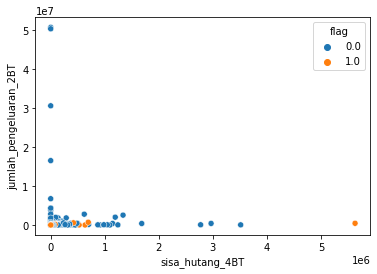

--------------------------------------------------
1973
sisa_hutang_4BT jumlah_pengeluaran_3BT


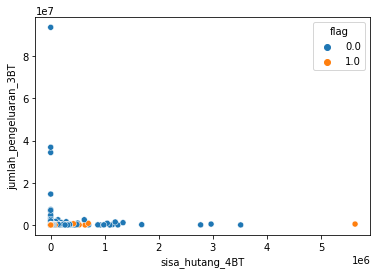

--------------------------------------------------
1974
sisa_hutang_4BT jumlah_pengeluaran_4BT


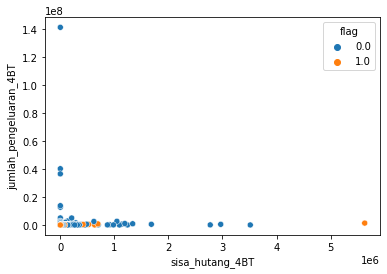

--------------------------------------------------
1975
sisa_hutang_4BT jumlah_pengeluaran_5BT


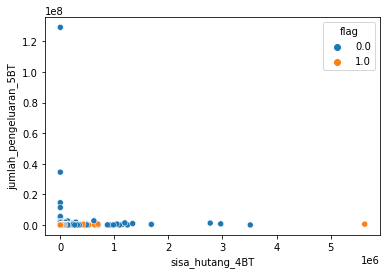

--------------------------------------------------
1976
sisa_hutang_4BT jumlah_pengeluaran_6BT


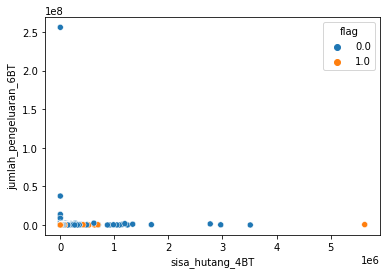

--------------------------------------------------
1977
sisa_hutang_4BT jumlah_pemasukan_1BT


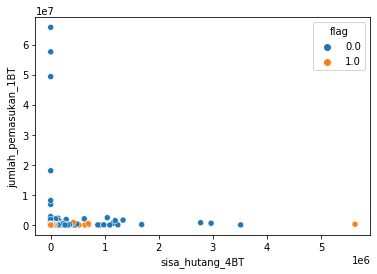

--------------------------------------------------
1978
sisa_hutang_4BT jumlah_pemasukan_2BT


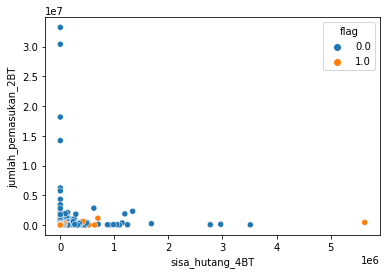

--------------------------------------------------
1979
sisa_hutang_4BT jumlah_pemasukan_3BT


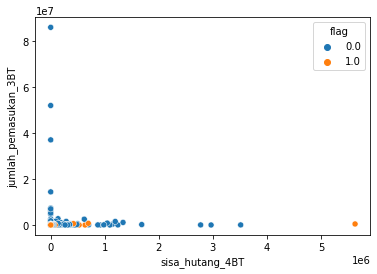

--------------------------------------------------
1980
sisa_hutang_4BT jumlah_pemasukan_4BT


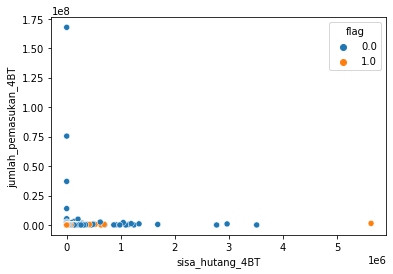

--------------------------------------------------
1981
sisa_hutang_4BT jumlah_pemasukan_5BT


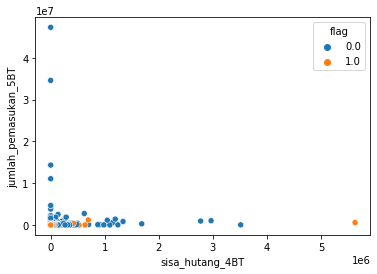

--------------------------------------------------
1982
sisa_hutang_4BT jumlah_pemasukan_6BT


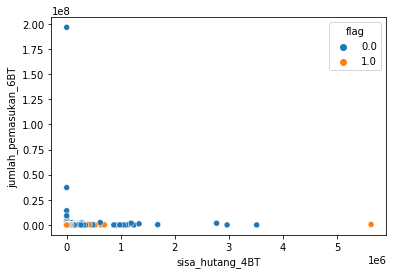

--------------------------------------------------
1983
sisa_hutang_4BT frekuensi_pengeluaran_1BT


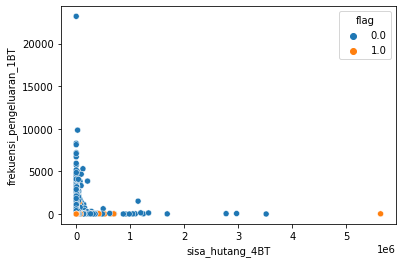

--------------------------------------------------
1984
sisa_hutang_4BT frekuensi_pengeluaran_2BT


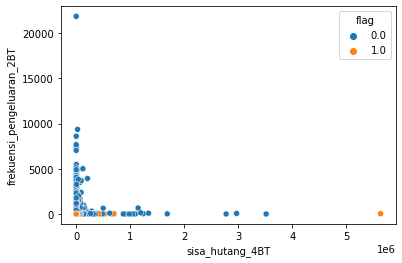

--------------------------------------------------
1985
sisa_hutang_4BT frekuensi_pengeluaran_3BT


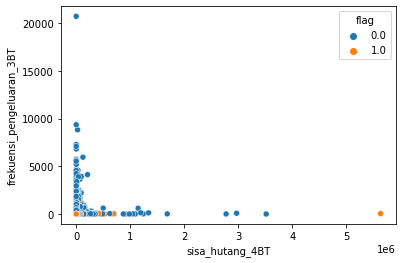

--------------------------------------------------
1986
sisa_hutang_4BT frekuensi_pengeluaran_4BT


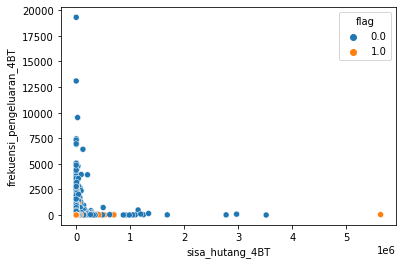

--------------------------------------------------
1987
sisa_hutang_4BT frekuensi_pengeluaran_5BT


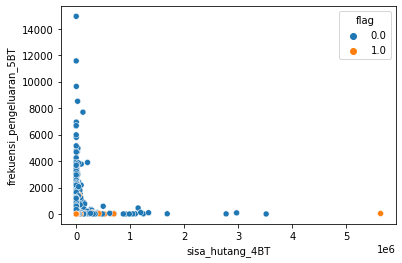

--------------------------------------------------
1988
sisa_hutang_4BT frekuensi_pengeluaran_6BT


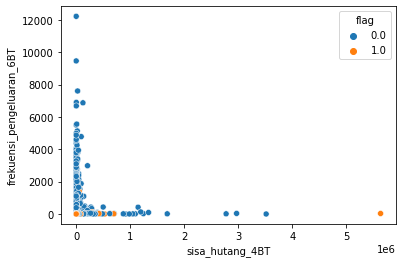

--------------------------------------------------
1989
sisa_hutang_4BT frekuensi_pemasukan_1BT


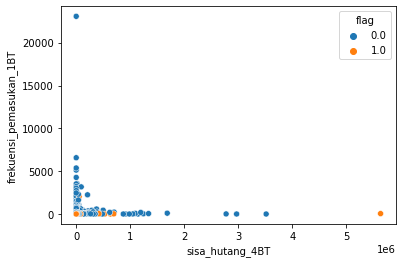

--------------------------------------------------
1990
sisa_hutang_4BT frekuensi_pemasukan_2BT


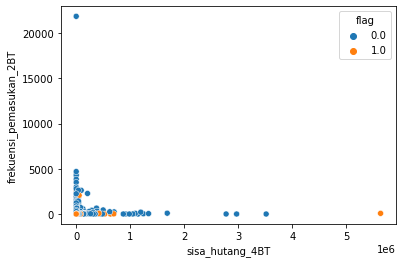

--------------------------------------------------
1991
sisa_hutang_4BT frekuensi_pemasukan_3BT


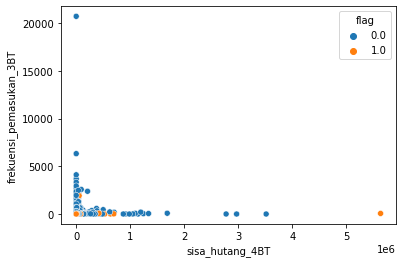

--------------------------------------------------
1992
sisa_hutang_4BT frekuensi_pemasukan_4BT


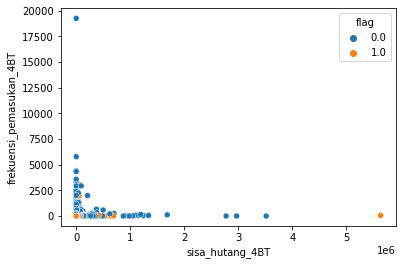

--------------------------------------------------
1993
sisa_hutang_4BT frekuensi_pemasukan_5BT


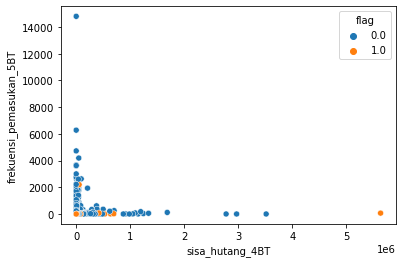

--------------------------------------------------
1994
sisa_hutang_4BT frekuensi_pemasukan_6BT


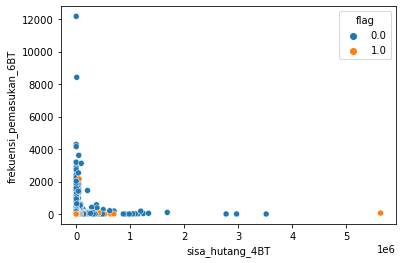

--------------------------------------------------
1995
sisa_hutang_4BT flag


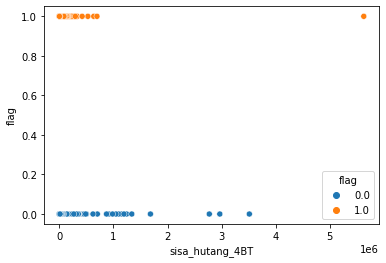

--------------------------------------------------
1996
sisa_hutang_5BT sisa_hutang_5BT


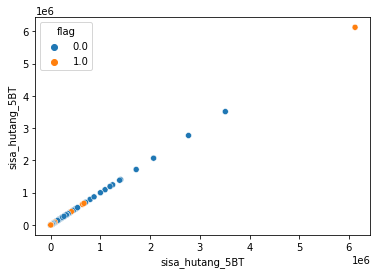

--------------------------------------------------
1997
sisa_hutang_5BT sisa_hutang_6BT


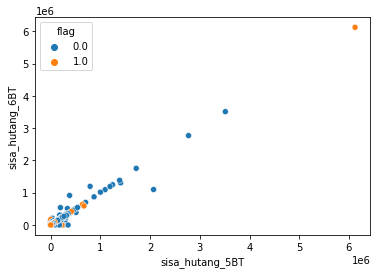

--------------------------------------------------
1998
sisa_hutang_5BT jumlah_pembayaran_hutang_1BT


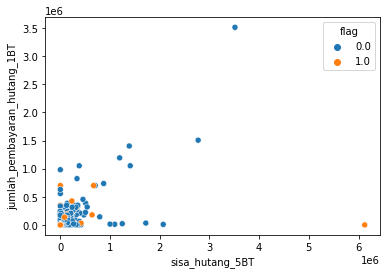

--------------------------------------------------
1999
sisa_hutang_5BT jumlah_pembayaran_hutang_2BT


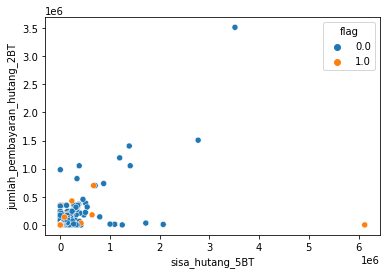

--------------------------------------------------
2000
sisa_hutang_5BT jumlah_pembayaran_hutang_3BT


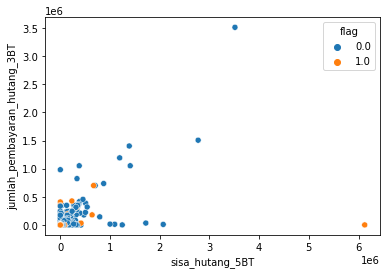

--------------------------------------------------
2001
sisa_hutang_5BT jumlah_pembayaran_hutang_4BT


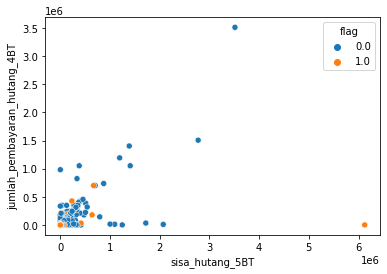

--------------------------------------------------
2002
sisa_hutang_5BT jumlah_pembayaran_hutang_5BT


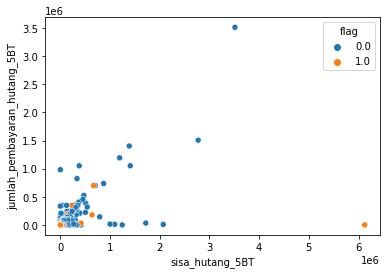

--------------------------------------------------
2003
sisa_hutang_5BT jumlah_pembayaran_hutang_6BT


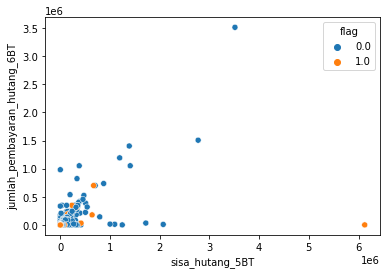

--------------------------------------------------
2004
sisa_hutang_5BT jumlah_pengeluaran_1BT


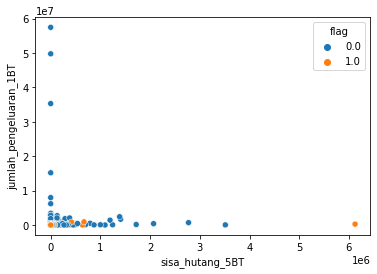

--------------------------------------------------
2005
sisa_hutang_5BT jumlah_pengeluaran_2BT


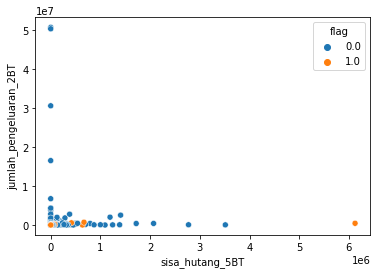

--------------------------------------------------
2006
sisa_hutang_5BT jumlah_pengeluaran_3BT


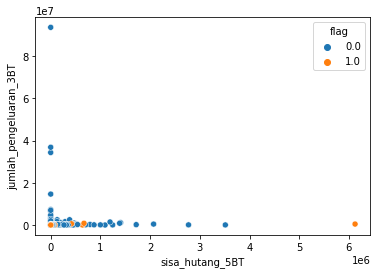

--------------------------------------------------
2007
sisa_hutang_5BT jumlah_pengeluaran_4BT


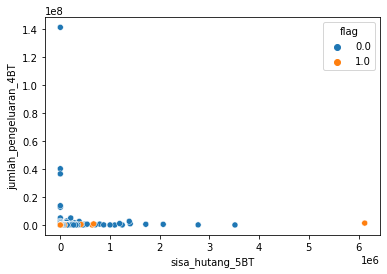

--------------------------------------------------
2008
sisa_hutang_5BT jumlah_pengeluaran_5BT


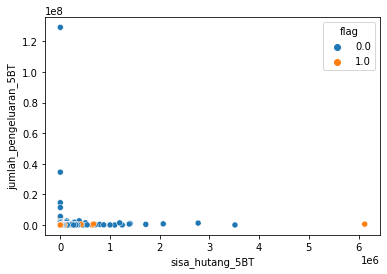

--------------------------------------------------
2009
sisa_hutang_5BT jumlah_pengeluaran_6BT


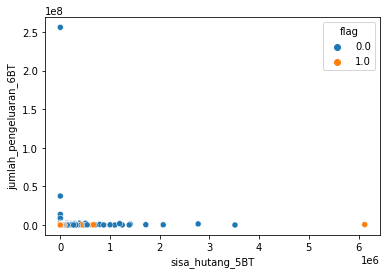

--------------------------------------------------
2010
sisa_hutang_5BT jumlah_pemasukan_1BT


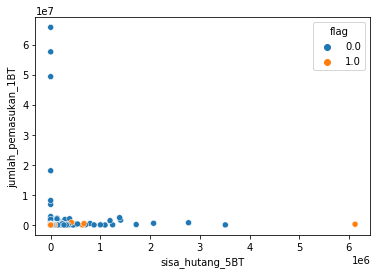

--------------------------------------------------
2011
sisa_hutang_5BT jumlah_pemasukan_2BT


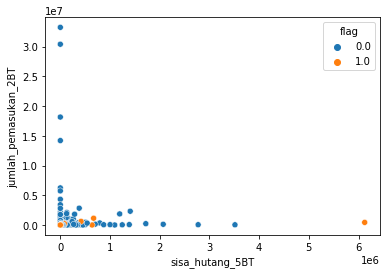

--------------------------------------------------
2012
sisa_hutang_5BT jumlah_pemasukan_3BT


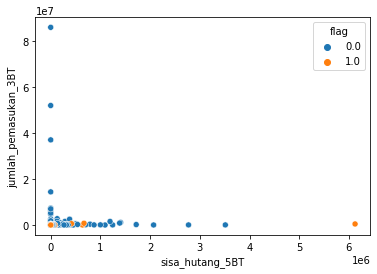

--------------------------------------------------
2013
sisa_hutang_5BT jumlah_pemasukan_4BT


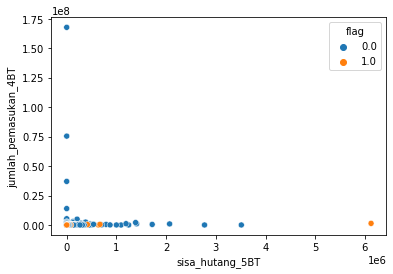

--------------------------------------------------
2014
sisa_hutang_5BT jumlah_pemasukan_5BT


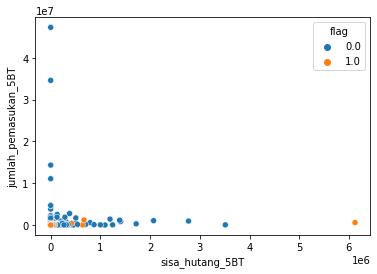

--------------------------------------------------
2015
sisa_hutang_5BT jumlah_pemasukan_6BT


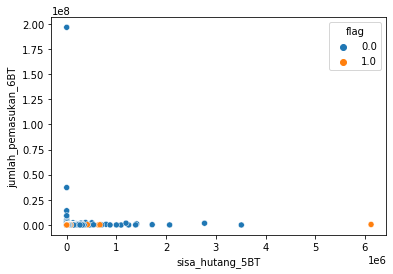

--------------------------------------------------
2016
sisa_hutang_5BT frekuensi_pengeluaran_1BT


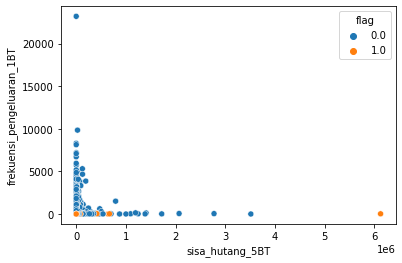

--------------------------------------------------
2017
sisa_hutang_5BT frekuensi_pengeluaran_2BT


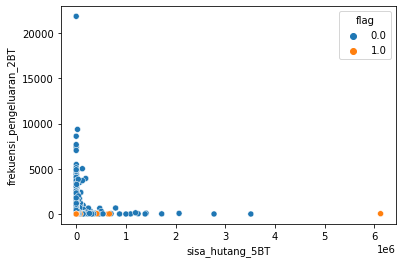

--------------------------------------------------
2018
sisa_hutang_5BT frekuensi_pengeluaran_3BT


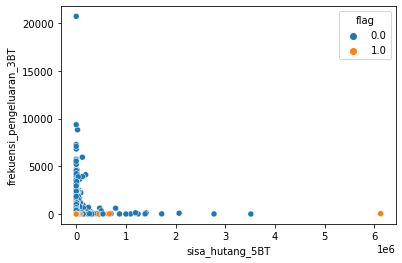

--------------------------------------------------
2019
sisa_hutang_5BT frekuensi_pengeluaran_4BT


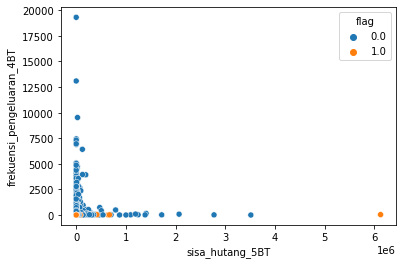

--------------------------------------------------
2020
sisa_hutang_5BT frekuensi_pengeluaran_5BT


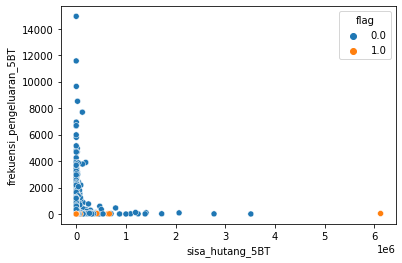

--------------------------------------------------
2021
sisa_hutang_5BT frekuensi_pengeluaran_6BT


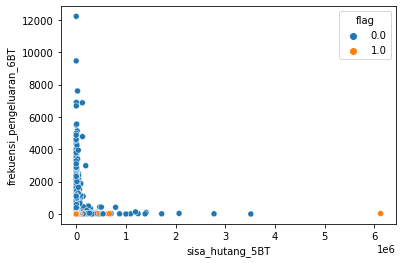

--------------------------------------------------
2022
sisa_hutang_5BT frekuensi_pemasukan_1BT


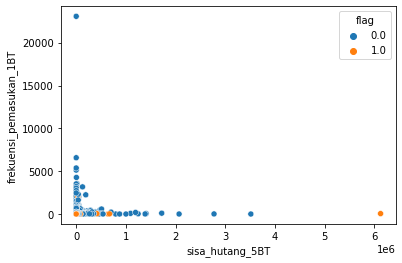

--------------------------------------------------
2023
sisa_hutang_5BT frekuensi_pemasukan_2BT


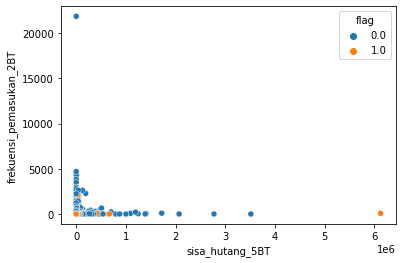

--------------------------------------------------
2024
sisa_hutang_5BT frekuensi_pemasukan_3BT


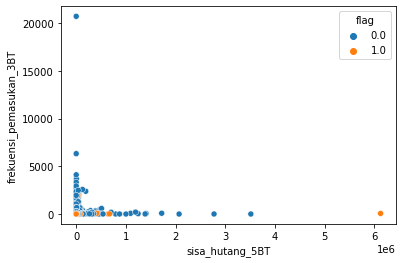

--------------------------------------------------
2025
sisa_hutang_5BT frekuensi_pemasukan_4BT


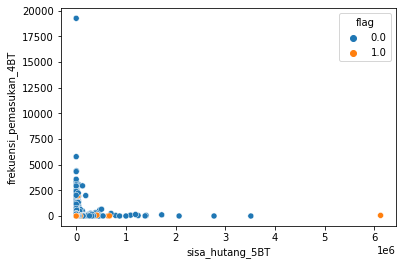

--------------------------------------------------
2026
sisa_hutang_5BT frekuensi_pemasukan_5BT


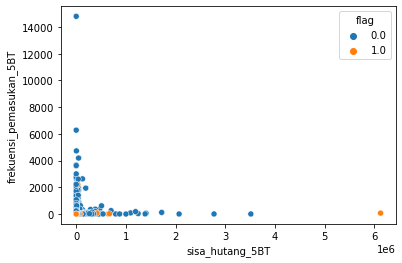

--------------------------------------------------
2027
sisa_hutang_5BT frekuensi_pemasukan_6BT


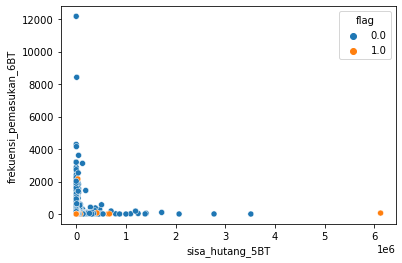

--------------------------------------------------
2028
sisa_hutang_5BT flag


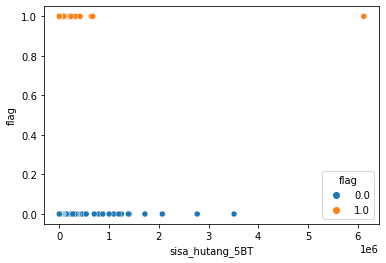

--------------------------------------------------
2029
sisa_hutang_6BT sisa_hutang_6BT


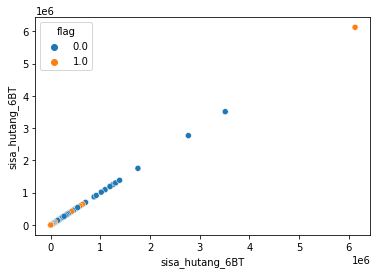

--------------------------------------------------
2030
sisa_hutang_6BT jumlah_pembayaran_hutang_1BT


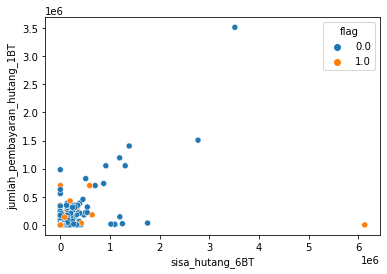

--------------------------------------------------
2031
sisa_hutang_6BT jumlah_pembayaran_hutang_2BT


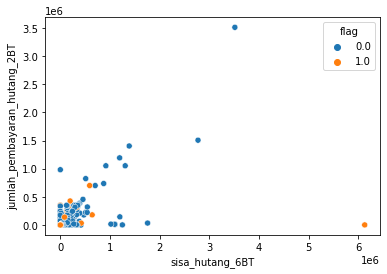

--------------------------------------------------
2032
sisa_hutang_6BT jumlah_pembayaran_hutang_3BT


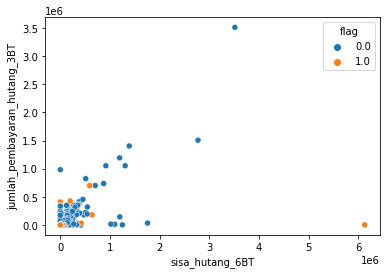

--------------------------------------------------
2033
sisa_hutang_6BT jumlah_pembayaran_hutang_4BT


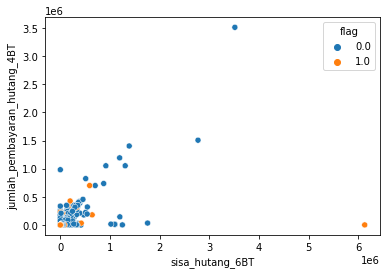

--------------------------------------------------
2034
sisa_hutang_6BT jumlah_pembayaran_hutang_5BT


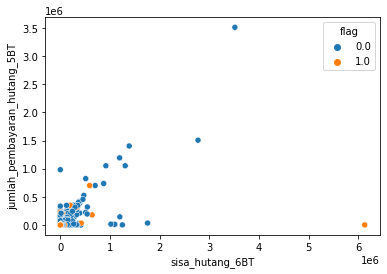

--------------------------------------------------
2035
sisa_hutang_6BT jumlah_pembayaran_hutang_6BT


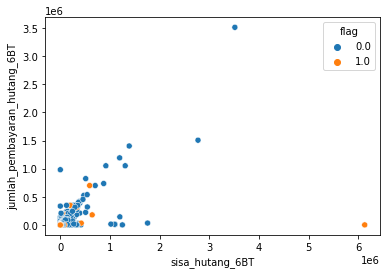

--------------------------------------------------
2036
sisa_hutang_6BT jumlah_pengeluaran_1BT


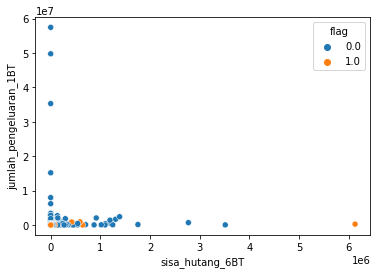

--------------------------------------------------
2037
sisa_hutang_6BT jumlah_pengeluaran_2BT


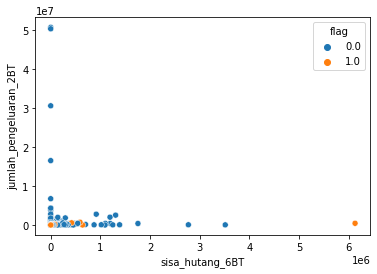

--------------------------------------------------
2038
sisa_hutang_6BT jumlah_pengeluaran_3BT


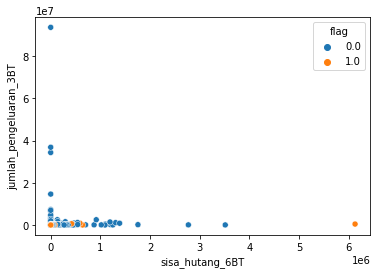

--------------------------------------------------
2039
sisa_hutang_6BT jumlah_pengeluaran_4BT


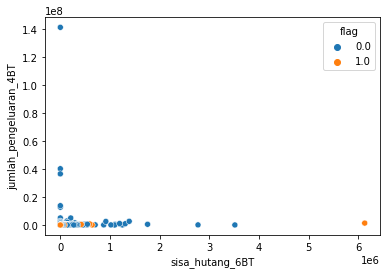

--------------------------------------------------
2040
sisa_hutang_6BT jumlah_pengeluaran_5BT


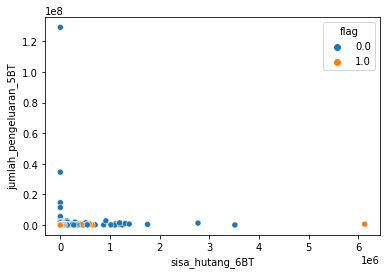

--------------------------------------------------
2041
sisa_hutang_6BT jumlah_pengeluaran_6BT


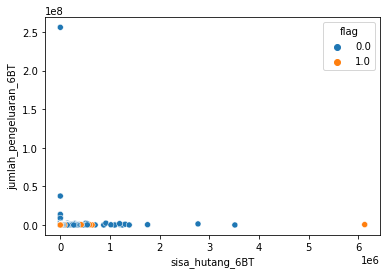

--------------------------------------------------
2042
sisa_hutang_6BT jumlah_pemasukan_1BT


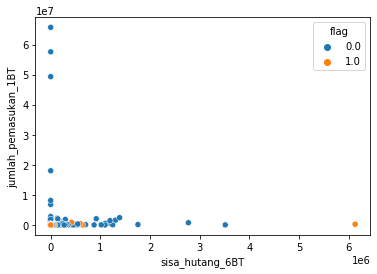

--------------------------------------------------
2043
sisa_hutang_6BT jumlah_pemasukan_2BT


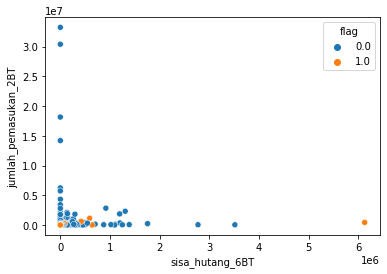

--------------------------------------------------
2044
sisa_hutang_6BT jumlah_pemasukan_3BT


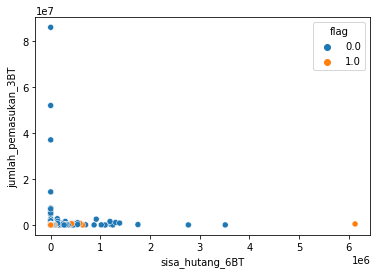

--------------------------------------------------
2045
sisa_hutang_6BT jumlah_pemasukan_4BT


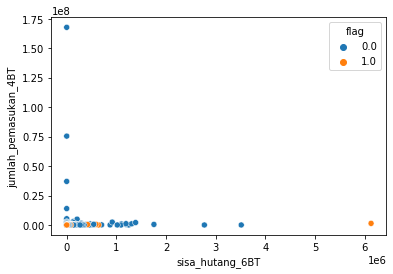

--------------------------------------------------
2046
sisa_hutang_6BT jumlah_pemasukan_5BT


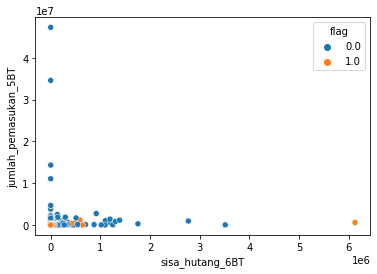

--------------------------------------------------
2047
sisa_hutang_6BT jumlah_pemasukan_6BT


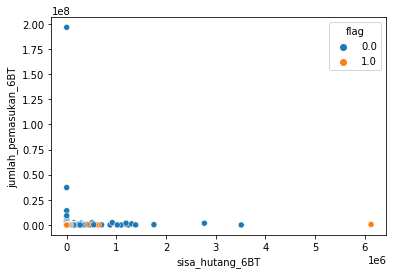

--------------------------------------------------
2048
sisa_hutang_6BT frekuensi_pengeluaran_1BT


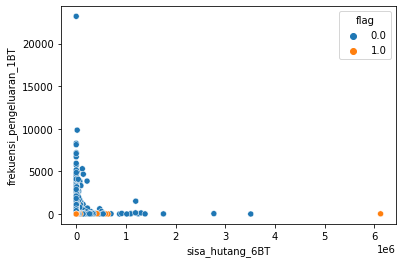

--------------------------------------------------
2049
sisa_hutang_6BT frekuensi_pengeluaran_2BT


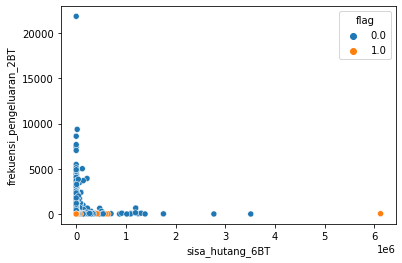

--------------------------------------------------
2050
sisa_hutang_6BT frekuensi_pengeluaran_3BT


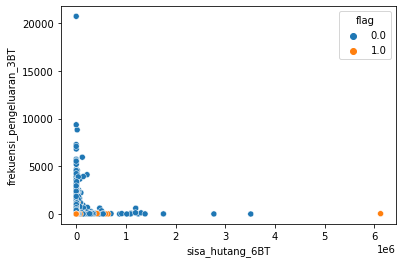

--------------------------------------------------
2051
sisa_hutang_6BT frekuensi_pengeluaran_4BT


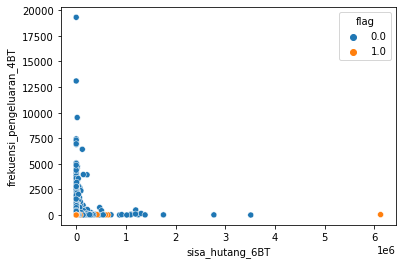

--------------------------------------------------
2052
sisa_hutang_6BT frekuensi_pengeluaran_5BT


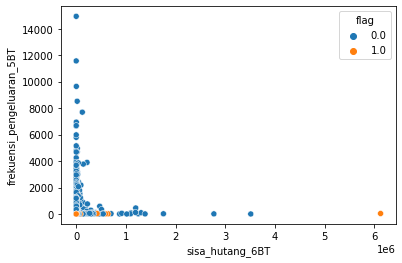

--------------------------------------------------
2053
sisa_hutang_6BT frekuensi_pengeluaran_6BT


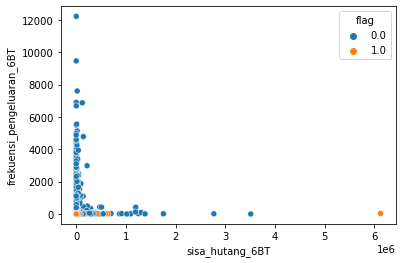

--------------------------------------------------
2054
sisa_hutang_6BT frekuensi_pemasukan_1BT


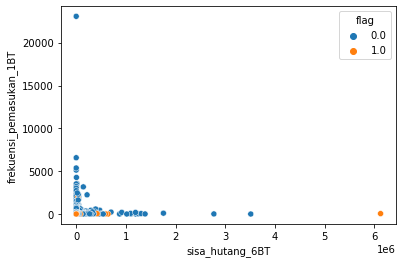

--------------------------------------------------
2055
sisa_hutang_6BT frekuensi_pemasukan_2BT


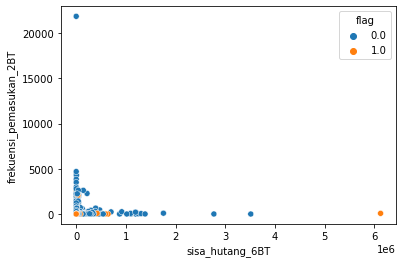

--------------------------------------------------
2056
sisa_hutang_6BT frekuensi_pemasukan_3BT


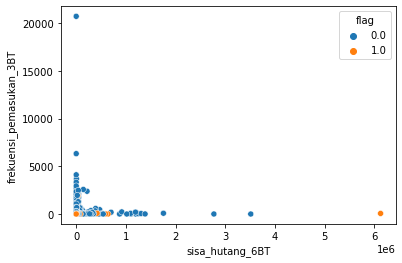

--------------------------------------------------
2057
sisa_hutang_6BT frekuensi_pemasukan_4BT


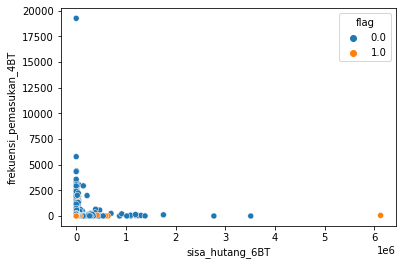

--------------------------------------------------
2058
sisa_hutang_6BT frekuensi_pemasukan_5BT


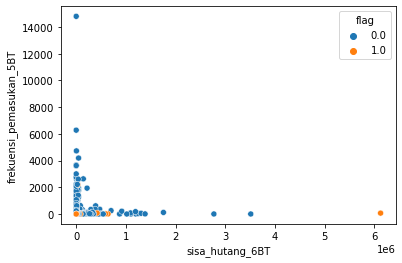

--------------------------------------------------
2059
sisa_hutang_6BT frekuensi_pemasukan_6BT


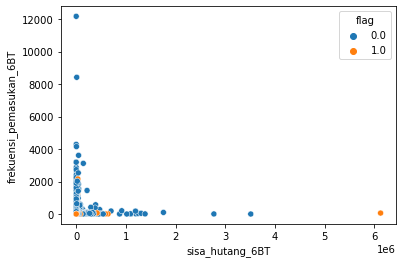

--------------------------------------------------
2060
sisa_hutang_6BT flag


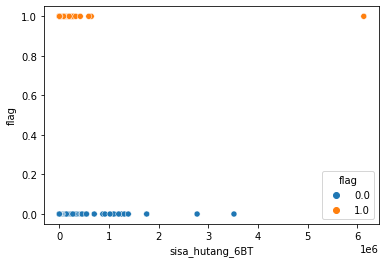

--------------------------------------------------
2061
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_1BT


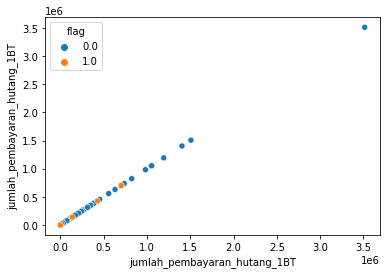

--------------------------------------------------
2062
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_2BT


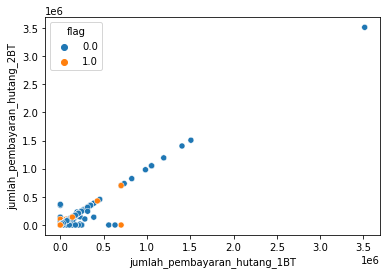

--------------------------------------------------
2063
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_3BT


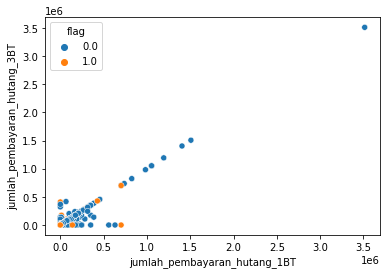

--------------------------------------------------
2064
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_4BT


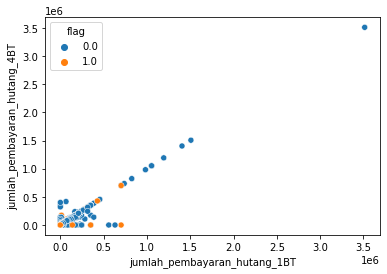

--------------------------------------------------
2065
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_5BT


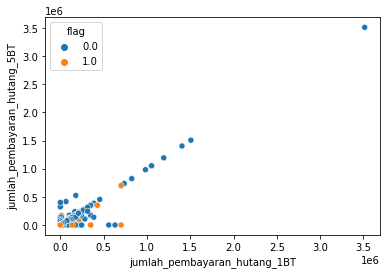

--------------------------------------------------
2066
jumlah_pembayaran_hutang_1BT jumlah_pembayaran_hutang_6BT


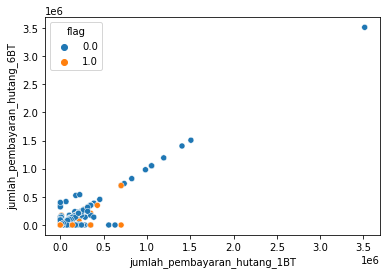

--------------------------------------------------
2067
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_1BT


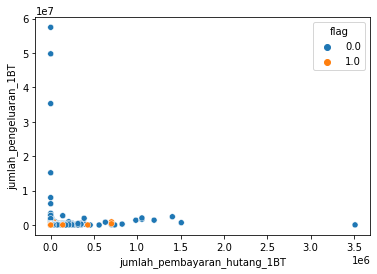

--------------------------------------------------
2068
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_2BT


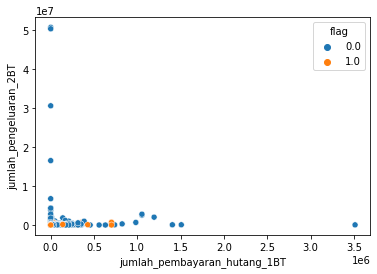

--------------------------------------------------
2069
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_3BT


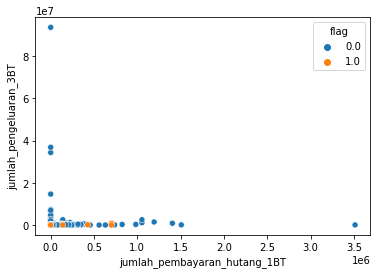

--------------------------------------------------
2070
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_4BT


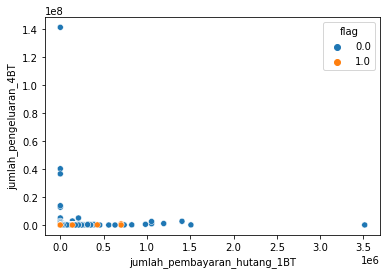

--------------------------------------------------
2071
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_5BT


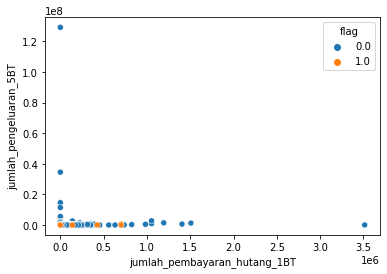

--------------------------------------------------
2072
jumlah_pembayaran_hutang_1BT jumlah_pengeluaran_6BT


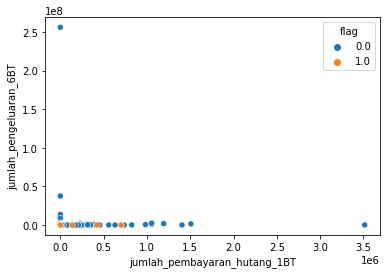

--------------------------------------------------
2073
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_1BT


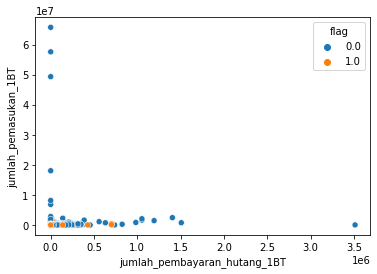

--------------------------------------------------
2074
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_2BT


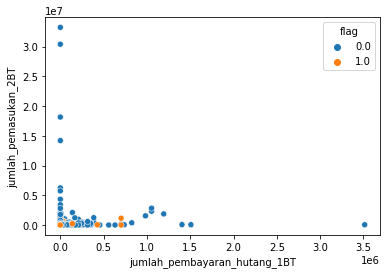

--------------------------------------------------
2075
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_3BT


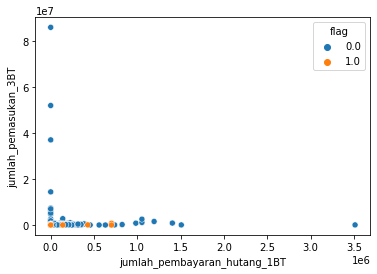

--------------------------------------------------
2076
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_4BT


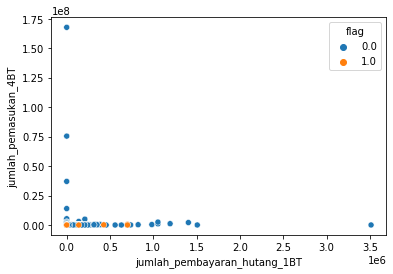

--------------------------------------------------
2077
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_5BT


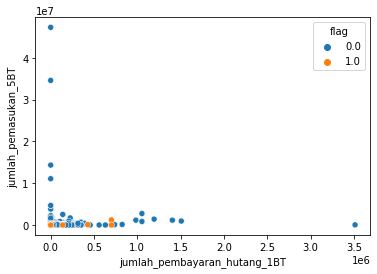

--------------------------------------------------
2078
jumlah_pembayaran_hutang_1BT jumlah_pemasukan_6BT


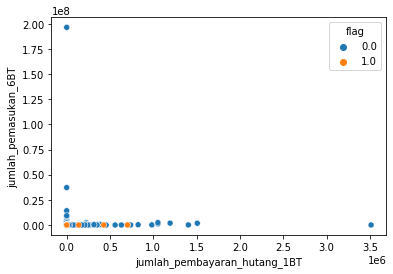

--------------------------------------------------
2079
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_1BT


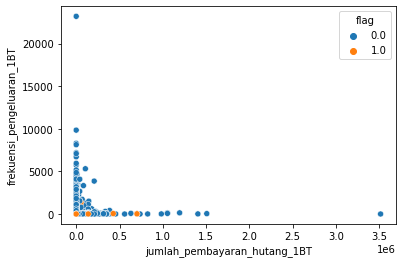

--------------------------------------------------
2080
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_2BT


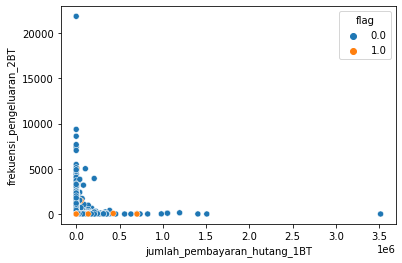

--------------------------------------------------
2081
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_3BT


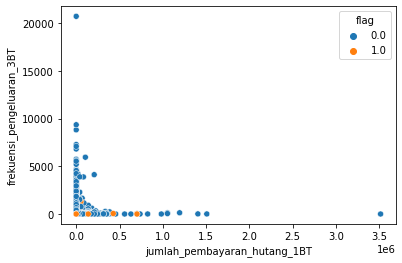

--------------------------------------------------
2082
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_4BT


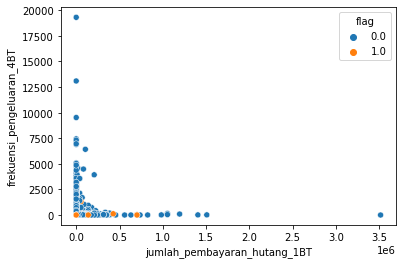

--------------------------------------------------
2083
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_5BT


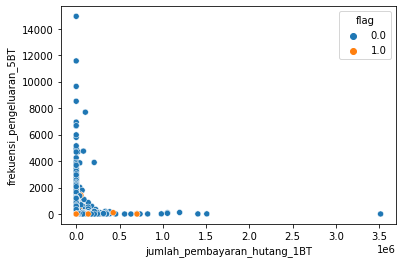

--------------------------------------------------
2084
jumlah_pembayaran_hutang_1BT frekuensi_pengeluaran_6BT


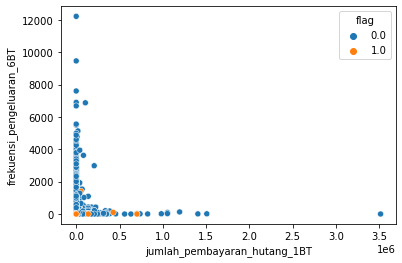

--------------------------------------------------
2085
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_1BT


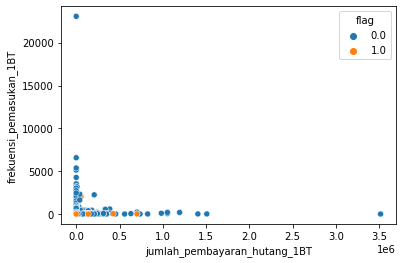

--------------------------------------------------
2086
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_2BT


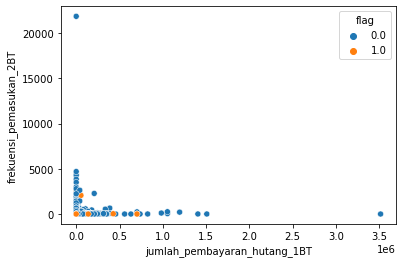

--------------------------------------------------
2087
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_3BT


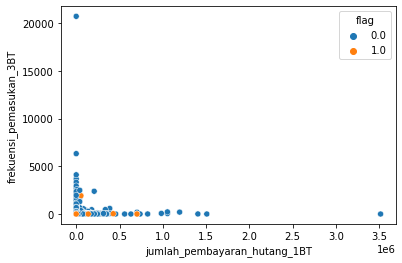

--------------------------------------------------
2088
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_4BT


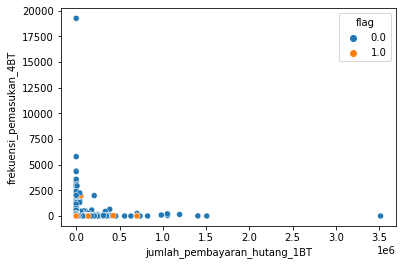

--------------------------------------------------
2089
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_5BT


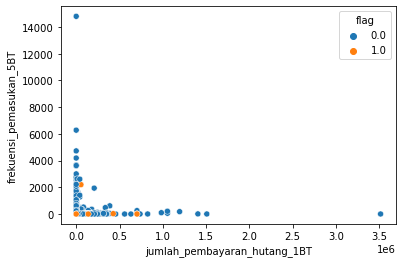

--------------------------------------------------
2090
jumlah_pembayaran_hutang_1BT frekuensi_pemasukan_6BT


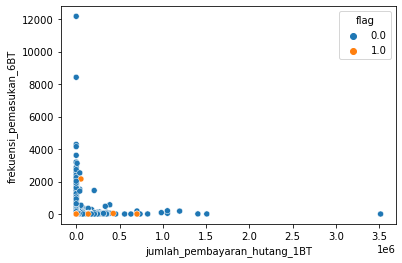

--------------------------------------------------
2091
jumlah_pembayaran_hutang_1BT flag


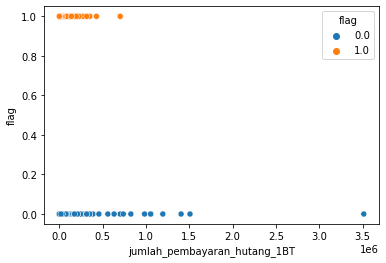

--------------------------------------------------
2092
jumlah_pembayaran_hutang_2BT jumlah_pembayaran_hutang_2BT


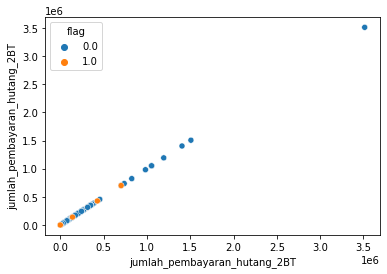

--------------------------------------------------
2093
jumlah_pembayaran_hutang_2BT jumlah_pembayaran_hutang_3BT


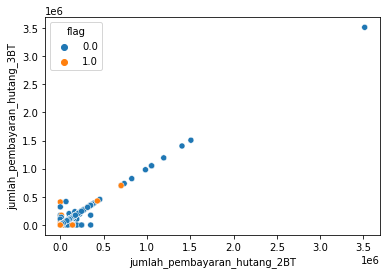

--------------------------------------------------
2094
jumlah_pembayaran_hutang_2BT jumlah_pembayaran_hutang_4BT


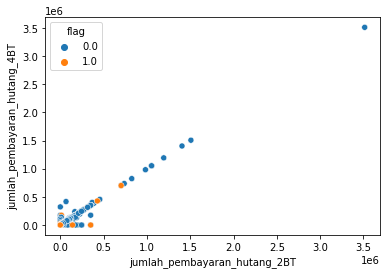

--------------------------------------------------
2095
jumlah_pembayaran_hutang_2BT jumlah_pembayaran_hutang_5BT


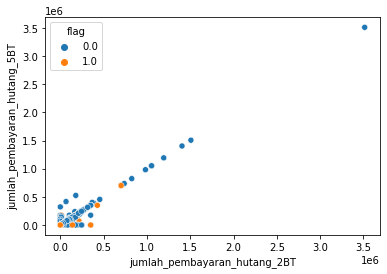

--------------------------------------------------
2096
jumlah_pembayaran_hutang_2BT jumlah_pembayaran_hutang_6BT


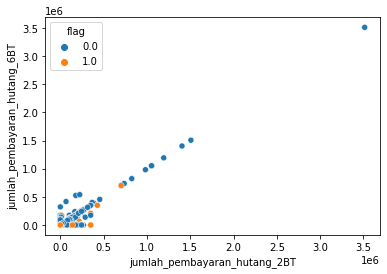

--------------------------------------------------
2097
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_1BT


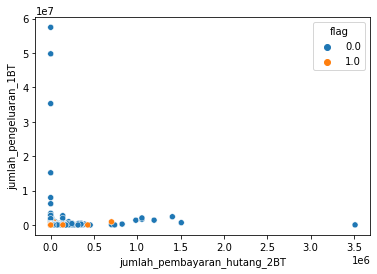

--------------------------------------------------
2098
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_2BT


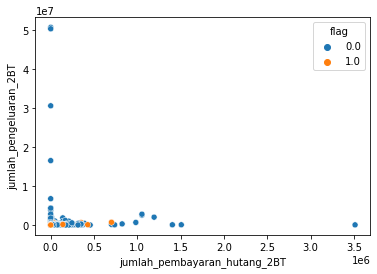

--------------------------------------------------
2099
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_3BT


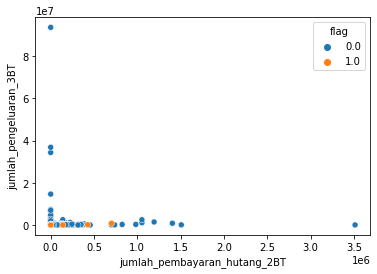

--------------------------------------------------
2100
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_4BT


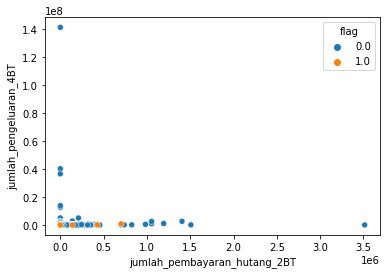

--------------------------------------------------
2101
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_5BT


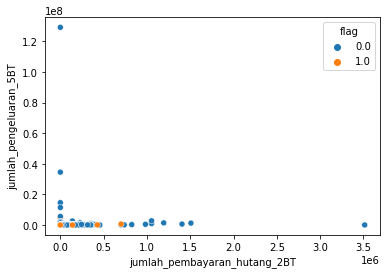

--------------------------------------------------
2102
jumlah_pembayaran_hutang_2BT jumlah_pengeluaran_6BT


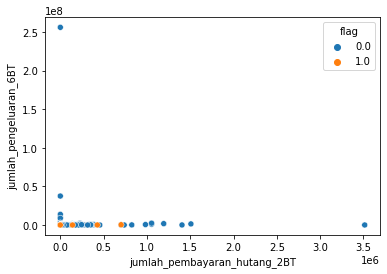

--------------------------------------------------
2103
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_1BT


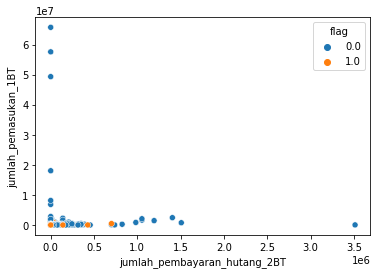

--------------------------------------------------
2104
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_2BT


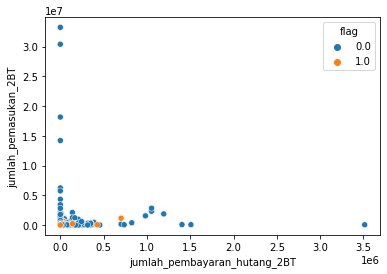

--------------------------------------------------
2105
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_3BT


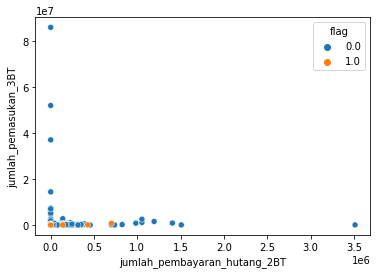

--------------------------------------------------
2106
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_4BT


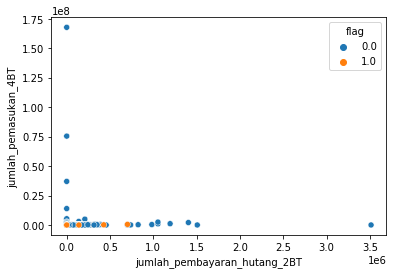

--------------------------------------------------
2107
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_5BT


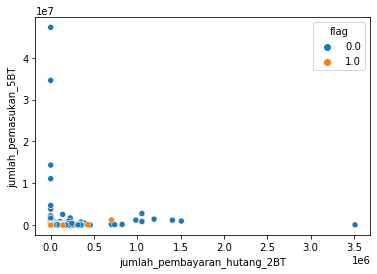

--------------------------------------------------
2108
jumlah_pembayaran_hutang_2BT jumlah_pemasukan_6BT


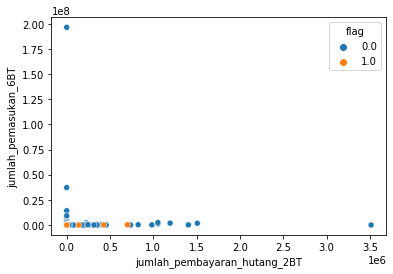

--------------------------------------------------
2109
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_1BT


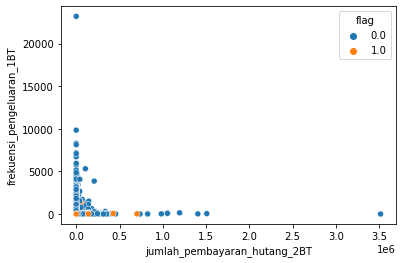

--------------------------------------------------
2110
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_2BT


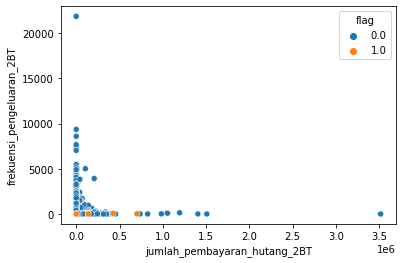

--------------------------------------------------
2111
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_3BT


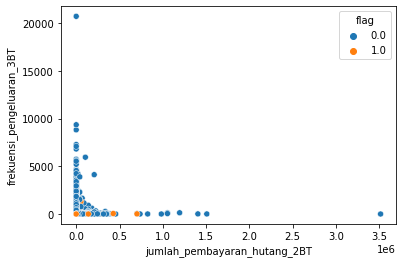

--------------------------------------------------
2112
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_4BT


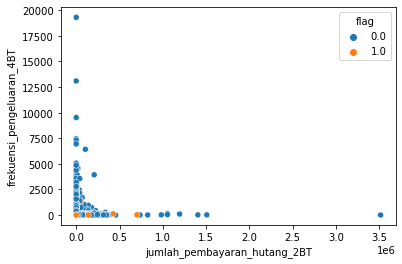

--------------------------------------------------
2113
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_5BT


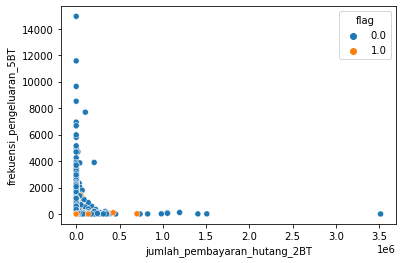

--------------------------------------------------
2114
jumlah_pembayaran_hutang_2BT frekuensi_pengeluaran_6BT


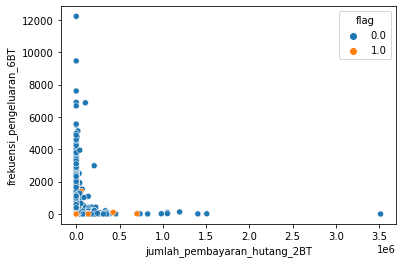

--------------------------------------------------
2115
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_1BT


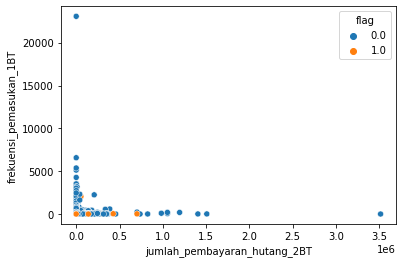

--------------------------------------------------
2116
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_2BT


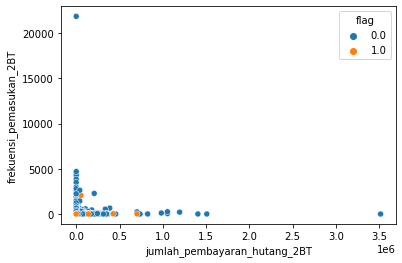

--------------------------------------------------
2117
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_3BT


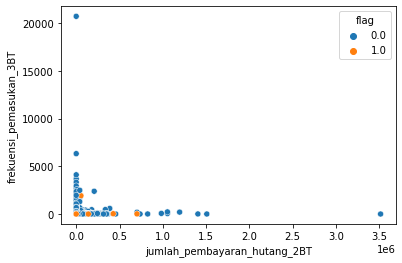

--------------------------------------------------
2118
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_4BT


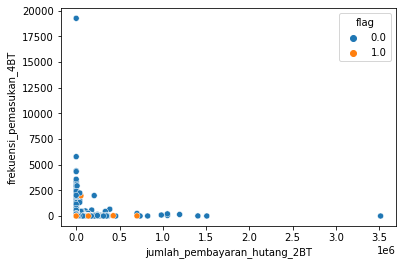

--------------------------------------------------
2119
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_5BT


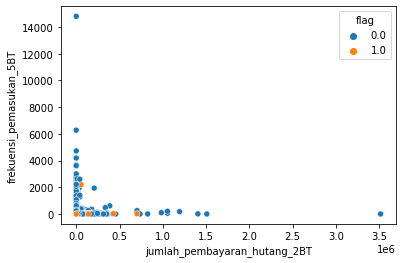

--------------------------------------------------
2120
jumlah_pembayaran_hutang_2BT frekuensi_pemasukan_6BT


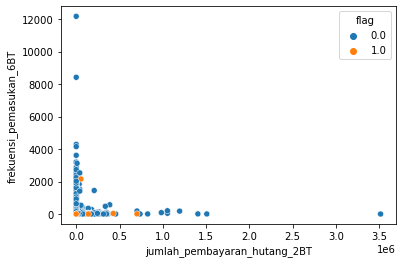

--------------------------------------------------
2121
jumlah_pembayaran_hutang_2BT flag


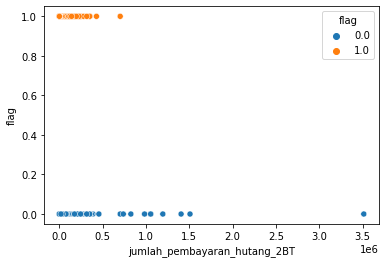

--------------------------------------------------
2122
jumlah_pembayaran_hutang_3BT jumlah_pembayaran_hutang_3BT


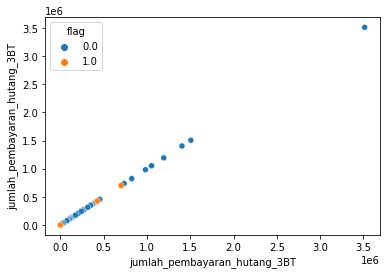

--------------------------------------------------
2123
jumlah_pembayaran_hutang_3BT jumlah_pembayaran_hutang_4BT


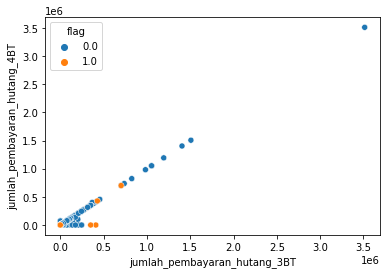

--------------------------------------------------
2124
jumlah_pembayaran_hutang_3BT jumlah_pembayaran_hutang_5BT


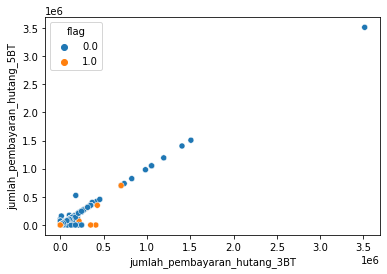

--------------------------------------------------
2125
jumlah_pembayaran_hutang_3BT jumlah_pembayaran_hutang_6BT


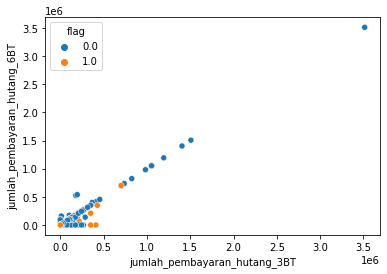

--------------------------------------------------
2126
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_1BT


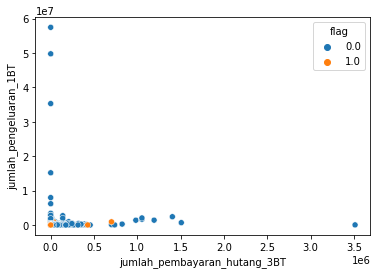

--------------------------------------------------
2127
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_2BT


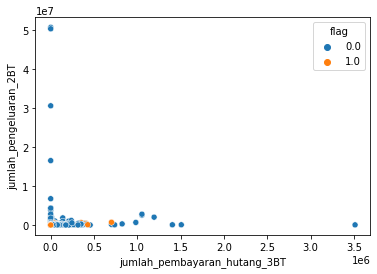

--------------------------------------------------
2128
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_3BT


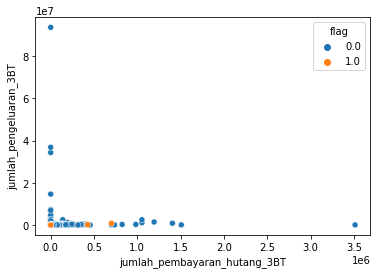

--------------------------------------------------
2129
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_4BT


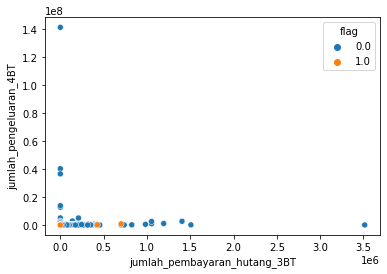

--------------------------------------------------
2130
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_5BT


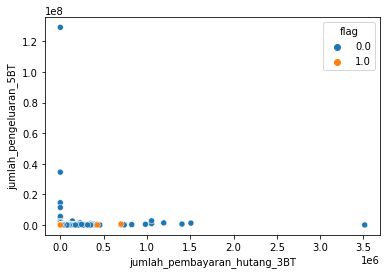

--------------------------------------------------
2131
jumlah_pembayaran_hutang_3BT jumlah_pengeluaran_6BT


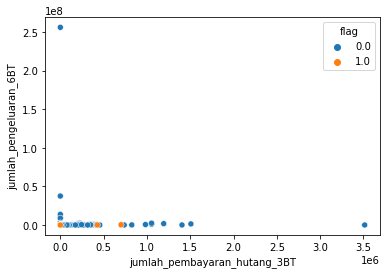

--------------------------------------------------
2132
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_1BT


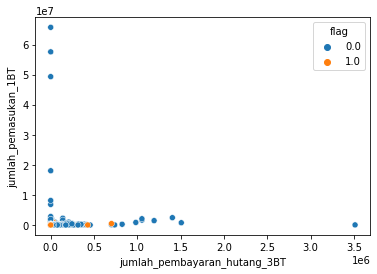

--------------------------------------------------
2133
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_2BT


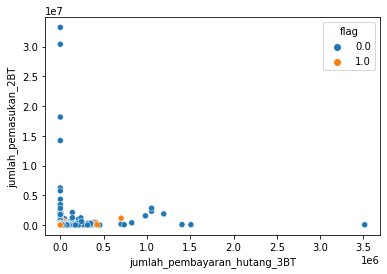

--------------------------------------------------
2134
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_3BT


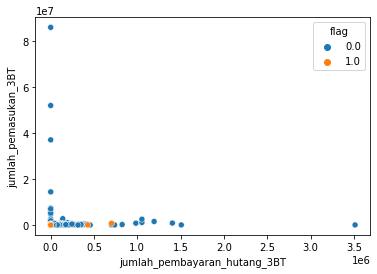

--------------------------------------------------
2135
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_4BT


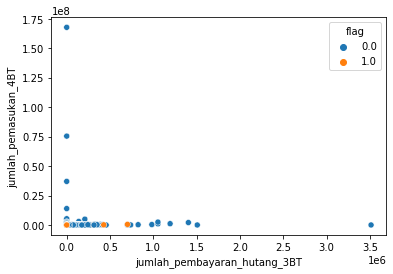

--------------------------------------------------
2136
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_5BT


--------------------------------------------------
2137
jumlah_pembayaran_hutang_3BT jumlah_pemasukan_6BT


--------------------------------------------------
2138
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2139
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2140
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2141
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2142
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2143
jumlah_pembayaran_hutang_3BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2144
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_1BT


--------------------------------------------------
2145
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_2BT


--------------------------------------------------
2146
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_3BT


--------------------------------------------------
2147
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_4BT


--------------------------------------------------
2148
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_5BT


--------------------------------------------------
2149
jumlah_pembayaran_hutang_3BT frekuensi_pemasukan_6BT


--------------------------------------------------
2150
jumlah_pembayaran_hutang_3BT flag


--------------------------------------------------
2151
jumlah_pembayaran_hutang_4BT jumlah_pembayaran_hutang_4BT


--------------------------------------------------
2152
jumlah_pembayaran_hutang_4BT jumlah_pembayaran_hutang_5BT


--------------------------------------------------
2153
jumlah_pembayaran_hutang_4BT jumlah_pembayaran_hutang_6BT


--------------------------------------------------
2154
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_1BT


--------------------------------------------------
2155
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_2BT


--------------------------------------------------
2156
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_3BT


--------------------------------------------------
2157
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_4BT


--------------------------------------------------
2158
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_5BT


--------------------------------------------------
2159
jumlah_pembayaran_hutang_4BT jumlah_pengeluaran_6BT


--------------------------------------------------
2160
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_1BT


--------------------------------------------------
2161
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_2BT


--------------------------------------------------
2162
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_3BT


--------------------------------------------------
2163
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_4BT


--------------------------------------------------
2164
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_5BT


--------------------------------------------------
2165
jumlah_pembayaran_hutang_4BT jumlah_pemasukan_6BT


--------------------------------------------------
2166
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2167
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2168
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2169
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2170
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2171
jumlah_pembayaran_hutang_4BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2172
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_1BT


--------------------------------------------------
2173
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_2BT


--------------------------------------------------
2174
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_3BT


--------------------------------------------------
2175
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_4BT


--------------------------------------------------
2176
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_5BT


--------------------------------------------------
2177
jumlah_pembayaran_hutang_4BT frekuensi_pemasukan_6BT


--------------------------------------------------
2178
jumlah_pembayaran_hutang_4BT flag


--------------------------------------------------
2179
jumlah_pembayaran_hutang_5BT jumlah_pembayaran_hutang_5BT


--------------------------------------------------
2180
jumlah_pembayaran_hutang_5BT jumlah_pembayaran_hutang_6BT


--------------------------------------------------
2181
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_1BT


--------------------------------------------------
2182
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_2BT


--------------------------------------------------
2183
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_3BT


--------------------------------------------------
2184
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_4BT


--------------------------------------------------
2185
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_5BT


--------------------------------------------------
2186
jumlah_pembayaran_hutang_5BT jumlah_pengeluaran_6BT


--------------------------------------------------
2187
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_1BT


--------------------------------------------------
2188
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_2BT


--------------------------------------------------
2189
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_3BT


--------------------------------------------------
2190
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_4BT


--------------------------------------------------
2191
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_5BT


--------------------------------------------------
2192
jumlah_pembayaran_hutang_5BT jumlah_pemasukan_6BT


--------------------------------------------------
2193
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2194
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2195
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2196
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2197
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2198
jumlah_pembayaran_hutang_5BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2199
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_1BT


--------------------------------------------------
2200
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_2BT


--------------------------------------------------
2201
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_3BT


--------------------------------------------------
2202
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_4BT


--------------------------------------------------
2203
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_5BT


--------------------------------------------------
2204
jumlah_pembayaran_hutang_5BT frekuensi_pemasukan_6BT


--------------------------------------------------
2205
jumlah_pembayaran_hutang_5BT flag


--------------------------------------------------
2206
jumlah_pembayaran_hutang_6BT jumlah_pembayaran_hutang_6BT


--------------------------------------------------
2207
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_1BT


--------------------------------------------------
2208
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_2BT


--------------------------------------------------
2209
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_3BT


--------------------------------------------------
2210
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_4BT


--------------------------------------------------
2211
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_5BT


--------------------------------------------------
2212
jumlah_pembayaran_hutang_6BT jumlah_pengeluaran_6BT


--------------------------------------------------
2213
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_1BT


--------------------------------------------------
2214
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_2BT


--------------------------------------------------
2215
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_3BT


--------------------------------------------------
2216
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_4BT


--------------------------------------------------
2217
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_5BT


--------------------------------------------------
2218
jumlah_pembayaran_hutang_6BT jumlah_pemasukan_6BT


--------------------------------------------------
2219
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2220
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2221
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2222
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2223
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2224
jumlah_pembayaran_hutang_6BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2225
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_1BT


--------------------------------------------------
2226
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_2BT


--------------------------------------------------
2227
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_3BT


--------------------------------------------------
2228
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_4BT


--------------------------------------------------
2229
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_5BT


--------------------------------------------------
2230
jumlah_pembayaran_hutang_6BT frekuensi_pemasukan_6BT


--------------------------------------------------
2231
jumlah_pembayaran_hutang_6BT flag


--------------------------------------------------
2232
jumlah_pengeluaran_1BT jumlah_pengeluaran_1BT


--------------------------------------------------
2233
jumlah_pengeluaran_1BT jumlah_pengeluaran_2BT


--------------------------------------------------
2234
jumlah_pengeluaran_1BT jumlah_pengeluaran_3BT


--------------------------------------------------
2235
jumlah_pengeluaran_1BT jumlah_pengeluaran_4BT


--------------------------------------------------
2236
jumlah_pengeluaran_1BT jumlah_pengeluaran_5BT


--------------------------------------------------
2237
jumlah_pengeluaran_1BT jumlah_pengeluaran_6BT


--------------------------------------------------
2238
jumlah_pengeluaran_1BT jumlah_pemasukan_1BT


--------------------------------------------------
2239
jumlah_pengeluaran_1BT jumlah_pemasukan_2BT


--------------------------------------------------
2240
jumlah_pengeluaran_1BT jumlah_pemasukan_3BT


--------------------------------------------------
2241
jumlah_pengeluaran_1BT jumlah_pemasukan_4BT


--------------------------------------------------
2242
jumlah_pengeluaran_1BT jumlah_pemasukan_5BT


--------------------------------------------------
2243
jumlah_pengeluaran_1BT jumlah_pemasukan_6BT


--------------------------------------------------
2244
jumlah_pengeluaran_1BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2245
jumlah_pengeluaran_1BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2246
jumlah_pengeluaran_1BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2247
jumlah_pengeluaran_1BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2248
jumlah_pengeluaran_1BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2249
jumlah_pengeluaran_1BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2250
jumlah_pengeluaran_1BT frekuensi_pemasukan_1BT


--------------------------------------------------
2251
jumlah_pengeluaran_1BT frekuensi_pemasukan_2BT


--------------------------------------------------
2252
jumlah_pengeluaran_1BT frekuensi_pemasukan_3BT


--------------------------------------------------
2253
jumlah_pengeluaran_1BT frekuensi_pemasukan_4BT


--------------------------------------------------
2254
jumlah_pengeluaran_1BT frekuensi_pemasukan_5BT


--------------------------------------------------
2255
jumlah_pengeluaran_1BT frekuensi_pemasukan_6BT


--------------------------------------------------
2256
jumlah_pengeluaran_1BT flag


--------------------------------------------------
2257
jumlah_pengeluaran_2BT jumlah_pengeluaran_2BT


--------------------------------------------------
2258
jumlah_pengeluaran_2BT jumlah_pengeluaran_3BT


--------------------------------------------------
2259
jumlah_pengeluaran_2BT jumlah_pengeluaran_4BT


--------------------------------------------------
2260
jumlah_pengeluaran_2BT jumlah_pengeluaran_5BT


--------------------------------------------------
2261
jumlah_pengeluaran_2BT jumlah_pengeluaran_6BT


--------------------------------------------------
2262
jumlah_pengeluaran_2BT jumlah_pemasukan_1BT


--------------------------------------------------
2263
jumlah_pengeluaran_2BT jumlah_pemasukan_2BT


--------------------------------------------------
2264
jumlah_pengeluaran_2BT jumlah_pemasukan_3BT


--------------------------------------------------
2265
jumlah_pengeluaran_2BT jumlah_pemasukan_4BT


--------------------------------------------------
2266
jumlah_pengeluaran_2BT jumlah_pemasukan_5BT


--------------------------------------------------
2267
jumlah_pengeluaran_2BT jumlah_pemasukan_6BT


--------------------------------------------------
2268
jumlah_pengeluaran_2BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2269
jumlah_pengeluaran_2BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2270
jumlah_pengeluaran_2BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2271
jumlah_pengeluaran_2BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2272
jumlah_pengeluaran_2BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2273
jumlah_pengeluaran_2BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2274
jumlah_pengeluaran_2BT frekuensi_pemasukan_1BT


--------------------------------------------------
2275
jumlah_pengeluaran_2BT frekuensi_pemasukan_2BT


--------------------------------------------------
2276
jumlah_pengeluaran_2BT frekuensi_pemasukan_3BT


--------------------------------------------------
2277
jumlah_pengeluaran_2BT frekuensi_pemasukan_4BT


--------------------------------------------------
2278
jumlah_pengeluaran_2BT frekuensi_pemasukan_5BT


--------------------------------------------------
2279
jumlah_pengeluaran_2BT frekuensi_pemasukan_6BT


--------------------------------------------------
2280
jumlah_pengeluaran_2BT flag


--------------------------------------------------
2281
jumlah_pengeluaran_3BT jumlah_pengeluaran_3BT


--------------------------------------------------
2282
jumlah_pengeluaran_3BT jumlah_pengeluaran_4BT


--------------------------------------------------
2283
jumlah_pengeluaran_3BT jumlah_pengeluaran_5BT


--------------------------------------------------
2284
jumlah_pengeluaran_3BT jumlah_pengeluaran_6BT


--------------------------------------------------
2285
jumlah_pengeluaran_3BT jumlah_pemasukan_1BT


--------------------------------------------------
2286
jumlah_pengeluaran_3BT jumlah_pemasukan_2BT


--------------------------------------------------
2287
jumlah_pengeluaran_3BT jumlah_pemasukan_3BT


--------------------------------------------------
2288
jumlah_pengeluaran_3BT jumlah_pemasukan_4BT


--------------------------------------------------
2289
jumlah_pengeluaran_3BT jumlah_pemasukan_5BT


--------------------------------------------------
2290
jumlah_pengeluaran_3BT jumlah_pemasukan_6BT


--------------------------------------------------
2291
jumlah_pengeluaran_3BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2292
jumlah_pengeluaran_3BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2293
jumlah_pengeluaran_3BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2294
jumlah_pengeluaran_3BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2295
jumlah_pengeluaran_3BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2296
jumlah_pengeluaran_3BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2297
jumlah_pengeluaran_3BT frekuensi_pemasukan_1BT


--------------------------------------------------
2298
jumlah_pengeluaran_3BT frekuensi_pemasukan_2BT


--------------------------------------------------
2299
jumlah_pengeluaran_3BT frekuensi_pemasukan_3BT


--------------------------------------------------
2300
jumlah_pengeluaran_3BT frekuensi_pemasukan_4BT


--------------------------------------------------
2301
jumlah_pengeluaran_3BT frekuensi_pemasukan_5BT


--------------------------------------------------
2302
jumlah_pengeluaran_3BT frekuensi_pemasukan_6BT


--------------------------------------------------
2303
jumlah_pengeluaran_3BT flag


--------------------------------------------------
2304
jumlah_pengeluaran_4BT jumlah_pengeluaran_4BT


--------------------------------------------------
2305
jumlah_pengeluaran_4BT jumlah_pengeluaran_5BT


--------------------------------------------------
2306
jumlah_pengeluaran_4BT jumlah_pengeluaran_6BT


--------------------------------------------------
2307
jumlah_pengeluaran_4BT jumlah_pemasukan_1BT


--------------------------------------------------
2308
jumlah_pengeluaran_4BT jumlah_pemasukan_2BT


--------------------------------------------------
2309
jumlah_pengeluaran_4BT jumlah_pemasukan_3BT


--------------------------------------------------
2310
jumlah_pengeluaran_4BT jumlah_pemasukan_4BT


--------------------------------------------------
2311
jumlah_pengeluaran_4BT jumlah_pemasukan_5BT


--------------------------------------------------
2312
jumlah_pengeluaran_4BT jumlah_pemasukan_6BT


--------------------------------------------------
2313
jumlah_pengeluaran_4BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2314
jumlah_pengeluaran_4BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2315
jumlah_pengeluaran_4BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2316
jumlah_pengeluaran_4BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2317
jumlah_pengeluaran_4BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2318
jumlah_pengeluaran_4BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2319
jumlah_pengeluaran_4BT frekuensi_pemasukan_1BT


--------------------------------------------------
2320
jumlah_pengeluaran_4BT frekuensi_pemasukan_2BT


--------------------------------------------------
2321
jumlah_pengeluaran_4BT frekuensi_pemasukan_3BT


--------------------------------------------------
2322
jumlah_pengeluaran_4BT frekuensi_pemasukan_4BT


--------------------------------------------------
2323
jumlah_pengeluaran_4BT frekuensi_pemasukan_5BT


--------------------------------------------------
2324
jumlah_pengeluaran_4BT frekuensi_pemasukan_6BT


--------------------------------------------------
2325
jumlah_pengeluaran_4BT flag


--------------------------------------------------
2326
jumlah_pengeluaran_5BT jumlah_pengeluaran_5BT


--------------------------------------------------
2327
jumlah_pengeluaran_5BT jumlah_pengeluaran_6BT


--------------------------------------------------
2328
jumlah_pengeluaran_5BT jumlah_pemasukan_1BT


--------------------------------------------------
2329
jumlah_pengeluaran_5BT jumlah_pemasukan_2BT


--------------------------------------------------
2330
jumlah_pengeluaran_5BT jumlah_pemasukan_3BT


--------------------------------------------------
2331
jumlah_pengeluaran_5BT jumlah_pemasukan_4BT


--------------------------------------------------
2332
jumlah_pengeluaran_5BT jumlah_pemasukan_5BT


--------------------------------------------------
2333
jumlah_pengeluaran_5BT jumlah_pemasukan_6BT


--------------------------------------------------
2334
jumlah_pengeluaran_5BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2335
jumlah_pengeluaran_5BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2336
jumlah_pengeluaran_5BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2337
jumlah_pengeluaran_5BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2338
jumlah_pengeluaran_5BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2339
jumlah_pengeluaran_5BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2340
jumlah_pengeluaran_5BT frekuensi_pemasukan_1BT


--------------------------------------------------
2341
jumlah_pengeluaran_5BT frekuensi_pemasukan_2BT


--------------------------------------------------
2342
jumlah_pengeluaran_5BT frekuensi_pemasukan_3BT


--------------------------------------------------
2343
jumlah_pengeluaran_5BT frekuensi_pemasukan_4BT


--------------------------------------------------
2344
jumlah_pengeluaran_5BT frekuensi_pemasukan_5BT


--------------------------------------------------
2345
jumlah_pengeluaran_5BT frekuensi_pemasukan_6BT


--------------------------------------------------
2346
jumlah_pengeluaran_5BT flag


--------------------------------------------------
2347
jumlah_pengeluaran_6BT jumlah_pengeluaran_6BT


--------------------------------------------------
2348
jumlah_pengeluaran_6BT jumlah_pemasukan_1BT


--------------------------------------------------
2349
jumlah_pengeluaran_6BT jumlah_pemasukan_2BT


--------------------------------------------------
2350
jumlah_pengeluaran_6BT jumlah_pemasukan_3BT


--------------------------------------------------
2351
jumlah_pengeluaran_6BT jumlah_pemasukan_4BT


--------------------------------------------------
2352
jumlah_pengeluaran_6BT jumlah_pemasukan_5BT


--------------------------------------------------
2353
jumlah_pengeluaran_6BT jumlah_pemasukan_6BT


--------------------------------------------------
2354
jumlah_pengeluaran_6BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2355
jumlah_pengeluaran_6BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2356
jumlah_pengeluaran_6BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2357
jumlah_pengeluaran_6BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2358
jumlah_pengeluaran_6BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2359
jumlah_pengeluaran_6BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2360
jumlah_pengeluaran_6BT frekuensi_pemasukan_1BT


--------------------------------------------------
2361
jumlah_pengeluaran_6BT frekuensi_pemasukan_2BT


--------------------------------------------------
2362
jumlah_pengeluaran_6BT frekuensi_pemasukan_3BT


--------------------------------------------------
2363
jumlah_pengeluaran_6BT frekuensi_pemasukan_4BT


--------------------------------------------------
2364
jumlah_pengeluaran_6BT frekuensi_pemasukan_5BT


--------------------------------------------------
2365
jumlah_pengeluaran_6BT frekuensi_pemasukan_6BT


--------------------------------------------------
2366
jumlah_pengeluaran_6BT flag


--------------------------------------------------
2367
jumlah_pemasukan_1BT jumlah_pemasukan_1BT


--------------------------------------------------
2368
jumlah_pemasukan_1BT jumlah_pemasukan_2BT


--------------------------------------------------
2369
jumlah_pemasukan_1BT jumlah_pemasukan_3BT


--------------------------------------------------
2370
jumlah_pemasukan_1BT jumlah_pemasukan_4BT


--------------------------------------------------
2371
jumlah_pemasukan_1BT jumlah_pemasukan_5BT


--------------------------------------------------
2372
jumlah_pemasukan_1BT jumlah_pemasukan_6BT


--------------------------------------------------
2373
jumlah_pemasukan_1BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2374
jumlah_pemasukan_1BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2375
jumlah_pemasukan_1BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2376
jumlah_pemasukan_1BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2377
jumlah_pemasukan_1BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2378
jumlah_pemasukan_1BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2379
jumlah_pemasukan_1BT frekuensi_pemasukan_1BT


--------------------------------------------------
2380
jumlah_pemasukan_1BT frekuensi_pemasukan_2BT


--------------------------------------------------
2381
jumlah_pemasukan_1BT frekuensi_pemasukan_3BT


--------------------------------------------------
2382
jumlah_pemasukan_1BT frekuensi_pemasukan_4BT


--------------------------------------------------
2383
jumlah_pemasukan_1BT frekuensi_pemasukan_5BT


--------------------------------------------------
2384
jumlah_pemasukan_1BT frekuensi_pemasukan_6BT


--------------------------------------------------
2385
jumlah_pemasukan_1BT flag


--------------------------------------------------
2386
jumlah_pemasukan_2BT jumlah_pemasukan_2BT


--------------------------------------------------
2387
jumlah_pemasukan_2BT jumlah_pemasukan_3BT


--------------------------------------------------
2388
jumlah_pemasukan_2BT jumlah_pemasukan_4BT


--------------------------------------------------
2389
jumlah_pemasukan_2BT jumlah_pemasukan_5BT


--------------------------------------------------
2390
jumlah_pemasukan_2BT jumlah_pemasukan_6BT


--------------------------------------------------
2391
jumlah_pemasukan_2BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2392
jumlah_pemasukan_2BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2393
jumlah_pemasukan_2BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2394
jumlah_pemasukan_2BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2395
jumlah_pemasukan_2BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2396
jumlah_pemasukan_2BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2397
jumlah_pemasukan_2BT frekuensi_pemasukan_1BT


--------------------------------------------------
2398
jumlah_pemasukan_2BT frekuensi_pemasukan_2BT


--------------------------------------------------
2399
jumlah_pemasukan_2BT frekuensi_pemasukan_3BT


--------------------------------------------------
2400
jumlah_pemasukan_2BT frekuensi_pemasukan_4BT


--------------------------------------------------
2401
jumlah_pemasukan_2BT frekuensi_pemasukan_5BT


--------------------------------------------------
2402
jumlah_pemasukan_2BT frekuensi_pemasukan_6BT


--------------------------------------------------
2403
jumlah_pemasukan_2BT flag


--------------------------------------------------
2404
jumlah_pemasukan_3BT jumlah_pemasukan_3BT


--------------------------------------------------
2405
jumlah_pemasukan_3BT jumlah_pemasukan_4BT


--------------------------------------------------
2406
jumlah_pemasukan_3BT jumlah_pemasukan_5BT


--------------------------------------------------
2407
jumlah_pemasukan_3BT jumlah_pemasukan_6BT


--------------------------------------------------
2408
jumlah_pemasukan_3BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2409
jumlah_pemasukan_3BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2410
jumlah_pemasukan_3BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2411
jumlah_pemasukan_3BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2412
jumlah_pemasukan_3BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2413
jumlah_pemasukan_3BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2414
jumlah_pemasukan_3BT frekuensi_pemasukan_1BT


--------------------------------------------------
2415
jumlah_pemasukan_3BT frekuensi_pemasukan_2BT


--------------------------------------------------
2416
jumlah_pemasukan_3BT frekuensi_pemasukan_3BT


--------------------------------------------------
2417
jumlah_pemasukan_3BT frekuensi_pemasukan_4BT


--------------------------------------------------
2418
jumlah_pemasukan_3BT frekuensi_pemasukan_5BT


--------------------------------------------------
2419
jumlah_pemasukan_3BT frekuensi_pemasukan_6BT


--------------------------------------------------
2420
jumlah_pemasukan_3BT flag


--------------------------------------------------
2421
jumlah_pemasukan_4BT jumlah_pemasukan_4BT


--------------------------------------------------
2422
jumlah_pemasukan_4BT jumlah_pemasukan_5BT


--------------------------------------------------
2423
jumlah_pemasukan_4BT jumlah_pemasukan_6BT


--------------------------------------------------
2424
jumlah_pemasukan_4BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2425
jumlah_pemasukan_4BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2426
jumlah_pemasukan_4BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2427
jumlah_pemasukan_4BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2428
jumlah_pemasukan_4BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2429
jumlah_pemasukan_4BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2430
jumlah_pemasukan_4BT frekuensi_pemasukan_1BT


--------------------------------------------------
2431
jumlah_pemasukan_4BT frekuensi_pemasukan_2BT


--------------------------------------------------
2432
jumlah_pemasukan_4BT frekuensi_pemasukan_3BT


--------------------------------------------------
2433
jumlah_pemasukan_4BT frekuensi_pemasukan_4BT


--------------------------------------------------
2434
jumlah_pemasukan_4BT frekuensi_pemasukan_5BT


--------------------------------------------------
2435
jumlah_pemasukan_4BT frekuensi_pemasukan_6BT


--------------------------------------------------
2436
jumlah_pemasukan_4BT flag


--------------------------------------------------
2437
jumlah_pemasukan_5BT jumlah_pemasukan_5BT


--------------------------------------------------
2438
jumlah_pemasukan_5BT jumlah_pemasukan_6BT


--------------------------------------------------
2439
jumlah_pemasukan_5BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2440
jumlah_pemasukan_5BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2441
jumlah_pemasukan_5BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2442
jumlah_pemasukan_5BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2443
jumlah_pemasukan_5BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2444
jumlah_pemasukan_5BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2445
jumlah_pemasukan_5BT frekuensi_pemasukan_1BT


--------------------------------------------------
2446
jumlah_pemasukan_5BT frekuensi_pemasukan_2BT


--------------------------------------------------
2447
jumlah_pemasukan_5BT frekuensi_pemasukan_3BT


--------------------------------------------------
2448
jumlah_pemasukan_5BT frekuensi_pemasukan_4BT


--------------------------------------------------
2449
jumlah_pemasukan_5BT frekuensi_pemasukan_5BT


--------------------------------------------------
2450
jumlah_pemasukan_5BT frekuensi_pemasukan_6BT


--------------------------------------------------
2451
jumlah_pemasukan_5BT flag


--------------------------------------------------
2452
jumlah_pemasukan_6BT jumlah_pemasukan_6BT


--------------------------------------------------
2453
jumlah_pemasukan_6BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2454
jumlah_pemasukan_6BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2455
jumlah_pemasukan_6BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2456
jumlah_pemasukan_6BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2457
jumlah_pemasukan_6BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2458
jumlah_pemasukan_6BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2459
jumlah_pemasukan_6BT frekuensi_pemasukan_1BT


--------------------------------------------------
2460
jumlah_pemasukan_6BT frekuensi_pemasukan_2BT


--------------------------------------------------
2461
jumlah_pemasukan_6BT frekuensi_pemasukan_3BT


--------------------------------------------------
2462
jumlah_pemasukan_6BT frekuensi_pemasukan_4BT


--------------------------------------------------
2463
jumlah_pemasukan_6BT frekuensi_pemasukan_5BT


--------------------------------------------------
2464
jumlah_pemasukan_6BT frekuensi_pemasukan_6BT


--------------------------------------------------
2465
jumlah_pemasukan_6BT flag


--------------------------------------------------
2466
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_1BT


--------------------------------------------------
2467
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2468
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2469
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2470
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2471
frekuensi_pengeluaran_1BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2472
frekuensi_pengeluaran_1BT frekuensi_pemasukan_1BT


--------------------------------------------------
2473
frekuensi_pengeluaran_1BT frekuensi_pemasukan_2BT


--------------------------------------------------
2474
frekuensi_pengeluaran_1BT frekuensi_pemasukan_3BT


--------------------------------------------------
2475
frekuensi_pengeluaran_1BT frekuensi_pemasukan_4BT


--------------------------------------------------
2476
frekuensi_pengeluaran_1BT frekuensi_pemasukan_5BT


--------------------------------------------------
2477
frekuensi_pengeluaran_1BT frekuensi_pemasukan_6BT


--------------------------------------------------
2478
frekuensi_pengeluaran_1BT flag


--------------------------------------------------
2479
frekuensi_pengeluaran_2BT frekuensi_pengeluaran_2BT


--------------------------------------------------
2480
frekuensi_pengeluaran_2BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2481
frekuensi_pengeluaran_2BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2482
frekuensi_pengeluaran_2BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2483
frekuensi_pengeluaran_2BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2484
frekuensi_pengeluaran_2BT frekuensi_pemasukan_1BT


--------------------------------------------------
2485
frekuensi_pengeluaran_2BT frekuensi_pemasukan_2BT


--------------------------------------------------
2486
frekuensi_pengeluaran_2BT frekuensi_pemasukan_3BT


--------------------------------------------------
2487
frekuensi_pengeluaran_2BT frekuensi_pemasukan_4BT


--------------------------------------------------
2488
frekuensi_pengeluaran_2BT frekuensi_pemasukan_5BT


--------------------------------------------------
2489
frekuensi_pengeluaran_2BT frekuensi_pemasukan_6BT


--------------------------------------------------
2490
frekuensi_pengeluaran_2BT flag


--------------------------------------------------
2491
frekuensi_pengeluaran_3BT frekuensi_pengeluaran_3BT


--------------------------------------------------
2492
frekuensi_pengeluaran_3BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2493
frekuensi_pengeluaran_3BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2494
frekuensi_pengeluaran_3BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2495
frekuensi_pengeluaran_3BT frekuensi_pemasukan_1BT


--------------------------------------------------
2496
frekuensi_pengeluaran_3BT frekuensi_pemasukan_2BT


--------------------------------------------------
2497
frekuensi_pengeluaran_3BT frekuensi_pemasukan_3BT


--------------------------------------------------
2498
frekuensi_pengeluaran_3BT frekuensi_pemasukan_4BT


--------------------------------------------------
2499
frekuensi_pengeluaran_3BT frekuensi_pemasukan_5BT


--------------------------------------------------
2500
frekuensi_pengeluaran_3BT frekuensi_pemasukan_6BT


--------------------------------------------------
2501
frekuensi_pengeluaran_3BT flag


--------------------------------------------------
2502
frekuensi_pengeluaran_4BT frekuensi_pengeluaran_4BT


--------------------------------------------------
2503
frekuensi_pengeluaran_4BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2504
frekuensi_pengeluaran_4BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2505
frekuensi_pengeluaran_4BT frekuensi_pemasukan_1BT


--------------------------------------------------
2506
frekuensi_pengeluaran_4BT frekuensi_pemasukan_2BT


--------------------------------------------------
2507
frekuensi_pengeluaran_4BT frekuensi_pemasukan_3BT


--------------------------------------------------
2508
frekuensi_pengeluaran_4BT frekuensi_pemasukan_4BT


--------------------------------------------------
2509
frekuensi_pengeluaran_4BT frekuensi_pemasukan_5BT


--------------------------------------------------
2510
frekuensi_pengeluaran_4BT frekuensi_pemasukan_6BT


--------------------------------------------------
2511
frekuensi_pengeluaran_4BT flag


--------------------------------------------------
2512
frekuensi_pengeluaran_5BT frekuensi_pengeluaran_5BT


--------------------------------------------------
2513
frekuensi_pengeluaran_5BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2514
frekuensi_pengeluaran_5BT frekuensi_pemasukan_1BT


--------------------------------------------------
2515
frekuensi_pengeluaran_5BT frekuensi_pemasukan_2BT


--------------------------------------------------
2516
frekuensi_pengeluaran_5BT frekuensi_pemasukan_3BT


--------------------------------------------------
2517
frekuensi_pengeluaran_5BT frekuensi_pemasukan_4BT


--------------------------------------------------
2518
frekuensi_pengeluaran_5BT frekuensi_pemasukan_5BT


--------------------------------------------------
2519
frekuensi_pengeluaran_5BT frekuensi_pemasukan_6BT


--------------------------------------------------
2520
frekuensi_pengeluaran_5BT flag


--------------------------------------------------
2521
frekuensi_pengeluaran_6BT frekuensi_pengeluaran_6BT


--------------------------------------------------
2522
frekuensi_pengeluaran_6BT frekuensi_pemasukan_1BT


--------------------------------------------------
2523
frekuensi_pengeluaran_6BT frekuensi_pemasukan_2BT


--------------------------------------------------
2524
frekuensi_pengeluaran_6BT frekuensi_pemasukan_3BT


--------------------------------------------------
2525
frekuensi_pengeluaran_6BT frekuensi_pemasukan_4BT


--------------------------------------------------
2526
frekuensi_pengeluaran_6BT frekuensi_pemasukan_5BT


--------------------------------------------------
2527
frekuensi_pengeluaran_6BT frekuensi_pemasukan_6BT


--------------------------------------------------
2528
frekuensi_pengeluaran_6BT flag


--------------------------------------------------
2529
frekuensi_pemasukan_1BT frekuensi_pemasukan_1BT


--------------------------------------------------
2530
frekuensi_pemasukan_1BT frekuensi_pemasukan_2BT


--------------------------------------------------
2531
frekuensi_pemasukan_1BT frekuensi_pemasukan_3BT


--------------------------------------------------
2532
frekuensi_pemasukan_1BT frekuensi_pemasukan_4BT


--------------------------------------------------
2533
frekuensi_pemasukan_1BT frekuensi_pemasukan_5BT


--------------------------------------------------
2534
frekuensi_pemasukan_1BT frekuensi_pemasukan_6BT


--------------------------------------------------
2535
frekuensi_pemasukan_1BT flag


--------------------------------------------------
2536
frekuensi_pemasukan_2BT frekuensi_pemasukan_2BT


--------------------------------------------------
2537
frekuensi_pemasukan_2BT frekuensi_pemasukan_3BT


--------------------------------------------------
2538
frekuensi_pemasukan_2BT frekuensi_pemasukan_4BT


--------------------------------------------------
2539
frekuensi_pemasukan_2BT frekuensi_pemasukan_5BT


--------------------------------------------------
2540
frekuensi_pemasukan_2BT frekuensi_pemasukan_6BT


--------------------------------------------------
2541
frekuensi_pemasukan_2BT flag


--------------------------------------------------
2542
frekuensi_pemasukan_3BT frekuensi_pemasukan_3BT


--------------------------------------------------
2543
frekuensi_pemasukan_3BT frekuensi_pemasukan_4BT


--------------------------------------------------
2544
frekuensi_pemasukan_3BT frekuensi_pemasukan_5BT


--------------------------------------------------
2545
frekuensi_pemasukan_3BT frekuensi_pemasukan_6BT


--------------------------------------------------
2546
frekuensi_pemasukan_3BT flag


--------------------------------------------------
2547
frekuensi_pemasukan_4BT frekuensi_pemasukan_4BT


--------------------------------------------------
2548
frekuensi_pemasukan_4BT frekuensi_pemasukan_5BT


--------------------------------------------------
2549
frekuensi_pemasukan_4BT frekuensi_pemasukan_6BT


--------------------------------------------------
2550
frekuensi_pemasukan_4BT flag


--------------------------------------------------
2551
frekuensi_pemasukan_5BT frekuensi_pemasukan_5BT


--------------------------------------------------
2552
frekuensi_pemasukan_5BT frekuensi_pemasukan_6BT


--------------------------------------------------
2553
frekuensi_pemasukan_5BT flag


--------------------------------------------------
2554
frekuensi_pemasukan_6BT frekuensi_pemasukan_6BT


--------------------------------------------------
2555
frekuensi_pemasukan_6BT flag


--------------------------------------------------
2556
flag flag


--------------------------------------------------


In [11]:
b = []
a = 1
for x in train_num.columns:
    for y in train_num.columns:
        if [y,x] not in b:
            print(a)
            print(x,y)
            sns.scatterplot(train_num[x], train_num[y], hue=train_num['flag'])
            plt.show()
            print('-'*50)
            a += 1
            b.append([x,y])

In [20]:
for x in train_num.columns[:-1]:
    print(x)
    sns.boxplot(data = train_num, y=x, x = 'flag')
    plt.show()

umur


education


punya_produk1


punya_produk2


punya_produk3


punya_produk4


punya_produk5


punya_produk6


omset


penghasilan


average_sisauang_mingguan_1BT


average_sisauang_mingguan_2BT


average_sisauang_mingguan_3BT


average_sisauang_mingguan_4BT


average_sisauang_mingguan_5BT


average_sisauang_mingguan_6BT


sisauang_akhir_1BT


sisauang_akhir_2BT


sisauang_akhir_3BT


sisauang_akhir_4BT


sisauang_akhir_5BT


sisauang_akhir_6BT


sisauang_tertahan_1BT


sisauang_tertahan_2BT


sisauang_tertahan_3BT


sisauang_tertahan_4BT


sisauang_tertahan_5BT


sisauang_tertahan_6BT


sisauang_tersedia_1BT


sisauang_tersedia_2BT


sisauang_tersedia_3BT


sisauang_tersedia_4BT


sisauang_tersedia_5BT


sisauang_tersedia_6BT


sisa_hutang_1BT


sisa_hutang_2BT


sisa_hutang_3BT


sisa_hutang_4BT


sisa_hutang_5BT


sisa_hutang_6BT


jumlah_pembayaran_hutang_1BT


jumlah_pembayaran_hutang_2BT


jumlah_pembayaran_hutang_3BT


jumlah_pembayaran_hutang_4BT


jumlah_pembayaran_hutang_5BT


jumlah_pembayaran_hutang_6BT


jumlah_pengeluaran_1BT


jumlah_pengeluaran_2BT


jumlah_pengeluaran_3BT


jumlah_pengeluaran_4BT


jumlah_pengeluaran_5BT


jumlah_pengeluaran_6BT


jumlah_pemasukan_1BT


jumlah_pemasukan_2BT


jumlah_pemasukan_3BT


jumlah_pemasukan_4BT


jumlah_pemasukan_5BT


jumlah_pemasukan_6BT


frekuensi_pengeluaran_1BT


frekuensi_pengeluaran_2BT


frekuensi_pengeluaran_3BT


frekuensi_pengeluaran_4BT


frekuensi_pengeluaran_5BT


frekuensi_pengeluaran_6BT


frekuensi_pemasukan_1BT


frekuensi_pemasukan_2BT


frekuensi_pemasukan_3BT


frekuensi_pemasukan_4BT


frekuensi_pemasukan_5BT


frekuensi_pemasukan_6BT


#### Insight:
- Data dari education, omset, penghasilan mengalami missing value secara keseluruhan.
- Ada umur pelanggan yang nilainya negatif dan nol, namum memiliki produk.
- Kebanyakan pelanggan tidak memiliki rata-rata sisa uang mingguan pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki sisa uang akhir pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki sisa uang tertahan pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki sisa uang tersedia pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki hutang pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak melakukan pembayaran utang pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki pengeluaran pada 1-6 bulan sebelumnya.
- Kebanyakan pelanggan tidak memiliki pemasukan pada 1-6 bulan sebelumnya.
- Pelanggan pada umur 20 sampai 70 cenderung memiliki frekuensi pengeluaran yang bervariasi.
- Pelanggan pada umur 20 sampai 70 cenderung memiliki frekuensi pemasukan yang bervariasi.
- Frekuensi pemasukan pelanggan pada 1-6 bulan sebelumnya cenderung meningkat.

In [21]:
train_obj = trainset.select_dtypes(exclude='number')
train_obj = train_obj.drop(['tgl data'], axis=1)
train_obj.head()

,kode pelanggan,kota,gender,keluarga,Pekerjaan,Penanggung,Usaha,jualan
0,TLP5787,C,NaN,NaN,NaN,NaN,NaN,NaN
1,V798888,G,F,K,Mahasiswa Diploma / S1 / S2,NaN,NaN,NaN
2,INX8444,L,M,K,Usaha Mandiri,NaN,NaN,NaN
3,HP08456,N,M,K,Karyawan,NaN,NaN,NaN
4,HBJ1138,Q,F,K,Usaha Mandiri,NaN,NaN,NaN


In [22]:
train_obj = train_obj.merge(trainset[['kode pelanggan', 'flag']], on='kode pelanggan')
train_obj.head()

,kode pelanggan,kota,gender,keluarga,Pekerjaan,Penanggung,Usaha,jualan,flag
0,TLP5787,C,NaN,NaN,NaN,NaN,NaN,NaN,0.0
1,V798888,G,F,K,Mahasiswa Diploma / S1 / S2,NaN,NaN,NaN,0.0
2,INX8444,L,M,K,Usaha Mandiri,NaN,NaN,NaN,0.0
3,HP08456,N,M,K,Karyawan,NaN,NaN,NaN,0.0
4,HBJ1138,Q,F,K,Usaha Mandiri,NaN,NaN,NaN,0.0


In [23]:
train_obj = train_obj.drop('kode pelanggan', axis=1)

In [36]:
for x in train_obj.columns:
    print(x)
    plt.figure(figsize=(30, 10))
    sns.countplot(data = train_obj, x=x, hue ='flag')
    plt.xticks(rotation=45)
    plt.show()

kota


gender


keluarga


Pekerjaan


Penanggung


Usaha


jualan


flag


In [17]:
for x in train_obj.columns:
    print(x)
    pd.crosstab(trainset[x], trainset['flag'], normalize='index').plot(kind='bar', stacked=True)
    print('-'*50)
    print(pd.crosstab(trainset[x], trainset['flag'], normalize='index'))
    plt.show()

kota
--------------------------------------------------
flag       0.0       1.0
kota                    
B     0.966571  0.033429
C     0.925926  0.074074
D     0.853801  0.146199
E     0.916803  0.083197
F     0.895960  0.104040
G     0.774648  0.225352
H     0.897577  0.102423
I     0.911942  0.088058
J     0.804651  0.195349
K     0.865169  0.134831
L     0.916479  0.083521
M     0.832661  0.167339
N     0.960084  0.039916
O     0.913793  0.086207
P     0.873479  0.126521
Q     0.876316  0.123684
R     0.861214  0.138786
S     1.000000  0.000000
X     0.844633  0.155367


gender
--------------------------------------------------
flag        0.0      1.0
gender                  
F       0.90287  0.09713
M       0.88895  0.11105


keluarga
--------------------------------------------------
flag           0.0       1.0
keluarga                    
B         0.886301  0.113699
D         0.805556  0.194444
J         0.868852  0.131148
K         0.898127  0.101873


Pekerjaan
--------------------------------------------------
flag                                           0.0       1.0
Pekerjaan                                                   
ASN                                       0.916230  0.083770
Administrasi Umum / Supervisor            0.923077  0.076923
Akunting / Keuangan                       0.800000  0.200000
Dokter                                    0.805195  0.194805
Executive / Managerial                    1.000000  0.000000
Ibu RT                                    0.902062  0.097938
Karyawan                                  0.884028  0.115972
Karyawan Usaha Negara                     0.870370  0.129630
Komputer-Analis/Progrmr/Internt/MIS/Engi  1.000000  0.000000
Konsultan                                 1.000000  0.000000
Mahasiswa Diploma / S1 / S2               0.875706  0.124294
Militer (POLRI)                           1.000000  0.000000
Militer (TNI - AD)                        0.909091  0.090909
Militer (TNI - AL)      

Penanggung
--------------------------------------------------
flag                                         0.0       1.0
Penanggung                                                
(SUAMI) ONEQUA                          1.000000  0.000000
12                                      0.909091  0.090909
ADD DESA                                1.000000  0.000000
AGEN BRILINK                            1.000000  0.000000
ANAK                                    0.500000  0.500000
ANGGARAN DANA DESA                      1.000000  0.000000
ANGGARAN SEKOLAH                        1.000000  0.000000
ANGGOTA                                 1.000000  0.000000
APBN                                    1.000000  0.000000
BANTUAN                                 1.000000  0.000000
BANTUAN DANA PEMERINTAH                 1.000000  0.000000
BANTUAN PEMERINTAH                      1.000000  0.000000
BEASISWA                                0.000000  1.000000
BEASISWA LPDP                           1.000000  0.0

Usaha
--------------------------------------------------
flag                                 0.0       1.0
Usaha                                             
Adm. Jaminan Sosial Wajib       0.750000  0.250000
Angk. Penyebrangan Domestik     1.000000  0.000000
Angkutan Jalan Raya             1.000000  0.000000
Angkutan Laut Domestik          1.000000  0.000000
Angkutan Sungai & Danau         1.000000  0.000000
Angkutan Udara Berjadwal        0.500000  0.500000
Angkutan Udara Khusus           1.000000  0.000000
Bahan Galian Lainnya            1.000000  0.000000
Bahan Mentah                    0.750000  0.250000
Bangunan Pengairan              1.000000  0.000000
Bangunan Sipil Lainnya          1.000000  0.000000
Bangunana Jalan Raya            1.000000  0.000000
Bukan Lapangan Usaha Lainnya    0.000000  1.000000
Distribusi Alat Elektronik      0.733333  0.266667
Gas                             1.000000  0.000000
Hortikultura                    1.000000  0.000000
Ind. Alat Transmisi Komun

jualan
--------------------------------------------------
flag              0.0       1.0
jualan                         
CHAIN        0.946970  0.053030
PARTNERSHIP  0.997159  0.002841
RITEL        0.805141  0.194859


flag
--------------------------------------------------
flag  0.0  1.0
flag          
0.0   1.0  0.0
1.0   0.0  1.0


In [31]:
f,ax=plt.subplots(1,2,figsize=(18,8))
train_obj['gender'].value_counts().plot.pie(explode=[0,0.1],autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Gender')
ax[0].set_ylabel('')
sns.countplot('gender',data=train_obj,ax=ax[1])
ax[1].set_title('Gender')
plt.show()

In [34]:
f,ax=plt.subplots(1,2,figsize=(18,8))
train_obj['keluarga'].value_counts().plot.pie(autopct='%1.1f%%',ax=ax[0],shadow=True)
ax[0].set_title('Keluarga')
ax[0].set_ylabel('')
sns.countplot('keluarga',data=train_obj,ax=ax[1])
ax[1].set_title('Keluarga')
plt.show()

#### Insight:
- Kota pelanggan yang tidak baik untuk ditawari produk 7 kebanyakan dari kota B, sedangkan kota pelanggan yang baik untuk ditawari produk 7 kebanyakan dari kota G.
- Kebanyakan pelanggan merupakan laki-laki yaitu sebesar 60 persen, sedangkan perempuan sebesar 40 persen.
- Kebanyakan pelanggan berstatus keluarga yaitu sebesar 78.2 persen, sedangkan bercerai sebesar 20 persen, janda sebesar 1.4 persen dan duda sebesar 0.4 persen.
- Kebanyakan dari pelanggan memiliki usaha mandiri.
- Kebanyakan pelanggan berjualan ritel.

In [469]:
trainset.groupby(['keluarga'])['kode pelanggan'].count()

keluarga
B    1803
D      36
J     122
K    7048
Name: kode pelanggan, dtype: int64

In [258]:
plt.figure(figsize=(16, 8))
sns.histplot(data=trainset, x='umur')
plt.title('umur')

Text(0.5, 1.0, 'umur')

# Data Preparation

## Trainset

## Drop Misleading data

In [24]:
trainset.shape

(11059, 80)

In [25]:
trainset2 = trainset.copy()

In [26]:
trainset2 = trainset2.drop(trainset2[(trainset2['gender'] == 'M') & (trainset2['keluarga'] == 'J')].index, axis=0)
len(trainset2)

11054

In [27]:
trainset2 = trainset2.drop(trainset2[(trainset2['gender'] == 'F') & (trainset2['keluarga'] == 'D')].index, axis=0)
len(trainset2)

11051

In [28]:
trainset2 = trainset2.drop(trainset2[(trainset2['umur'] <= 16)].index, axis=0)
len(trainset2)

9312

In [29]:
trainset2.head()

,kode pelanggan,umur,kota,gender,education,keluarga,Pekerjaan,Penanggung,Usaha,punya_produk1,...,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,tgl data,flag
1,V798888,32.0,G,F,NaN,K,Mahasiswa Diploma / S1 / S2,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
2,INX8444,28.0,L,M,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0
3,HP08456,58.0,N,M,NaN,K,Karyawan,NaN,NaN,0.0,...,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0,04/08/23 14.17,0.0
4,HBJ1138,34.0,Q,F,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0,04/08/23 14.17,0.0
6,V746663,51.0,Q,F,NaN,K,Usaha Mandiri,NaN,NaN,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,04/08/23 14.17,0.0


In [30]:
trainset2.describe()

,umur,education,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,omset,penghasilan,...,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,flag
count,9151.000000,0.0,9155.000000,9155.000000,9155.000000,9155.000000,9155.000000,9155.000000,0.0,0.0,...,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000
mean,40.482898,NaN,0.372146,0.608738,0.975532,0.174113,0.096450,0.292081,NaN,NaN,...,116.373497,110.830219,103.124785,60.670962,58.507410,54.555305,54.965958,52.772444,49.855133,0.103737
std,10.823881,NaN,0.483404,0.488059,0.154504,0.379227,0.295224,0.454744,NaN,NaN,...,442.222218,431.021823,397.195496,200.014132,195.022056,183.402042,197.529891,197.528911,198.567252,0.304936
min,17.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32.000000,NaN,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,NaN,NaN,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,39.000000,NaN,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,NaN,NaN,...,2.000000,1.000000,1.000000,3.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000
75%,47.000000,NaN,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,NaN,NaN,...,34.000000,31.000000,28.000000,30.000000,27.000000,24.000000,22.000000,20.000000,19.000000,0.000000
max,96.000000,NaN,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,NaN,...,13089.000000,11573.000000,9460.000000,5375.000000,4693.000000,4109.000000,4405.000000,6280.000000,8419.000000,1.000000


In [31]:
trainset.shape, trainset2.shape

((11059, 80), (9312, 80))

## Missing values handling

In [32]:
cnt_missing = trainset2.isnull().sum().sort_values(ascending=False)
cnt_percent = cnt_missing/trainset2.shape[0] * 100
missing_table = pd.DataFrame([cnt_missing, cnt_percent], \
    index=['Missing Count', 'Missing Percent']).T
missing_table = missing_table[missing_table['Missing Count'] > 0]
missing_table = missing_table.reset_index()
missing_table['Missing Count'] = missing_table['Missing Count'].astype(int)
missing_table

,index,Missing Count,Missing Percent
0,omset,9312,100.000000
1,penghasilan,9312,100.000000
2,education,9312,100.000000
3,Usaha,9197,98.765034
4,Penanggung,8470,90.957904
5,jualan,6111,65.625000
6,Pekerjaan,881,9.460911
7,keluarga,322,3.457904
8,gender,312,3.350515
9,umur,161,1.728952


In [33]:
trainset2 = trainset2.drop([
    'kode pelanggan',
    'omset', 
    'penghasilan', 
    'education', 
    'Penanggung', 
    'Usaha', 
    'jualan', 
    'kota', 
    'tgl data'], axis=1)
trainset2.head()

,umur,gender,keluarga,Pekerjaan,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,...,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,flag
1,32.0,F,K,Mahasiswa Diploma / S1 / S2,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,28.0,M,K,Usaha Mandiri,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0,0.0
3,58.0,M,K,Karyawan,0.0,1.0,1.0,0.0,0.0,0.0,...,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0,0.0
4,34.0,F,K,Usaha Mandiri,0.0,1.0,1.0,0.0,1.0,1.0,...,36.0,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0,0.0
6,51.0,F,K,Usaha Mandiri,0.0,1.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [34]:
X_train = trainset2.drop('flag', axis=1)
y_train = trainset2['flag']
X_train.shape, y_train.shape

((9312, 70), (9312,))

In [35]:
X_train2 = X_train.copy()

In [36]:
X_train2_num = X_train2.select_dtypes('number').reset_index(drop=True)
X_train2_num.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,32.0,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,28.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0
2,58.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,2.0,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0
3,34.0,0.0,1.0,1.0,0.0,1.0,1.0,6344.258121,6206.943591,6171.870696,...,31.0,36.0,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0
4,51.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [37]:
X_train2_num.shape

(9312, 67)

### Ordinal Encoder

In [38]:
X_train2_obj = X_train2.select_dtypes(exclude='number')
X_train2_obj.head()

,gender,keluarga,Pekerjaan
1,F,K,Mahasiswa Diploma / S1 / S2
2,M,K,Usaha Mandiri
3,M,K,Karyawan
4,F,K,Usaha Mandiri
6,F,K,Usaha Mandiri


In [39]:
X_train2_obj.shape

(9312, 3)

In [40]:
oe = OrdinalEncoder()

In [41]:
X_train2_obj_encode = X_train2_obj.copy()

In [42]:
oe.fit(X_train2_obj_encode)

OrdinalEncoder()

In [43]:
X_train2_obj_encode = oe.transform(X_train2_obj_encode)
X_train2_obj_encode = pd.DataFrame(X_train2_obj_encode)
X_train2_obj_encode.columns = X_train2_obj.columns
X_train2_obj_encode.head()

,gender,keluarga,Pekerjaan
0,0.0,3.0,10.0
1,1.0,3.0,29.0
2,1.0,3.0,6.0
3,0.0,3.0,29.0
4,0.0,3.0,29.0


In [44]:
X_train2_obj_encode.shape

(9312, 3)

In [45]:
X_train_join = pd.concat([X_train2_num, X_train2_obj_encode], axis=1)
X_train_join.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,32.0,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,10.0
1,28.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,22.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,29.0
2,58.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,7.0,0.0,0.0,0.0,0.0,0.0,7.0,1.0,3.0,6.0
3,34.0,0.0,1.0,1.0,0.0,1.0,1.0,6344.258121,6206.943591,6171.870696,...,26.0,38.0,19.0,24.0,46.0,42.0,37.0,0.0,3.0,29.0
4,51.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,29.0


In [46]:
X_train_join.shape

(9312, 70)

In [47]:
X_train.shape, X_train_join.shape

((9312, 70), (9312, 70))

### KNN Imputer

In [48]:
imputer_KNN = KNNImputer(n_neighbors=3)

In [49]:
imputer_KNN.fit(X_train_join)

KNNImputer(n_neighbors=3)

In [50]:
X_train_join2 = imputer_KNN.transform(X_train_join)
X_train_join2 = pd.DataFrame(X_train_join2)
X_train_join2.columns = X_train_join.columns

In [51]:
X_train_join2.isna().sum()

umur                       0
punya_produk1              0
punya_produk2              0
punya_produk3              0
punya_produk4              0
                          ..
frekuensi_pemasukan_5BT    0
frekuensi_pemasukan_6BT    0
gender                     0
keluarga                   0
Pekerjaan                  0
Length: 70, dtype: int64

In [52]:
X_train_join2[['gender', 'keluarga', 'Pekerjaan']] = oe.inverse_transform(X_train_join2[['gender', 'keluarga', 'Pekerjaan']])
X_train_join2.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,32.0,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,F,K,Mahasiswa Diploma / S1 / S2
1,28.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,22.0,0.0,0.0,0.0,0.0,0.0,M,K,Usaha Mandiri
2,58.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,7.0,0.0,0.0,0.0,0.0,0.0,7.0,M,K,Karyawan
3,34.0,0.0,1.0,1.0,0.0,1.0,1.0,6344.258121,6206.943591,6171.870696,...,26.0,38.0,19.0,24.0,46.0,42.0,37.0,F,K,Usaha Mandiri
4,51.0,0.0,1.0,1.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,F,K,Usaha Mandiri


In [53]:
X_train_join2.shape, y_train.shape

((9312, 70), (9312,))

## Testset

In [54]:
cnt_missing = testset.isnull().sum().sort_values(ascending=False)
cnt_percent = cnt_missing/testset.shape[0] * 100
missing_table = pd.DataFrame([cnt_missing, cnt_percent], \
    index=['Missing Count', 'Missing Percent']).T
missing_table = missing_table[missing_table['Missing Count'] > 0]
missing_table = missing_table.reset_index()
missing_table['Missing Count'] = missing_table['Missing Count'].astype(int)
missing_table

,index,Missing Count,Missing Percent
0,omset,2765,100.000000
1,penghasilan,2765,100.000000
2,education,2765,100.000000
3,Penanggung,2514,90.922242
4,Usaha,2375,85.895118
5,jualan,1891,68.390597
6,Pekerjaan,666,24.086799
7,keluarga,511,18.481013
8,gender,500,18.083183
9,punya_produk4,41,1.482821


In [55]:
testset2 = testset.drop([
    'kode pelanggan',
    'omset', 
    'penghasilan', 
    'education', 
    'Penanggung', 
    'Usaha', 
    'jualan', 
    'kota', 
    'tgl data'], axis=1)
testset2.head()

,umur,gender,keluarga,Pekerjaan,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,...,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,flag
0,3.0,NaN,NaN,NaN,0.0,0.0,0.0,1.0,0.0,0.0,...,5.0,7.0,7.0,26.0,27.0,14.0,19.0,16.0,8.0,0.0
1,40.0,M,K,Usaha Mandiri,0.0,1.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,7.0,4.0,12.0,0.0,0.0,0.0,0.0
2,26.0,M,K,Usaha Mandiri,0.0,1.0,1.0,1.0,0.0,1.0,...,4.0,1.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
3,38.0,F,K,Usaha Mandiri,0.0,1.0,1.0,0.0,0.0,0.0,...,19.0,26.0,23.0,38.0,57.0,40.0,49.0,112.0,73.0,0.0
4,62.0,M,K,Pedagang,1.0,0.0,1.0,0.0,0.0,1.0,...,45.0,55.0,48.0,190.0,237.0,217.0,230.0,187.0,193.0,0.0


In [56]:
X_test = testset2.drop('flag', axis=1)
y_test = testset2['flag']
X_test.shape, y_test.shape

((2765, 70), (2765,))

In [57]:
X_test2 = X_test.copy()

In [58]:
X_test2_num = X_test2.select_dtypes('number')
X_test2_num.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,...,6.0,5.0,7.0,7.0,26.0,27.0,14.0,19.0,16.0,8.0
1,40.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,3112.144880,10050.763170,...,13.0,0.0,0.0,0.0,7.0,4.0,12.0,0.0,0.0,0.0
2,26.0,0.0,1.0,1.0,1.0,0.0,1.0,0.000000,207.564754,1224.104457,...,1.0,4.0,1.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0
3,38.0,0.0,1.0,1.0,0.0,0.0,0.0,4053.756661,4622.846811,4206.000431,...,16.0,19.0,26.0,23.0,38.0,57.0,40.0,49.0,112.0,73.0
4,62.0,1.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,49.0,45.0,55.0,48.0,190.0,237.0,217.0,230.0,187.0,193.0


In [59]:
X_test2_obj = X_test2.select_dtypes(exclude='number')
X_test2_obj.head()

,gender,keluarga,Pekerjaan
0,NaN,NaN,NaN
1,M,K,Usaha Mandiri
2,M,K,Usaha Mandiri
3,F,K,Usaha Mandiri
4,M,K,Pedagang


### Ordinal Encoder

In [60]:
X_test2_obj_encode = X_test2_obj.copy()

In [61]:
X_test2_obj_encode = oe.transform(X_test2_obj_encode)
X_test2_obj_encode = pd.DataFrame(X_test2_obj_encode)
X_test2_obj_encode.columns = X_test2_obj.columns
X_test2_obj_encode.head()

,gender,keluarga,Pekerjaan
0,NaN,NaN,NaN
1,1.0,3.0,29.0
2,1.0,3.0,29.0
3,0.0,3.0,29.0
4,1.0,3.0,15.0


In [62]:
X_test_join = pd.concat([X_test2_num, X_test2_obj_encode],axis=1)
X_test_join.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,...,7.0,26.0,27.0,14.0,19.0,16.0,8.0,NaN,NaN,NaN
1,40.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,3112.144880,10050.763170,...,0.0,7.0,4.0,12.0,0.0,0.0,0.0,1.0,3.0,29.0
2,26.0,0.0,1.0,1.0,1.0,0.0,1.0,0.000000,207.564754,1224.104457,...,4.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,29.0
3,38.0,0.0,1.0,1.0,0.0,0.0,0.0,4053.756661,4622.846811,4206.000431,...,23.0,38.0,57.0,40.0,49.0,112.0,73.0,0.0,3.0,29.0
4,62.0,1.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,48.0,190.0,237.0,217.0,230.0,187.0,193.0,1.0,3.0,15.0


In [63]:
X_test.shape, X_test_join.shape

((2765, 70), (2765, 70))

### KNN Imputer

In [64]:
X_test_join2 = imputer_KNN.transform(X_test_join)
X_test_join2 = pd.DataFrame(X_test_join2)
X_test_join2.columns = X_test_join.columns

In [65]:
X_test_join2.isna().sum()

umur                       0
punya_produk1              0
punya_produk2              0
punya_produk3              0
punya_produk4              0
                          ..
frekuensi_pemasukan_5BT    0
frekuensi_pemasukan_6BT    0
gender                     0
keluarga                   0
Pekerjaan                  0
Length: 70, dtype: int64

In [66]:
X_test_join2[['gender', 'keluarga', 'Pekerjaan']] = oe.inverse_transform(X_test_join2[['gender', 'keluarga', 'Pekerjaan']])
X_test_join2.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.000000,0.000000,0.000000,...,7.0,26.0,27.0,14.0,19.0,16.0,8.0,F,J,Penganggur/Belum Bekerja/Pencari Kerja
1,40.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,3112.144880,10050.763170,...,0.0,7.0,4.0,12.0,0.0,0.0,0.0,M,K,Usaha Mandiri
2,26.0,0.0,1.0,1.0,1.0,0.0,1.0,0.000000,207.564754,1224.104457,...,4.0,1.0,0.0,0.0,0.0,0.0,0.0,M,K,Usaha Mandiri
3,38.0,0.0,1.0,1.0,0.0,0.0,0.0,4053.756661,4622.846811,4206.000431,...,23.0,38.0,57.0,40.0,49.0,112.0,73.0,F,K,Usaha Mandiri
4,62.0,1.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,48.0,190.0,237.0,217.0,230.0,187.0,193.0,M,K,Pedagang


# Feature Engineering

## Feature Transformation

## Trainset

In [67]:
X_train2_num = X_train_join2.select_dtypes('number')

In [68]:
X_train2_num.shape

(9312, 67)

In [69]:
X_train2_bool = X_train2_num[[
                             'punya_produk1', 
                             'punya_produk2', 
                             'punya_produk3', 
                             'punya_produk4', 
                             'punya_produk5', 
                             'punya_produk6'
]]
X_train2_bool.head()

,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6
0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.0,1.0,1.0,0.0,0.0,0.0
2,0.0,1.0,1.0,0.0,0.0,0.0
3,0.0,1.0,1.0,0.0,1.0,1.0
4,0.0,1.0,1.0,0.0,0.0,0.0


In [70]:
X_train2_num = X_train2_num.drop(X_train2_num[X_train2_bool.columns], axis=1)
X_train2_num.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,32.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,28.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,22.0,0.0,0.0,0.0,0.0,0.0
2,58.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,2.0,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,7.0
3,34.0,6344.258121,6206.943591,6171.870696,6157.494597,6245.942203,6310.354988,6184.011337,6210.569267,6367.148219,...,31.0,36.0,37.0,26.0,38.0,19.0,24.0,46.0,42.0,37.0
4,51.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Robust Scaler

In [71]:
rscaler = RobustScaler()
rscaler.fit(X_train2_num)
X_train2_num_rs = pd.DataFrame(rscaler.transform(X_train2_num))
X_train2_num_rs.columns = X_train2_num.columns

In [72]:
X_train2_num_rs.describe()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
count,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9.312000e+03,9312.000000,9312.000000,9312.000000,...,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000,9312.000000
mean,0.101947,8.912226,13.479418,24.468527,30.340542,47.317944,1.087855e+03,10.049703,16.138915,33.957888,...,3.099520,3.363926,3.542910,3.647314,1.922365,2.092867,2.231471,2.498453,2.638622,2.623954
std,0.767203,258.528453,434.379363,823.684519,956.111960,756.384623,1.819897e+04,265.017748,427.681941,1100.940726,...,11.696027,13.006536,13.903930,14.185553,6.667138,7.223039,7.641752,8.978631,9.876446,10.450908
min,-1.571429,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
25%,-0.428571,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.571429,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000,...,0.891892,0.941176,0.967742,0.964286,0.900000,0.925926,0.958333,1.000000,1.000000,1.000000
max,4.071429,23503.569676,40032.947472,74475.810097,86570.060545,55068.396257,1.312948e+06,23737.416864,38261.789074,99188.609442,...,252.918919,384.911765,373.290323,337.821429,179.066667,173.740741,171.166667,200.227273,314.000000,443.105263


### One Hot Encoder

In [73]:
X_train2_obj = X_train_join2.select_dtypes(exclude='number')
X_train2_obj.head()

,gender,keluarga,Pekerjaan
0,F,K,Mahasiswa Diploma / S1 / S2
1,M,K,Usaha Mandiri
2,M,K,Karyawan
3,F,K,Usaha Mandiri
4,F,K,Usaha Mandiri


In [74]:
ohe = OneHotEncoder(handle_unknown='ignore', sparse=False)
ohe.fit(X_train2_obj)

OneHotEncoder(handle_unknown='ignore', sparse=False)

In [75]:
X_train2_obj_ohe = pd.DataFrame(ohe.transform(X_train2_obj))
X_train2_obj_ohe.columns = ohe.get_feature_names(X_train2_obj.columns)
X_train2_obj_ohe.head()

,gender_F,gender_M,keluarga_B,keluarga_D,keluarga_J,keluarga_K,Pekerjaan_ASN,Pekerjaan_Administrasi Umum / Supervisor,Pekerjaan_Akunting / Keuangan,Pekerjaan_Dokter,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [76]:
X_train_transform = pd.concat([X_train2_num_rs, X_train2_bool, X_train2_obj_ohe], axis=1)
X_train_transform.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,-0.785714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1.357143,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-0.357143,3.660808,5.455866,8.808967,14.895557,35.755676,873.298399,4.108751,6.563001,11.846477,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.857143,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [77]:
X_train_transform.shape

(9312, 103)

## Testset

In [78]:
X_test2_num = X_test_join2.select_dtypes('number')

In [79]:
X_test2_num.shape

(2765, 67)

In [80]:
X_test2_bool = X_test2_num[[
                             'punya_produk1', 
                             'punya_produk2', 
                             'punya_produk3', 
                             'punya_produk4', 
                             'punya_produk5', 
                             'punya_produk6'
]]
X_test2_bool.head()

,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6
0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,1.0,1.0,0.0,0.0,1.0
2,0.0,1.0,1.0,1.0,0.0,1.0
3,0.0,1.0,1.0,0.0,0.0,0.0
4,1.0,0.0,1.0,0.0,0.0,1.0


In [81]:
X_test2_num = X_test2_num.drop(X_test2_num[X_test2_bool.columns], axis=1)
X_test2_num.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,3.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,6.0,5.0,7.0,7.0,26.0,27.0,14.0,19.0,16.0,8.0
1,40.0,0.000000,3112.144880,10050.763170,0.000000,0.000000,0.000000,0.000000,859.062402,5182.928670,...,13.0,0.0,0.0,0.0,7.0,4.0,12.0,0.0,0.0,0.0
2,26.0,0.000000,207.564754,1224.104457,4549.624679,6193.930212,11328.443190,0.000000,0.000000,520.788597,...,1.0,4.0,1.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0
3,38.0,4053.756661,4622.846811,4206.000431,6769.053461,6638.358441,3462.229925,8910.085039,0.000000,1297.269488,...,16.0,19.0,26.0,23.0,38.0,57.0,40.0,49.0,112.0,73.0
4,62.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,49.0,45.0,55.0,48.0,190.0,237.0,217.0,230.0,187.0,193.0


In [82]:
X_test2_num.shape

(2765, 61)

### Robust Scaler

In [83]:
X_test2_num_rs = pd.DataFrame(rscaler.transform(X_test2_num))
X_test2_num_rs.columns = X_test2_num.columns

In [84]:
X_test2_num_rs.describe()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
count,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2.765000e+03,2765.000000,2765.000000,2765.000000,...,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000,2765.000000
mean,-0.305864,8.436864,13.282287,21.152184,38.501605,89.995539,2.103759e+03,10.427040,18.556798,28.999059,...,2.700269,3.001638,3.342157,3.368354,1.767089,1.963994,2.056103,2.263028,2.356383,2.433521
std,1.180660,156.288740,283.556399,554.264031,1067.668304,2575.176117,6.156309e+04,183.622108,364.346354,706.686068,...,11.955684,13.001349,22.177268,20.041497,6.899783,8.674092,7.691999,9.572252,8.970678,10.049603
min,-2.785714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
25%,-0.785714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
50%,-0.142857,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.054054,-0.029412,-0.032258,-0.035714,-0.033333,-0.037037,-0.041667,0.000000,0.000000,0.000000
75%,0.428571,1.108831,1.201185,1.224043,1.284776,1.097314,0.000000e+00,1.135281,1.236191,1.000055,...,0.675676,0.676471,0.709677,0.785714,0.700000,0.740741,0.833333,0.818182,0.850000,0.789474
max,3.785714,7986.190262,14567.059572,28874.648262,55710.735964,134545.964778,3.218331e+06,9268.541546,17387.667762,36659.288972,...,292.243243,281.323529,966.129032,773.857143,140.233333,281.111111,153.250000,297.136364,145.450000,196.263158


### One Hot Encoder

In [85]:
X_test2_obj = X_test_join2.select_dtypes(exclude='number')
X_test2_obj.head()

,gender,keluarga,Pekerjaan
0,F,J,Penganggur/Belum Bekerja/Pencari Kerja
1,M,K,Usaha Mandiri
2,M,K,Usaha Mandiri
3,F,K,Usaha Mandiri
4,M,K,Pedagang


In [86]:
X_test2_obj_ohe = pd.DataFrame(ohe.transform(X_test2_obj))
X_test2_obj_ohe.columns = ohe.get_feature_names(X_test2_obj.columns)
X_test2_obj_ohe.head()

,gender_F,gender_M,keluarga_B,keluarga_D,keluarga_J,keluarga_K,Pekerjaan_ASN,Pekerjaan_Administrasi Umum / Supervisor,Pekerjaan_Akunting / Keuangan,Pekerjaan_Dokter,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [87]:
X_test_transform = pd.concat([X_test2_num_rs, X_test2_bool, X_test2_obj_ohe], axis=1)
X_test_transform.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-2.571429,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.071429,0.000000,2.735557,14.345219,0.000000,0.000000,0.000000,0.000000,0.907812,9.643162,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.928571,0.000000,0.182448,1.747136,11.005969,35.457927,1567.758284,0.000000,0.000000,0.968960,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.071429,2.339127,4.063454,6.003126,16.374975,38.002112,479.142593,5.919996,0.000000,2.413651,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1.642857,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [88]:
X_train_transform.shape, X_test_transform.shape

((9312, 103), (2765, 103))

## Feature Selection

## Trainset

## Multicolinearity

In [89]:
a = []
b = []
for x in X_train_transform.columns:
    for y in X_train_transform.columns:
        if x != y:
            if [y,x] not in a:
                if np.abs(spearmanr(X_train_transform[x], X_train_transform[y])[0]) > 0.7:
                    if spearmanr(X_train_transform[x], X_train_transform[y])[1] < 0.05:
                        b.append(x)
                a.append([x,y])
                print([x,y], spearmanr(X_train_transform[x], X_train_transform[y])[0], spearmanr(X_train_transform[x], X_train_transform[y])[1])

['umur', 'average_sisauang_mingguan_1BT'] 0.12691607948899064 9.59514324017519e-35
['umur', 'average_sisauang_mingguan_2BT'] 0.13196003742672568 1.9079160456676808e-37
['umur', 'average_sisauang_mingguan_3BT'] 0.13634897323629924 6.953529775384646e-40
['umur', 'average_sisauang_mingguan_4BT'] 0.13239315012469324 1.1055290533863514e-37
['umur', 'average_sisauang_mingguan_5BT'] 0.13853409621745427 3.95995305102726e-41
['umur', 'average_sisauang_mingguan_6BT'] 0.13860144617763073 3.622500634517202e-41
['umur', 'sisauang_akhir_1BT'] 0.11989370830915701 3.6690380380035864e-31
['umur', 'sisauang_akhir_2BT'] 0.12685018845395277 1.0390367282357374e-34
['umur', 'sisauang_akhir_3BT'] 0.13120184819720737 4.937526233171624e-37
['umur', 'sisauang_akhir_4BT'] 0.13115300406688543 5.248425788544661e-37
['umur', 'sisauang_akhir_5BT'] 0.13037969331071364 1.3757774858468144e-36
['umur', 'sisauang_akhir_6BT'] 0.13128395830451742 4.455592189575961e-37
['umur', 'sisauang_tertahan_1BT'] 0.029058256061500115 

['average_sisauang_mingguan_1BT', 'sisauang_tertahan_6BT'] 0.16229877487055902 5.491528479597532e-56
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_1BT'] 0.8591175472916937 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_2BT'] 0.8011668785995234 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_3BT'] 0.7031685000998414 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_4BT'] 0.6415309532568899 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_5BT'] 0.606551542175685 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tersedia_6BT'] 0.5825903645641833 0.0
['average_sisauang_mingguan_1BT', 'sisa_hutang_1BT'] 0.19541088020626696 8.23412778547576e-81
['average_sisauang_mingguan_1BT', 'sisa_hutang_2BT'] 0.1689768212271552 1.3294498530483763e-60
['average_sisauang_mingguan_1BT', 'sisa_hutang_3BT'] 0.14665477899511778 6.22260636817104e-46
['average_sisauang_mingguan_1BT', 'sisa_hutang_4BT'] 0.13542568803060256 2.3011636719709204e-39
['average_sisauang_mingguan_1

['average_sisauang_mingguan_2BT', 'sisauang_tertahan_2BT'] 0.2104798395225577 9.693855589629602e-94
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_3BT'] 0.20159103824766308 5.476305168345048e-86
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_4BT'] 0.18513199768487956 1.3931057005283733e-72
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_5BT'] 0.18492124415468786 2.031106012657054e-72
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_6BT'] 0.17609697247022696 9.688921364097333e-66
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_1BT'] 0.7423125446754308 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_2BT'] 0.8689071173730023 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_3BT'] 0.8103923366344777 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_4BT'] 0.725119038739126 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_5BT'] 0.6739757588109809 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_6BT'] 0.6382363763996848 0.0
['av

['average_sisauang_mingguan_3BT', 'average_sisauang_mingguan_6BT'] 0.7461118381932046 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_1BT'] 0.6879767907558221 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_2BT'] 0.780677980131063 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_3BT'] 0.9026132128057296 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_4BT'] 0.8521707170309644 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_5BT'] 0.7657558095970207 0.0
['average_sisauang_mingguan_3BT', 'sisauang_akhir_6BT'] 0.7187703620123868 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_1BT'] 0.15246979004207906 1.514552716865693e-49
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_2BT'] 0.190322635171685 1.1174440461943279e-76
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_3BT'] 0.2151849416679598 5.4433986943685484e-98
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_4BT'] 0.2037787843587196 7.313543389432139e-88
['average_sisauang_mingguan_3BT', '

['average_sisauang_mingguan_3BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.007326034045393615 0.4796488992341562
['average_sisauang_mingguan_3BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.018550259568633383 0.07345556417117466
['average_sisauang_mingguan_3BT', 'Pekerjaan_Pensiunan'] -0.0764280356779627 1.5243125158942682e-13
['average_sisauang_mingguan_3BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.005286311950126208 0.610011292061136
['average_sisauang_mingguan_3BT', 'Pekerjaan_Riset & Pengembangan'] 0.046126344469607485 8.471624604688499e-06
['average_sisauang_mingguan_3BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.02185930917169117 0.0349131862045701
['average_sisauang_mingguan_3BT', 'Pekerjaan_Seniman'] -0.02196509948728827 0.03404191964638665
['average_sisauang_mingguan_3BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.0029477318899377497 0.7760925636086486
['average_sisauang_mingguan_3BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0181307901

['average_sisauang_mingguan_4BT', 'Pekerjaan_Pedagang'] 0.050675477463681194 9.951004295050603e-07
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.019727012284640605 0.056967408268945155
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pemilik Perusahaan'] 0.0038195136232413553 0.7124780934917369
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pendidik'] 0.006408956592930637 0.536325316124145
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pengacara'] 0.010208618655380124 0.32461822812185015
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.012247889338236504 0.23728859403949223
['average_sisauang_mingguan_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.01798247611461698 0.08270662737282385
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pensiunan'] -0.07483705486577934 4.79979155277766e-13
['average_sisauang_mingguan_4BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0037118659921864315 0.72023599501767
['average_sisauang_minggu

['average_sisauang_mingguan_5BT', 'Pekerjaan_Seniman'] -0.01900706513275069 0.06664262319178692
['average_sisauang_mingguan_5BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.00874721734213916 0.39867053813791997
['average_sisauang_mingguan_5BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.019093954682273064 0.06540752779221881
['average_sisauang_mingguan_5BT', 'Pekerjaan_Usaha Mandiri'] 0.05123392558840394 7.552389955726666e-07
['average_sisauang_mingguan_6BT', 'sisauang_akhir_1BT'] 0.5883722466869419 0.0
['average_sisauang_mingguan_6BT', 'sisauang_akhir_2BT'] 0.6483816740882488 0.0
['average_sisauang_mingguan_6BT', 'sisauang_akhir_3BT'] 0.707697173030453 0.0
['average_sisauang_mingguan_6BT', 'sisauang_akhir_4BT'] 0.765381815559933 0.0
['average_sisauang_mingguan_6BT', 'sisauang_akhir_5BT'] 0.8227603501867754 0.0
['average_sisauang_mingguan_6BT', 'sisauang_akhir_6BT'] 0.909263455393367 0.0
['average_sisauang_mingguan_6BT', 'sisauang_tertahan_1BT'] 0.12451680507035064 1.6958

['sisauang_akhir_1BT', 'sisauang_tertahan_3BT'] 0.17525014338985132 4.06452317078147e-65
['sisauang_akhir_1BT', 'sisauang_tertahan_4BT'] 0.16876481785961608 1.875929862971263e-60
['sisauang_akhir_1BT', 'sisauang_tertahan_5BT'] 0.16257428032409643 3.5736599563627956e-56
['sisauang_akhir_1BT', 'sisauang_tertahan_6BT'] 0.1580276243983811 3.8899784416475127e-53
['sisauang_akhir_1BT', 'sisauang_tersedia_1BT'] 0.9591197866482682 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_2BT'] 0.7415153436147754 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_3BT'] 0.6656756085836781 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_4BT'] 0.6156543582407217 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_5BT'] 0.5827267394712895 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_6BT'] 0.5618153041646761 0.0
['sisauang_akhir_1BT', 'sisa_hutang_1BT'] 0.15825630288527748 2.750134891872353e-53
['sisauang_akhir_1BT', 'sisa_hutang_2BT'] 0.13674018432197038 4.1772316797645e-40
['sisauang_akhir_1BT', 'sisa_hutang_3BT'] 0.1208

['sisauang_akhir_2BT', 'sisa_hutang_1BT'] 0.16968237950487827 4.2126725451942916e-61
['sisauang_akhir_2BT', 'sisa_hutang_2BT'] 0.20607667498941465 7.444379427962456e-90
['sisauang_akhir_2BT', 'sisa_hutang_3BT'] 0.17151480015159634 2.0800454617002857e-62
['sisauang_akhir_2BT', 'sisa_hutang_4BT'] 0.15722217837849484 1.3138777752973308e-52
['sisauang_akhir_2BT', 'sisa_hutang_5BT'] 0.14720681938576405 2.8652496288470006e-46
['sisauang_akhir_2BT', 'sisa_hutang_6BT'] 0.14580708886511615 2.0352421671253124e-45
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_1BT'] 0.19500739705807488 1.76843871538907e-80
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_2BT'] 0.21617302586514658 6.763819371485735e-99
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_3BT'] 0.18714026647890294 3.7467548905119265e-74
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_4BT'] 0.1761959343148255 8.190201989974578e-66
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_5BT'] 0.1671588761931477 2.5097016889510907e-59
['sisau

['sisauang_akhir_3BT', 'jumlah_pemasukan_2BT'] 0.4877924726888527 0.0
['sisauang_akhir_3BT', 'jumlah_pemasukan_3BT'] 0.5806335291571814 0.0
['sisauang_akhir_3BT', 'jumlah_pemasukan_4BT'] 0.5106183217210013 0.0
['sisauang_akhir_3BT', 'jumlah_pemasukan_5BT'] 0.48528158375059616 0.0
['sisauang_akhir_3BT', 'jumlah_pemasukan_6BT'] 0.46504174153142513 0.0
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_1BT'] 0.3610529922391931 9.698211319426746e-285
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_2BT'] 0.42042011631061854 0.0
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_3BT'] 0.44693757381642063 0.0
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_4BT'] 0.4180099157951029 0.0
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_5BT'] 0.39962375570345593 0.0
['sisauang_akhir_3BT', 'frekuensi_pengeluaran_6BT'] 0.39170062456125004 0.0
['sisauang_akhir_3BT', 'frekuensi_pemasukan_1BT'] 0.35986132440910573 9.64392580688668e-283
['sisauang_akhir_3BT', 'frekuensi_pemasukan_2BT'] 0.4047754441373943 0.0
['sisauang

['sisauang_akhir_4BT', 'frekuensi_pemasukan_6BT'] 0.4341031586684442 0.0
['sisauang_akhir_4BT', 'punya_produk1'] 0.08594566853027968 9.740436325682266e-17
['sisauang_akhir_4BT', 'punya_produk2'] 0.09507631066556063 3.772949299754825e-20
['sisauang_akhir_4BT', 'punya_produk3'] -0.025944523177692816 0.012290282343283656
['sisauang_akhir_4BT', 'punya_produk4'] 0.1774621905512043 9.454710068299376e-67
['sisauang_akhir_4BT', 'punya_produk5'] 0.2550607784701606 3.289299364893236e-138
['sisauang_akhir_4BT', 'punya_produk6'] 0.046143851407379116 8.40509758129851e-06
['sisauang_akhir_4BT', 'gender_F'] -0.016514396499944684 0.11104524518176774
['sisauang_akhir_4BT', 'gender_M'] 0.016514396499944684 0.11104524518176774
['sisauang_akhir_4BT', 'keluarga_B'] -0.09555162686082885 2.4530495160784257e-20
['sisauang_akhir_4BT', 'keluarga_D'] -0.01514781525370434 0.14384203334971093
['sisauang_akhir_4BT', 'keluarga_J'] 0.008230604406612722 0.4271084084470499
['sisauang_akhir_4BT', 'keluarga_K'] 0.0919470

['sisauang_akhir_5BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.026013680463097287 0.01206032628332893
['sisauang_akhir_5BT', 'Pekerjaan_Militer (POLRI)'] -0.013657507614753 0.1875651414102231
['sisauang_akhir_5BT', 'Pekerjaan_Militer (TNI - AD)'] 0.0018906395847832626 0.8552531769728899
['sisauang_akhir_5BT', 'Pekerjaan_Militer (TNI - AL)'] -0.014023027038612846 0.17602726021741605
['sisauang_akhir_5BT', 'Pekerjaan_Notaris'] 0.008029247406826763 0.43850486601280925
['sisauang_akhir_5BT', 'Pekerjaan_Pedagang'] 0.049761246004528574 1.553502162349573e-06
['sisauang_akhir_5BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.012235297331345213 0.23777119074638434
['sisauang_akhir_5BT', 'Pekerjaan_Pemilik Perusahaan'] 0.005450524502619908 0.5989564019516912
['sisauang_akhir_5BT', 'Pekerjaan_Pendidik'] 0.0004219942383380672 0.9675219611970511
['sisauang_akhir_5BT', 'Pekerjaan_Pengacara'] 0.004448815457986377 0.6677417205334613
['sisauang_akhir_5BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0

['sisauang_akhir_6BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.012241166889299137 0.23754615001926685
['sisauang_akhir_6BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.018345898029605248 0.07668272128560866
['sisauang_akhir_6BT', 'Pekerjaan_Pensiunan'] -0.06424627010274533 5.460635929210103e-10
['sisauang_akhir_6BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0022952390320413064 0.8247357176336468
['sisauang_akhir_6BT', 'Pekerjaan_Riset & Pengembangan'] 0.023101054799323634 0.02579926612766215
['sisauang_akhir_6BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.01920470319919447 0.06386070607301732
['sisauang_akhir_6BT', 'Pekerjaan_Seniman'] -0.020529043737224556 0.04759475784830226
['sisauang_akhir_6BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.010195534090577867 0.32523878218487445
['sisauang_akhir_6BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.013057110411334479 0.20771308874105418
['sisauang_akhir_6BT', 'Pekerjaan_Usaha Mandiri'] 0.05264628192435

['sisauang_tertahan_1BT', 'Pekerjaan_Usaha Mandiri'] 0.027781061538886636 0.0073403836983941765
['sisauang_tertahan_2BT', 'sisauang_tertahan_3BT'] 0.7820711704665284 0.0
['sisauang_tertahan_2BT', 'sisauang_tertahan_4BT'] 0.6645317445017348 0.0
['sisauang_tertahan_2BT', 'sisauang_tertahan_5BT'] 0.546240118397904 0.0
['sisauang_tertahan_2BT', 'sisauang_tertahan_6BT'] 0.4934406291543635 0.0
['sisauang_tertahan_2BT', 'sisauang_tersedia_1BT'] 0.11233315559098357 1.5505722584256407e-27
['sisauang_tertahan_2BT', 'sisauang_tersedia_2BT'] 0.12349631017335788 5.656810521647686e-33
['sisauang_tertahan_2BT', 'sisauang_tersedia_3BT'] 0.1361211800083191 9.349170777698434e-40
['sisauang_tertahan_2BT', 'sisauang_tersedia_4BT'] 0.11716109871003592 7.991992318886946e-30
['sisauang_tertahan_2BT', 'sisauang_tersedia_5BT'] 0.1037744965594036 1.0180202349133212e-23
['sisauang_tertahan_2BT', 'sisauang_tersedia_6BT'] 0.09742580944675111 4.399526745199928e-21
['sisauang_tertahan_2BT', 'sisa_hutang_1BT'] 0.1109

['sisauang_tertahan_3BT', 'sisa_hutang_4BT'] 0.09171907649121067 7.428374693659804e-19
['sisauang_tertahan_3BT', 'sisa_hutang_5BT'] 0.08244401523263983 1.6095033152947472e-15
['sisauang_tertahan_3BT', 'sisa_hutang_6BT'] 0.07666485449859592 1.2824739022108524e-13
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_1BT'] 0.11162998982071003 3.277870950478513e-27
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_2BT'] 0.11412592404739978 2.2506230216640426e-28
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_3BT'] 0.12352056256497405 5.4977977628001615e-33
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_4BT'] 0.1158372701937068 3.4647329152325574e-29
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_5BT'] 0.10526963066361161 2.3057865714365815e-24
['sisauang_tertahan_3BT', 'jumlah_pembayaran_hutang_6BT'] 0.09430866608807176 7.52814658330693e-20
['sisauang_tertahan_3BT', 'jumlah_pengeluaran_1BT'] 0.08860721959746534 1.0696842050777683e-17
['sisauang_tertahan_3BT', 'jumlah_pengel

['sisauang_tertahan_4BT', 'jumlah_pengeluaran_2BT'] 0.09767129094884136 3.5041635719718756e-21
['sisauang_tertahan_4BT', 'jumlah_pengeluaran_3BT'] 0.10715279143615838 3.446062402046222e-25
['sisauang_tertahan_4BT', 'jumlah_pengeluaran_4BT'] 0.0940457162477265 9.525685764487545e-20
['sisauang_tertahan_4BT', 'jumlah_pengeluaran_5BT'] 0.08529658741419627 1.6525162860580244e-16
['sisauang_tertahan_4BT', 'jumlah_pengeluaran_6BT'] 0.07566364431876123 2.652703425202434e-13
['sisauang_tertahan_4BT', 'jumlah_pemasukan_1BT'] 0.06922883874780379 2.2682830290738354e-11
['sisauang_tertahan_4BT', 'jumlah_pemasukan_2BT'] 0.08702010295401856 4.0252604234841586e-17
['sisauang_tertahan_4BT', 'jumlah_pemasukan_3BT'] 0.09531091639266649 3.051479191833511e-20
['sisauang_tertahan_4BT', 'jumlah_pemasukan_4BT'] 0.10331133745896806 1.6057072592672285e-23
['sisauang_tertahan_4BT', 'jumlah_pemasukan_5BT'] 0.09381900531955112 1.166246896141895e-19
['sisauang_tertahan_4BT', 'jumlah_pemasukan_6BT'] 0.07807499223520

['sisauang_tertahan_5BT', 'jumlah_pemasukan_5BT'] 0.12492327399046965 1.0465898551254289e-33
['sisauang_tertahan_5BT', 'jumlah_pemasukan_6BT'] 0.09686089814909475 7.410978551763278e-21
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_1BT'] 0.05278596473896046 3.457228446289518e-07
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_2BT'] 0.06116629579012798 3.4795597330782217e-09
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_3BT'] 0.07348061019671355 1.2527229836048683e-12
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_4BT'] 0.07846998910396552 3.3783724366392494e-14
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_5BT'] 0.08094512376158355 5.16242931417589e-15
['sisauang_tertahan_5BT', 'frekuensi_pengeluaran_6BT'] 0.0722601480389815 2.926656947299655e-12
['sisauang_tertahan_5BT', 'frekuensi_pemasukan_1BT'] 0.04715519971381686 5.305322443700896e-06
['sisauang_tertahan_5BT', 'frekuensi_pemasukan_2BT'] 0.04979086227162581 1.5314287681966783e-06
['sisauang_tertahan_5BT', 'frekuensi_pema

['sisauang_tertahan_6BT', 'frekuensi_pengeluaran_4BT'] 0.07641379813346129 1.540200684309386e-13
['sisauang_tertahan_6BT', 'frekuensi_pengeluaran_5BT'] 0.08572467300866236 1.1666300483691815e-16
['sisauang_tertahan_6BT', 'frekuensi_pengeluaran_6BT'] 0.08207737266605272 2.1446072214982627e-15
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_1BT'] 0.052929447143625484 3.21273813349928e-07
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_2BT'] 0.055018234680655476 1.0813173098188608e-07
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_3BT'] 0.06599960820840825 1.829953258787498e-10
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_4BT'] 0.07125683528281579 5.81863980950884e-12
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_5BT'] 0.07556731898129473 2.8434278992304094e-13
['sisauang_tertahan_6BT', 'frekuensi_pemasukan_6BT'] 0.07778038681413803 5.6440049784864247e-14
['sisauang_tertahan_6BT', 'punya_produk1'] 0.009917307246137212 0.33861653984255957
['sisauang_tertahan_6BT', 'punya_produk2'] 0.02114

['sisauang_tersedia_1BT', 'gender_F'] -0.04055726371080813 9.047592612417312e-05
['sisauang_tersedia_1BT', 'gender_M'] 0.04055726371080813 9.047592612417312e-05
['sisauang_tersedia_1BT', 'keluarga_B'] -0.09879096911976025 1.2322421839773054e-21
['sisauang_tersedia_1BT', 'keluarga_D'] -0.020346750892718757 0.04960264471916947
['sisauang_tersedia_1BT', 'keluarga_J'] 0.007724088556849098 0.45610513076217085
['sisauang_tersedia_1BT', 'keluarga_K'] 0.09616282848855592 1.4057671753163476e-20
['sisauang_tersedia_1BT', 'Pekerjaan_ASN'] -0.012868183519371265 0.21436655724774528
['sisauang_tersedia_1BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.018270959190868966 0.0778946947730337
['sisauang_tersedia_1BT', 'Pekerjaan_Akunting / Keuangan'] -0.010413182886463436 0.31501676260731476
['sisauang_tersedia_1BT', 'Pekerjaan_Dokter'] 0.0031257229158085133 0.762965808146135
['sisauang_tersedia_1BT', 'Pekerjaan_Executive / Managerial'] 0.0023200663715939335 0.8228711856209274
['sisauang_tersedia_1BT

['sisauang_tersedia_2BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.004587184517275264 0.658054890651431
['sisauang_tersedia_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.01665261178404792 0.10808702425981216
['sisauang_tersedia_2BT', 'Pekerjaan_Pensiunan'] -0.07131297364740694 5.6005344563358896e-12
['sisauang_tersedia_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.005797796164119813 0.5758823378941893
['sisauang_tersedia_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.04108938609403966 7.302294719818006e-05
['sisauang_tersedia_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.015359983188385048 0.13831184579484182
['sisauang_tersedia_2BT', 'Pekerjaan_Seniman'] -0.013693445564576844 0.18640658278921354
['sisauang_tersedia_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.006521684294181785 0.5291812800307637
['sisauang_tersedia_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.006825653014952995 0.5101617045596483
['sisauang_tersedia_2BT', 'Pekerjaan_Usaha 

['sisauang_tersedia_4BT', 'sisa_hutang_3BT'] 0.2001097221103991 9.89036484661458e-85
['sisauang_tersedia_4BT', 'sisa_hutang_4BT'] 0.22676576314119282 6.831914815527116e-109
['sisauang_tersedia_4BT', 'sisa_hutang_5BT'] 0.2024089261723125 1.0972797809673595e-86
['sisauang_tersedia_4BT', 'sisa_hutang_6BT'] 0.1933014305239182 4.396083028902312e-79
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_1BT'] 0.17857599931792492 1.3964071720599592e-67
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_2BT'] 0.19872784364287274 1.4406841519890232e-83
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_3BT'] 0.21753275371961264 3.770896404566966e-100
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_4BT'] 0.23475313043971305 8.86846291968751e-117
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_5BT'] 0.21563770608261784 2.0961826383656887e-98
['sisauang_tersedia_4BT', 'jumlah_pembayaran_hutang_6BT'] 0.20918600944164442 1.3722171424149853e-92
['sisauang_tersedia_4BT', 'jumlah_pengeluaran_1BT

['sisauang_tersedia_5BT', 'jumlah_pemasukan_4BT'] 0.5192295870841453 0.0
['sisauang_tersedia_5BT', 'jumlah_pemasukan_5BT'] 0.5806111378334763 0.0
['sisauang_tersedia_5BT', 'jumlah_pemasukan_6BT'] 0.5404483697729322 0.0
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_1BT'] 0.3384760658239863 2.5092496730873024e-248
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_2BT'] 0.3861457720295095 0.0
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_3BT'] 0.4275493466085929 0.0
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_4BT'] 0.45840283786661357 0.0
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_5BT'] 0.4678924332246041 0.0
['sisauang_tersedia_5BT', 'frekuensi_pengeluaran_6BT'] 0.45049220355357966 0.0
['sisauang_tersedia_5BT', 'frekuensi_pemasukan_1BT'] 0.34859835160290403 2.7849702929235326e-264
['sisauang_tersedia_5BT', 'frekuensi_pemasukan_2BT'] 0.38953150161653044 0.0
['sisauang_tersedia_5BT', 'frekuensi_pemasukan_3BT'] 0.4237979358972638 0.0
['sisauang_tersedia_5BT', 'frekuensi_pema

['sisauang_tersedia_6BT', 'punya_produk2'] 0.08967098422991386 4.342473840891647e-18
['sisauang_tersedia_6BT', 'punya_produk3'] -0.028978917031223687 0.005163705935879586
['sisauang_tersedia_6BT', 'punya_produk4'] 0.17720108596286968 1.4776587479565268e-66
['sisauang_tersedia_6BT', 'punya_produk5'] 0.20486471717737417 8.426065262827824e-89
['sisauang_tersedia_6BT', 'punya_produk6'] 0.038599851881203885 0.0001947553587379978
['sisauang_tersedia_6BT', 'gender_F'] -0.030446574410028637 0.0032997309603454757
['sisauang_tersedia_6BT', 'gender_M'] 0.030446574410028637 0.0032997309603454757
['sisauang_tersedia_6BT', 'keluarga_B'] -0.0947120369495741 5.2401833521078377e-20
['sisauang_tersedia_6BT', 'keluarga_D'] -0.021579759767453018 0.037307611165762575
['sisauang_tersedia_6BT', 'keluarga_J'] 0.004548432141406923 0.6607621428355095
['sisauang_tersedia_6BT', 'keluarga_K'] 0.09346279900327821 1.601264177823406e-19
['sisauang_tersedia_6BT', 'Pekerjaan_ASN'] -0.00796468225806969 0.442195813766529

['sisa_hutang_1BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.011726498440313376 0.2578535793553026
['sisa_hutang_1BT', 'Pekerjaan_Pemilik Perusahaan'] -0.013000237433218794 0.20970004353454336
['sisa_hutang_1BT', 'Pekerjaan_Pendidik'] 0.008727757020467401 0.3997206631374095
['sisa_hutang_1BT', 'Pekerjaan_Pengacara'] -0.012895926585903982 0.21338001408703078
['sisa_hutang_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.009756280615227576 0.3465181213327979
['sisa_hutang_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.04382954681543649 2.3269624223496074e-05
['sisa_hutang_1BT', 'Pekerjaan_Pensiunan'] -0.06994681721181571 1.4073444210551189e-11
['sisa_hutang_1BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.0010246322388356218 0.92124749423233
['sisa_hutang_1BT', 'Pekerjaan_Riset & Pengembangan'] 0.0007912527183323435 0.939144924463578
['sisa_hutang_1BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.013753383556051046 0.1844860932367673
['sisa_hutang_1BT', 'Pekerjaan_Senim

['sisa_hutang_3BT', 'jumlah_pemasukan_3BT'] 0.35488045144648206 1.74275418446952e-274
['sisa_hutang_3BT', 'jumlah_pemasukan_4BT'] 0.3304858553473222 3.7788298093744425e-236
['sisa_hutang_3BT', 'jumlah_pemasukan_5BT'] 0.3220344420936084 1.1634986386479628e-223
['sisa_hutang_3BT', 'jumlah_pemasukan_6BT'] 0.31208111524606685 1.8431333615303223e-209
['sisa_hutang_3BT', 'frekuensi_pengeluaran_1BT'] 0.29587783960207475 1.7102917028972574e-187
['sisa_hutang_3BT', 'frekuensi_pengeluaran_2BT'] 0.3477912981340312 5.480179855909201e-263
['sisa_hutang_3BT', 'frekuensi_pengeluaran_3BT'] 0.3829703801780868 0.0
['sisa_hutang_3BT', 'frekuensi_pengeluaran_4BT'] 0.36439377549987223 2.1918876756465726e-290
['sisa_hutang_3BT', 'frekuensi_pengeluaran_5BT'] 0.35340990848067433 4.473894497193495e-272
['sisa_hutang_3BT', 'frekuensi_pengeluaran_6BT'] 0.3454526830139363 2.9297639695048533e-259
['sisa_hutang_3BT', 'frekuensi_pemasukan_1BT'] 0.2428314008726254 4.5899583288762553e-125
['sisa_hutang_3BT', 'frekuens

['sisa_hutang_4BT', 'Pekerjaan_Executive / Managerial'] 0.013166301167926924 0.20393666226742468
['sisa_hutang_4BT', 'Pekerjaan_Ibu RT'] -0.016080854617005837 0.12074033180962516
['sisa_hutang_4BT', 'Pekerjaan_Karyawan'] -0.049696830290692655 1.602572850496269e-06
['sisa_hutang_4BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.036981614332061624 0.00035777282468003993
['sisa_hutang_4BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.009260928008961146 0.37155374458192436
['sisa_hutang_4BT', 'Pekerjaan_Konsultan'] -0.013099040866422997 0.20625694509305045
['sisa_hutang_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.029727835729334247 0.004118413777892079
['sisa_hutang_4BT', 'Pekerjaan_Militer (POLRI)'] -0.006393449117566982 0.537311874700608
['sisa_hutang_4BT', 'Pekerjaan_Militer (TNI - AD)'] -0.02206733888015233 0.033217623508087636
['sisa_hutang_4BT', 'Pekerjaan_Militer (TNI - AL)'] -0.01281470266912534 0.21627760695613835
['sisa_hutang_4BT', 'Pekerjaan_Notaris'] -0.00322991408

['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_6BT'] 0.6128771372043205 0.0
['sisa_hutang_6BT', 'jumlah_pengeluaran_1BT'] 0.2758838624591227 2.718525562022102e-162
['sisa_hutang_6BT', 'jumlah_pengeluaran_2BT'] 0.3032568555369456 2.531372929942405e-197
['sisa_hutang_6BT', 'jumlah_pengeluaran_3BT'] 0.3365554754180307 2.2905899251022637e-245
['sisa_hutang_6BT', 'jumlah_pengeluaran_4BT'] 0.3582181344740365 5.304771281444964e-280
['sisa_hutang_6BT', 'jumlah_pengeluaran_5BT'] 0.37723263431879245 0.0
['sisa_hutang_6BT', 'jumlah_pengeluaran_6BT'] 0.3986486743015211 0.0
['sisa_hutang_6BT', 'jumlah_pemasukan_1BT'] 0.2674142292468802 3.1036215054226802e-152
['sisa_hutang_6BT', 'jumlah_pemasukan_2BT'] 0.28901835812668125 1.296976687061974e-178
['sisa_hutang_6BT', 'jumlah_pemasukan_3BT'] 0.3208877718623919 5.363752564326825e-222
['sisa_hutang_6BT', 'jumlah_pemasukan_4BT'] 0.340026577871774 9.865661346949392e-251
['sisa_hutang_6BT', 'jumlah_pemasukan_5BT'] 0.35107678184914853 2.799862363541213e-268
[

['jumlah_pembayaran_hutang_1BT', 'frekuensi_pemasukan_3BT'] 0.0760997918664906 1.9350315998133065e-13
['jumlah_pembayaran_hutang_1BT', 'frekuensi_pemasukan_4BT'] 0.07768439685167691 6.059804091989528e-14
['jumlah_pembayaran_hutang_1BT', 'frekuensi_pemasukan_5BT'] 0.07485659640484367 4.733319949986083e-13
['jumlah_pembayaran_hutang_1BT', 'frekuensi_pemasukan_6BT'] 0.07746026549329842 7.151477799239104e-14
['jumlah_pembayaran_hutang_1BT', 'punya_produk1'] 0.02887910393302054 0.005319794547040572
['jumlah_pembayaran_hutang_1BT', 'punya_produk2'] 0.06459524679427431 4.402728083079375e-10
['jumlah_pembayaran_hutang_1BT', 'punya_produk3'] -0.10227674317773923 4.411117364379997e-23
['jumlah_pembayaran_hutang_1BT', 'punya_produk4'] 0.4967083009069811 0.0
['jumlah_pembayaran_hutang_1BT', 'punya_produk5'] 0.02274249817880251 0.02819152666354247
['jumlah_pembayaran_hutang_1BT', 'punya_produk6'] 0.14119042538193274 1.141288246797745e-42
['jumlah_pembayaran_hutang_1BT', 'gender_F'] -0.0717920059955

['jumlah_pembayaran_hutang_2BT', 'keluarga_J'] 0.011525416242616746 0.26610574721403324
['jumlah_pembayaran_hutang_2BT', 'keluarga_K'] 0.053296360465854134 2.661041040616917e-07
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_ASN'] -0.021676991362634335 0.036459405054148776
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.01170223303944432 0.25883987901305916
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Akunting / Keuangan'] -0.01076333135663656 0.29901956901825016
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Dokter'] -0.024676459763913708 0.017252156526525612
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Executive / Managerial'] -0.004587281034386171 0.6580481535132597
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Ibu RT'] -0.03677445992881916 0.00038609268604348265
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Karyawan'] -0.043166237202763864 3.088119542867196e-05
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Karyawan Usaha Negara'] -0.02456922324573433 0.01774301635

['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.02259434381820458 0.029234451452619888
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Militer (POLRI)'] -0.007659187889434617 0.4598989037887582
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Militer (TNI - AD)'] -0.015081348673652947 0.14560892062468112
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Militer (TNI - AL)'] -0.01411525694948341 0.173201355674551
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Notaris'] 0.001151593768420168 0.9115271955212492
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Pedagang'] 0.030160319650158213 0.0036061641717358484
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.006803363749889431 0.5115441147759846
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Pemilik Perusahaan'] -0.008635490057190507 0.40472220347134114
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Pendidik'] -0.0019472533495313452 0.8509688565929582
['jumlah_pembayaran_hutang_3BT', 'Pekerjaan_Pengacara'] -0.013

['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.010632606734440426 0.3049273922028381
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.008058609233486391 0.43683223443168595
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Usaha Mandiri'] 0.08077630163136136 5.878840174999799e-15
['jumlah_pembayaran_hutang_5BT', 'jumlah_pembayaran_hutang_6BT'] 0.9564659662078178 0.0
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_1BT'] 0.20353171967327255 1.1937044393518435e-87
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_2BT'] 0.22013956767527526 1.4083911606103126e-102
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_3BT'] 0.2421075078371543 2.6128531487629147e-124
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_4BT'] 0.25944742236371565 4.2030082203185245e-143
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_5BT'] 0.2728014889777702 1.3696065987089307e-158
['jumlah_pembayaran_hutang_5BT', 'jumlah_pengeluaran_6

['jumlah_pembayaran_hutang_6BT', 'frekuensi_pengeluaran_6BT'] 0.20695492384686698 1.2705218356489731e-90
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_1BT'] 0.09808890739915997 2.3762794705507783e-21
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_2BT'] 0.11870553811285975 1.4132459355003899e-30
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_3BT'] 0.12954609379088744 3.8624447855283994e-36
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_4BT'] 0.14793269016401137 1.028733121933522e-46
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_5BT'] 0.16043839760692744 9.793382901651072e-55
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pemasukan_6BT'] 0.17161223071621945 1.7708946177768954e-62
['jumlah_pembayaran_hutang_6BT', 'punya_produk1'] 0.0416111576093978 5.9037970610637616e-05
['jumlah_pembayaran_hutang_6BT', 'punya_produk2'] 0.03971866649261518 0.0001261797357032554
['jumlah_pembayaran_hutang_6BT', 'punya_produk3'] -0.08123980406530722 4.112107736529332e-15
['

['jumlah_pengeluaran_1BT', 'Pekerjaan_Executive / Managerial'] -0.0008715200000813212 0.9329854500924454
['jumlah_pengeluaran_1BT', 'Pekerjaan_Ibu RT'] 0.030774243487411968 0.002978197615316249
['jumlah_pengeluaran_1BT', 'Pekerjaan_Karyawan'] -0.08481999122337237 2.430046946248573e-16
['jumlah_pengeluaran_1BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.015134415888372575 0.1441969006253453
['jumlah_pengeluaran_1BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.007855499267594263 0.4484776625239717
['jumlah_pengeluaran_1BT', 'Pekerjaan_Konsultan'] 0.0022622201342628575 0.827216966213265
['jumlah_pengeluaran_1BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.009391263108687988 0.36486014295308655
['jumlah_pengeluaran_1BT', 'Pekerjaan_Militer (POLRI)'] -0.025186095406550917 0.015078637446883139
['jumlah_pengeluaran_1BT', 'Pekerjaan_Militer (TNI - AD)'] -0.0063717306919508 0.5386950940190873
['jumlah_pengeluaran_1BT', 'Pekerjaan_Militer (TNI - AL)'] 0.003794497308770436 0.714278341464

['jumlah_pengeluaran_3BT', 'jumlah_pengeluaran_5BT'] 0.8086341838638342 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pengeluaran_6BT'] 0.7880136945736373 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_1BT'] 0.7406515951937718 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_2BT'] 0.8019759243854303 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_3BT'] 0.9365890645904936 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_4BT'] 0.8633567967575839 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_5BT'] 0.8152003975025319 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_6BT'] 0.7864731742946554 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_1BT'] 0.7048113976900144 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_2BT'] 0.7676717478814753 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_3BT'] 0.8279240629077061 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_4BT'] 0.7729513422456378 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_5BT'] 0.7391710883667519 0.0
['jumlah_

['jumlah_pengeluaran_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.03552883434450248 0.0006055667488292341
['jumlah_pengeluaran_4BT', 'Pekerjaan_Militer (POLRI)'] -0.03536947574597204 0.0006408276307220351
['jumlah_pengeluaran_4BT', 'Pekerjaan_Militer (TNI - AD)'] -0.0006626594711724302 0.9490202289205643
['jumlah_pengeluaran_4BT', 'Pekerjaan_Militer (TNI - AL)'] -0.0018199396218720333 0.8606094709501318
['jumlah_pengeluaran_4BT', 'Pekerjaan_Notaris'] 0.012493482193789745 0.22801417825801482
['jumlah_pengeluaran_4BT', 'Pekerjaan_Pedagang'] 0.07841748103364482 3.51354863744721e-14
['jumlah_pengeluaran_4BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.0007484117397818361 0.9424339289292694
['jumlah_pengeluaran_4BT', 'Pekerjaan_Pemilik Perusahaan'] -0.021891682580085427 0.034644566401785426
['jumlah_pengeluaran_4BT', 'Pekerjaan_Pendidik'] 0.025759567510274688 0.012924473217109699
['jumlah_pengeluaran_4BT', 'Pekerjaan_Pengacara'] 0.00567606041109207 0.5839230758977745
['jumlah_pengeluaran

['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_1BT'] 0.6652427045146158 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_2BT'] 0.712434260081786 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_3BT'] 0.7534451124909872 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_4BT'] 0.7845507833108143 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_5BT'] 0.8084144651061482 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_6BT'] 0.8389671888674185 0.0
['jumlah_pengeluaran_6BT', 'punya_produk1'] 0.09306516667522165 2.2778826078848515e-19
['jumlah_pengeluaran_6BT', 'punya_produk2'] 0.11839762002040073 1.999998929795474e-30
['jumlah_pengeluaran_6BT', 'punya_produk3'] -0.008800292413908147 0.3958149359538642
['jumlah_pengeluaran_6BT', 'punya_produk4'] 0.16661783502900818 5.978067752478251e-59
['jumlah_pengeluaran_6BT', 'punya_produk5'] 0.11178195564436004 2.7893744690544226e-27
['jumlah_pengeluaran_6BT', 'punya_produk6'] 0.19189809538429942 6.041417353327774e-78
['jumlah_pengeluaran_6

['jumlah_pemasukan_1BT', 'Pekerjaan_Pendidik'] 0.026033177636256625 0.0119961887346071
['jumlah_pemasukan_1BT', 'Pekerjaan_Pengacara'] 0.0011865227369499214 0.9088552572611728
['jumlah_pemasukan_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.000641540581956772 0.9506428411702095
['jumlah_pemasukan_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.003443416767292038 0.7397068071943587
['jumlah_pemasukan_1BT', 'Pekerjaan_Pensiunan'] -0.10648915580659966 6.7594312816574765e-25
['jumlah_pemasukan_1BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0042526055243616015 0.6815729170350731
['jumlah_pemasukan_1BT', 'Pekerjaan_Riset & Pengembangan'] 0.050238442188586745 1.2323975092032814e-06
['jumlah_pemasukan_1BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.009198084295045589 0.3748082394588048
['jumlah_pemasukan_1BT', 'Pekerjaan_Seniman'] -0.014535703664666314 0.16074738102329356
['jumlah_pemasukan_1BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.006951906781088418 0.

['jumlah_pemasukan_3BT', 'Pekerjaan_ASN'] -0.01660911637417169 0.1090111544236316
['jumlah_pemasukan_3BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.004392292475997219 0.6717148295532888
['jumlah_pemasukan_3BT', 'Pekerjaan_Akunting / Keuangan'] -0.013796565162858355 0.1831116015566631
['jumlah_pemasukan_3BT', 'Pekerjaan_Dokter'] -0.04355023377627225 2.6227204418150414e-05
['jumlah_pemasukan_3BT', 'Pekerjaan_Executive / Managerial'] -0.0004469940330763609 0.9655990554212304
['jumlah_pemasukan_3BT', 'Pekerjaan_Ibu RT'] 0.03544405407303421 0.0006240946631161877
['jumlah_pemasukan_3BT', 'Pekerjaan_Karyawan'] -0.07011513697474839 1.2574840832372118e-11
['jumlah_pemasukan_3BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.01628224632391321 0.11615735749959433
['jumlah_pemasukan_3BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.011422656629038123 0.2703923145304989
['jumlah_pemasukan_3BT', 'Pekerjaan_Konsultan'] 0.005541841168918075 0.5928484628588244
['jumlah_pemasukan_3BT', 'Pekerj

['jumlah_pemasukan_5BT', 'punya_produk1'] 0.10123495764655785 1.2078445208776723e-22
['jumlah_pemasukan_5BT', 'punya_produk2'] 0.12034251017610845 2.1968056884183984e-31
['jumlah_pemasukan_5BT', 'punya_produk3'] -0.015407510478021611 0.13709579399616983
['jumlah_pemasukan_5BT', 'punya_produk4'] 0.16028706466782106 1.2360959829443463e-54
['jumlah_pemasukan_5BT', 'punya_produk5'] 0.10806081113800053 1.3615382410235136e-25
['jumlah_pemasukan_5BT', 'punya_produk6'] 0.18814706682938603 6.0201353477053095e-75
['jumlah_pemasukan_5BT', 'gender_F'] -0.012564506483344392 0.22538084806709477
['jumlah_pemasukan_5BT', 'gender_M'] 0.012564506483344392 0.22538084806709477
['jumlah_pemasukan_5BT', 'keluarga_B'] -0.09734096061328161 4.758884869823234e-21
['jumlah_pemasukan_5BT', 'keluarga_D'] -0.027734959777553206 0.007438596613129139
['jumlah_pemasukan_5BT', 'keluarga_J'] 0.006590708892330867 0.5248309138345475
['jumlah_pemasukan_5BT', 'keluarga_K'] 0.09646976756896374 1.0614706348597622e-20
['jumlah_

['jumlah_pemasukan_6BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.0021454794883463218 0.8360032698837497
['jumlah_pemasukan_6BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.011508531045552217 0.26680687534459224
['jumlah_pemasukan_6BT', 'Pekerjaan_Usaha Mandiri'] 0.022217323498755975 0.03203931878671632
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_2BT'] 0.8910910761715817 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_3BT'] 0.8293409729598276 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_4BT'] 0.7930819262495433 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_5BT'] 0.7634036353261968 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_6BT'] 0.7407995327639307 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pemasukan_1BT'] 0.8934884324955564 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pemasukan_2BT'] 0.8371036971089736 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pemasukan_3BT'] 0.7916677533715047 0.0
['frekuensi_pengeluaran_1BT',

['frekuensi_pengeluaran_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.01156778881899796 0.26435188763092826
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.020709743897484853 0.045672284307949285
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.010299183671096451 0.3203441956253815
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Seniman'] -0.00843916616054823 0.41548812841341676
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.017793127564158354 0.08599394186067393
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.010273736674717928 0.32154138274707056
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Usaha Mandiri'] -0.013214545229722837 0.20228412006495508
['frekuensi_pengeluaran_3BT', 'frekuensi_pengeluaran_4BT'] 0.9369561902184708 0.0
['frekuensi_pengeluaran_3BT', 'frekuensi_pengeluaran_5BT'] 0.8981173114819526 0.0
['frekuensi_pengeluaran_3BT', 'frekuensi_pengeluaran_6BT'] 0.8682207355050

['frekuensi_pengeluaran_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.015134832732457219 0.14418585087039265
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Pensiunan'] -0.1293762361937793 4.7626887498669306e-36
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.016938243013387564 0.10217146225293187
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Riset & Pengembangan'] 0.01918390919421154 0.0641488096415033
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.010569902580086351 0.30778847410878696
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Seniman'] -0.006757846649125205 0.5143732081273814
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.01611758942661354 0.11989398737330643
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.011113022803294601 0.2835936354136126
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Usaha Mandiri'] -0.010072032400219609 0.3311340083468658
['frekuensi_pengeluara

['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.0012334040538626823 0.9052706332803141
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pemilik Perusahaan'] -0.016123947691273535 0.11974797014675813
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pendidik'] 0.04356283798855783 2.6086372427309363e-05
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pengacara'] 0.0019921682043336814 0.8475729862517396
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.013068773222449608 0.20730732103709146
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.016822456825912827 0.10453763534620353
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Pensiunan'] -0.12084321218995639 1.2367263043030134e-31
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.015902039598450563 0.12492704046182587
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Riset & Pengembangan'] 0.018610159922826656 0.07253098499937262
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Sa

['frekuensi_pemasukan_2BT', 'Pekerjaan_Pensiunan'] -0.12330836563116446 7.05422258649966e-33
['frekuensi_pemasukan_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.004384829970499085 0.672240072411489
['frekuensi_pemasukan_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.03242668704661541 0.0017508252303237149
['frekuensi_pemasukan_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.003559972621660177 0.7312315792010333
['frekuensi_pemasukan_2BT', 'Pekerjaan_Seniman'] -0.005454656557181253 0.5986794040880956
['frekuensi_pemasukan_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.013093459242843724 0.20645035261371025
['frekuensi_pemasukan_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.005614855811000279 0.5879853344573351
['frekuensi_pemasukan_2BT', 'Pekerjaan_Usaha Mandiri'] -0.014327365084758098 0.16683126505460658
['frekuensi_pemasukan_3BT', 'frekuensi_pemasukan_4BT'] 0.9282403063150069 0.0
['frekuensi_pemasukan_3BT', 'frekuensi_pemasukan_5BT'] 0.8937996801364236 0.0
['fre

['frekuensi_pemasukan_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.010902017857241625 0.2928359657948099
['frekuensi_pemasukan_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.0020965721305558752 0.8396903632100845
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pensiunan'] -0.11461898759819003 1.3165141693245742e-28
['frekuensi_pemasukan_4BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.013158606175038695 0.20420115072552586
['frekuensi_pemasukan_4BT', 'Pekerjaan_Riset & Pengembangan'] 0.03181762299243728 0.0021353998863549955
['frekuensi_pemasukan_4BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.015554924974057803 0.13337640888249314
['frekuensi_pemasukan_4BT', 'Pekerjaan_Seniman'] -0.0060575198613780174 0.5589043379938555
['frekuensi_pemasukan_4BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.013552910438767083 0.19096735138057824
['frekuensi_pemasukan_4BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.008881877478489238 0.39144957406907144
['frekuensi_pemasuka

['punya_produk1', 'punya_produk2'] 0.21725403272908203 6.825624927400569e-100
['punya_produk1', 'punya_produk3'] 0.08435341067317555 3.537263029771072e-16
['punya_produk1', 'punya_produk4'] 0.00040931051161036304 0.9684976265699046
['punya_produk1', 'punya_produk5'] 0.06763382589231695 6.438693399330701e-11
['punya_produk1', 'punya_produk6'] 0.05049832050105888 1.0854479792154434e-06
['punya_produk1', 'gender_F'] -0.006218689543110525 0.5484924216520459
['punya_produk1', 'gender_M'] 0.006218689543110525 0.5484924216520459
['punya_produk1', 'keluarga_B'] 0.0005007678272627106 0.9614636361618336
['punya_produk1', 'keluarga_D'] -0.03377076049502483 0.0011167695818722352
['punya_produk1', 'keluarga_J'] -0.01694984753975967 0.10193668412542241
['punya_produk1', 'keluarga_K'] 0.010965814933020561 0.29002048001036707
['punya_produk1', 'Pekerjaan_ASN'] 0.011782363250152382 0.25559279521277367
['punya_produk1', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.0014496873145521077 0.8887593532906926

['punya_produk3', 'Pekerjaan_Militer (TNI - AL)'] -0.06366117347353772 7.815346250914183e-10
['punya_produk3', 'Pekerjaan_Notaris'] 0.0056394791939754635 0.5863494661391611
['punya_produk3', 'Pekerjaan_Pedagang'] 0.024373279578757654 0.01867159325167239
['punya_produk3', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.026214309741661546 0.011414641439082676
['punya_produk3', 'Pekerjaan_Pemilik Perusahaan'] -0.01760400666133243 0.08938186748440921
['punya_produk3', 'Pekerjaan_Pendidik'] 0.013365148654685497 0.19718818998892806
['punya_produk3', 'Pekerjaan_Pengacara'] -0.053989471117820126 1.8579415721434432e-07
['punya_produk3', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.014226280555399484 0.16984475447327788
['punya_produk3', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.06916788257892921 2.3615720128621593e-11
['punya_produk3', 'Pekerjaan_Pensiunan'] -0.004978149792725544 0.6309973857498138
['punya_produk3', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.003986428243169464 0.7005078

['punya_produk6', 'keluarga_B'] -0.03199475825326252 0.0020162463978115304
['punya_produk6', 'keluarga_D'] -0.010157418653194143 0.32705085562779757
['punya_produk6', 'keluarga_J'] 0.008507942599012136 0.41169748835157505
['punya_produk6', 'keluarga_K'] 0.029915758465047224 0.00388822339195239
['punya_produk6', 'Pekerjaan_ASN'] 0.010812531168719277 0.2968160028096627
['punya_produk6', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.0046599060244539485 0.6529866496422454
['punya_produk6', 'Pekerjaan_Akunting / Keuangan'] -0.008006836391858086 0.4397840093615575
['punya_produk6', 'Pekerjaan_Dokter'] -0.03174397077104209 0.002186817041248247
['punya_produk6', 'Pekerjaan_Executive / Managerial'] 0.023092878996087134 0.025851794410853342
['punya_produk6', 'Pekerjaan_Ibu RT'] 0.009268430080823382 0.37116640827266356
['punya_produk6', 'Pekerjaan_Karyawan'] -0.039083807406459614 0.0001616382452316265
['punya_produk6', 'Pekerjaan_Karyawan Usaha Negara'] 0.004003146738780708 0.6993128862743425
['

['gender_M', 'Pekerjaan_Service / Customer Support / Layanan'] 0.0024066161813664846 0.8163791795174551
['gender_M', 'Pekerjaan_Technical / Engineering-lainnya'] 0.022510465956972765 0.029839493698879206
['gender_M', 'Pekerjaan_Usaha Mandiri'] 0.16837096278759134 3.552330789724814e-60
['keluarga_B', 'keluarga_D'] -0.03732822264239073 0.00031469005885239465
['keluarga_B', 'keluarga_J'] -0.06481932564151245 3.8319031301019915e-10
['keluarga_B', 'keluarga_K'] -0.933280024240322 0.0
['keluarga_B', 'Pekerjaan_ASN'] -0.02334729343825043 0.02425989295828353
['keluarga_B', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.003950399312035786 0.7030854713517107
['keluarga_B', 'Pekerjaan_Akunting / Keuangan'] 0.0066699889153368375 0.5198568757683305
['keluarga_B', 'Pekerjaan_Dokter'] -0.00022177316029923562 0.9829282088284048
['keluarga_B', 'Pekerjaan_Executive / Managerial'] 0.011237804750470813 0.27822193931864964
['keluarga_B', 'Pekerjaan_Ibu RT'] -0.0795033436844531 1.552804711549429e-14
['kelua

['keluarga_J', 'Pekerjaan_Seniman'] -0.006816404759101869 0.5107350565785177
['keluarga_J', 'Pekerjaan_Service / Customer Support / Layanan'] -0.004912206797272142 0.6355278484916842
['keluarga_J', 'Pekerjaan_Technical / Engineering-lainnya'] -0.007214970159207212 0.48633435228836497
['keluarga_J', 'Pekerjaan_Usaha Mandiri'] -0.01021983305574265 0.3240869829567511
['keluarga_K', 'Pekerjaan_ASN'] 0.02482074744669784 0.016610512571035647
['keluarga_K', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.0058441905296988065 0.572831770783136
['keluarga_K', 'Pekerjaan_Akunting / Keuangan'] -0.0045194784493082325 0.6627877592703579
['keluarga_K', 'Pekerjaan_Dokter'] 0.005220556690144526 0.6144632393556135
['keluarga_K', 'Pekerjaan_Executive / Managerial'] -0.009988294636785628 0.33517020639195094
['keluarga_K', 'Pekerjaan_Ibu RT'] 0.07109192955697582 6.508588744616366e-12
['keluarga_K', 'Pekerjaan_Karyawan'] -0.0440485591902788 2.117544023127819e-05
['keluarga_K', 'Pekerjaan_Karyawan Usaha Negara

['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Usaha Mandiri'] -0.04533317511557495 1.2073565265643632e-05
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Dokter'] -0.0031402081259405217 0.7619004667267378
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Executive / Managerial'] -0.0005040477468444229 0.9612114296743326
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Ibu RT'] -0.007228461917102154 0.4855195417035717
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Karyawan'] -0.011847970301979783 0.2529553857492568
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Karyawan Usaha Negara'] -0.0037944306353801228 0.7142831416094293
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.0006173630496848658 0.9525007067636471
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Konsultan'] -0.0008732239155100331 0.9328547388117797
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.004869063760935057 0.6384993042863798
['Pekerjaan_Akunting / Keuan

['Pekerjaan_Ibu RT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.005337138561512041 0.6065799335913247
['Pekerjaan_Ibu RT', 'Pekerjaan_Riset & Pengembangan'] -0.01981164113254715 0.055911004782559115
['Pekerjaan_Ibu RT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.007228461917102154 0.4855195417035717
['Pekerjaan_Ibu RT', 'Pekerjaan_Seniman'] -0.010905527028810527 0.29268062420051966
['Pekerjaan_Ibu RT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.007859011589243795 0.4482747954680859
['Pekerjaan_Ibu RT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.011543189535250391 0.2653691133999421
['Pekerjaan_Ibu RT', 'Pekerjaan_Usaha Mandiri'] -0.2548454960099418 5.686177035524093e-138
['Pekerjaan_Karyawan', 'Pekerjaan_Karyawan Usaha Negara'] -0.03801259637035513 0.00024350123143245092
['Pekerjaan_Karyawan', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.006184741447853967 0.5506775595661176
['Pekerjaan_Karyawan', 'Pekerjaan_Konsultan'] -0.00874795494526116 0.39863076802

['Pekerjaan_Konsultan', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0006447453255963895 0.9503966000972417
['Pekerjaan_Konsultan', 'Pekerjaan_Riset & Pengembangan'] -0.0023933167305636043 0.8173759497536407
['Pekerjaan_Konsultan', 'Pekerjaan_Sales / Marketing / Promosi'] -0.0008732239155100331 0.9328547388117797
['Pekerjaan_Konsultan', 'Pekerjaan_Seniman'] -0.0013174264625047823 0.898851013170388
['Pekerjaan_Konsultan', 'Pekerjaan_Service / Customer Support / Layanan'] -0.0009493965591437189 0.9270132612413728
['Pekerjaan_Konsultan', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0013944583618262613 0.8929712922794186
['Pekerjaan_Konsultan', 'Pekerjaan_Usaha Mandiri'] -0.030786242554503452 0.0029669850512534404
['Pekerjaan_Mahasiswa Diploma / S1 / S2', 'Pekerjaan_Militer (POLRI)'] -0.009299449182039418 0.3695675350947556
['Pekerjaan_Mahasiswa Diploma / S1 / S2', 'Pekerjaan_Militer (TNI - AD)'] -0.007197115275846141 0.4874138014894881
['Pekerjaan_Mahasiswa Diploma / S1 / S2', 'Peker

['Pekerjaan_Notaris', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0021421778840707575 0.8362520632332529
['Pekerjaan_Notaris', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.0061953953196206245 0.5499913405532196
['Pekerjaan_Notaris', 'Pekerjaan_Pensiunan'] -0.005402800556750023 0.6021598419458019
['Pekerjaan_Notaris', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0009121016677884314 0.9298728356004015
['Pekerjaan_Notaris', 'Pekerjaan_Riset & Pengembangan'] -0.003385752629495673 0.7439115784401658
['Pekerjaan_Notaris', 'Pekerjaan_Sales / Marketing / Promosi'] -0.00123532340300833 0.9051239172385603
['Pekerjaan_Notaris', 'Pekerjaan_Seniman'] -0.0018637232810144386 0.8572916087565249
['Pekerjaan_Notaris', 'Pekerjaan_Service / Customer Support / Layanan'] -0.001343082532915743 0.8968920936862741
['Pekerjaan_Notaris', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0019726979738965314 0.8490447253584247
['Pekerjaan_Notaris', 'Pekerjaan_Usaha Mandiri'] -0.04355236411047665 2.620335

['Pekerjaan_Pensiunan', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.00381912513386847 0.7125060381255688
['Pekerjaan_Pensiunan', 'Pekerjaan_Riset & Pengembangan'] -0.014176723298534234 0.1713369558903639
['Pekerjaan_Pensiunan', 'Pekerjaan_Sales / Marketing / Promosi'] -0.005172509626393298 0.6177252734088442
['Pekerjaan_Pensiunan', 'Pekerjaan_Seniman'] -0.0078037270147269105 0.4514739991843342
['Pekerjaan_Pensiunan', 'Pekerjaan_Service / Customer Support / Layanan'] -0.005623715468863766 0.5873964951315972
['Pekerjaan_Pensiunan', 'Pekerjaan_Technical / Engineering-lainnya'] -0.008260022626542561 0.42545795687259447
['Pekerjaan_Pensiunan', 'Pekerjaan_Usaha Mandiri'] -0.1823611712244938 1.9097800473326965e-70
['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Riset & Pengembangan'] -0.0023933167305636043 0.8173759497536407
['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Sales / Marketing / Promosi'] -0.0008732239155100331 0.9328547388117797
['Pekerjaan_Produksi / Operasi 

In [90]:
b

['average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisa

In [91]:
X_train_final = X_train_transform.drop(b, axis=1)
X_train_final.head()

,umur,sisauang_tertahan_6BT,sisauang_tersedia_6BT,sisa_hutang_6BT,jumlah_pembayaran_hutang_6BT,frekuensi_pemasukan_6BT,punya_produk1,punya_produk2,punya_produk3,punya_produk4,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-0.500000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,-0.785714,0.0,0.0,0.000000,0.0,0.000000,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1.357143,0.0,0.0,0.000000,0.0,0.368421,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,-0.357143,0.0,0.0,2749.983057,0.0,1.947368,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.857143,0.0,0.0,0.000000,0.0,0.000000,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [92]:
X_train_final.shape

(9312, 46)

## Testset

## Multicolinearity

In [93]:
a = []
b = []
for x in X_test_transform.columns:
    for y in X_test_transform.columns:
        if x != y:
            if [y,x] not in a:
                if np.abs(spearmanr(X_test_transform[x], X_test_transform[y])[0]) > 0.7:
                    if spearmanr(X_test_transform[x], X_test_transform[y])[1] < 0.05:
                        b.append(x)
                a.append([x,y])
                print([x,y], spearmanr(X_test_transform[x], X_test_transform[y])[0], spearmanr(X_test_transform[x], X_test_transform[y])[1])

['umur', 'average_sisauang_mingguan_1BT'] 0.10231172312646529 6.98310573519435e-08
['umur', 'average_sisauang_mingguan_2BT'] 0.1267178816485657 2.2748132198694082e-11
['umur', 'average_sisauang_mingguan_3BT'] 0.11247704318303317 3.018970673560211e-09
['umur', 'average_sisauang_mingguan_4BT'] 0.13575206594434902 7.595415916920672e-13
['umur', 'average_sisauang_mingguan_5BT'] 0.14687603508873212 8.369400030542838e-15
['umur', 'average_sisauang_mingguan_6BT'] 0.15370613813646436 4.3984809332908106e-16
['umur', 'sisauang_akhir_1BT'] 0.08472895015199226 8.145083690534518e-06
['umur', 'sisauang_akhir_2BT'] 0.12624870890646128 2.696851039714373e-11
['umur', 'sisauang_akhir_3BT'] 0.11299705507936127 2.550960794943118e-09
['umur', 'sisauang_akhir_4BT'] 0.12685939994989082 2.160718814963697e-11
['umur', 'sisauang_akhir_5BT'] 0.1498725121965405 2.3371129131640624e-15
['umur', 'sisauang_akhir_6BT'] 0.1460012738896772 1.2086179436260312e-14
['umur', 'sisauang_tertahan_1BT'] 0.009311944456261543 0.6

['average_sisauang_mingguan_1BT', 'sisa_hutang_3BT'] 0.17610040621813172 1.0713762093427968e-20
['average_sisauang_mingguan_1BT', 'sisa_hutang_4BT'] 0.1524741818172608 7.558585808360634e-16
['average_sisauang_mingguan_1BT', 'sisa_hutang_5BT'] 0.1489169593021922 3.5203314607854407e-15
['average_sisauang_mingguan_1BT', 'sisa_hutang_6BT'] 0.14983934584718 2.3706854483753133e-15
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_1BT'] 0.22180727035659956 3.6594128128414783e-32
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_2BT'] 0.21188719832610053 1.95750187013822e-29
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_3BT'] 0.1912662345268674 3.428737693236421e-24
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_4BT'] 0.18440847556406237 1.4221605119587443e-22
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_5BT'] 0.17797897241079552 4.1061873075310955e-21
['average_sisauang_mingguan_1BT', 'jumlah_pembayaran_hutang_6BT'] 0.1727001166072

['average_sisauang_mingguan_2BT', 'sisauang_akhir_3BT'] 0.8435516837619053 0.0
['average_sisauang_mingguan_2BT', 'sisauang_akhir_4BT'] 0.7663834933100893 0.0
['average_sisauang_mingguan_2BT', 'sisauang_akhir_5BT'] 0.705446802287253 0.0
['average_sisauang_mingguan_2BT', 'sisauang_akhir_6BT'] 0.6758741934704992 0.0
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_1BT'] 0.1666106166644703 1.158235303652707e-18
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_2BT'] 0.20672063295019216 4.563771231635e-28
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_3BT'] 0.20332873246148628 3.447359167590552e-27
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_4BT'] 0.16791029292631698 6.196478317874809e-19
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_5BT'] 0.15829375987976496 5.632341530342918e-17
['average_sisauang_mingguan_2BT', 'sisauang_tertahan_6BT'] 0.1519873940670745 9.350183076339981e-16
['average_sisauang_mingguan_2BT', 'sisauang_tersedia_1BT'] 0.7636568971840662 0.0
['

['average_sisauang_mingguan_3BT', 'sisauang_tertahan_3BT'] 0.21671628401604534 9.560222323107261e-31
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_4BT'] 0.18660762040521675 4.374445070368814e-23
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_5BT'] 0.18415227303222964 1.6299914859115991e-22
['average_sisauang_mingguan_3BT', 'sisauang_tertahan_6BT'] 0.16670594994743573 1.1064831725748806e-18
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_1BT'] 0.6885414509638896 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_2BT'] 0.7529457961432122 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_3BT'] 0.878587172211938 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_4BT'] 0.8316570357213195 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_5BT'] 0.7490152597653063 0.0
['average_sisauang_mingguan_3BT', 'sisauang_tersedia_6BT'] 0.7135706773011554 0.0
['average_sisauang_mingguan_3BT', 'sisa_hutang_1BT'] 0.20137653964492017 1.0860858951096527e-26
['avera

['average_sisauang_mingguan_4BT', 'sisauang_akhir_6BT'] 0.7922730935101483 0.0
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_1BT'] 0.14584270490656887 1.2915630868275423e-14
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_2BT'] 0.15545684629738796 2.0222390397005188e-16
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_3BT'] 0.1705638181824843 1.7011312193212416e-19
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_4BT'] 0.18655737902746003 4.494608764928287e-23
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_5BT'] 0.19556038941068563 3.0925339203801116e-25
['average_sisauang_mingguan_4BT', 'sisauang_tertahan_6BT'] 0.1846796646503451 1.2307011878962533e-22
['average_sisauang_mingguan_4BT', 'sisauang_tersedia_1BT'] 0.6529787083202556 0.0
['average_sisauang_mingguan_4BT', 'sisauang_tersedia_2BT'] 0.6960133502554305 0.0
['average_sisauang_mingguan_4BT', 'sisauang_tersedia_3BT'] 0.7710772419502377 0.0
['average_sisauang_mingguan_4BT', 'sisauang_tersedia_4BT'] 0.87972

['average_sisauang_mingguan_5BT', 'sisauang_tersedia_6BT'] 0.8448524336660519 0.0
['average_sisauang_mingguan_5BT', 'sisa_hutang_1BT'] 0.17782744577328594 4.4381826652902326e-21
['average_sisauang_mingguan_5BT', 'sisa_hutang_2BT'] 0.20305472479523184 4.052735775916998e-27
['average_sisauang_mingguan_5BT', 'sisa_hutang_3BT'] 0.22978676346353577 1.862372102455316e-34
['average_sisauang_mingguan_5BT', 'sisa_hutang_4BT'] 0.2572361006112568 4.9365199022228995e-43
['average_sisauang_mingguan_5BT', 'sisa_hutang_5BT'] 0.2751897460107773 3.098806539782605e-49
['average_sisauang_mingguan_5BT', 'sisa_hutang_6BT'] 0.2589730813329301 1.3006639546512445e-43
['average_sisauang_mingguan_5BT', 'jumlah_pembayaran_hutang_1BT'] 0.1929886220766513 1.3152467206986505e-24
['average_sisauang_mingguan_5BT', 'jumlah_pembayaran_hutang_2BT'] 0.2131088214608228 9.183608182634195e-30
['average_sisauang_mingguan_5BT', 'jumlah_pembayaran_hutang_3BT'] 0.2273095125307967 9.806970208749583e-34
['average_sisauang_minggua

['average_sisauang_mingguan_6BT', 'sisauang_tertahan_5BT'] 0.20438550079062504 1.843138156208896e-27
['average_sisauang_mingguan_6BT', 'sisauang_tertahan_6BT'] 0.22391255770032228 9.26705955804474e-33
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_1BT'] 0.5944044999157788 7.539475156113848e-264
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_2BT'] 0.629402159161011 5.475923662080479e-305
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_3BT'] 0.7053699754432828 0.0
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_4BT'] 0.7601769878574165 0.0
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_5BT'] 0.7960805712495224 0.0
['average_sisauang_mingguan_6BT', 'sisauang_tersedia_6BT'] 0.8693885741587405 0.0
['average_sisauang_mingguan_6BT', 'sisa_hutang_1BT'] 0.173161157333324 4.703056089861048e-20
['average_sisauang_mingguan_6BT', 'sisa_hutang_2BT'] 0.19561981014220511 2.990089409042178e-25
['average_sisauang_mingguan_6BT', 'sisa_hutang_3BT'] 0.22127565921191933 5.1648346

['sisauang_akhir_1BT', 'sisauang_akhir_6BT'] 0.602262381977939 1.2118958497779784e-272
['sisauang_akhir_1BT', 'sisauang_tertahan_1BT'] 0.19834465150105357 6.305387321921556e-26
['sisauang_akhir_1BT', 'sisauang_tertahan_2BT'] 0.17582558900485332 1.2316474332969875e-20
['sisauang_akhir_1BT', 'sisauang_tertahan_3BT'] 0.1760336048808148 1.1083270279532893e-20
['sisauang_akhir_1BT', 'sisauang_tertahan_4BT'] 0.16309088949103862 6.1452484282494226e-18
['sisauang_akhir_1BT', 'sisauang_tertahan_5BT'] 0.14543973514355207 1.528374241662789e-14
['sisauang_akhir_1BT', 'sisauang_tertahan_6BT'] 0.13995924454343683 1.439858145550674e-13
['sisauang_akhir_1BT', 'sisauang_tersedia_1BT'] 0.9633222409455915 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_2BT'] 0.7654565173990154 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_3BT'] 0.6885649188927943 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_4BT'] 0.6552345817314854 0.0
['sisauang_akhir_1BT', 'sisauang_tersedia_5BT'] 0.5972157425754404 5.744167941609456e-2

['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_5BT'] 0.17156955557878417 1.0365022710075917e-19
['sisauang_akhir_2BT', 'jumlah_pembayaran_hutang_6BT'] 0.16660029390458855 1.1639804409152577e-18
['sisauang_akhir_2BT', 'jumlah_pengeluaran_1BT'] 0.49634527323322813 6.137931941804002e-172
['sisauang_akhir_2BT', 'jumlah_pengeluaran_2BT'] 0.4976117732439076 6.08003746890171e-173
['sisauang_akhir_2BT', 'jumlah_pengeluaran_3BT'] 0.4678325525893156 2.0412693182069221e-150
['sisauang_akhir_2BT', 'jumlah_pengeluaran_4BT'] 0.4363768406228811 6.281142846850779e-129
['sisauang_akhir_2BT', 'jumlah_pengeluaran_5BT'] 0.3999094744763646 1.0519134928904417e-106
['sisauang_akhir_2BT', 'jumlah_pengeluaran_6BT'] 0.39438377276695047 1.4271468732265914e-103
['sisauang_akhir_2BT', 'jumlah_pemasukan_1BT'] 0.4711345688494857 8.330578420160044e-153
['sisauang_akhir_2BT', 'jumlah_pemasukan_2BT'] 0.5596135253300246 1.103028208722321e-227
['sisauang_akhir_2BT', 'jumlah_pemasukan_3BT'] 0.5008106747822084 1.69360178

['sisauang_akhir_3BT', 'frekuensi_pemasukan_4BT'] 0.4244210402778592 2.449382238398023e-121
['sisauang_akhir_3BT', 'frekuensi_pemasukan_5BT'] 0.42151585177464085 1.5410316800181563e-119
['sisauang_akhir_3BT', 'frekuensi_pemasukan_6BT'] 0.40306202144563563 1.6141042559305304e-108
['sisauang_akhir_3BT', 'punya_produk1'] 0.07268884662324138 0.00013048047755189672
['sisauang_akhir_3BT', 'punya_produk2'] 0.10275924336631193 6.118127977287042e-08
['sisauang_akhir_3BT', 'punya_produk3'] 0.005786512807711866 0.7610222156200188
['sisauang_akhir_3BT', 'punya_produk4'] 0.12085335035142679 1.825216410218262e-10
['sisauang_akhir_3BT', 'punya_produk5'] 0.25703799488760154 5.743886088502779e-43
['sisauang_akhir_3BT', 'punya_produk6'] 0.09650620083101027 3.6920356658601404e-07
['sisauang_akhir_3BT', 'gender_F'] 0.0387005782858437 0.041866476710518644
['sisauang_akhir_3BT', 'gender_M'] -0.0387005782858437 0.041866476710518644
['sisauang_akhir_3BT', 'keluarga_B'] -0.17687271691448184 7.232163698025796e-

['sisauang_akhir_4BT', 'Pekerjaan_Militer (TNI - AL)'] -0.006652170252144934 0.7266099778767785
['sisauang_akhir_4BT', 'Pekerjaan_Notaris'] -0.013165521537160158 0.4889353863377266
['sisauang_akhir_4BT', 'Pekerjaan_Pedagang'] 0.042491548494446786 0.025460496809175226
['sisauang_akhir_4BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.021177108861555563 0.2656298937959546
['sisauang_akhir_4BT', 'Pekerjaan_Pemilik Perusahaan'] -0.01897650993042881 0.31852890523709104
['sisauang_akhir_4BT', 'Pekerjaan_Pendidik'] -0.0026817107016196317 0.8879097567950041
['sisauang_akhir_4BT', 'Pekerjaan_Pengacara'] 0.04329032981158669 0.02282298790837762
['sisauang_akhir_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.029980638080281882 0.11499784267390273
['sisauang_akhir_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.12786334198779972 1.4974513884744853e-11
['sisauang_akhir_4BT', 'Pekerjaan_Pensiunan'] -0.06408049116991825 0.0007475913304433182
['sisauang_akhir_4BT', 'Pekerjaan_Produksi / Oper

['sisauang_akhir_6BT', 'sisauang_tersedia_5BT'] 0.7869574844998901 0.0
['sisauang_akhir_6BT', 'sisauang_tersedia_6BT'] 0.9576028529641395 0.0
['sisauang_akhir_6BT', 'sisa_hutang_1BT'] 0.15888588490991876 4.300531461747983e-17
['sisauang_akhir_6BT', 'sisa_hutang_2BT'] 0.18016445260576552 1.3276438969155265e-21
['sisauang_akhir_6BT', 'sisa_hutang_3BT'] 0.20421690193057895 2.0372440140964024e-27
['sisauang_akhir_6BT', 'sisa_hutang_4BT'] 0.23552360626132363 3.68331827542713e-36
['sisauang_akhir_6BT', 'sisa_hutang_5BT'] 0.2534815040189975 8.520734715282225e-42
['sisauang_akhir_6BT', 'sisa_hutang_6BT'] 0.27801788456291954 2.9534481588897184e-50
['sisauang_akhir_6BT', 'jumlah_pembayaran_hutang_1BT'] 0.1726588742363381 6.040051083437843e-20
['sisauang_akhir_6BT', 'jumlah_pembayaran_hutang_2BT'] 0.19051703138909143 5.186926402028158e-24
['sisauang_akhir_6BT', 'jumlah_pembayaran_hutang_3BT'] 0.20064175253887795 1.6677048179770075e-26
['sisauang_akhir_6BT', 'jumlah_pembayaran_hutang_4BT'] 0.22784

['sisauang_tertahan_1BT', 'frekuensi_pengeluaran_6BT'] 0.03695134133846748 0.05203946518969125
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_1BT'] 0.06913784408604032 0.00027454618127037997
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_2BT'] 0.05437596900587947 0.004235217872735078
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_3BT'] 0.05615192771358535 0.003140428289974522
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_4BT'] 0.03801524693912436 0.04563167790545394
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_5BT'] 0.036424831517259774 0.05547897685420631
['sisauang_tertahan_1BT', 'frekuensi_pemasukan_6BT'] 0.029108583403079123 0.12595323770071704
['sisauang_tertahan_1BT', 'punya_produk1'] 0.0018021286219526943 0.9245379949106688
['sisauang_tertahan_1BT', 'punya_produk2'] 0.030749001602193897 0.10597889029406814
['sisauang_tertahan_1BT', 'punya_produk3'] -0.015541920744245988 0.4139714193640678
['sisauang_tertahan_1BT', 'punya_produk4'] 0.08759723358501822 3.970221001441748e-06
['s

['sisauang_tertahan_2BT', 'Pekerjaan_Konsultan'] -0.005269234089154862 0.7818183596021031
['sisauang_tertahan_2BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.019352799296842332 0.3090257009748358
['sisauang_tertahan_2BT', 'Pekerjaan_Militer (POLRI)'] 0.03365051592242102 0.07686801441955164
['sisauang_tertahan_2BT', 'Pekerjaan_Militer (TNI - AD)'] -0.009514767092075412 0.6170028142178415
['sisauang_tertahan_2BT', 'Pekerjaan_Militer (TNI - AL)'] -0.014741181459961922 0.43843947873875055
['sisauang_tertahan_2BT', 'Pekerjaan_Notaris'] -0.006974331554405643 0.7139384679034431
['sisauang_tertahan_2BT', 'Pekerjaan_Pedagang'] -0.00775663253948349 0.6835007021222248
['sisauang_tertahan_2BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.009061517535007502 0.6338759643568674
['sisauang_tertahan_2BT', 'Pekerjaan_Pemilik Perusahaan'] -0.007911017561112333 0.6775522909996242
['sisauang_tertahan_2BT', 'Pekerjaan_Pendidik'] -0.012953937685347642 0.4959468349126165
['sisauang_tertahan_2BT', 'Pekerjaan_Pen

['sisauang_tertahan_3BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.018182226136694003 0.3392099040044012
['sisauang_tertahan_3BT', 'Pekerjaan_Militer (POLRI)'] 0.036713539785386204 0.05357021251158043
['sisauang_tertahan_3BT', 'Pekerjaan_Militer (TNI - AD)'] -0.00893925701664858 0.6384606302116724
['sisauang_tertahan_3BT', 'Pekerjaan_Militer (TNI - AL)'] -0.013849546554787087 0.4666380593229007
['sisauang_tertahan_3BT', 'Pekerjaan_Notaris'] -0.006552482229026916 0.7305463727395689
['sisauang_tertahan_3BT', 'Pekerjaan_Pedagang'] 0.007446649036729886 0.6955034356520826
['sisauang_tertahan_3BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.011450709277657482 0.5472652177671737
['sisauang_tertahan_3BT', 'Pekerjaan_Pemilik Perusahaan'] -0.007432511858425117 0.6960526854010438
['sisauang_tertahan_3BT', 'Pekerjaan_Pendidik'] -0.012170405983286529 0.5223715390922169
['sisauang_tertahan_3BT', 'Pekerjaan_Pengacara'] -0.01110191214253252 0.5595373565067756
['sisauang_tertahan_3BT', 'Pekerjaan_Penga

['sisauang_tertahan_4BT', 'Pekerjaan_Militer (TNI - AL)'] -0.012229780352087858 0.5203441082624314
['sisauang_tertahan_4BT', 'Pekerjaan_Notaris'] -0.005786140225237878 0.7610371346172378
['sisauang_tertahan_4BT', 'Pekerjaan_Pedagang'] 0.004710122040737857 0.8044725507291608
['sisauang_tertahan_4BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.016500940673345774 0.38575570145746096
['sisauang_tertahan_4BT', 'Pekerjaan_Pemilik Perusahaan'] -0.00656324646682448 0.7301209798640947
['sisauang_tertahan_4BT', 'Pekerjaan_Pendidik'] -0.010747022755043426 0.5721592297193063
['sisauang_tertahan_4BT', 'Pekerjaan_Pengacara'] -0.00980349403168147 0.6063580482103335
['sisauang_tertahan_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.023546428327890286 0.21580511096587704
['sisauang_tertahan_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.03057273182788614 0.10799670979085342
['sisauang_tertahan_4BT', 'Pekerjaan_Pensiunan'] -0.016958958406399726 0.37270479546085855
['sisauang_tertahan_4BT', 

['sisauang_tertahan_5BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.011336591319377313 0.5512656768036641
['sisauang_tertahan_5BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.014116667171498303 0.45808624232631945
['sisauang_tertahan_5BT', 'Pekerjaan_Pensiunan'] -0.017889306186259696 0.3470493101057739
['sisauang_tertahan_5BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.003259537208730522 0.8639721000738877
['sisauang_tertahan_5BT', 'Pekerjaan_Riset & Pengembangan'] 0.0026101843386408955 0.8908804626905414
['sisauang_tertahan_5BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.00399282409720793 0.8337756648260195
['sisauang_tertahan_5BT', 'Pekerjaan_Seniman'] -0.005156581055961496 0.7863686702957658
['sisauang_tertahan_5BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.003259537208730522 0.8639721000738877
['sisauang_tertahan_5BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.008326813718111866 0.6616322814511606
['sisauang_tertahan_5BT', 'Pekerjaan_Usaha Man

['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_1BT'] 0.1970955349653078 1.2906947254349175e-25
['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_2BT'] 0.18292064223675264 3.1314460009581827e-22
['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_3BT'] 0.1688373147864967 3.9541220356422043e-19
['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_4BT'] 0.1663462857614068 1.3145561372782113e-18
['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_5BT'] 0.159998799796217 2.5827967633954983e-17
['sisauang_tersedia_1BT', 'jumlah_pembayaran_hutang_6BT'] 0.15404601720643402 3.785227681751312e-16
['sisauang_tersedia_1BT', 'jumlah_pengeluaran_1BT'] 0.48696283172244637 1.2486052465585188e-164
['sisauang_tersedia_1BT', 'jumlah_pengeluaran_2BT'] 0.44595585541673 3.104661188781976e-135
['sisauang_tersedia_1BT', 'jumlah_pengeluaran_3BT'] 0.42619498045899235 1.9142226883397324e-122
['sisauang_tersedia_1BT', 'jumlah_pengeluaran_4BT'] 0.3986790915166316 5.304583467371594e-106
['sisauang_tersedia_1B

['sisauang_tersedia_2BT', 'frekuensi_pengeluaran_6BT'] 0.3079329386941424 8.294959776805793e-62
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_1BT'] 0.36783270420388964 2.4749714587924816e-89
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_2BT'] 0.4250494093890988 9.946468457747759e-122
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_3BT'] 0.38677436362490936 2.3514258250713828e-99
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_4BT'] 0.36707634130766825 6.025895640060903e-89
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_5BT'] 0.3533854812450431 3.957126783646198e-82
['sisauang_tersedia_2BT', 'frekuensi_pemasukan_6BT'] 0.34088773239850084 3.407542927038818e-76
['sisauang_tersedia_2BT', 'punya_produk1'] 0.07131964030847687 0.00017451900337833547
['sisauang_tersedia_2BT', 'punya_produk2'] 0.08166433643868086 1.7124691024825368e-05
['sisauang_tersedia_2BT', 'punya_produk3'] -0.0006406521272702822 0.9731384256761257
['sisauang_tersedia_2BT', 'punya_produk4'] 0.1096808761601901 7.371998422246

['sisauang_tersedia_3BT', 'Pekerjaan_Ibu RT'] 0.029396678773354095 0.12224750352829991
['sisauang_tersedia_3BT', 'Pekerjaan_Karyawan'] -0.043311403975891914 0.02275674135090713
['sisauang_tersedia_3BT', 'Pekerjaan_Karyawan Usaha Negara'] -0.012376331743671937 0.5153572888471858
['sisauang_tersedia_3BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.026625829142453525 0.1616067252270362
['sisauang_tersedia_3BT', 'Pekerjaan_Konsultan'] -0.0001918885958689382 0.991953018280329
['sisauang_tersedia_3BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.029901262599127055 0.11596293728817522
['sisauang_tersedia_3BT', 'Pekerjaan_Militer (POLRI)'] -0.025183360288249843 0.18555800671191572
['sisauang_tersedia_3BT', 'Pekerjaan_Militer (TNI - AD)'] -0.010900271461990433 0.5666922710288871
['sisauang_tersedia_3BT', 'Pekerjaan_Militer (TNI - AL)'] -0.023177052180077113 0.223095668963708
['sisauang_tersedia_3BT', 'Pekerjaan_Notaris'] 0.0029781294375905167 0.8756158155198108
['sisauang_tersedia_

['sisauang_tersedia_5BT', 'sisa_hutang_2BT'] 0.17303706994793422 5.003280621904395e-20
['sisauang_tersedia_5BT', 'sisa_hutang_3BT'] 0.19895230690380056 4.4423169809425563e-26
['sisauang_tersedia_5BT', 'sisa_hutang_4BT'] 0.22551010084001508 3.237584446886611e-33
['sisauang_tersedia_5BT', 'sisa_hutang_5BT'] 0.24383513006609328 1.0355910516757118e-38
['sisauang_tersedia_5BT', 'sisa_hutang_6BT'] 0.22115023894515481 5.601500760955008e-32
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_1BT'] 0.18325726226546277 2.620853919998233e-22
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_2BT'] 0.20164248622282382 9.295494615733909e-27
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_3BT'] 0.21445005801397107 3.979155717231563e-30
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_4BT'] 0.23209622827200047 3.8879880958292277e-35
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_5BT'] 0.2459994579928859 2.1613799565999736e-39
['sisauang_tersedia_5BT', 'jumlah_pembayaran_hutang_6BT'] 0.22

['sisauang_tersedia_6BT', 'frekuensi_pemasukan_3BT'] 0.4228474211242065 2.3203980577623257e-120
['sisauang_tersedia_6BT', 'frekuensi_pemasukan_4BT'] 0.4575145215233328 4.0607500452228035e-143
['sisauang_tersedia_6BT', 'frekuensi_pemasukan_5BT'] 0.47998595667199895 2.42743544056616e-159
['sisauang_tersedia_6BT', 'frekuensi_pemasukan_6BT'] 0.49079017363634514 1.3888041898446495e-167
['sisauang_tersedia_6BT', 'punya_produk1'] 0.08583689424054865 6.187257556777252e-06
['sisauang_tersedia_6BT', 'punya_produk2'] 0.06546758665753591 0.0005718232332115829
['sisauang_tersedia_6BT', 'punya_produk3'] 0.009231760797190371 0.6275153434471301
['sisauang_tersedia_6BT', 'punya_produk4'] 0.11454902939864153 1.5360808211253487e-09
['sisauang_tersedia_6BT', 'punya_produk5'] 0.19131782462132238 3.332172411965246e-24
['sisauang_tersedia_6BT', 'punya_produk6'] 0.0771066827594791 4.934003102573752e-05
['sisauang_tersedia_6BT', 'gender_F'] 0.051409331312695365 0.006854406847649281
['sisauang_tersedia_6BT', 'g

['sisa_hutang_1BT', 'Pekerjaan_Executive / Managerial'] 0.028751791628699522 0.13066315059149683
['sisa_hutang_1BT', 'Pekerjaan_Ibu RT'] -0.03732015047527289 0.04973785012874464
['sisa_hutang_1BT', 'Pekerjaan_Karyawan'] -0.0438089481581533 0.021240502726034505
['sisa_hutang_1BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.024876501958621483 0.19097554955900267
['sisa_hutang_1BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.026449304174397736 0.16440587460130554
['sisa_hutang_1BT', 'Pekerjaan_Konsultan'] 0.026742011942702145 0.1597841406247997
['sisa_hutang_1BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.008866217413254609 0.6412061745669233
['sisa_hutang_1BT', 'Pekerjaan_Militer (POLRI)'] 0.01735177099429602 0.3617324466515106
['sisa_hutang_1BT', 'Pekerjaan_Militer (TNI - AD)'] 0.009572342069290467 0.6148736150554501
['sisa_hutang_1BT', 'Pekerjaan_Militer (TNI - AL)'] -0.042936733056817514 0.023959753393543948
['sisa_hutang_1BT', 'Pekerjaan_Notaris'] 0.017470132875046642 0.3584

['sisa_hutang_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0143966889100525 0.44921652239652854
['sisa_hutang_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.005979525252567359 0.7533056451229659
['sisa_hutang_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.012207721685323006 0.5210968624762253
['sisa_hutang_2BT', 'Pekerjaan_Seniman'] 0.013607106849243133 0.47447576145172454
['sisa_hutang_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.0143966889100525 0.44921652239652854
['sisa_hutang_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.036777781333658326 0.05315302533726355
['sisa_hutang_2BT', 'Pekerjaan_Usaha Mandiri'] 0.1271246910813823 1.9617281624895232e-11
['sisa_hutang_3BT', 'sisa_hutang_4BT'] 0.9292642695913539 0.0
['sisa_hutang_3BT', 'sisa_hutang_5BT'] 0.8893283139346017 0.0
['sisa_hutang_3BT', 'sisa_hutang_6BT'] 0.8421185943105497 0.0
['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_1BT'] 0.5824425922119336 6.4069886427793865e-251
['sisa_hutang_3BT', 'jumlah_pemb

['sisa_hutang_4BT', 'punya_produk4'] 0.19859116628443932 5.470995586612881e-26
['sisa_hutang_4BT', 'punya_produk5'] 0.009801193206514123 0.6064425496981167
['sisa_hutang_4BT', 'punya_produk6'] 0.47874739791360954 2.0477040741458225e-158
['sisa_hutang_4BT', 'gender_F'] -0.06032928738647024 0.0015047412222419431
['sisa_hutang_4BT', 'gender_M'] 0.06032928738647024 0.0015047412222419431
['sisa_hutang_4BT', 'keluarga_B'] -0.15272774948164763 6.76395733400947e-16
['sisa_hutang_4BT', 'keluarga_D'] -0.024111920622225582 0.2049785196916452
['sisa_hutang_4BT', 'keluarga_J'] -0.018524189512304 0.3302027832169203
['sisa_hutang_4BT', 'keluarga_K'] 0.15845818294077066 5.2263523965085506e-17
['sisa_hutang_4BT', 'Pekerjaan_ASN'] -0.03242206895085993 0.08828108506932693
['sisa_hutang_4BT', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.02038615913580716 0.2839008599859464
['sisa_hutang_4BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['sisa_hutang_4BT', 'Pekerjaan_Dokter'] 0.003845279936495713 0.839833308

['sisa_hutang_5BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.032650945684112136 0.08605690292136138
['sisa_hutang_5BT', 'Pekerjaan_Usaha Mandiri'] 0.10346601377799257 4.959384750884611e-08
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_1BT'] 0.5018304056404986 2.5619842447393155e-176
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_2BT'] 0.5288559680076156 4.185221035908735e-199
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_3BT'] 0.5370399395050548 2.0171433983009234e-206
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_4BT'] 0.5757965189706686 5.7658075386829656e-244
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_5BT'] 0.5953159169183784 7.409945990493432e-265
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_6BT'] 0.6269396385088946 6.400636894862672e-302
['sisa_hutang_6BT', 'jumlah_pengeluaran_1BT'] 0.2691327182396971 4.3365821098503664e-47
['sisa_hutang_6BT', 'jumlah_pengeluaran_2BT'] 0.31040520577757247 7.96610200507901e-63
['sisa_hutang_6BT', 'jumlah_pengeluaran_3BT'] 0.31951192856521

['jumlah_pembayaran_hutang_1BT', 'gender_F'] -0.06420462464963292 0.0007300235332879583
['jumlah_pembayaran_hutang_1BT', 'gender_M'] 0.06420462464963292 0.0007300235332879583
['jumlah_pembayaran_hutang_1BT', 'keluarga_B'] -0.10643615237930383 2.0212542333431307e-08
['jumlah_pembayaran_hutang_1BT', 'keluarga_D'] -0.01723528996471578 0.36496478094426343
['jumlah_pembayaran_hutang_1BT', 'keluarga_J'] 0.04073970091730726 0.03218163672535287
['jumlah_pembayaran_hutang_1BT', 'keluarga_K'] 0.08783817976505463 3.73384341512119e-06
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_ASN'] -0.03930771198523648 0.0387537530787772
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.04444979455613805 0.01941767756641528
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Dokter'] -0.022310346767130933 0.24088948690040854
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Executive / Managerial'] -0.010307097591246718 0.58

['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_1BT'] 0.22597717827202765 2.3769386386168838e-33
['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_2BT'] 0.2649515598743418 1.2205983018463755e-45
['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_3BT'] 0.271980782305417 4.3146512927725024e-48
['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_4BT'] 0.2576318688171871 3.646082958779731e-43
['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_5BT'] 0.23184424970400283 4.616561463788883e-35
['jumlah_pembayaran_hutang_3BT', 'jumlah_pengeluaran_6BT'] 0.21659142527825334 1.034602187421614e-30
['jumlah_pembayaran_hutang_3BT', 'jumlah_pemasukan_1BT'] 0.2228959191640259 1.801950514652133e-32
['jumlah_pembayaran_hutang_3BT', 'jumlah_pemasukan_2BT'] 0.2245962068397775 5.9146357852523724e-33
['jumlah_pembayaran_hutang_3BT', 'jumlah_pemasukan_3BT'] 0.2562660660189528 1.0351267343277066e-42
['jumlah_pembayaran_hutang_3BT', 'jumlah_pemasukan_4BT'] 0.2486870312822207 3.0228016806809522e-40


['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.05218587332620209 0.00605601127585239
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Dokter'] -0.0199013408463614 0.29551120337982395
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Executive / Managerial'] -0.009194167371809534 0.6289175513596914
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Ibu RT'] -0.039750172744933705 0.03661107619477113
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Karyawan'] -0.04473798040514462 0.018643511076582988
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Karyawan Usaha Negara'] -0.02921766983911062 0.12453991525983452
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.013009583417497169 0.49409766961653134
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Konsultan'] 0.023971111197938693 0.20763673698733456
['jumlah_pembayaran_hutang_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.02

['jumlah_pembayaran_hutang_6BT', 'jumlah_pengeluaran_5BT'] 0.2624568754438902 8.690406579236629e-45
['jumlah_pembayaran_hutang_6BT', 'jumlah_pengeluaran_6BT'] 0.26985797958108537 2.415936127731944e-47
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_1BT'] 0.19779227603449517 8.660585381829564e-26
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_2BT'] 0.195573867904104 3.0689956536982343e-25
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_3BT'] 0.2153599080124327 2.2490041355101675e-30
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_4BT'] 0.24697273616719667 1.0630319803938685e-39
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_5BT'] 0.25009307874609443 1.069826896677104e-40
['jumlah_pembayaran_hutang_6BT', 'jumlah_pemasukan_6BT'] 0.2507849811734807 6.401558494613881e-41
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pengeluaran_1BT'] 0.12957181238358242 7.970547235596165e-12
['jumlah_pembayaran_hutang_6BT', 'frekuensi_pengeluaran_2BT'] 0.1552460954571298 2.221589761334214e-16

['jumlah_pengeluaran_1BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.004396884094010626 0.817237810489245
['jumlah_pengeluaran_1BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['jumlah_pengeluaran_1BT', 'Pekerjaan_Dokter'] -0.010458297925705289 0.5825266367713928
['jumlah_pengeluaran_1BT', 'Pekerjaan_Executive / Managerial'] 0.00565932566353552 0.7661201851442918
['jumlah_pengeluaran_1BT', 'Pekerjaan_Ibu RT'] 0.042502604022761674 0.025422265841183928
['jumlah_pengeluaran_1BT', 'Pekerjaan_Karyawan'] -0.0311928035550182 0.10103076790372549
['jumlah_pengeluaran_1BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.013312320596566181 0.4841023139321401
['jumlah_pengeluaran_1BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.006005883920410188 0.7522537240972818
['jumlah_pengeluaran_1BT', 'Pekerjaan_Konsultan'] -0.005602294028570703 0.7684094573831259
['jumlah_pengeluaran_1BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.006776008275699228 0.721730008230563
['jumlah_pengeluaran_1BT', 'Pek

['jumlah_pengeluaran_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.013146226779789709 0.4895725548838271
['jumlah_pengeluaran_2BT', 'Pekerjaan_Usaha Mandiri'] 0.05393878933916382 0.004553096429987079
['jumlah_pengeluaran_3BT', 'jumlah_pengeluaran_4BT'] 0.8507949457563385 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pengeluaran_5BT'] 0.8043543751472471 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pengeluaran_6BT'] 0.7825576564858047 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_1BT'] 0.7555963556803886 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_2BT'] 0.8085856781261428 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_3BT'] 0.9346273143532685 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_4BT'] 0.8592557342387123 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_5BT'] 0.8014728430608054 0.0
['jumlah_pengeluaran_3BT', 'jumlah_pemasukan_6BT'] 0.7803688335158361 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_pengeluaran_1BT'] 0.6953901343294082 0.0
['jumlah_pengeluaran_3BT', 'frekuensi_peng

['jumlah_pengeluaran_4BT', 'Pekerjaan_Dokter'] -0.0446422987759333 0.018897497803112298
['jumlah_pengeluaran_4BT', 'Pekerjaan_Executive / Managerial'] 0.01897610258783673 0.318539295257586
['jumlah_pengeluaran_4BT', 'Pekerjaan_Ibu RT'] 0.05848639285999878 0.0020934181484793253
['jumlah_pengeluaran_4BT', 'Pekerjaan_Karyawan'] -0.06011613689623819 0.0015640250189341651
['jumlah_pengeluaran_4BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.009431517772124786 0.6200871804169266
['jumlah_pengeluaran_4BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.01943596939158856 0.3069507759676125
['jumlah_pengeluaran_4BT', 'Pekerjaan_Konsultan'] -0.014469853015524059 0.44691518838775024
['jumlah_pengeluaran_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.0171874999032195 0.3662961498715963
['jumlah_pengeluaran_4BT', 'Pekerjaan_Militer (POLRI)'] 0.011875975847226376 0.5324849187982477
['jumlah_pengeluaran_4BT', 'Pekerjaan_Militer (TNI - AD)'] -0.011638997935479005 0.5406962130294588
['jumlah_peng

['jumlah_pengeluaran_6BT', 'frekuensi_pengeluaran_4BT'] 0.7679879736543742 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pengeluaran_5BT'] 0.7991986310853145 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pengeluaran_6BT'] 0.8346534688232795 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_1BT'] 0.6619288897225242 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_2BT'] 0.7036102389676617 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_3BT'] 0.7375140971025919 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_4BT'] 0.7738543706692576 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_5BT'] 0.7999821414386066 0.0
['jumlah_pengeluaran_6BT', 'frekuensi_pemasukan_6BT'] 0.8217377906359355 0.0
['jumlah_pengeluaran_6BT', 'punya_produk1'] 0.13908375059504177 2.0437914884355402e-13
['jumlah_pengeluaran_6BT', 'punya_produk2'] 0.13433485006082344 1.314814331552377e-12
['jumlah_pengeluaran_6BT', 'punya_produk3'] 0.06545695781348665 0.0005730098956885503
['jumlah_pengeluaran_6BT', 'punya_produk4'

['jumlah_pemasukan_1BT', 'Pekerjaan_Usaha Mandiri'] 0.04735192332365659 0.012767489277855293
['jumlah_pemasukan_2BT', 'jumlah_pemasukan_3BT'] 0.8220173421844178 0.0
['jumlah_pemasukan_2BT', 'jumlah_pemasukan_4BT'] 0.7807507778767685 0.0
['jumlah_pemasukan_2BT', 'jumlah_pemasukan_5BT'] 0.7472687920327946 0.0
['jumlah_pemasukan_2BT', 'jumlah_pemasukan_6BT'] 0.7262021920519101 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_1BT'] 0.729611446613773 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_2BT'] 0.7769113597033113 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_3BT'] 0.703426167090117 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_4BT'] 0.6734975518344853 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_5BT'] 0.6493181932371629 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pengeluaran_6BT'] 0.6308053360901416 9.505348865717544e-307
['jumlah_pemasukan_2BT', 'frekuensi_pemasukan_1BT'] 0.7372817803357862 0.0
['jumlah_pemasukan_2BT', 'frekuensi_pemasukan_2BT'] 0.81130983077

['jumlah_pemasukan_3BT', 'Pekerjaan_Pengacara'] 0.034129729912233744 0.07275509768762649
['jumlah_pemasukan_3BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.04609913817732996 0.0153406322446247
['jumlah_pemasukan_3BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.1572264058874805 9.136085574487227e-17
['jumlah_pemasukan_3BT', 'Pekerjaan_Pensiunan'] -0.09143567908752466 1.4653533889761414e-06
['jumlah_pemasukan_3BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.020817374708553327 0.2738369375438978
['jumlah_pemasukan_3BT', 'Pekerjaan_Riset & Pengembangan'] 0.07423854810642992 9.33205799661141e-05
['jumlah_pemasukan_3BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.015134876063704282 0.4263070485227055
['jumlah_pemasukan_3BT', 'Pekerjaan_Seniman'] -0.00361084056096904 0.8494779561893364
['jumlah_pemasukan_3BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.020817374708553327 0.2738369375438978
['jumlah_pemasukan_3BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0084

['jumlah_pemasukan_5BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.015109352650497973 0.42708761814908136
['jumlah_pemasukan_5BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['jumlah_pemasukan_5BT', 'Pekerjaan_Dokter'] -0.020148245418115586 0.2895592422450382
['jumlah_pemasukan_5BT', 'Pekerjaan_Executive / Managerial'] 0.01919334899736709 0.3130295153214544
['jumlah_pemasukan_5BT', 'Pekerjaan_Ibu RT'] 0.04421266989204096 0.02007558272473022
['jumlah_pemasukan_5BT', 'Pekerjaan_Karyawan'] -0.045651130351045274 0.016365905304596667
['jumlah_pemasukan_5BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.010629136338018522 0.5763816524109582
['jumlah_pemasukan_5BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.010631099475311939 0.5763112171723546
['jumlah_pemasukan_5BT', 'Pekerjaan_Konsultan'] -0.02736913460689583 0.15021363715474914
['jumlah_pemasukan_5BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.018209146158675416 0.33849518541088097
['jumlah_pemasukan_5BT', 'Pekerjaan_Militer (P

['frekuensi_pengeluaran_1BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.022964030173118516 0.22737942594461572
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Dokter'] -0.030083570797444305 0.11375574212140686
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Executive / Managerial'] 0.013050389996297991 0.49274397134421277
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Ibu RT'] 0.08897387217306085 2.789820522296079e-06
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Karyawan'] -0.016809699895877564 0.3769274688810097
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.03518545454302082 0.06432762636723101
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.0072591443302367255 0.702801146236999
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Konsultan'] -0.006288125104334833 0.7410192318297131
['frekuensi_pengeluaran_1BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.04230992108574116 0.0260957346128

['frekuensi_pengeluaran_3BT', 'Pekerjaan_ASN'] 0.025390654304743552 0.18196308666953817
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.02201790294408443 0.24711303424317949
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Akunting / Keuangan'] nan nan
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Dokter'] -0.039009423035102034 0.040257591276636105
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Executive / Managerial'] 0.009664322080917385 0.6114787960122798
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Ibu RT'] 0.09687785304860937 3.3279584067316256e-07
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Karyawan'] -0.03838213448963923 0.04358198968267606
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.03146059319193348 0.09813520529983451
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.010059243866084536 0.5969982379873753
['frekuensi_pengeluaran_3BT', 'Pekerjaan_Konsultan'] -0.016410290696858586 0.3883714021571285
['frekuensi_pengel

['frekuensi_pengeluaran_5BT', 'Pekerjaan_Ibu RT'] 0.09292167014674696 9.855195635815377e-07
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Karyawan'] -0.0357605175437162 0.06008683134353425
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.0349609340579938 0.06604903261235813
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.005313564426176748 0.7800297920287261
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Konsultan'] -0.003940525925540957 0.8359217353304206
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.00789543179580002 0.67815190269677
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Militer (POLRI)'] 0.028690661481829815 0.13148364196328605
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Militer (TNI - AD)'] -0.0022036681091763487 0.9077921768926693
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Militer (TNI - AL)'] -0.04389409678764617 0.020990027554190504
['frekuensi_pengeluaran_5BT', 'Pekerjaan_Notaris'] -0.002187878882522328 0.908

['frekuensi_pemasukan_1BT', 'Pekerjaan_Seniman'] 0.012464006634605496 0.512385806591122
['frekuensi_pemasukan_1BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.027673667587472757 0.14572672293108563
['frekuensi_pemasukan_1BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.020271122395429244 0.2866274077850242
['frekuensi_pemasukan_1BT', 'Pekerjaan_Usaha Mandiri'] 0.053284046974818165 0.005069668953398599
['frekuensi_pemasukan_2BT', 'frekuensi_pemasukan_3BT'] 0.9056796525810273 0.0
['frekuensi_pemasukan_2BT', 'frekuensi_pemasukan_4BT'] 0.8522821840704591 0.0
['frekuensi_pemasukan_2BT', 'frekuensi_pemasukan_5BT'] 0.8249432076783185 0.0
['frekuensi_pemasukan_2BT', 'frekuensi_pemasukan_6BT'] 0.7985788527755483 0.0
['frekuensi_pemasukan_2BT', 'punya_produk1'] 0.15911437158297564 3.8742746407793166e-17
['frekuensi_pemasukan_2BT', 'punya_produk2'] 0.16863394655043334 4.364602878322158e-19
['frekuensi_pemasukan_2BT', 'punya_produk3'] 0.1436905004914583 3.156724029252644e-14
['frekuen

['frekuensi_pemasukan_4BT', 'punya_produk3'] 0.12707242217934314 1.9994601350724615e-11
['frekuensi_pemasukan_4BT', 'punya_produk4'] -0.034069164238994094 0.07326475697093707
['frekuensi_pemasukan_4BT', 'punya_produk5'] 0.08860778094943905 3.065816813591766e-06
['frekuensi_pemasukan_4BT', 'punya_produk6'] 0.2594892309633522 8.733455004628404e-44
['frekuensi_pemasukan_4BT', 'gender_F'] 0.032697951818072675 0.08560575433162464
['frekuensi_pemasukan_4BT', 'gender_M'] -0.032697951818072675 0.08560575433162464
['frekuensi_pemasukan_4BT', 'keluarga_B'] -0.19421589614095164 6.6082892681786965e-25
['frekuensi_pemasukan_4BT', 'keluarga_D'] -0.024278925376805992 0.20185794735065163
['frekuensi_pemasukan_4BT', 'keluarga_J'] -0.005382960919504838 0.7772322348241157
['frekuensi_pemasukan_4BT', 'keluarga_K'] 0.1921159188608804 2.139659403750362e-24
['frekuensi_pemasukan_4BT', 'Pekerjaan_ASN'] 0.013327716972717573 0.48359692290717515
['frekuensi_pemasukan_4BT', 'Pekerjaan_Administrasi Umum / Supervis

['frekuensi_pemasukan_6BT', 'Pekerjaan_Militer (POLRI)'] 0.028172634301777116 0.13859771182230882
['frekuensi_pemasukan_6BT', 'Pekerjaan_Militer (TNI - AD)'] 0.004426400192057862 0.8160328263508861
['frekuensi_pemasukan_6BT', 'Pekerjaan_Militer (TNI - AL)'] -0.04186122279922694 0.027724035308888745
['frekuensi_pemasukan_6BT', 'Pekerjaan_Notaris'] -0.0026292616842206722 0.8900879714204482
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pedagang'] 0.13603212001155127 6.810242621098058e-13
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.0015599884583708374 0.934652877505625
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pemilik Perusahaan'] -0.04580048940180254 0.016017599784568983
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pendidik'] 0.016892747740248407 0.374574334685555
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pengacara'] 0.011060837972894116 0.5609912525457288
['frekuensi_pemasukan_6BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.030726265067592143 0.10623747198544072
['frekuensi_pemasu

['punya_produk3', 'Pekerjaan_Militer (TNI - AD)'] -0.006800280719802863 0.7207748446697262
['punya_produk3', 'Pekerjaan_Militer (TNI - AL)'] -0.0760404682010724 6.26915314008266e-05
['punya_produk3', 'Pekerjaan_Notaris'] -0.003290186413321593 0.8627056723767512
['punya_produk3', 'Pekerjaan_Pedagang'] 0.08644245046167484 5.3165299644047036e-06
['punya_produk3', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.02028335877148817 0.28633654971022493
['punya_produk3', 'Pekerjaan_Pemilik Perusahaan'] -0.037046634341097034 0.051436404498675786
['punya_produk3', 'Pekerjaan_Pendidik'] -0.0009969386771300091 0.958211088043742
['punya_produk3', 'Pekerjaan_Pengacara'] -0.0858155190979929 6.220358052463372e-06
['punya_produk3', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.02486304640236356 0.19121574074887807
['punya_produk3', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.49232617645947585 8.843195197971027e-169
['punya_produk3', 'Pekerjaan_Pensiunan'] 0.031938781340645615 0.09312974521223041
['pun

['punya_produk6', 'Pekerjaan_Pengacara'] -0.03108518009940442 0.10221347610133638
['punya_produk6', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.006827610098691716 0.7196999062788693
['punya_produk6', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.13986654253006692 1.4944180418116863e-13
['punya_produk6', 'Pekerjaan_Pensiunan'] -0.07603512365113278 6.276635420193227e-05
['punya_produk6', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.015934111658464978 0.40228800234065476
['punya_produk6', 'Pekerjaan_Riset & Pengembangan'] -0.015949467679281053 0.401834601684236
['punya_produk6', 'Pekerjaan_Sales / Marketing / Promosi'] 0.005536656781085655 0.7710466618887231
['punya_produk6', 'Pekerjaan_Seniman'] -0.005792863056691305 0.7607679517620478
['punya_produk6', 'Pekerjaan_Service / Customer Support / Layanan'] -0.015934111658464978 0.40228800234065476
['punya_produk6', 'Pekerjaan_Technical / Engineering-lainnya'] -0.016589124781685408 0.383221500431583
['punya_produk6', 'Pekerjaan_Usah

['keluarga_D', 'Pekerjaan_ASN'] -0.01579720793534166 0.40634374685202834
['keluarga_D', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.005349591602884087 0.7785770828617854
['keluarga_D', 'Pekerjaan_Akunting / Keuangan'] nan nan
['keluarga_D', 'Pekerjaan_Dokter'] -0.008966209661918703 0.6374487330547529
['keluarga_D', 'Pekerjaan_Executive / Managerial'] -0.004142275284807677 0.8276497633493496
['keluarga_D', 'Pekerjaan_Ibu RT'] -0.024472804676207122 0.19827880044918703
['keluarga_D', 'Pekerjaan_Karyawan'] -0.0065606846332719225 0.7302222136740024
['keluarga_D', 'Pekerjaan_Karyawan Usaha Negara'] 0.015051314808115208 0.42886565528531495
['keluarga_D', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.005861245904786721 0.7580315453669962
['keluarga_D', 'Pekerjaan_Konsultan'] -0.004783953610589 0.8014711597781699
['keluarga_D', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.0037469267555304063 0.843876641152234
['keluarga_D', 'Pekerjaan_Militer (POLRI)'] -0.007943365420775582 0.676308

['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Ibu RT'] -0.008287509471972302 0.6631307765582178
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Karyawan'] -0.012911496176705284 0.4973596874387016
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Karyawan Usaha Negara'] -0.004457716276422378 0.8147548336368794
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.001984861628904528 0.9169126938369179
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Konsultan'] -0.0016200456541778387 0.9321430704304856
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.005950090253449719 0.7544808773679004
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Militer (POLRI)'] -0.0026899538910640933 0.8875674925392683
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_Militer (TNI - AD)'] -0.00292535059502422 0.877802706973564
['Pekerjaan_Administrasi Umum / Supervisor', 'Pekerjaan_

['Pekerjaan_Ibu RT', 'Pekerjaan_Militer (POLRI)'] -0.012305746129952059 0.5177560614525951
['Pekerjaan_Ibu RT', 'Pekerjaan_Militer (TNI - AD)'] -0.013382616662336876 0.48179715455479
['Pekerjaan_Ibu RT', 'Pekerjaan_Militer (TNI - AL)'] -0.020733621613599273 0.27577229194474046
['Pekerjaan_Ibu RT', 'Pekerjaan_Notaris'] -0.00980946824714047 0.6061386601595002
['Pekerjaan_Ibu RT', 'Pekerjaan_Pedagang'] -0.05422402963246904 0.004343338990813532
['Pekerjaan_Ibu RT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.021399823877284976 0.26063452759337064
['Pekerjaan_Ibu RT', 'Pekerjaan_Pemilik Perusahaan'] -0.011126926639913012 0.5586528183123929
['Pekerjaan_Ibu RT', 'Pekerjaan_Pendidik'] -0.018219845071687748 0.3382114009623838
['Pekerjaan_Ibu RT', 'Pekerjaan_Pengacara'] -0.016620244182011138 0.3823296415307743
['Pekerjaan_Ibu RT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.018219845071687748 0.3382114009623838
['Pekerjaan_Ibu RT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.069190851504

['Pekerjaan_Konsultan', 'Pekerjaan_Militer (TNI - AD)'] -0.0026160392381653795 0.8906372329120493
['Pekerjaan_Konsultan', 'Pekerjaan_Militer (TNI - AL)'] -0.004053016615435063 0.8313071796449721
['Pekerjaan_Konsultan', 'Pekerjaan_Notaris'] -0.0019175587620527221 0.919720337250897
['Pekerjaan_Konsultan', 'Pekerjaan_Pedagang'] -0.010599734920988988 0.5774370286631094
['Pekerjaan_Konsultan', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.00418324609942389 0.8259722097639585
['Pekerjaan_Konsultan', 'Pekerjaan_Pemilik Perusahaan'] -0.00217509605368291 0.9089824833726754
['Pekerjaan_Konsultan', 'Pekerjaan_Pendidik'] -0.0035616225752749158 0.8515056581183034
['Pekerjaan_Konsultan', 'Pekerjaan_Pengacara'] -0.0032489319559153127 0.8644103915289046
['Pekerjaan_Konsultan', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0035616225752749158 0.8515056581183034
['Pekerjaan_Konsultan', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.013525455224939123 0.47713161020716877
['Pekerjaan_Konsultan', 'Pekerja

['Pekerjaan_Militer (TNI - AL)', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0073186175568756414 0.7004834351808531
['Pekerjaan_Militer (TNI - AL)', 'Pekerjaan_Usaha Mandiri'] -0.11157275377819147 4.039154330861676e-09
['Pekerjaan_Notaris', 'Pekerjaan_Pedagang'] -0.014029755459136562 0.4608590185623058
['Pekerjaan_Notaris', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.005536923351176417 0.771035946135255
['Pekerjaan_Notaris', 'Pekerjaan_Pemilik Perusahaan'] -0.0028789461208957256 0.8797262473329318
['Pekerjaan_Notaris', 'Pekerjaan_Pendidik'] -0.00471414560282089 0.8043089107637368
['Pekerjaan_Notaris', 'Pekerjaan_Pengacara'] -0.004300269882656007 0.8211850568324787
['Pekerjaan_Notaris', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.00471414560282089 0.8043089107637368
['Pekerjaan_Notaris', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.017902224036154647 0.3467011798007177
['Pekerjaan_Notaris', 'Pekerjaan_Pensiunan'] -0.007438990408988725 0.6958009645773603
['Pekerjaan_Notaris', 

['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Seniman'] -0.0011451305908673044 0.952006301075259
['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Service / Customer Support / Layanan'] -0.000723850886717336 0.9696516127619089
['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0018491494673665064 0.9225751622514131
['Pekerjaan_Produksi / Operasi / Manufatur', 'Pekerjaan_Usaha Mandiri'] -0.0281903920539925 0.13834903577690588
['Pekerjaan_Riset & Pengembangan', 'Pekerjaan_Sales / Marketing / Promosi'] -0.004950058871968291 0.7947294305841668
['Pekerjaan_Riset & Pengembangan', 'Pekerjaan_Seniman'] -0.006392813503338403 0.7368659996017396
['Pekerjaan_Riset & Pengembangan', 'Pekerjaan_Service / Customer Support / Layanan'] -0.0040409746800190785 0.8318008851690182
['Pekerjaan_Riset & Pengembangan', 'Pekerjaan_Technical / Engineering-lainnya'] -0.010323073873800168 0.58741215331809
['Pekerjaan_Riset & Pengembangan', 'Pekerjaan_Usaha M

In [94]:
b

['average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisa

In [95]:
X_test_final = X_test_transform.drop(b, axis=1)
X_test_final.head()

,umur,sisauang_tertahan_6BT,sisauang_tersedia_6BT,sisa_hutang_6BT,jumlah_pembayaran_hutang_6BT,frekuensi_pemasukan_6BT,punya_produk1,punya_produk2,punya_produk3,punya_produk4,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-2.571429,0.0,0.000000,0.00000,0.0,0.421053,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.071429,0.0,0.000000,0.00000,0.0,0.000000,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.928571,0.0,6390.900731,33097.37746,0.0,0.000000,0.0,1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.071429,0.0,6888.677615,0.00000,0.0,3.842105,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1.642857,0.0,0.000000,0.00000,0.0,10.157895,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [96]:
X_train_final.shape, X_test_final.shape

((9312, 46), (2765, 46))

# Sampling

## Undersampling

## Tomek Links + Near Miss

In [97]:
nearmiss = NearMiss(version=3, n_neighbors_ver3=3)
tl = TomekLinks()
pipeline_under = imb_pipeline(tl, nearmiss)

In [98]:
X_train_u, y_train_u = pipeline_under.fit_resample(X_train_final, y_train)

0.0    8346
1.0     966
Name: flag, dtype: int64


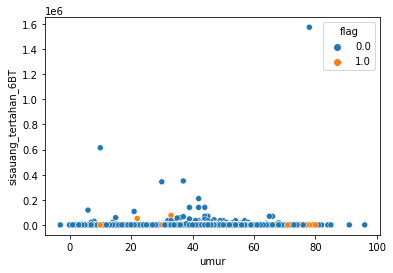

In [99]:
sns.scatterplot(data = trainset, x='umur', y = 'sisauang_tertahan_6BT', hue='flag')
print(y_train.value_counts())

In [100]:
sns.scatterplot(x=X_train_u['umur'], y = X_train_u['sisauang_tertahan_6BT'], hue=y_train_u)
print(y_train_u.value_counts())

0.0    966
1.0    966
Name: flag, dtype: int64


## Oversampling

## SMOTE

In [101]:
smote = SMOTE(random_state=42)
X_train_ov, y_train_ov = smote.fit_resample(X_train_u, y_train_u)
y_train_ov.value_counts()

0.0    966
1.0    966
Name: flag, dtype: int64

# Modeling

## Logistic Regression

In [102]:
logreg = LogisticRegression()

In [103]:
logreg.fit(X_train_ov, y_train_ov)

LogisticRegression()

## Hyperparameter Selection

In [104]:
penalty = ['l1', 'l2', 'none']
for x in penalty:
    print(x)
    print('train score:{}'.format(cross_validate(LogisticRegression(solver='saga', penalty = x, max_iter=1000), 
                         X_train_ov, 
                         y_train_ov, 
                         scoring='accuracy',
                         cv=5,
                         return_train_score=True)['train_score'].mean()))
    print('test score:{}'.format(cross_validate(LogisticRegression(solver='saga', penalty = x, max_iter=1000), 
                         X_train_ov, 
                         y_train_ov, 
                         scoring='accuracy',
                         cv=5,
                         return_train_score=True)['test_score'].mean()))

l1
train score:0.6656269650878978
test score:0.6274089247700527
l2
train score:0.6660150634061385
test score:0.6284425165013188
none
train score:0.6662739630825139
test score:0.6284425165013188


In [105]:
param_grid = {'penalty': ['l1', 'l2', 'none']}

gscv = GridSearchCV(LogisticRegression(solver='saga', max_iter=1000), param_grid, cv=5, n_jobs=-1)

In [106]:
gscv.fit(X_train_ov, y_train_ov)

GridSearchCV(cv=5, estimator=LogisticRegression(max_iter=1000, solver='saga'),
             n_jobs=-1, param_grid={'penalty': ['l1', 'l2', 'none']})

In [107]:
gscv.best_params_

{'penalty': 'l2'}

In [108]:
logreg_opt = LogisticRegression(**gscv.best_params_)
logreg_opt.fit(X_train_ov, y_train_ov)

LogisticRegression()

In [109]:
y_pred_train_d = logreg.predict(X_train_ov)
y_pred_test_d = logreg.predict(X_test_final)
y_pred_train_o = logreg_opt.predict(X_train_ov)
y_pred_test_o = logreg_opt.predict(X_test_final)

In [110]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       0.66      0.64      0.65       966
           0       0.65      0.67      0.66       966

    accuracy                           0.66      1932
   macro avg       0.66      0.66      0.66      1932
weighted avg       0.66      0.66      0.66      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.66      0.64      0.65       966
           0       0.65      0.67      0.66       966

    accuracy                           0.66      1932
   macro avg       0.66      0.66      0.66      1932
weighted avg       0.66      0.66      0.66      1932
 

test, default
              precision    recall  f1-score   support

           1       0.11      0.67      0.20       299
           0       0.90      0.37      0.53      2466

    accuracy                           0.40      2765
   macro avg       0.51      0.52      0.36      2765
weighted avg       0.82 

In [111]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_d),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [112]:
logreg_df = {'thre':[],'TP':[],'FP':[],'TN':[], 'FN':[]}

for z in np.arange(0,1.05,0.05):
    TP = 0
    FN = 0
    TN = 0
    FP = 0
    for x,y in zip(y_test, logreg.predict_proba(X_test_final)[:,1]>z):
        if x == 1:
            if x==y:
                TP+=1
            if x!=y:
                FN+=1
        if x == 0:
            if x==y:
                TN+=1
            if x!=y:
                FP+=1
    logreg_df['thre'].append(z)
    logreg_df['TP'].append(TP)
    logreg_df['TN'].append(TN)
    logreg_df['FP'].append(FP)
    logreg_df['FN'].append(FN)

In [113]:
logreg_df1 = pd.DataFrame(logreg_df)

In [114]:
logreg_df1['recall'] = logreg_df1['TP']/(logreg_df1['TP']+logreg_df1['FN'])
logreg_df1['precision'] = logreg_df1['TP']/(logreg_df1['TP']+logreg_df1['FP'])
logreg_df1['fpr'] = logreg_df1['FP']/(logreg_df1['TN']+logreg_df1['TP'])
logreg_df1['tnr'] = logreg_df1['TN']/(logreg_df1['TN']+logreg_df1['FP'])
logreg_df1['G-mean'] = np.sqrt(logreg_df1['recall']*logreg_df1['tnr'])
logreg_df1['f1-score'] = (2*(logreg_df1['precision']*logreg_df1['recall']))/(logreg_df1['precision']+logreg_df1['recall'])

In [115]:
logreg_df1.dropna()

,thre,TP,FP,TN,FN,recall,precision,fpr,tnr,G-mean,f1-score
0,0.00,299,2465,1,0,1.000000,0.108177,8.216667,0.000406,0.020137,0.195233
1,0.05,297,2453,13,2,0.993311,0.108000,7.912903,0.005272,0.072363,0.194818
2,0.10,297,2449,17,2,0.993311,0.108157,7.799363,0.006894,0.082750,0.195074
3,0.15,296,2448,18,3,0.989967,0.107872,7.796178,0.007299,0.085006,0.194545
4,0.20,296,2442,24,3,0.989967,0.108108,7.631250,0.009732,0.098157,0.194929
5,0.25,293,2430,36,6,0.979933,0.107602,7.386018,0.014599,0.119606,0.193911
6,0.30,292,2418,48,7,0.976589,0.107749,7.111765,0.019465,0.137873,0.194084
7,0.35,290,2398,68,9,0.969900,0.107887,6.698324,0.027575,0.163539,0.194175
8,0.40,287,2364,102,12,0.959866,0.108261,6.077121,0.041363,0.199255,0.194576
9,0.45,277,2299,167,22,0.926421,0.107531,5.177928,0.067721,0.250476,0.192696


In [116]:
sns.lineplot(data = logreg_df1, x='fpr', y='recall') 

<AxesSubplot:xlabel='fpr', ylabel='recall'>

In [122]:
fpr, tpr, threshold = roc_curve(y_test, logreg.predict_proba(X_test_final)[:,1])

In [123]:
np.argmax(tpr - fpr) 

314

In [124]:
threshold[314]

0.5000000126562126

In [125]:
fpr[314]

0.32522303325223034

In [126]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [127]:
print(roc_auc_score(y_test, logreg.predict_proba(X_test_final)[:,1]))

0.5362617212823496


## Precission Recall Curve

In [128]:
sns.lineplot(data = logreg_df1, x='thre', y='recall')
sns.lineplot(data = logreg_df1, x='thre', y='precision')

<AxesSubplot:xlabel='thre', ylabel='recall'>

In [129]:
precision, recall, threshold = precision_recall_curve(y_train_ov, logreg.predict_proba(X_train_ov)[:,1])

In [130]:
np.argmin(abs(precision-recall))

961

In [131]:
threshold[961]

0.49999998345436725

In [132]:
sns.lineplot(threshold, recall[:-1])
sns.lineplot(threshold, precision[:-1])

<AxesSubplot:>

In [133]:
print('train, default')
print(classification_report(y_train_ov, logreg.predict_proba(X_train_ov)[:,1]>0.45, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, logreg_opt.predict_proba(X_train_ov)[:,1]>0.45, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, logreg.predict_proba(X_test_final)[:,1]>0.45, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, logreg_opt.predict_proba(X_test_final)[:,1]>0.45, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       0.53      0.91      0.67       966
           0       0.70      0.21      0.32       966

    accuracy                           0.56      1932
   macro avg       0.62      0.56      0.50      1932
weighted avg       0.62      0.56      0.50      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.53      0.91      0.67       966
           0       0.70      0.21      0.32       966

    accuracy                           0.56      1932
   macro avg       0.62      0.56      0.50      1932
weighted avg       0.62      0.56      0.50      1932
 

test, default
              precision    recall  f1-score   support

           1       0.11      0.93      0.19       299
           0       0.88      0.07      0.13      2466

    accuracy                           0.16      2765
   macro avg       0.50      0.50      0.16      2765
weighted avg       0.80 

In [134]:
threshold = np.arange(0.1, 1.0, 0.05)

In [135]:
for i in threshold:
    print(i)
    logreg.predict_proba(X_test_final)[:, 1]>0.2
    print(classification_report(y_test, logreg.predict_proba(X_test_final)[:, 1]> i, labels=[1, 0]))

0.1
              precision    recall  f1-score   support

           1       0.11      0.99      0.20       299
           0       0.89      0.01      0.01      2466

    accuracy                           0.11      2765
   macro avg       0.50      0.50      0.10      2765
weighted avg       0.81      0.11      0.03      2765

0.15000000000000002
              precision    recall  f1-score   support

           1       0.11      0.99      0.19       299
           0       0.86      0.01      0.01      2466

    accuracy                           0.11      2765
   macro avg       0.48      0.50      0.10      2765
weighted avg       0.78      0.11      0.03      2765

0.20000000000000004
              precision    recall  f1-score   support

           1       0.11      0.99      0.19       299
           0       0.89      0.01      0.02      2466

    accuracy                           0.12      2765
   macro avg       0.50      0.50      0.11      2765
weighted avg       0.80      0

## Decision Tree Classifier

In [136]:
tree = DecisionTreeClassifier()

In [137]:
tree.fit(X_train_ov, y_train_ov)

DecisionTreeClassifier()

## Hyperparameter Optimization

In [209]:
max_depths = np.arange(3,11,1)
train = []
valid = []
depths = []
for x in max_depths:
    result = cross_validate(DecisionTreeClassifier(max_depth=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
    depths.append(x)
sns.lineplot(x=depths, y=train, label='train')
sns.lineplot(x=depths, y=valid, label='valid', marker='o')

<AxesSubplot:>

In [210]:
min_samples_split = np.arange(2,101,4)
train = []
valid = []
for x in min_samples_split:
    result = cross_validate(DecisionTreeClassifier(max_depth=3, min_samples_split=x), 
                   X_train_ov, 
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())

sns.lineplot(x=min_samples_split, y=train, label='train')
sns.lineplot(x=min_samples_split, y=valid, label='valid', marker='o')

<AxesSubplot:>

In [211]:
min_samples_leaf = np.arange(1,101,1)
train = []
valid = []
for x in min_samples_leaf:
    result = cross_validate(DecisionTreeClassifier(max_depth=3, 
                                                   min_samples_split=40, 
                                                   min_samples_leaf=x), 
                   X_train_ov, 
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())

sns.lineplot(x=min_samples_leaf, y=train, label='train')
sns.lineplot(x=min_samples_leaf, y=valid, label='valid', marker='o')

<AxesSubplot:>

In [212]:
max_features = np.arange(1,len(X_train_ov.columns)+1)
train = []
valid = []
for x in max_features:
    result = cross_validate(DecisionTreeClassifier(max_depth=3, 
                                                   min_samples_split=20, 
                                                   min_samples_leaf=81,
                                                  max_features=x), 
                   X_train_ov, 
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())

sns.lineplot(x=max_features, y=train, label='train')
sns.lineplot(x=max_features, y=valid, label='valid', marker='o')

<AxesSubplot:>

## Grid Search CV

In [138]:
param_grid = {'max_depth':[3, 4],
             'min_samples_split':[40, 60, 80],
             'min_samples_leaf':[81, 88],
             'max_features':[17, 25, 32]}
gscv = GridSearchCV(DecisionTreeClassifier(), param_grid, cv=5, n_jobs=-1)

In [139]:
gscv.fit(X_train_ov, y_train_ov)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'max_depth': [3, 4], 'max_features': [17, 25, 32],
                         'min_samples_leaf': [81, 88],
                         'min_samples_split': [40, 60, 80]})

In [140]:
gscv.best_params_

{'max_depth': 4,
 'max_features': 17,
 'min_samples_leaf': 88,
 'min_samples_split': 80}

In [141]:
tree_opt = DecisionTreeClassifier(**gscv.best_params_)

In [142]:
tree_opt.fit(X_train_ov, y_train_ov)

DecisionTreeClassifier(max_depth=4, max_features=17, min_samples_leaf=88,
                       min_samples_split=80)

In [143]:
y_pred_train_d = tree.predict(X_train_ov)
y_pred_test_d = tree.predict(X_test_final)
y_pred_train_o = tree_opt.predict(X_train_ov)
y_pred_test_o = tree_opt.predict(X_test_final)

In [144]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       966
           0       1.00      1.00      1.00       966

    accuracy                           1.00      1932
   macro avg       1.00      1.00      1.00      1932
weighted avg       1.00      1.00      1.00      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.79      0.61      0.69       966
           0       0.68      0.84      0.75       966

    accuracy                           0.72      1932
   macro avg       0.74      0.72      0.72      1932
weighted avg       0.74      0.72      0.72      1932
 

test, default
              precision    recall  f1-score   support

           1       0.12      0.62      0.20       299
           0       0.90      0.43      0.58      2466

    accuracy                           0.45      2765
   macro avg       0.51      0.53      0.39      2765
weighted avg       0.82 

In [145]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_d),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [146]:
fpr, tpr, threshold = roc_curve(y_test, tree_opt.predict(X_test_final))

In [147]:
np.argmax(tpr - fpr) 

1

In [148]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [149]:
print(roc_auc_score(y_test, tree_opt.predict(X_test_final)))

0.5414676388176864


## Random Forest

In [150]:
rf = RandomForestClassifier()

In [151]:
rf.fit(X_train_ov, y_train_ov)

RandomForestClassifier()

## Hyperparameter Optimization

In [549]:
n_estimators = np.arange(10,110,10)
train = []
valid = []
for x in n_estimators:
    result = cross_validate(RandomForestClassifier(n_estimators=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=n_estimators, y=train, label='train')
sns.lineplot(x=n_estimators, y=valid, label='valid')

<AxesSubplot:>

In [550]:
max_samples = np.arange(0.1,1.1,0.1)
train = []
valid = []
for x in max_samples:
    result = cross_validate(RandomForestClassifier(n_estimators=30, max_samples=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=max_samples, y=train, label='train')
sns.lineplot(x=max_samples, y=valid, label='valid')

<AxesSubplot:>

## Grid Search CV

In [152]:
param_grid = {'n_estimators': np.arange(10, 100, 10),
             'max_samples': [0.2 , 0.3, 0.4],
             'max_depth':[5, 6, 8],
             'min_samples_split':[20, 30, 40],
             'min_samples_leaf':[5, 10, 15],
             'max_features':[5, 8, 10]}
gscv = GridSearchCV(RandomForestClassifier(), param_grid, cv=5, n_jobs=-1)

In [153]:
gscv.fit(X_train_ov, y_train_ov)

GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [5, 6, 8], 'max_features': [5, 8, 10],
                         'max_samples': [0.2, 0.3, 0.4],
                         'min_samples_leaf': [5, 10, 15],
                         'min_samples_split': [20, 30, 40],
                         'n_estimators': array([10, 20, 30, 40, 50, 60, 70, 80, 90])})

In [154]:
gscv.best_params_

{'max_depth': 6,
 'max_features': 5,
 'max_samples': 0.2,
 'min_samples_leaf': 15,
 'min_samples_split': 30,
 'n_estimators': 20}

In [155]:
rf_opt = RandomForestClassifier(**gscv.best_params_)
rf_opt.fit(X_train_ov, y_train_ov)

RandomForestClassifier(max_depth=6, max_features=5, max_samples=0.2,
                       min_samples_leaf=15, min_samples_split=30,
                       n_estimators=20)

In [156]:
y_pred_train_d = rf.predict(X_train_ov)
y_pred_test_d = rf.predict(X_test_final)
y_pred_train_o = rf_opt.predict(X_train_ov)
y_pred_test_o = rf_opt.predict(X_test_final)

In [157]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       966
           0       1.00      1.00      1.00       966

    accuracy                           1.00      1932
   macro avg       1.00      1.00      1.00      1932
weighted avg       1.00      1.00      1.00      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.69      0.73      0.71       966
           0       0.71      0.67      0.69       966

    accuracy                           0.70      1932
   macro avg       0.70      0.70      0.70      1932
weighted avg       0.70      0.70      0.70      1932
 

test, default
              precision    recall  f1-score   support

           1       0.13      0.64      0.21       299
           0       0.91      0.47      0.62      2466

    accuracy                           0.49      2765
   macro avg       0.52      0.55      0.42      2765
weighted avg       0.83 

In [158]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_o),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [159]:
fpr, tpr, threshold = roc_curve(y_test, rf_opt.predict(X_test_final))

In [160]:
np.argmax(tpr - fpr) 

1

In [161]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [162]:
print(roc_auc_score(y_test, rf_opt.predict(X_test_final)))

0.5406444026723303


# AdaBoost Classifier

In [163]:
ab = AdaBoostClassifier()

In [164]:
ab.fit(X_train_ov, y_train_ov)

AdaBoostClassifier()

## Hyperparameter Optimization

In [564]:
n_estimators = np.arange(10,100,10)
a = n_estimators
train = []
valid = []
for x in n_estimators:
    result = cross_validate(AdaBoostClassifier(n_estimators=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

In [565]:
learning_rate = np.arange(0.1,1,0.1)
a = learning_rate
train = []
valid = []
for x in learning_rate:
    result = cross_validate(AdaBoostClassifier(n_estimators=10, learning_rate=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

## Grid Search CV

In [165]:
param_grid = {'learning_rate':np.arange(0.1,1,0.1),
              'n_estimators':np.arange(10,200,10)},
gscv = GridSearchCV(AdaBoostClassifier(), param_grid, cv=5, n_jobs=-1)

In [166]:
gscv.fit(X_train_ov, y_train_ov)

GridSearchCV(cv=5, estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid=({'learning_rate': array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
                          'n_estimators': array([ 10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120, 130,
       140, 150, 160, 170, 180, 190])},))

In [167]:
gscv.best_params_

{'learning_rate': 0.1, 'n_estimators': 10}

In [168]:
ab_opt = AdaBoostClassifier(**gscv.best_params_)
ab_opt.fit(X_train_ov, y_train_ov)

AdaBoostClassifier(learning_rate=0.1, n_estimators=10)

In [169]:
y_pred_train_d = ab.predict(X_train_ov)
y_pred_test_d = ab.predict(X_test_final)
y_pred_train_o = ab_opt.predict(X_train_ov)
y_pred_test_o = ab_opt.predict(X_test_final)

In [170]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       0.70      0.76      0.73       966
           0       0.74      0.67      0.71       966

    accuracy                           0.72      1932
   macro avg       0.72      0.72      0.72      1932
weighted avg       0.72      0.72      0.72      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.66      0.77      0.71       966
           0       0.72      0.61      0.66       966

    accuracy                           0.69      1932
   macro avg       0.69      0.69      0.68      1932
weighted avg       0.69      0.69      0.68      1932
 

test, default
              precision    recall  f1-score   support

           1       0.12      0.75      0.21       299
           0       0.92      0.34      0.49      2466

    accuracy                           0.38      2765
   macro avg       0.52      0.55      0.35      2765
weighted avg       0.83 

In [171]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_o),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [172]:
fpr, tpr, threshold = roc_curve(y_test, ab_opt.predict(X_test_final))

In [173]:
np.argmax(tpr - fpr) 

1

In [174]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [175]:
print(roc_auc_score(y_test, ab_opt.predict(X_test_final)))

0.544486623429816


# XGBoost Classifier

In [176]:
xgb = XGBClassifier()

In [177]:
xgb.fit(X_train_ov, y_train_ov)

[22:39:32] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=4,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

## Hyperparameter Optimization

In [588]:
learning_rate = np.arange(0.05,0.5,0.05)
a = learning_rate
train = []
valid = []
for x in a:
    result = cross_validate(XGBClassifier(learning_rate=x, verbosity=0), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

In [589]:
n_estimators = np.arange(10,100,10)
a = n_estimators
train = []
valid = []
for x in a:
    result = cross_validate(XGBClassifier(learning_rate=0.05, n_estimators=x, verbosity=0), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

In [590]:
gamma = np.arange(1,10,1)
a = gamma
train = []
valid = []
for x in a:
    result = cross_validate(XGBClassifier(learning_rate=0.05,
                                          n_estimators=20,
                                          gamma=x,
                                          verbosity=0), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

In [591]:
min_child_weight = np.arange(0.5,3,0.5)
a = min_child_weight
train = []
valid = []
for x in a:
    result = cross_validate(XGBClassifier(learning_rate=0.05,
                                          n_estimators=20,
                                          gamma=9,
                                          min_child_weight=x,
                                          verbosity=0), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

## Grid Search CV

In [178]:
param_grid = {'learning_rate': [0.05, 0.25],
             'n_estimators': [20, 30],
             'gamma':[7, 9, 10],
             'min_child_weight':[2.25, 2.5]}
gscv = GridSearchCV(XGBClassifier(), param_grid, cv=5, n_jobs=-1)

In [179]:
gscv.fit(X_train_ov, y_train_ov)

[22:39:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     enable_categorical=False, gamma=None,
                                     gpu_id=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=None, reg_alpha=None,
                                     reg_lambda=None, scale_pos_weight

In [180]:
gscv.best_params_

{'gamma': 10,
 'learning_rate': 0.05,
 'min_child_weight': 2.25,
 'n_estimators': 30}

In [181]:
xgb_opt = XGBClassifier(**gscv.best_params_)
xgb_opt.fit(X_train_ov, y_train_ov)

[22:40:04] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=10, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.05, max_delta_step=0,
              max_depth=6, min_child_weight=2.25, missing=nan,
              monotone_constraints='()', n_estimators=30, n_jobs=4,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [182]:
y_pred_train_d = xgb.predict(X_train_ov)
y_pred_test_d = xgb.predict(X_test_final)
y_pred_train_o = xgb_opt.predict(X_train_ov)
y_pred_test_o = xgb_opt.predict(X_test_final)

In [183]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       0.95      0.96      0.96       966
           0       0.96      0.95      0.96       966

    accuracy                           0.96      1932
   macro avg       0.96      0.96      0.96      1932
weighted avg       0.96      0.96      0.96      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.77      0.67      0.72       966
           0       0.71      0.80      0.75       966

    accuracy                           0.73      1932
   macro avg       0.74      0.73      0.73      1932
weighted avg       0.74      0.73      0.73      1932
 

test, default
              precision    recall  f1-score   support

           1       0.12      0.59      0.20       299
           0       0.91      0.49      0.64      2466

    accuracy                           0.50      2765
   macro avg       0.52      0.54      0.42      2765
weighted avg       0.82 

In [184]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_o),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [185]:
fpr, tpr, threshold = roc_curve(y_test, xgb_opt.predict(X_test_final))

In [186]:
np.argmax(tpr - fpr) 

1

In [187]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [188]:
print(roc_auc_score(y_test, xgb_opt.predict(X_test_final)))

0.5454122555042897


## SVM

In [189]:
svc = SVC()
svc.fit(X_train_ov, y_train_ov)

SVC()

## Hyperparameter Optimization

In [605]:
gamma = np.arange(0.1,1,0.1)
a = gamma
train = []
valid = []
for x in a:
    result = cross_validate(SVC(kernel='rbf', gamma=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

In [606]:
c = np.arange(0.05,0.8,0.05)
a = c
train = []
valid = []
for x in a:
    result = cross_validate(SVC(kernel='rbf', gamma=0.9, C=x), 
                   X_train_ov,
                   y_train_ov, 
                   cv=5, 
                   return_train_score=True)
    train.append(result['train_score'].mean())
    valid.append(result['test_score'].mean())
sns.lineplot(x=a, y=train, label='train')
sns.lineplot(x=a, y=valid, label='valid')

<AxesSubplot:>

## Grid Search CV

In [190]:
param_grid = {'kernel':['rbf'],
             'gamma':[0.7, 0.75, 0.8],
             'C':[0.1, 0.15, 0.2]}
gscv = GridSearchCV(SVC(), param_grid, cv=5, n_jobs=-1)

In [191]:
gscv.fit(X_train_ov, y_train_ov)

GridSearchCV(cv=5, estimator=SVC(), n_jobs=-1,
             param_grid={'C': [0.1, 0.15, 0.2], 'gamma': [0.7, 0.75, 0.8],
                         'kernel': ['rbf']})

In [192]:
gscv.best_params_

{'C': 0.2, 'gamma': 0.8, 'kernel': 'rbf'}

In [193]:
svc_opt = SVC(**gscv.best_params_)
svc_opt.fit(X_train_ov, y_train_ov)

SVC(C=0.2, gamma=0.8)

In [194]:
y_pred_train_d = svc.predict(X_train_ov)
y_pred_test_d = svc.predict(X_test_final)
y_pred_train_o = svc_opt.predict(X_train_ov)
y_pred_test_o = svc_opt.predict(X_test_final)

In [195]:
print('train, default')
print(classification_report(y_train_ov, y_pred_train_d, labels=[1,0]), '\n')
print('train, optimized')
print(classification_report(y_train_ov, y_pred_train_o, labels=[1,0]), '\n')
print('test, default')
print(classification_report(y_test, y_pred_test_d, labels=[1,0]), '\n')
print('test, optimized')
print(classification_report(y_test, y_pred_test_o, labels=[1,0]), '\n')

train, default
              precision    recall  f1-score   support

           1       0.55      0.89      0.68       966
           0       0.70      0.27      0.39       966

    accuracy                           0.58      1932
   macro avg       0.63      0.58      0.54      1932
weighted avg       0.63      0.58      0.54      1932
 

train, optimized
              precision    recall  f1-score   support

           1       0.97      0.56      0.71       966
           0       0.69      0.99      0.81       966

    accuracy                           0.77      1932
   macro avg       0.83      0.77      0.76      1932
weighted avg       0.83      0.77      0.76      1932
 

test, default
              precision    recall  f1-score   support

           1       0.11      0.89      0.19       299
           0       0.88      0.10      0.18      2466

    accuracy                           0.19      2765
   macro avg       0.50      0.50      0.19      2765
weighted avg       0.80 

In [196]:
sns.heatmap(confusion_matrix(y_test, y_pred_test_d),annot=True, fmt='g', cmap='Blues')
plt.ylabel('actual')
plt.xlabel('predicted')

Text(0.5, 15.0, 'predicted')

## ROC AUC Curve

In [197]:
fpr, tpr, threshold = roc_curve(y_test, svc_opt.predict(X_test_final))

In [198]:
np.argmax(tpr - fpr) 

1

In [199]:
sns.lineplot(fpr, tpr)

<AxesSubplot:>

In [200]:
print(roc_auc_score(y_test, svc_opt.predict(X_test_final)))

0.548032506299723


# Evaluasi

## Backtestset

## Missing Value Handling

In [201]:
backtestset2 = backtestset.copy()

In [202]:
backtestset.shape

(3456, 79)

In [203]:
cnt_missing = backtestset2.isnull().sum().sort_values(ascending=False)
cnt_percent = cnt_missing/backtestset2.shape[0] * 100
missing_table = pd.DataFrame([cnt_missing, cnt_percent], \
    index=['Missing Count', 'Missing Percent']).T
missing_table = missing_table[missing_table['Missing Count'] > 0]
missing_table = missing_table.reset_index()
missing_table['Missing Count'] = missing_table['Missing Count'].astype(int)
missing_table

,index,Missing Count,Missing Percent
0,omset,3456,100.000000
1,penghasilan,3456,100.000000
2,education,3456,100.000000
3,Penanggung,3176,91.898148
4,Usaha,3001,86.834491
5,jualan,2276,65.856481
6,Pekerjaan,794,22.974537
7,keluarga,623,18.026620
8,gender,612,17.708333
9,punya_produk4,56,1.620370


In [204]:
backtestset2 = backtestset2.drop([
    'kode pelanggan',
    'omset', 
    'penghasilan', 
    'education', 
    'Penanggung', 
    'Usaha', 
    'jualan', 
    'kota', 
    'tgl data'], axis=1)
backtestset2.head()

,umur,gender,keluarga,Pekerjaan,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,31.0,M,B,Usaha Mandiri,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,3.0,2.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
1,7.0,NaN,NaN,NaN,0.0,1.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,0.0,0.0
2,62.0,M,K,Pedagang,0.0,1.0,1.0,0.0,0.0,1.0,...,497.0,539.0,618.0,620.0,732.0,905.0,814.0,826.0,829.0,808.0
3,41.0,M,K,Usaha Mandiri,1.0,1.0,1.0,0.0,0.0,0.0,...,390.0,361.0,444.0,647.0,132.0,128.0,103.0,104.0,123.0,131.0
4,30.0,F,J,Usaha Mandiri,1.0,1.0,1.0,0.0,0.0,1.0,...,54.0,44.0,55.0,62.0,23.0,19.0,38.0,27.0,28.0,5.0


In [206]:
backtest2_num = backtestset2.select_dtypes('number')
backtest2_num.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,31.0,0.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,0.0,3.0,2.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
1,7.0,0.0,1.0,1.0,1.0,0.0,0.0,18364.940200,0.000000,0.000000,...,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,0.0,0.0
2,62.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,497.0,539.0,618.0,620.0,732.0,905.0,814.0,826.0,829.0,808.0
3,41.0,1.0,1.0,1.0,0.0,0.0,0.0,2344.958532,561.904165,534.328365,...,390.0,361.0,444.0,647.0,132.0,128.0,103.0,104.0,123.0,131.0
4,30.0,1.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,54.0,44.0,55.0,62.0,23.0,19.0,38.0,27.0,28.0,5.0


In [207]:
backtest2_obj = backtestset2.select_dtypes(exclude='number')
backtest2_obj.head()

,gender,keluarga,Pekerjaan
0,M,B,Usaha Mandiri
1,NaN,NaN,NaN
2,M,K,Pedagang
3,M,K,Usaha Mandiri
4,F,J,Usaha Mandiri


## Ordinal Encoder

In [208]:
backtest2_obj_encode = backtest2_obj.copy()

In [209]:
backtest2_obj_encode = oe.transform(backtest2_obj_encode)
backtest2_obj_encode = pd.DataFrame(backtest2_obj_encode)
backtest2_obj_encode.columns = backtest2_obj.columns
backtest2_obj_encode.head()

,gender,keluarga,Pekerjaan
0,1.0,0.0,29.0
1,NaN,NaN,NaN
2,1.0,3.0,15.0
3,1.0,3.0,29.0
4,0.0,2.0,29.0


In [210]:
backtest_join = pd.concat([backtest2_num, backtest2_obj_encode],axis=1)
backtest_join.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,31.0,0.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,29.0
1,7.0,0.0,1.0,1.0,1.0,0.0,0.0,18364.940200,0.000000,0.000000,...,0.0,14.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN
2,62.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,620.0,732.0,905.0,814.0,826.0,829.0,808.0,1.0,3.0,15.0
3,41.0,1.0,1.0,1.0,0.0,0.0,0.0,2344.958532,561.904165,534.328365,...,647.0,132.0,128.0,103.0,104.0,123.0,131.0,1.0,3.0,29.0
4,30.0,1.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,62.0,23.0,19.0,38.0,27.0,28.0,5.0,0.0,2.0,29.0


In [211]:
backtestset2.shape, backtest_join.shape

((3456, 70), (3456, 70))

## KNN Imputer

In [212]:
backtest_join2 = imputer_KNN.transform(backtest_join)
backtest_join2 = pd.DataFrame(backtest_join2)
backtest_join2.columns = backtest_join.columns

In [213]:
backtest_join2.isna().sum()

umur                       0
punya_produk1              0
punya_produk2              0
punya_produk3              0
punya_produk4              0
                          ..
frekuensi_pemasukan_5BT    0
frekuensi_pemasukan_6BT    0
gender                     0
keluarga                   0
Pekerjaan                  0
Length: 70, dtype: int64

In [214]:
backtest_join2[['gender', 'keluarga', 'Pekerjaan']] = oe.inverse_transform(backtest_join2[['gender', 'keluarga', 'Pekerjaan']])
backtest_join2.head()

,umur,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,...,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT,gender,keluarga,Pekerjaan
0,31.0,0.0,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,4.0,0.0,0.0,0.0,0.0,0.0,0.0,M,B,Usaha Mandiri
1,7.0,0.0,1.0,1.0,1.0,0.0,0.0,18364.940200,0.000000,0.000000,...,0.0,14.0,0.0,0.0,0.0,0.0,0.0,F,J,Usaha Mandiri
2,62.0,0.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,620.0,732.0,905.0,814.0,826.0,829.0,808.0,M,K,Pedagang
3,41.0,1.0,1.0,1.0,0.0,0.0,0.0,2344.958532,561.904165,534.328365,...,647.0,132.0,128.0,103.0,104.0,123.0,131.0,M,K,Usaha Mandiri
4,30.0,1.0,1.0,1.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,...,62.0,23.0,19.0,38.0,27.0,28.0,5.0,F,J,Usaha Mandiri


## Feature Transformation

In [215]:
backtest2_num = backtest_join2.select_dtypes('number')

In [216]:
backtest2_num.shape

(3456, 67)

In [217]:
backtest2_bool = backtest2_num[[
                             'punya_produk1', 
                             'punya_produk2', 
                             'punya_produk3', 
                             'punya_produk4', 
                             'punya_produk5', 
                             'punya_produk6'
]]
backtest2_bool.head()

,punya_produk1,punya_produk2,punya_produk3,punya_produk4,punya_produk5,punya_produk6
0,0.0,0.0,1.0,0.0,0.0,1.0
1,0.0,1.0,1.0,1.0,0.0,0.0
2,0.0,1.0,1.0,0.0,0.0,1.0
3,1.0,1.0,1.0,0.0,0.0,0.0
4,1.0,1.0,1.0,0.0,0.0,1.0


In [218]:
backtest2_num = backtest2_num.drop(backtest2_num[backtest2_bool.columns], axis=1)
backtest2_num.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
0,31.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,3.0,2.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0
1,7.0,18364.940200,0.000000,0.000000,0.000000,0.000000,0.000000,6332.240931,0.000000,0.000000,...,0.0,0.0,0.0,0.0,14.0,0.0,0.0,0.0,0.0,0.0
2,62.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,497.0,539.0,618.0,620.0,732.0,905.0,814.0,826.0,829.0,808.0
3,41.0,2344.958532,561.904165,534.328365,418.082756,660.530172,482.062537,2714.834421,2015.554513,1622.228979,...,390.0,361.0,444.0,647.0,132.0,128.0,103.0,104.0,123.0,131.0
4,30.0,0.000000,0.000000,0.000000,865.114613,2229.739248,0.000000,0.000000,0.000000,0.000000,...,54.0,44.0,55.0,62.0,23.0,19.0,38.0,27.0,28.0,5.0


In [219]:
backtest2_num.shape

(3456, 61)

## Robust Scaler

In [220]:
backtest2_num_rs = pd.DataFrame(rscaler.transform(backtest2_num))
backtest2_num_rs.columns = backtest2_num.columns

In [221]:
backtest2_num_rs.describe()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,frekuensi_pengeluaran_3BT,frekuensi_pengeluaran_4BT,frekuensi_pengeluaran_5BT,frekuensi_pengeluaran_6BT,frekuensi_pemasukan_1BT,frekuensi_pemasukan_2BT,frekuensi_pemasukan_3BT,frekuensi_pemasukan_4BT,frekuensi_pemasukan_5BT,frekuensi_pemasukan_6BT
count,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3.456000e+03,3456.000000,3456.000000,3456.000000,...,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000,3456.000000
mean,-0.295084,10.078466,14.430758,24.287023,32.654586,79.281600,1.805004e+03,11.798790,17.973738,32.150802,...,2.503449,2.696198,2.730735,2.885241,1.582060,1.622374,1.825545,1.944339,2.052373,2.028600
std,1.178040,197.526801,298.282372,523.450008,548.853000,1448.322641,3.243730e+04,228.743002,362.401455,679.226827,...,10.936834,12.250017,11.575311,12.840869,5.809251,5.185848,6.188607,6.210036,7.519049,7.268167
min,-8.357143,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
25%,-0.785714,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.108108,-0.058824,-0.032258,-0.035714,-0.100000,-0.074074,-0.041667,0.000000,0.000000,0.000000
50%,-0.142857,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,...,-0.054054,-0.029412,-0.032258,-0.035714,-0.033333,-0.037037,-0.041667,0.000000,0.000000,0.000000
75%,0.428571,0.872863,0.807643,0.759734,1.175734,1.376306,1.198755e+01,0.789040,0.818117,0.554408,...,0.729730,0.823529,0.838710,0.821429,0.733333,0.814815,0.750000,0.863636,0.850000,0.789474
max,3.142857,10798.351620,16435.821717,26425.471617,19744.879795,59436.124014,1.418985e+06,12437.602325,19766.048229,34775.915728,...,356.162162,414.735294,358.516129,400.285714,179.866667,85.925926,116.125000,91.454545,201.600000,170.368421


## One Hot Encoder

In [222]:
backtest2_obj = backtest_join2.select_dtypes(exclude='number')
backtest2_obj.head()

,gender,keluarga,Pekerjaan
0,M,B,Usaha Mandiri
1,F,J,Usaha Mandiri
2,M,K,Pedagang
3,M,K,Usaha Mandiri
4,F,J,Usaha Mandiri


In [223]:
backtest2_obj_ohe = pd.DataFrame(ohe.transform(backtest2_obj))
backtest2_obj_ohe.columns = ohe.get_feature_names(backtest2_obj.columns)
backtest2_obj_ohe.head()

,gender_F,gender_M,keluarga_B,keluarga_D,keluarga_J,keluarga_K,Pekerjaan_ASN,Pekerjaan_Administrasi Umum / Supervisor,Pekerjaan_Akunting / Keuangan,Pekerjaan_Dokter,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [224]:
backtest_transform = pd.concat([backtest2_num_rs, backtest2_bool, backtest2_obj_ohe], axis=1)
backtest_transform.head()

,umur,average_sisauang_mingguan_1BT,average_sisauang_mingguan_2BT,average_sisauang_mingguan_3BT,average_sisauang_mingguan_4BT,average_sisauang_mingguan_5BT,average_sisauang_mingguan_6BT,sisauang_akhir_1BT,sisauang_akhir_2BT,sisauang_akhir_3BT,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-0.571429,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,-2.285714,10.597067,0.00000,0.000000,0.000000,0.000000,0.000000,4.207237,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1.642857,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.142857,1.353104,0.49391,0.762634,1.011381,3.781287,66.713274,1.803777,2.129931,3.018258,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.642857,0.000000,0.00000,0.000000,2.092793,12.764421,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [225]:
X_train_transform.shape, X_test_transform.shape, backtest_transform.shape

((9312, 103), (2765, 103), (3456, 103))

## Future Selection

## Multicolinearity

In [226]:
a = []
b = []
for x in backtest_transform.columns:
    for y in backtest_transform.columns:
        if x != y:
            if [y,x] not in a:
                if np.abs(spearmanr(backtest_transform[x], backtest_transform[y])[0]) > 0.7:
                    if spearmanr(backtest_transform[x], backtest_transform[y])[1] < 0.05:
                        b.append(x)
                a.append([x,y])
                print([x,y], spearmanr(backtest_transform[x], backtest_transform[y])[0], spearmanr(backtest_transform[x], backtest_transform[y])[1])

['umur', 'average_sisauang_mingguan_1BT'] 0.09336477433757287 3.825280588491849e-08
['umur', 'average_sisauang_mingguan_2BT'] 0.09739795698020647 9.615196592294313e-09
['umur', 'average_sisauang_mingguan_3BT'] 0.09963071456200309 4.369648320751036e-09
['umur', 'average_sisauang_mingguan_4BT'] 0.10318122852851132 1.2030904497826928e-09
['umur', 'average_sisauang_mingguan_5BT'] 0.09246854186413635 5.1595765733665656e-08
['umur', 'average_sisauang_mingguan_6BT'] 0.0970724715516165 1.0771144461651831e-08
['umur', 'sisauang_akhir_1BT'] 0.08519731979599643 5.27943459013927e-07
['umur', 'sisauang_akhir_2BT'] 0.08514737924559404 5.361077443601871e-07
['umur', 'sisauang_akhir_3BT'] 0.10099022639427169 2.6804780326663004e-09
['umur', 'sisauang_akhir_4BT'] 0.0967690373159433 1.1969658996494777e-08
['umur', 'sisauang_akhir_5BT'] 0.10946796213903824 1.1005883402275263e-10
['umur', 'sisauang_akhir_6BT'] 0.09430400718566606 2.7873176215531577e-08
['umur', 'sisauang_tertahan_1BT'] 0.03312651759340649 

['average_sisauang_mingguan_1BT', 'sisauang_akhir_2BT'] 0.8338976133929857 0.0
['average_sisauang_mingguan_1BT', 'sisauang_akhir_3BT'] 0.7119395957471218 0.0
['average_sisauang_mingguan_1BT', 'sisauang_akhir_4BT'] 0.6830027893384993 0.0
['average_sisauang_mingguan_1BT', 'sisauang_akhir_5BT'] 0.6441214743639584 0.0
['average_sisauang_mingguan_1BT', 'sisauang_akhir_6BT'] 0.6159279721471357 0.0
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_1BT'] 0.2263780465302884 2.085030078252134e-41
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_2BT'] 0.2106354159036345 5.876622868082334e-36
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_3BT'] 0.20021615909488305 1.3903283313506632e-32
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_4BT'] 0.19133139842812222 7.512556750902357e-30
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_5BT'] 0.17742077615839127 7.779406258391334e-26
['average_sisauang_mingguan_1BT', 'sisauang_tertahan_6BT'] 0.18036156689940988 1.1713570387626788e-26

['average_sisauang_mingguan_1BT', 'Pekerjaan_Pendidik'] -0.02425478643855638 0.15399010178965988
['average_sisauang_mingguan_1BT', 'Pekerjaan_Pengacara'] 0.044794058033859205 0.008445724361479286
['average_sisauang_mingguan_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.018576888322713377 0.274924237607186
['average_sisauang_mingguan_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.15896730131346265 5.364136552351117e-21
['average_sisauang_mingguan_1BT', 'Pekerjaan_Pensiunan'] -0.07855354576530403 3.7738888990952294e-06
['average_sisauang_mingguan_1BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.00345787404670259 0.8389726798969921
['average_sisauang_mingguan_1BT', 'Pekerjaan_Riset & Pengembangan'] 0.06612582267430452 0.00010014491938360296
['average_sisauang_mingguan_1BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.04561783654686611 0.007314052795475051
['average_sisauang_mingguan_1BT', 'Pekerjaan_Seniman'] 0.03643218741174479 0.03221741765825272
['average_sisauang_

['average_sisauang_mingguan_2BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.027385335888823904 0.10747606443988317
['average_sisauang_mingguan_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.15618874239003833 2.5733382263745912e-20
['average_sisauang_mingguan_2BT', 'Pekerjaan_Pensiunan'] -0.07092763657342259 3.0005479473703354e-05
['average_sisauang_mingguan_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.01383206308133084 0.41627502438275155
['average_sisauang_mingguan_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.07538831747237605 9.13819734323905e-06
['average_sisauang_mingguan_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.04622367787529527 0.006570645066027732
['average_sisauang_mingguan_2BT', 'Pekerjaan_Seniman'] 0.030143639703667607 0.07642138153455572
['average_sisauang_mingguan_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.010428790233675798 0.5399556656584343
['average_sisauang_mingguan_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.00630379

['average_sisauang_mingguan_3BT', 'Pekerjaan_Pendidik'] -0.027003356120795498 0.11247147773839468
['average_sisauang_mingguan_3BT', 'Pekerjaan_Pengacara'] 0.035004188252550215 0.03961858022609465
['average_sisauang_mingguan_3BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.023361411570501894 0.1697351029130012
['average_sisauang_mingguan_3BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.14833975264279511 1.8521886843602478e-18
['average_sisauang_mingguan_3BT', 'Pekerjaan_Pensiunan'] -0.07380367695918266 1.404819111248806e-05
['average_sisauang_mingguan_3BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.002210001629760985 0.8966659635873878
['average_sisauang_mingguan_3BT', 'Pekerjaan_Riset & Pengembangan'] 0.05375942820113281 0.0015693779407386392
['average_sisauang_mingguan_3BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.050490136655361735 0.002987495671096484
['average_sisauang_mingguan_3BT', 'Pekerjaan_Seniman'] 0.039499629727313176 0.020224284451713412
['average_sisaua

['average_sisauang_mingguan_4BT', 'Pekerjaan_Pendidik'] -0.0247579445782605 0.14562484177273585
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pengacara'] 0.040436271467741425 0.017441321598404145
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.02091561724373774 0.21896991029487967
['average_sisauang_mingguan_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.13732811483934604 5.114947345141306e-16
['average_sisauang_mingguan_4BT', 'Pekerjaan_Pensiunan'] -0.07230033829949055 2.0960529126593705e-05
['average_sisauang_mingguan_4BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.0036641886261891397 0.8295083129037479
['average_sisauang_mingguan_4BT', 'Pekerjaan_Riset & Pengembangan'] 0.0661948766361992 9.84778588339425e-05
['average_sisauang_mingguan_4BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.050387852058452635 0.0030465733415293347
['average_sisauang_mingguan_4BT', 'Pekerjaan_Seniman'] 0.012106190698935666 0.47679652095664427
['average_sisauang

['average_sisauang_mingguan_5BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.03686673352092174 0.030214642038836132
['average_sisauang_mingguan_5BT', 'Pekerjaan_Pemilik Perusahaan'] 0.014089474987290197 0.4076534815145072
['average_sisauang_mingguan_5BT', 'Pekerjaan_Pendidik'] -0.03410417441857561 0.04498810319374861
['average_sisauang_mingguan_5BT', 'Pekerjaan_Pengacara'] 0.03622705758103299 0.033201681540877756
['average_sisauang_mingguan_5BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.015651034074018383 0.35767068233016897
['average_sisauang_mingguan_5BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.12565231732510704 1.2296810384763652e-13
['average_sisauang_mingguan_5BT', 'Pekerjaan_Pensiunan'] -0.06868910283193669 5.3135077722642015e-05
['average_sisauang_mingguan_5BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.01125692457938935 0.5082590996776908
['average_sisauang_mingguan_5BT', 'Pekerjaan_Riset & Pengembangan'] 0.06994385849640411 3.865161268354856e-05
['average_s

['average_sisauang_mingguan_6BT', 'Pekerjaan_Dokter'] 0.009711917873125149 0.5681699623848722
['average_sisauang_mingguan_6BT', 'Pekerjaan_Executive / Managerial'] -0.01396528112520339 0.4117997729981019
['average_sisauang_mingguan_6BT', 'Pekerjaan_Ibu RT'] 0.011339263577050111 0.505161781132613
['average_sisauang_mingguan_6BT', 'Pekerjaan_Karyawan'] -0.055194665588045394 0.0011700960151750154
['average_sisauang_mingguan_6BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.028876567154644088 0.08963460120429943
['average_sisauang_mingguan_6BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.03619919332459704 0.0333373453947805
['average_sisauang_mingguan_6BT', 'Pekerjaan_Konsultan'] -0.0026470298245042916 0.8763822865252104
['average_sisauang_mingguan_6BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.02047355605596883 0.22886601847912727
['average_sisauang_mingguan_6BT', 'Pekerjaan_Militer (POLRI)'] -0.01292072642786632 0.4476507500046819
['average_sisauang_mingguan_6BT', 'Pekerjaan_Mil

['sisauang_akhir_1BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.021082556842437882 0.21531383006858512
['sisauang_akhir_1BT', 'Pekerjaan_Pemilik Perusahaan'] 0.008578160116654417 0.6141787311242748
['sisauang_akhir_1BT', 'Pekerjaan_Pendidik'] -0.03423490900234613 0.0441719718384922
['sisauang_akhir_1BT', 'Pekerjaan_Pengacara'] 0.04255001195881645 0.012361687556515108
['sisauang_akhir_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.005799947885377302 0.7332199474004735
['sisauang_akhir_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.14903321176253903 1.2809892895472435e-18
['sisauang_akhir_1BT', 'Pekerjaan_Pensiunan'] -0.08157091083342509 1.5737224923212276e-06
['sisauang_akhir_1BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.01250093555396386 0.46254367787463446
['sisauang_akhir_1BT', 'Pekerjaan_Riset & Pengembangan'] 0.07757666315355284 4.9761757615065955e-06
['sisauang_akhir_1BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.047966315952657095 0.004795854049017379
['s

['sisauang_akhir_3BT', 'sisauang_akhir_5BT'] 0.7680773377549714 0.0
['sisauang_akhir_3BT', 'sisauang_akhir_6BT'] 0.7203467265316678 0.0
['sisauang_akhir_3BT', 'sisauang_tertahan_1BT'] 0.1970066984593149 1.397955048864465e-31
['sisauang_akhir_3BT', 'sisauang_tertahan_2BT'] 0.20314638891130127 1.6323556625689245e-33
['sisauang_akhir_3BT', 'sisauang_tertahan_3BT'] 0.2521421251398825 2.901477441724112e-51
['sisauang_akhir_3BT', 'sisauang_tertahan_4BT'] 0.23131637233824526 3.318161278606435e-43
['sisauang_akhir_3BT', 'sisauang_tertahan_5BT'] 0.21882427720466635 9.716987830414627e-39
['sisauang_akhir_3BT', 'sisauang_tertahan_6BT'] 0.20915020269986279 1.825292144104777e-35
['sisauang_akhir_3BT', 'sisauang_tersedia_1BT'] 0.6404291035492115 0.0
['sisauang_akhir_3BT', 'sisauang_tersedia_2BT'] 0.756588945467323 0.0
['sisauang_akhir_3BT', 'sisauang_tersedia_3BT'] 0.9651449477388735 0.0
['sisauang_akhir_3BT', 'sisauang_tersedia_4BT'] 0.7802085090310693 0.0
['sisauang_akhir_3BT', 'sisauang_tersedia_

['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_1BT'] 0.20342333632384238 1.3308801235947582e-33
['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_2BT'] 0.2167578265903326 5.01564428339948e-38
['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_3BT'] 0.24798093878556177 1.3639141557057921e-49
['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_4BT'] 0.2588253116087862 5.142919725488716e-54
['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_5BT'] 0.23489158302894003 1.557149322129672e-44
['sisauang_akhir_4BT', 'jumlah_pembayaran_hutang_6BT'] 0.22194571251937467 7.886019335661229e-40
['sisauang_akhir_4BT', 'jumlah_pengeluaran_1BT'] 0.45898299865008463 1.0976834358228334e-179
['sisauang_akhir_4BT', 'jumlah_pengeluaran_2BT'] 0.48473716235627623 3.626013494687342e-203
['sisauang_akhir_4BT', 'jumlah_pengeluaran_3BT'] 0.5546837513524481 4.025580345790505e-278
['sisauang_akhir_4BT', 'jumlah_pengeluaran_4BT'] 0.5409504284742469 5.518510948631441e-262
['sisauang_akhir_4BT', 'jumlah_pengeluaran_5BT'] 0.5

['sisauang_akhir_5BT', 'frekuensi_pengeluaran_4BT'] 0.44595243026997294 1.495148730747098e-168
['sisauang_akhir_5BT', 'frekuensi_pengeluaran_5BT'] 0.45284830050407127 2.201929092808088e-174
['sisauang_akhir_5BT', 'frekuensi_pengeluaran_6BT'] 0.43005638392277384 1.3039449475475024e-155
['sisauang_akhir_5BT', 'frekuensi_pemasukan_1BT'] 0.34739317282516446 1.3523219411125436e-98
['sisauang_akhir_5BT', 'frekuensi_pemasukan_2BT'] 0.39070983681702914 1.9999329405209475e-126
['sisauang_akhir_5BT', 'frekuensi_pemasukan_3BT'] 0.43224890151256173 2.3509914244106363e-157
['sisauang_akhir_5BT', 'frekuensi_pemasukan_4BT'] 0.44021345392089045 8.443812986069396e-164
['sisauang_akhir_5BT', 'frekuensi_pemasukan_5BT'] 0.461830395691448 3.48577348304178e-182
['sisauang_akhir_5BT', 'frekuensi_pemasukan_6BT'] 0.44269973713092126 7.570517423866841e-166
['sisauang_akhir_5BT', 'punya_produk1'] 0.0647125867045212 0.00014070711986608823
['sisauang_akhir_5BT', 'punya_produk2'] 0.055255570790428345 0.001155436607

['sisauang_akhir_6BT', 'Pekerjaan_Executive / Managerial'] -0.01339078914410408 0.43130240081767934
['sisauang_akhir_6BT', 'Pekerjaan_Ibu RT'] 0.007804408644807179 0.6464893558690588
['sisauang_akhir_6BT', 'Pekerjaan_Karyawan'] -0.05468527165279639 0.001299600886832592
['sisauang_akhir_6BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.021740913186687947 0.201324145572269
['sisauang_akhir_6BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.03801713939182994 0.025421180153841157
['sisauang_akhir_6BT', 'Pekerjaan_Konsultan'] -0.0030699811548726987 0.8568287937073666
['sisauang_akhir_6BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.012139530561626253 0.47558351599000703
['sisauang_akhir_6BT', 'Pekerjaan_Militer (POLRI)'] -0.011124481921864885 0.513261959798991
['sisauang_akhir_6BT', 'Pekerjaan_Militer (TNI - AD)'] -0.009950410902934305 0.5587056257896806
['sisauang_akhir_6BT', 'Pekerjaan_Militer (TNI - AL)'] 0.0008200913908359961 0.9615617128674594
['sisauang_akhir_6BT', 'Pekerjaan_Not

['sisauang_tertahan_1BT', 'Pekerjaan_Pendidik'] -0.013417170967515598 0.43039523697917226
['sisauang_tertahan_1BT', 'Pekerjaan_Pengacara'] -0.013648532401323235 0.4224872112825281
['sisauang_tertahan_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.016337964040455052 0.3369601828537433
['sisauang_tertahan_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.04386263665719377 0.009911713493626819
['sisauang_tertahan_1BT', 'Pekerjaan_Pensiunan'] -0.006108999547759162 0.7195892584198325
['sisauang_tertahan_1BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.005551770815608713 0.7442272077326642
['sisauang_tertahan_1BT', 'Pekerjaan_Riset & Pengembangan'] -0.020507873220870006 0.22808657560981152
['sisauang_tertahan_1BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.004299137596855595 0.8005414842715127
['sisauang_tertahan_1BT', 'Pekerjaan_Seniman'] 0.016861159395462347 0.32171412262192933
['sisauang_tertahan_1BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.0810161052699143

['sisauang_tertahan_2BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] 0.018294531914560555 0.2822872752276656
['sisauang_tertahan_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.03406806014428788 0.045215779988502035
['sisauang_tertahan_2BT', 'Pekerjaan_Pensiunan'] -0.01946562343379735 0.2526092467408834
['sisauang_tertahan_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.005269619083533645 0.756804957323173
['sisauang_tertahan_2BT', 'Pekerjaan_Riset & Pengembangan'] -0.004170247224737756 0.8064008016670016
['sisauang_tertahan_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.004080647108024266 0.8104804266449857
['sisauang_tertahan_2BT', 'Pekerjaan_Seniman'] -0.010293278776529515 0.5452349038837174
['sisauang_tertahan_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.08543636748270578 4.904951839747425e-07
['sisauang_tertahan_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.026164921495440474 0.1240770296681755
['sisauang_tertahan_2BT', 'Pekerjaan_Usaha Mandi

['sisauang_tertahan_3BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.03452215471597595 0.042422590045340915
['sisauang_tertahan_3BT', 'Pekerjaan_Pensiunan'] -0.01961764352542392 0.2489223099367048
['sisauang_tertahan_3BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0053107730685904506 0.7549662903292167
['sisauang_tertahan_3BT', 'Pekerjaan_Riset & Pengembangan'] -0.01961764352542392 0.2489223099367048
['sisauang_tertahan_3BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.004112515614541272 0.8090288108065452
['sisauang_tertahan_3BT', 'Pekerjaan_Seniman'] -0.01037366588501683 0.5421001047225815
['sisauang_tertahan_3BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.08487530118006334 5.827689973471286e-07
['sisauang_tertahan_3BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.025889789040501886 0.12808251055875336
['sisauang_tertahan_3BT', 'Pekerjaan_Usaha Mandiri'] 0.04593600139776597 0.0069147309150869125
['sisauang_tertahan_4BT', 'sisauang_tertahan_5BT'] 0.774903

['sisauang_tertahan_5BT', 'sisa_hutang_4BT'] 0.07426786622997532 1.2396343442763737e-05
['sisauang_tertahan_5BT', 'sisa_hutang_5BT'] 0.09590570754494113 1.6132118413344706e-08
['sisauang_tertahan_5BT', 'sisa_hutang_6BT'] 0.0752472012136959 9.498197461856382e-06
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_1BT'] 0.06919021971638337 4.6822743071716314e-05
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_2BT'] 0.08444274559901135 6.65108376560789e-07
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_3BT'] 0.09205535225390263 5.917255360890815e-08
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_4BT'] 0.1038576121035378 9.363257020633393e-10
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_5BT'] 0.1083126202941372 1.7258799790739932e-10
['sisauang_tertahan_5BT', 'jumlah_pembayaran_hutang_6BT'] 0.10361465332805207 1.024739641464151e-09
['sisauang_tertahan_5BT', 'jumlah_pengeluaran_1BT'] 0.08991737889596176 1.1910989107925065e-07
['sisauang_tertahan_5BT', 'jumlah_pengeluara

['sisauang_tertahan_6BT', 'jumlah_pembayaran_hutang_6BT'] 0.15006891040131073 7.3612700760957405e-19
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_1BT'] 0.08210106730370255 1.3452334508292714e-06
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_2BT'] 0.09732346217307872 9.868621882946893e-09
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_3BT'] 0.10324339843076208 1.1757642689109575e-09
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_4BT'] 0.10954228815803028 1.069019619981109e-10
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_5BT'] 0.10517425433853189 5.721519221148371e-10
['sisauang_tertahan_6BT', 'jumlah_pengeluaran_6BT'] 0.11059895045028958 7.053235518851421e-11
['sisauang_tertahan_6BT', 'jumlah_pemasukan_1BT'] 0.07537918866155628 9.161085930790291e-06
['sisauang_tertahan_6BT', 'jumlah_pemasukan_2BT'] 0.09086724051702488 8.745928433447121e-08
['sisauang_tertahan_6BT', 'jumlah_pemasukan_3BT'] 0.10539218641772444 5.270481713972571e-10
['sisauang_tertahan_6BT', 'jumlah_pemasukan_4BT'] 0.10143

['sisauang_tersedia_1BT', 'jumlah_pemasukan_1BT'] 0.5455620236771878 2.5500560629852076e-267
['sisauang_tersedia_1BT', 'jumlah_pemasukan_2BT'] 0.4546961531597515 5.7159236871917986e-176
['sisauang_tersedia_1BT', 'jumlah_pemasukan_3BT'] 0.40041814669918674 2.8906975206029746e-133
['sisauang_tersedia_1BT', 'jumlah_pemasukan_4BT'] 0.389441577697635 1.505590927164856e-125
['sisauang_tersedia_1BT', 'jumlah_pemasukan_5BT'] 0.38547423076176063 7.858029398019168e-123
['sisauang_tersedia_1BT', 'jumlah_pemasukan_6BT'] 0.36104361436429466 6.60934466222748e-107
['sisauang_tersedia_1BT', 'frekuensi_pengeluaran_1BT'] 0.3180674752977746 4.293730663464764e-82
['sisauang_tersedia_1BT', 'frekuensi_pengeluaran_2BT'] 0.27677048244668095 8.239265260256252e-62
['sisauang_tersedia_1BT', 'frekuensi_pengeluaran_3BT'] 0.2526125329989453 1.8690263483134245e-51
['sisauang_tersedia_1BT', 'frekuensi_pengeluaran_4BT'] 0.24794027084041614 1.415712930926159e-49
['sisauang_tersedia_1BT', 'frekuensi_pengeluaran_5BT'] 0.

['sisauang_tersedia_2BT', 'punya_produk5'] 0.1936284030274784 1.5203768967374488e-30
['sisauang_tersedia_2BT', 'punya_produk6'] 0.03978602553414643 0.019334862237820195
['sisauang_tersedia_2BT', 'gender_F'] 0.04284512517561766 0.011768391188698496
['sisauang_tersedia_2BT', 'gender_M'] -0.04284512517561766 0.011768391188698496
['sisauang_tersedia_2BT', 'keluarga_B'] -0.1944532119509267 8.524346398395846e-31
['sisauang_tersedia_2BT', 'keluarga_D'] 0.025683875705092386 0.13114547870822382
['sisauang_tersedia_2BT', 'keluarga_J'] 0.0522174331752642 0.002135361134978232
['sisauang_tersedia_2BT', 'keluarga_K'] 0.15610308618564092 2.699567304862331e-20
['sisauang_tersedia_2BT', 'Pekerjaan_ASN'] 0.007729853940052169 0.6496394357031349
['sisauang_tersedia_2BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.010550547618883358 0.5352341656835666
['sisauang_tersedia_2BT', 'Pekerjaan_Akunting / Keuangan'] -0.010550547618883358 0.5352341656835666
['sisauang_tersedia_2BT', 'Pekerjaan_Dokter'] 0.02420

['sisauang_tersedia_3BT', 'Pekerjaan_Riset & Pengembangan'] 0.06895575744157073 4.968214078734898e-05
['sisauang_tersedia_3BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.05431680467709669 0.0014013832637685196
['sisauang_tersedia_3BT', 'Pekerjaan_Seniman'] 0.02887096677775113 0.0896968449199991
['sisauang_tersedia_3BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.006592735829464406 0.6984333554017866
['sisauang_tersedia_3BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.005023145338521127 0.7678453268112269
['sisauang_tersedia_3BT', 'Pekerjaan_Usaha Mandiri'] 0.0673910523744265 7.344422370284701e-05
['sisauang_tersedia_4BT', 'sisauang_tersedia_5BT'] 0.8096092871461177 0.0
['sisauang_tersedia_4BT', 'sisauang_tersedia_6BT'] 0.7554918031534285 0.0
['sisauang_tersedia_4BT', 'sisa_hutang_1BT'] 0.1525388636930317 1.9333335142458458e-19
['sisauang_tersedia_4BT', 'sisa_hutang_2BT'] 0.1766298915446785 1.2872539548520402e-25
['sisauang_tersedia_4BT', 'sisa_hutang_3BT'] 0.2057510855382

['sisauang_tersedia_5BT', 'jumlah_pengeluaran_1BT'] 0.43096755788613783 2.4662867756537573e-156
['sisauang_tersedia_5BT', 'jumlah_pengeluaran_2BT'] 0.4614544996715454 7.472292648242251e-182
['sisauang_tersedia_5BT', 'jumlah_pengeluaran_3BT'] 0.5031655754517348 3.013127285637096e-221
['sisauang_tersedia_5BT', 'jumlah_pengeluaran_4BT'] 0.5389328292793667 1.1221234776536122e-259
['sisauang_tersedia_5BT', 'jumlah_pengeluaran_5BT'] 0.5302822626113093 5.899391846520955e-250
['sisauang_tersedia_5BT', 'jumlah_pengeluaran_6BT'] 0.4822754231363366 7.795765670352128e-201
['sisauang_tersedia_5BT', 'jumlah_pemasukan_1BT'] 0.4209695098478267 1.6112742802279185e-148
['sisauang_tersedia_5BT', 'jumlah_pemasukan_2BT'] 0.46046886826646366 5.492898270636751e-181
['sisauang_tersedia_5BT', 'jumlah_pemasukan_3BT'] 0.4946867240416954 8.62044360958522e-213
['sisauang_tersedia_5BT', 'jumlah_pemasukan_4BT'] 0.5202053820034991 5.547215330222341e-239
['sisauang_tersedia_5BT', 'jumlah_pemasukan_5BT'] 0.576170378684

['sisauang_tersedia_6BT', 'punya_produk1'] 0.06419506516478282 0.00015910250815503302
['sisauang_tersedia_6BT', 'punya_produk2'] 0.04618097878152096 0.006620724324058213
['sisauang_tersedia_6BT', 'punya_produk3'] -0.022924128158756028 0.17786833028939117
['sisauang_tersedia_6BT', 'punya_produk4'] 0.1682900279546358 2.2592931425173306e-23
['sisauang_tersedia_6BT', 'punya_produk5'] 0.19062602066418965 1.2220583618289199e-29
['sisauang_tersedia_6BT', 'punya_produk6'] 0.04156446027907161 0.014539390967759993
['sisauang_tersedia_6BT', 'gender_F'] 0.03080711132684017 0.07016322120140576
['sisauang_tersedia_6BT', 'gender_M'] -0.03080711132684017 0.07016322120140576
['sisauang_tersedia_6BT', 'keluarga_B'] -0.18624711258476545 2.4008516291571905e-28
['sisauang_tersedia_6BT', 'keluarga_D'] 0.03635766210984558 0.0325720789246521
['sisauang_tersedia_6BT', 'keluarga_J'] 0.012482533567018188 0.46320278563309625
['sisauang_tersedia_6BT', 'keluarga_K'] 0.16332626111555693 4.327300999744531e-22
['sisau

['sisa_hutang_1BT', 'Pekerjaan_Militer (TNI - AD)'] 0.0012076232144533426 0.9434233825401408
['sisa_hutang_1BT', 'Pekerjaan_Militer (TNI - AL)'] -0.018704833582513854 0.2716313315767133
['sisa_hutang_1BT', 'Pekerjaan_Notaris'] -0.005917020846716525 0.7280462882167829
['sisa_hutang_1BT', 'Pekerjaan_Pedagang'] 0.04138848477758207 0.0149619615019548
['sisa_hutang_1BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.01703785969965912 0.3166683362052661
['sisa_hutang_1BT', 'Pekerjaan_Pemilik Perusahaan'] -0.013531985042655481 0.42646016120043073
['sisa_hutang_1BT', 'Pekerjaan_Pendidik'] -0.023774129944241093 0.16231748782982144
['sisa_hutang_1BT', 'Pekerjaan_Pengacara'] -0.01106717537147409 0.5154345629188317
['sisa_hutang_1BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0034763147539958366 0.8381257711130823
['sisa_hutang_1BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.1566585740315962 1.9779414271166126e-20
['sisa_hutang_1BT', 'Pekerjaan_Pensiunan'] -0.07335430843163357 1.58457332

['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_2BT'] 0.5808035644551178 5.569021262202e-311
['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_3BT'] 0.6221008100644638 0.0
['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_4BT'] 0.6017936993294394 0.0
['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_5BT'] 0.5817584540807089 3.07289591066e-312
['sisa_hutang_3BT', 'jumlah_pembayaran_hutang_6BT'] 0.5680256177545865 1.5451306552329374e-294
['sisa_hutang_3BT', 'jumlah_pengeluaran_1BT'] 0.26807875673461234 5.839124745558205e-58
['sisa_hutang_3BT', 'jumlah_pengeluaran_2BT'] 0.3386248695844831 1.800611465788177e-93
['sisa_hutang_3BT', 'jumlah_pengeluaran_3BT'] 0.3715003298849505 1.4865616071041736e-113
['sisa_hutang_3BT', 'jumlah_pengeluaran_4BT'] 0.3666996309752453 1.799115187225757e-110
['sisa_hutang_3BT', 'jumlah_pengeluaran_5BT'] 0.3569484440471302 2.2733781994670785e-104
['sisa_hutang_3BT', 'jumlah_pengeluaran_6BT'] 0.3586902359863015 1.9159599588829415e-105
['sisa_hutang_3BT', 'jumlah_pemasukan_1BT'] 

['sisa_hutang_4BT', 'Pekerjaan_ASN'] -0.023468129817241362 0.1677931829156178
['sisa_hutang_4BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.008308719007207782 0.6253496433891266
['sisa_hutang_4BT', 'Pekerjaan_Akunting / Keuangan'] 0.03604554061880646 0.03409398570741538
['sisa_hutang_4BT', 'Pekerjaan_Dokter'] -0.001158576698353576 0.9457175683224058
['sisa_hutang_4BT', 'Pekerjaan_Executive / Managerial'] -0.011752003953181803 0.48978687590274483
['sisa_hutang_4BT', 'Pekerjaan_Ibu RT'] -0.016712930061385297 0.3259871471887521
['sisa_hutang_4BT', 'Pekerjaan_Karyawan'] -0.03775327104166687 0.026458278924989722
['sisa_hutang_4BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.06658475971390199 8.954626865560822e-05
['sisa_hutang_4BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.008308719007207782 0.6253496433891266
['sisa_hutang_4BT', 'Pekerjaan_Konsultan'] 0.0009927929579266904 0.9534754413246069
['sisa_hutang_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.029734499053451838 0

['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_1BT'] 0.4886774912088685 6.1109816181403905e-207
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_2BT'] 0.5213689563795367 3.132025021958823e-240
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_3BT'] 0.55603521657252 9.458097526752093e-280
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_4BT'] 0.5687097083914499 2.122651385944047e-295
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_5BT'] 0.5916975378432454 0.0
['sisa_hutang_6BT', 'jumlah_pembayaran_hutang_6BT'] 0.6197103555119385 0.0
['sisa_hutang_6BT', 'jumlah_pengeluaran_1BT'] 0.25819689167892573 9.405826489964659e-54
['sisa_hutang_6BT', 'jumlah_pengeluaran_2BT'] 0.309328428643181 1.607294111453199e-77
['sisa_hutang_6BT', 'jumlah_pengeluaran_3BT'] 0.32853330748190623 8.925231968087829e-88
['sisa_hutang_6BT', 'jumlah_pengeluaran_4BT'] 0.354308794762234 9.373732791739547e-103
['sisa_hutang_6BT', 'jumlah_pengeluaran_5BT'] 0.38169618242688885 2.808746376597189e-120
['sisa_hutang_6BT', 'jumlah_pengeluar

['jumlah_pembayaran_hutang_1BT', 'gender_M'] 0.07141156164442451 2.6460003212688224e-05
['jumlah_pembayaran_hutang_1BT', 'keluarga_B'] -0.1359996884161733 9.782631462884491e-16
['jumlah_pembayaran_hutang_1BT', 'keluarga_D'] -0.00014377853025271379 0.9932584669415795
['jumlah_pembayaran_hutang_1BT', 'keluarga_J'] -0.0037976191002457673 0.8234004450234332
['jumlah_pembayaran_hutang_1BT', 'keluarga_K'] 0.13039354793447694 1.4078046731588116e-14
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_ASN'] -0.002217574506675425 0.8963138708763405
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Administrasi Umum / Supervisor'] -0.0053231965567484265 0.7544115090253602
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Akunting / Keuangan'] 0.05290464927435088 0.001863291862260496
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Dokter'] 0.010873537502726913 0.5228109010756947
['jumlah_pembayaran_hutang_1BT', 'Pekerjaan_Executive / Managerial'] -0.00752922645767684 0.6581473529808891
['jumlah_pembayaran_hutang_1BT', 'P

['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.07893378781031499 3.3857822027798034e-06
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Pensiunan'] -0.04177945580256558 0.014037422893621915
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.011310288537411664 0.5062505909159478
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.036489063141317564 0.031948979852401235
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.0087583742732615 0.6067565495874885
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Seniman'] -0.02209266952944479 0.1941268911553209
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.007150147370617694 0.6743434338050033
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.015359504824917273 0.366697139875668
['jumlah_pembayaran_hutang_2BT', 'Pekerjaan_Usaha Mandiri'] 0.11797618175730494 3.467225452692663e

['jumlah_pembayaran_hutang_4BT', 'frekuensi_pengeluaran_6BT'] 0.20409027764268392 8.129407194590972e-34
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_1BT'] 0.11329594892455368 2.397248027305637e-11
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_2BT'] 0.1474130019210978 3.023494840317132e-18
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_3BT'] 0.16484211292306664 1.7736149077319418e-22
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_4BT'] 0.17710715221606896 9.501693790833416e-26
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_5BT'] 0.16966107351543797 9.835134103047045e-24
['jumlah_pembayaran_hutang_4BT', 'frekuensi_pemasukan_6BT'] 0.17470701485729967 4.336793679963353e-25
['jumlah_pembayaran_hutang_4BT', 'punya_produk1'] 0.07021449949396888 3.6062496159025094e-05
['jumlah_pembayaran_hutang_4BT', 'punya_produk2'] 0.05636453026660448 0.0009164940186078083
['jumlah_pembayaran_hutang_4BT', 'punya_produk3'] -0.01525655499529185 0.3699183453206397
['jumlah_

['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.005097696617811295 0.7645008446988615
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.07008832401987397 3.724838779568166e-05
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Pensiunan'] -0.037513730034804994 0.027431201593904993
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.01015549634761293 0.5506287409454476
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Riset & Pengembangan'] 0.023119266329691305 0.1742037362887005
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Sales / Marketing / Promosi'] -0.007864135176474397 0.6439703529869315
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Seniman'] -0.019836985057734065 0.24366917693493628
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.006420109908515171 0.7059572143929886
['jumlah_pembayaran_hutang_5BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.020572327904356168 

['jumlah_pengeluaran_1BT', 'punya_produk2'] 0.16801686313250666 2.664232582599673e-23
['jumlah_pengeluaran_1BT', 'punya_produk3'] 0.05991258447594574 0.00042505551269689517
['jumlah_pengeluaran_1BT', 'punya_produk4'] 0.14614800099211622 5.8724139748486605e-18
['jumlah_pengeluaran_1BT', 'punya_produk5'] 0.10082336260413023 2.84715848469043e-09
['jumlah_pengeluaran_1BT', 'punya_produk6'] 0.2108887795753457 4.839346557636908e-36
['jumlah_pengeluaran_1BT', 'gender_F'] 0.029576482171621208 0.0821251681830925
['jumlah_pengeluaran_1BT', 'gender_M'] -0.029576482171621208 0.0821251681830925
['jumlah_pengeluaran_1BT', 'keluarga_B'] -0.21360047544190106 5.9598319942305514e-37
['jumlah_pengeluaran_1BT', 'keluarga_D'] 0.02716657948386734 0.11031494844079574
['jumlah_pengeluaran_1BT', 'keluarga_J'] 0.05915155707686028 0.0005029586286011327
['jumlah_pengeluaran_1BT', 'keluarga_K'] 0.1709151549488555 4.568060702131814e-24
['jumlah_pengeluaran_1BT', 'Pekerjaan_ASN'] -0.02678349383699896 0.1154286836172

['jumlah_pengeluaran_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.20354810970091852 1.2137950921452116e-33
['jumlah_pengeluaran_2BT', 'Pekerjaan_Pensiunan'] -0.10648248991750663 3.4862428771616267e-10
['jumlah_pengeluaran_2BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.0003686292409278149 0.9827167415813833
['jumlah_pengeluaran_2BT', 'Pekerjaan_Riset & Pengembangan'] 0.05083042644278502 0.0027983914470060987
['jumlah_pengeluaran_2BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.04703466360773919 0.005681948077723922
['jumlah_pengeluaran_2BT', 'Pekerjaan_Seniman'] 0.050185888445153704 0.0031663620869175624
['jumlah_pengeluaran_2BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.00593984984595317 0.7270388678034849
['jumlah_pengeluaran_2BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.029778024546573023 0.0800600019170269
['jumlah_pengeluaran_2BT', 'Pekerjaan_Usaha Mandiri'] 0.09395498985640648 3.136367788151386e-08
['jumlah_pengeluaran_3BT', 'jumlah_pengelua

['jumlah_pengeluaran_4BT', 'gender_F'] 0.027716975238211577 0.10328291064309562
['jumlah_pengeluaran_4BT', 'gender_M'] -0.027716975238211577 0.10328291064309562
['jumlah_pengeluaran_4BT', 'keluarga_B'] -0.20740415357676117 6.841893271173994e-35
['jumlah_pengeluaran_4BT', 'keluarga_D'] 0.022595864110055784 0.18416188417231724
['jumlah_pengeluaran_4BT', 'keluarga_J'] 0.01693522898407273 0.31959266746793885
['jumlah_pengeluaran_4BT', 'keluarga_K'] 0.18427883858430083 8.940016886492215e-28
['jumlah_pengeluaran_4BT', 'Pekerjaan_ASN'] -0.02178839181874781 0.2003414884224221
['jumlah_pengeluaran_4BT', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.017784336194522236 0.295927945260127
['jumlah_pengeluaran_4BT', 'Pekerjaan_Akunting / Keuangan'] -0.012703097281801598 0.4553373376101143
['jumlah_pengeluaran_4BT', 'Pekerjaan_Dokter'] -0.03251826470039167 0.055941681796995046
['jumlah_pengeluaran_4BT', 'Pekerjaan_Executive / Managerial'] -0.017967492864288663 0.29098115478175696
['jumlah_pengeluaran

['jumlah_pengeluaran_5BT', 'Pekerjaan_Produksi / Operasi / Manufatur'] 0.0022697210589929045 0.8938899312213691
['jumlah_pengeluaran_5BT', 'Pekerjaan_Riset & Pengembangan'] 0.045841964084554467 0.007030667014965372
['jumlah_pengeluaran_5BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.025226860624513826 0.13814617774552765
['jumlah_pengeluaran_5BT', 'Pekerjaan_Seniman'] 0.04462327554096193 0.008699056780905134
['jumlah_pengeluaran_5BT', 'Pekerjaan_Service / Customer Support / Layanan'] -0.017387297892078345 0.30684353942399123
['jumlah_pengeluaran_5BT', 'Pekerjaan_Technical / Engineering-lainnya'] 0.004048155905874855 0.8119610773757452
['jumlah_pengeluaran_5BT', 'Pekerjaan_Usaha Mandiri'] 0.07750377676800958 5.079263393731658e-06
['jumlah_pengeluaran_6BT', 'jumlah_pemasukan_1BT'] 0.670938718780062 0.0
['jumlah_pengeluaran_6BT', 'jumlah_pemasukan_2BT'] 0.7255550143832685 0.0
['jumlah_pengeluaran_6BT', 'jumlah_pemasukan_3BT'] 0.7828919602567224 0.0
['jumlah_pengeluaran_6BT', 'jumlah_pema

['jumlah_pemasukan_1BT', 'Pekerjaan_Dokter'] -0.027113855884486154 0.1110079407674433
['jumlah_pemasukan_1BT', 'Pekerjaan_Executive / Managerial'] -0.006544752263856353 0.7005217751168836
['jumlah_pemasukan_1BT', 'Pekerjaan_Ibu RT'] 0.004998790270132222 0.7689388720808898
['jumlah_pemasukan_1BT', 'Pekerjaan_Karyawan'] -0.0810373940684184 1.8410736764809591e-06
['jumlah_pemasukan_1BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.026811700475428045 0.11504591421710593
['jumlah_pemasukan_1BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.027929425236851477 0.10066578663394903
['jumlah_pemasukan_1BT', 'Pekerjaan_Konsultan'] -0.007191182377498229 0.6725827540704317
['jumlah_pemasukan_1BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.013377043068558978 0.4317755113493057
['jumlah_pemasukan_1BT', 'Pekerjaan_Militer (POLRI)'] -0.0022911839895015445 0.8928925514687501
['jumlah_pemasukan_1BT', 'Pekerjaan_Militer (TNI - AD)'] 0.005854060674861595 0.7308270863411149
['jumlah_pemasukan_1BT', 'Pe

['jumlah_pemasukan_3BT', 'frekuensi_pengeluaran_5BT'] 0.7230820243853021 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pengeluaran_6BT'] 0.7030978397795747 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_1BT'] 0.6935474169130035 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_2BT'] 0.7541532802594525 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_3BT'] 0.8206085309311428 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_4BT'] 0.7637946682083175 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_5BT'] 0.7451951507178929 0.0
['jumlah_pemasukan_3BT', 'frekuensi_pemasukan_6BT'] 0.7236259248884676 0.0
['jumlah_pemasukan_3BT', 'punya_produk1'] 0.10975739086867183 9.825615653986965e-11
['jumlah_pemasukan_3BT', 'punya_produk2'] 0.13397401004773704 2.5975751591804386e-15
['jumlah_pemasukan_3BT', 'punya_produk3'] 0.052590773150693826 0.0019833435136800983
['jumlah_pemasukan_3BT', 'punya_produk4'] 0.12192719871739567 6.381140328044369e-13
['jumlah_pemasukan_3BT', 'punya_produk5'] 0.11019674437620

['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_1BT'] 0.6628528235472427 0.0
['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_2BT'] 0.7200115769012504 0.0
['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_3BT'] 0.7697200510417873 0.0
['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_4BT'] 0.7911932352605916 0.0
['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_5BT'] 0.8302541586680997 0.0
['jumlah_pemasukan_5BT', 'frekuensi_pemasukan_6BT'] 0.78867038510607 0.0
['jumlah_pemasukan_5BT', 'punya_produk1'] 0.10353859264074824 1.054054148427433e-09
['jumlah_pemasukan_5BT', 'punya_produk2'] 0.10183230911943784 1.97403415774885e-09
['jumlah_pemasukan_5BT', 'punya_produk3'] 0.03590475862486767 0.03480007890521223
['jumlah_pemasukan_5BT', 'punya_produk4'] 0.14301182962680453 2.969484503822173e-17
['jumlah_pemasukan_5BT', 'punya_produk5'] 0.11108973409171984 5.806683110953935e-11
['jumlah_pemasukan_5BT', 'punya_produk6'] 0.19961854156458742 2.143265383274171e-32
['jumlah_pemasukan_5BT', 'gender_F'] 0.032405070204

['jumlah_pemasukan_6BT', 'Pekerjaan_Riset & Pengembangan'] 0.047925903668587 0.004831533273901031
['jumlah_pemasukan_6BT', 'Pekerjaan_Sales / Marketing / Promosi'] 0.024603069534430515 0.14816181891713306
['jumlah_pemasukan_6BT', 'Pekerjaan_Seniman'] 0.039515872469256974 0.020172903191618977
['jumlah_pemasukan_6BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.005073241596896913 0.7655974531672392
['jumlah_pemasukan_6BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0024683988291877585 0.8846640131023419
['jumlah_pemasukan_6BT', 'Pekerjaan_Usaha Mandiri'] 0.08004294642953196 2.4601661775075097e-06
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_2BT'] 0.8924313450433978 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_3BT'] 0.8304547220155875 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_4BT'] 0.8013656030879408 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_5BT'] 0.7666878503039565 0.0
['frekuensi_pengeluaran_1BT', 'frekuensi_pengeluaran_6BT'

['frekuensi_pengeluaran_2BT', 'Pekerjaan_Militer (TNI - AD)'] 0.022233716831285055 0.1912945868833873
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Militer (TNI - AL)'] 0.007158118131806112 0.6740012942685063
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Notaris'] -0.00015950794322453402 0.9925209617938944
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pedagang'] 0.11178631559256247 4.399674610081106e-11
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.006551097567559249 0.700245474084926
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pemilik Perusahaan'] 0.025732894243330105 0.13041122654735893
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pendidik'] 0.023773059458463808 0.16233640575544173
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pengacara'] -0.012849433366101172 0.4501606436679354
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0024170207789204427 0.8870483880375427
['frekuensi_pengeluaran_2BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.2747645770307

['frekuensi_pengeluaran_4BT', 'Pekerjaan_Karyawan'] -0.04196337940424278 0.013620200411953148
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.0685114226811943 5.5560761815339554e-05
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.0017792826288849366 0.9167231524329955
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Konsultan'] 0.033575844921688296 0.04841689867278949
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.027063279310153177 0.1116759367575988
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Militer (POLRI)'] 0.0015763502613579234 0.9261922460961931
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Militer (TNI - AD)'] 0.023628149357802112 0.16491267601991838
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Militer (TNI - AL)'] 0.00040114851432273787 0.9811923395566313
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Notaris'] -0.0007646045768490335 0.964160608175231
['frekuensi_pengeluaran_4BT', 'Pekerjaan_Pedagang'] 0.1154232562278644

['frekuensi_pengeluaran_6BT', 'Pekerjaan_ASN'] 0.003976156562776123 0.8152445351843047
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Administrasi Umum / Supervisor'] 0.023131796976915482 0.17397035745680683
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Akunting / Keuangan'] 0.01740903855748643 0.3062390210531529
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Dokter'] -0.011913549220162892 0.4838384510778211
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Executive / Managerial'] -0.008677221378505566 0.6100939039993227
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Ibu RT'] 0.0565674073878569 0.0008780785403431163
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Karyawan'] -0.03654855116072139 0.03167026558005747
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.056334291609489245 0.0009223513339212337
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.020622302589107595 0.2255012162395297
['frekuensi_pengeluaran_6BT', 'Pekerjaan_Konsultan'] 0.026634430755238955 0.117468

['frekuensi_pemasukan_2BT', 'Pekerjaan_Executive / Managerial'] 0.00267166896219835 0.8752410017551113
['frekuensi_pemasukan_2BT', 'Pekerjaan_Ibu RT'] 0.03738589462584854 0.027962933207442114
['frekuensi_pemasukan_2BT', 'Pekerjaan_Karyawan'] -0.06471618167974494 0.00014058663911739017
['frekuensi_pemasukan_2BT', 'Pekerjaan_Karyawan Usaha Negara'] 0.052607424772127126 0.001976800445529412
['frekuensi_pemasukan_2BT', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] 0.017939858491716015 0.2917239361973568
['frekuensi_pemasukan_2BT', 'Pekerjaan_Konsultan'] 0.03334104158916595 0.05000972985962093
['frekuensi_pemasukan_2BT', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] 0.025233102599943102 0.13804865958988105
['frekuensi_pemasukan_2BT', 'Pekerjaan_Militer (POLRI)'] -0.0052529591135800765 0.7575496792122228
['frekuensi_pemasukan_2BT', 'Pekerjaan_Militer (TNI - AD)'] 0.028145978998124217 0.09805275433788527
['frekuensi_pemasukan_2BT', 'Pekerjaan_Militer (TNI - AL)'] 0.02513668288967208 0.1395

['frekuensi_pemasukan_4BT', 'Pekerjaan_Militer (TNI - AD)'] 0.02117259340158196 0.21336032099948218
['frekuensi_pemasukan_4BT', 'Pekerjaan_Militer (TNI - AL)'] 0.009526786269483445 0.5755691572834853
['frekuensi_pemasukan_4BT', 'Pekerjaan_Notaris'] 0.02100315679169162 0.21704722070640917
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pedagang'] 0.11739801422499253 4.421157188896454e-12
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.012708599065694598 0.4551421058630952
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pemilik Perusahaan'] 0.012128495682724826 0.4759848108168754
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pendidik'] 0.01940281274326493 0.25414364228068403
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pengacara'] -0.002398816505746521 0.8878934662691357
['frekuensi_pemasukan_4BT', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.00037296399580735105 0.9825135380386437
['frekuensi_pemasukan_4BT', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.20558452576122177 2.6772658517093603

['frekuensi_pemasukan_6BT', 'Pekerjaan_Seniman'] 0.025846640700782353 0.12871969558793794
['frekuensi_pemasukan_6BT', 'Pekerjaan_Service / Customer Support / Layanan'] 0.002316569534370622 0.8917131069638522
['frekuensi_pemasukan_6BT', 'Pekerjaan_Technical / Engineering-lainnya'] -0.007594582204360441 0.6553709106847756
['frekuensi_pemasukan_6BT', 'Pekerjaan_Usaha Mandiri'] 0.07232410008497074 2.0829609495939003e-05
['punya_produk1', 'punya_produk2'] 0.2242709644462768 1.1841678482429434e-40
['punya_produk1', 'punya_produk3'] 0.18931633612984905 3.000751099631616e-29
['punya_produk1', 'punya_produk4'] -0.04640575333590979 0.00636089966158604
['punya_produk1', 'punya_produk5'] 0.05966130931263158 0.00044943712090113363
['punya_produk1', 'punya_produk6'] 0.10209554499051826 1.7930954929903325e-09
['punya_produk1', 'gender_F'] 0.0065558167017119905 0.70004000897476
['punya_produk1', 'gender_M'] -0.0065558167017119905 0.70004000897476
['punya_produk1', 'keluarga_B'] -0.02838431124670132 0.

['punya_produk3', 'Pekerjaan_Pedagang'] 0.06292858963031704 0.00021410804600644092
['punya_produk3', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.05409875239405026 0.001465026285398768
['punya_produk3', 'Pekerjaan_Pemilik Perusahaan'] -0.035955600185821134 0.03454365585269318
['punya_produk3', 'Pekerjaan_Pendidik'] 0.022548093869090728 0.18509131498531037
['punya_produk3', 'Pekerjaan_Pengacara'] -0.07574929521670795 8.275656143812438e-06
['punya_produk3', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.06060056076064165 0.0003644694019742411
['punya_produk3', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.4803461549615051 5.087310997845492e-199
['punya_produk3', 'Pekerjaan_Pensiunan'] 0.04319448554058866 0.011098774634106778
['punya_produk3', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.03484042156762606 0.040553048471084985
['punya_produk3', 'Pekerjaan_Riset & Pengembangan'] -0.13669321573422205 6.978767925132431e-16
['punya_produk3', 'Pekerjaan_Sales / Marketing / Promosi'] -0.0519

['punya_produk6', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.0025091007956592284 0.8827758383370966
['punya_produk6', 'Pekerjaan_Militer (POLRI)'] -0.004306965097330312 0.8001860059459351
['punya_produk6', 'Pekerjaan_Militer (TNI - AD)'] 0.009637983582844668 0.5711194518419227
['punya_produk6', 'Pekerjaan_Militer (TNI - AL)'] -0.011444582575966561 0.5012145659728953
['punya_produk6', 'Pekerjaan_Notaris'] -0.01980446992391353 0.24444294669401745
['punya_produk6', 'Pekerjaan_Pedagang'] 0.09917187616558246 5.145727404034765e-09
['punya_produk6', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.028640427996292076 0.09228943042142841
['punya_produk6', 'Pekerjaan_Pemilik Perusahaan'] -0.030411965786196024 0.07383768187293818
['punya_produk6', 'Pekerjaan_Pendidik'] 0.017425838871143247 0.3057724143255207
['punya_produk6', 'Pekerjaan_Pengacara'] -0.013110342013351201 0.4410141123479726
['punya_produk6', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.02644390124162108 0.12011598010429908
['punya_produk6'

['keluarga_B', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] 0.024535874253152085 0.14927297267234732
['keluarga_B', 'Pekerjaan_Pemilik Perusahaan'] 0.008970210300505668 0.5980836256331797
['keluarga_B', 'Pekerjaan_Pendidik'] -0.032266354991608286 0.05787095484351531
['keluarga_B', 'Pekerjaan_Pengacara'] -0.026420226188712072 0.12044823557145982
['keluarga_B', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.01681123239626329 0.323149273589323
['keluarga_B', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] 0.40502262115714627 1.3677350889479586e-136
['keluarga_B', 'Pekerjaan_Pensiunan'] -0.06340089844424564 0.000191783574936787
['keluarga_B', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.022366203926156195 0.18866196781452907
['keluarga_B', 'Pekerjaan_Riset & Pengembangan'] -0.04898711673018054 0.003970069690727161
['keluarga_B', 'Pekerjaan_Sales / Marketing / Promosi'] -0.017319769023522735 0.30872627454183266
['keluarga_B', 'Pekerjaan_Seniman'] -0.025770310138975072 0.12985291992742443
['kelu

['Pekerjaan_ASN', 'Pekerjaan_Executive / Managerial'] -0.002763880287337876 0.8709720936461123
['Pekerjaan_ASN', 'Pekerjaan_Ibu RT'] -0.01878147065679816 0.26967191650494343
['Pekerjaan_ASN', 'Pekerjaan_Karyawan'] -0.03618273783770896 0.03341768535089129
['Pekerjaan_ASN', 'Pekerjaan_Karyawan Usaha Negara'] -0.014196206018358463 0.40411014922887933
['Pekerjaan_ASN', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.0019540756426340063 0.908576484267696
['Pekerjaan_ASN', 'Pekerjaan_Konsultan'] -0.003909849128206089 0.8182712921757597
['Pekerjaan_ASN', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.016149795007433448 0.342555201225373
['Pekerjaan_ASN', 'Pekerjaan_Militer (POLRI)'] -0.007057787236030826 0.6783128237854954
['Pekerjaan_ASN', 'Pekerjaan_Militer (TNI - AD)'] -0.006779918117253784 0.6903084194431688
['Pekerjaan_ASN', 'Pekerjaan_Militer (TNI - AL)'] -0.010565920628207978 0.5346395145675802
['Pekerjaan_ASN', 'Pekerjaan_Notaris'] -0.00618739384021751 0.7161456121104026
['Peker

['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Technical / Engineering-lainnya'] -0.001045391919764633 0.951013553246949
['Pekerjaan_Akunting / Keuangan', 'Pekerjaan_Usaha Mandiri'] -0.018744727434571767 0.27061013440435366
['Pekerjaan_Dokter', 'Pekerjaan_Executive / Managerial'] -0.0022893088660677664 0.8929796814983957
['Pekerjaan_Dokter', 'Pekerjaan_Ibu RT'] -0.01555660261024302 0.36057908219982193
['Pekerjaan_Dokter', 'Pekerjaan_Karyawan'] -0.029969989261096622 0.07813239284111478
['Pekerjaan_Dokter', 'Pekerjaan_Karyawan Usaha Negara'] -0.01175864976903743 0.48954139003324926
['Pekerjaan_Dokter', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.0016185515393497324 0.9242221725580213
['Pekerjaan_Dokter', 'Pekerjaan_Konsultan'] -0.0032385093939111386 0.8490612655629683
['Pekerjaan_Dokter', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.013376798215564194 0.43178394138990606
['Pekerjaan_Dokter', 'Pekerjaan_Militer (POLRI)'] -0.005845931521812721 0.731186390102827
['Pekerjaan_Dokter

['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Komputer-Analis/Progrmr/Internt/MIS/Engi'] -0.0021027268981902722 0.9016557387939664
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Konsultan'] -0.0042072807983332345 0.8047161385579975
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Mahasiswa Diploma / S1 / S2'] -0.017378348934647483 0.3070926024706911
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Militer (POLRI)'] -0.007594690164041722 0.655366328265917
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Militer (TNI - AD)'] -0.007295682870014288 0.668107090375639
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Militer (TNI - AL)'] -0.011369695739684124 0.5040195453605152
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Notaris'] -0.006658083839571703 0.6955928405209566
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Pedagang'] -0.03238272379207153 0.05697297162283451
['Pekerjaan_Karyawan Usaha Negara', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.012680754464906473 0.45613066038363426
['Pekerjaan_Ka

['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Militer (TNI - AL)'] -0.005652559096798424 0.7397505539830458
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Notaris'] -0.003310133642649544 0.8457644624833913
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pedagang'] -0.0160993982724704 0.34406372057129264
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pelajar SD / SLTP / SLTA'] -0.00630436518672097 0.7110181126812376
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pemilik Perusahaan'] -0.003139812960584999 0.8536084933656813
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pendidik'] -0.005652559096798424 0.7397505539830458
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pengacara'] -0.005750030030163137 0.7354296095732853
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0045686743087111435 0.7883249865361439
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.02127678798233966 0.21111562634778255
['Pekerjaan_Militer (POLRI)', 'Pekerjaan_Pensiunan'] -0.00863982173375274 0.611

['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Pemilik Perusahaan'] -0.005242504481278363 0.7580171295499125
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Pendidik'] -0.009438003717946083 0.5791336181069666
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Pengacara'] -0.009600749655800829 0.572607592341625
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Pengajar/Guru/Dosen  Swasta'] -0.0076282555163594765 0.6539422547101379
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja'] -0.03552557357551734 0.036764260110591834
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Pensiunan'] -0.01442579692651688 0.3965507423326481
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Produksi / Operasi / Manufatur'] -0.0039052668946203224 0.8184805594886833
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Riset & Pengembangan'] -0.01442579692651688 0.3965507423326481
['Pekerjaan_Pelajar SD / SLTP / SLTA', 'Pekerjaan_Sales / Marketing / Promosi'] -0.003024

['Pekerjaan_Seniman', 'Pekerjaan_Usaha Mandiri'] -0.08192004647730798 1.41940845814037e-06
['Pekerjaan_Service / Customer Support / Layanan', 'Pekerjaan_Technical / Engineering-lainnya'] -0.0014786214292528972 0.9307562178766251
['Pekerjaan_Service / Customer Support / Layanan', 'Pekerjaan_Usaha Mandiri'] -0.026512884925017167 0.11915195318306353
['Pekerjaan_Technical / Engineering-lainnya', 'Pekerjaan_Usaha Mandiri'] -0.06770275169709807 6.798674254514937e-05


In [227]:
b

['average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_1BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_2BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisauang_mingguan_3BT',
 'average_sisa

In [228]:
backtest_final = backtest_transform.drop(b, axis=1)
backtest_final.head()

,umur,sisauang_tertahan_6BT,sisauang_tersedia_6BT,sisa_hutang_6BT,jumlah_pembayaran_hutang_6BT,frekuensi_pemasukan_6BT,punya_produk1,punya_produk2,punya_produk3,punya_produk4,...,Pekerjaan_Pengajar/Guru/Dosen Swasta,Pekerjaan_Penganggur/Belum Bekerja/Pencari Kerja,Pekerjaan_Pensiunan,Pekerjaan_Produksi / Operasi / Manufatur,Pekerjaan_Riset & Pengembangan,Pekerjaan_Sales / Marketing / Promosi,Pekerjaan_Seniman,Pekerjaan_Service / Customer Support / Layanan,Pekerjaan_Technical / Engineering-lainnya,Pekerjaan_Usaha Mandiri
0,-0.571429,0.0,0.000000,23263.012300,0.0,0.000000,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,-2.285714,0.0,0.000000,0.000000,0.0,0.000000,0.0,1.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1.642857,0.0,0.000000,343.522497,0.0,42.526316,0.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.142857,0.0,602.560588,0.000000,0.0,6.894737,1.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.642857,0.0,0.000000,0.000000,0.0,0.263158,1.0,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [229]:
X_train_final.shape, X_test_final.shape, backtest_final.shape

((9312, 46), (2765, 46), (3456, 46))

## AdaBoost Classifier

In [232]:
y_pred_backtest = ab_opt.predict(backtest_final)

In [237]:
submission = pd.DataFrame({
        "kode pelanggan": backtestset['kode pelanggan'],
        "flag": y_pred_backtest
    })
submission.to_csv('submission.csv', index=False)